# Assignment 1

In [92]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [93]:
df=pd.read_csv('csv/wisconsin_breast_cancer.csv')
df.drop(columns=['id','Unnamed: 32'],inplace=True)
df['diagnosis'].replace(['M','B'],[0,1],inplace=True)
df

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,0,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,0,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,0,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,0,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,0,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,0,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,0,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,0,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [94]:
y=df['diagnosis']
x=df.iloc[:,1:]

In [95]:
x.shape

(569, 30)

In [96]:
y=np.array(y)
x=np.array(x)
x_min,x_max=x.min(),x.max()
x=(x-x.mean(axis=0))/x.std(axis=0)

In [122]:
class logistic_regression:
    def __init__(self,theta0_initial=None,epsilon=0.001,tol=0.001,max_iter=50000,theta_initial=None,error_list=None,approach='bgd',batch_size=1):
        self.theta_initial=theta_initial
        self.theta0_initial=theta0_initial
        self.epsilon=epsilon
        self.tol=tol
        self.max_iter=max_iter
        self.error_list=np.array([])
        self.approach=approach
        self.batch_size=batch_size
        
    def fit(self,X,Y):
        if X.shape[0]!=Y.shape[0]:
            raise Exception('Dimensions of x and y are not same')
        Y=Y.reshape(-1,1)
        self.theta_initial=np.random.normal(0,1,size=(X.shape[1],1))
        self.theta0_initial=0
        counter=0
        
        def sigmoid(theta0,theta):
            return 1/(1+np.exp(-(theta0+np.matmul(x,theta))))

        def del_t_by_del_theta0(theta0,theta):
            return np.sum(sigmoid(theta0,theta)-y)

        def del_t_by_del_theta(theta0,theta):
            return np.matmul((sigmoid(theta0,theta)-y).T,x).T

        def binary_cross_entropy(theta0,theta):
            return -(np.dot(y.T,np.log(sigmoid(theta0,theta)))+np.dot((1-y).T,np.log(1-sigmoid(theta0,theta))))
        
        def create_mini_batch(X,Y,batch_size):
            mini_batches=[]
            data=np.hstack((X,Y))
            np.random.shuffle(data)
            n=data.shape[0]//batch_size
            for i in range(n+1):
                temp_x=data[i*batch_size:(i+1)*batch_size,:-1]
                temp_y=data[i*batch_size:(i+1)*batch_size,-1].reshape((-1,1))
                mini_batches.append((temp_x,temp_y))
            if X.shape[0]%batch_size!=0:
                temp_x=data[i*batch_size:X.shape[0],:-1]
                temp_y=data[i*batch_size:X.shape[0],-1].reshape((-1,1))
                mini_batches.append((temp_x,temp_y))
            return mini_batches
        
        def gradient_approach():
            error_list=np.array([])
            theta0_final=self.theta0_initial-self.epsilon*del_t_by_del_theta0(self.theta0_initial,self.theta_initial)
            theta_final=self.theta_initial-self.epsilon*del_t_by_del_theta(self.theta0_initial,self.theta_initial)


            if np.abs(binary_cross_entropy(theta0_final,theta_final) - binary_cross_entropy(self.theta0_initial,self.theta_initial))<self.tol:
                return 

            self.theta0_initial=theta0_final
            self.theta_initial=theta_final
            if binary_cross_entropy(theta0_final,theta_final)!=[[np.nan]]:
                error_list=np.append(error_list, binary_cross_entropy(theta0_final,theta_final))
            print(f'The value of binary cross entropy at epoch # {counter} is {binary_cross_entropy(theta0_final,theta_final)}')
            return error_list
        
        while counter<=self.max_iter:
                mini_batches=create_mini_batch(X,Y,self.batch_size)
                temp=np.array([])
                for mini_batch in mini_batches:
                    x,y=mini_batch
                    a=gradient_approach()
                    if a!=None:
                        temp=np.append(temp,a)
                self.error_list=np.append(self.error_list,np.mean(temp))
                counter+=1
                
    def predict(self,test_x):
        def sigmoid(theta0,theta):
            return 1/(1+np.exp(-(theta0+np.matmul(test_x,theta))))

        predicted_value=sigmoid(self.theta0_initial,self.theta_initial)

        pred_class=[1 if i>0.5 else 0 for i in predicted_value]

        return np.array(pred_class)
    
    def accuracy_score(self,pred_y,test_y):
        if len(pred_y)==len(test_y):
            return np.sum(pred_y==test_y)/len(pred_y)
        else:
            raise Exception('Length of test_y and pred_y must be same')
            
    def plot_graph(self):
        print(self.error_list.shape)
        plt.plot(self.error_list)
        plt.xlabel('Loss')
        plt.ylabel('Epochs')
        plt.show()

In [123]:
from sklearn.model_selection import train_test_split
train_x,test_x,train_y,test_y=train_test_split(x,y,test_size=0.2)

In [129]:
lr=logistic_regression(max_iter=100,epsilon=0.0001,tol=0.0001,batch_size=64)

In [130]:
lr.fit(train_x,train_y)

The value of binary cross entropy at epoch # 0 is [[50.82101597]]
The value of binary cross entropy at epoch # 0 is [[29.7736125]]
The value of binary cross entropy at epoch # 0 is [[23.46017941]]
The value of binary cross entropy at epoch # 0 is [[16.21047775]]
The value of binary cross entropy at epoch # 0 is [[16.4467075]]
The value of binary cross entropy at epoch # 0 is [[36.42370461]]
The value of binary cross entropy at epoch # 0 is [[24.5601644]]
The value of binary cross entropy at epoch # 1 is [[11.71835779]]
The value of binary cross entropy at epoch # 1 is [[28.33670472]]
The value of binary cross entropy at epoch # 1 is [[22.49070657]]
The value of binary cross entropy at epoch # 1 is [[22.17370726]]
The value of binary cross entropy at epoch # 1 is [[18.96734245]]
The value of binary cross entropy at epoch # 1 is [[76.67393895]]
The value of binary cross entropy at epoch # 1 is [[15.28630452]]
The value of binary cross entropy at epoch # 2 is [[28.03136979]]
The value of 

The value of binary cross entropy at epoch # 21 is [[39.84753779]]
The value of binary cross entropy at epoch # 21 is [[12.98277705]]
The value of binary cross entropy at epoch # 21 is [[13.86990426]]
The value of binary cross entropy at epoch # 21 is [[14.0509529]]
The value of binary cross entropy at epoch # 21 is [[1.74920091]]
The value of binary cross entropy at epoch # 21 is [[1.7485424]]
The value of binary cross entropy at epoch # 22 is [[38.21000407]]
The value of binary cross entropy at epoch # 22 is [[20.59615839]]
The value of binary cross entropy at epoch # 22 is [[4.0290305]]
The value of binary cross entropy at epoch # 22 is [[11.44248764]]
The value of binary cross entropy at epoch # 22 is [[23.85725956]]
The value of binary cross entropy at epoch # 22 is [[43.91751647]]
The value of binary cross entropy at epoch # 22 is [[14.57808415]]
The value of binary cross entropy at epoch # 22 is [[4.46801612]]
The value of binary cross entropy at epoch # 22 is [[4.46552152]]
The

The value of binary cross entropy at epoch # 43 is [[30.96287174]]
The value of binary cross entropy at epoch # 43 is [[8.8364632]]
The value of binary cross entropy at epoch # 44 is [[9.34425049]]
The value of binary cross entropy at epoch # 44 is [[25.9126405]]
The value of binary cross entropy at epoch # 44 is [[21.53056874]]
The value of binary cross entropy at epoch # 44 is [[11.93058484]]
The value of binary cross entropy at epoch # 44 is [[40.45389358]]
The value of binary cross entropy at epoch # 44 is [[9.29632179]]
The value of binary cross entropy at epoch # 44 is [[11.46493162]]
The value of binary cross entropy at epoch # 44 is [[2.77386251]]
The value of binary cross entropy at epoch # 44 is [[2.77028537]]
The value of binary cross entropy at epoch # 45 is [[17.89060346]]
The value of binary cross entropy at epoch # 45 is [[12.00056013]]
The value of binary cross entropy at epoch # 45 is [[22.6433038]]
The value of binary cross entropy at epoch # 45 is [[10.90135331]]
The

The value of binary cross entropy at epoch # 62 is [[25.82718438]]
The value of binary cross entropy at epoch # 62 is [[7.15111577]]
The value of binary cross entropy at epoch # 62 is [[11.71793077]]
The value of binary cross entropy at epoch # 62 is [[6.60627884]]
The value of binary cross entropy at epoch # 62 is [[8.12515573]]
The value of binary cross entropy at epoch # 62 is [[18.5505066]]
The value of binary cross entropy at epoch # 62 is [[37.4955613]]
The value of binary cross entropy at epoch # 63 is [[7.10275471]]
The value of binary cross entropy at epoch # 63 is [[6.93783441]]
The value of binary cross entropy at epoch # 63 is [[7.77494312]]
The value of binary cross entropy at epoch # 63 is [[19.03373477]]
The value of binary cross entropy at epoch # 63 is [[16.81634728]]
The value of binary cross entropy at epoch # 63 is [[21.89469719]]
The value of binary cross entropy at epoch # 63 is [[35.00911134]]
The value of binary cross entropy at epoch # 64 is [[32.39682547]]
The

The value of binary cross entropy at epoch # 83 is [[12.96955757]]
The value of binary cross entropy at epoch # 83 is [[9.33265021]]
The value of binary cross entropy at epoch # 83 is [[32.92521964]]
The value of binary cross entropy at epoch # 83 is [[17.08446266]]
The value of binary cross entropy at epoch # 84 is [[22.14491711]]
The value of binary cross entropy at epoch # 84 is [[6.42797671]]
The value of binary cross entropy at epoch # 84 is [[5.48019131]]
The value of binary cross entropy at epoch # 84 is [[17.61989806]]
The value of binary cross entropy at epoch # 84 is [[15.13236184]]
The value of binary cross entropy at epoch # 84 is [[6.71651101]]
The value of binary cross entropy at epoch # 84 is [[26.65569594]]
The value of binary cross entropy at epoch # 84 is [[0.67492517]]
The value of binary cross entropy at epoch # 84 is [[0.67478068]]
The value of binary cross entropy at epoch # 85 is [[6.80023329]]
The value of binary cross entropy at epoch # 85 is [[12.07532358]]
Th

In [131]:
pred_y=lr.predict(test_x)

In [132]:
lr.accuracy_score(pred_y,test_y)

0.9473684210526315

(101,)


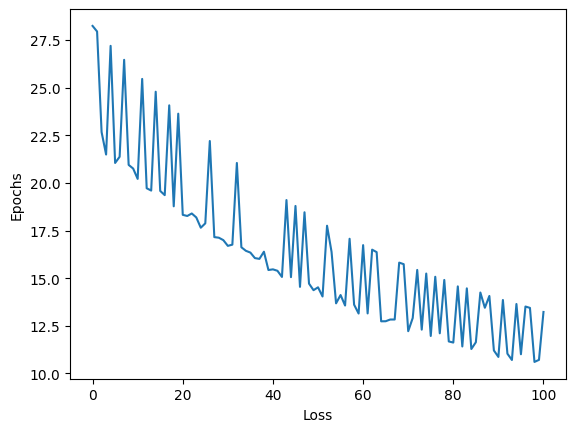

In [133]:
lr.plot_graph()

In [134]:
epsilon=[0.0001,0.001,0.01,0.1]
tol=[0.0001,0.001,0.01,0.1]
batch_size=[1,8,16,32,64,128]

In [135]:
ans=[]
accuracy=0
for i in epsilon:
    for j in tol:
        for k in batch_size:
            lr=logistic_regression(max_iter=200,epsilon=i,tol=j,batch_size=k)
            lr.fit(train_x,train_y)
            y_pred=lr.predict(test_x)
            if accuracy<lr.accuracy_score(y_pred,test_y):
                accuracy=lr.accuracy_score(y_pred,test_y)
                ans=[i,j,k]

The value of binary cross entropy at epoch # 0 is [[1.59492033]]
The value of binary cross entropy at epoch # 0 is [[8.59921566]]
The value of binary cross entropy at epoch # 0 is [[0.50045372]]
The value of binary cross entropy at epoch # 0 is [[15.41354488]]
The value of binary cross entropy at epoch # 0 is [[5.35564478]]
The value of binary cross entropy at epoch # 0 is [[0.84132759]]
The value of binary cross entropy at epoch # 0 is [[0.89169433]]
The value of binary cross entropy at epoch # 0 is [[2.10923804]]
The value of binary cross entropy at epoch # 0 is [[9.24004338]]
The value of binary cross entropy at epoch # 0 is [[1.9980288]]
The value of binary cross entropy at epoch # 0 is [[3.60558419]]
The value of binary cross entropy at epoch # 0 is [[11.939933]]
The value of binary cross entropy at epoch # 0 is [[4.53846456]]
The value of binary cross entropy at epoch # 0 is [[1.66648958]]
The value of binary cross entropy at epoch # 0 is [[4.6194177]]
The value of binary cross e

The value of binary cross entropy at epoch # 0 is [[8.06624755]]
The value of binary cross entropy at epoch # 0 is [[1.81091632]]
The value of binary cross entropy at epoch # 0 is [[5.16432106]]
The value of binary cross entropy at epoch # 0 is [[3.74297745]]
The value of binary cross entropy at epoch # 0 is [[0.75236015]]
The value of binary cross entropy at epoch # 0 is [[1.14320575]]
The value of binary cross entropy at epoch # 0 is [[0.81514013]]
The value of binary cross entropy at epoch # 0 is [[17.3988566]]
The value of binary cross entropy at epoch # 0 is [[0.58504771]]
The value of binary cross entropy at epoch # 0 is [[1.63497331]]
The value of binary cross entropy at epoch # 0 is [[5.27934565]]
The value of binary cross entropy at epoch # 0 is [[2.3303186]]
The value of binary cross entropy at epoch # 0 is [[10.86436724]]
The value of binary cross entropy at epoch # 0 is [[3.86565367]]
The value of binary cross entropy at epoch # 0 is [[4.8792116]]
The value of binary cross 

The value of binary cross entropy at epoch # 1 is [[2.08616273]]
The value of binary cross entropy at epoch # 1 is [[0.57251966]]
The value of binary cross entropy at epoch # 1 is [[6.9560064]]
The value of binary cross entropy at epoch # 1 is [[7.1917131]]
The value of binary cross entropy at epoch # 1 is [[0.22727169]]
The value of binary cross entropy at epoch # 1 is [[5.74704423]]
The value of binary cross entropy at epoch # 1 is [[2.36673777]]
The value of binary cross entropy at epoch # 1 is [[4.88050616]]
The value of binary cross entropy at epoch # 1 is [[0.54938829]]
The value of binary cross entropy at epoch # 1 is [[0.95697417]]
The value of binary cross entropy at epoch # 1 is [[3.96431571]]
The value of binary cross entropy at epoch # 1 is [[0.5516084]]
The value of binary cross entropy at epoch # 1 is [[0.30990139]]
The value of binary cross entropy at epoch # 1 is [[5.43174616]]
The value of binary cross entropy at epoch # 1 is [[1.75987529]]
The value of binary cross en

The value of binary cross entropy at epoch # 2 is [[1.77459035]]
The value of binary cross entropy at epoch # 2 is [[0.86116096]]
The value of binary cross entropy at epoch # 2 is [[7.93849026]]
The value of binary cross entropy at epoch # 2 is [[8.44613534]]
The value of binary cross entropy at epoch # 2 is [[0.79768799]]
The value of binary cross entropy at epoch # 2 is [[0.75105423]]
The value of binary cross entropy at epoch # 2 is [[6.97550614]]
The value of binary cross entropy at epoch # 2 is [[3.91464997]]
The value of binary cross entropy at epoch # 2 is [[4.68730459]]
The value of binary cross entropy at epoch # 2 is [[2.22852685]]
The value of binary cross entropy at epoch # 2 is [[11.22176102]]
The value of binary cross entropy at epoch # 2 is [[1.16173356]]
The value of binary cross entropy at epoch # 2 is [[1.01326041]]
The value of binary cross entropy at epoch # 2 is [[11.18742234]]
The value of binary cross entropy at epoch # 2 is [[1.95017088]]
The value of binary cro

The value of binary cross entropy at epoch # 3 is [[4.42487937]]
The value of binary cross entropy at epoch # 3 is [[0.7549262]]
The value of binary cross entropy at epoch # 3 is [[16.8471939]]
The value of binary cross entropy at epoch # 3 is [[7.80890534]]
The value of binary cross entropy at epoch # 3 is [[3.20490151]]
The value of binary cross entropy at epoch # 3 is [[2.54017156]]
The value of binary cross entropy at epoch # 3 is [[3.68653189]]
The value of binary cross entropy at epoch # 3 is [[1.64920466]]
The value of binary cross entropy at epoch # 3 is [[0.68911794]]
The value of binary cross entropy at epoch # 3 is [[5.08767254]]
The value of binary cross entropy at epoch # 3 is [[6.87255404]]
The value of binary cross entropy at epoch # 3 is [[9.25958064]]
The value of binary cross entropy at epoch # 3 is [[7.61774233]]
The value of binary cross entropy at epoch # 3 is [[2.02024209]]
The value of binary cross entropy at epoch # 3 is [[0.41722333]]
The value of binary cross 

The value of binary cross entropy at epoch # 4 is [[1.95365627]]
The value of binary cross entropy at epoch # 4 is [[0.66563854]]
The value of binary cross entropy at epoch # 4 is [[8.16688022]]
The value of binary cross entropy at epoch # 4 is [[1.14913182]]
The value of binary cross entropy at epoch # 4 is [[1.02601701]]
The value of binary cross entropy at epoch # 4 is [[7.68102257]]
The value of binary cross entropy at epoch # 4 is [[5.65101397]]
The value of binary cross entropy at epoch # 4 is [[2.25818735]]
The value of binary cross entropy at epoch # 4 is [[8.21901866]]
The value of binary cross entropy at epoch # 4 is [[0.86361258]]
The value of binary cross entropy at epoch # 4 is [[1.59778709]]
The value of binary cross entropy at epoch # 4 is [[17.74739486]]
The value of binary cross entropy at epoch # 4 is [[5.07386993]]
The value of binary cross entropy at epoch # 4 is [[2.36735021]]
The value of binary cross entropy at epoch # 4 is [[4.50091726]]
The value of binary cros

The value of binary cross entropy at epoch # 5 is [[4.05921286]]
The value of binary cross entropy at epoch # 5 is [[0.4120045]]
The value of binary cross entropy at epoch # 5 is [[0.93148592]]
The value of binary cross entropy at epoch # 5 is [[0.98159818]]
The value of binary cross entropy at epoch # 5 is [[12.3792551]]
The value of binary cross entropy at epoch # 5 is [[7.69378649]]
The value of binary cross entropy at epoch # 5 is [[2.73495532]]
The value of binary cross entropy at epoch # 5 is [[6.17052699]]
The value of binary cross entropy at epoch # 5 is [[6.73492435]]
The value of binary cross entropy at epoch # 5 is [[1.58565587]]
The value of binary cross entropy at epoch # 5 is [[4.83874338]]
The value of binary cross entropy at epoch # 5 is [[15.59858151]]
The value of binary cross entropy at epoch # 5 is [[2.73472494]]
The value of binary cross entropy at epoch # 5 is [[3.35354688]]
The value of binary cross entropy at epoch # 5 is [[1.25095947]]
The value of binary cross

The value of binary cross entropy at epoch # 6 is [[3.32535429]]
The value of binary cross entropy at epoch # 6 is [[1.65155162]]
The value of binary cross entropy at epoch # 6 is [[1.479633]]
The value of binary cross entropy at epoch # 6 is [[0.88858462]]
The value of binary cross entropy at epoch # 6 is [[12.01538]]
The value of binary cross entropy at epoch # 6 is [[6.52955733]]
The value of binary cross entropy at epoch # 6 is [[0.88463119]]
The value of binary cross entropy at epoch # 6 is [[14.05958593]]
The value of binary cross entropy at epoch # 6 is [[1.83002319]]
The value of binary cross entropy at epoch # 6 is [[0.8999904]]
The value of binary cross entropy at epoch # 6 is [[0.4887891]]
The value of binary cross entropy at epoch # 6 is [[0.49128583]]
The value of binary cross entropy at epoch # 6 is [[9.04942804]]
The value of binary cross entropy at epoch # 6 is [[6.48653194]]
The value of binary cross entropy at epoch # 6 is [[0.2484318]]
The value of binary cross entro

The value of binary cross entropy at epoch # 7 is [[4.480346]]
The value of binary cross entropy at epoch # 7 is [[0.2268183]]
The value of binary cross entropy at epoch # 7 is [[2.51067397]]
The value of binary cross entropy at epoch # 7 is [[3.0049001]]
The value of binary cross entropy at epoch # 7 is [[1.58352268]]
The value of binary cross entropy at epoch # 7 is [[2.70611873]]
The value of binary cross entropy at epoch # 7 is [[4.10679467]]
The value of binary cross entropy at epoch # 7 is [[3.65967058]]
The value of binary cross entropy at epoch # 7 is [[0.5411774]]
The value of binary cross entropy at epoch # 7 is [[1.29396771]]
The value of binary cross entropy at epoch # 7 is [[2.32382456]]
The value of binary cross entropy at epoch # 7 is [[0.64770982]]
The value of binary cross entropy at epoch # 7 is [[0.5757476]]
The value of binary cross entropy at epoch # 7 is [[0.83506696]]
The value of binary cross entropy at epoch # 7 is [[3.0435978]]
The value of binary cross entrop

The value of binary cross entropy at epoch # 8 is [[2.40744452]]
The value of binary cross entropy at epoch # 8 is [[2.5134939]]
The value of binary cross entropy at epoch # 8 is [[0.30502496]]
The value of binary cross entropy at epoch # 8 is [[6.3824985]]
The value of binary cross entropy at epoch # 8 is [[10.17010547]]
The value of binary cross entropy at epoch # 8 is [[0.41161079]]
The value of binary cross entropy at epoch # 8 is [[1.16081363]]
The value of binary cross entropy at epoch # 8 is [[0.88349008]]
The value of binary cross entropy at epoch # 8 is [[0.51535936]]
The value of binary cross entropy at epoch # 8 is [[5.50336789]]
The value of binary cross entropy at epoch # 8 is [[7.10574876]]
The value of binary cross entropy at epoch # 8 is [[9.41945222]]
The value of binary cross entropy at epoch # 8 is [[9.82052191]]
The value of binary cross entropy at epoch # 8 is [[0.70263591]]
The value of binary cross entropy at epoch # 8 is [[1.32413126]]
The value of binary cross 

The value of binary cross entropy at epoch # 8 is [[3.85413944]]
The value of binary cross entropy at epoch # 8 is [[1.730427]]
The value of binary cross entropy at epoch # 8 is [[0.58695561]]
The value of binary cross entropy at epoch # 8 is [[2.68083667]]
The value of binary cross entropy at epoch # 8 is [[3.99546798]]
The value of binary cross entropy at epoch # 8 is [[5.914624]]
The value of binary cross entropy at epoch # 8 is [[5.99540266]]
The value of binary cross entropy at epoch # 8 is [[1.68210398]]
The value of binary cross entropy at epoch # 8 is [[0.78694408]]
The value of binary cross entropy at epoch # 8 is [[12.37620973]]
The value of binary cross entropy at epoch # 8 is [[0.56665286]]
The value of binary cross entropy at epoch # 8 is [[0.75159676]]
The value of binary cross entropy at epoch # 8 is [[0.70530327]]
The value of binary cross entropy at epoch # 8 is [[0.57783056]]
The value of binary cross entropy at epoch # 8 is [[2.7255591]]
The value of binary cross ent

The value of binary cross entropy at epoch # 9 is [[0.34792814]]
The value of binary cross entropy at epoch # 9 is [[3.94885469]]
The value of binary cross entropy at epoch # 9 is [[1.69975415]]
The value of binary cross entropy at epoch # 9 is [[1.61990695]]
The value of binary cross entropy at epoch # 9 is [[4.84897494]]
The value of binary cross entropy at epoch # 9 is [[12.13715226]]
The value of binary cross entropy at epoch # 9 is [[1.80614704]]
The value of binary cross entropy at epoch # 9 is [[15.29200265]]
The value of binary cross entropy at epoch # 9 is [[1.58165147]]
The value of binary cross entropy at epoch # 9 is [[5.80414624]]
The value of binary cross entropy at epoch # 9 is [[1.52740928]]
The value of binary cross entropy at epoch # 9 is [[2.74588449]]
The value of binary cross entropy at epoch # 9 is [[5.82339829]]
The value of binary cross entropy at epoch # 9 is [[4.16811854]]
The value of binary cross entropy at epoch # 9 is [[7.51277137]]
The value of binary cro

The value of binary cross entropy at epoch # 10 is [[11.84787934]]
The value of binary cross entropy at epoch # 10 is [[0.33733278]]
The value of binary cross entropy at epoch # 10 is [[9.46285849]]
The value of binary cross entropy at epoch # 10 is [[1.29870169]]
The value of binary cross entropy at epoch # 10 is [[4.87817104]]
The value of binary cross entropy at epoch # 10 is [[7.39676118]]
The value of binary cross entropy at epoch # 10 is [[9.22235251]]
The value of binary cross entropy at epoch # 10 is [[2.72241875]]
The value of binary cross entropy at epoch # 10 is [[1.40098016]]
The value of binary cross entropy at epoch # 10 is [[0.8811755]]
The value of binary cross entropy at epoch # 10 is [[2.02447133]]
The value of binary cross entropy at epoch # 10 is [[0.3594948]]
The value of binary cross entropy at epoch # 10 is [[4.43128257]]
The value of binary cross entropy at epoch # 10 is [[5.58500151]]
The value of binary cross entropy at epoch # 10 is [[0.65202008]]
The value o

The value of binary cross entropy at epoch # 11 is [[0.48509136]]
The value of binary cross entropy at epoch # 11 is [[1.42788753]]
The value of binary cross entropy at epoch # 11 is [[0.71687834]]
The value of binary cross entropy at epoch # 11 is [[0.65576605]]
The value of binary cross entropy at epoch # 11 is [[0.28526749]]
The value of binary cross entropy at epoch # 11 is [[3.09333205]]
The value of binary cross entropy at epoch # 11 is [[0.81681094]]
The value of binary cross entropy at epoch # 11 is [[0.54900953]]
The value of binary cross entropy at epoch # 11 is [[1.33197762]]
The value of binary cross entropy at epoch # 11 is [[2.66385044]]
The value of binary cross entropy at epoch # 11 is [[1.68633871]]
The value of binary cross entropy at epoch # 11 is [[0.90777782]]
The value of binary cross entropy at epoch # 11 is [[6.80178789]]
The value of binary cross entropy at epoch # 11 is [[2.00140138]]
The value of binary cross entropy at epoch # 11 is [[2.35162235]]
The value 

The value of binary cross entropy at epoch # 12 is [[2.38396826]]
The value of binary cross entropy at epoch # 12 is [[1.15805611]]
The value of binary cross entropy at epoch # 12 is [[3.10105386]]
The value of binary cross entropy at epoch # 12 is [[0.43859344]]
The value of binary cross entropy at epoch # 12 is [[4.83608018]]
The value of binary cross entropy at epoch # 12 is [[9.81932169]]
The value of binary cross entropy at epoch # 12 is [[2.43147992]]
The value of binary cross entropy at epoch # 12 is [[2.67029101]]
The value of binary cross entropy at epoch # 12 is [[1.92339358]]
The value of binary cross entropy at epoch # 12 is [[8.76439035]]
The value of binary cross entropy at epoch # 12 is [[2.73881655]]
The value of binary cross entropy at epoch # 12 is [[0.48038121]]
The value of binary cross entropy at epoch # 12 is [[2.60569054]]
The value of binary cross entropy at epoch # 12 is [[0.48296776]]
The value of binary cross entropy at epoch # 12 is [[3.57001305]]
The value 

The value of binary cross entropy at epoch # 13 is [[1.3370404]]
The value of binary cross entropy at epoch # 13 is [[4.01125686]]
The value of binary cross entropy at epoch # 13 is [[2.2908085]]
The value of binary cross entropy at epoch # 13 is [[1.91184254]]
The value of binary cross entropy at epoch # 13 is [[7.01961145]]
The value of binary cross entropy at epoch # 13 is [[2.64490707]]
The value of binary cross entropy at epoch # 13 is [[4.06843935]]
The value of binary cross entropy at epoch # 13 is [[14.91975699]]
The value of binary cross entropy at epoch # 13 is [[4.63078681]]
The value of binary cross entropy at epoch # 13 is [[0.6899729]]
The value of binary cross entropy at epoch # 13 is [[4.77935265]]
The value of binary cross entropy at epoch # 13 is [[8.4074642]]
The value of binary cross entropy at epoch # 13 is [[4.93521048]]
The value of binary cross entropy at epoch # 13 is [[0.52843201]]
The value of binary cross entropy at epoch # 13 is [[1.44509456]]
The value of 

The value of binary cross entropy at epoch # 14 is [[0.47520157]]
The value of binary cross entropy at epoch # 14 is [[1.20610593]]
The value of binary cross entropy at epoch # 14 is [[2.72138156]]
The value of binary cross entropy at epoch # 14 is [[1.40781282]]
The value of binary cross entropy at epoch # 14 is [[0.41135086]]
The value of binary cross entropy at epoch # 14 is [[9.08603572]]
The value of binary cross entropy at epoch # 14 is [[0.49587541]]
The value of binary cross entropy at epoch # 14 is [[6.78151023]]
The value of binary cross entropy at epoch # 14 is [[2.02948836]]
The value of binary cross entropy at epoch # 14 is [[0.37494009]]
The value of binary cross entropy at epoch # 14 is [[2.49266109]]
The value of binary cross entropy at epoch # 14 is [[4.41764473]]
The value of binary cross entropy at epoch # 14 is [[0.61393438]]
The value of binary cross entropy at epoch # 14 is [[5.18056231]]
The value of binary cross entropy at epoch # 14 is [[4.73653288]]
The value 

The value of binary cross entropy at epoch # 15 is [[2.52640409]]
The value of binary cross entropy at epoch # 15 is [[1.20150132]]
The value of binary cross entropy at epoch # 15 is [[1.83706614]]
The value of binary cross entropy at epoch # 15 is [[2.69857151]]
The value of binary cross entropy at epoch # 15 is [[4.96088987]]
The value of binary cross entropy at epoch # 15 is [[5.38678874]]
The value of binary cross entropy at epoch # 15 is [[0.41141483]]
The value of binary cross entropy at epoch # 15 is [[1.16127401]]
The value of binary cross entropy at epoch # 15 is [[0.17957703]]
The value of binary cross entropy at epoch # 15 is [[4.62452115]]
The value of binary cross entropy at epoch # 15 is [[1.25238875]]
The value of binary cross entropy at epoch # 15 is [[1.96992992]]
The value of binary cross entropy at epoch # 15 is [[8.05972031]]
The value of binary cross entropy at epoch # 15 is [[0.13603523]]
The value of binary cross entropy at epoch # 15 is [[2.96695506]]
The value 

The value of binary cross entropy at epoch # 16 is [[4.18000356]]
The value of binary cross entropy at epoch # 16 is [[2.48913788]]
The value of binary cross entropy at epoch # 16 is [[5.63699657]]
The value of binary cross entropy at epoch # 16 is [[5.38407132]]
The value of binary cross entropy at epoch # 16 is [[2.23692992]]
The value of binary cross entropy at epoch # 16 is [[5.10735906]]
The value of binary cross entropy at epoch # 16 is [[2.11204594]]
The value of binary cross entropy at epoch # 16 is [[5.90882869]]
The value of binary cross entropy at epoch # 16 is [[0.44501659]]
The value of binary cross entropy at epoch # 16 is [[7.37747518]]
The value of binary cross entropy at epoch # 16 is [[4.50943534]]
The value of binary cross entropy at epoch # 16 is [[2.2169969]]
The value of binary cross entropy at epoch # 16 is [[4.79828122]]
The value of binary cross entropy at epoch # 16 is [[0.42495015]]
The value of binary cross entropy at epoch # 16 is [[3.52250566]]
The value o

The value of binary cross entropy at epoch # 17 is [[4.64962876]]
The value of binary cross entropy at epoch # 17 is [[0.45452117]]
The value of binary cross entropy at epoch # 17 is [[0.43772753]]
The value of binary cross entropy at epoch # 17 is [[4.23846199]]
The value of binary cross entropy at epoch # 17 is [[12.67505671]]
The value of binary cross entropy at epoch # 17 is [[1.6814781]]
The value of binary cross entropy at epoch # 17 is [[0.51235831]]
The value of binary cross entropy at epoch # 17 is [[1.15801533]]
The value of binary cross entropy at epoch # 17 is [[0.61146276]]
The value of binary cross entropy at epoch # 17 is [[1.72081958]]
The value of binary cross entropy at epoch # 17 is [[0.52474549]]
The value of binary cross entropy at epoch # 17 is [[7.69039839]]
The value of binary cross entropy at epoch # 17 is [[3.65139461]]
The value of binary cross entropy at epoch # 17 is [[1.23316889]]
The value of binary cross entropy at epoch # 17 is [[1.67671828]]
The value 

The value of binary cross entropy at epoch # 18 is [[1.91265251]]
The value of binary cross entropy at epoch # 18 is [[0.42967729]]
The value of binary cross entropy at epoch # 18 is [[0.34534437]]
The value of binary cross entropy at epoch # 18 is [[9.02851771]]
The value of binary cross entropy at epoch # 18 is [[4.90498178]]
The value of binary cross entropy at epoch # 18 is [[6.48749865]]
The value of binary cross entropy at epoch # 18 is [[1.3176755]]
The value of binary cross entropy at epoch # 18 is [[0.78818843]]
The value of binary cross entropy at epoch # 18 is [[0.45120562]]
The value of binary cross entropy at epoch # 18 is [[0.32136509]]
The value of binary cross entropy at epoch # 18 is [[2.02660662]]
The value of binary cross entropy at epoch # 18 is [[0.55223946]]
The value of binary cross entropy at epoch # 18 is [[0.4176799]]
The value of binary cross entropy at epoch # 18 is [[1.53868554]]
The value of binary cross entropy at epoch # 18 is [[12.3962194]]
The value of

The value of binary cross entropy at epoch # 19 is [[0.7093738]]
The value of binary cross entropy at epoch # 19 is [[0.30502858]]
The value of binary cross entropy at epoch # 19 is [[0.39171555]]
The value of binary cross entropy at epoch # 19 is [[0.50652158]]
The value of binary cross entropy at epoch # 19 is [[0.58140429]]
The value of binary cross entropy at epoch # 19 is [[0.49922746]]
The value of binary cross entropy at epoch # 19 is [[1.0403057]]
The value of binary cross entropy at epoch # 19 is [[3.11853241]]
The value of binary cross entropy at epoch # 19 is [[6.36478933]]
The value of binary cross entropy at epoch # 19 is [[6.28799667]]
The value of binary cross entropy at epoch # 19 is [[0.42575863]]
The value of binary cross entropy at epoch # 19 is [[5.09729703]]
The value of binary cross entropy at epoch # 19 is [[1.04921348]]
The value of binary cross entropy at epoch # 19 is [[0.50906484]]
The value of binary cross entropy at epoch # 19 is [[0.78932081]]
The value of

The value of binary cross entropy at epoch # 20 is [[3.87632926]]
The value of binary cross entropy at epoch # 20 is [[0.53820985]]
The value of binary cross entropy at epoch # 20 is [[2.10580216]]
The value of binary cross entropy at epoch # 20 is [[1.84632171]]
The value of binary cross entropy at epoch # 20 is [[6.32861259]]
The value of binary cross entropy at epoch # 20 is [[0.34420456]]
The value of binary cross entropy at epoch # 20 is [[4.05641296]]
The value of binary cross entropy at epoch # 20 is [[1.08657821]]
The value of binary cross entropy at epoch # 20 is [[6.21082922]]
The value of binary cross entropy at epoch # 20 is [[0.75291379]]
The value of binary cross entropy at epoch # 20 is [[1.59845159]]
The value of binary cross entropy at epoch # 20 is [[0.67360259]]
The value of binary cross entropy at epoch # 20 is [[8.76380401]]
The value of binary cross entropy at epoch # 20 is [[1.00967707]]
The value of binary cross entropy at epoch # 20 is [[3.2972451]]
The value o

The value of binary cross entropy at epoch # 21 is [[1.38937269]]
The value of binary cross entropy at epoch # 21 is [[0.50162375]]
The value of binary cross entropy at epoch # 21 is [[4.27937365]]
The value of binary cross entropy at epoch # 21 is [[1.33195458]]
The value of binary cross entropy at epoch # 21 is [[3.09210976]]
The value of binary cross entropy at epoch # 21 is [[0.26198065]]
The value of binary cross entropy at epoch # 21 is [[0.69893266]]
The value of binary cross entropy at epoch # 21 is [[0.39822175]]
The value of binary cross entropy at epoch # 21 is [[0.96117166]]
The value of binary cross entropy at epoch # 21 is [[0.33696675]]
The value of binary cross entropy at epoch # 21 is [[1.98131392]]
The value of binary cross entropy at epoch # 21 is [[2.99865299]]
The value of binary cross entropy at epoch # 21 is [[6.24615727]]
The value of binary cross entropy at epoch # 21 is [[1.82320665]]
The value of binary cross entropy at epoch # 21 is [[1.09106599]]
The value 

The value of binary cross entropy at epoch # 23 is [[8.18244324]]
The value of binary cross entropy at epoch # 23 is [[0.87947714]]
The value of binary cross entropy at epoch # 23 is [[10.34613738]]
The value of binary cross entropy at epoch # 23 is [[0.33335864]]
The value of binary cross entropy at epoch # 23 is [[2.1800213]]
The value of binary cross entropy at epoch # 23 is [[0.35305395]]
The value of binary cross entropy at epoch # 23 is [[2.66553248]]
The value of binary cross entropy at epoch # 23 is [[3.85349843]]
The value of binary cross entropy at epoch # 23 is [[3.63153072]]
The value of binary cross entropy at epoch # 23 is [[0.45523624]]
The value of binary cross entropy at epoch # 23 is [[0.27949102]]
The value of binary cross entropy at epoch # 23 is [[3.80736711]]
The value of binary cross entropy at epoch # 23 is [[6.33675947]]
The value of binary cross entropy at epoch # 23 is [[3.70467408]]
The value of binary cross entropy at epoch # 23 is [[2.08241144]]
The value 

The value of binary cross entropy at epoch # 24 is [[0.98061475]]
The value of binary cross entropy at epoch # 24 is [[2.0946874]]
The value of binary cross entropy at epoch # 24 is [[1.01756201]]
The value of binary cross entropy at epoch # 24 is [[0.95298454]]
The value of binary cross entropy at epoch # 24 is [[2.25819617]]
The value of binary cross entropy at epoch # 24 is [[4.01720258]]
The value of binary cross entropy at epoch # 24 is [[1.40685636]]
The value of binary cross entropy at epoch # 24 is [[0.5148174]]
The value of binary cross entropy at epoch # 24 is [[0.56706428]]
The value of binary cross entropy at epoch # 24 is [[8.33542044]]
The value of binary cross entropy at epoch # 24 is [[0.24379472]]
The value of binary cross entropy at epoch # 24 is [[0.66875126]]
The value of binary cross entropy at epoch # 24 is [[0.2475877]]
The value of binary cross entropy at epoch # 24 is [[1.275367]]
The value of binary cross entropy at epoch # 24 is [[1.24734001]]
The value of bi

The value of binary cross entropy at epoch # 25 is [[0.94395121]]
The value of binary cross entropy at epoch # 25 is [[1.47574618]]
The value of binary cross entropy at epoch # 25 is [[0.9459625]]
The value of binary cross entropy at epoch # 25 is [[0.22301785]]
The value of binary cross entropy at epoch # 25 is [[0.65618197]]
The value of binary cross entropy at epoch # 25 is [[1.47976264]]
The value of binary cross entropy at epoch # 25 is [[1.55684188]]
The value of binary cross entropy at epoch # 25 is [[11.67540209]]
The value of binary cross entropy at epoch # 25 is [[2.93256898]]
The value of binary cross entropy at epoch # 25 is [[3.01553699]]
The value of binary cross entropy at epoch # 25 is [[8.17090707]]
The value of binary cross entropy at epoch # 25 is [[5.85335504]]
The value of binary cross entropy at epoch # 25 is [[3.47859867]]
The value of binary cross entropy at epoch # 25 is [[2.25310412]]
The value of binary cross entropy at epoch # 25 is [[11.41867513]]
The value

The value of binary cross entropy at epoch # 25 is [[1.23384862]]
The value of binary cross entropy at epoch # 25 is [[6.11036347]]
The value of binary cross entropy at epoch # 25 is [[4.29580832]]
The value of binary cross entropy at epoch # 25 is [[0.33056827]]
The value of binary cross entropy at epoch # 25 is [[0.17752749]]
The value of binary cross entropy at epoch # 25 is [[0.32700883]]
The value of binary cross entropy at epoch # 25 is [[6.02986804]]
The value of binary cross entropy at epoch # 26 is [[4.03268602]]
The value of binary cross entropy at epoch # 26 is [[7.80757099]]
The value of binary cross entropy at epoch # 26 is [[0.21837775]]
The value of binary cross entropy at epoch # 26 is [[10.46917243]]
The value of binary cross entropy at epoch # 26 is [[4.06409497]]
The value of binary cross entropy at epoch # 26 is [[1.26617821]]
The value of binary cross entropy at epoch # 26 is [[1.06758866]]
The value of binary cross entropy at epoch # 26 is [[4.11315826]]
The value

The value of binary cross entropy at epoch # 27 is [[0.22017906]]
The value of binary cross entropy at epoch # 27 is [[1.22373888]]
The value of binary cross entropy at epoch # 27 is [[3.56500519]]
The value of binary cross entropy at epoch # 27 is [[5.63477155]]
The value of binary cross entropy at epoch # 27 is [[0.31860974]]
The value of binary cross entropy at epoch # 27 is [[5.95232016]]
The value of binary cross entropy at epoch # 27 is [[0.43006689]]
The value of binary cross entropy at epoch # 27 is [[0.48680442]]
The value of binary cross entropy at epoch # 27 is [[7.67521456]]
The value of binary cross entropy at epoch # 27 is [[0.86828882]]
The value of binary cross entropy at epoch # 27 is [[6.62200456]]
The value of binary cross entropy at epoch # 27 is [[0.59346364]]
The value of binary cross entropy at epoch # 27 is [[0.41528246]]
The value of binary cross entropy at epoch # 27 is [[3.42478153]]
The value of binary cross entropy at epoch # 27 is [[0.46243335]]
The value 

The value of binary cross entropy at epoch # 28 is [[0.89896225]]
The value of binary cross entropy at epoch # 28 is [[4.26277378]]
The value of binary cross entropy at epoch # 28 is [[1.58844397]]
The value of binary cross entropy at epoch # 28 is [[0.73968334]]
The value of binary cross entropy at epoch # 28 is [[3.33799261]]
The value of binary cross entropy at epoch # 28 is [[0.83604849]]
The value of binary cross entropy at epoch # 28 is [[0.88116319]]
The value of binary cross entropy at epoch # 28 is [[2.52768701]]
The value of binary cross entropy at epoch # 28 is [[0.93571816]]
The value of binary cross entropy at epoch # 28 is [[1.31194654]]
The value of binary cross entropy at epoch # 28 is [[5.78617706]]
The value of binary cross entropy at epoch # 28 is [[1.95820142]]
The value of binary cross entropy at epoch # 28 is [[10.36947778]]
The value of binary cross entropy at epoch # 28 is [[4.02011051]]
The value of binary cross entropy at epoch # 28 is [[0.84971812]]
The value

The value of binary cross entropy at epoch # 29 is [[7.82836722]]
The value of binary cross entropy at epoch # 29 is [[2.61525413]]
The value of binary cross entropy at epoch # 29 is [[1.55086619]]
The value of binary cross entropy at epoch # 29 is [[0.29688497]]
The value of binary cross entropy at epoch # 29 is [[0.84112137]]
The value of binary cross entropy at epoch # 29 is [[9.96628227]]
The value of binary cross entropy at epoch # 29 is [[0.43752983]]
The value of binary cross entropy at epoch # 29 is [[3.28089311]]
The value of binary cross entropy at epoch # 29 is [[4.23461148]]
The value of binary cross entropy at epoch # 29 is [[4.46715472]]
The value of binary cross entropy at epoch # 29 is [[0.6934981]]
The value of binary cross entropy at epoch # 29 is [[0.42580198]]
The value of binary cross entropy at epoch # 29 is [[0.42018107]]
The value of binary cross entropy at epoch # 29 is [[0.90485153]]
The value of binary cross entropy at epoch # 29 is [[3.07511961]]
The value o

The value of binary cross entropy at epoch # 30 is [[6.3076589]]
The value of binary cross entropy at epoch # 30 is [[0.4275447]]
The value of binary cross entropy at epoch # 30 is [[3.72077589]]
The value of binary cross entropy at epoch # 30 is [[2.15444826]]
The value of binary cross entropy at epoch # 30 is [[0.35226392]]
The value of binary cross entropy at epoch # 30 is [[3.85673967]]
The value of binary cross entropy at epoch # 30 is [[2.04382091]]
The value of binary cross entropy at epoch # 30 is [[10.19597239]]
The value of binary cross entropy at epoch # 30 is [[0.5285886]]
The value of binary cross entropy at epoch # 30 is [[5.35726231]]
The value of binary cross entropy at epoch # 30 is [[2.23207287]]
The value of binary cross entropy at epoch # 30 is [[1.95161144]]
The value of binary cross entropy at epoch # 30 is [[2.41562946]]
The value of binary cross entropy at epoch # 30 is [[0.76809712]]
The value of binary cross entropy at epoch # 30 is [[5.44687407]]
The value of

The value of binary cross entropy at epoch # 31 is [[0.4049118]]
The value of binary cross entropy at epoch # 31 is [[0.43775667]]
The value of binary cross entropy at epoch # 31 is [[0.78285399]]
The value of binary cross entropy at epoch # 31 is [[3.40389481]]
The value of binary cross entropy at epoch # 31 is [[1.48913351]]
The value of binary cross entropy at epoch # 31 is [[0.71751804]]
The value of binary cross entropy at epoch # 31 is [[10.54379057]]
The value of binary cross entropy at epoch # 31 is [[7.16724029]]
The value of binary cross entropy at epoch # 31 is [[4.57789216]]
The value of binary cross entropy at epoch # 31 is [[1.72641176]]
The value of binary cross entropy at epoch # 31 is [[2.95365517]]
The value of binary cross entropy at epoch # 31 is [[4.15607422]]
The value of binary cross entropy at epoch # 31 is [[0.64399539]]
The value of binary cross entropy at epoch # 31 is [[2.44301073]]
The value of binary cross entropy at epoch # 31 is [[0.23974451]]
The value 

The value of binary cross entropy at epoch # 32 is [[1.0310928]]
The value of binary cross entropy at epoch # 32 is [[1.13381402]]
The value of binary cross entropy at epoch # 32 is [[0.86762194]]
The value of binary cross entropy at epoch # 32 is [[0.12230974]]
The value of binary cross entropy at epoch # 32 is [[2.93085373]]
The value of binary cross entropy at epoch # 32 is [[1.15495978]]
The value of binary cross entropy at epoch # 32 is [[0.64806236]]
The value of binary cross entropy at epoch # 32 is [[0.47000595]]
The value of binary cross entropy at epoch # 32 is [[5.49527802]]
The value of binary cross entropy at epoch # 32 is [[1.86367157]]
The value of binary cross entropy at epoch # 32 is [[0.60075861]]
The value of binary cross entropy at epoch # 32 is [[0.72783988]]
The value of binary cross entropy at epoch # 32 is [[0.56326898]]
The value of binary cross entropy at epoch # 32 is [[0.66913333]]
The value of binary cross entropy at epoch # 32 is [[9.35144611]]
The value o

The value of binary cross entropy at epoch # 33 is [[3.34069229]]
The value of binary cross entropy at epoch # 33 is [[3.9668548]]
The value of binary cross entropy at epoch # 33 is [[0.71569703]]
The value of binary cross entropy at epoch # 33 is [[6.7592756]]
The value of binary cross entropy at epoch # 33 is [[7.16991425]]
The value of binary cross entropy at epoch # 33 is [[7.27916318]]
The value of binary cross entropy at epoch # 33 is [[0.2143283]]
The value of binary cross entropy at epoch # 33 is [[0.44965567]]
The value of binary cross entropy at epoch # 33 is [[4.07733684]]
The value of binary cross entropy at epoch # 33 is [[1.80493111]]
The value of binary cross entropy at epoch # 33 is [[9.17261043]]
The value of binary cross entropy at epoch # 33 is [[3.01047907]]
The value of binary cross entropy at epoch # 33 is [[1.52534136]]
The value of binary cross entropy at epoch # 33 is [[1.60283086]]
The value of binary cross entropy at epoch # 33 is [[1.3125664]]
The value of b

The value of binary cross entropy at epoch # 34 is [[0.41201472]]
The value of binary cross entropy at epoch # 34 is [[3.75326514]]
The value of binary cross entropy at epoch # 34 is [[0.79908049]]
The value of binary cross entropy at epoch # 34 is [[4.0547235]]
The value of binary cross entropy at epoch # 34 is [[0.62393918]]
The value of binary cross entropy at epoch # 34 is [[0.40441528]]
The value of binary cross entropy at epoch # 34 is [[1.76917519]]
The value of binary cross entropy at epoch # 34 is [[3.46718549]]
The value of binary cross entropy at epoch # 34 is [[0.70294735]]
The value of binary cross entropy at epoch # 34 is [[4.99764122]]
The value of binary cross entropy at epoch # 34 is [[1.10928866]]
The value of binary cross entropy at epoch # 34 is [[9.24017811]]
The value of binary cross entropy at epoch # 34 is [[0.65018828]]
The value of binary cross entropy at epoch # 34 is [[1.28180338]]
The value of binary cross entropy at epoch # 34 is [[3.65689994]]
The value o

The value of binary cross entropy at epoch # 35 is [[0.63078037]]
The value of binary cross entropy at epoch # 35 is [[0.584994]]
The value of binary cross entropy at epoch # 35 is [[3.27746089]]
The value of binary cross entropy at epoch # 35 is [[1.73265333]]
The value of binary cross entropy at epoch # 35 is [[8.77966858]]
The value of binary cross entropy at epoch # 35 is [[1.46763575]]
The value of binary cross entropy at epoch # 35 is [[1.37688722]]
The value of binary cross entropy at epoch # 35 is [[2.92898495]]
The value of binary cross entropy at epoch # 35 is [[1.11815333]]
The value of binary cross entropy at epoch # 35 is [[2.93125037]]
The value of binary cross entropy at epoch # 35 is [[0.41025487]]
The value of binary cross entropy at epoch # 35 is [[8.95250429]]
The value of binary cross entropy at epoch # 35 is [[5.93860175]]
The value of binary cross entropy at epoch # 35 is [[1.43297145]]
The value of binary cross entropy at epoch # 35 is [[2.26187136]]
The value of

The value of binary cross entropy at epoch # 36 is [[0.59892639]]
The value of binary cross entropy at epoch # 36 is [[0.31141172]]
The value of binary cross entropy at epoch # 36 is [[0.3113056]]
The value of binary cross entropy at epoch # 36 is [[0.32409336]]
The value of binary cross entropy at epoch # 36 is [[3.2625529]]
The value of binary cross entropy at epoch # 36 is [[1.24277052]]
The value of binary cross entropy at epoch # 36 is [[0.79113841]]
The value of binary cross entropy at epoch # 36 is [[6.19066082]]
The value of binary cross entropy at epoch # 36 is [[0.88171826]]
The value of binary cross entropy at epoch # 36 is [[0.79496416]]
The value of binary cross entropy at epoch # 36 is [[6.54487009]]
The value of binary cross entropy at epoch # 36 is [[7.07528739]]
The value of binary cross entropy at epoch # 36 is [[3.76834415]]
The value of binary cross entropy at epoch # 36 is [[0.36508844]]
The value of binary cross entropy at epoch # 36 is [[1.07169785]]
The value of

The value of binary cross entropy at epoch # 38 is [[9.96895566]]
The value of binary cross entropy at epoch # 38 is [[0.34363337]]
The value of binary cross entropy at epoch # 38 is [[0.66938349]]
The value of binary cross entropy at epoch # 38 is [[0.60804405]]
The value of binary cross entropy at epoch # 38 is [[0.6149043]]
The value of binary cross entropy at epoch # 38 is [[0.26800103]]
The value of binary cross entropy at epoch # 38 is [[2.18223154]]
The value of binary cross entropy at epoch # 38 is [[0.88890177]]
The value of binary cross entropy at epoch # 38 is [[0.39131143]]
The value of binary cross entropy at epoch # 38 is [[0.82933613]]
The value of binary cross entropy at epoch # 38 is [[0.40269567]]
The value of binary cross entropy at epoch # 38 is [[5.95122228]]
The value of binary cross entropy at epoch # 38 is [[8.32577553]]
The value of binary cross entropy at epoch # 38 is [[0.31017511]]
The value of binary cross entropy at epoch # 38 is [[5.86525252]]
The value o

The value of binary cross entropy at epoch # 39 is [[0.5274137]]
The value of binary cross entropy at epoch # 39 is [[8.11791909]]
The value of binary cross entropy at epoch # 39 is [[4.01402237]]
The value of binary cross entropy at epoch # 39 is [[3.90286201]]
The value of binary cross entropy at epoch # 39 is [[0.67232443]]
The value of binary cross entropy at epoch # 39 is [[0.39719495]]
The value of binary cross entropy at epoch # 39 is [[0.36528724]]
The value of binary cross entropy at epoch # 39 is [[2.20261275]]
The value of binary cross entropy at epoch # 39 is [[0.60325786]]
The value of binary cross entropy at epoch # 39 is [[1.57661968]]
The value of binary cross entropy at epoch # 39 is [[1.04904963]]
The value of binary cross entropy at epoch # 39 is [[1.3616947]]
The value of binary cross entropy at epoch # 39 is [[0.44419806]]
The value of binary cross entropy at epoch # 39 is [[1.12222394]]
The value of binary cross entropy at epoch # 39 is [[0.55654707]]
The value of

The value of binary cross entropy at epoch # 40 is [[3.98482717]]
The value of binary cross entropy at epoch # 40 is [[0.98410052]]
The value of binary cross entropy at epoch # 40 is [[0.76083364]]
The value of binary cross entropy at epoch # 40 is [[6.89803683]]
The value of binary cross entropy at epoch # 40 is [[0.94094805]]
The value of binary cross entropy at epoch # 40 is [[0.56254703]]
The value of binary cross entropy at epoch # 40 is [[0.54826559]]
The value of binary cross entropy at epoch # 40 is [[0.40755808]]
The value of binary cross entropy at epoch # 40 is [[0.71273067]]
The value of binary cross entropy at epoch # 40 is [[0.21547417]]
The value of binary cross entropy at epoch # 40 is [[3.03425224]]
The value of binary cross entropy at epoch # 40 is [[1.21824469]]
The value of binary cross entropy at epoch # 40 is [[0.52151242]]
The value of binary cross entropy at epoch # 40 is [[5.43098433]]
The value of binary cross entropy at epoch # 40 is [[3.82645817]]
The value 

The value of binary cross entropy at epoch # 41 is [[8.32374954]]
The value of binary cross entropy at epoch # 41 is [[0.35473636]]
The value of binary cross entropy at epoch # 41 is [[0.63587199]]
The value of binary cross entropy at epoch # 41 is [[0.5498878]]
The value of binary cross entropy at epoch # 41 is [[0.66857835]]
The value of binary cross entropy at epoch # 41 is [[3.52399238]]
The value of binary cross entropy at epoch # 41 is [[0.5345793]]
The value of binary cross entropy at epoch # 41 is [[0.39196341]]
The value of binary cross entropy at epoch # 41 is [[5.34567769]]
The value of binary cross entropy at epoch # 41 is [[2.96956843]]
The value of binary cross entropy at epoch # 41 is [[0.81590438]]
The value of binary cross entropy at epoch # 41 is [[1.4249417]]
The value of binary cross entropy at epoch # 41 is [[4.51796406]]
The value of binary cross entropy at epoch # 41 is [[1.21483922]]
The value of binary cross entropy at epoch # 41 is [[1.19434236]]
The value of 

The value of binary cross entropy at epoch # 43 is [[4.61210408]]
The value of binary cross entropy at epoch # 43 is [[1.86919633]]
The value of binary cross entropy at epoch # 43 is [[4.23149177]]
The value of binary cross entropy at epoch # 43 is [[5.39011769]]
The value of binary cross entropy at epoch # 43 is [[0.40638584]]
The value of binary cross entropy at epoch # 43 is [[0.35434187]]
The value of binary cross entropy at epoch # 43 is [[0.17033145]]
The value of binary cross entropy at epoch # 43 is [[3.8184835]]
The value of binary cross entropy at epoch # 43 is [[3.66798674]]
The value of binary cross entropy at epoch # 43 is [[0.66089368]]
The value of binary cross entropy at epoch # 43 is [[0.46256729]]
The value of binary cross entropy at epoch # 43 is [[8.12730953]]
The value of binary cross entropy at epoch # 43 is [[1.26345716]]
The value of binary cross entropy at epoch # 43 is [[0.50768746]]
The value of binary cross entropy at epoch # 43 is [[0.53700859]]
The value o

The value of binary cross entropy at epoch # 44 is [[0.46312368]]
The value of binary cross entropy at epoch # 44 is [[0.25036354]]
The value of binary cross entropy at epoch # 44 is [[0.26901985]]
The value of binary cross entropy at epoch # 44 is [[0.52313516]]
The value of binary cross entropy at epoch # 44 is [[0.58990903]]
The value of binary cross entropy at epoch # 44 is [[0.35454376]]
The value of binary cross entropy at epoch # 44 is [[8.04385033]]
The value of binary cross entropy at epoch # 44 is [[0.70822238]]
The value of binary cross entropy at epoch # 44 is [[5.14241412]]
The value of binary cross entropy at epoch # 44 is [[0.66028563]]
The value of binary cross entropy at epoch # 44 is [[2.04510166]]
The value of binary cross entropy at epoch # 44 is [[3.84136243]]
The value of binary cross entropy at epoch # 44 is [[0.76993625]]
The value of binary cross entropy at epoch # 44 is [[0.37466122]]
The value of binary cross entropy at epoch # 44 is [[4.10447529]]
The value 

The value of binary cross entropy at epoch # 45 is [[2.47226211]]
The value of binary cross entropy at epoch # 45 is [[1.29108888]]
The value of binary cross entropy at epoch # 45 is [[1.08925144]]
The value of binary cross entropy at epoch # 45 is [[4.28098176]]
The value of binary cross entropy at epoch # 45 is [[0.82030248]]
The value of binary cross entropy at epoch # 45 is [[0.35099757]]
The value of binary cross entropy at epoch # 45 is [[0.6528731]]
The value of binary cross entropy at epoch # 45 is [[5.03598297]]
The value of binary cross entropy at epoch # 45 is [[2.02763618]]
The value of binary cross entropy at epoch # 45 is [[1.99893431]]
The value of binary cross entropy at epoch # 45 is [[6.85639322]]
The value of binary cross entropy at epoch # 45 is [[0.58651742]]
The value of binary cross entropy at epoch # 45 is [[0.33603782]]
The value of binary cross entropy at epoch # 45 is [[0.31420192]]
The value of binary cross entropy at epoch # 45 is [[2.26159839]]
The value o

The value of binary cross entropy at epoch # 46 is [[1.07228685]]
The value of binary cross entropy at epoch # 46 is [[9.05618138]]
The value of binary cross entropy at epoch # 46 is [[0.40395092]]
The value of binary cross entropy at epoch # 46 is [[1.45091096]]
The value of binary cross entropy at epoch # 46 is [[2.39175537]]
The value of binary cross entropy at epoch # 46 is [[0.45861919]]
The value of binary cross entropy at epoch # 46 is [[0.64162696]]
The value of binary cross entropy at epoch # 46 is [[4.10995998]]
The value of binary cross entropy at epoch # 46 is [[0.49231514]]
The value of binary cross entropy at epoch # 46 is [[0.82093629]]
The value of binary cross entropy at epoch # 46 is [[1.27550611]]
The value of binary cross entropy at epoch # 46 is [[0.31654122]]
The value of binary cross entropy at epoch # 46 is [[6.6615272]]
The value of binary cross entropy at epoch # 46 is [[2.75802077]]
The value of binary cross entropy at epoch # 46 is [[2.40930227]]
The value o

The value of binary cross entropy at epoch # 47 is [[1.30421857]]
The value of binary cross entropy at epoch # 47 is [[0.87573975]]
The value of binary cross entropy at epoch # 47 is [[0.27649376]]
The value of binary cross entropy at epoch # 47 is [[1.9316331]]
The value of binary cross entropy at epoch # 47 is [[0.4757387]]
The value of binary cross entropy at epoch # 47 is [[1.03587408]]
The value of binary cross entropy at epoch # 47 is [[0.52596168]]
The value of binary cross entropy at epoch # 47 is [[0.3913486]]
The value of binary cross entropy at epoch # 47 is [[2.01746887]]
The value of binary cross entropy at epoch # 47 is [[0.57334038]]
The value of binary cross entropy at epoch # 47 is [[6.80745383]]
The value of binary cross entropy at epoch # 47 is [[0.27881291]]
The value of binary cross entropy at epoch # 47 is [[0.36451877]]
The value of binary cross entropy at epoch # 47 is [[0.29825462]]
The value of binary cross entropy at epoch # 47 is [[0.46127915]]
The value of 

The value of binary cross entropy at epoch # 48 is [[2.92762585]]
The value of binary cross entropy at epoch # 48 is [[0.62045982]]
The value of binary cross entropy at epoch # 48 is [[1.483118]]
The value of binary cross entropy at epoch # 48 is [[1.15292838]]
The value of binary cross entropy at epoch # 48 is [[2.55031476]]
The value of binary cross entropy at epoch # 48 is [[3.19214963]]
The value of binary cross entropy at epoch # 48 is [[0.63880621]]
The value of binary cross entropy at epoch # 48 is [[6.20185403]]
The value of binary cross entropy at epoch # 48 is [[0.50023358]]
The value of binary cross entropy at epoch # 48 is [[3.56628826]]
The value of binary cross entropy at epoch # 48 is [[1.59358346]]
The value of binary cross entropy at epoch # 48 is [[3.64694201]]
The value of binary cross entropy at epoch # 48 is [[6.2843761]]
The value of binary cross entropy at epoch # 48 is [[6.57008208]]
The value of binary cross entropy at epoch # 48 is [[4.78239503]]
The value of 

The value of binary cross entropy at epoch # 49 is [[0.56571905]]
The value of binary cross entropy at epoch # 49 is [[2.30422107]]
The value of binary cross entropy at epoch # 49 is [[0.96376053]]
The value of binary cross entropy at epoch # 49 is [[1.53286199]]
The value of binary cross entropy at epoch # 49 is [[2.03211701]]
The value of binary cross entropy at epoch # 49 is [[0.92624131]]
The value of binary cross entropy at epoch # 49 is [[0.39151791]]
The value of binary cross entropy at epoch # 49 is [[0.46718141]]
The value of binary cross entropy at epoch # 49 is [[0.25947507]]
The value of binary cross entropy at epoch # 50 is [[16.6817712]]
The value of binary cross entropy at epoch # 50 is [[3.54614615]]
The value of binary cross entropy at epoch # 50 is [[0.63290765]]
The value of binary cross entropy at epoch # 50 is [[2.26787631]]
The value of binary cross entropy at epoch # 50 is [[2.33436234]]
The value of binary cross entropy at epoch # 50 is [[6.37167229]]
The value 

The value of binary cross entropy at epoch # 51 is [[0.25541615]]
The value of binary cross entropy at epoch # 51 is [[7.29918467]]
The value of binary cross entropy at epoch # 51 is [[2.26236108]]
The value of binary cross entropy at epoch # 51 is [[1.83248206]]
The value of binary cross entropy at epoch # 51 is [[0.64193402]]
The value of binary cross entropy at epoch # 51 is [[1.96681267]]
The value of binary cross entropy at epoch # 51 is [[0.79788712]]
The value of binary cross entropy at epoch # 51 is [[0.19348081]]
The value of binary cross entropy at epoch # 51 is [[3.67242345]]
The value of binary cross entropy at epoch # 51 is [[0.8251751]]
The value of binary cross entropy at epoch # 51 is [[4.0283418]]
The value of binary cross entropy at epoch # 51 is [[0.45622851]]
The value of binary cross entropy at epoch # 51 is [[0.29837899]]
The value of binary cross entropy at epoch # 51 is [[4.94920411]]
The value of binary cross entropy at epoch # 51 is [[0.39410521]]
The value of

The value of binary cross entropy at epoch # 52 is [[0.30301823]]
The value of binary cross entropy at epoch # 52 is [[0.22058931]]
The value of binary cross entropy at epoch # 52 is [[0.42234576]]
The value of binary cross entropy at epoch # 52 is [[8.69061735]]
The value of binary cross entropy at epoch # 52 is [[0.46434169]]
The value of binary cross entropy at epoch # 52 is [[6.0576515]]
The value of binary cross entropy at epoch # 52 is [[1.91566972]]
The value of binary cross entropy at epoch # 52 is [[1.27954992]]
The value of binary cross entropy at epoch # 52 is [[1.43114611]]
The value of binary cross entropy at epoch # 52 is [[0.82133761]]
The value of binary cross entropy at epoch # 52 is [[1.47249678]]
The value of binary cross entropy at epoch # 52 is [[2.05264232]]
The value of binary cross entropy at epoch # 52 is [[4.39236522]]
The value of binary cross entropy at epoch # 52 is [[0.29625008]]
The value of binary cross entropy at epoch # 52 is [[4.89142276]]
The value o

The value of binary cross entropy at epoch # 53 is [[0.40331437]]
The value of binary cross entropy at epoch # 53 is [[1.2173589]]
The value of binary cross entropy at epoch # 53 is [[3.62309925]]
The value of binary cross entropy at epoch # 53 is [[0.2484501]]
The value of binary cross entropy at epoch # 53 is [[0.62610501]]
The value of binary cross entropy at epoch # 53 is [[0.61286127]]
The value of binary cross entropy at epoch # 53 is [[2.91414353]]
The value of binary cross entropy at epoch # 53 is [[2.02863211]]
The value of binary cross entropy at epoch # 53 is [[0.29265888]]
The value of binary cross entropy at epoch # 53 is [[5.88206471]]
The value of binary cross entropy at epoch # 53 is [[0.86609376]]
The value of binary cross entropy at epoch # 53 is [[2.29483237]]
The value of binary cross entropy at epoch # 53 is [[0.29182414]]
The value of binary cross entropy at epoch # 53 is [[0.76280759]]
The value of binary cross entropy at epoch # 53 is [[0.39817128]]
The value of

The value of binary cross entropy at epoch # 54 is [[2.07380027]]
The value of binary cross entropy at epoch # 54 is [[2.00689664]]
The value of binary cross entropy at epoch # 54 is [[1.69601338]]
The value of binary cross entropy at epoch # 54 is [[0.35944208]]
The value of binary cross entropy at epoch # 54 is [[3.79069239]]
The value of binary cross entropy at epoch # 54 is [[0.89739844]]
The value of binary cross entropy at epoch # 54 is [[0.91417415]]
The value of binary cross entropy at epoch # 54 is [[5.0349573]]
The value of binary cross entropy at epoch # 54 is [[3.02342736]]
The value of binary cross entropy at epoch # 54 is [[1.21946802]]
The value of binary cross entropy at epoch # 55 is [[1.92409515]]
The value of binary cross entropy at epoch # 55 is [[4.36362618]]
The value of binary cross entropy at epoch # 55 is [[1.22801825]]
The value of binary cross entropy at epoch # 55 is [[4.75064487]]
The value of binary cross entropy at epoch # 55 is [[6.11813133]]
The value o

The value of binary cross entropy at epoch # 56 is [[0.57759882]]
The value of binary cross entropy at epoch # 56 is [[2.75368831]]
The value of binary cross entropy at epoch # 56 is [[1.24605625]]
The value of binary cross entropy at epoch # 56 is [[4.82380881]]
The value of binary cross entropy at epoch # 56 is [[2.03422821]]
The value of binary cross entropy at epoch # 56 is [[3.45106605]]
The value of binary cross entropy at epoch # 56 is [[7.82409132]]
The value of binary cross entropy at epoch # 56 is [[1.93711158]]
The value of binary cross entropy at epoch # 56 is [[14.89045069]]
The value of binary cross entropy at epoch # 56 is [[3.70283967]]
The value of binary cross entropy at epoch # 56 is [[0.82063312]]
The value of binary cross entropy at epoch # 56 is [[4.64591621]]
The value of binary cross entropy at epoch # 56 is [[0.60317614]]
The value of binary cross entropy at epoch # 56 is [[2.86445732]]
The value of binary cross entropy at epoch # 56 is [[0.86965397]]
The value

The value of binary cross entropy at epoch # 57 is [[3.64402202]]
The value of binary cross entropy at epoch # 57 is [[4.95529253]]
The value of binary cross entropy at epoch # 57 is [[0.42466077]]
The value of binary cross entropy at epoch # 57 is [[0.55697047]]
The value of binary cross entropy at epoch # 57 is [[5.26901084]]
The value of binary cross entropy at epoch # 57 is [[0.89909348]]
The value of binary cross entropy at epoch # 57 is [[1.75022763]]
The value of binary cross entropy at epoch # 57 is [[0.53586334]]
The value of binary cross entropy at epoch # 57 is [[3.63412274]]
The value of binary cross entropy at epoch # 57 is [[0.82078352]]
The value of binary cross entropy at epoch # 57 is [[5.67253036]]
The value of binary cross entropy at epoch # 57 is [[1.64545858]]
The value of binary cross entropy at epoch # 57 is [[0.86646837]]
The value of binary cross entropy at epoch # 57 is [[0.33248792]]
The value of binary cross entropy at epoch # 57 is [[0.33214793]]
The value 

The value of binary cross entropy at epoch # 58 is [[0.52350245]]
The value of binary cross entropy at epoch # 58 is [[3.57561582]]
The value of binary cross entropy at epoch # 58 is [[4.04262914]]
The value of binary cross entropy at epoch # 58 is [[0.912519]]
The value of binary cross entropy at epoch # 58 is [[1.11028473]]
The value of binary cross entropy at epoch # 58 is [[3.51452495]]
The value of binary cross entropy at epoch # 58 is [[0.79884707]]
The value of binary cross entropy at epoch # 58 is [[0.34993165]]
The value of binary cross entropy at epoch # 58 is [[2.58484235]]
The value of binary cross entropy at epoch # 58 is [[0.41566517]]
The value of binary cross entropy at epoch # 58 is [[1.21698836]]
The value of binary cross entropy at epoch # 58 is [[2.94032688]]
The value of binary cross entropy at epoch # 58 is [[2.33932673]]
The value of binary cross entropy at epoch # 58 is [[0.33941424]]
The value of binary cross entropy at epoch # 58 is [[0.75046304]]
The value of

The value of binary cross entropy at epoch # 60 is [[0.38388401]]
The value of binary cross entropy at epoch # 60 is [[1.11526978]]
The value of binary cross entropy at epoch # 60 is [[1.85280274]]
The value of binary cross entropy at epoch # 60 is [[0.44373634]]
The value of binary cross entropy at epoch # 60 is [[3.57444737]]
The value of binary cross entropy at epoch # 60 is [[0.85865513]]
The value of binary cross entropy at epoch # 60 is [[0.66075651]]
The value of binary cross entropy at epoch # 60 is [[2.21701479]]
The value of binary cross entropy at epoch # 60 is [[1.50740601]]
The value of binary cross entropy at epoch # 60 is [[6.41365183]]
The value of binary cross entropy at epoch # 60 is [[0.67636574]]
The value of binary cross entropy at epoch # 60 is [[0.49899262]]
The value of binary cross entropy at epoch # 60 is [[3.58950815]]
The value of binary cross entropy at epoch # 60 is [[1.72398397]]
The value of binary cross entropy at epoch # 60 is [[4.5569352]]
The value o

The value of binary cross entropy at epoch # 61 is [[0.68496606]]
The value of binary cross entropy at epoch # 61 is [[2.5353618]]
The value of binary cross entropy at epoch # 61 is [[1.2341069]]
The value of binary cross entropy at epoch # 61 is [[2.75576533]]
The value of binary cross entropy at epoch # 61 is [[1.19212193]]
The value of binary cross entropy at epoch # 61 is [[0.56791213]]
The value of binary cross entropy at epoch # 61 is [[1.66795148]]
The value of binary cross entropy at epoch # 61 is [[1.79892548]]
The value of binary cross entropy at epoch # 61 is [[1.84274118]]
The value of binary cross entropy at epoch # 61 is [[0.30666085]]
The value of binary cross entropy at epoch # 61 is [[1.23835307]]
The value of binary cross entropy at epoch # 61 is [[4.53213561]]
The value of binary cross entropy at epoch # 61 is [[0.22365519]]
The value of binary cross entropy at epoch # 61 is [[0.35228109]]
The value of binary cross entropy at epoch # 61 is [[1.55377469]]
The value of

The value of binary cross entropy at epoch # 62 is [[0.57004995]]
The value of binary cross entropy at epoch # 62 is [[1.09504424]]
The value of binary cross entropy at epoch # 62 is [[6.19286705]]
The value of binary cross entropy at epoch # 62 is [[2.53279009]]
The value of binary cross entropy at epoch # 62 is [[2.54497436]]
The value of binary cross entropy at epoch # 62 is [[2.19362287]]
The value of binary cross entropy at epoch # 62 is [[0.52432786]]
The value of binary cross entropy at epoch # 62 is [[0.84761292]]
The value of binary cross entropy at epoch # 62 is [[3.68273437]]
The value of binary cross entropy at epoch # 62 is [[0.36341893]]
The value of binary cross entropy at epoch # 62 is [[4.04060211]]
The value of binary cross entropy at epoch # 62 is [[3.39874854]]
The value of binary cross entropy at epoch # 62 is [[2.25537598]]
The value of binary cross entropy at epoch # 62 is [[1.16275789]]
The value of binary cross entropy at epoch # 62 is [[1.24247968]]
The value 

The value of binary cross entropy at epoch # 64 is [[1.75259129]]
The value of binary cross entropy at epoch # 64 is [[0.41049767]]
The value of binary cross entropy at epoch # 64 is [[2.46911077]]
The value of binary cross entropy at epoch # 64 is [[0.27755256]]
The value of binary cross entropy at epoch # 64 is [[1.3688328]]
The value of binary cross entropy at epoch # 64 is [[1.98353435]]
The value of binary cross entropy at epoch # 64 is [[3.80251761]]
The value of binary cross entropy at epoch # 64 is [[4.34838282]]
The value of binary cross entropy at epoch # 64 is [[0.96977467]]
The value of binary cross entropy at epoch # 64 is [[0.57489852]]
The value of binary cross entropy at epoch # 64 is [[0.77079771]]
The value of binary cross entropy at epoch # 64 is [[1.05217586]]
The value of binary cross entropy at epoch # 64 is [[0.46892733]]
The value of binary cross entropy at epoch # 64 is [[0.11417763]]
The value of binary cross entropy at epoch # 64 is [[0.45191684]]
The value o

The value of binary cross entropy at epoch # 65 is [[0.63721132]]
The value of binary cross entropy at epoch # 65 is [[0.57697711]]
The value of binary cross entropy at epoch # 65 is [[4.24707842]]
The value of binary cross entropy at epoch # 65 is [[1.79463157]]
The value of binary cross entropy at epoch # 65 is [[1.14001874]]
The value of binary cross entropy at epoch # 65 is [[3.22667336]]
The value of binary cross entropy at epoch # 65 is [[0.68784714]]
The value of binary cross entropy at epoch # 65 is [[5.91750286]]
The value of binary cross entropy at epoch # 65 is [[0.24852859]]
The value of binary cross entropy at epoch # 65 is [[3.76270764]]
The value of binary cross entropy at epoch # 65 is [[1.33939012]]
The value of binary cross entropy at epoch # 65 is [[0.10151668]]
The value of binary cross entropy at epoch # 65 is [[1.79071008]]
The value of binary cross entropy at epoch # 65 is [[0.328758]]
The value of binary cross entropy at epoch # 65 is [[1.0756758]]
The value of 

The value of binary cross entropy at epoch # 66 is [[2.96402598]]
The value of binary cross entropy at epoch # 66 is [[1.74608761]]
The value of binary cross entropy at epoch # 66 is [[0.60463618]]
The value of binary cross entropy at epoch # 66 is [[1.01710916]]
The value of binary cross entropy at epoch # 66 is [[2.9960555]]
The value of binary cross entropy at epoch # 66 is [[0.83378704]]
The value of binary cross entropy at epoch # 66 is [[12.06857159]]
The value of binary cross entropy at epoch # 66 is [[3.36975805]]
The value of binary cross entropy at epoch # 66 is [[1.01603533]]
The value of binary cross entropy at epoch # 66 is [[0.34687906]]
The value of binary cross entropy at epoch # 66 is [[5.59860261]]
The value of binary cross entropy at epoch # 66 is [[5.79630947]]
The value of binary cross entropy at epoch # 66 is [[2.57997016]]
The value of binary cross entropy at epoch # 66 is [[1.35098823]]
The value of binary cross entropy at epoch # 66 is [[0.2335068]]
The value o

The value of binary cross entropy at epoch # 68 is [[11.66419324]]
The value of binary cross entropy at epoch # 68 is [[3.56046724]]
The value of binary cross entropy at epoch # 68 is [[2.58788752]]
The value of binary cross entropy at epoch # 68 is [[0.37809245]]
The value of binary cross entropy at epoch # 68 is [[1.15332107]]
The value of binary cross entropy at epoch # 68 is [[4.4284388]]
The value of binary cross entropy at epoch # 68 is [[0.23347789]]
The value of binary cross entropy at epoch # 68 is [[4.25838764]]
The value of binary cross entropy at epoch # 68 is [[0.08186828]]
The value of binary cross entropy at epoch # 68 is [[1.80792977]]
The value of binary cross entropy at epoch # 68 is [[0.39699781]]
The value of binary cross entropy at epoch # 68 is [[1.61182249]]
The value of binary cross entropy at epoch # 68 is [[4.98613323]]
The value of binary cross entropy at epoch # 68 is [[3.52131779]]
The value of binary cross entropy at epoch # 68 is [[1.25825326]]
The value 

The value of binary cross entropy at epoch # 69 is [[3.58572662]]
The value of binary cross entropy at epoch # 69 is [[3.59385302]]
The value of binary cross entropy at epoch # 69 is [[2.44236461]]
The value of binary cross entropy at epoch # 69 is [[0.72932233]]
The value of binary cross entropy at epoch # 69 is [[2.96563673]]
The value of binary cross entropy at epoch # 69 is [[1.10300364]]
The value of binary cross entropy at epoch # 69 is [[2.59610403]]
The value of binary cross entropy at epoch # 69 is [[0.42395336]]
The value of binary cross entropy at epoch # 69 is [[1.27984666]]
The value of binary cross entropy at epoch # 69 is [[1.63746738]]
The value of binary cross entropy at epoch # 69 is [[4.38720659]]
The value of binary cross entropy at epoch # 69 is [[0.55358034]]
The value of binary cross entropy at epoch # 69 is [[0.19564694]]
The value of binary cross entropy at epoch # 69 is [[1.69051599]]
The value of binary cross entropy at epoch # 69 is [[1.02666822]]
The value 

The value of binary cross entropy at epoch # 70 is [[1.19364082]]
The value of binary cross entropy at epoch # 70 is [[0.35884316]]
The value of binary cross entropy at epoch # 70 is [[3.14780121]]
The value of binary cross entropy at epoch # 70 is [[3.96232384]]
The value of binary cross entropy at epoch # 70 is [[0.39609026]]
The value of binary cross entropy at epoch # 70 is [[1.04371179]]
The value of binary cross entropy at epoch # 70 is [[6.27619268]]
The value of binary cross entropy at epoch # 70 is [[2.83860262]]
The value of binary cross entropy at epoch # 70 is [[5.43463169]]
The value of binary cross entropy at epoch # 70 is [[1.73468021]]
The value of binary cross entropy at epoch # 70 is [[2.17394262]]
The value of binary cross entropy at epoch # 70 is [[0.71406327]]
The value of binary cross entropy at epoch # 70 is [[3.25639378]]
The value of binary cross entropy at epoch # 70 is [[2.17188637]]
The value of binary cross entropy at epoch # 70 is [[2.20520688]]
The value 

The value of binary cross entropy at epoch # 72 is [[0.59404725]]
The value of binary cross entropy at epoch # 72 is [[0.87856183]]
The value of binary cross entropy at epoch # 72 is [[1.54987654]]
The value of binary cross entropy at epoch # 72 is [[7.61144003]]
The value of binary cross entropy at epoch # 72 is [[10.67796359]]
The value of binary cross entropy at epoch # 72 is [[1.00623594]]
The value of binary cross entropy at epoch # 72 is [[3.38932354]]
The value of binary cross entropy at epoch # 72 is [[0.4589726]]
The value of binary cross entropy at epoch # 72 is [[2.79506523]]
The value of binary cross entropy at epoch # 72 is [[1.28754227]]
The value of binary cross entropy at epoch # 72 is [[0.32119965]]
The value of binary cross entropy at epoch # 72 is [[1.15370716]]
The value of binary cross entropy at epoch # 72 is [[1.14405222]]
The value of binary cross entropy at epoch # 72 is [[2.74025381]]
The value of binary cross entropy at epoch # 72 is [[0.59388959]]
The value 

The value of binary cross entropy at epoch # 73 is [[3.31486302]]
The value of binary cross entropy at epoch # 73 is [[0.54513677]]
The value of binary cross entropy at epoch # 73 is [[0.64084164]]
The value of binary cross entropy at epoch # 73 is [[0.49929818]]
The value of binary cross entropy at epoch # 73 is [[0.88524201]]
The value of binary cross entropy at epoch # 73 is [[0.20807462]]
The value of binary cross entropy at epoch # 73 is [[3.13633768]]
The value of binary cross entropy at epoch # 73 is [[1.12781362]]
The value of binary cross entropy at epoch # 73 is [[1.32908117]]
The value of binary cross entropy at epoch # 73 is [[1.13738322]]
The value of binary cross entropy at epoch # 73 is [[3.36491427]]
The value of binary cross entropy at epoch # 73 is [[0.43067598]]
The value of binary cross entropy at epoch # 73 is [[1.4907338]]
The value of binary cross entropy at epoch # 73 is [[1.4318161]]
The value of binary cross entropy at epoch # 73 is [[0.36333735]]
The value of

The value of binary cross entropy at epoch # 74 is [[0.56103973]]
The value of binary cross entropy at epoch # 74 is [[1.57822168]]
The value of binary cross entropy at epoch # 74 is [[0.31964658]]
The value of binary cross entropy at epoch # 74 is [[1.1255288]]
The value of binary cross entropy at epoch # 74 is [[1.29524895]]
The value of binary cross entropy at epoch # 74 is [[0.53312085]]
The value of binary cross entropy at epoch # 74 is [[0.39280869]]
The value of binary cross entropy at epoch # 74 is [[10.04305656]]
The value of binary cross entropy at epoch # 74 is [[3.3966728]]
The value of binary cross entropy at epoch # 74 is [[0.38425789]]
The value of binary cross entropy at epoch # 74 is [[0.48317504]]
The value of binary cross entropy at epoch # 74 is [[1.11938694]]
The value of binary cross entropy at epoch # 74 is [[1.4555466]]
The value of binary cross entropy at epoch # 74 is [[5.07494815]]
The value of binary cross entropy at epoch # 74 is [[0.66744242]]
The value of

The value of binary cross entropy at epoch # 76 is [[2.87954327]]
The value of binary cross entropy at epoch # 76 is [[3.96961053]]
The value of binary cross entropy at epoch # 76 is [[0.44109536]]
The value of binary cross entropy at epoch # 76 is [[0.39163182]]
The value of binary cross entropy at epoch # 76 is [[2.16548044]]
The value of binary cross entropy at epoch # 76 is [[1.54275079]]
The value of binary cross entropy at epoch # 76 is [[0.62572326]]
The value of binary cross entropy at epoch # 76 is [[0.19432961]]
The value of binary cross entropy at epoch # 76 is [[1.2283779]]
The value of binary cross entropy at epoch # 76 is [[0.45328411]]
The value of binary cross entropy at epoch # 76 is [[2.63562182]]
The value of binary cross entropy at epoch # 76 is [[2.83585553]]
The value of binary cross entropy at epoch # 76 is [[1.41370198]]
The value of binary cross entropy at epoch # 76 is [[5.73227942]]
The value of binary cross entropy at epoch # 76 is [[0.26868487]]
The value o

The value of binary cross entropy at epoch # 77 is [[0.82851678]]
The value of binary cross entropy at epoch # 77 is [[0.74816761]]
The value of binary cross entropy at epoch # 77 is [[0.72346742]]
The value of binary cross entropy at epoch # 77 is [[2.72753676]]
The value of binary cross entropy at epoch # 77 is [[2.26608984]]
The value of binary cross entropy at epoch # 77 is [[0.27100021]]
The value of binary cross entropy at epoch # 77 is [[1.0562721]]
The value of binary cross entropy at epoch # 77 is [[1.5535545]]
The value of binary cross entropy at epoch # 77 is [[1.11425809]]
The value of binary cross entropy at epoch # 77 is [[2.74260093]]
The value of binary cross entropy at epoch # 77 is [[2.75835196]]
The value of binary cross entropy at epoch # 77 is [[2.64747605]]
The value of binary cross entropy at epoch # 77 is [[0.40103475]]
The value of binary cross entropy at epoch # 77 is [[0.21194749]]
The value of binary cross entropy at epoch # 77 is [[1.66508703]]
The value of

The value of binary cross entropy at epoch # 78 is [[0.55228781]]
The value of binary cross entropy at epoch # 78 is [[0.18315355]]
The value of binary cross entropy at epoch # 78 is [[0.91158343]]
The value of binary cross entropy at epoch # 78 is [[4.38036353]]
The value of binary cross entropy at epoch # 78 is [[0.36397871]]
The value of binary cross entropy at epoch # 78 is [[0.96913802]]
The value of binary cross entropy at epoch # 79 is [[4.08230805]]
The value of binary cross entropy at epoch # 79 is [[3.00255358]]
The value of binary cross entropy at epoch # 79 is [[2.29544526]]
The value of binary cross entropy at epoch # 79 is [[1.75087887]]
The value of binary cross entropy at epoch # 79 is [[0.52569475]]
The value of binary cross entropy at epoch # 79 is [[3.55479076]]
The value of binary cross entropy at epoch # 79 is [[1.06167611]]
The value of binary cross entropy at epoch # 79 is [[2.66544494]]
The value of binary cross entropy at epoch # 79 is [[1.09995882]]
The value 

The value of binary cross entropy at epoch # 81 is [[2.12788518]]
The value of binary cross entropy at epoch # 81 is [[0.42307442]]
The value of binary cross entropy at epoch # 81 is [[1.82369826]]
The value of binary cross entropy at epoch # 81 is [[0.60187262]]
The value of binary cross entropy at epoch # 81 is [[2.6644135]]
The value of binary cross entropy at epoch # 81 is [[1.62047628]]
The value of binary cross entropy at epoch # 81 is [[2.62847726]]
The value of binary cross entropy at epoch # 81 is [[1.25073271]]
The value of binary cross entropy at epoch # 81 is [[3.77771205]]
The value of binary cross entropy at epoch # 81 is [[0.61125233]]
The value of binary cross entropy at epoch # 81 is [[1.4295945]]
The value of binary cross entropy at epoch # 81 is [[0.60177412]]
The value of binary cross entropy at epoch # 82 is [[0.27788902]]
The value of binary cross entropy at epoch # 82 is [[2.50736967]]
The value of binary cross entropy at epoch # 82 is [[1.13660209]]
The value of

The value of binary cross entropy at epoch # 83 is [[1.40877796]]
The value of binary cross entropy at epoch # 83 is [[3.22189932]]
The value of binary cross entropy at epoch # 83 is [[2.81566603]]
The value of binary cross entropy at epoch # 83 is [[0.9630343]]
The value of binary cross entropy at epoch # 83 is [[0.21020448]]
The value of binary cross entropy at epoch # 83 is [[1.05120798]]
The value of binary cross entropy at epoch # 83 is [[0.5950936]]
The value of binary cross entropy at epoch # 83 is [[0.9082419]]
The value of binary cross entropy at epoch # 83 is [[0.85855201]]
The value of binary cross entropy at epoch # 83 is [[1.21809375]]
The value of binary cross entropy at epoch # 83 is [[0.92368639]]
The value of binary cross entropy at epoch # 83 is [[0.26229558]]
The value of binary cross entropy at epoch # 83 is [[1.82924851]]
The value of binary cross entropy at epoch # 83 is [[3.06855988]]
The value of binary cross entropy at epoch # 83 is [[1.27188292]]
The value of 

The value of binary cross entropy at epoch # 84 is [[0.5903555]]
The value of binary cross entropy at epoch # 84 is [[0.43054603]]
The value of binary cross entropy at epoch # 84 is [[0.52772726]]
The value of binary cross entropy at epoch # 84 is [[1.33611965]]
The value of binary cross entropy at epoch # 84 is [[0.29756048]]
The value of binary cross entropy at epoch # 84 is [[2.54369333]]
The value of binary cross entropy at epoch # 84 is [[0.33161559]]
The value of binary cross entropy at epoch # 84 is [[0.40153745]]
The value of binary cross entropy at epoch # 84 is [[1.04199316]]
The value of binary cross entropy at epoch # 84 is [[5.01153338]]
The value of binary cross entropy at epoch # 84 is [[2.74925424]]
The value of binary cross entropy at epoch # 84 is [[0.73375295]]
The value of binary cross entropy at epoch # 84 is [[0.43673525]]
The value of binary cross entropy at epoch # 84 is [[1.28001114]]
The value of binary cross entropy at epoch # 84 is [[3.04354504]]
The value o

The value of binary cross entropy at epoch # 87 is [[1.67557352]]
The value of binary cross entropy at epoch # 87 is [[0.45505201]]
The value of binary cross entropy at epoch # 87 is [[1.21712203]]
The value of binary cross entropy at epoch # 87 is [[2.02554449]]
The value of binary cross entropy at epoch # 87 is [[2.16803418]]
The value of binary cross entropy at epoch # 87 is [[1.42360488]]
The value of binary cross entropy at epoch # 87 is [[2.12883105]]
The value of binary cross entropy at epoch # 87 is [[0.95474994]]
The value of binary cross entropy at epoch # 87 is [[0.61725027]]
The value of binary cross entropy at epoch # 87 is [[0.76890595]]
The value of binary cross entropy at epoch # 87 is [[1.56419874]]
The value of binary cross entropy at epoch # 87 is [[0.75653457]]
The value of binary cross entropy at epoch # 87 is [[0.67795603]]
The value of binary cross entropy at epoch # 87 is [[1.05635678]]
The value of binary cross entropy at epoch # 87 is [[0.47425384]]
The value 

The value of binary cross entropy at epoch # 88 is [[0.45960701]]
The value of binary cross entropy at epoch # 88 is [[4.71564752]]
The value of binary cross entropy at epoch # 88 is [[1.62606615]]
The value of binary cross entropy at epoch # 88 is [[1.04699527]]
The value of binary cross entropy at epoch # 88 is [[0.96405127]]
The value of binary cross entropy at epoch # 88 is [[1.12562156]]
The value of binary cross entropy at epoch # 88 is [[0.14939522]]
The value of binary cross entropy at epoch # 88 is [[3.14718558]]
The value of binary cross entropy at epoch # 88 is [[0.36500727]]
The value of binary cross entropy at epoch # 88 is [[3.8235266]]
The value of binary cross entropy at epoch # 88 is [[1.89758116]]
The value of binary cross entropy at epoch # 88 is [[1.92401976]]
The value of binary cross entropy at epoch # 88 is [[2.15062515]]
The value of binary cross entropy at epoch # 88 is [[0.55287846]]
The value of binary cross entropy at epoch # 88 is [[1.12006933]]
The value o

The value of binary cross entropy at epoch # 90 is [[0.37543421]]
The value of binary cross entropy at epoch # 90 is [[2.35756811]]
The value of binary cross entropy at epoch # 90 is [[3.04023093]]
The value of binary cross entropy at epoch # 90 is [[1.04793335]]
The value of binary cross entropy at epoch # 90 is [[0.47849465]]
The value of binary cross entropy at epoch # 90 is [[3.06307262]]
The value of binary cross entropy at epoch # 90 is [[2.113044]]
The value of binary cross entropy at epoch # 90 is [[0.66618719]]
The value of binary cross entropy at epoch # 90 is [[1.3500177]]
The value of binary cross entropy at epoch # 90 is [[1.11632732]]
The value of binary cross entropy at epoch # 90 is [[1.57628604]]
The value of binary cross entropy at epoch # 90 is [[2.09307698]]
The value of binary cross entropy at epoch # 90 is [[1.19755918]]
The value of binary cross entropy at epoch # 90 is [[3.50628186]]
The value of binary cross entropy at epoch # 90 is [[0.48911391]]
The value of 

The value of binary cross entropy at epoch # 93 is [[1.15311984]]
The value of binary cross entropy at epoch # 93 is [[0.97508419]]
The value of binary cross entropy at epoch # 93 is [[0.62399084]]
The value of binary cross entropy at epoch # 93 is [[1.08829585]]
The value of binary cross entropy at epoch # 93 is [[1.35204095]]
The value of binary cross entropy at epoch # 93 is [[0.53625625]]
The value of binary cross entropy at epoch # 93 is [[1.51530997]]
The value of binary cross entropy at epoch # 93 is [[1.24917509]]
The value of binary cross entropy at epoch # 93 is [[1.32440637]]
The value of binary cross entropy at epoch # 93 is [[0.33779778]]
The value of binary cross entropy at epoch # 93 is [[6.21601986]]
The value of binary cross entropy at epoch # 93 is [[0.32066572]]
The value of binary cross entropy at epoch # 93 is [[0.36809429]]
The value of binary cross entropy at epoch # 93 is [[0.38662886]]
The value of binary cross entropy at epoch # 93 is [[0.48133129]]
The value 

The value of binary cross entropy at epoch # 95 is [[4.56043829]]
The value of binary cross entropy at epoch # 95 is [[0.5861826]]
The value of binary cross entropy at epoch # 96 is [[3.63703309]]
The value of binary cross entropy at epoch # 96 is [[0.62530552]]
The value of binary cross entropy at epoch # 96 is [[0.89362184]]
The value of binary cross entropy at epoch # 96 is [[1.22669089]]
The value of binary cross entropy at epoch # 96 is [[1.18262232]]
The value of binary cross entropy at epoch # 96 is [[2.21060031]]
The value of binary cross entropy at epoch # 96 is [[1.19335482]]
The value of binary cross entropy at epoch # 96 is [[6.55410868]]
The value of binary cross entropy at epoch # 96 is [[0.39182476]]
The value of binary cross entropy at epoch # 96 is [[0.23986011]]
The value of binary cross entropy at epoch # 96 is [[1.75371901]]
The value of binary cross entropy at epoch # 96 is [[1.20900006]]
The value of binary cross entropy at epoch # 96 is [[0.94381304]]
The value o

The value of binary cross entropy at epoch # 98 is [[0.71251044]]
The value of binary cross entropy at epoch # 98 is [[0.24936661]]
The value of binary cross entropy at epoch # 98 is [[0.55227328]]
The value of binary cross entropy at epoch # 98 is [[1.35700367]]
The value of binary cross entropy at epoch # 98 is [[1.50173624]]
The value of binary cross entropy at epoch # 98 is [[1.20976635]]
The value of binary cross entropy at epoch # 98 is [[3.58302882]]
The value of binary cross entropy at epoch # 98 is [[0.50375132]]
The value of binary cross entropy at epoch # 98 is [[1.17693393]]
The value of binary cross entropy at epoch # 98 is [[0.79776988]]
The value of binary cross entropy at epoch # 98 is [[2.05477725]]
The value of binary cross entropy at epoch # 98 is [[0.58736609]]
The value of binary cross entropy at epoch # 98 is [[6.46140296]]
The value of binary cross entropy at epoch # 98 is [[0.44484381]]
The value of binary cross entropy at epoch # 98 is [[1.92917278]]
The value 

The value of binary cross entropy at epoch # 100 is [[1.18308683]]
The value of binary cross entropy at epoch # 100 is [[0.46322065]]
The value of binary cross entropy at epoch # 100 is [[1.45143741]]
The value of binary cross entropy at epoch # 100 is [[0.36172264]]
The value of binary cross entropy at epoch # 100 is [[1.22272253]]
The value of binary cross entropy at epoch # 100 is [[1.3693936]]
The value of binary cross entropy at epoch # 100 is [[1.22075858]]
The value of binary cross entropy at epoch # 100 is [[2.0535576]]
The value of binary cross entropy at epoch # 100 is [[0.20994837]]
The value of binary cross entropy at epoch # 101 is [[3.23795261]]
The value of binary cross entropy at epoch # 101 is [[1.22263042]]
The value of binary cross entropy at epoch # 101 is [[0.5943484]]
The value of binary cross entropy at epoch # 101 is [[1.06273972]]
The value of binary cross entropy at epoch # 101 is [[1.05751137]]
The value of binary cross entropy at epoch # 101 is [[0.39519627]

The value of binary cross entropy at epoch # 102 is [[1.26467863]]
The value of binary cross entropy at epoch # 102 is [[2.93947152]]
The value of binary cross entropy at epoch # 102 is [[0.9674097]]
The value of binary cross entropy at epoch # 102 is [[2.04907162]]
The value of binary cross entropy at epoch # 102 is [[0.61676607]]
The value of binary cross entropy at epoch # 102 is [[0.8684421]]
The value of binary cross entropy at epoch # 102 is [[1.45803537]]
The value of binary cross entropy at epoch # 102 is [[1.67008664]]
The value of binary cross entropy at epoch # 102 is [[1.77607975]]
The value of binary cross entropy at epoch # 102 is [[1.36078915]]
The value of binary cross entropy at epoch # 102 is [[0.64594786]]
The value of binary cross entropy at epoch # 102 is [[0.99978056]]
The value of binary cross entropy at epoch # 102 is [[1.41990122]]
The value of binary cross entropy at epoch # 102 is [[2.70094321]]
The value of binary cross entropy at epoch # 102 is [[0.90571107

The value of binary cross entropy at epoch # 103 is [[2.05186961]]
The value of binary cross entropy at epoch # 103 is [[2.92600668]]
The value of binary cross entropy at epoch # 103 is [[0.82874634]]
The value of binary cross entropy at epoch # 103 is [[0.54619466]]
The value of binary cross entropy at epoch # 103 is [[1.11163795]]
The value of binary cross entropy at epoch # 103 is [[0.25309775]]
The value of binary cross entropy at epoch # 103 is [[3.6784566]]
The value of binary cross entropy at epoch # 103 is [[0.94795579]]
The value of binary cross entropy at epoch # 103 is [[0.41375436]]
The value of binary cross entropy at epoch # 103 is [[0.56385779]]
The value of binary cross entropy at epoch # 103 is [[1.68552637]]
The value of binary cross entropy at epoch # 103 is [[0.56692523]]
The value of binary cross entropy at epoch # 103 is [[0.93303657]]
The value of binary cross entropy at epoch # 103 is [[0.5250476]]
The value of binary cross entropy at epoch # 103 is [[1.1848158]

The value of binary cross entropy at epoch # 105 is [[3.44803184]]
The value of binary cross entropy at epoch # 105 is [[0.53131997]]
The value of binary cross entropy at epoch # 105 is [[0.90386837]]
The value of binary cross entropy at epoch # 105 is [[1.41875052]]
The value of binary cross entropy at epoch # 105 is [[0.16501264]]
The value of binary cross entropy at epoch # 105 is [[0.3491169]]
The value of binary cross entropy at epoch # 105 is [[0.52620419]]
The value of binary cross entropy at epoch # 105 is [[0.36618837]]
The value of binary cross entropy at epoch # 105 is [[0.65426443]]
The value of binary cross entropy at epoch # 105 is [[0.93042524]]
The value of binary cross entropy at epoch # 105 is [[2.03729822]]
The value of binary cross entropy at epoch # 105 is [[0.52426893]]
The value of binary cross entropy at epoch # 105 is [[0.55032075]]
The value of binary cross entropy at epoch # 105 is [[0.6290045]]
The value of binary cross entropy at epoch # 105 is [[0.41664127

The value of binary cross entropy at epoch # 106 is [[1.62210745]]
The value of binary cross entropy at epoch # 106 is [[0.52243689]]
The value of binary cross entropy at epoch # 106 is [[0.70430037]]
The value of binary cross entropy at epoch # 106 is [[1.9963646]]
The value of binary cross entropy at epoch # 106 is [[2.62381628]]
The value of binary cross entropy at epoch # 106 is [[0.81518525]]
The value of binary cross entropy at epoch # 106 is [[0.57493862]]
The value of binary cross entropy at epoch # 106 is [[1.94215135]]
The value of binary cross entropy at epoch # 106 is [[0.537671]]
The value of binary cross entropy at epoch # 106 is [[1.63751493]]
The value of binary cross entropy at epoch # 106 is [[0.69792118]]
The value of binary cross entropy at epoch # 106 is [[0.5322253]]
The value of binary cross entropy at epoch # 106 is [[0.79951857]]
The value of binary cross entropy at epoch # 106 is [[0.61302297]]
The value of binary cross entropy at epoch # 106 is [[0.55187814]]

The value of binary cross entropy at epoch # 108 is [[0.49442652]]
The value of binary cross entropy at epoch # 108 is [[1.06160213]]
The value of binary cross entropy at epoch # 108 is [[0.74597245]]
The value of binary cross entropy at epoch # 108 is [[2.66104124]]
The value of binary cross entropy at epoch # 108 is [[0.89027599]]
The value of binary cross entropy at epoch # 108 is [[0.35730266]]
The value of binary cross entropy at epoch # 108 is [[0.55532053]]
The value of binary cross entropy at epoch # 108 is [[1.94278209]]
The value of binary cross entropy at epoch # 108 is [[1.39169954]]
The value of binary cross entropy at epoch # 108 is [[1.27305843]]
The value of binary cross entropy at epoch # 108 is [[0.80358028]]
The value of binary cross entropy at epoch # 108 is [[1.56614448]]
The value of binary cross entropy at epoch # 108 is [[0.62743642]]
The value of binary cross entropy at epoch # 108 is [[0.09964516]]
The value of binary cross entropy at epoch # 108 is [[1.236336

The value of binary cross entropy at epoch # 111 is [[1.03717545]]
The value of binary cross entropy at epoch # 111 is [[0.56301696]]
The value of binary cross entropy at epoch # 111 is [[0.5446888]]
The value of binary cross entropy at epoch # 111 is [[0.47040321]]
The value of binary cross entropy at epoch # 111 is [[2.44548202]]
The value of binary cross entropy at epoch # 111 is [[1.37282212]]
The value of binary cross entropy at epoch # 111 is [[0.80234026]]
The value of binary cross entropy at epoch # 111 is [[1.36151445]]
The value of binary cross entropy at epoch # 111 is [[0.55684989]]
The value of binary cross entropy at epoch # 111 is [[0.28041574]]
The value of binary cross entropy at epoch # 111 is [[1.31002607]]
The value of binary cross entropy at epoch # 111 is [[1.35539197]]
The value of binary cross entropy at epoch # 111 is [[0.49646889]]
The value of binary cross entropy at epoch # 111 is [[0.80450566]]
The value of binary cross entropy at epoch # 111 is [[1.3917408

The value of binary cross entropy at epoch # 113 is [[0.30898595]]
The value of binary cross entropy at epoch # 113 is [[2.33438722]]
The value of binary cross entropy at epoch # 113 is [[0.35455897]]
The value of binary cross entropy at epoch # 113 is [[1.39921564]]
The value of binary cross entropy at epoch # 113 is [[1.34197191]]
The value of binary cross entropy at epoch # 113 is [[0.50179593]]
The value of binary cross entropy at epoch # 113 is [[2.93718023]]
The value of binary cross entropy at epoch # 113 is [[1.46355615]]
The value of binary cross entropy at epoch # 113 is [[1.30051608]]
The value of binary cross entropy at epoch # 113 is [[0.22706876]]
The value of binary cross entropy at epoch # 113 is [[0.52162428]]
The value of binary cross entropy at epoch # 113 is [[1.20054592]]
The value of binary cross entropy at epoch # 113 is [[0.89301622]]
The value of binary cross entropy at epoch # 113 is [[1.82148843]]
The value of binary cross entropy at epoch # 113 is [[1.163031

The value of binary cross entropy at epoch # 115 is [[0.49287611]]
The value of binary cross entropy at epoch # 115 is [[0.90922732]]
The value of binary cross entropy at epoch # 115 is [[1.99615033]]
The value of binary cross entropy at epoch # 115 is [[1.6570785]]
The value of binary cross entropy at epoch # 115 is [[1.28943161]]
The value of binary cross entropy at epoch # 116 is [[1.99560428]]
The value of binary cross entropy at epoch # 116 is [[0.44041674]]
The value of binary cross entropy at epoch # 116 is [[2.36269401]]
The value of binary cross entropy at epoch # 116 is [[1.83884972]]
The value of binary cross entropy at epoch # 116 is [[0.73306864]]
The value of binary cross entropy at epoch # 116 is [[1.97960585]]
The value of binary cross entropy at epoch # 116 is [[1.0054975]]
The value of binary cross entropy at epoch # 116 is [[1.40470651]]
The value of binary cross entropy at epoch # 116 is [[0.74552077]]
The value of binary cross entropy at epoch # 116 is [[1.4949404]

The value of binary cross entropy at epoch # 118 is [[0.44339277]]
The value of binary cross entropy at epoch # 118 is [[0.30629392]]
The value of binary cross entropy at epoch # 118 is [[1.29220547]]
The value of binary cross entropy at epoch # 118 is [[1.98691254]]
The value of binary cross entropy at epoch # 118 is [[1.19883896]]
The value of binary cross entropy at epoch # 118 is [[2.51799372]]
The value of binary cross entropy at epoch # 118 is [[0.75728132]]
The value of binary cross entropy at epoch # 118 is [[0.45860841]]
The value of binary cross entropy at epoch # 118 is [[5.81212397]]
The value of binary cross entropy at epoch # 118 is [[1.02360397]]
The value of binary cross entropy at epoch # 118 is [[2.38939553]]
The value of binary cross entropy at epoch # 118 is [[0.94765918]]
The value of binary cross entropy at epoch # 118 is [[0.62362543]]
The value of binary cross entropy at epoch # 118 is [[2.82036045]]
The value of binary cross entropy at epoch # 118 is [[1.092228

The value of binary cross entropy at epoch # 119 is [[3.99151177]]
The value of binary cross entropy at epoch # 119 is [[0.44921346]]
The value of binary cross entropy at epoch # 119 is [[1.01759485]]
The value of binary cross entropy at epoch # 119 is [[2.17873895]]
The value of binary cross entropy at epoch # 119 is [[0.81047947]]
The value of binary cross entropy at epoch # 119 is [[0.30576385]]
The value of binary cross entropy at epoch # 119 is [[1.31187807]]
The value of binary cross entropy at epoch # 119 is [[0.56246892]]
The value of binary cross entropy at epoch # 119 is [[0.43503314]]
The value of binary cross entropy at epoch # 120 is [[0.56828293]]
The value of binary cross entropy at epoch # 120 is [[1.98004243]]
The value of binary cross entropy at epoch # 120 is [[1.29298083]]
The value of binary cross entropy at epoch # 120 is [[0.34559041]]
The value of binary cross entropy at epoch # 120 is [[0.46940113]]
The value of binary cross entropy at epoch # 120 is [[1.925741

The value of binary cross entropy at epoch # 121 is [[1.2967382]]
The value of binary cross entropy at epoch # 121 is [[3.0028724]]
The value of binary cross entropy at epoch # 121 is [[1.63498889]]
The value of binary cross entropy at epoch # 121 is [[1.41713427]]
The value of binary cross entropy at epoch # 121 is [[0.81161368]]
The value of binary cross entropy at epoch # 121 is [[5.73648724]]
The value of binary cross entropy at epoch # 121 is [[1.90834648]]
The value of binary cross entropy at epoch # 121 is [[2.77247547]]
The value of binary cross entropy at epoch # 121 is [[0.91595223]]
The value of binary cross entropy at epoch # 121 is [[1.31510075]]
The value of binary cross entropy at epoch # 121 is [[0.70784437]]
The value of binary cross entropy at epoch # 121 is [[0.76942687]]
The value of binary cross entropy at epoch # 121 is [[2.6381915]]
The value of binary cross entropy at epoch # 121 is [[0.30463201]]
The value of binary cross entropy at epoch # 121 is [[0.48967671]

The value of binary cross entropy at epoch # 123 is [[0.8144755]]
The value of binary cross entropy at epoch # 123 is [[0.57574433]]
The value of binary cross entropy at epoch # 123 is [[1.02921156]]
The value of binary cross entropy at epoch # 123 is [[0.48717315]]
The value of binary cross entropy at epoch # 123 is [[0.52013815]]
The value of binary cross entropy at epoch # 123 is [[1.10066812]]
The value of binary cross entropy at epoch # 123 is [[1.09733538]]
The value of binary cross entropy at epoch # 123 is [[0.52040923]]
The value of binary cross entropy at epoch # 123 is [[0.61609795]]
The value of binary cross entropy at epoch # 123 is [[1.72946738]]
The value of binary cross entropy at epoch # 123 is [[0.44019716]]
The value of binary cross entropy at epoch # 123 is [[0.62118562]]
The value of binary cross entropy at epoch # 123 is [[2.20055056]]
The value of binary cross entropy at epoch # 123 is [[0.24956177]]
The value of binary cross entropy at epoch # 123 is [[2.1111342

The value of binary cross entropy at epoch # 125 is [[1.79236192]]
The value of binary cross entropy at epoch # 125 is [[2.13971467]]
The value of binary cross entropy at epoch # 125 is [[2.73382775]]
The value of binary cross entropy at epoch # 125 is [[1.3674491]]
The value of binary cross entropy at epoch # 125 is [[0.35694046]]
The value of binary cross entropy at epoch # 125 is [[2.77058986]]
The value of binary cross entropy at epoch # 125 is [[0.29326219]]
The value of binary cross entropy at epoch # 125 is [[1.19103756]]
The value of binary cross entropy at epoch # 125 is [[1.29626823]]
The value of binary cross entropy at epoch # 125 is [[0.88686028]]
The value of binary cross entropy at epoch # 125 is [[1.57313841]]
The value of binary cross entropy at epoch # 125 is [[0.77824231]]
The value of binary cross entropy at epoch # 125 is [[0.97845391]]
The value of binary cross entropy at epoch # 125 is [[1.40443587]]
The value of binary cross entropy at epoch # 125 is [[0.5884745

The value of binary cross entropy at epoch # 128 is [[2.38292624]]
The value of binary cross entropy at epoch # 128 is [[0.29665088]]
The value of binary cross entropy at epoch # 128 is [[0.33284538]]
The value of binary cross entropy at epoch # 128 is [[0.26212479]]
The value of binary cross entropy at epoch # 128 is [[0.97276671]]
The value of binary cross entropy at epoch # 128 is [[0.7904629]]
The value of binary cross entropy at epoch # 128 is [[0.52427159]]
The value of binary cross entropy at epoch # 128 is [[0.92286663]]
The value of binary cross entropy at epoch # 128 is [[0.29789027]]
The value of binary cross entropy at epoch # 128 is [[0.28845693]]
The value of binary cross entropy at epoch # 128 is [[1.18132798]]
The value of binary cross entropy at epoch # 128 is [[0.6259523]]
The value of binary cross entropy at epoch # 128 is [[2.71860647]]
The value of binary cross entropy at epoch # 128 is [[1.45605631]]
The value of binary cross entropy at epoch # 128 is [[1.04964639

The value of binary cross entropy at epoch # 130 is [[0.29534577]]
The value of binary cross entropy at epoch # 130 is [[0.89548613]]
The value of binary cross entropy at epoch # 130 is [[0.63073236]]
The value of binary cross entropy at epoch # 130 is [[0.27462092]]
The value of binary cross entropy at epoch # 130 is [[2.7411025]]
The value of binary cross entropy at epoch # 130 is [[0.37341273]]
The value of binary cross entropy at epoch # 130 is [[3.7971031]]
The value of binary cross entropy at epoch # 130 is [[0.52529454]]
The value of binary cross entropy at epoch # 130 is [[1.7649695]]
The value of binary cross entropy at epoch # 130 is [[0.47503914]]
The value of binary cross entropy at epoch # 130 is [[1.31570846]]
The value of binary cross entropy at epoch # 130 is [[0.89286373]]
The value of binary cross entropy at epoch # 130 is [[0.37308376]]
The value of binary cross entropy at epoch # 130 is [[0.56971983]]
The value of binary cross entropy at epoch # 130 is [[0.55486159]

The value of binary cross entropy at epoch # 132 is [[0.87622113]]
The value of binary cross entropy at epoch # 132 is [[1.88752288]]
The value of binary cross entropy at epoch # 132 is [[0.25229797]]
The value of binary cross entropy at epoch # 132 is [[2.67987419]]
The value of binary cross entropy at epoch # 132 is [[1.74327062]]
The value of binary cross entropy at epoch # 132 is [[0.54072079]]
The value of binary cross entropy at epoch # 132 is [[0.21544212]]
The value of binary cross entropy at epoch # 132 is [[1.60645561]]
The value of binary cross entropy at epoch # 133 is [[0.96322567]]
The value of binary cross entropy at epoch # 133 is [[1.35641399]]
The value of binary cross entropy at epoch # 133 is [[0.61300214]]
The value of binary cross entropy at epoch # 133 is [[0.21270669]]
The value of binary cross entropy at epoch # 133 is [[0.47822538]]
The value of binary cross entropy at epoch # 133 is [[0.52593757]]
The value of binary cross entropy at epoch # 133 is [[1.186605

The value of binary cross entropy at epoch # 135 is [[0.30232383]]
The value of binary cross entropy at epoch # 135 is [[0.34516152]]
The value of binary cross entropy at epoch # 135 is [[0.56478502]]
The value of binary cross entropy at epoch # 135 is [[1.44757511]]
The value of binary cross entropy at epoch # 135 is [[0.32044805]]
The value of binary cross entropy at epoch # 135 is [[2.23409523]]
The value of binary cross entropy at epoch # 135 is [[0.31919544]]
The value of binary cross entropy at epoch # 135 is [[0.53885363]]
The value of binary cross entropy at epoch # 135 is [[0.31407593]]
The value of binary cross entropy at epoch # 135 is [[0.46798904]]
The value of binary cross entropy at epoch # 135 is [[1.8640634]]
The value of binary cross entropy at epoch # 135 is [[0.39364797]]
The value of binary cross entropy at epoch # 135 is [[0.6188941]]
The value of binary cross entropy at epoch # 135 is [[2.70857003]]
The value of binary cross entropy at epoch # 135 is [[0.31541295

The value of binary cross entropy at epoch # 137 is [[0.60528158]]
The value of binary cross entropy at epoch # 137 is [[0.81659383]]
The value of binary cross entropy at epoch # 137 is [[0.47080749]]
The value of binary cross entropy at epoch # 137 is [[3.00248268]]
The value of binary cross entropy at epoch # 137 is [[0.59763704]]
The value of binary cross entropy at epoch # 137 is [[3.68974309]]
The value of binary cross entropy at epoch # 137 is [[0.51487805]]
The value of binary cross entropy at epoch # 137 is [[1.33115837]]
The value of binary cross entropy at epoch # 137 is [[1.72815095]]
The value of binary cross entropy at epoch # 137 is [[0.14917106]]
The value of binary cross entropy at epoch # 137 is [[0.92672848]]
The value of binary cross entropy at epoch # 137 is [[0.8315796]]
The value of binary cross entropy at epoch # 137 is [[0.51795081]]
The value of binary cross entropy at epoch # 137 is [[3.28170264]]
The value of binary cross entropy at epoch # 137 is [[0.9586918

The value of binary cross entropy at epoch # 140 is [[0.69312008]]
The value of binary cross entropy at epoch # 140 is [[0.59971151]]
The value of binary cross entropy at epoch # 140 is [[1.30067239]]
The value of binary cross entropy at epoch # 140 is [[0.32592668]]
The value of binary cross entropy at epoch # 140 is [[0.49944187]]
The value of binary cross entropy at epoch # 140 is [[3.31789288]]
The value of binary cross entropy at epoch # 140 is [[2.62807503]]
The value of binary cross entropy at epoch # 140 is [[0.47291583]]
The value of binary cross entropy at epoch # 140 is [[0.33066744]]
The value of binary cross entropy at epoch # 140 is [[0.90176441]]
The value of binary cross entropy at epoch # 140 is [[1.1885502]]
The value of binary cross entropy at epoch # 140 is [[0.46227428]]
The value of binary cross entropy at epoch # 140 is [[0.60544831]]
The value of binary cross entropy at epoch # 140 is [[1.09563683]]
The value of binary cross entropy at epoch # 140 is [[1.4634773

The value of binary cross entropy at epoch # 142 is [[0.15102011]]
The value of binary cross entropy at epoch # 142 is [[0.8278081]]
The value of binary cross entropy at epoch # 142 is [[1.67183857]]
The value of binary cross entropy at epoch # 142 is [[0.72576181]]
The value of binary cross entropy at epoch # 142 is [[0.77099453]]
The value of binary cross entropy at epoch # 142 is [[0.46531836]]
The value of binary cross entropy at epoch # 142 is [[0.60305828]]
The value of binary cross entropy at epoch # 142 is [[0.92836101]]
The value of binary cross entropy at epoch # 142 is [[1.81833018]]
The value of binary cross entropy at epoch # 142 is [[1.70414345]]
The value of binary cross entropy at epoch # 142 is [[0.53320562]]
The value of binary cross entropy at epoch # 142 is [[1.61054737]]
The value of binary cross entropy at epoch # 142 is [[0.60935978]]
The value of binary cross entropy at epoch # 142 is [[0.53434869]]
The value of binary cross entropy at epoch # 142 is [[1.4039205

The value of binary cross entropy at epoch # 145 is [[0.30520388]]
The value of binary cross entropy at epoch # 145 is [[0.84983274]]
The value of binary cross entropy at epoch # 145 is [[0.83986367]]
The value of binary cross entropy at epoch # 145 is [[1.27421479]]
The value of binary cross entropy at epoch # 145 is [[2.03751425]]
The value of binary cross entropy at epoch # 145 is [[0.81431733]]
The value of binary cross entropy at epoch # 145 is [[1.05694995]]
The value of binary cross entropy at epoch # 145 is [[1.99971509]]
The value of binary cross entropy at epoch # 145 is [[0.58376766]]
The value of binary cross entropy at epoch # 145 is [[0.79386217]]
The value of binary cross entropy at epoch # 145 is [[0.29647447]]
The value of binary cross entropy at epoch # 145 is [[1.13325061]]
The value of binary cross entropy at epoch # 145 is [[0.53607746]]
The value of binary cross entropy at epoch # 145 is [[0.98795337]]
The value of binary cross entropy at epoch # 145 is [[0.693233

The value of binary cross entropy at epoch # 147 is [[0.83658632]]
The value of binary cross entropy at epoch # 147 is [[0.47943378]]
The value of binary cross entropy at epoch # 147 is [[2.57986623]]
The value of binary cross entropy at epoch # 147 is [[5.11119198]]
The value of binary cross entropy at epoch # 147 is [[0.46399697]]
The value of binary cross entropy at epoch # 147 is [[0.9029552]]
The value of binary cross entropy at epoch # 147 is [[3.41240579]]
The value of binary cross entropy at epoch # 147 is [[3.55042164]]
The value of binary cross entropy at epoch # 147 is [[1.99213723]]
The value of binary cross entropy at epoch # 147 is [[1.87420108]]
The value of binary cross entropy at epoch # 147 is [[1.15097039]]
The value of binary cross entropy at epoch # 147 is [[0.56577656]]
The value of binary cross entropy at epoch # 147 is [[1.22428314]]
The value of binary cross entropy at epoch # 147 is [[0.28509109]]
The value of binary cross entropy at epoch # 147 is [[0.6051864

The value of binary cross entropy at epoch # 149 is [[1.96353277]]
The value of binary cross entropy at epoch # 149 is [[0.71551607]]
The value of binary cross entropy at epoch # 149 is [[0.4561435]]
The value of binary cross entropy at epoch # 149 is [[0.78321389]]
The value of binary cross entropy at epoch # 149 is [[0.47056846]]
The value of binary cross entropy at epoch # 149 is [[0.89157836]]
The value of binary cross entropy at epoch # 149 is [[0.28773718]]
The value of binary cross entropy at epoch # 149 is [[1.25318603]]
The value of binary cross entropy at epoch # 149 is [[0.43937095]]
The value of binary cross entropy at epoch # 149 is [[0.28911797]]
The value of binary cross entropy at epoch # 149 is [[0.77407911]]
The value of binary cross entropy at epoch # 149 is [[0.13953639]]
The value of binary cross entropy at epoch # 149 is [[1.61454162]]
The value of binary cross entropy at epoch # 149 is [[1.42994634]]
The value of binary cross entropy at epoch # 149 is [[0.6076557

The value of binary cross entropy at epoch # 151 is [[3.43754069]]
The value of binary cross entropy at epoch # 151 is [[0.75636114]]
The value of binary cross entropy at epoch # 151 is [[0.60158584]]
The value of binary cross entropy at epoch # 151 is [[0.76176289]]
The value of binary cross entropy at epoch # 151 is [[1.91419928]]
The value of binary cross entropy at epoch # 151 is [[0.48191059]]
The value of binary cross entropy at epoch # 151 is [[1.01633821]]
The value of binary cross entropy at epoch # 151 is [[1.13067869]]
The value of binary cross entropy at epoch # 151 is [[1.85898383]]
The value of binary cross entropy at epoch # 151 is [[0.323397]]
The value of binary cross entropy at epoch # 151 is [[0.84195105]]
The value of binary cross entropy at epoch # 151 is [[1.0080349]]
The value of binary cross entropy at epoch # 151 is [[0.28026869]]
The value of binary cross entropy at epoch # 151 is [[2.56213959]]
The value of binary cross entropy at epoch # 151 is [[0.55167315]

The value of binary cross entropy at epoch # 152 is [[1.24818857]]
The value of binary cross entropy at epoch # 152 is [[0.28574481]]
The value of binary cross entropy at epoch # 152 is [[0.60854949]]
The value of binary cross entropy at epoch # 152 is [[0.81341805]]
The value of binary cross entropy at epoch # 152 is [[0.69863368]]
The value of binary cross entropy at epoch # 152 is [[0.95608807]]
The value of binary cross entropy at epoch # 152 is [[0.45063715]]
The value of binary cross entropy at epoch # 152 is [[0.7107792]]
The value of binary cross entropy at epoch # 152 is [[1.41698284]]
The value of binary cross entropy at epoch # 152 is [[1.10314304]]
The value of binary cross entropy at epoch # 152 is [[0.34723039]]
The value of binary cross entropy at epoch # 152 is [[1.11669145]]
The value of binary cross entropy at epoch # 152 is [[0.86471371]]
The value of binary cross entropy at epoch # 152 is [[0.83604061]]
The value of binary cross entropy at epoch # 152 is [[0.2614750

The value of binary cross entropy at epoch # 154 is [[0.98439638]]
The value of binary cross entropy at epoch # 154 is [[3.45414162]]
The value of binary cross entropy at epoch # 154 is [[0.54753279]]
The value of binary cross entropy at epoch # 154 is [[0.53702395]]
The value of binary cross entropy at epoch # 154 is [[1.23938733]]
The value of binary cross entropy at epoch # 154 is [[0.35705591]]
The value of binary cross entropy at epoch # 154 is [[0.54345541]]
The value of binary cross entropy at epoch # 154 is [[0.68926044]]
The value of binary cross entropy at epoch # 154 is [[0.60941381]]
The value of binary cross entropy at epoch # 154 is [[0.58297475]]
The value of binary cross entropy at epoch # 154 is [[0.4429775]]
The value of binary cross entropy at epoch # 154 is [[0.46106805]]
The value of binary cross entropy at epoch # 154 is [[3.47986991]]
The value of binary cross entropy at epoch # 154 is [[0.35046364]]
The value of binary cross entropy at epoch # 154 is [[0.9465574

The value of binary cross entropy at epoch # 156 is [[1.90780989]]
The value of binary cross entropy at epoch # 156 is [[2.59497405]]
The value of binary cross entropy at epoch # 156 is [[1.08850652]]
The value of binary cross entropy at epoch # 156 is [[4.92738037]]
The value of binary cross entropy at epoch # 156 is [[0.25832322]]
The value of binary cross entropy at epoch # 156 is [[0.53741458]]
The value of binary cross entropy at epoch # 156 is [[0.48470336]]
The value of binary cross entropy at epoch # 156 is [[1.56364672]]
The value of binary cross entropy at epoch # 156 is [[0.85683303]]
The value of binary cross entropy at epoch # 157 is [[0.08673905]]
The value of binary cross entropy at epoch # 157 is [[0.64821751]]
The value of binary cross entropy at epoch # 157 is [[0.43869535]]
The value of binary cross entropy at epoch # 157 is [[0.25783542]]
The value of binary cross entropy at epoch # 157 is [[1.90516533]]
The value of binary cross entropy at epoch # 157 is [[0.114687

The value of binary cross entropy at epoch # 159 is [[0.93044265]]
The value of binary cross entropy at epoch # 159 is [[1.89169371]]
The value of binary cross entropy at epoch # 159 is [[1.16494672]]
The value of binary cross entropy at epoch # 159 is [[0.54842932]]
The value of binary cross entropy at epoch # 159 is [[0.73299524]]
The value of binary cross entropy at epoch # 159 is [[0.23860173]]
The value of binary cross entropy at epoch # 159 is [[2.58325744]]
The value of binary cross entropy at epoch # 159 is [[0.95166785]]
The value of binary cross entropy at epoch # 159 is [[3.40632473]]
The value of binary cross entropy at epoch # 159 is [[1.34518283]]
The value of binary cross entropy at epoch # 159 is [[0.76167502]]
The value of binary cross entropy at epoch # 159 is [[0.67505431]]
The value of binary cross entropy at epoch # 159 is [[0.52797029]]
The value of binary cross entropy at epoch # 159 is [[1.29005245]]
The value of binary cross entropy at epoch # 159 is [[0.332330

The value of binary cross entropy at epoch # 161 is [[0.69356927]]
The value of binary cross entropy at epoch # 161 is [[0.52537395]]
The value of binary cross entropy at epoch # 161 is [[1.63110468]]
The value of binary cross entropy at epoch # 161 is [[0.6830754]]
The value of binary cross entropy at epoch # 161 is [[0.2784958]]
The value of binary cross entropy at epoch # 161 is [[2.20305078]]
The value of binary cross entropy at epoch # 161 is [[0.60838307]]
The value of binary cross entropy at epoch # 161 is [[1.2071049]]
The value of binary cross entropy at epoch # 161 is [[0.66383234]]
The value of binary cross entropy at epoch # 161 is [[0.43227359]]
The value of binary cross entropy at epoch # 161 is [[0.45408693]]
The value of binary cross entropy at epoch # 161 is [[0.52893344]]
The value of binary cross entropy at epoch # 161 is [[0.85332764]]
The value of binary cross entropy at epoch # 161 is [[0.43600836]]
The value of binary cross entropy at epoch # 161 is [[1.42197348]

The value of binary cross entropy at epoch # 164 is [[0.91162685]]
The value of binary cross entropy at epoch # 164 is [[0.45154405]]
The value of binary cross entropy at epoch # 164 is [[0.6748542]]
The value of binary cross entropy at epoch # 164 is [[0.6862627]]
The value of binary cross entropy at epoch # 164 is [[0.39867432]]
The value of binary cross entropy at epoch # 164 is [[0.60556357]]
The value of binary cross entropy at epoch # 164 is [[0.56522613]]
The value of binary cross entropy at epoch # 164 is [[1.42046185]]
The value of binary cross entropy at epoch # 164 is [[2.48776135]]
The value of binary cross entropy at epoch # 164 is [[0.48666663]]
The value of binary cross entropy at epoch # 164 is [[2.49498868]]
The value of binary cross entropy at epoch # 164 is [[0.26766863]]
The value of binary cross entropy at epoch # 164 is [[1.50508591]]
The value of binary cross entropy at epoch # 164 is [[0.52048323]]
The value of binary cross entropy at epoch # 164 is [[0.71855034

The value of binary cross entropy at epoch # 166 is [[2.55004643]]
The value of binary cross entropy at epoch # 166 is [[0.29459371]]
The value of binary cross entropy at epoch # 166 is [[0.17477253]]
The value of binary cross entropy at epoch # 166 is [[1.62982189]]
The value of binary cross entropy at epoch # 166 is [[2.79944885]]
The value of binary cross entropy at epoch # 166 is [[1.65468852]]
The value of binary cross entropy at epoch # 166 is [[0.48666502]]
The value of binary cross entropy at epoch # 166 is [[0.91757739]]
The value of binary cross entropy at epoch # 166 is [[1.91127239]]
The value of binary cross entropy at epoch # 166 is [[0.67674726]]
The value of binary cross entropy at epoch # 166 is [[0.263855]]
The value of binary cross entropy at epoch # 166 is [[0.82217436]]
The value of binary cross entropy at epoch # 166 is [[0.90248001]]
The value of binary cross entropy at epoch # 166 is [[4.75224628]]
The value of binary cross entropy at epoch # 166 is [[0.63983738

The value of binary cross entropy at epoch # 168 is [[1.79525527]]
The value of binary cross entropy at epoch # 168 is [[0.27037625]]
The value of binary cross entropy at epoch # 168 is [[1.18062331]]
The value of binary cross entropy at epoch # 168 is [[0.63634142]]
The value of binary cross entropy at epoch # 168 is [[1.21147597]]
The value of binary cross entropy at epoch # 168 is [[0.8842933]]
The value of binary cross entropy at epoch # 168 is [[1.05091153]]
The value of binary cross entropy at epoch # 168 is [[2.20528741]]
The value of binary cross entropy at epoch # 168 is [[0.75498882]]
The value of binary cross entropy at epoch # 168 is [[2.12392432]]
The value of binary cross entropy at epoch # 168 is [[1.01185558]]
The value of binary cross entropy at epoch # 168 is [[0.23107266]]
The value of binary cross entropy at epoch # 168 is [[0.41894127]]
The value of binary cross entropy at epoch # 168 is [[0.73536623]]
The value of binary cross entropy at epoch # 168 is [[1.1512649

The value of binary cross entropy at epoch # 170 is [[0.38299757]]
The value of binary cross entropy at epoch # 170 is [[0.61247284]]
The value of binary cross entropy at epoch # 170 is [[0.85924163]]
The value of binary cross entropy at epoch # 170 is [[0.41695147]]
The value of binary cross entropy at epoch # 170 is [[0.73399346]]
The value of binary cross entropy at epoch # 170 is [[1.86621834]]
The value of binary cross entropy at epoch # 170 is [[1.07931996]]
The value of binary cross entropy at epoch # 170 is [[0.42260997]]
The value of binary cross entropy at epoch # 170 is [[2.10183458]]
The value of binary cross entropy at epoch # 170 is [[1.13516143]]
The value of binary cross entropy at epoch # 170 is [[3.55191438]]
The value of binary cross entropy at epoch # 170 is [[0.80951516]]
The value of binary cross entropy at epoch # 170 is [[0.6613634]]
The value of binary cross entropy at epoch # 170 is [[1.5200312]]
The value of binary cross entropy at epoch # 170 is [[2.20078915

The value of binary cross entropy at epoch # 173 is [[0.44222384]]
The value of binary cross entropy at epoch # 173 is [[0.7439738]]
The value of binary cross entropy at epoch # 173 is [[1.61393583]]
The value of binary cross entropy at epoch # 173 is [[0.98485395]]
The value of binary cross entropy at epoch # 173 is [[0.65257297]]
The value of binary cross entropy at epoch # 173 is [[0.7234571]]
The value of binary cross entropy at epoch # 173 is [[1.02525823]]
The value of binary cross entropy at epoch # 173 is [[0.48836242]]
The value of binary cross entropy at epoch # 173 is [[1.19623128]]
The value of binary cross entropy at epoch # 173 is [[4.64121303]]
The value of binary cross entropy at epoch # 173 is [[0.65533231]]
The value of binary cross entropy at epoch # 173 is [[0.22285438]]
The value of binary cross entropy at epoch # 173 is [[1.81083044]]
The value of binary cross entropy at epoch # 173 is [[0.50119492]]
The value of binary cross entropy at epoch # 173 is [[0.40111291

The value of binary cross entropy at epoch # 175 is [[1.01120594]]
The value of binary cross entropy at epoch # 175 is [[1.10271425]]
The value of binary cross entropy at epoch # 175 is [[0.09898912]]
The value of binary cross entropy at epoch # 175 is [[0.56778649]]
The value of binary cross entropy at epoch # 175 is [[0.7223799]]
The value of binary cross entropy at epoch # 175 is [[0.20190056]]
The value of binary cross entropy at epoch # 175 is [[0.10424864]]
The value of binary cross entropy at epoch # 175 is [[0.17935151]]
The value of binary cross entropy at epoch # 175 is [[0.59206399]]
The value of binary cross entropy at epoch # 175 is [[2.05410825]]
The value of binary cross entropy at epoch # 175 is [[3.56076892]]
The value of binary cross entropy at epoch # 175 is [[0.62609842]]
The value of binary cross entropy at epoch # 175 is [[1.8086733]]
The value of binary cross entropy at epoch # 175 is [[0.49809982]]
The value of binary cross entropy at epoch # 175 is [[1.42804131

The value of binary cross entropy at epoch # 178 is [[3.22404003]]
The value of binary cross entropy at epoch # 178 is [[1.18027639]]
The value of binary cross entropy at epoch # 178 is [[1.20503682]]
The value of binary cross entropy at epoch # 178 is [[1.04576831]]
The value of binary cross entropy at epoch # 178 is [[1.78498311]]
The value of binary cross entropy at epoch # 178 is [[1.39030973]]
The value of binary cross entropy at epoch # 178 is [[2.18127448]]
The value of binary cross entropy at epoch # 178 is [[0.97802914]]
The value of binary cross entropy at epoch # 178 is [[0.58489879]]
The value of binary cross entropy at epoch # 178 is [[1.08655291]]
The value of binary cross entropy at epoch # 178 is [[1.01169537]]
The value of binary cross entropy at epoch # 178 is [[0.49139741]]
The value of binary cross entropy at epoch # 178 is [[0.92156059]]
The value of binary cross entropy at epoch # 178 is [[0.37512394]]
The value of binary cross entropy at epoch # 178 is [[0.660841

The value of binary cross entropy at epoch # 181 is [[0.59957788]]
The value of binary cross entropy at epoch # 181 is [[0.48455347]]
The value of binary cross entropy at epoch # 181 is [[0.34931332]]
The value of binary cross entropy at epoch # 181 is [[0.26772922]]
The value of binary cross entropy at epoch # 181 is [[0.56122412]]
The value of binary cross entropy at epoch # 181 is [[0.20912727]]
The value of binary cross entropy at epoch # 181 is [[0.66285451]]
The value of binary cross entropy at epoch # 181 is [[0.36489718]]
The value of binary cross entropy at epoch # 181 is [[0.37582667]]
The value of binary cross entropy at epoch # 181 is [[0.57368369]]
The value of binary cross entropy at epoch # 181 is [[0.58320245]]
The value of binary cross entropy at epoch # 181 is [[0.4866795]]
The value of binary cross entropy at epoch # 181 is [[0.48938034]]
The value of binary cross entropy at epoch # 181 is [[1.01624858]]
The value of binary cross entropy at epoch # 181 is [[0.9202890

The value of binary cross entropy at epoch # 183 is [[1.52398878]]
The value of binary cross entropy at epoch # 183 is [[1.00331951]]
The value of binary cross entropy at epoch # 183 is [[0.43345195]]
The value of binary cross entropy at epoch # 183 is [[0.6719224]]
The value of binary cross entropy at epoch # 183 is [[1.59274467]]
The value of binary cross entropy at epoch # 183 is [[2.16509415]]
The value of binary cross entropy at epoch # 183 is [[1.73154136]]
The value of binary cross entropy at epoch # 183 is [[0.37380008]]
The value of binary cross entropy at epoch # 183 is [[0.39591873]]
The value of binary cross entropy at epoch # 183 is [[1.43437392]]
The value of binary cross entropy at epoch # 183 is [[0.37883658]]
The value of binary cross entropy at epoch # 183 is [[0.10191517]]
The value of binary cross entropy at epoch # 183 is [[1.33311899]]
The value of binary cross entropy at epoch # 183 is [[0.86167115]]
The value of binary cross entropy at epoch # 183 is [[2.4723469

The value of binary cross entropy at epoch # 186 is [[0.22739756]]
The value of binary cross entropy at epoch # 186 is [[0.43193832]]
The value of binary cross entropy at epoch # 186 is [[0.55969908]]
The value of binary cross entropy at epoch # 186 is [[1.97748968]]
The value of binary cross entropy at epoch # 186 is [[1.59064725]]
The value of binary cross entropy at epoch # 186 is [[3.15614315]]
The value of binary cross entropy at epoch # 186 is [[0.71801604]]
The value of binary cross entropy at epoch # 186 is [[0.37268712]]
The value of binary cross entropy at epoch # 186 is [[1.52332541]]
The value of binary cross entropy at epoch # 186 is [[0.6696144]]
The value of binary cross entropy at epoch # 186 is [[0.77604198]]
The value of binary cross entropy at epoch # 186 is [[0.47704607]]
The value of binary cross entropy at epoch # 186 is [[0.6603791]]
The value of binary cross entropy at epoch # 186 is [[0.35246536]]
The value of binary cross entropy at epoch # 186 is [[0.69593933

The value of binary cross entropy at epoch # 189 is [[0.4715193]]
The value of binary cross entropy at epoch # 189 is [[0.46793057]]
The value of binary cross entropy at epoch # 189 is [[0.5215168]]
The value of binary cross entropy at epoch # 189 is [[0.21954813]]
The value of binary cross entropy at epoch # 189 is [[1.3591117]]
The value of binary cross entropy at epoch # 189 is [[0.95975439]]
The value of binary cross entropy at epoch # 189 is [[0.38766475]]
The value of binary cross entropy at epoch # 189 is [[0.56035154]]
The value of binary cross entropy at epoch # 189 is [[2.39000957]]
The value of binary cross entropy at epoch # 189 is [[0.54718279]]
The value of binary cross entropy at epoch # 189 is [[0.11228014]]
The value of binary cross entropy at epoch # 189 is [[2.14239973]]
The value of binary cross entropy at epoch # 189 is [[1.67690918]]
The value of binary cross entropy at epoch # 189 is [[1.9346716]]
The value of binary cross entropy at epoch # 189 is [[0.45863256]]

The value of binary cross entropy at epoch # 190 is [[0.57508536]]
The value of binary cross entropy at epoch # 190 is [[0.91928875]]
The value of binary cross entropy at epoch # 190 is [[0.96877471]]
The value of binary cross entropy at epoch # 190 is [[2.38530269]]
The value of binary cross entropy at epoch # 190 is [[0.58484601]]
The value of binary cross entropy at epoch # 190 is [[0.35458941]]
The value of binary cross entropy at epoch # 190 is [[0.5648033]]
The value of binary cross entropy at epoch # 190 is [[0.4275366]]
The value of binary cross entropy at epoch # 190 is [[0.81119803]]
The value of binary cross entropy at epoch # 190 is [[1.25911105]]
The value of binary cross entropy at epoch # 190 is [[0.38356662]]
The value of binary cross entropy at epoch # 190 is [[1.08816267]]
The value of binary cross entropy at epoch # 190 is [[0.96649056]]
The value of binary cross entropy at epoch # 190 is [[0.62102433]]
The value of binary cross entropy at epoch # 190 is [[1.73451629

The value of binary cross entropy at epoch # 193 is [[0.34027102]]
The value of binary cross entropy at epoch # 193 is [[0.72672386]]
The value of binary cross entropy at epoch # 193 is [[1.23527968]]
The value of binary cross entropy at epoch # 193 is [[1.12825937]]
The value of binary cross entropy at epoch # 193 is [[0.65265394]]
The value of binary cross entropy at epoch # 193 is [[0.64895821]]
The value of binary cross entropy at epoch # 193 is [[0.42532258]]
The value of binary cross entropy at epoch # 193 is [[0.81722862]]
The value of binary cross entropy at epoch # 193 is [[2.37451137]]
The value of binary cross entropy at epoch # 193 is [[0.45067533]]
The value of binary cross entropy at epoch # 193 is [[1.52388127]]
The value of binary cross entropy at epoch # 193 is [[0.26288828]]
The value of binary cross entropy at epoch # 193 is [[0.20765787]]
The value of binary cross entropy at epoch # 193 is [[1.63492695]]
The value of binary cross entropy at epoch # 193 is [[1.427443

The value of binary cross entropy at epoch # 196 is [[4.29818296]]
The value of binary cross entropy at epoch # 196 is [[0.49006163]]
The value of binary cross entropy at epoch # 196 is [[1.11698577]]
The value of binary cross entropy at epoch # 196 is [[0.20070435]]
The value of binary cross entropy at epoch # 196 is [[0.87198962]]
The value of binary cross entropy at epoch # 196 is [[0.44591017]]
The value of binary cross entropy at epoch # 196 is [[1.87203911]]
The value of binary cross entropy at epoch # 196 is [[0.42308222]]
The value of binary cross entropy at epoch # 196 is [[0.67972834]]
The value of binary cross entropy at epoch # 196 is [[0.75377145]]
The value of binary cross entropy at epoch # 196 is [[0.57842651]]
The value of binary cross entropy at epoch # 196 is [[0.59182292]]
The value of binary cross entropy at epoch # 196 is [[0.64683325]]
The value of binary cross entropy at epoch # 196 is [[0.18629966]]
The value of binary cross entropy at epoch # 196 is [[0.599940

The value of binary cross entropy at epoch # 199 is [[0.57263756]]
The value of binary cross entropy at epoch # 199 is [[0.44195157]]
The value of binary cross entropy at epoch # 199 is [[3.59224428]]
The value of binary cross entropy at epoch # 199 is [[0.48888891]]
The value of binary cross entropy at epoch # 199 is [[0.553156]]
The value of binary cross entropy at epoch # 199 is [[0.67177619]]
The value of binary cross entropy at epoch # 199 is [[0.92730462]]
The value of binary cross entropy at epoch # 199 is [[0.58816199]]
The value of binary cross entropy at epoch # 199 is [[0.62682288]]
The value of binary cross entropy at epoch # 199 is [[1.42262241]]
The value of binary cross entropy at epoch # 199 is [[0.57707102]]
The value of binary cross entropy at epoch # 199 is [[1.30751663]]
The value of binary cross entropy at epoch # 199 is [[0.48617687]]
The value of binary cross entropy at epoch # 199 is [[0.19453817]]
The value of binary cross entropy at epoch # 199 is [[0.38932267

The value of binary cross entropy at epoch # 0 is [[5.75583591]]
The value of binary cross entropy at epoch # 0 is [[5.75312745]]
The value of binary cross entropy at epoch # 1 is [[3.8711889]]
The value of binary cross entropy at epoch # 1 is [[2.9573687]]
The value of binary cross entropy at epoch # 1 is [[1.70400392]]
The value of binary cross entropy at epoch # 1 is [[0.8016169]]
The value of binary cross entropy at epoch # 1 is [[6.53771726]]
The value of binary cross entropy at epoch # 1 is [[1.68221859]]
The value of binary cross entropy at epoch # 1 is [[4.25793764]]
The value of binary cross entropy at epoch # 1 is [[8.4888493]]
The value of binary cross entropy at epoch # 1 is [[3.87231985]]
The value of binary cross entropy at epoch # 1 is [[4.7715149]]
The value of binary cross entropy at epoch # 1 is [[4.90115591]]
The value of binary cross entropy at epoch # 1 is [[8.0720257]]
The value of binary cross entropy at epoch # 1 is [[29.86322365]]
The value of binary cross entr

The value of binary cross entropy at epoch # 4 is [[4.40489095]]
The value of binary cross entropy at epoch # 4 is [[27.68931928]]
The value of binary cross entropy at epoch # 4 is [[4.62109152]]
The value of binary cross entropy at epoch # 4 is [[1.73559178]]
The value of binary cross entropy at epoch # 4 is [[0.56593496]]
The value of binary cross entropy at epoch # 4 is [[3.0057292]]
The value of binary cross entropy at epoch # 4 is [[3.92364511]]
The value of binary cross entropy at epoch # 4 is [[8.45434828]]
The value of binary cross entropy at epoch # 4 is [[16.84875279]]
The value of binary cross entropy at epoch # 4 is [[12.44747777]]
The value of binary cross entropy at epoch # 4 is [[1.71046564]]
The value of binary cross entropy at epoch # 4 is [[6.12134698]]
The value of binary cross entropy at epoch # 4 is [[24.69951497]]
The value of binary cross entropy at epoch # 4 is [[2.26019793]]
The value of binary cross entropy at epoch # 4 is [[1.95141852]]
The value of binary cr

The value of binary cross entropy at epoch # 8 is [[2.35160083]]
The value of binary cross entropy at epoch # 8 is [[2.89035285]]
The value of binary cross entropy at epoch # 8 is [[3.70623464]]
The value of binary cross entropy at epoch # 8 is [[1.95893492]]
The value of binary cross entropy at epoch # 8 is [[0.98056079]]
The value of binary cross entropy at epoch # 8 is [[6.77037863]]
The value of binary cross entropy at epoch # 8 is [[11.36128548]]
The value of binary cross entropy at epoch # 8 is [[1.78298875]]
The value of binary cross entropy at epoch # 8 is [[4.69364995]]
The value of binary cross entropy at epoch # 8 is [[4.01135192]]
The value of binary cross entropy at epoch # 8 is [[1.5986453]]
The value of binary cross entropy at epoch # 8 is [[4.83899045]]
The value of binary cross entropy at epoch # 8 is [[8.52600859]]
The value of binary cross entropy at epoch # 8 is [[8.52328129]]
The value of binary cross entropy at epoch # 9 is [[3.51636701]]
The value of binary cross

The value of binary cross entropy at epoch # 12 is [[0.48600903]]
The value of binary cross entropy at epoch # 12 is [[7.4912431]]
The value of binary cross entropy at epoch # 12 is [[3.49586886]]
The value of binary cross entropy at epoch # 12 is [[6.15908848]]
The value of binary cross entropy at epoch # 12 is [[3.89557228]]
The value of binary cross entropy at epoch # 12 is [[2.839457]]
The value of binary cross entropy at epoch # 12 is [[3.56669352]]
The value of binary cross entropy at epoch # 12 is [[3.15653326]]
The value of binary cross entropy at epoch # 12 is [[3.46012867]]
The value of binary cross entropy at epoch # 12 is [[7.62754251]]
The value of binary cross entropy at epoch # 12 is [[2.82256918]]
The value of binary cross entropy at epoch # 12 is [[4.82695392]]
The value of binary cross entropy at epoch # 12 is [[6.01038587]]
The value of binary cross entropy at epoch # 12 is [[1.18778394]]
The value of binary cross entropy at epoch # 12 is [[8.31926453]]
The value of 

The value of binary cross entropy at epoch # 17 is [[1.26459396]]
The value of binary cross entropy at epoch # 17 is [[3.60357719]]
The value of binary cross entropy at epoch # 17 is [[3.40759517]]
The value of binary cross entropy at epoch # 17 is [[5.20889168]]
The value of binary cross entropy at epoch # 17 is [[8.73462636]]
The value of binary cross entropy at epoch # 17 is [[0.36910083]]
The value of binary cross entropy at epoch # 17 is [[6.2167305]]
The value of binary cross entropy at epoch # 17 is [[3.55064788]]
The value of binary cross entropy at epoch # 17 is [[9.22828742]]
The value of binary cross entropy at epoch # 17 is [[3.8925171]]
The value of binary cross entropy at epoch # 17 is [[2.16981935]]
The value of binary cross entropy at epoch # 17 is [[1.65862415]]
The value of binary cross entropy at epoch # 17 is [[1.7203998]]
The value of binary cross entropy at epoch # 17 is [[3.95498251]]
The value of binary cross entropy at epoch # 17 is [[15.98679249]]
The value of

The value of binary cross entropy at epoch # 21 is [[2.79313218]]
The value of binary cross entropy at epoch # 21 is [[2.38981293]]
The value of binary cross entropy at epoch # 21 is [[1.25883841]]
The value of binary cross entropy at epoch # 21 is [[4.32684176]]
The value of binary cross entropy at epoch # 21 is [[3.96170607]]
The value of binary cross entropy at epoch # 21 is [[1.80464527]]
The value of binary cross entropy at epoch # 21 is [[0.58923073]]
The value of binary cross entropy at epoch # 21 is [[2.68815508]]
The value of binary cross entropy at epoch # 21 is [[3.84190199]]
The value of binary cross entropy at epoch # 21 is [[7.32106033]]
The value of binary cross entropy at epoch # 21 is [[16.52624064]]
The value of binary cross entropy at epoch # 21 is [[7.27795718]]
The value of binary cross entropy at epoch # 21 is [[7.44083842]]
The value of binary cross entropy at epoch # 21 is [[4.78664411]]
The value of binary cross entropy at epoch # 21 is [[8.25415406]]
The value

The value of binary cross entropy at epoch # 25 is [[5.99329423]]
The value of binary cross entropy at epoch # 25 is [[10.6500584]]
The value of binary cross entropy at epoch # 25 is [[2.48757082]]
The value of binary cross entropy at epoch # 25 is [[6.67102604]]
The value of binary cross entropy at epoch # 25 is [[5.61301706]]
The value of binary cross entropy at epoch # 25 is [[1.78458542]]
The value of binary cross entropy at epoch # 25 is [[3.24727351]]
The value of binary cross entropy at epoch # 25 is [[8.29813538]]
The value of binary cross entropy at epoch # 25 is [[1.65933568]]
The value of binary cross entropy at epoch # 25 is [[4.0768165]]
The value of binary cross entropy at epoch # 25 is [[4.31465766]]
The value of binary cross entropy at epoch # 25 is [[4.31137917]]
The value of binary cross entropy at epoch # 26 is [[0.7345829]]
The value of binary cross entropy at epoch # 26 is [[1.51005452]]
The value of binary cross entropy at epoch # 26 is [[5.44965103]]
The value of

The value of binary cross entropy at epoch # 29 is [[4.98456051]]
The value of binary cross entropy at epoch # 29 is [[1.53068595]]
The value of binary cross entropy at epoch # 29 is [[1.52940735]]
The value of binary cross entropy at epoch # 30 is [[7.58009212]]
The value of binary cross entropy at epoch # 30 is [[6.23029538]]
The value of binary cross entropy at epoch # 30 is [[0.84524607]]
The value of binary cross entropy at epoch # 30 is [[4.35106586]]
The value of binary cross entropy at epoch # 30 is [[0.52447389]]
The value of binary cross entropy at epoch # 30 is [[2.32164481]]
The value of binary cross entropy at epoch # 30 is [[5.25616474]]
The value of binary cross entropy at epoch # 30 is [[1.04496599]]
The value of binary cross entropy at epoch # 30 is [[3.57905518]]
The value of binary cross entropy at epoch # 30 is [[4.40941363]]
The value of binary cross entropy at epoch # 30 is [[1.2935443]]
The value of binary cross entropy at epoch # 30 is [[2.56720618]]
The value o

The value of binary cross entropy at epoch # 34 is [[10.93607725]]
The value of binary cross entropy at epoch # 34 is [[2.96218417]]
The value of binary cross entropy at epoch # 34 is [[1.04809231]]
The value of binary cross entropy at epoch # 34 is [[18.55477924]]
The value of binary cross entropy at epoch # 34 is [[1.09528038]]
The value of binary cross entropy at epoch # 34 is [[3.39544403]]
The value of binary cross entropy at epoch # 34 is [[5.98525496]]
The value of binary cross entropy at epoch # 34 is [[1.74615645]]
The value of binary cross entropy at epoch # 34 is [[4.14572186]]
The value of binary cross entropy at epoch # 34 is [[1.4783712]]
The value of binary cross entropy at epoch # 34 is [[7.49128773]]
The value of binary cross entropy at epoch # 34 is [[2.74822042]]
The value of binary cross entropy at epoch # 34 is [[17.09103442]]
The value of binary cross entropy at epoch # 34 is [[1.0617691]]
The value of binary cross entropy at epoch # 34 is [[1.1224215]]
The value 

The value of binary cross entropy at epoch # 38 is [[1.87900046]]
The value of binary cross entropy at epoch # 38 is [[3.43690766]]
The value of binary cross entropy at epoch # 38 is [[4.96856127]]
The value of binary cross entropy at epoch # 38 is [[3.33258039]]
The value of binary cross entropy at epoch # 38 is [[1.08105822]]
The value of binary cross entropy at epoch # 38 is [[7.38299436]]
The value of binary cross entropy at epoch # 38 is [[1.74515327]]
The value of binary cross entropy at epoch # 38 is [[2.98257621]]
The value of binary cross entropy at epoch # 38 is [[3.71368709]]
The value of binary cross entropy at epoch # 38 is [[4.26116925]]
The value of binary cross entropy at epoch # 38 is [[3.36199885]]
The value of binary cross entropy at epoch # 38 is [[3.36137509]]
The value of binary cross entropy at epoch # 39 is [[12.29373854]]
The value of binary cross entropy at epoch # 39 is [[1.46500948]]
The value of binary cross entropy at epoch # 39 is [[2.57365794]]
The value

The value of binary cross entropy at epoch # 43 is [[1.52716052]]
The value of binary cross entropy at epoch # 43 is [[3.95721248]]
The value of binary cross entropy at epoch # 43 is [[3.23695916]]
The value of binary cross entropy at epoch # 43 is [[3.10250282]]
The value of binary cross entropy at epoch # 43 is [[1.40816406]]
The value of binary cross entropy at epoch # 43 is [[3.85542238]]
The value of binary cross entropy at epoch # 43 is [[1.65884915]]
The value of binary cross entropy at epoch # 43 is [[1.23480151]]
The value of binary cross entropy at epoch # 43 is [[3.68316704]]
The value of binary cross entropy at epoch # 43 is [[4.74606966]]
The value of binary cross entropy at epoch # 43 is [[3.96789252]]
The value of binary cross entropy at epoch # 43 is [[5.12330424]]
The value of binary cross entropy at epoch # 43 is [[3.05304996]]
The value of binary cross entropy at epoch # 43 is [[5.48961867]]
The value of binary cross entropy at epoch # 43 is [[5.05744526]]
The value 

The value of binary cross entropy at epoch # 47 is [[3.29873617]]
The value of binary cross entropy at epoch # 47 is [[3.29005678]]
The value of binary cross entropy at epoch # 48 is [[1.29445757]]
The value of binary cross entropy at epoch # 48 is [[2.95733312]]
The value of binary cross entropy at epoch # 48 is [[0.4993436]]
The value of binary cross entropy at epoch # 48 is [[2.17241975]]
The value of binary cross entropy at epoch # 48 is [[4.35707867]]
The value of binary cross entropy at epoch # 48 is [[5.95738679]]
The value of binary cross entropy at epoch # 48 is [[1.62274043]]
The value of binary cross entropy at epoch # 48 is [[2.10846245]]
The value of binary cross entropy at epoch # 48 is [[1.84647616]]
The value of binary cross entropy at epoch # 48 is [[0.96737662]]
The value of binary cross entropy at epoch # 48 is [[6.83831222]]
The value of binary cross entropy at epoch # 48 is [[1.43778339]]
The value of binary cross entropy at epoch # 48 is [[1.72381956]]
The value o

The value of binary cross entropy at epoch # 52 is [[5.01132265]]
The value of binary cross entropy at epoch # 52 is [[5.21874613]]
The value of binary cross entropy at epoch # 52 is [[1.19211249]]
The value of binary cross entropy at epoch # 52 is [[3.23436395]]
The value of binary cross entropy at epoch # 52 is [[4.83039269]]
The value of binary cross entropy at epoch # 52 is [[1.54814612]]
The value of binary cross entropy at epoch # 52 is [[1.04470208]]
The value of binary cross entropy at epoch # 52 is [[0.59070939]]
The value of binary cross entropy at epoch # 52 is [[1.16763743]]
The value of binary cross entropy at epoch # 52 is [[2.49707212]]
The value of binary cross entropy at epoch # 52 is [[3.94562605]]
The value of binary cross entropy at epoch # 52 is [[0.43678903]]
The value of binary cross entropy at epoch # 52 is [[3.96500828]]
The value of binary cross entropy at epoch # 52 is [[2.50213712]]
The value of binary cross entropy at epoch # 52 is [[2.09036129]]
The value 

The value of binary cross entropy at epoch # 56 is [[1.55761107]]
The value of binary cross entropy at epoch # 56 is [[2.83873513]]
The value of binary cross entropy at epoch # 56 is [[5.03876895]]
The value of binary cross entropy at epoch # 56 is [[2.37485875]]
The value of binary cross entropy at epoch # 56 is [[1.2957927]]
The value of binary cross entropy at epoch # 56 is [[4.63200051]]
The value of binary cross entropy at epoch # 56 is [[1.6731508]]
The value of binary cross entropy at epoch # 56 is [[2.0754394]]
The value of binary cross entropy at epoch # 56 is [[0.96543703]]
The value of binary cross entropy at epoch # 56 is [[1.6732543]]
The value of binary cross entropy at epoch # 56 is [[1.19009182]]
The value of binary cross entropy at epoch # 56 is [[1.43716797]]
The value of binary cross entropy at epoch # 56 is [[0.77419919]]
The value of binary cross entropy at epoch # 56 is [[0.48860657]]
The value of binary cross entropy at epoch # 56 is [[4.80071371]]
The value of b

The value of binary cross entropy at epoch # 60 is [[0.62645169]]
The value of binary cross entropy at epoch # 60 is [[3.10760933]]
The value of binary cross entropy at epoch # 60 is [[2.22922137]]
The value of binary cross entropy at epoch # 60 is [[4.33834512]]
The value of binary cross entropy at epoch # 60 is [[1.17145016]]
The value of binary cross entropy at epoch # 60 is [[1.39114883]]
The value of binary cross entropy at epoch # 60 is [[1.98669093]]
The value of binary cross entropy at epoch # 60 is [[5.31902112]]
The value of binary cross entropy at epoch # 60 is [[4.56066319]]
The value of binary cross entropy at epoch # 60 is [[1.2910399]]
The value of binary cross entropy at epoch # 60 is [[1.2904042]]
The value of binary cross entropy at epoch # 61 is [[4.69246365]]
The value of binary cross entropy at epoch # 61 is [[1.80873055]]
The value of binary cross entropy at epoch # 61 is [[4.27069047]]
The value of binary cross entropy at epoch # 61 is [[0.63886225]]
The value of

The value of binary cross entropy at epoch # 65 is [[2.26956301]]
The value of binary cross entropy at epoch # 65 is [[10.22580201]]
The value of binary cross entropy at epoch # 65 is [[0.42939829]]
The value of binary cross entropy at epoch # 65 is [[1.47904206]]
The value of binary cross entropy at epoch # 65 is [[0.89676381]]
The value of binary cross entropy at epoch # 65 is [[3.00627787]]
The value of binary cross entropy at epoch # 65 is [[0.59515095]]
The value of binary cross entropy at epoch # 65 is [[3.04650651]]
The value of binary cross entropy at epoch # 65 is [[3.13300819]]
The value of binary cross entropy at epoch # 65 is [[0.81229958]]
The value of binary cross entropy at epoch # 65 is [[3.19868523]]
The value of binary cross entropy at epoch # 65 is [[1.69095656]]
The value of binary cross entropy at epoch # 65 is [[3.29547269]]
The value of binary cross entropy at epoch # 65 is [[1.39626852]]
The value of binary cross entropy at epoch # 65 is [[3.18044962]]
The value

The value of binary cross entropy at epoch # 69 is [[2.24946937]]
The value of binary cross entropy at epoch # 69 is [[0.85282325]]
The value of binary cross entropy at epoch # 69 is [[2.14701089]]
The value of binary cross entropy at epoch # 69 is [[1.39877593]]
The value of binary cross entropy at epoch # 69 is [[0.92546483]]
The value of binary cross entropy at epoch # 69 is [[3.2841328]]
The value of binary cross entropy at epoch # 69 is [[0.91356812]]
The value of binary cross entropy at epoch # 69 is [[2.3208255]]
The value of binary cross entropy at epoch # 69 is [[4.68344878]]
The value of binary cross entropy at epoch # 69 is [[2.83497126]]
The value of binary cross entropy at epoch # 69 is [[2.59951072]]
The value of binary cross entropy at epoch # 69 is [[0.82545304]]
The value of binary cross entropy at epoch # 69 is [[0.85151746]]
The value of binary cross entropy at epoch # 69 is [[1.25474702]]
The value of binary cross entropy at epoch # 69 is [[3.49191283]]
The value of

The value of binary cross entropy at epoch # 73 is [[0.64572403]]
The value of binary cross entropy at epoch # 73 is [[0.64554333]]
The value of binary cross entropy at epoch # 74 is [[2.18373954]]
The value of binary cross entropy at epoch # 74 is [[2.18476183]]
The value of binary cross entropy at epoch # 74 is [[0.56158359]]
The value of binary cross entropy at epoch # 74 is [[2.22694232]]
The value of binary cross entropy at epoch # 74 is [[1.09188551]]
The value of binary cross entropy at epoch # 74 is [[1.27991687]]
The value of binary cross entropy at epoch # 74 is [[2.06712792]]
The value of binary cross entropy at epoch # 74 is [[3.90801553]]
The value of binary cross entropy at epoch # 74 is [[3.88372073]]
The value of binary cross entropy at epoch # 74 is [[2.38018278]]
The value of binary cross entropy at epoch # 74 is [[2.87544671]]
The value of binary cross entropy at epoch # 74 is [[2.51630312]]
The value of binary cross entropy at epoch # 74 is [[5.22524242]]
The value 

The value of binary cross entropy at epoch # 77 is [[0.64620392]]
The value of binary cross entropy at epoch # 78 is [[1.06477384]]
The value of binary cross entropy at epoch # 78 is [[1.4781365]]
The value of binary cross entropy at epoch # 78 is [[1.97096895]]
The value of binary cross entropy at epoch # 78 is [[1.585936]]
The value of binary cross entropy at epoch # 78 is [[0.53704939]]
The value of binary cross entropy at epoch # 78 is [[0.96052313]]
The value of binary cross entropy at epoch # 78 is [[2.12620903]]
The value of binary cross entropy at epoch # 78 is [[0.98262742]]
The value of binary cross entropy at epoch # 78 is [[1.27282837]]
The value of binary cross entropy at epoch # 78 is [[2.29517241]]
The value of binary cross entropy at epoch # 78 is [[0.39273879]]
The value of binary cross entropy at epoch # 78 is [[0.55438116]]
The value of binary cross entropy at epoch # 78 is [[1.5340787]]
The value of binary cross entropy at epoch # 78 is [[0.59291602]]
The value of b

The value of binary cross entropy at epoch # 82 is [[0.65656209]]
The value of binary cross entropy at epoch # 82 is [[1.95448569]]
The value of binary cross entropy at epoch # 82 is [[1.12234544]]
The value of binary cross entropy at epoch # 82 is [[1.32332207]]
The value of binary cross entropy at epoch # 82 is [[0.97740861]]
The value of binary cross entropy at epoch # 82 is [[0.65061684]]
The value of binary cross entropy at epoch # 82 is [[0.75305046]]
The value of binary cross entropy at epoch # 82 is [[1.13619074]]
The value of binary cross entropy at epoch # 82 is [[0.72153725]]
The value of binary cross entropy at epoch # 82 is [[2.07119667]]
The value of binary cross entropy at epoch # 82 is [[1.08039391]]
The value of binary cross entropy at epoch # 82 is [[2.32016753]]
The value of binary cross entropy at epoch # 82 is [[0.73261807]]
The value of binary cross entropy at epoch # 82 is [[1.12039115]]
The value of binary cross entropy at epoch # 82 is [[3.26133964]]
The value 

The value of binary cross entropy at epoch # 86 is [[1.12749837]]
The value of binary cross entropy at epoch # 86 is [[1.88458917]]
The value of binary cross entropy at epoch # 86 is [[2.34470496]]
The value of binary cross entropy at epoch # 86 is [[2.11720538]]
The value of binary cross entropy at epoch # 86 is [[3.06503215]]
The value of binary cross entropy at epoch # 86 is [[3.47389341]]
The value of binary cross entropy at epoch # 86 is [[1.04047575]]
The value of binary cross entropy at epoch # 86 is [[0.78759095]]
The value of binary cross entropy at epoch # 86 is [[0.60725412]]
The value of binary cross entropy at epoch # 86 is [[0.60691087]]
The value of binary cross entropy at epoch # 87 is [[0.75101586]]
The value of binary cross entropy at epoch # 87 is [[0.75349505]]
The value of binary cross entropy at epoch # 87 is [[3.50332958]]
The value of binary cross entropy at epoch # 87 is [[1.65437788]]
The value of binary cross entropy at epoch # 87 is [[1.58394012]]
The value 

The value of binary cross entropy at epoch # 91 is [[0.44849305]]
The value of binary cross entropy at epoch # 91 is [[1.52175385]]
The value of binary cross entropy at epoch # 91 is [[3.01086379]]
The value of binary cross entropy at epoch # 91 is [[0.9155176]]
The value of binary cross entropy at epoch # 91 is [[1.06536925]]
The value of binary cross entropy at epoch # 91 is [[1.06509247]]
The value of binary cross entropy at epoch # 92 is [[1.15419366]]
The value of binary cross entropy at epoch # 92 is [[5.83571012]]
The value of binary cross entropy at epoch # 92 is [[1.80045071]]
The value of binary cross entropy at epoch # 92 is [[1.4231849]]
The value of binary cross entropy at epoch # 92 is [[0.8468132]]
The value of binary cross entropy at epoch # 92 is [[6.5849552]]
The value of binary cross entropy at epoch # 92 is [[1.20324542]]
The value of binary cross entropy at epoch # 92 is [[0.70071765]]
The value of binary cross entropy at epoch # 92 is [[2.77592933]]
The value of b

The value of binary cross entropy at epoch # 97 is [[2.50728744]]
The value of binary cross entropy at epoch # 97 is [[3.16261196]]
The value of binary cross entropy at epoch # 97 is [[2.27153091]]
The value of binary cross entropy at epoch # 97 is [[1.67446982]]
The value of binary cross entropy at epoch # 97 is [[0.57566475]]
The value of binary cross entropy at epoch # 97 is [[0.50790725]]
The value of binary cross entropy at epoch # 97 is [[0.37263773]]
The value of binary cross entropy at epoch # 97 is [[1.6672451]]
The value of binary cross entropy at epoch # 97 is [[0.85127815]]
The value of binary cross entropy at epoch # 97 is [[0.7817665]]
The value of binary cross entropy at epoch # 97 is [[1.44255482]]
The value of binary cross entropy at epoch # 97 is [[0.40482097]]
The value of binary cross entropy at epoch # 97 is [[2.17195081]]
The value of binary cross entropy at epoch # 97 is [[1.57876579]]
The value of binary cross entropy at epoch # 97 is [[1.2729292]]
The value of 

The value of binary cross entropy at epoch # 101 is [[0.75837598]]
The value of binary cross entropy at epoch # 101 is [[1.53175943]]
The value of binary cross entropy at epoch # 101 is [[1.7424655]]
The value of binary cross entropy at epoch # 101 is [[1.74167292]]
The value of binary cross entropy at epoch # 102 is [[2.53036474]]
The value of binary cross entropy at epoch # 102 is [[1.1120116]]
The value of binary cross entropy at epoch # 102 is [[1.74521986]]
The value of binary cross entropy at epoch # 102 is [[3.07310517]]
The value of binary cross entropy at epoch # 102 is [[1.59321335]]
The value of binary cross entropy at epoch # 102 is [[2.58492162]]
The value of binary cross entropy at epoch # 102 is [[1.35076154]]
The value of binary cross entropy at epoch # 102 is [[4.88477445]]
The value of binary cross entropy at epoch # 102 is [[1.73621662]]
The value of binary cross entropy at epoch # 102 is [[0.62844965]]
The value of binary cross entropy at epoch # 102 is [[1.35528145

The value of binary cross entropy at epoch # 106 is [[0.84276855]]
The value of binary cross entropy at epoch # 106 is [[2.87138626]]
The value of binary cross entropy at epoch # 106 is [[1.42109659]]
The value of binary cross entropy at epoch # 106 is [[0.87763545]]
The value of binary cross entropy at epoch # 106 is [[0.63856501]]
The value of binary cross entropy at epoch # 106 is [[1.92529931]]
The value of binary cross entropy at epoch # 106 is [[0.62703684]]
The value of binary cross entropy at epoch # 106 is [[0.98190895]]
The value of binary cross entropy at epoch # 106 is [[7.60468561]]
The value of binary cross entropy at epoch # 106 is [[1.78757477]]
The value of binary cross entropy at epoch # 106 is [[1.78691907]]
The value of binary cross entropy at epoch # 107 is [[1.28188218]]
The value of binary cross entropy at epoch # 107 is [[1.35702847]]
The value of binary cross entropy at epoch # 107 is [[1.58369598]]
The value of binary cross entropy at epoch # 107 is [[4.502716

The value of binary cross entropy at epoch # 111 is [[2.42383631]]
The value of binary cross entropy at epoch # 111 is [[0.71105315]]
The value of binary cross entropy at epoch # 111 is [[0.809738]]
The value of binary cross entropy at epoch # 111 is [[0.5318237]]
The value of binary cross entropy at epoch # 111 is [[1.71574571]]
The value of binary cross entropy at epoch # 111 is [[2.20897314]]
The value of binary cross entropy at epoch # 111 is [[0.37079801]]
The value of binary cross entropy at epoch # 111 is [[4.45220379]]
The value of binary cross entropy at epoch # 111 is [[3.54147855]]
The value of binary cross entropy at epoch # 111 is [[1.48143045]]
The value of binary cross entropy at epoch # 111 is [[0.89402044]]
The value of binary cross entropy at epoch # 111 is [[0.49952353]]
The value of binary cross entropy at epoch # 111 is [[1.85980104]]
The value of binary cross entropy at epoch # 111 is [[1.74049637]]
The value of binary cross entropy at epoch # 111 is [[0.68103138]

The value of binary cross entropy at epoch # 116 is [[0.91344532]]
The value of binary cross entropy at epoch # 116 is [[2.13455084]]
The value of binary cross entropy at epoch # 116 is [[0.54963123]]
The value of binary cross entropy at epoch # 116 is [[2.51368241]]
The value of binary cross entropy at epoch # 116 is [[2.22424818]]
The value of binary cross entropy at epoch # 116 is [[1.22217805]]
The value of binary cross entropy at epoch # 116 is [[4.62277317]]
The value of binary cross entropy at epoch # 116 is [[5.75524248]]
The value of binary cross entropy at epoch # 116 is [[0.3113523]]
The value of binary cross entropy at epoch # 116 is [[1.25094268]]
The value of binary cross entropy at epoch # 116 is [[0.53139133]]
The value of binary cross entropy at epoch # 116 is [[0.73251887]]
The value of binary cross entropy at epoch # 116 is [[6.17898897]]
The value of binary cross entropy at epoch # 116 is [[1.671816]]
The value of binary cross entropy at epoch # 116 is [[0.55952842]

The value of binary cross entropy at epoch # 120 is [[2.02936937]]
The value of binary cross entropy at epoch # 120 is [[0.53650227]]
The value of binary cross entropy at epoch # 120 is [[1.69067566]]
The value of binary cross entropy at epoch # 120 is [[1.65666769]]
The value of binary cross entropy at epoch # 120 is [[2.82465485]]
The value of binary cross entropy at epoch # 120 is [[0.631362]]
The value of binary cross entropy at epoch # 120 is [[0.48533518]]
The value of binary cross entropy at epoch # 120 is [[1.8658135]]
The value of binary cross entropy at epoch # 120 is [[2.54965421]]
The value of binary cross entropy at epoch # 120 is [[2.34714644]]
The value of binary cross entropy at epoch # 120 is [[0.88669444]]
The value of binary cross entropy at epoch # 120 is [[0.73624631]]
The value of binary cross entropy at epoch # 120 is [[1.15308539]]
The value of binary cross entropy at epoch # 120 is [[1.29283583]]
The value of binary cross entropy at epoch # 120 is [[0.89596185]

The value of binary cross entropy at epoch # 125 is [[0.65898289]]
The value of binary cross entropy at epoch # 125 is [[0.80671768]]
The value of binary cross entropy at epoch # 125 is [[0.35892682]]
The value of binary cross entropy at epoch # 125 is [[1.52723374]]
The value of binary cross entropy at epoch # 125 is [[1.22900944]]
The value of binary cross entropy at epoch # 125 is [[3.42420416]]
The value of binary cross entropy at epoch # 125 is [[0.28467026]]
The value of binary cross entropy at epoch # 125 is [[0.42543625]]
The value of binary cross entropy at epoch # 125 is [[3.83474968]]
The value of binary cross entropy at epoch # 125 is [[3.23613556]]
The value of binary cross entropy at epoch # 125 is [[1.78315053]]
The value of binary cross entropy at epoch # 125 is [[1.93936096]]
The value of binary cross entropy at epoch # 125 is [[2.85811127]]
The value of binary cross entropy at epoch # 125 is [[1.27236482]]
The value of binary cross entropy at epoch # 125 is [[1.484500

The value of binary cross entropy at epoch # 130 is [[0.81504123]]
The value of binary cross entropy at epoch # 130 is [[1.12341548]]
The value of binary cross entropy at epoch # 130 is [[2.55075659]]
The value of binary cross entropy at epoch # 130 is [[1.57338232]]
The value of binary cross entropy at epoch # 130 is [[1.28721278]]
The value of binary cross entropy at epoch # 130 is [[0.92954748]]
The value of binary cross entropy at epoch # 130 is [[1.78055047]]
The value of binary cross entropy at epoch # 130 is [[1.98502657]]
The value of binary cross entropy at epoch # 130 is [[2.18824668]]
The value of binary cross entropy at epoch # 130 is [[0.88736552]]
The value of binary cross entropy at epoch # 130 is [[2.62480043]]
The value of binary cross entropy at epoch # 130 is [[1.22210124]]
The value of binary cross entropy at epoch # 130 is [[0.66631881]]
The value of binary cross entropy at epoch # 130 is [[1.59136206]]
The value of binary cross entropy at epoch # 130 is [[0.767651

The value of binary cross entropy at epoch # 135 is [[0.56693479]]
The value of binary cross entropy at epoch # 135 is [[4.50563936]]
The value of binary cross entropy at epoch # 135 is [[1.10660561]]
The value of binary cross entropy at epoch # 135 is [[1.34691368]]
The value of binary cross entropy at epoch # 135 is [[1.18484895]]
The value of binary cross entropy at epoch # 135 is [[4.54138056]]
The value of binary cross entropy at epoch # 135 is [[0.89795163]]
The value of binary cross entropy at epoch # 135 is [[0.71373358]]
The value of binary cross entropy at epoch # 135 is [[1.08142943]]
The value of binary cross entropy at epoch # 135 is [[1.60053446]]
The value of binary cross entropy at epoch # 135 is [[2.15098176]]
The value of binary cross entropy at epoch # 135 is [[1.30957719]]
The value of binary cross entropy at epoch # 135 is [[1.56939939]]
The value of binary cross entropy at epoch # 135 is [[0.89478218]]
The value of binary cross entropy at epoch # 135 is [[1.180276

The value of binary cross entropy at epoch # 139 is [[0.51959624]]
The value of binary cross entropy at epoch # 139 is [[0.35762644]]
The value of binary cross entropy at epoch # 139 is [[0.8214896]]
The value of binary cross entropy at epoch # 139 is [[4.96964478]]
The value of binary cross entropy at epoch # 139 is [[1.00440321]]
The value of binary cross entropy at epoch # 139 is [[1.00549578]]
The value of binary cross entropy at epoch # 139 is [[0.99001722]]
The value of binary cross entropy at epoch # 139 is [[2.42809187]]
The value of binary cross entropy at epoch # 139 is [[6.00507564]]
The value of binary cross entropy at epoch # 139 is [[0.62223258]]
The value of binary cross entropy at epoch # 139 is [[1.10427016]]
The value of binary cross entropy at epoch # 139 is [[0.64836721]]
The value of binary cross entropy at epoch # 139 is [[1.29679468]]
The value of binary cross entropy at epoch # 139 is [[0.53460145]]
The value of binary cross entropy at epoch # 139 is [[1.6862065

The value of binary cross entropy at epoch # 143 is [[3.15046892]]
The value of binary cross entropy at epoch # 143 is [[1.33836403]]
The value of binary cross entropy at epoch # 143 is [[2.50586478]]
The value of binary cross entropy at epoch # 143 is [[4.14386187]]
The value of binary cross entropy at epoch # 143 is [[0.76477753]]
The value of binary cross entropy at epoch # 143 is [[0.87082613]]
The value of binary cross entropy at epoch # 143 is [[0.52822925]]
The value of binary cross entropy at epoch # 143 is [[0.77732042]]
The value of binary cross entropy at epoch # 143 is [[1.17661409]]
The value of binary cross entropy at epoch # 143 is [[1.18017727]]
The value of binary cross entropy at epoch # 143 is [[2.62480686]]
The value of binary cross entropy at epoch # 143 is [[6.09346785]]
The value of binary cross entropy at epoch # 143 is [[0.54734983]]
The value of binary cross entropy at epoch # 143 is [[0.73636532]]
The value of binary cross entropy at epoch # 143 is [[0.585753

The value of binary cross entropy at epoch # 148 is [[0.51342644]]
The value of binary cross entropy at epoch # 148 is [[1.88637583]]
The value of binary cross entropy at epoch # 148 is [[0.66943315]]
The value of binary cross entropy at epoch # 148 is [[1.8580989]]
The value of binary cross entropy at epoch # 148 is [[5.62805919]]
The value of binary cross entropy at epoch # 148 is [[5.36681501]]
The value of binary cross entropy at epoch # 148 is [[1.74820643]]
The value of binary cross entropy at epoch # 148 is [[0.80328702]]
The value of binary cross entropy at epoch # 148 is [[1.12597626]]
The value of binary cross entropy at epoch # 148 is [[1.55674711]]
The value of binary cross entropy at epoch # 148 is [[2.80969773]]
The value of binary cross entropy at epoch # 148 is [[0.53916396]]
The value of binary cross entropy at epoch # 148 is [[5.15399461]]
The value of binary cross entropy at epoch # 148 is [[6.68345352]]
The value of binary cross entropy at epoch # 148 is [[1.7979651

The value of binary cross entropy at epoch # 153 is [[1.8031372]]
The value of binary cross entropy at epoch # 153 is [[0.95576887]]
The value of binary cross entropy at epoch # 153 is [[4.6876545]]
The value of binary cross entropy at epoch # 153 is [[0.63858853]]
The value of binary cross entropy at epoch # 153 is [[1.25646206]]
The value of binary cross entropy at epoch # 153 is [[3.93066038]]
The value of binary cross entropy at epoch # 153 is [[0.38350214]]
The value of binary cross entropy at epoch # 153 is [[1.4587925]]
The value of binary cross entropy at epoch # 153 is [[0.52409094]]
The value of binary cross entropy at epoch # 153 is [[3.74384753]]
The value of binary cross entropy at epoch # 153 is [[0.62070884]]
The value of binary cross entropy at epoch # 153 is [[1.06221886]]
The value of binary cross entropy at epoch # 153 is [[0.65799801]]
The value of binary cross entropy at epoch # 153 is [[1.18620026]]
The value of binary cross entropy at epoch # 153 is [[5.00382869]

The value of binary cross entropy at epoch # 157 is [[2.20318443]]
The value of binary cross entropy at epoch # 157 is [[0.61523109]]
The value of binary cross entropy at epoch # 157 is [[1.22825223]]
The value of binary cross entropy at epoch # 157 is [[0.77113402]]
The value of binary cross entropy at epoch # 157 is [[0.30951451]]
The value of binary cross entropy at epoch # 157 is [[0.30939446]]
The value of binary cross entropy at epoch # 158 is [[0.68239496]]
The value of binary cross entropy at epoch # 158 is [[1.33150193]]
The value of binary cross entropy at epoch # 158 is [[0.52188161]]
The value of binary cross entropy at epoch # 158 is [[0.82155392]]
The value of binary cross entropy at epoch # 158 is [[1.16300553]]
The value of binary cross entropy at epoch # 158 is [[0.84697578]]
The value of binary cross entropy at epoch # 158 is [[1.80609014]]
The value of binary cross entropy at epoch # 158 is [[3.68834814]]
The value of binary cross entropy at epoch # 158 is [[1.441610

The value of binary cross entropy at epoch # 163 is [[1.51405083]]
The value of binary cross entropy at epoch # 163 is [[1.34375167]]
The value of binary cross entropy at epoch # 163 is [[1.37788234]]
The value of binary cross entropy at epoch # 163 is [[0.5909425]]
The value of binary cross entropy at epoch # 163 is [[0.45788328]]
The value of binary cross entropy at epoch # 163 is [[2.70072289]]
The value of binary cross entropy at epoch # 163 is [[0.69762074]]
The value of binary cross entropy at epoch # 163 is [[0.38146988]]
The value of binary cross entropy at epoch # 163 is [[0.90771787]]
The value of binary cross entropy at epoch # 163 is [[1.18350199]]
The value of binary cross entropy at epoch # 163 is [[4.87946235]]
The value of binary cross entropy at epoch # 163 is [[0.56282735]]
The value of binary cross entropy at epoch # 163 is [[0.45853848]]
The value of binary cross entropy at epoch # 163 is [[1.51533246]]
The value of binary cross entropy at epoch # 163 is [[1.3368801

The value of binary cross entropy at epoch # 168 is [[0.50563351]]
The value of binary cross entropy at epoch # 168 is [[0.96245909]]
The value of binary cross entropy at epoch # 168 is [[0.89003308]]
The value of binary cross entropy at epoch # 168 is [[0.62849984]]
The value of binary cross entropy at epoch # 168 is [[2.56523639]]
The value of binary cross entropy at epoch # 168 is [[0.99437643]]
The value of binary cross entropy at epoch # 168 is [[0.49303855]]
The value of binary cross entropy at epoch # 168 is [[5.33160347]]
The value of binary cross entropy at epoch # 168 is [[0.91786972]]
The value of binary cross entropy at epoch # 168 is [[2.02282599]]
The value of binary cross entropy at epoch # 168 is [[1.20762919]]
The value of binary cross entropy at epoch # 168 is [[1.1715234]]
The value of binary cross entropy at epoch # 168 is [[0.50370479]]
The value of binary cross entropy at epoch # 168 is [[1.14364614]]
The value of binary cross entropy at epoch # 168 is [[1.4114938

The value of binary cross entropy at epoch # 173 is [[1.37190659]]
The value of binary cross entropy at epoch # 173 is [[0.60672229]]
The value of binary cross entropy at epoch # 173 is [[3.53011818]]
The value of binary cross entropy at epoch # 173 is [[0.50389461]]
The value of binary cross entropy at epoch # 173 is [[1.26758133]]
The value of binary cross entropy at epoch # 173 is [[2.25833969]]
The value of binary cross entropy at epoch # 173 is [[0.86115694]]
The value of binary cross entropy at epoch # 173 is [[6.26132106]]
The value of binary cross entropy at epoch # 173 is [[1.02120928]]
The value of binary cross entropy at epoch # 173 is [[5.56588818]]
The value of binary cross entropy at epoch # 173 is [[1.5179765]]
The value of binary cross entropy at epoch # 173 is [[0.76158608]]
The value of binary cross entropy at epoch # 173 is [[0.56001343]]
The value of binary cross entropy at epoch # 173 is [[0.51203533]]
The value of binary cross entropy at epoch # 173 is [[1.5945014

The value of binary cross entropy at epoch # 177 is [[0.91754114]]
The value of binary cross entropy at epoch # 177 is [[1.05088405]]
The value of binary cross entropy at epoch # 177 is [[1.17801853]]
The value of binary cross entropy at epoch # 177 is [[0.4768601]]
The value of binary cross entropy at epoch # 177 is [[6.88866826]]
The value of binary cross entropy at epoch # 177 is [[1.41870245]]
The value of binary cross entropy at epoch # 177 is [[1.08666603]]
The value of binary cross entropy at epoch # 177 is [[2.08263713]]
The value of binary cross entropy at epoch # 177 is [[0.84595869]]
The value of binary cross entropy at epoch # 177 is [[1.28029116]]
The value of binary cross entropy at epoch # 177 is [[1.33564284]]
The value of binary cross entropy at epoch # 177 is [[0.44446974]]
The value of binary cross entropy at epoch # 177 is [[0.5339151]]
The value of binary cross entropy at epoch # 177 is [[3.46188959]]
The value of binary cross entropy at epoch # 177 is [[1.01941982

The value of binary cross entropy at epoch # 182 is [[1.25667452]]
The value of binary cross entropy at epoch # 182 is [[0.67073767]]
The value of binary cross entropy at epoch # 182 is [[2.9431194]]
The value of binary cross entropy at epoch # 182 is [[0.79589195]]
The value of binary cross entropy at epoch # 182 is [[1.32182617]]
The value of binary cross entropy at epoch # 182 is [[0.72939948]]
The value of binary cross entropy at epoch # 182 is [[0.42948097]]
The value of binary cross entropy at epoch # 182 is [[0.70350056]]
The value of binary cross entropy at epoch # 182 is [[0.88372099]]
The value of binary cross entropy at epoch # 183 is [[0.95837421]]
The value of binary cross entropy at epoch # 183 is [[1.26525261]]
The value of binary cross entropy at epoch # 183 is [[0.75572202]]
The value of binary cross entropy at epoch # 183 is [[1.813271]]
The value of binary cross entropy at epoch # 183 is [[0.7057281]]
The value of binary cross entropy at epoch # 183 is [[5.72204658]]

The value of binary cross entropy at epoch # 188 is [[1.21105704]]
The value of binary cross entropy at epoch # 188 is [[1.31364103]]
The value of binary cross entropy at epoch # 188 is [[0.81000249]]
The value of binary cross entropy at epoch # 188 is [[1.5017577]]
The value of binary cross entropy at epoch # 188 is [[0.54399689]]
The value of binary cross entropy at epoch # 188 is [[0.62051855]]
The value of binary cross entropy at epoch # 188 is [[0.42929861]]
The value of binary cross entropy at epoch # 188 is [[1.01243938]]
The value of binary cross entropy at epoch # 188 is [[0.95003025]]
The value of binary cross entropy at epoch # 188 is [[0.37603208]]
The value of binary cross entropy at epoch # 188 is [[3.18461798]]
The value of binary cross entropy at epoch # 188 is [[0.61769296]]
The value of binary cross entropy at epoch # 188 is [[0.45164582]]
The value of binary cross entropy at epoch # 188 is [[0.90846143]]
The value of binary cross entropy at epoch # 188 is [[2.6443960

The value of binary cross entropy at epoch # 192 is [[1.6265794]]
The value of binary cross entropy at epoch # 192 is [[2.93481685]]
The value of binary cross entropy at epoch # 192 is [[0.64093235]]
The value of binary cross entropy at epoch # 192 is [[0.76171869]]
The value of binary cross entropy at epoch # 192 is [[2.35128954]]
The value of binary cross entropy at epoch # 192 is [[2.36040885]]
The value of binary cross entropy at epoch # 192 is [[5.09537145]]
The value of binary cross entropy at epoch # 192 is [[1.07592362]]
The value of binary cross entropy at epoch # 192 is [[0.50828464]]
The value of binary cross entropy at epoch # 192 is [[0.75707694]]
The value of binary cross entropy at epoch # 192 is [[1.71151068]]
The value of binary cross entropy at epoch # 192 is [[0.94006912]]
The value of binary cross entropy at epoch # 192 is [[0.46589766]]
The value of binary cross entropy at epoch # 192 is [[5.79600951]]
The value of binary cross entropy at epoch # 192 is [[1.1134528

The value of binary cross entropy at epoch # 198 is [[2.76799541]]
The value of binary cross entropy at epoch # 198 is [[0.5063468]]
The value of binary cross entropy at epoch # 198 is [[1.41814111]]
The value of binary cross entropy at epoch # 198 is [[2.28110375]]
The value of binary cross entropy at epoch # 198 is [[0.70230453]]
The value of binary cross entropy at epoch # 198 is [[1.8011881]]
The value of binary cross entropy at epoch # 198 is [[0.52412994]]
The value of binary cross entropy at epoch # 198 is [[0.771955]]
The value of binary cross entropy at epoch # 198 is [[1.25973661]]
The value of binary cross entropy at epoch # 198 is [[1.58461479]]
The value of binary cross entropy at epoch # 198 is [[0.35629777]]
The value of binary cross entropy at epoch # 198 is [[0.49248245]]
The value of binary cross entropy at epoch # 198 is [[0.28243111]]
The value of binary cross entropy at epoch # 198 is [[2.27053483]]
The value of binary cross entropy at epoch # 198 is [[0.46461741]]

The value of binary cross entropy at epoch # 3 is [[13.58296332]]
The value of binary cross entropy at epoch # 3 is [[23.45725918]]
The value of binary cross entropy at epoch # 3 is [[14.15899619]]
The value of binary cross entropy at epoch # 3 is [[15.62278715]]
The value of binary cross entropy at epoch # 3 is [[16.78184646]]
The value of binary cross entropy at epoch # 3 is [[20.53648393]]
The value of binary cross entropy at epoch # 3 is [[29.69856421]]
The value of binary cross entropy at epoch # 3 is [[22.12173618]]
The value of binary cross entropy at epoch # 3 is [[30.08866964]]
The value of binary cross entropy at epoch # 3 is [[19.10132745]]
The value of binary cross entropy at epoch # 3 is [[6.79092878]]
The value of binary cross entropy at epoch # 3 is [[6.78844948]]
The value of binary cross entropy at epoch # 4 is [[14.51667488]]
The value of binary cross entropy at epoch # 4 is [[18.79958673]]
The value of binary cross entropy at epoch # 4 is [[50.66390649]]
The value of

The value of binary cross entropy at epoch # 10 is [[17.97281289]]
The value of binary cross entropy at epoch # 10 is [[15.19808712]]
The value of binary cross entropy at epoch # 10 is [[10.03791403]]
The value of binary cross entropy at epoch # 10 is [[11.22833863]]
The value of binary cross entropy at epoch # 10 is [[10.73854724]]
The value of binary cross entropy at epoch # 10 is [[10.58658019]]
The value of binary cross entropy at epoch # 10 is [[7.93094204]]
The value of binary cross entropy at epoch # 10 is [[14.425081]]
The value of binary cross entropy at epoch # 10 is [[9.16098574]]
The value of binary cross entropy at epoch # 10 is [[17.53140153]]
The value of binary cross entropy at epoch # 10 is [[8.07220348]]
The value of binary cross entropy at epoch # 10 is [[29.66788899]]
The value of binary cross entropy at epoch # 10 is [[29.3080573]]
The value of binary cross entropy at epoch # 10 is [[13.25755942]]
The value of binary cross entropy at epoch # 10 is [[11.19851214]]
T

The value of binary cross entropy at epoch # 18 is [[3.25656524]]
The value of binary cross entropy at epoch # 18 is [[1.49696392]]
The value of binary cross entropy at epoch # 18 is [[1.49628102]]
The value of binary cross entropy at epoch # 19 is [[11.69220499]]
The value of binary cross entropy at epoch # 19 is [[11.41236334]]
The value of binary cross entropy at epoch # 19 is [[8.99246322]]
The value of binary cross entropy at epoch # 19 is [[10.1332816]]
The value of binary cross entropy at epoch # 19 is [[9.38037778]]
The value of binary cross entropy at epoch # 19 is [[16.8693975]]
The value of binary cross entropy at epoch # 19 is [[11.17770938]]
The value of binary cross entropy at epoch # 19 is [[8.41168554]]
The value of binary cross entropy at epoch # 19 is [[13.74287938]]
The value of binary cross entropy at epoch # 19 is [[12.96027806]]
The value of binary cross entropy at epoch # 19 is [[7.64234238]]
The value of binary cross entropy at epoch # 19 is [[8.09513375]]
The v

The value of binary cross entropy at epoch # 25 is [[3.55149165]]
The value of binary cross entropy at epoch # 26 is [[6.05815712]]
The value of binary cross entropy at epoch # 26 is [[7.63484848]]
The value of binary cross entropy at epoch # 26 is [[12.19144759]]
The value of binary cross entropy at epoch # 26 is [[2.79508795]]
The value of binary cross entropy at epoch # 26 is [[8.07425774]]
The value of binary cross entropy at epoch # 26 is [[9.02384159]]
The value of binary cross entropy at epoch # 26 is [[7.79801653]]
The value of binary cross entropy at epoch # 26 is [[1.45977793]]
The value of binary cross entropy at epoch # 26 is [[7.24982492]]
The value of binary cross entropy at epoch # 26 is [[8.08115037]]
The value of binary cross entropy at epoch # 26 is [[3.4330123]]
The value of binary cross entropy at epoch # 26 is [[19.80826813]]
The value of binary cross entropy at epoch # 26 is [[4.71022315]]
The value of binary cross entropy at epoch # 26 is [[6.8267621]]
The value 

The value of binary cross entropy at epoch # 33 is [[10.74802467]]
The value of binary cross entropy at epoch # 33 is [[3.48718918]]
The value of binary cross entropy at epoch # 33 is [[3.62692009]]
The value of binary cross entropy at epoch # 33 is [[11.78877697]]
The value of binary cross entropy at epoch # 33 is [[5.85589818]]
The value of binary cross entropy at epoch # 33 is [[4.74839491]]
The value of binary cross entropy at epoch # 33 is [[11.03935637]]
The value of binary cross entropy at epoch # 33 is [[9.80967217]]
The value of binary cross entropy at epoch # 33 is [[12.45416763]]
The value of binary cross entropy at epoch # 33 is [[8.96654501]]
The value of binary cross entropy at epoch # 33 is [[18.92441794]]
The value of binary cross entropy at epoch # 33 is [[7.84077517]]
The value of binary cross entropy at epoch # 33 is [[7.50893301]]
The value of binary cross entropy at epoch # 33 is [[4.85963536]]
The value of binary cross entropy at epoch # 33 is [[4.72898061]]
The v

The value of binary cross entropy at epoch # 39 is [[8.41968357]]
The value of binary cross entropy at epoch # 39 is [[3.28586246]]
The value of binary cross entropy at epoch # 39 is [[3.68721171]]
The value of binary cross entropy at epoch # 39 is [[6.38555864]]
The value of binary cross entropy at epoch # 39 is [[6.19197528]]
The value of binary cross entropy at epoch # 39 is [[2.93182188]]
The value of binary cross entropy at epoch # 39 is [[4.4010207]]
The value of binary cross entropy at epoch # 39 is [[5.909316]]
The value of binary cross entropy at epoch # 39 is [[9.20903176]]
The value of binary cross entropy at epoch # 39 is [[1.44421098]]
The value of binary cross entropy at epoch # 39 is [[3.12228144]]
The value of binary cross entropy at epoch # 39 is [[4.00964107]]
The value of binary cross entropy at epoch # 39 is [[4.76074566]]
The value of binary cross entropy at epoch # 39 is [[5.31052372]]
The value of binary cross entropy at epoch # 39 is [[10.68635829]]
The value of

The value of binary cross entropy at epoch # 46 is [[7.13465275]]
The value of binary cross entropy at epoch # 46 is [[5.96105043]]
The value of binary cross entropy at epoch # 46 is [[2.20137982]]
The value of binary cross entropy at epoch # 46 is [[9.23711702]]
The value of binary cross entropy at epoch # 46 is [[1.12109937]]
The value of binary cross entropy at epoch # 46 is [[1.63195853]]
The value of binary cross entropy at epoch # 46 is [[14.41907203]]
The value of binary cross entropy at epoch # 46 is [[8.0902633]]
The value of binary cross entropy at epoch # 46 is [[12.27080758]]
The value of binary cross entropy at epoch # 46 is [[4.52534255]]
The value of binary cross entropy at epoch # 46 is [[2.98147029]]
The value of binary cross entropy at epoch # 46 is [[5.81489762]]
The value of binary cross entropy at epoch # 46 is [[4.06426246]]
The value of binary cross entropy at epoch # 46 is [[1.45328357]]
The value of binary cross entropy at epoch # 46 is [[5.80922984]]
The value

The value of binary cross entropy at epoch # 52 is [[5.94646692]]
The value of binary cross entropy at epoch # 52 is [[3.47574504]]
The value of binary cross entropy at epoch # 52 is [[8.63005804]]
The value of binary cross entropy at epoch # 52 is [[4.75720294]]
The value of binary cross entropy at epoch # 52 is [[1.68592696]]
The value of binary cross entropy at epoch # 52 is [[4.04149546]]
The value of binary cross entropy at epoch # 52 is [[7.56826286]]
The value of binary cross entropy at epoch # 52 is [[1.50183715]]
The value of binary cross entropy at epoch # 52 is [[3.29892696]]
The value of binary cross entropy at epoch # 52 is [[4.47783589]]
The value of binary cross entropy at epoch # 52 is [[11.5616217]]
The value of binary cross entropy at epoch # 52 is [[6.78063169]]
The value of binary cross entropy at epoch # 52 is [[5.68755722]]
The value of binary cross entropy at epoch # 52 is [[2.73870121]]
The value of binary cross entropy at epoch # 52 is [[1.74406571]]
The value 

The value of binary cross entropy at epoch # 60 is [[0.99935414]]
The value of binary cross entropy at epoch # 60 is [[0.99908372]]
The value of binary cross entropy at epoch # 61 is [[3.2176627]]
The value of binary cross entropy at epoch # 61 is [[3.12697673]]
The value of binary cross entropy at epoch # 61 is [[6.11363407]]
The value of binary cross entropy at epoch # 61 is [[0.61040752]]
The value of binary cross entropy at epoch # 61 is [[2.61380029]]
The value of binary cross entropy at epoch # 61 is [[1.23380215]]
The value of binary cross entropy at epoch # 61 is [[2.25917427]]
The value of binary cross entropy at epoch # 61 is [[3.00952746]]
The value of binary cross entropy at epoch # 61 is [[2.88164182]]
The value of binary cross entropy at epoch # 61 is [[4.97458224]]
The value of binary cross entropy at epoch # 61 is [[3.35765]]
The value of binary cross entropy at epoch # 61 is [[5.95751905]]
The value of binary cross entropy at epoch # 61 is [[6.14167122]]
The value of b

The value of binary cross entropy at epoch # 69 is [[3.41476937]]
The value of binary cross entropy at epoch # 69 is [[2.7628478]]
The value of binary cross entropy at epoch # 69 is [[1.83721549]]
The value of binary cross entropy at epoch # 69 is [[1.18678614]]
The value of binary cross entropy at epoch # 69 is [[1.06407523]]
The value of binary cross entropy at epoch # 69 is [[10.33428217]]
The value of binary cross entropy at epoch # 69 is [[3.43050995]]
The value of binary cross entropy at epoch # 69 is [[3.83904609]]
The value of binary cross entropy at epoch # 69 is [[0.81986387]]
The value of binary cross entropy at epoch # 69 is [[2.112228]]
The value of binary cross entropy at epoch # 69 is [[3.38061639]]
The value of binary cross entropy at epoch # 69 is [[1.23738473]]
The value of binary cross entropy at epoch # 69 is [[5.80103065]]
The value of binary cross entropy at epoch # 69 is [[10.00911669]]
The value of binary cross entropy at epoch # 69 is [[12.12807239]]
The value 

The value of binary cross entropy at epoch # 77 is [[2.29356916]]
The value of binary cross entropy at epoch # 77 is [[1.82264267]]
The value of binary cross entropy at epoch # 77 is [[6.17628649]]
The value of binary cross entropy at epoch # 77 is [[0.43674325]]
The value of binary cross entropy at epoch # 77 is [[1.7732297]]
The value of binary cross entropy at epoch # 77 is [[3.58154835]]
The value of binary cross entropy at epoch # 77 is [[3.45474574]]
The value of binary cross entropy at epoch # 77 is [[3.46617241]]
The value of binary cross entropy at epoch # 77 is [[3.18811944]]
The value of binary cross entropy at epoch # 77 is [[1.73933792]]
The value of binary cross entropy at epoch # 77 is [[2.57232089]]
The value of binary cross entropy at epoch # 77 is [[5.36697166]]
The value of binary cross entropy at epoch # 77 is [[5.95483141]]
The value of binary cross entropy at epoch # 77 is [[0.59756868]]
The value of binary cross entropy at epoch # 77 is [[3.29936039]]
The value o

The value of binary cross entropy at epoch # 84 is [[12.02534492]]
The value of binary cross entropy at epoch # 84 is [[5.38478769]]
The value of binary cross entropy at epoch # 84 is [[4.18454831]]
The value of binary cross entropy at epoch # 84 is [[1.18765241]]
The value of binary cross entropy at epoch # 84 is [[2.14077359]]
The value of binary cross entropy at epoch # 84 is [[5.64567027]]
The value of binary cross entropy at epoch # 84 is [[2.29378028]]
The value of binary cross entropy at epoch # 84 is [[1.47127079]]
The value of binary cross entropy at epoch # 84 is [[4.73725798]]
The value of binary cross entropy at epoch # 84 is [[14.20039211]]
The value of binary cross entropy at epoch # 84 is [[2.99160477]]
The value of binary cross entropy at epoch # 84 is [[4.43258264]]
The value of binary cross entropy at epoch # 84 is [[2.18203181]]
The value of binary cross entropy at epoch # 84 is [[1.84496268]]
The value of binary cross entropy at epoch # 84 is [[3.42224918]]
The valu

The value of binary cross entropy at epoch # 91 is [[5.8961198]]
The value of binary cross entropy at epoch # 91 is [[1.54201563]]
The value of binary cross entropy at epoch # 91 is [[0.53928664]]
The value of binary cross entropy at epoch # 91 is [[0.91866529]]
The value of binary cross entropy at epoch # 91 is [[2.79765708]]
The value of binary cross entropy at epoch # 91 is [[1.73151677]]
The value of binary cross entropy at epoch # 91 is [[1.14842212]]
The value of binary cross entropy at epoch # 91 is [[3.45870916]]
The value of binary cross entropy at epoch # 91 is [[9.04224272]]
The value of binary cross entropy at epoch # 91 is [[1.98814081]]
The value of binary cross entropy at epoch # 91 is [[9.6348856]]
The value of binary cross entropy at epoch # 91 is [[1.34151052]]
The value of binary cross entropy at epoch # 91 is [[2.35819309]]
The value of binary cross entropy at epoch # 91 is [[1.44915151]]
The value of binary cross entropy at epoch # 91 is [[2.74543834]]
The value of

The value of binary cross entropy at epoch # 99 is [[3.39741599]]
The value of binary cross entropy at epoch # 99 is [[4.16485025]]
The value of binary cross entropy at epoch # 99 is [[0.76448385]]
The value of binary cross entropy at epoch # 99 is [[5.00333166]]
The value of binary cross entropy at epoch # 99 is [[2.78011168]]
The value of binary cross entropy at epoch # 99 is [[1.02135387]]
The value of binary cross entropy at epoch # 99 is [[8.13530605]]
The value of binary cross entropy at epoch # 99 is [[5.59567613]]
The value of binary cross entropy at epoch # 99 is [[0.93354117]]
The value of binary cross entropy at epoch # 99 is [[3.72711945]]
The value of binary cross entropy at epoch # 99 is [[2.16581514]]
The value of binary cross entropy at epoch # 99 is [[2.90620691]]
The value of binary cross entropy at epoch # 99 is [[1.06595515]]
The value of binary cross entropy at epoch # 99 is [[3.36579467]]
The value of binary cross entropy at epoch # 99 is [[2.61046244]]
The value 

The value of binary cross entropy at epoch # 107 is [[1.12775496]]
The value of binary cross entropy at epoch # 107 is [[5.08846167]]
The value of binary cross entropy at epoch # 107 is [[0.7391248]]
The value of binary cross entropy at epoch # 107 is [[1.83864341]]
The value of binary cross entropy at epoch # 107 is [[2.30426437]]
The value of binary cross entropy at epoch # 107 is [[11.36055278]]
The value of binary cross entropy at epoch # 107 is [[0.51690666]]
The value of binary cross entropy at epoch # 107 is [[5.27886181]]
The value of binary cross entropy at epoch # 107 is [[4.41738964]]
The value of binary cross entropy at epoch # 107 is [[5.10586513]]
The value of binary cross entropy at epoch # 107 is [[0.92137527]]
The value of binary cross entropy at epoch # 107 is [[2.51624995]]
The value of binary cross entropy at epoch # 107 is [[0.70412988]]
The value of binary cross entropy at epoch # 107 is [[3.87458042]]
The value of binary cross entropy at epoch # 107 is [[1.951594

The value of binary cross entropy at epoch # 115 is [[1.38150085]]
The value of binary cross entropy at epoch # 115 is [[1.36541498]]
The value of binary cross entropy at epoch # 115 is [[4.80650586]]
The value of binary cross entropy at epoch # 115 is [[1.88367877]]
The value of binary cross entropy at epoch # 115 is [[2.41864749]]
The value of binary cross entropy at epoch # 115 is [[2.72005292]]
The value of binary cross entropy at epoch # 115 is [[0.4790932]]
The value of binary cross entropy at epoch # 115 is [[0.59520818]]
The value of binary cross entropy at epoch # 115 is [[1.44273057]]
The value of binary cross entropy at epoch # 115 is [[0.7989127]]
The value of binary cross entropy at epoch # 115 is [[4.13628359]]
The value of binary cross entropy at epoch # 115 is [[1.31683076]]
The value of binary cross entropy at epoch # 115 is [[1.93223169]]
The value of binary cross entropy at epoch # 115 is [[1.92972337]]
The value of binary cross entropy at epoch # 116 is [[2.24907792

The value of binary cross entropy at epoch # 123 is [[8.32516898]]
The value of binary cross entropy at epoch # 123 is [[1.73261882]]
The value of binary cross entropy at epoch # 123 is [[6.32171557]]
The value of binary cross entropy at epoch # 123 is [[4.4365521]]
The value of binary cross entropy at epoch # 123 is [[3.09844208]]
The value of binary cross entropy at epoch # 123 is [[2.09571468]]
The value of binary cross entropy at epoch # 123 is [[1.39031056]]
The value of binary cross entropy at epoch # 123 is [[6.76793836]]
The value of binary cross entropy at epoch # 123 is [[1.63702861]]
The value of binary cross entropy at epoch # 123 is [[2.36281765]]
The value of binary cross entropy at epoch # 123 is [[0.61074764]]
The value of binary cross entropy at epoch # 123 is [[7.83226142]]
The value of binary cross entropy at epoch # 123 is [[0.55682156]]
The value of binary cross entropy at epoch # 123 is [[1.57566305]]
The value of binary cross entropy at epoch # 123 is [[1.6253239

The value of binary cross entropy at epoch # 131 is [[0.7433041]]
The value of binary cross entropy at epoch # 131 is [[5.04635808]]
The value of binary cross entropy at epoch # 131 is [[1.87677417]]
The value of binary cross entropy at epoch # 131 is [[3.02192816]]
The value of binary cross entropy at epoch # 131 is [[3.05495539]]
The value of binary cross entropy at epoch # 131 is [[3.33371982]]
The value of binary cross entropy at epoch # 131 is [[1.87549704]]
The value of binary cross entropy at epoch # 131 is [[1.19084725]]
The value of binary cross entropy at epoch # 131 is [[3.11124197]]
The value of binary cross entropy at epoch # 131 is [[1.18053387]]
The value of binary cross entropy at epoch # 131 is [[2.79504591]]
The value of binary cross entropy at epoch # 131 is [[1.26477851]]
The value of binary cross entropy at epoch # 131 is [[3.45169566]]
The value of binary cross entropy at epoch # 131 is [[5.1780046]]
The value of binary cross entropy at epoch # 131 is [[1.11410138

The value of binary cross entropy at epoch # 138 is [[2.47459487]]
The value of binary cross entropy at epoch # 138 is [[2.38713097]]
The value of binary cross entropy at epoch # 138 is [[2.79962713]]
The value of binary cross entropy at epoch # 138 is [[2.40287744]]
The value of binary cross entropy at epoch # 138 is [[1.60854012]]
The value of binary cross entropy at epoch # 138 is [[3.00771235]]
The value of binary cross entropy at epoch # 138 is [[1.25658521]]
The value of binary cross entropy at epoch # 138 is [[1.04851491]]
The value of binary cross entropy at epoch # 138 is [[0.5469395]]
The value of binary cross entropy at epoch # 138 is [[2.66559281]]
The value of binary cross entropy at epoch # 138 is [[14.88379955]]
The value of binary cross entropy at epoch # 138 is [[0.57993684]]
The value of binary cross entropy at epoch # 138 is [[0.45489711]]
The value of binary cross entropy at epoch # 138 is [[4.57835979]]
The value of binary cross entropy at epoch # 138 is [[4.571722

The value of binary cross entropy at epoch # 147 is [[2.60241638]]
The value of binary cross entropy at epoch # 147 is [[1.7909356]]
The value of binary cross entropy at epoch # 147 is [[5.73178146]]
The value of binary cross entropy at epoch # 147 is [[3.34909826]]
The value of binary cross entropy at epoch # 147 is [[0.70130963]]
The value of binary cross entropy at epoch # 147 is [[0.45812455]]
The value of binary cross entropy at epoch # 147 is [[0.90734427]]
The value of binary cross entropy at epoch # 147 is [[1.99095247]]
The value of binary cross entropy at epoch # 147 is [[1.36574149]]
The value of binary cross entropy at epoch # 147 is [[0.3895685]]
The value of binary cross entropy at epoch # 147 is [[0.72135925]]
The value of binary cross entropy at epoch # 147 is [[2.51816322]]
The value of binary cross entropy at epoch # 147 is [[9.44465278]]
The value of binary cross entropy at epoch # 147 is [[4.92163581]]
The value of binary cross entropy at epoch # 147 is [[8.06197068

The value of binary cross entropy at epoch # 155 is [[1.29336348]]
The value of binary cross entropy at epoch # 155 is [[5.26637069]]
The value of binary cross entropy at epoch # 155 is [[2.22312467]]
The value of binary cross entropy at epoch # 155 is [[2.90942252]]
The value of binary cross entropy at epoch # 155 is [[1.98739037]]
The value of binary cross entropy at epoch # 155 is [[1.87515207]]
The value of binary cross entropy at epoch # 155 is [[2.90848688]]
The value of binary cross entropy at epoch # 155 is [[2.2452546]]
The value of binary cross entropy at epoch # 155 is [[4.63173645]]
The value of binary cross entropy at epoch # 155 is [[5.64694434]]
The value of binary cross entropy at epoch # 155 is [[0.54807185]]
The value of binary cross entropy at epoch # 155 is [[1.52532559]]
The value of binary cross entropy at epoch # 155 is [[2.41424969]]
The value of binary cross entropy at epoch # 155 is [[1.21109982]]
The value of binary cross entropy at epoch # 155 is [[0.5631001

The value of binary cross entropy at epoch # 163 is [[2.81966169]]
The value of binary cross entropy at epoch # 163 is [[2.01986288]]
The value of binary cross entropy at epoch # 163 is [[2.57930621]]
The value of binary cross entropy at epoch # 163 is [[1.79024111]]
The value of binary cross entropy at epoch # 163 is [[2.47840834]]
The value of binary cross entropy at epoch # 163 is [[1.0473312]]
The value of binary cross entropy at epoch # 163 is [[0.81431099]]
The value of binary cross entropy at epoch # 163 is [[7.76834308]]
The value of binary cross entropy at epoch # 163 is [[2.44356874]]
The value of binary cross entropy at epoch # 163 is [[0.91730834]]
The value of binary cross entropy at epoch # 163 is [[0.79516697]]
The value of binary cross entropy at epoch # 163 is [[1.6160876]]
The value of binary cross entropy at epoch # 163 is [[1.12025947]]
The value of binary cross entropy at epoch # 163 is [[2.40443306]]
The value of binary cross entropy at epoch # 163 is [[2.42076261

The value of binary cross entropy at epoch # 170 is [[0.47544034]]
The value of binary cross entropy at epoch # 170 is [[2.69145013]]
The value of binary cross entropy at epoch # 170 is [[7.55083372]]
The value of binary cross entropy at epoch # 170 is [[1.16694648]]
The value of binary cross entropy at epoch # 170 is [[2.89347162]]
The value of binary cross entropy at epoch # 170 is [[3.95415304]]
The value of binary cross entropy at epoch # 170 is [[1.96127654]]
The value of binary cross entropy at epoch # 170 is [[1.34808387]]
The value of binary cross entropy at epoch # 170 is [[2.39240056]]
The value of binary cross entropy at epoch # 170 is [[0.99929418]]
The value of binary cross entropy at epoch # 170 is [[3.30587992]]
The value of binary cross entropy at epoch # 170 is [[1.15763869]]
The value of binary cross entropy at epoch # 170 is [[2.04553269]]
The value of binary cross entropy at epoch # 170 is [[5.0823128]]
The value of binary cross entropy at epoch # 170 is [[0.8021689

The value of binary cross entropy at epoch # 178 is [[1.23975811]]
The value of binary cross entropy at epoch # 178 is [[0.62764433]]
The value of binary cross entropy at epoch # 178 is [[0.63625274]]
The value of binary cross entropy at epoch # 178 is [[0.64018278]]
The value of binary cross entropy at epoch # 178 is [[3.05988513]]
The value of binary cross entropy at epoch # 178 is [[3.63407282]]
The value of binary cross entropy at epoch # 178 is [[2.34871035]]
The value of binary cross entropy at epoch # 178 is [[0.93923178]]
The value of binary cross entropy at epoch # 178 is [[1.55168921]]
The value of binary cross entropy at epoch # 178 is [[1.31631223]]
The value of binary cross entropy at epoch # 178 is [[5.38626775]]
The value of binary cross entropy at epoch # 178 is [[0.33000555]]
The value of binary cross entropy at epoch # 178 is [[1.19475211]]
The value of binary cross entropy at epoch # 178 is [[0.55478796]]
The value of binary cross entropy at epoch # 178 is [[3.006265

The value of binary cross entropy at epoch # 187 is [[1.68248642]]
The value of binary cross entropy at epoch # 187 is [[1.15774399]]
The value of binary cross entropy at epoch # 187 is [[1.00070392]]
The value of binary cross entropy at epoch # 187 is [[3.01446742]]
The value of binary cross entropy at epoch # 187 is [[0.54916211]]
The value of binary cross entropy at epoch # 187 is [[6.02155285]]
The value of binary cross entropy at epoch # 187 is [[2.60633342]]
The value of binary cross entropy at epoch # 187 is [[1.2386181]]
The value of binary cross entropy at epoch # 187 is [[2.82037203]]
The value of binary cross entropy at epoch # 187 is [[1.7678986]]
The value of binary cross entropy at epoch # 187 is [[0.5038214]]
The value of binary cross entropy at epoch # 187 is [[1.35830225]]
The value of binary cross entropy at epoch # 187 is [[2.54734023]]
The value of binary cross entropy at epoch # 187 is [[9.14482149]]
The value of binary cross entropy at epoch # 187 is [[2.58659924]

The value of binary cross entropy at epoch # 194 is [[1.96334295]]
The value of binary cross entropy at epoch # 195 is [[2.42052575]]
The value of binary cross entropy at epoch # 195 is [[2.73374433]]
The value of binary cross entropy at epoch # 195 is [[5.7749074]]
The value of binary cross entropy at epoch # 195 is [[1.60178254]]
The value of binary cross entropy at epoch # 195 is [[1.66006795]]
The value of binary cross entropy at epoch # 195 is [[2.43967916]]
The value of binary cross entropy at epoch # 195 is [[1.50757073]]
The value of binary cross entropy at epoch # 195 is [[1.22715598]]
The value of binary cross entropy at epoch # 195 is [[0.66627878]]
The value of binary cross entropy at epoch # 195 is [[8.93769898]]
The value of binary cross entropy at epoch # 195 is [[1.19054552]]
The value of binary cross entropy at epoch # 195 is [[3.09634717]]
The value of binary cross entropy at epoch # 195 is [[1.92025009]]
The value of binary cross entropy at epoch # 195 is [[0.6680190

C:\Users\anils\AppData\Local\Temp\ipykernel_14712\3336321639.py:30: RuntimeWarning: divide by zero encountered in log
  return -(np.dot(y.T,np.log(sigmoid(theta0,theta)))+np.dot((1-y).T,np.log(1-sigmoid(theta0,theta))))
C:\Users\anils\AppData\Local\Temp\ipykernel_14712\3336321639.py:53: RuntimeWarning: invalid value encountered in subtract
  if np.abs(binary_cross_entropy(theta0_final,theta_final) - binary_cross_entropy(self.theta0_initial,self.theta_initial))<self.tol:


The value of binary cross entropy at epoch # 0 is [[108.67604858]]
The value of binary cross entropy at epoch # 0 is [[97.34589985]]
The value of binary cross entropy at epoch # 0 is [[152.86910359]]
The value of binary cross entropy at epoch # 0 is [[43.68185234]]
The value of binary cross entropy at epoch # 0 is [[43.62716678]]
The value of binary cross entropy at epoch # 1 is [[141.05208989]]
The value of binary cross entropy at epoch # 1 is [[139.22831642]]
The value of binary cross entropy at epoch # 1 is [[114.23097431]]
The value of binary cross entropy at epoch # 1 is [[inf]]
The value of binary cross entropy at epoch # 1 is [[157.69434826]]
The value of binary cross entropy at epoch # 1 is [[86.03485359]]
The value of binary cross entropy at epoch # 1 is [[80.39925255]]
The value of binary cross entropy at epoch # 1 is [[109.3266627]]
The value of binary cross entropy at epoch # 1 is [[81.19433732]]
The value of binary cross entropy at epoch # 1 is [[65.01786017]]
The value of

The value of binary cross entropy at epoch # 14 is [[73.8770355]]
The value of binary cross entropy at epoch # 14 is [[72.39243603]]
The value of binary cross entropy at epoch # 14 is [[69.06375167]]
The value of binary cross entropy at epoch # 14 is [[64.64072281]]
The value of binary cross entropy at epoch # 14 is [[56.09093852]]
The value of binary cross entropy at epoch # 14 is [[64.673749]]
The value of binary cross entropy at epoch # 14 is [[27.17731949]]
The value of binary cross entropy at epoch # 14 is [[49.59805097]]
The value of binary cross entropy at epoch # 14 is [[51.75321473]]
The value of binary cross entropy at epoch # 14 is [[95.29668123]]
The value of binary cross entropy at epoch # 14 is [[60.05348589]]
The value of binary cross entropy at epoch # 14 is [[53.51628918]]
The value of binary cross entropy at epoch # 14 is [[57.63249849]]
The value of binary cross entropy at epoch # 14 is [[56.5843094]]
The value of binary cross entropy at epoch # 14 is [[9.48577008]]


The value of binary cross entropy at epoch # 28 is [[43.65158968]]
The value of binary cross entropy at epoch # 28 is [[36.67521928]]
The value of binary cross entropy at epoch # 28 is [[27.6072074]]
The value of binary cross entropy at epoch # 28 is [[23.63821954]]
The value of binary cross entropy at epoch # 28 is [[42.56984192]]
The value of binary cross entropy at epoch # 28 is [[59.91775685]]
The value of binary cross entropy at epoch # 28 is [[27.61404]]
The value of binary cross entropy at epoch # 28 is [[33.36371132]]
The value of binary cross entropy at epoch # 28 is [[41.92149]]
The value of binary cross entropy at epoch # 28 is [[57.01999821]]
The value of binary cross entropy at epoch # 28 is [[16.09114733]]
The value of binary cross entropy at epoch # 28 is [[14.94348198]]
The value of binary cross entropy at epoch # 28 is [[9.94541939]]
The value of binary cross entropy at epoch # 28 is [[48.8805366]]
The value of binary cross entropy at epoch # 28 is [[11.8083638]]
The v

The value of binary cross entropy at epoch # 41 is [[27.11142239]]
The value of binary cross entropy at epoch # 41 is [[29.78900246]]
The value of binary cross entropy at epoch # 41 is [[37.72882016]]
The value of binary cross entropy at epoch # 41 is [[39.13231359]]
The value of binary cross entropy at epoch # 41 is [[12.9085924]]
The value of binary cross entropy at epoch # 41 is [[11.13315954]]
The value of binary cross entropy at epoch # 41 is [[23.87299007]]
The value of binary cross entropy at epoch # 41 is [[23.80852161]]
The value of binary cross entropy at epoch # 41 is [[9.85839047]]
The value of binary cross entropy at epoch # 41 is [[9.75502314]]
The value of binary cross entropy at epoch # 41 is [[9.74912574]]
The value of binary cross entropy at epoch # 42 is [[33.24520442]]
The value of binary cross entropy at epoch # 42 is [[26.27439161]]
The value of binary cross entropy at epoch # 42 is [[13.22049829]]
The value of binary cross entropy at epoch # 42 is [[27.82097783]]

The value of binary cross entropy at epoch # 54 is [[5.45217178]]
The value of binary cross entropy at epoch # 54 is [[5.67474471]]
The value of binary cross entropy at epoch # 54 is [[36.07004773]]
The value of binary cross entropy at epoch # 54 is [[7.84008868]]
The value of binary cross entropy at epoch # 54 is [[9.74450434]]
The value of binary cross entropy at epoch # 54 is [[9.73519773]]
The value of binary cross entropy at epoch # 55 is [[6.56463044]]
The value of binary cross entropy at epoch # 55 is [[18.23856404]]
The value of binary cross entropy at epoch # 55 is [[9.29817926]]
The value of binary cross entropy at epoch # 55 is [[26.90396902]]
The value of binary cross entropy at epoch # 55 is [[13.38480726]]
The value of binary cross entropy at epoch # 55 is [[9.48890192]]
The value of binary cross entropy at epoch # 55 is [[19.2146823]]
The value of binary cross entropy at epoch # 55 is [[25.09938898]]
The value of binary cross entropy at epoch # 55 is [[13.37175051]]
The 

The value of binary cross entropy at epoch # 67 is [[11.62415412]]
The value of binary cross entropy at epoch # 67 is [[3.84901733]]
The value of binary cross entropy at epoch # 67 is [[22.63603001]]
The value of binary cross entropy at epoch # 67 is [[8.52239775]]
The value of binary cross entropy at epoch # 67 is [[8.50495484]]
The value of binary cross entropy at epoch # 68 is [[24.70638026]]
The value of binary cross entropy at epoch # 68 is [[26.72264443]]
The value of binary cross entropy at epoch # 68 is [[16.41392969]]
The value of binary cross entropy at epoch # 68 is [[16.29318139]]
The value of binary cross entropy at epoch # 68 is [[14.2553838]]
The value of binary cross entropy at epoch # 68 is [[19.50593894]]
The value of binary cross entropy at epoch # 68 is [[20.29930518]]
The value of binary cross entropy at epoch # 68 is [[10.8680142]]
The value of binary cross entropy at epoch # 68 is [[11.40413679]]
The value of binary cross entropy at epoch # 68 is [[11.4175609]]
T

The value of binary cross entropy at epoch # 80 is [[3.22247477]]
The value of binary cross entropy at epoch # 80 is [[0.60393941]]
The value of binary cross entropy at epoch # 80 is [[0.60373659]]
The value of binary cross entropy at epoch # 81 is [[14.8638084]]
The value of binary cross entropy at epoch # 81 is [[9.43311372]]
The value of binary cross entropy at epoch # 81 is [[19.5456487]]
The value of binary cross entropy at epoch # 81 is [[11.75338853]]
The value of binary cross entropy at epoch # 81 is [[20.60382339]]
The value of binary cross entropy at epoch # 81 is [[4.42366956]]
The value of binary cross entropy at epoch # 81 is [[1.88246017]]
The value of binary cross entropy at epoch # 81 is [[7.32540094]]
The value of binary cross entropy at epoch # 81 is [[6.81106382]]
The value of binary cross entropy at epoch # 81 is [[11.53882574]]
The value of binary cross entropy at epoch # 81 is [[2.91758955]]
The value of binary cross entropy at epoch # 81 is [[18.61135767]]
The va

The value of binary cross entropy at epoch # 94 is [[23.05392474]]
The value of binary cross entropy at epoch # 94 is [[9.88364443]]
The value of binary cross entropy at epoch # 94 is [[8.3826214]]
The value of binary cross entropy at epoch # 94 is [[19.97176064]]
The value of binary cross entropy at epoch # 94 is [[10.83417268]]
The value of binary cross entropy at epoch # 94 is [[14.34805361]]
The value of binary cross entropy at epoch # 94 is [[2.33330869]]
The value of binary cross entropy at epoch # 94 is [[8.56001791]]
The value of binary cross entropy at epoch # 94 is [[5.77786382]]
The value of binary cross entropy at epoch # 94 is [[8.94983226]]
The value of binary cross entropy at epoch # 94 is [[6.39249076]]
The value of binary cross entropy at epoch # 94 is [[5.16695109]]
The value of binary cross entropy at epoch # 94 is [[15.34438359]]
The value of binary cross entropy at epoch # 94 is [[19.76536764]]
The value of binary cross entropy at epoch # 94 is [[1.03248252]]
The v

The value of binary cross entropy at epoch # 109 is [[9.78038663]]
The value of binary cross entropy at epoch # 109 is [[2.16109882]]
The value of binary cross entropy at epoch # 109 is [[2.36750018]]
The value of binary cross entropy at epoch # 109 is [[10.80982564]]
The value of binary cross entropy at epoch # 109 is [[10.02325944]]
The value of binary cross entropy at epoch # 109 is [[6.27478324]]
The value of binary cross entropy at epoch # 109 is [[8.73354024]]
The value of binary cross entropy at epoch # 109 is [[12.61488759]]
The value of binary cross entropy at epoch # 109 is [[1.28180092]]
The value of binary cross entropy at epoch # 109 is [[19.85239602]]
The value of binary cross entropy at epoch # 109 is [[12.24815621]]
The value of binary cross entropy at epoch # 109 is [[4.92360945]]
The value of binary cross entropy at epoch # 109 is [[18.51443607]]
The value of binary cross entropy at epoch # 109 is [[19.07372937]]
The value of binary cross entropy at epoch # 109 is [[1

The value of binary cross entropy at epoch # 123 is [[8.55352857]]
The value of binary cross entropy at epoch # 123 is [[8.18256643]]
The value of binary cross entropy at epoch # 123 is [[11.13760947]]
The value of binary cross entropy at epoch # 123 is [[7.69251831]]
The value of binary cross entropy at epoch # 123 is [[16.70570911]]
The value of binary cross entropy at epoch # 123 is [[3.9840072]]
The value of binary cross entropy at epoch # 123 is [[14.00965476]]
The value of binary cross entropy at epoch # 123 is [[7.12134362]]
The value of binary cross entropy at epoch # 123 is [[11.74838067]]
The value of binary cross entropy at epoch # 123 is [[5.14161193]]
The value of binary cross entropy at epoch # 123 is [[10.61042792]]
The value of binary cross entropy at epoch # 123 is [[11.39101876]]
The value of binary cross entropy at epoch # 123 is [[3.5480508]]
The value of binary cross entropy at epoch # 123 is [[5.08751623]]
The value of binary cross entropy at epoch # 123 is [[0.66

The value of binary cross entropy at epoch # 137 is [[11.02385184]]
The value of binary cross entropy at epoch # 137 is [[3.77126866]]
The value of binary cross entropy at epoch # 137 is [[13.44579593]]
The value of binary cross entropy at epoch # 137 is [[2.62847853]]
The value of binary cross entropy at epoch # 137 is [[4.48289471]]
The value of binary cross entropy at epoch # 137 is [[8.67740515]]
The value of binary cross entropy at epoch # 137 is [[11.04111361]]
The value of binary cross entropy at epoch # 137 is [[12.59530258]]
The value of binary cross entropy at epoch # 137 is [[6.67726955]]
The value of binary cross entropy at epoch # 137 is [[9.13223494]]
The value of binary cross entropy at epoch # 137 is [[2.65914923]]
The value of binary cross entropy at epoch # 137 is [[5.87449592]]
The value of binary cross entropy at epoch # 137 is [[10.0211252]]
The value of binary cross entropy at epoch # 137 is [[11.28194031]]
The value of binary cross entropy at epoch # 137 is [[0.4

The value of binary cross entropy at epoch # 150 is [[5.11841796]]
The value of binary cross entropy at epoch # 150 is [[3.2395664]]
The value of binary cross entropy at epoch # 150 is [[8.89875433]]
The value of binary cross entropy at epoch # 150 is [[9.2871606]]
The value of binary cross entropy at epoch # 150 is [[14.43453682]]
The value of binary cross entropy at epoch # 150 is [[5.24210372]]
The value of binary cross entropy at epoch # 150 is [[17.66881645]]
The value of binary cross entropy at epoch # 150 is [[2.53876201]]
The value of binary cross entropy at epoch # 150 is [[7.64804128]]
The value of binary cross entropy at epoch # 150 is [[1.79973156]]
The value of binary cross entropy at epoch # 150 is [[1.58679264]]
The value of binary cross entropy at epoch # 150 is [[10.04768932]]
The value of binary cross entropy at epoch # 150 is [[6.44794385]]
The value of binary cross entropy at epoch # 150 is [[9.94560748]]
The value of binary cross entropy at epoch # 150 is [[0.79575

The value of binary cross entropy at epoch # 163 is [[7.0356234]]
The value of binary cross entropy at epoch # 163 is [[0.68258193]]
The value of binary cross entropy at epoch # 163 is [[0.68225887]]
The value of binary cross entropy at epoch # 164 is [[7.88317371]]
The value of binary cross entropy at epoch # 164 is [[3.83384455]]
The value of binary cross entropy at epoch # 164 is [[13.72394568]]
The value of binary cross entropy at epoch # 164 is [[2.04512652]]
The value of binary cross entropy at epoch # 164 is [[3.33737212]]
The value of binary cross entropy at epoch # 164 is [[15.20800447]]
The value of binary cross entropy at epoch # 164 is [[6.32915074]]
The value of binary cross entropy at epoch # 164 is [[3.18075342]]
The value of binary cross entropy at epoch # 164 is [[5.5033353]]
The value of binary cross entropy at epoch # 164 is [[5.88608567]]
The value of binary cross entropy at epoch # 164 is [[1.36771227]]
The value of binary cross entropy at epoch # 164 is [[4.086030

The value of binary cross entropy at epoch # 177 is [[19.19243419]]
The value of binary cross entropy at epoch # 177 is [[5.12401034]]
The value of binary cross entropy at epoch # 177 is [[5.02578653]]
The value of binary cross entropy at epoch # 177 is [[10.27959354]]
The value of binary cross entropy at epoch # 177 is [[3.28433115]]
The value of binary cross entropy at epoch # 177 is [[6.42892501]]
The value of binary cross entropy at epoch # 177 is [[3.84949918]]
The value of binary cross entropy at epoch # 177 is [[0.83246678]]
The value of binary cross entropy at epoch # 177 is [[4.3033034]]
The value of binary cross entropy at epoch # 177 is [[8.72488356]]
The value of binary cross entropy at epoch # 177 is [[9.58837076]]
The value of binary cross entropy at epoch # 177 is [[1.23486848]]
The value of binary cross entropy at epoch # 177 is [[3.8055288]]
The value of binary cross entropy at epoch # 177 is [[6.88279881]]
The value of binary cross entropy at epoch # 177 is [[1.668128

The value of binary cross entropy at epoch # 190 is [[3.02320113]]
The value of binary cross entropy at epoch # 190 is [[3.88554465]]
The value of binary cross entropy at epoch # 190 is [[5.81660032]]
The value of binary cross entropy at epoch # 190 is [[17.84494453]]
The value of binary cross entropy at epoch # 190 is [[4.7039528]]
The value of binary cross entropy at epoch # 190 is [[7.58896807]]
The value of binary cross entropy at epoch # 190 is [[1.25594637]]
The value of binary cross entropy at epoch # 190 is [[3.93891781]]
The value of binary cross entropy at epoch # 191 is [[10.80120926]]
The value of binary cross entropy at epoch # 191 is [[6.3795345]]
The value of binary cross entropy at epoch # 191 is [[1.5266694]]
The value of binary cross entropy at epoch # 191 is [[5.24322279]]
The value of binary cross entropy at epoch # 191 is [[5.86693405]]
The value of binary cross entropy at epoch # 191 is [[8.35289784]]
The value of binary cross entropy at epoch # 191 is [[7.6142754

The value of binary cross entropy at epoch # 2 is [[36.61731498]]
The value of binary cross entropy at epoch # 2 is [[2.99944997]]
The value of binary cross entropy at epoch # 2 is [[2.99789682]]
The value of binary cross entropy at epoch # 3 is [[45.75662346]]
The value of binary cross entropy at epoch # 3 is [[45.8680605]]
The value of binary cross entropy at epoch # 3 is [[59.95483846]]
The value of binary cross entropy at epoch # 3 is [[47.14502676]]
The value of binary cross entropy at epoch # 3 is [[40.1868658]]
The value of binary cross entropy at epoch # 3 is [[35.73135015]]
The value of binary cross entropy at epoch # 3 is [[29.19856845]]
The value of binary cross entropy at epoch # 3 is [[1.59183963]]
The value of binary cross entropy at epoch # 3 is [[1.59060164]]
The value of binary cross entropy at epoch # 4 is [[46.37806969]]
The value of binary cross entropy at epoch # 4 is [[35.5932381]]
The value of binary cross entropy at epoch # 4 is [[45.4562061]]
The value of binar

The value of binary cross entropy at epoch # 21 is [[11.95451431]]
The value of binary cross entropy at epoch # 21 is [[13.34981212]]
The value of binary cross entropy at epoch # 21 is [[23.69838236]]
The value of binary cross entropy at epoch # 21 is [[27.03658703]]
The value of binary cross entropy at epoch # 21 is [[24.56576281]]
The value of binary cross entropy at epoch # 21 is [[18.27915183]]
The value of binary cross entropy at epoch # 21 is [[14.73866449]]
The value of binary cross entropy at epoch # 21 is [[2.08722636]]
The value of binary cross entropy at epoch # 21 is [[2.08262315]]
The value of binary cross entropy at epoch # 22 is [[24.41280081]]
The value of binary cross entropy at epoch # 22 is [[21.01858035]]
The value of binary cross entropy at epoch # 22 is [[15.70446763]]
The value of binary cross entropy at epoch # 22 is [[16.9467242]]
The value of binary cross entropy at epoch # 22 is [[14.43094141]]
The value of binary cross entropy at epoch # 22 is [[21.18647277]

The value of binary cross entropy at epoch # 43 is [[7.78943868]]
The value of binary cross entropy at epoch # 43 is [[14.41186656]]
The value of binary cross entropy at epoch # 43 is [[1.7832513]]
The value of binary cross entropy at epoch # 43 is [[1.78023249]]
The value of binary cross entropy at epoch # 44 is [[11.39862328]]
The value of binary cross entropy at epoch # 44 is [[6.55463504]]
The value of binary cross entropy at epoch # 44 is [[11.68323138]]
The value of binary cross entropy at epoch # 44 is [[14.60588308]]
The value of binary cross entropy at epoch # 44 is [[7.66308412]]
The value of binary cross entropy at epoch # 44 is [[9.95057882]]
The value of binary cross entropy at epoch # 44 is [[23.10141698]]
The value of binary cross entropy at epoch # 44 is [[3.19195078]]
The value of binary cross entropy at epoch # 44 is [[3.19047398]]
The value of binary cross entropy at epoch # 45 is [[11.9446503]]
The value of binary cross entropy at epoch # 45 is [[11.56836574]]
The v

The value of binary cross entropy at epoch # 66 is [[9.27435573]]
The value of binary cross entropy at epoch # 66 is [[17.95469854]]
The value of binary cross entropy at epoch # 66 is [[12.1170985]]
The value of binary cross entropy at epoch # 66 is [[8.65514353]]
The value of binary cross entropy at epoch # 66 is [[8.79917577]]
The value of binary cross entropy at epoch # 66 is [[8.3135459]]
The value of binary cross entropy at epoch # 66 is [[7.51786606]]
The value of binary cross entropy at epoch # 66 is [[0.99494107]]
The value of binary cross entropy at epoch # 66 is [[0.9946782]]
The value of binary cross entropy at epoch # 67 is [[7.2210062]]
The value of binary cross entropy at epoch # 67 is [[8.94459803]]
The value of binary cross entropy at epoch # 67 is [[7.10661757]]
The value of binary cross entropy at epoch # 67 is [[16.99067957]]
The value of binary cross entropy at epoch # 67 is [[8.65734707]]
The value of binary cross entropy at epoch # 67 is [[12.32471074]]
The value 

The value of binary cross entropy at epoch # 89 is [[2.29755198]]
The value of binary cross entropy at epoch # 90 is [[5.66778384]]
The value of binary cross entropy at epoch # 90 is [[10.40581234]]
The value of binary cross entropy at epoch # 90 is [[6.87826114]]
The value of binary cross entropy at epoch # 90 is [[12.24742083]]
The value of binary cross entropy at epoch # 90 is [[10.31017667]]
The value of binary cross entropy at epoch # 90 is [[13.35314393]]
The value of binary cross entropy at epoch # 90 is [[7.07058274]]
The value of binary cross entropy at epoch # 91 is [[14.59738253]]
The value of binary cross entropy at epoch # 91 is [[5.88174569]]
The value of binary cross entropy at epoch # 91 is [[6.85578056]]
The value of binary cross entropy at epoch # 91 is [[7.36322958]]
The value of binary cross entropy at epoch # 91 is [[12.36985889]]
The value of binary cross entropy at epoch # 91 is [[5.58802969]]
The value of binary cross entropy at epoch # 91 is [[12.54561854]]
The

The value of binary cross entropy at epoch # 111 is [[6.35518109]]
The value of binary cross entropy at epoch # 111 is [[6.68849955]]
The value of binary cross entropy at epoch # 111 is [[3.92774988]]
The value of binary cross entropy at epoch # 111 is [[11.49584876]]
The value of binary cross entropy at epoch # 111 is [[6.81930061]]
The value of binary cross entropy at epoch # 111 is [[10.94841367]]
The value of binary cross entropy at epoch # 111 is [[15.06779616]]
The value of binary cross entropy at epoch # 112 is [[4.86663058]]
The value of binary cross entropy at epoch # 112 is [[17.75351936]]
The value of binary cross entropy at epoch # 112 is [[6.32450934]]
The value of binary cross entropy at epoch # 112 is [[8.32556574]]
The value of binary cross entropy at epoch # 112 is [[6.87675429]]
The value of binary cross entropy at epoch # 112 is [[6.63179167]]
The value of binary cross entropy at epoch # 112 is [[10.24432493]]
The value of binary cross entropy at epoch # 112 is [[0.5

The value of binary cross entropy at epoch # 132 is [[11.63082572]]
The value of binary cross entropy at epoch # 132 is [[7.14719473]]
The value of binary cross entropy at epoch # 132 is [[1.04909177]]
The value of binary cross entropy at epoch # 132 is [[1.0486065]]
The value of binary cross entropy at epoch # 133 is [[12.29739448]]
The value of binary cross entropy at epoch # 133 is [[8.80286357]]
The value of binary cross entropy at epoch # 133 is [[11.02283453]]
The value of binary cross entropy at epoch # 133 is [[8.96456677]]
The value of binary cross entropy at epoch # 133 is [[9.67878393]]
The value of binary cross entropy at epoch # 133 is [[3.93244968]]
The value of binary cross entropy at epoch # 133 is [[3.55498693]]
The value of binary cross entropy at epoch # 133 is [[0.23913198]]
The value of binary cross entropy at epoch # 133 is [[0.23899636]]
The value of binary cross entropy at epoch # 134 is [[15.40502427]]
The value of binary cross entropy at epoch # 134 is [[6.733

The value of binary cross entropy at epoch # 152 is [[15.37879763]]
The value of binary cross entropy at epoch # 152 is [[8.10865925]]
The value of binary cross entropy at epoch # 152 is [[6.02172644]]
The value of binary cross entropy at epoch # 152 is [[4.54207504]]
The value of binary cross entropy at epoch # 152 is [[9.33044228]]
The value of binary cross entropy at epoch # 152 is [[8.80173778]]
The value of binary cross entropy at epoch # 152 is [[4.05603062]]
The value of binary cross entropy at epoch # 153 is [[7.90536227]]
The value of binary cross entropy at epoch # 153 is [[5.22984537]]
The value of binary cross entropy at epoch # 153 is [[14.65779475]]
The value of binary cross entropy at epoch # 153 is [[7.83355504]]
The value of binary cross entropy at epoch # 153 is [[6.56751385]]
The value of binary cross entropy at epoch # 153 is [[5.9248581]]
The value of binary cross entropy at epoch # 153 is [[7.20701991]]
The value of binary cross entropy at epoch # 153 is [[0.87442

The value of binary cross entropy at epoch # 173 is [[5.84158568]]
The value of binary cross entropy at epoch # 173 is [[7.17669486]]
The value of binary cross entropy at epoch # 173 is [[3.63097951]]
The value of binary cross entropy at epoch # 173 is [[0.56075875]]
The value of binary cross entropy at epoch # 173 is [[0.5605385]]
The value of binary cross entropy at epoch # 174 is [[7.25358925]]
The value of binary cross entropy at epoch # 174 is [[8.61196334]]
The value of binary cross entropy at epoch # 174 is [[12.11082961]]
The value of binary cross entropy at epoch # 174 is [[7.68220364]]
The value of binary cross entropy at epoch # 174 is [[6.13621966]]
The value of binary cross entropy at epoch # 174 is [[4.05595415]]
The value of binary cross entropy at epoch # 174 is [[7.25181585]]
The value of binary cross entropy at epoch # 174 is [[1.10066313]]
The value of binary cross entropy at epoch # 174 is [[1.10038179]]
The value of binary cross entropy at epoch # 175 is [[10.34479

The value of binary cross entropy at epoch # 193 is [[4.78970969]]
The value of binary cross entropy at epoch # 193 is [[4.27784791]]
The value of binary cross entropy at epoch # 193 is [[14.29810268]]
The value of binary cross entropy at epoch # 193 is [[4.75470784]]
The value of binary cross entropy at epoch # 193 is [[5.86166782]]
The value of binary cross entropy at epoch # 193 is [[12.16473153]]
The value of binary cross entropy at epoch # 193 is [[1.77130113]]
The value of binary cross entropy at epoch # 193 is [[1.77066212]]
The value of binary cross entropy at epoch # 194 is [[7.80490687]]
The value of binary cross entropy at epoch # 194 is [[4.94279446]]
The value of binary cross entropy at epoch # 194 is [[3.86167431]]
The value of binary cross entropy at epoch # 194 is [[10.43282554]]
The value of binary cross entropy at epoch # 194 is [[9.14287614]]
The value of binary cross entropy at epoch # 194 is [[11.47476936]]
The value of binary cross entropy at epoch # 194 is [[3.94

The value of binary cross entropy at epoch # 18 is [[63.9167161]]
The value of binary cross entropy at epoch # 18 is [[54.04491124]]
The value of binary cross entropy at epoch # 18 is [[57.91228015]]
The value of binary cross entropy at epoch # 18 is [[22.30340218]]
The value of binary cross entropy at epoch # 18 is [[22.21035232]]
The value of binary cross entropy at epoch # 19 is [[63.37693098]]
The value of binary cross entropy at epoch # 19 is [[45.90335743]]
The value of binary cross entropy at epoch # 19 is [[59.57052003]]
The value of binary cross entropy at epoch # 19 is [[23.21330468]]
The value of binary cross entropy at epoch # 19 is [[23.12962351]]
The value of binary cross entropy at epoch # 20 is [[49.57718578]]
The value of binary cross entropy at epoch # 20 is [[46.03672661]]
The value of binary cross entropy at epoch # 20 is [[56.27437026]]
The value of binary cross entropy at epoch # 20 is [[34.48982763]]
The value of binary cross entropy at epoch # 20 is [[34.3221637

The value of binary cross entropy at epoch # 48 is [[33.46676912]]
The value of binary cross entropy at epoch # 48 is [[32.8038862]]
The value of binary cross entropy at epoch # 48 is [[30.16611303]]
The value of binary cross entropy at epoch # 48 is [[12.87757534]]
The value of binary cross entropy at epoch # 48 is [[12.84935193]]
The value of binary cross entropy at epoch # 49 is [[26.21413404]]
The value of binary cross entropy at epoch # 49 is [[36.49835991]]
The value of binary cross entropy at epoch # 49 is [[31.59629946]]
The value of binary cross entropy at epoch # 49 is [[13.71552037]]
The value of binary cross entropy at epoch # 49 is [[13.68704102]]
The value of binary cross entropy at epoch # 50 is [[24.82705453]]
The value of binary cross entropy at epoch # 50 is [[32.93885545]]
The value of binary cross entropy at epoch # 50 is [[36.89252827]]
The value of binary cross entropy at epoch # 50 is [[12.10319373]]
The value of binary cross entropy at epoch # 50 is [[12.0789972

The value of binary cross entropy at epoch # 78 is [[28.98528276]]
The value of binary cross entropy at epoch # 78 is [[24.57958696]]
The value of binary cross entropy at epoch # 78 is [[16.79133606]]
The value of binary cross entropy at epoch # 78 is [[12.71334536]]
The value of binary cross entropy at epoch # 78 is [[12.69637607]]
The value of binary cross entropy at epoch # 79 is [[20.1658656]]
The value of binary cross entropy at epoch # 79 is [[18.94979631]]
The value of binary cross entropy at epoch # 79 is [[28.33065746]]
The value of binary cross entropy at epoch # 79 is [[15.05400185]]
The value of binary cross entropy at epoch # 79 is [[15.04040866]]
The value of binary cross entropy at epoch # 80 is [[26.47220026]]
The value of binary cross entropy at epoch # 80 is [[21.17714104]]
The value of binary cross entropy at epoch # 80 is [[19.51455076]]
The value of binary cross entropy at epoch # 80 is [[14.78615627]]
The value of binary cross entropy at epoch # 80 is [[14.7648982

The value of binary cross entropy at epoch # 107 is [[9.9187499]]
The value of binary cross entropy at epoch # 108 is [[22.87597706]]
The value of binary cross entropy at epoch # 108 is [[17.61793726]]
The value of binary cross entropy at epoch # 108 is [[19.7240964]]
The value of binary cross entropy at epoch # 108 is [[9.80713922]]
The value of binary cross entropy at epoch # 108 is [[9.79752655]]
The value of binary cross entropy at epoch # 109 is [[17.47463171]]
The value of binary cross entropy at epoch # 109 is [[21.67603994]]
The value of binary cross entropy at epoch # 109 is [[19.24899871]]
The value of binary cross entropy at epoch # 109 is [[11.30469635]]
The value of binary cross entropy at epoch # 109 is [[11.28404088]]
The value of binary cross entropy at epoch # 110 is [[21.64085348]]
The value of binary cross entropy at epoch # 110 is [[19.35051828]]
The value of binary cross entropy at epoch # 110 is [[20.7847241]]
The value of binary cross entropy at epoch # 110 is [[

The value of binary cross entropy at epoch # 137 is [[19.86647072]]
The value of binary cross entropy at epoch # 137 is [[17.55574515]]
The value of binary cross entropy at epoch # 137 is [[18.36067673]]
The value of binary cross entropy at epoch # 137 is [[6.3953064]]
The value of binary cross entropy at epoch # 137 is [[6.39116055]]
The value of binary cross entropy at epoch # 138 is [[17.54256996]]
The value of binary cross entropy at epoch # 138 is [[16.76994018]]
The value of binary cross entropy at epoch # 138 is [[13.44925905]]
The value of binary cross entropy at epoch # 138 is [[14.19533921]]
The value of binary cross entropy at epoch # 138 is [[14.18331942]]
The value of binary cross entropy at epoch # 139 is [[15.63651253]]
The value of binary cross entropy at epoch # 139 is [[16.54989196]]
The value of binary cross entropy at epoch # 139 is [[17.9745771]]
The value of binary cross entropy at epoch # 139 is [[11.58051237]]
The value of binary cross entropy at epoch # 139 is 

The value of binary cross entropy at epoch # 167 is [[15.66675165]]
The value of binary cross entropy at epoch # 167 is [[17.70431918]]
The value of binary cross entropy at epoch # 167 is [[13.68510595]]
The value of binary cross entropy at epoch # 167 is [[9.39460772]]
The value of binary cross entropy at epoch # 167 is [[9.37354483]]
The value of binary cross entropy at epoch # 168 is [[11.61406549]]
The value of binary cross entropy at epoch # 168 is [[14.20007819]]
The value of binary cross entropy at epoch # 168 is [[17.93457809]]
The value of binary cross entropy at epoch # 168 is [[12.52272175]]
The value of binary cross entropy at epoch # 168 is [[12.49789982]]
The value of binary cross entropy at epoch # 169 is [[14.19584692]]
The value of binary cross entropy at epoch # 169 is [[22.26427293]]
The value of binary cross entropy at epoch # 169 is [[14.48068174]]
The value of binary cross entropy at epoch # 169 is [[5.15729532]]
The value of binary cross entropy at epoch # 169 is

The value of binary cross entropy at epoch # 200 is [[13.34487254]]
The value of binary cross entropy at epoch # 200 is [[13.84373409]]
The value of binary cross entropy at epoch # 200 is [[14.56491406]]
The value of binary cross entropy at epoch # 200 is [[10.15675467]]
The value of binary cross entropy at epoch # 200 is [[10.13758461]]
The value of binary cross entropy at epoch # 0 is [[29.5004651]]
The value of binary cross entropy at epoch # 0 is [[5.61584794]]
The value of binary cross entropy at epoch # 0 is [[4.02758858]]
The value of binary cross entropy at epoch # 0 is [[2.5129108]]
The value of binary cross entropy at epoch # 0 is [[2.9604693]]
The value of binary cross entropy at epoch # 0 is [[3.29033166]]
The value of binary cross entropy at epoch # 0 is [[1.34015494]]
The value of binary cross entropy at epoch # 0 is [[2.83462515]]
The value of binary cross entropy at epoch # 0 is [[2.82359358]]
The value of binary cross entropy at epoch # 0 is [[3.51304482]]
The value of

The value of binary cross entropy at epoch # 1 is [[0.58465413]]
The value of binary cross entropy at epoch # 1 is [[4.12879299]]
The value of binary cross entropy at epoch # 1 is [[2.90995591]]
The value of binary cross entropy at epoch # 1 is [[4.2594903]]
The value of binary cross entropy at epoch # 1 is [[9.07257504]]
The value of binary cross entropy at epoch # 1 is [[6.06884412]]
The value of binary cross entropy at epoch # 1 is [[9.32611563]]
The value of binary cross entropy at epoch # 1 is [[5.37814294]]
The value of binary cross entropy at epoch # 1 is [[3.47579389]]
The value of binary cross entropy at epoch # 1 is [[3.23525152]]
The value of binary cross entropy at epoch # 1 is [[2.5680476]]
The value of binary cross entropy at epoch # 1 is [[3.36505602]]
The value of binary cross entropy at epoch # 1 is [[11.8618414]]
The value of binary cross entropy at epoch # 1 is [[0.6272406]]
The value of binary cross entropy at epoch # 1 is [[3.38907431]]
The value of binary cross en

The value of binary cross entropy at epoch # 2 is [[5.89968001]]
The value of binary cross entropy at epoch # 2 is [[4.37730282]]
The value of binary cross entropy at epoch # 2 is [[4.76974136]]
The value of binary cross entropy at epoch # 2 is [[7.97592694]]
The value of binary cross entropy at epoch # 2 is [[0.4053187]]
The value of binary cross entropy at epoch # 2 is [[2.27129826]]
The value of binary cross entropy at epoch # 2 is [[2.18935259]]
The value of binary cross entropy at epoch # 2 is [[1.37843486]]
The value of binary cross entropy at epoch # 2 is [[1.31988721]]
The value of binary cross entropy at epoch # 2 is [[2.55029043]]
The value of binary cross entropy at epoch # 2 is [[4.17712155]]
The value of binary cross entropy at epoch # 2 is [[1.88287212]]
The value of binary cross entropy at epoch # 2 is [[6.70478235]]
The value of binary cross entropy at epoch # 2 is [[2.22279569]]
The value of binary cross entropy at epoch # 2 is [[1.35942388]]
The value of binary cross 

The value of binary cross entropy at epoch # 3 is [[10.40471468]]
The value of binary cross entropy at epoch # 3 is [[5.93219848]]
The value of binary cross entropy at epoch # 3 is [[5.18533845]]
The value of binary cross entropy at epoch # 3 is [[0.43758627]]
The value of binary cross entropy at epoch # 3 is [[2.60348121]]
The value of binary cross entropy at epoch # 3 is [[2.14605762]]
The value of binary cross entropy at epoch # 3 is [[3.48670402]]
The value of binary cross entropy at epoch # 3 is [[4.17935605]]
The value of binary cross entropy at epoch # 3 is [[9.87870937]]
The value of binary cross entropy at epoch # 3 is [[3.71896677]]
The value of binary cross entropy at epoch # 3 is [[3.32649421]]
The value of binary cross entropy at epoch # 3 is [[1.28283581]]
The value of binary cross entropy at epoch # 3 is [[2.52569446]]
The value of binary cross entropy at epoch # 3 is [[3.27411056]]
The value of binary cross entropy at epoch # 3 is [[2.39528036]]
The value of binary cros

The value of binary cross entropy at epoch # 4 is [[5.04754283]]
The value of binary cross entropy at epoch # 4 is [[5.02960776]]
The value of binary cross entropy at epoch # 4 is [[5.83977185]]
The value of binary cross entropy at epoch # 4 is [[2.47287843]]
The value of binary cross entropy at epoch # 4 is [[2.99908548]]
The value of binary cross entropy at epoch # 4 is [[2.23358647]]
The value of binary cross entropy at epoch # 4 is [[4.21629311]]
The value of binary cross entropy at epoch # 4 is [[8.9325644]]
The value of binary cross entropy at epoch # 4 is [[5.07410413]]
The value of binary cross entropy at epoch # 4 is [[3.1551497]]
The value of binary cross entropy at epoch # 4 is [[3.74685074]]
The value of binary cross entropy at epoch # 4 is [[9.75784185]]
The value of binary cross entropy at epoch # 4 is [[2.51698462]]
The value of binary cross entropy at epoch # 4 is [[1.17174275]]
The value of binary cross entropy at epoch # 4 is [[5.60495083]]
The value of binary cross e

The value of binary cross entropy at epoch # 5 is [[2.19663816]]
The value of binary cross entropy at epoch # 5 is [[2.51964236]]
The value of binary cross entropy at epoch # 5 is [[3.98333896]]
The value of binary cross entropy at epoch # 5 is [[13.28564108]]
The value of binary cross entropy at epoch # 6 is [[2.53911835]]
The value of binary cross entropy at epoch # 6 is [[13.27773665]]
The value of binary cross entropy at epoch # 6 is [[2.32609496]]
The value of binary cross entropy at epoch # 6 is [[4.34518811]]
The value of binary cross entropy at epoch # 6 is [[1.43219535]]
The value of binary cross entropy at epoch # 6 is [[0.96691188]]
The value of binary cross entropy at epoch # 6 is [[3.06351115]]
The value of binary cross entropy at epoch # 6 is [[2.25513408]]
The value of binary cross entropy at epoch # 6 is [[5.82375971]]
The value of binary cross entropy at epoch # 6 is [[1.0634814]]
The value of binary cross entropy at epoch # 6 is [[2.91104208]]
The value of binary cros

The value of binary cross entropy at epoch # 7 is [[2.37254534]]
The value of binary cross entropy at epoch # 7 is [[2.94574168]]
The value of binary cross entropy at epoch # 7 is [[14.91615729]]
The value of binary cross entropy at epoch # 7 is [[3.63433906]]
The value of binary cross entropy at epoch # 7 is [[1.89972474]]
The value of binary cross entropy at epoch # 7 is [[1.53477923]]
The value of binary cross entropy at epoch # 7 is [[4.61206773]]
The value of binary cross entropy at epoch # 7 is [[0.84588643]]
The value of binary cross entropy at epoch # 7 is [[2.00912399]]
The value of binary cross entropy at epoch # 7 is [[5.4174013]]
The value of binary cross entropy at epoch # 7 is [[5.16351565]]
The value of binary cross entropy at epoch # 7 is [[4.9297772]]
The value of binary cross entropy at epoch # 7 is [[2.71242018]]
The value of binary cross entropy at epoch # 7 is [[1.36749943]]
The value of binary cross entropy at epoch # 7 is [[28.20851704]]
The value of binary cross

The value of binary cross entropy at epoch # 8 is [[1.49761807]]
The value of binary cross entropy at epoch # 8 is [[1.96550816]]
The value of binary cross entropy at epoch # 8 is [[1.78766262]]
The value of binary cross entropy at epoch # 8 is [[1.68232802]]
The value of binary cross entropy at epoch # 8 is [[4.57916897]]
The value of binary cross entropy at epoch # 8 is [[1.64031042]]
The value of binary cross entropy at epoch # 8 is [[8.84942943]]
The value of binary cross entropy at epoch # 8 is [[3.02065318]]
The value of binary cross entropy at epoch # 8 is [[4.45972213]]
The value of binary cross entropy at epoch # 8 is [[11.92947483]]
The value of binary cross entropy at epoch # 8 is [[27.95085604]]
The value of binary cross entropy at epoch # 8 is [[1.80519319]]
The value of binary cross entropy at epoch # 8 is [[2.76457809]]
The value of binary cross entropy at epoch # 8 is [[14.77832195]]
The value of binary cross entropy at epoch # 8 is [[1.49679559]]
The value of binary cr

The value of binary cross entropy at epoch # 10 is [[3.00649214]]
The value of binary cross entropy at epoch # 10 is [[1.71766895]]
The value of binary cross entropy at epoch # 10 is [[0.91613015]]
The value of binary cross entropy at epoch # 10 is [[3.06475267]]
The value of binary cross entropy at epoch # 10 is [[1.10975511]]
The value of binary cross entropy at epoch # 10 is [[15.03455207]]
The value of binary cross entropy at epoch # 10 is [[1.50271556]]
The value of binary cross entropy at epoch # 10 is [[1.8580343]]
The value of binary cross entropy at epoch # 10 is [[2.28723191]]
The value of binary cross entropy at epoch # 10 is [[1.66873982]]
The value of binary cross entropy at epoch # 10 is [[2.85064729]]
The value of binary cross entropy at epoch # 10 is [[4.6844222]]
The value of binary cross entropy at epoch # 10 is [[1.87086368]]
The value of binary cross entropy at epoch # 10 is [[4.28591226]]
The value of binary cross entropy at epoch # 10 is [[0.96840839]]
The value o

The value of binary cross entropy at epoch # 11 is [[4.20857795]]
The value of binary cross entropy at epoch # 11 is [[2.62798737]]
The value of binary cross entropy at epoch # 11 is [[0.87437644]]
The value of binary cross entropy at epoch # 11 is [[2.11617913]]
The value of binary cross entropy at epoch # 11 is [[3.19654801]]
The value of binary cross entropy at epoch # 11 is [[1.88235625]]
The value of binary cross entropy at epoch # 11 is [[4.15515652]]
The value of binary cross entropy at epoch # 11 is [[3.16933699]]
The value of binary cross entropy at epoch # 11 is [[6.91516907]]
The value of binary cross entropy at epoch # 11 is [[1.35602076]]
The value of binary cross entropy at epoch # 11 is [[1.87655393]]
The value of binary cross entropy at epoch # 11 is [[1.91390592]]
The value of binary cross entropy at epoch # 11 is [[4.56293504]]
The value of binary cross entropy at epoch # 11 is [[8.95360666]]
The value of binary cross entropy at epoch # 11 is [[1.47837611]]
The value 

The value of binary cross entropy at epoch # 13 is [[3.46016087]]
The value of binary cross entropy at epoch # 13 is [[1.70188112]]
The value of binary cross entropy at epoch # 13 is [[1.64190725]]
The value of binary cross entropy at epoch # 13 is [[12.33024113]]
The value of binary cross entropy at epoch # 13 is [[3.92678251]]
The value of binary cross entropy at epoch # 13 is [[1.84244765]]
The value of binary cross entropy at epoch # 13 is [[1.16419833]]
The value of binary cross entropy at epoch # 13 is [[1.06897645]]
The value of binary cross entropy at epoch # 13 is [[2.83729782]]
The value of binary cross entropy at epoch # 13 is [[0.73773081]]
The value of binary cross entropy at epoch # 13 is [[2.47863726]]
The value of binary cross entropy at epoch # 13 is [[4.09885927]]
The value of binary cross entropy at epoch # 13 is [[27.03917014]]
The value of binary cross entropy at epoch # 13 is [[3.02605263]]
The value of binary cross entropy at epoch # 13 is [[10.69289397]]
The val

The value of binary cross entropy at epoch # 15 is [[1.19808331]]
The value of binary cross entropy at epoch # 15 is [[2.76750908]]
The value of binary cross entropy at epoch # 15 is [[8.30563514]]
The value of binary cross entropy at epoch # 15 is [[1.10813555]]
The value of binary cross entropy at epoch # 15 is [[0.63421509]]
The value of binary cross entropy at epoch # 15 is [[1.598166]]
The value of binary cross entropy at epoch # 15 is [[0.56459017]]
The value of binary cross entropy at epoch # 15 is [[10.17507854]]
The value of binary cross entropy at epoch # 15 is [[12.13060604]]
The value of binary cross entropy at epoch # 15 is [[2.07468994]]
The value of binary cross entropy at epoch # 15 is [[3.10001929]]
The value of binary cross entropy at epoch # 15 is [[3.26324116]]
The value of binary cross entropy at epoch # 15 is [[1.62839119]]
The value of binary cross entropy at epoch # 15 is [[6.81257818]]
The value of binary cross entropy at epoch # 15 is [[1.98076513]]
The value 

The value of binary cross entropy at epoch # 18 is [[4.81405911]]
The value of binary cross entropy at epoch # 18 is [[2.26119873]]
The value of binary cross entropy at epoch # 18 is [[1.82833514]]
The value of binary cross entropy at epoch # 18 is [[1.92799624]]
The value of binary cross entropy at epoch # 18 is [[0.93040753]]
The value of binary cross entropy at epoch # 18 is [[1.28300675]]
The value of binary cross entropy at epoch # 18 is [[2.06120392]]
The value of binary cross entropy at epoch # 18 is [[7.61817139]]
The value of binary cross entropy at epoch # 18 is [[11.78590083]]
The value of binary cross entropy at epoch # 18 is [[1.1194161]]
The value of binary cross entropy at epoch # 18 is [[7.50236071]]
The value of binary cross entropy at epoch # 18 is [[3.50943146]]
The value of binary cross entropy at epoch # 18 is [[4.77941858]]
The value of binary cross entropy at epoch # 18 is [[5.24650702]]
The value of binary cross entropy at epoch # 18 is [[2.36782176]]
The value 

The value of binary cross entropy at epoch # 21 is [[2.13933846]]
The value of binary cross entropy at epoch # 21 is [[1.09471069]]
The value of binary cross entropy at epoch # 21 is [[3.99184106]]
The value of binary cross entropy at epoch # 21 is [[0.91326564]]
The value of binary cross entropy at epoch # 21 is [[7.36903298]]
The value of binary cross entropy at epoch # 21 is [[3.67322995]]
The value of binary cross entropy at epoch # 21 is [[5.13002981]]
The value of binary cross entropy at epoch # 21 is [[2.28330157]]
The value of binary cross entropy at epoch # 21 is [[1.02362503]]
The value of binary cross entropy at epoch # 21 is [[11.50134502]]
The value of binary cross entropy at epoch # 21 is [[1.10792372]]
The value of binary cross entropy at epoch # 21 is [[0.95401599]]
The value of binary cross entropy at epoch # 21 is [[2.37194674]]
The value of binary cross entropy at epoch # 21 is [[2.06223742]]
The value of binary cross entropy at epoch # 21 is [[2.18020954]]
The value

The value of binary cross entropy at epoch # 23 is [[3.83626944]]
The value of binary cross entropy at epoch # 23 is [[0.64854642]]
The value of binary cross entropy at epoch # 23 is [[0.59491304]]
The value of binary cross entropy at epoch # 23 is [[3.9438638]]
The value of binary cross entropy at epoch # 23 is [[7.26667275]]
The value of binary cross entropy at epoch # 23 is [[0.92150609]]
The value of binary cross entropy at epoch # 23 is [[1.82011009]]
The value of binary cross entropy at epoch # 23 is [[2.05312751]]
The value of binary cross entropy at epoch # 23 is [[3.14839001]]
The value of binary cross entropy at epoch # 23 is [[2.25072297]]
The value of binary cross entropy at epoch # 23 is [[4.85581624]]
The value of binary cross entropy at epoch # 23 is [[2.26339612]]
The value of binary cross entropy at epoch # 23 is [[3.48108878]]
The value of binary cross entropy at epoch # 23 is [[0.98153303]]
The value of binary cross entropy at epoch # 23 is [[11.22121863]]
The value 

The value of binary cross entropy at epoch # 26 is [[0.67482582]]
The value of binary cross entropy at epoch # 26 is [[4.07531516]]
The value of binary cross entropy at epoch # 26 is [[4.69323915]]
The value of binary cross entropy at epoch # 26 is [[7.22913076]]
The value of binary cross entropy at epoch # 26 is [[3.69942877]]
The value of binary cross entropy at epoch # 26 is [[7.98945324]]
The value of binary cross entropy at epoch # 26 is [[2.24332969]]
The value of binary cross entropy at epoch # 26 is [[7.50069354]]
The value of binary cross entropy at epoch # 26 is [[0.88288801]]
The value of binary cross entropy at epoch # 26 is [[13.25256111]]
The value of binary cross entropy at epoch # 26 is [[9.45903686]]
The value of binary cross entropy at epoch # 26 is [[7.1435109]]
The value of binary cross entropy at epoch # 26 is [[1.13322505]]
The value of binary cross entropy at epoch # 26 is [[3.40256451]]
The value of binary cross entropy at epoch # 26 is [[1.28811002]]
The value 

The value of binary cross entropy at epoch # 29 is [[1.1236117]]
The value of binary cross entropy at epoch # 29 is [[0.99536362]]
The value of binary cross entropy at epoch # 29 is [[2.38443171]]
The value of binary cross entropy at epoch # 29 is [[2.78229868]]
The value of binary cross entropy at epoch # 29 is [[0.68639957]]
The value of binary cross entropy at epoch # 29 is [[0.5711317]]
The value of binary cross entropy at epoch # 30 is [[4.14308803]]
The value of binary cross entropy at epoch # 30 is [[0.72921311]]
The value of binary cross entropy at epoch # 30 is [[7.31546272]]
The value of binary cross entropy at epoch # 30 is [[3.9508555]]
The value of binary cross entropy at epoch # 30 is [[1.05989158]]
The value of binary cross entropy at epoch # 30 is [[6.50055013]]
The value of binary cross entropy at epoch # 30 is [[4.51218646]]
The value of binary cross entropy at epoch # 30 is [[1.48206214]]
The value of binary cross entropy at epoch # 30 is [[1.50100733]]
The value of 

The value of binary cross entropy at epoch # 33 is [[12.43624254]]
The value of binary cross entropy at epoch # 33 is [[4.62220602]]
The value of binary cross entropy at epoch # 33 is [[3.75288778]]
The value of binary cross entropy at epoch # 33 is [[1.55435679]]
The value of binary cross entropy at epoch # 33 is [[0.66909634]]
The value of binary cross entropy at epoch # 33 is [[2.0260071]]
The value of binary cross entropy at epoch # 33 is [[3.85336153]]
The value of binary cross entropy at epoch # 33 is [[0.49610645]]
The value of binary cross entropy at epoch # 33 is [[2.05553859]]
The value of binary cross entropy at epoch # 33 is [[1.03381949]]
The value of binary cross entropy at epoch # 33 is [[0.68262525]]
The value of binary cross entropy at epoch # 33 is [[1.91033251]]
The value of binary cross entropy at epoch # 33 is [[10.27118537]]
The value of binary cross entropy at epoch # 33 is [[1.58179728]]
The value of binary cross entropy at epoch # 33 is [[3.97622242]]
The value

The value of binary cross entropy at epoch # 36 is [[3.45720843]]
The value of binary cross entropy at epoch # 36 is [[1.93907622]]
The value of binary cross entropy at epoch # 36 is [[23.19805106]]
The value of binary cross entropy at epoch # 36 is [[1.69895952]]
The value of binary cross entropy at epoch # 36 is [[6.82098382]]
The value of binary cross entropy at epoch # 36 is [[4.22508824]]
The value of binary cross entropy at epoch # 36 is [[0.91171284]]
The value of binary cross entropy at epoch # 36 is [[1.02195207]]
The value of binary cross entropy at epoch # 36 is [[3.38130995]]
The value of binary cross entropy at epoch # 36 is [[8.28547837]]
The value of binary cross entropy at epoch # 36 is [[3.62854992]]
The value of binary cross entropy at epoch # 36 is [[10.00426069]]
The value of binary cross entropy at epoch # 36 is [[2.22413116]]
The value of binary cross entropy at epoch # 36 is [[3.42958729]]
The value of binary cross entropy at epoch # 36 is [[1.55949237]]
The valu

The value of binary cross entropy at epoch # 39 is [[11.84373718]]
The value of binary cross entropy at epoch # 39 is [[0.83115247]]
The value of binary cross entropy at epoch # 39 is [[3.33613065]]
The value of binary cross entropy at epoch # 39 is [[6.13749335]]
The value of binary cross entropy at epoch # 39 is [[1.38791102]]
The value of binary cross entropy at epoch # 39 is [[7.14419123]]
The value of binary cross entropy at epoch # 39 is [[8.08013484]]
The value of binary cross entropy at epoch # 39 is [[2.71082673]]
The value of binary cross entropy at epoch # 39 is [[2.54373564]]
The value of binary cross entropy at epoch # 39 is [[1.86995801]]
The value of binary cross entropy at epoch # 39 is [[0.83231107]]
The value of binary cross entropy at epoch # 39 is [[0.78644494]]
The value of binary cross entropy at epoch # 39 is [[12.24151304]]
The value of binary cross entropy at epoch # 39 is [[6.73755039]]
The value of binary cross entropy at epoch # 39 is [[1.70323557]]
The valu

The value of binary cross entropy at epoch # 42 is [[3.37915488]]
The value of binary cross entropy at epoch # 42 is [[2.25675775]]
The value of binary cross entropy at epoch # 42 is [[3.58232833]]
The value of binary cross entropy at epoch # 42 is [[4.41401703]]
The value of binary cross entropy at epoch # 42 is [[5.134015]]
The value of binary cross entropy at epoch # 42 is [[4.29258185]]
The value of binary cross entropy at epoch # 42 is [[1.05970015]]
The value of binary cross entropy at epoch # 42 is [[3.60979114]]
The value of binary cross entropy at epoch # 42 is [[5.38675532]]
The value of binary cross entropy at epoch # 42 is [[4.47482326]]
The value of binary cross entropy at epoch # 42 is [[2.32370825]]
The value of binary cross entropy at epoch # 42 is [[2.40338087]]
The value of binary cross entropy at epoch # 42 is [[6.88625037]]
The value of binary cross entropy at epoch # 42 is [[0.45356533]]
The value of binary cross entropy at epoch # 42 is [[3.11423273]]
The value of

The value of binary cross entropy at epoch # 44 is [[9.26495488]]
The value of binary cross entropy at epoch # 44 is [[3.2836221]]
The value of binary cross entropy at epoch # 44 is [[6.42203602]]
The value of binary cross entropy at epoch # 44 is [[4.00366825]]
The value of binary cross entropy at epoch # 44 is [[1.55357203]]
The value of binary cross entropy at epoch # 44 is [[4.19648172]]
The value of binary cross entropy at epoch # 44 is [[5.25041066]]
The value of binary cross entropy at epoch # 44 is [[0.43834943]]
The value of binary cross entropy at epoch # 44 is [[21.75632091]]
The value of binary cross entropy at epoch # 44 is [[0.8406583]]
The value of binary cross entropy at epoch # 44 is [[3.31645319]]
The value of binary cross entropy at epoch # 44 is [[1.30369079]]
The value of binary cross entropy at epoch # 44 is [[3.27322958]]
The value of binary cross entropy at epoch # 44 is [[0.83179826]]
The value of binary cross entropy at epoch # 44 is [[3.91952626]]
The value o

The value of binary cross entropy at epoch # 47 is [[0.97390397]]
The value of binary cross entropy at epoch # 47 is [[3.00609605]]
The value of binary cross entropy at epoch # 47 is [[11.56463208]]
The value of binary cross entropy at epoch # 47 is [[21.28744224]]
The value of binary cross entropy at epoch # 47 is [[0.90040962]]
The value of binary cross entropy at epoch # 47 is [[3.06424854]]
The value of binary cross entropy at epoch # 47 is [[10.9453318]]
The value of binary cross entropy at epoch # 47 is [[1.2609364]]
The value of binary cross entropy at epoch # 47 is [[1.93288299]]
The value of binary cross entropy at epoch # 47 is [[2.01150229]]
The value of binary cross entropy at epoch # 47 is [[1.49154202]]
The value of binary cross entropy at epoch # 47 is [[3.18036341]]
The value of binary cross entropy at epoch # 47 is [[3.78778588]]
The value of binary cross entropy at epoch # 47 is [[1.63203887]]
The value of binary cross entropy at epoch # 47 is [[0.38829489]]
The value

The value of binary cross entropy at epoch # 50 is [[1.87531235]]
The value of binary cross entropy at epoch # 50 is [[3.85850859]]
The value of binary cross entropy at epoch # 50 is [[8.78239681]]
The value of binary cross entropy at epoch # 50 is [[2.91700878]]
The value of binary cross entropy at epoch # 50 is [[3.08626159]]
The value of binary cross entropy at epoch # 50 is [[0.9530275]]
The value of binary cross entropy at epoch # 50 is [[4.00610491]]
The value of binary cross entropy at epoch # 50 is [[0.97142447]]
The value of binary cross entropy at epoch # 50 is [[3.23674299]]
The value of binary cross entropy at epoch # 50 is [[2.09208537]]
The value of binary cross entropy at epoch # 50 is [[1.4472697]]
The value of binary cross entropy at epoch # 50 is [[7.05120119]]
The value of binary cross entropy at epoch # 50 is [[3.24512409]]
The value of binary cross entropy at epoch # 50 is [[10.70616711]]
The value of binary cross entropy at epoch # 50 is [[1.41365862]]
The value o

The value of binary cross entropy at epoch # 53 is [[0.62299407]]
The value of binary cross entropy at epoch # 53 is [[8.52596568]]
The value of binary cross entropy at epoch # 53 is [[0.94317359]]
The value of binary cross entropy at epoch # 53 is [[1.91068025]]
The value of binary cross entropy at epoch # 53 is [[2.92932966]]
The value of binary cross entropy at epoch # 53 is [[1.40696507]]
The value of binary cross entropy at epoch # 53 is [[1.81652648]]
The value of binary cross entropy at epoch # 53 is [[0.90627297]]
The value of binary cross entropy at epoch # 53 is [[5.29557305]]
The value of binary cross entropy at epoch # 53 is [[2.98583951]]
The value of binary cross entropy at epoch # 53 is [[3.77755875]]
The value of binary cross entropy at epoch # 53 is [[1.19696977]]
The value of binary cross entropy at epoch # 53 is [[2.99085802]]
The value of binary cross entropy at epoch # 53 is [[6.9351236]]
The value of binary cross entropy at epoch # 53 is [[10.4086568]]
The value o

The value of binary cross entropy at epoch # 55 is [[2.86117985]]
The value of binary cross entropy at epoch # 55 is [[0.93148768]]
The value of binary cross entropy at epoch # 55 is [[2.08472014]]
The value of binary cross entropy at epoch # 55 is [[1.01451892]]
The value of binary cross entropy at epoch # 55 is [[5.21620947]]
The value of binary cross entropy at epoch # 55 is [[2.87961188]]
The value of binary cross entropy at epoch # 55 is [[3.57138898]]
The value of binary cross entropy at epoch # 55 is [[1.41742115]]
The value of binary cross entropy at epoch # 55 is [[2.85335432]]
The value of binary cross entropy at epoch # 55 is [[4.691205]]
The value of binary cross entropy at epoch # 55 is [[1.29331081]]
The value of binary cross entropy at epoch # 55 is [[2.03286011]]
The value of binary cross entropy at epoch # 55 is [[1.61361639]]
The value of binary cross entropy at epoch # 55 is [[1.83036562]]
The value of binary cross entropy at epoch # 55 is [[5.8073703]]
The value of 

The value of binary cross entropy at epoch # 58 is [[1.02547084]]
The value of binary cross entropy at epoch # 58 is [[6.75539307]]
The value of binary cross entropy at epoch # 58 is [[1.88023714]]
The value of binary cross entropy at epoch # 58 is [[8.07400987]]
The value of binary cross entropy at epoch # 58 is [[1.54050854]]
The value of binary cross entropy at epoch # 58 is [[3.71630736]]
The value of binary cross entropy at epoch # 58 is [[19.52309158]]
The value of binary cross entropy at epoch # 58 is [[2.83028602]]
The value of binary cross entropy at epoch # 58 is [[3.13123068]]
The value of binary cross entropy at epoch # 58 is [[1.35143986]]
The value of binary cross entropy at epoch # 58 is [[0.96671084]]
The value of binary cross entropy at epoch # 58 is [[1.32737053]]
The value of binary cross entropy at epoch # 58 is [[2.92212686]]
The value of binary cross entropy at epoch # 58 is [[1.7297618]]
The value of binary cross entropy at epoch # 58 is [[2.77656041]]
The value 

The value of binary cross entropy at epoch # 61 is [[2.81413239]]
The value of binary cross entropy at epoch # 61 is [[10.44682961]]
The value of binary cross entropy at epoch # 61 is [[2.7581103]]
The value of binary cross entropy at epoch # 61 is [[1.84978995]]
The value of binary cross entropy at epoch # 61 is [[2.70081532]]
The value of binary cross entropy at epoch # 61 is [[3.09264982]]
The value of binary cross entropy at epoch # 61 is [[1.82410082]]
The value of binary cross entropy at epoch # 61 is [[1.28475205]]
The value of binary cross entropy at epoch # 61 is [[1.05495798]]
The value of binary cross entropy at epoch # 61 is [[3.04036363]]
The value of binary cross entropy at epoch # 61 is [[1.66002304]]
The value of binary cross entropy at epoch # 61 is [[1.61678648]]
The value of binary cross entropy at epoch # 61 is [[1.53811745]]
The value of binary cross entropy at epoch # 61 is [[3.44000639]]
The value of binary cross entropy at epoch # 61 is [[4.80550458]]
The value 

The value of binary cross entropy at epoch # 64 is [[1.12116112]]
The value of binary cross entropy at epoch # 64 is [[1.61032793]]
The value of binary cross entropy at epoch # 64 is [[3.52181935]]
The value of binary cross entropy at epoch # 64 is [[7.60126705]]
The value of binary cross entropy at epoch # 64 is [[1.50140085]]
The value of binary cross entropy at epoch # 64 is [[1.15799404]]
The value of binary cross entropy at epoch # 64 is [[1.52909645]]
The value of binary cross entropy at epoch # 64 is [[3.06301425]]
The value of binary cross entropy at epoch # 64 is [[5.26838668]]
The value of binary cross entropy at epoch # 64 is [[9.33713772]]
The value of binary cross entropy at epoch # 64 is [[1.04807019]]
The value of binary cross entropy at epoch # 64 is [[0.90399152]]
The value of binary cross entropy at epoch # 64 is [[6.34185635]]
The value of binary cross entropy at epoch # 64 is [[5.6973919]]
The value of binary cross entropy at epoch # 64 is [[1.968689]]
The value of 

The value of binary cross entropy at epoch # 68 is [[5.36417142]]
The value of binary cross entropy at epoch # 68 is [[0.95617168]]
The value of binary cross entropy at epoch # 68 is [[0.8899183]]
The value of binary cross entropy at epoch # 68 is [[4.08755005]]
The value of binary cross entropy at epoch # 68 is [[1.13708901]]
The value of binary cross entropy at epoch # 68 is [[9.93346745]]
The value of binary cross entropy at epoch # 68 is [[1.51333468]]
The value of binary cross entropy at epoch # 68 is [[6.34997072]]
The value of binary cross entropy at epoch # 68 is [[1.40000984]]
The value of binary cross entropy at epoch # 68 is [[3.38232089]]
The value of binary cross entropy at epoch # 68 is [[2.55517931]]
The value of binary cross entropy at epoch # 68 is [[1.06575525]]
The value of binary cross entropy at epoch # 68 is [[6.20878564]]
The value of binary cross entropy at epoch # 68 is [[2.43656666]]
The value of binary cross entropy at epoch # 68 is [[5.16193167]]
The value o

The value of binary cross entropy at epoch # 71 is [[1.30791612]]
The value of binary cross entropy at epoch # 71 is [[2.39137078]]
The value of binary cross entropy at epoch # 71 is [[3.28718166]]
The value of binary cross entropy at epoch # 71 is [[5.01029917]]
The value of binary cross entropy at epoch # 71 is [[4.64658123]]
The value of binary cross entropy at epoch # 71 is [[1.50773809]]
The value of binary cross entropy at epoch # 71 is [[5.29712451]]
The value of binary cross entropy at epoch # 71 is [[6.22722242]]
The value of binary cross entropy at epoch # 71 is [[1.38947196]]
The value of binary cross entropy at epoch # 71 is [[2.45794171]]
The value of binary cross entropy at epoch # 71 is [[2.40922226]]
The value of binary cross entropy at epoch # 71 is [[2.06178539]]
The value of binary cross entropy at epoch # 71 is [[3.9246625]]
The value of binary cross entropy at epoch # 71 is [[4.2763638]]
The value of binary cross entropy at epoch # 71 is [[5.05129278]]
The value of

The value of binary cross entropy at epoch # 74 is [[5.67043436]]
The value of binary cross entropy at epoch # 74 is [[1.03106821]]
The value of binary cross entropy at epoch # 74 is [[1.38758122]]
The value of binary cross entropy at epoch # 74 is [[8.37280632]]
The value of binary cross entropy at epoch # 74 is [[2.44945157]]
The value of binary cross entropy at epoch # 74 is [[1.20627797]]
The value of binary cross entropy at epoch # 74 is [[2.9395278]]
The value of binary cross entropy at epoch # 74 is [[3.14809254]]
The value of binary cross entropy at epoch # 74 is [[6.75360945]]
The value of binary cross entropy at epoch # 74 is [[1.09750477]]
The value of binary cross entropy at epoch # 74 is [[1.73058711]]
The value of binary cross entropy at epoch # 74 is [[1.39525627]]
The value of binary cross entropy at epoch # 74 is [[5.30583767]]
The value of binary cross entropy at epoch # 74 is [[4.12500158]]
The value of binary cross entropy at epoch # 74 is [[2.29695459]]
The value o

The value of binary cross entropy at epoch # 77 is [[5.98808166]]
The value of binary cross entropy at epoch # 77 is [[0.66450845]]
The value of binary cross entropy at epoch # 77 is [[1.13315209]]
The value of binary cross entropy at epoch # 77 is [[5.42651042]]
The value of binary cross entropy at epoch # 77 is [[2.30291622]]
The value of binary cross entropy at epoch # 77 is [[1.55909503]]
The value of binary cross entropy at epoch # 77 is [[6.09679557]]
The value of binary cross entropy at epoch # 77 is [[4.51409577]]
The value of binary cross entropy at epoch # 77 is [[3.09036839]]
The value of binary cross entropy at epoch # 77 is [[2.23342614]]
The value of binary cross entropy at epoch # 77 is [[2.05454686]]
The value of binary cross entropy at epoch # 77 is [[3.61452336]]
The value of binary cross entropy at epoch # 77 is [[1.13982574]]
The value of binary cross entropy at epoch # 78 is [[0.65944059]]
The value of binary cross entropy at epoch # 78 is [[2.58566846]]
The value 

The value of binary cross entropy at epoch # 81 is [[2.16695214]]
The value of binary cross entropy at epoch # 81 is [[3.7864097]]
The value of binary cross entropy at epoch # 81 is [[1.55995798]]
The value of binary cross entropy at epoch # 81 is [[2.21730361]]
The value of binary cross entropy at epoch # 81 is [[8.93001251]]
The value of binary cross entropy at epoch # 81 is [[2.04895908]]
The value of binary cross entropy at epoch # 81 is [[2.96879151]]
The value of binary cross entropy at epoch # 81 is [[7.71692105]]
The value of binary cross entropy at epoch # 81 is [[4.07463027]]
The value of binary cross entropy at epoch # 81 is [[1.6932309]]
The value of binary cross entropy at epoch # 81 is [[2.24289587]]
The value of binary cross entropy at epoch # 81 is [[1.33952722]]
The value of binary cross entropy at epoch # 81 is [[4.21012087]]
The value of binary cross entropy at epoch # 81 is [[0.56386126]]
The value of binary cross entropy at epoch # 81 is [[5.32043564]]
The value of

The value of binary cross entropy at epoch # 84 is [[5.74503323]]
The value of binary cross entropy at epoch # 84 is [[6.02382707]]
The value of binary cross entropy at epoch # 84 is [[15.47319277]]
The value of binary cross entropy at epoch # 84 is [[1.57478994]]
The value of binary cross entropy at epoch # 84 is [[2.38976573]]
The value of binary cross entropy at epoch # 84 is [[2.87487113]]
The value of binary cross entropy at epoch # 84 is [[2.18182442]]
The value of binary cross entropy at epoch # 84 is [[3.8965259]]
The value of binary cross entropy at epoch # 84 is [[0.99011499]]
The value of binary cross entropy at epoch # 84 is [[1.33293036]]
The value of binary cross entropy at epoch # 84 is [[2.40932603]]
The value of binary cross entropy at epoch # 84 is [[2.05020071]]
The value of binary cross entropy at epoch # 84 is [[1.19505018]]
The value of binary cross entropy at epoch # 84 is [[2.9680669]]
The value of binary cross entropy at epoch # 84 is [[0.96577745]]
The value o

The value of binary cross entropy at epoch # 88 is [[2.06033494]]
The value of binary cross entropy at epoch # 88 is [[8.35263823]]
The value of binary cross entropy at epoch # 88 is [[5.33050432]]
The value of binary cross entropy at epoch # 88 is [[1.86611967]]
The value of binary cross entropy at epoch # 88 is [[5.98778747]]
The value of binary cross entropy at epoch # 89 is [[1.6564193]]
The value of binary cross entropy at epoch # 89 is [[2.90432218]]
The value of binary cross entropy at epoch # 89 is [[2.05574531]]
The value of binary cross entropy at epoch # 89 is [[2.04414783]]
The value of binary cross entropy at epoch # 89 is [[2.31193058]]
The value of binary cross entropy at epoch # 89 is [[4.1607852]]
The value of binary cross entropy at epoch # 89 is [[1.23461014]]
The value of binary cross entropy at epoch # 89 is [[1.13968376]]
The value of binary cross entropy at epoch # 89 is [[2.0248828]]
The value of binary cross entropy at epoch # 89 is [[3.60247676]]
The value of 

The value of binary cross entropy at epoch # 92 is [[2.02624472]]
The value of binary cross entropy at epoch # 92 is [[2.04987617]]
The value of binary cross entropy at epoch # 92 is [[8.12361949]]
The value of binary cross entropy at epoch # 92 is [[1.58701392]]
The value of binary cross entropy at epoch # 92 is [[1.99296686]]
The value of binary cross entropy at epoch # 92 is [[0.46664565]]
The value of binary cross entropy at epoch # 92 is [[2.9748332]]
The value of binary cross entropy at epoch # 92 is [[1.26194316]]
The value of binary cross entropy at epoch # 92 is [[0.45353784]]
The value of binary cross entropy at epoch # 92 is [[3.36582637]]
The value of binary cross entropy at epoch # 92 is [[4.48731748]]
The value of binary cross entropy at epoch # 92 is [[5.94983786]]
The value of binary cross entropy at epoch # 92 is [[5.38934237]]
The value of binary cross entropy at epoch # 92 is [[0.79811522]]
The value of binary cross entropy at epoch # 92 is [[14.27918368]]
The value 

The value of binary cross entropy at epoch # 95 is [[1.22058386]]
The value of binary cross entropy at epoch # 95 is [[13.81530819]]
The value of binary cross entropy at epoch # 95 is [[1.19193013]]
The value of binary cross entropy at epoch # 95 is [[2.03438143]]
The value of binary cross entropy at epoch # 95 is [[1.25065818]]
The value of binary cross entropy at epoch # 95 is [[2.8154332]]
The value of binary cross entropy at epoch # 95 is [[2.13662989]]
The value of binary cross entropy at epoch # 95 is [[1.29731933]]
The value of binary cross entropy at epoch # 95 is [[1.9328809]]
The value of binary cross entropy at epoch # 95 is [[3.32556687]]
The value of binary cross entropy at epoch # 95 is [[0.76687992]]
The value of binary cross entropy at epoch # 95 is [[5.34414138]]
The value of binary cross entropy at epoch # 95 is [[1.7382771]]
The value of binary cross entropy at epoch # 95 is [[1.59240188]]
The value of binary cross entropy at epoch # 95 is [[2.00002404]]
The value of

The value of binary cross entropy at epoch # 98 is [[1.33137936]]
The value of binary cross entropy at epoch # 98 is [[5.2387391]]
The value of binary cross entropy at epoch # 98 is [[1.6060338]]
The value of binary cross entropy at epoch # 98 is [[1.87427051]]
The value of binary cross entropy at epoch # 98 is [[1.22648975]]
The value of binary cross entropy at epoch # 98 is [[5.90586855]]
The value of binary cross entropy at epoch # 98 is [[1.90682219]]
The value of binary cross entropy at epoch # 98 is [[7.63231555]]
The value of binary cross entropy at epoch # 98 is [[3.16720483]]
The value of binary cross entropy at epoch # 98 is [[2.05306647]]
The value of binary cross entropy at epoch # 98 is [[1.87267941]]
The value of binary cross entropy at epoch # 98 is [[0.73233657]]
The value of binary cross entropy at epoch # 98 is [[2.37747256]]
The value of binary cross entropy at epoch # 98 is [[2.43358977]]
The value of binary cross entropy at epoch # 98 is [[2.45587612]]
The value of

The value of binary cross entropy at epoch # 101 is [[5.9132561]]
The value of binary cross entropy at epoch # 101 is [[1.21051812]]
The value of binary cross entropy at epoch # 101 is [[2.15935852]]
The value of binary cross entropy at epoch # 101 is [[2.02486987]]
The value of binary cross entropy at epoch # 101 is [[0.4947647]]
The value of binary cross entropy at epoch # 101 is [[3.87330023]]
The value of binary cross entropy at epoch # 101 is [[2.72292734]]
The value of binary cross entropy at epoch # 101 is [[2.67169974]]
The value of binary cross entropy at epoch # 101 is [[0.70276766]]
The value of binary cross entropy at epoch # 101 is [[1.84838894]]
The value of binary cross entropy at epoch # 101 is [[1.97812767]]
The value of binary cross entropy at epoch # 101 is [[0.78192453]]
The value of binary cross entropy at epoch # 102 is [[0.96728086]]
The value of binary cross entropy at epoch # 102 is [[2.37239143]]
The value of binary cross entropy at epoch # 102 is [[2.71522853

The value of binary cross entropy at epoch # 104 is [[2.44948209]]
The value of binary cross entropy at epoch # 104 is [[2.42686374]]
The value of binary cross entropy at epoch # 104 is [[1.26357764]]
The value of binary cross entropy at epoch # 104 is [[2.87350409]]
The value of binary cross entropy at epoch # 104 is [[1.59103012]]
The value of binary cross entropy at epoch # 104 is [[0.67400429]]
The value of binary cross entropy at epoch # 104 is [[5.67622743]]
The value of binary cross entropy at epoch # 104 is [[1.79840828]]
The value of binary cross entropy at epoch # 104 is [[1.86477047]]
The value of binary cross entropy at epoch # 104 is [[0.24074686]]
The value of binary cross entropy at epoch # 104 is [[3.69265716]]
The value of binary cross entropy at epoch # 104 is [[2.0221332]]
The value of binary cross entropy at epoch # 104 is [[2.42737923]]
The value of binary cross entropy at epoch # 104 is [[1.90755656]]
The value of binary cross entropy at epoch # 105 is [[5.8587450

The value of binary cross entropy at epoch # 108 is [[1.73790406]]
The value of binary cross entropy at epoch # 108 is [[11.94582893]]
The value of binary cross entropy at epoch # 108 is [[1.14440044]]
The value of binary cross entropy at epoch # 108 is [[2.61554837]]
The value of binary cross entropy at epoch # 108 is [[2.19252581]]
The value of binary cross entropy at epoch # 108 is [[0.89690704]]
The value of binary cross entropy at epoch # 108 is [[2.69070763]]
The value of binary cross entropy at epoch # 108 is [[2.01545887]]
The value of binary cross entropy at epoch # 108 is [[2.08905935]]
The value of binary cross entropy at epoch # 108 is [[2.16946551]]
The value of binary cross entropy at epoch # 108 is [[1.63031516]]
The value of binary cross entropy at epoch # 108 is [[1.97700893]]
The value of binary cross entropy at epoch # 108 is [[0.97607514]]
The value of binary cross entropy at epoch # 108 is [[0.52445243]]
The value of binary cross entropy at epoch # 108 is [[1.17394

The value of binary cross entropy at epoch # 111 is [[1.15368517]]
The value of binary cross entropy at epoch # 111 is [[2.43744457]]
The value of binary cross entropy at epoch # 111 is [[1.75780659]]
The value of binary cross entropy at epoch # 111 is [[2.36676365]]
The value of binary cross entropy at epoch # 111 is [[2.59083044]]
The value of binary cross entropy at epoch # 111 is [[1.06794616]]
The value of binary cross entropy at epoch # 111 is [[4.01904564]]
The value of binary cross entropy at epoch # 111 is [[1.2622376]]
The value of binary cross entropy at epoch # 111 is [[1.63441549]]
The value of binary cross entropy at epoch # 111 is [[2.425142]]
The value of binary cross entropy at epoch # 111 is [[0.85779652]]
The value of binary cross entropy at epoch # 111 is [[5.35734871]]
The value of binary cross entropy at epoch # 111 is [[0.53780444]]
The value of binary cross entropy at epoch # 111 is [[0.61935859]]
The value of binary cross entropy at epoch # 111 is [[2.15920263]

The value of binary cross entropy at epoch # 115 is [[2.21886632]]
The value of binary cross entropy at epoch # 115 is [[0.55575841]]
The value of binary cross entropy at epoch # 115 is [[1.58642333]]
The value of binary cross entropy at epoch # 116 is [[1.70930085]]
The value of binary cross entropy at epoch # 116 is [[0.92167473]]
The value of binary cross entropy at epoch # 116 is [[0.75184623]]
The value of binary cross entropy at epoch # 116 is [[2.24584506]]
The value of binary cross entropy at epoch # 116 is [[1.63190327]]
The value of binary cross entropy at epoch # 116 is [[1.64219063]]
The value of binary cross entropy at epoch # 116 is [[2.54901187]]
The value of binary cross entropy at epoch # 116 is [[1.58092597]]
The value of binary cross entropy at epoch # 116 is [[1.61639924]]
The value of binary cross entropy at epoch # 116 is [[0.58361384]]
The value of binary cross entropy at epoch # 116 is [[5.36143394]]
The value of binary cross entropy at epoch # 116 is [[2.349928

The value of binary cross entropy at epoch # 119 is [[1.49988783]]
The value of binary cross entropy at epoch # 119 is [[1.86565168]]
The value of binary cross entropy at epoch # 119 is [[2.84232487]]
The value of binary cross entropy at epoch # 119 is [[2.35553832]]
The value of binary cross entropy at epoch # 119 is [[4.48142452]]
The value of binary cross entropy at epoch # 119 is [[1.99696457]]
The value of binary cross entropy at epoch # 119 is [[10.4071649]]
The value of binary cross entropy at epoch # 119 is [[0.74533394]]
The value of binary cross entropy at epoch # 119 is [[0.7865859]]
The value of binary cross entropy at epoch # 119 is [[1.50122503]]
The value of binary cross entropy at epoch # 119 is [[1.57012803]]
The value of binary cross entropy at epoch # 119 is [[1.9733727]]
The value of binary cross entropy at epoch # 119 is [[2.19342868]]
The value of binary cross entropy at epoch # 119 is [[1.29899052]]
The value of binary cross entropy at epoch # 119 is [[2.10811074

The value of binary cross entropy at epoch # 124 is [[1.27688153]]
The value of binary cross entropy at epoch # 124 is [[1.9308087]]
The value of binary cross entropy at epoch # 124 is [[1.50690464]]
The value of binary cross entropy at epoch # 124 is [[3.21801268]]
The value of binary cross entropy at epoch # 124 is [[1.10024943]]
The value of binary cross entropy at epoch # 124 is [[0.59033443]]
The value of binary cross entropy at epoch # 124 is [[2.20750055]]
The value of binary cross entropy at epoch # 124 is [[1.54470399]]
The value of binary cross entropy at epoch # 124 is [[1.66153324]]
The value of binary cross entropy at epoch # 124 is [[4.40228837]]
The value of binary cross entropy at epoch # 124 is [[1.50144974]]
The value of binary cross entropy at epoch # 124 is [[5.76027393]]
The value of binary cross entropy at epoch # 124 is [[1.95200374]]
The value of binary cross entropy at epoch # 124 is [[0.73981093]]
The value of binary cross entropy at epoch # 124 is [[1.6394347

The value of binary cross entropy at epoch # 127 is [[1.74104539]]
The value of binary cross entropy at epoch # 127 is [[2.34927396]]
The value of binary cross entropy at epoch # 127 is [[1.12041039]]
The value of binary cross entropy at epoch # 127 is [[5.74694995]]
The value of binary cross entropy at epoch # 127 is [[0.73277456]]
The value of binary cross entropy at epoch # 127 is [[3.86114624]]
The value of binary cross entropy at epoch # 127 is [[3.00819959]]
The value of binary cross entropy at epoch # 127 is [[9.32534842]]
The value of binary cross entropy at epoch # 127 is [[2.44688816]]
The value of binary cross entropy at epoch # 127 is [[1.72978055]]
The value of binary cross entropy at epoch # 127 is [[1.58619296]]
The value of binary cross entropy at epoch # 128 is [[0.60745832]]
The value of binary cross entropy at epoch # 128 is [[1.78337032]]
The value of binary cross entropy at epoch # 128 is [[1.09376036]]
The value of binary cross entropy at epoch # 128 is [[2.979488

The value of binary cross entropy at epoch # 132 is [[0.90488614]]
The value of binary cross entropy at epoch # 132 is [[0.98619132]]
The value of binary cross entropy at epoch # 132 is [[1.98169763]]
The value of binary cross entropy at epoch # 132 is [[8.67703786]]
The value of binary cross entropy at epoch # 132 is [[2.41920419]]
The value of binary cross entropy at epoch # 132 is [[1.576894]]
The value of binary cross entropy at epoch # 132 is [[1.5473792]]
The value of binary cross entropy at epoch # 132 is [[1.70254763]]
The value of binary cross entropy at epoch # 132 is [[5.34593399]]
The value of binary cross entropy at epoch # 132 is [[0.71529412]]
The value of binary cross entropy at epoch # 132 is [[1.35823386]]
The value of binary cross entropy at epoch # 132 is [[1.08021292]]
The value of binary cross entropy at epoch # 132 is [[1.69248221]]
The value of binary cross entropy at epoch # 132 is [[1.87115071]]
The value of binary cross entropy at epoch # 132 is [[2.35684188]

The value of binary cross entropy at epoch # 136 is [[2.39458205]]
The value of binary cross entropy at epoch # 136 is [[1.56015381]]
The value of binary cross entropy at epoch # 136 is [[0.75851357]]
The value of binary cross entropy at epoch # 136 is [[0.7063457]]
The value of binary cross entropy at epoch # 136 is [[1.39867782]]
The value of binary cross entropy at epoch # 136 is [[1.55047852]]
The value of binary cross entropy at epoch # 136 is [[0.98876993]]
The value of binary cross entropy at epoch # 136 is [[0.27751595]]
The value of binary cross entropy at epoch # 136 is [[1.33106613]]
The value of binary cross entropy at epoch # 137 is [[1.5527534]]
The value of binary cross entropy at epoch # 137 is [[1.53693937]]
The value of binary cross entropy at epoch # 137 is [[2.42089182]]
The value of binary cross entropy at epoch # 137 is [[0.27653546]]
The value of binary cross entropy at epoch # 137 is [[1.97658495]]
The value of binary cross entropy at epoch # 137 is [[8.15494251

The value of binary cross entropy at epoch # 140 is [[1.9709636]]
The value of binary cross entropy at epoch # 140 is [[1.69112254]]
The value of binary cross entropy at epoch # 140 is [[1.29890971]]
The value of binary cross entropy at epoch # 140 is [[2.30504082]]
The value of binary cross entropy at epoch # 140 is [[2.40577519]]
The value of binary cross entropy at epoch # 140 is [[0.65090687]]
The value of binary cross entropy at epoch # 140 is [[1.39173745]]
The value of binary cross entropy at epoch # 140 is [[1.81177644]]
The value of binary cross entropy at epoch # 140 is [[2.18418057]]
The value of binary cross entropy at epoch # 140 is [[1.21341658]]
The value of binary cross entropy at epoch # 140 is [[1.71661131]]
The value of binary cross entropy at epoch # 140 is [[0.98270912]]
The value of binary cross entropy at epoch # 140 is [[5.341646]]
The value of binary cross entropy at epoch # 140 is [[1.50674154]]
The value of binary cross entropy at epoch # 140 is [[4.83163867]

The value of binary cross entropy at epoch # 145 is [[0.31346878]]
The value of binary cross entropy at epoch # 145 is [[1.29416572]]
The value of binary cross entropy at epoch # 145 is [[2.04000813]]
The value of binary cross entropy at epoch # 145 is [[1.65331166]]
The value of binary cross entropy at epoch # 145 is [[2.35305993]]
The value of binary cross entropy at epoch # 145 is [[1.78127544]]
The value of binary cross entropy at epoch # 145 is [[1.35387759]]
The value of binary cross entropy at epoch # 145 is [[1.47020795]]
The value of binary cross entropy at epoch # 145 is [[0.52064444]]
The value of binary cross entropy at epoch # 145 is [[2.61435768]]
The value of binary cross entropy at epoch # 145 is [[0.98758964]]
The value of binary cross entropy at epoch # 145 is [[2.37740399]]
The value of binary cross entropy at epoch # 146 is [[1.14060632]]
The value of binary cross entropy at epoch # 146 is [[7.13121702]]
The value of binary cross entropy at epoch # 146 is [[1.278084

The value of binary cross entropy at epoch # 149 is [[2.37119934]]
The value of binary cross entropy at epoch # 149 is [[0.44532602]]
The value of binary cross entropy at epoch # 149 is [[1.4450615]]
The value of binary cross entropy at epoch # 149 is [[2.30605388]]
The value of binary cross entropy at epoch # 149 is [[1.87819246]]
The value of binary cross entropy at epoch # 149 is [[5.65640124]]
The value of binary cross entropy at epoch # 149 is [[1.40197678]]
The value of binary cross entropy at epoch # 149 is [[1.18773432]]
The value of binary cross entropy at epoch # 149 is [[1.52094412]]
The value of binary cross entropy at epoch # 149 is [[0.32600009]]
The value of binary cross entropy at epoch # 149 is [[2.34706447]]
The value of binary cross entropy at epoch # 149 is [[1.9612353]]
The value of binary cross entropy at epoch # 149 is [[1.23965434]]
The value of binary cross entropy at epoch # 149 is [[0.68684604]]
The value of binary cross entropy at epoch # 149 is [[3.70173839

The value of binary cross entropy at epoch # 154 is [[3.60215259]]
The value of binary cross entropy at epoch # 154 is [[0.33196655]]
The value of binary cross entropy at epoch # 154 is [[1.18362488]]
The value of binary cross entropy at epoch # 154 is [[1.40138817]]
The value of binary cross entropy at epoch # 154 is [[1.29361547]]
The value of binary cross entropy at epoch # 154 is [[2.34966769]]
The value of binary cross entropy at epoch # 154 is [[1.72638149]]
The value of binary cross entropy at epoch # 154 is [[0.94831537]]
The value of binary cross entropy at epoch # 154 is [[1.15118339]]
The value of binary cross entropy at epoch # 154 is [[5.33384817]]
The value of binary cross entropy at epoch # 154 is [[0.95657438]]
The value of binary cross entropy at epoch # 154 is [[0.96944823]]
The value of binary cross entropy at epoch # 154 is [[2.17556369]]
The value of binary cross entropy at epoch # 154 is [[0.68254156]]
The value of binary cross entropy at epoch # 154 is [[2.336334

The value of binary cross entropy at epoch # 159 is [[1.00541242]]
The value of binary cross entropy at epoch # 159 is [[1.95713164]]
The value of binary cross entropy at epoch # 159 is [[1.25958949]]
The value of binary cross entropy at epoch # 159 is [[0.97660281]]
The value of binary cross entropy at epoch # 159 is [[5.583509]]
The value of binary cross entropy at epoch # 159 is [[5.8660574]]
The value of binary cross entropy at epoch # 159 is [[1.58685355]]
The value of binary cross entropy at epoch # 159 is [[2.33003312]]
The value of binary cross entropy at epoch # 159 is [[1.50992481]]
The value of binary cross entropy at epoch # 159 is [[0.85674063]]
The value of binary cross entropy at epoch # 159 is [[1.94753767]]
The value of binary cross entropy at epoch # 159 is [[2.32960269]]
The value of binary cross entropy at epoch # 159 is [[1.73357573]]
The value of binary cross entropy at epoch # 159 is [[1.04932813]]
The value of binary cross entropy at epoch # 159 is [[0.85098731]

The value of binary cross entropy at epoch # 163 is [[0.6794409]]
The value of binary cross entropy at epoch # 163 is [[2.33046501]]
The value of binary cross entropy at epoch # 163 is [[1.77584158]]
The value of binary cross entropy at epoch # 163 is [[0.98901244]]
The value of binary cross entropy at epoch # 163 is [[1.47340496]]
The value of binary cross entropy at epoch # 163 is [[1.71483143]]
The value of binary cross entropy at epoch # 163 is [[0.78777363]]
The value of binary cross entropy at epoch # 163 is [[0.94743274]]
The value of binary cross entropy at epoch # 163 is [[5.49786371]]
The value of binary cross entropy at epoch # 163 is [[3.71917312]]
The value of binary cross entropy at epoch # 164 is [[1.74502205]]
The value of binary cross entropy at epoch # 164 is [[0.98978419]]
The value of binary cross entropy at epoch # 164 is [[0.9179755]]
The value of binary cross entropy at epoch # 164 is [[1.34350169]]
The value of binary cross entropy at epoch # 164 is [[0.34867739

The value of binary cross entropy at epoch # 168 is [[1.55578574]]
The value of binary cross entropy at epoch # 168 is [[5.51612699]]
The value of binary cross entropy at epoch # 168 is [[1.40872164]]
The value of binary cross entropy at epoch # 168 is [[1.31509124]]
The value of binary cross entropy at epoch # 168 is [[0.70478654]]
The value of binary cross entropy at epoch # 168 is [[2.30296558]]
The value of binary cross entropy at epoch # 168 is [[1.53887675]]
The value of binary cross entropy at epoch # 168 is [[3.50721562]]
The value of binary cross entropy at epoch # 168 is [[1.1991675]]
The value of binary cross entropy at epoch # 168 is [[2.15182791]]
The value of binary cross entropy at epoch # 168 is [[0.35338761]]
The value of binary cross entropy at epoch # 168 is [[1.73153271]]
The value of binary cross entropy at epoch # 168 is [[1.05030591]]
The value of binary cross entropy at epoch # 168 is [[1.70728525]]
The value of binary cross entropy at epoch # 168 is [[1.5577342

The value of binary cross entropy at epoch # 173 is [[1.5632864]]
The value of binary cross entropy at epoch # 173 is [[0.6790877]]
The value of binary cross entropy at epoch # 173 is [[1.00871238]]
The value of binary cross entropy at epoch # 173 is [[2.29477839]]
The value of binary cross entropy at epoch # 173 is [[2.30022513]]
The value of binary cross entropy at epoch # 173 is [[3.20002821]]
The value of binary cross entropy at epoch # 173 is [[1.6967612]]
The value of binary cross entropy at epoch # 173 is [[0.91955576]]
The value of binary cross entropy at epoch # 173 is [[0.95301027]]
The value of binary cross entropy at epoch # 173 is [[1.28200649]]
The value of binary cross entropy at epoch # 173 is [[0.81163084]]
The value of binary cross entropy at epoch # 174 is [[3.30563395]]
The value of binary cross entropy at epoch # 174 is [[1.72438516]]
The value of binary cross entropy at epoch # 174 is [[1.07895558]]
The value of binary cross entropy at epoch # 174 is [[3.19349689]

The value of binary cross entropy at epoch # 179 is [[4.29394119]]
The value of binary cross entropy at epoch # 179 is [[1.42253545]]
The value of binary cross entropy at epoch # 179 is [[1.67900414]]
The value of binary cross entropy at epoch # 179 is [[1.13640166]]
The value of binary cross entropy at epoch # 179 is [[0.34781769]]
The value of binary cross entropy at epoch # 179 is [[5.42065104]]
The value of binary cross entropy at epoch # 179 is [[0.90040574]]
The value of binary cross entropy at epoch # 179 is [[1.23912054]]
The value of binary cross entropy at epoch # 179 is [[0.96614274]]
The value of binary cross entropy at epoch # 179 is [[1.37387509]]
The value of binary cross entropy at epoch # 179 is [[1.39845139]]
The value of binary cross entropy at epoch # 179 is [[0.57763223]]
The value of binary cross entropy at epoch # 179 is [[5.34399336]]
The value of binary cross entropy at epoch # 179 is [[0.67599594]]
The value of binary cross entropy at epoch # 179 is [[0.692928

The value of binary cross entropy at epoch # 183 is [[1.11375745]]
The value of binary cross entropy at epoch # 183 is [[2.25303743]]
The value of binary cross entropy at epoch # 183 is [[0.68113793]]
The value of binary cross entropy at epoch # 183 is [[4.02764398]]
The value of binary cross entropy at epoch # 183 is [[0.88655191]]
The value of binary cross entropy at epoch # 183 is [[0.72322811]]
The value of binary cross entropy at epoch # 183 is [[1.48400687]]
The value of binary cross entropy at epoch # 183 is [[5.34974617]]
The value of binary cross entropy at epoch # 183 is [[2.27870497]]
The value of binary cross entropy at epoch # 183 is [[2.98932676]]
The value of binary cross entropy at epoch # 183 is [[0.34444365]]
The value of binary cross entropy at epoch # 184 is [[0.88144537]]
The value of binary cross entropy at epoch # 184 is [[0.71862305]]
The value of binary cross entropy at epoch # 184 is [[5.38088392]]
The value of binary cross entropy at epoch # 184 is [[1.521659

The value of binary cross entropy at epoch # 189 is [[0.58842494]]
The value of binary cross entropy at epoch # 189 is [[2.2475993]]
The value of binary cross entropy at epoch # 189 is [[0.99879365]]
The value of binary cross entropy at epoch # 189 is [[0.67791548]]
The value of binary cross entropy at epoch # 189 is [[1.38308603]]
The value of binary cross entropy at epoch # 189 is [[0.8703751]]
The value of binary cross entropy at epoch # 189 is [[1.38330849]]
The value of binary cross entropy at epoch # 189 is [[0.7839242]]
The value of binary cross entropy at epoch # 189 is [[0.34069853]]
The value of binary cross entropy at epoch # 189 is [[5.33295449]]
The value of binary cross entropy at epoch # 189 is [[2.81417381]]
The value of binary cross entropy at epoch # 189 is [[1.63935333]]
The value of binary cross entropy at epoch # 189 is [[1.51564673]]
The value of binary cross entropy at epoch # 189 is [[1.19507559]]
The value of binary cross entropy at epoch # 189 is [[2.23535866]

The value of binary cross entropy at epoch # 194 is [[5.29257178]]
The value of binary cross entropy at epoch # 194 is [[2.22019113]]
The value of binary cross entropy at epoch # 194 is [[1.36889299]]
The value of binary cross entropy at epoch # 194 is [[0.84993332]]
The value of binary cross entropy at epoch # 194 is [[1.51423047]]
The value of binary cross entropy at epoch # 194 is [[2.67949093]]
The value of binary cross entropy at epoch # 194 is [[0.53610655]]
The value of binary cross entropy at epoch # 194 is [[0.33059455]]
The value of binary cross entropy at epoch # 194 is [[2.896545]]
The value of binary cross entropy at epoch # 194 is [[0.52996228]]
The value of binary cross entropy at epoch # 195 is [[2.21684706]]
The value of binary cross entropy at epoch # 195 is [[0.52896212]]
The value of binary cross entropy at epoch # 195 is [[0.32975603]]
The value of binary cross entropy at epoch # 195 is [[1.6943088]]
The value of binary cross entropy at epoch # 195 is [[0.90635882]

The value of binary cross entropy at epoch # 199 is [[1.35782475]]
The value of binary cross entropy at epoch # 199 is [[0.65305246]]
The value of binary cross entropy at epoch # 199 is [[0.83208849]]
The value of binary cross entropy at epoch # 199 is [[5.24590553]]
The value of binary cross entropy at epoch # 199 is [[2.54967302]]
The value of binary cross entropy at epoch # 199 is [[1.51333652]]
The value of binary cross entropy at epoch # 199 is [[0.64555318]]
The value of binary cross entropy at epoch # 199 is [[2.26003336]]
The value of binary cross entropy at epoch # 199 is [[2.20511001]]
The value of binary cross entropy at epoch # 199 is [[1.6881749]]
The value of binary cross entropy at epoch # 200 is [[5.24154305]]
The value of binary cross entropy at epoch # 200 is [[0.53232896]]
The value of binary cross entropy at epoch # 200 is [[0.67939209]]
The value of binary cross entropy at epoch # 200 is [[0.64976847]]
The value of binary cross entropy at epoch # 200 is [[1.5138018

The value of binary cross entropy at epoch # 4 is [[15.40135392]]
The value of binary cross entropy at epoch # 4 is [[6.87760681]]
The value of binary cross entropy at epoch # 4 is [[26.70119014]]
The value of binary cross entropy at epoch # 4 is [[16.00213142]]
The value of binary cross entropy at epoch # 4 is [[13.17082091]]
The value of binary cross entropy at epoch # 4 is [[4.17734093]]
The value of binary cross entropy at epoch # 4 is [[10.42557379]]
The value of binary cross entropy at epoch # 4 is [[14.53396251]]
The value of binary cross entropy at epoch # 4 is [[8.64081112]]
The value of binary cross entropy at epoch # 4 is [[10.85896573]]
The value of binary cross entropy at epoch # 4 is [[7.80580354]]
The value of binary cross entropy at epoch # 4 is [[7.79908123]]
The value of binary cross entropy at epoch # 5 is [[18.82079088]]
The value of binary cross entropy at epoch # 5 is [[9.01253548]]
The value of binary cross entropy at epoch # 5 is [[5.66083355]]
The value of bina

The value of binary cross entropy at epoch # 9 is [[16.86353748]]
The value of binary cross entropy at epoch # 9 is [[1.60361663]]
The value of binary cross entropy at epoch # 9 is [[10.8819677]]
The value of binary cross entropy at epoch # 9 is [[4.96516464]]
The value of binary cross entropy at epoch # 9 is [[7.12398482]]
The value of binary cross entropy at epoch # 9 is [[13.77655105]]
The value of binary cross entropy at epoch # 9 is [[4.52444958]]
The value of binary cross entropy at epoch # 9 is [[7.44853113]]
The value of binary cross entropy at epoch # 9 is [[4.35984101]]
The value of binary cross entropy at epoch # 9 is [[22.922678]]
The value of binary cross entropy at epoch # 9 is [[2.57475354]]
The value of binary cross entropy at epoch # 9 is [[9.49763556]]
The value of binary cross entropy at epoch # 9 is [[10.2613368]]
The value of binary cross entropy at epoch # 9 is [[12.9314861]]
The value of binary cross entropy at epoch # 9 is [[11.74771229]]
The value of binary cro

The value of binary cross entropy at epoch # 14 is [[8.55646183]]
The value of binary cross entropy at epoch # 14 is [[2.41321353]]
The value of binary cross entropy at epoch # 14 is [[4.86099145]]
The value of binary cross entropy at epoch # 14 is [[7.32537915]]
The value of binary cross entropy at epoch # 14 is [[9.00417336]]
The value of binary cross entropy at epoch # 14 is [[12.10251542]]
The value of binary cross entropy at epoch # 14 is [[7.93579844]]
The value of binary cross entropy at epoch # 14 is [[2.5980548]]
The value of binary cross entropy at epoch # 14 is [[10.7121366]]
The value of binary cross entropy at epoch # 14 is [[5.996919]]
The value of binary cross entropy at epoch # 14 is [[4.28450046]]
The value of binary cross entropy at epoch # 14 is [[7.20141947]]
The value of binary cross entropy at epoch # 14 is [[13.73558689]]
The value of binary cross entropy at epoch # 14 is [[4.08752405]]
The value of binary cross entropy at epoch # 14 is [[12.04090995]]
The value 

The value of binary cross entropy at epoch # 19 is [[8.7369471]]
The value of binary cross entropy at epoch # 19 is [[5.52766542]]
The value of binary cross entropy at epoch # 19 is [[4.20239141]]
The value of binary cross entropy at epoch # 19 is [[5.97880037]]
The value of binary cross entropy at epoch # 19 is [[8.89797455]]
The value of binary cross entropy at epoch # 19 is [[8.04860531]]
The value of binary cross entropy at epoch # 19 is [[7.13788855]]
The value of binary cross entropy at epoch # 19 is [[3.90865626]]
The value of binary cross entropy at epoch # 19 is [[4.18867613]]
The value of binary cross entropy at epoch # 19 is [[5.87857462]]
The value of binary cross entropy at epoch # 19 is [[2.05697421]]
The value of binary cross entropy at epoch # 19 is [[2.27009657]]
The value of binary cross entropy at epoch # 19 is [[10.03616379]]
The value of binary cross entropy at epoch # 19 is [[1.64521976]]
The value of binary cross entropy at epoch # 19 is [[4.25499772]]
The value 

The value of binary cross entropy at epoch # 22 is [[4.16311123]]
The value of binary cross entropy at epoch # 22 is [[1.28662294]]
The value of binary cross entropy at epoch # 22 is [[5.32022978]]
The value of binary cross entropy at epoch # 22 is [[6.4022168]]
The value of binary cross entropy at epoch # 22 is [[5.30940367]]
The value of binary cross entropy at epoch # 22 is [[5.0260966]]
The value of binary cross entropy at epoch # 22 is [[3.52676185]]
The value of binary cross entropy at epoch # 22 is [[2.18686601]]
The value of binary cross entropy at epoch # 22 is [[5.09762995]]
The value of binary cross entropy at epoch # 22 is [[2.23047366]]
The value of binary cross entropy at epoch # 22 is [[5.43104523]]
The value of binary cross entropy at epoch # 22 is [[3.56261801]]
The value of binary cross entropy at epoch # 22 is [[5.4777691]]
The value of binary cross entropy at epoch # 22 is [[1.64910544]]
The value of binary cross entropy at epoch # 22 is [[3.69839295]]
The value of 

The value of binary cross entropy at epoch # 25 is [[5.48680083]]
The value of binary cross entropy at epoch # 25 is [[9.14316854]]
The value of binary cross entropy at epoch # 25 is [[2.85217585]]
The value of binary cross entropy at epoch # 25 is [[6.42859182]]
The value of binary cross entropy at epoch # 25 is [[4.03561182]]
The value of binary cross entropy at epoch # 25 is [[4.88797445]]
The value of binary cross entropy at epoch # 25 is [[2.38209585]]
The value of binary cross entropy at epoch # 25 is [[6.97199655]]
The value of binary cross entropy at epoch # 25 is [[3.58060298]]
The value of binary cross entropy at epoch # 25 is [[1.21487218]]
The value of binary cross entropy at epoch # 25 is [[1.21381807]]
The value of binary cross entropy at epoch # 26 is [[4.46503569]]
The value of binary cross entropy at epoch # 26 is [[2.55763916]]
The value of binary cross entropy at epoch # 26 is [[1.218034]]
The value of binary cross entropy at epoch # 26 is [[3.0430556]]
The value of 

The value of binary cross entropy at epoch # 29 is [[3.36235883]]
The value of binary cross entropy at epoch # 29 is [[6.56975168]]
The value of binary cross entropy at epoch # 29 is [[3.23879779]]
The value of binary cross entropy at epoch # 29 is [[3.60595805]]
The value of binary cross entropy at epoch # 29 is [[0.71191994]]
The value of binary cross entropy at epoch # 29 is [[4.13737973]]
The value of binary cross entropy at epoch # 29 is [[5.11526602]]
The value of binary cross entropy at epoch # 29 is [[4.84045141]]
The value of binary cross entropy at epoch # 29 is [[2.84671261]]
The value of binary cross entropy at epoch # 29 is [[2.16556218]]
The value of binary cross entropy at epoch # 29 is [[2.16036994]]
The value of binary cross entropy at epoch # 29 is [[3.17624941]]
The value of binary cross entropy at epoch # 29 is [[1.83919609]]
The value of binary cross entropy at epoch # 29 is [[5.44744225]]
The value of binary cross entropy at epoch # 29 is [[1.26395155]]
The value 

The value of binary cross entropy at epoch # 33 is [[2.24578133]]
The value of binary cross entropy at epoch # 33 is [[7.68033984]]
The value of binary cross entropy at epoch # 33 is [[1.44748474]]
The value of binary cross entropy at epoch # 33 is [[1.92455743]]
The value of binary cross entropy at epoch # 33 is [[9.32442525]]
The value of binary cross entropy at epoch # 33 is [[2.12965434]]
The value of binary cross entropy at epoch # 33 is [[3.02549343]]
The value of binary cross entropy at epoch # 33 is [[3.60557776]]
The value of binary cross entropy at epoch # 33 is [[1.04081297]]
The value of binary cross entropy at epoch # 33 is [[2.02403346]]
The value of binary cross entropy at epoch # 33 is [[1.71592592]]
The value of binary cross entropy at epoch # 33 is [[3.74371962]]
The value of binary cross entropy at epoch # 33 is [[3.41730643]]
The value of binary cross entropy at epoch # 33 is [[7.9198277]]
The value of binary cross entropy at epoch # 33 is [[2.19794345]]
The value o

The value of binary cross entropy at epoch # 37 is [[4.20130087]]
The value of binary cross entropy at epoch # 37 is [[4.31292111]]
The value of binary cross entropy at epoch # 37 is [[4.62739358]]
The value of binary cross entropy at epoch # 37 is [[1.84924348]]
The value of binary cross entropy at epoch # 37 is [[4.62423583]]
The value of binary cross entropy at epoch # 37 is [[2.45275643]]
The value of binary cross entropy at epoch # 37 is [[4.75497448]]
The value of binary cross entropy at epoch # 37 is [[2.36828972]]
The value of binary cross entropy at epoch # 37 is [[2.87124922]]
The value of binary cross entropy at epoch # 37 is [[8.65768465]]
The value of binary cross entropy at epoch # 37 is [[3.251673]]
The value of binary cross entropy at epoch # 37 is [[3.35763608]]
The value of binary cross entropy at epoch # 37 is [[2.17918996]]
The value of binary cross entropy at epoch # 37 is [[3.12410619]]
The value of binary cross entropy at epoch # 37 is [[3.5035399]]
The value of 

The value of binary cross entropy at epoch # 41 is [[2.4161825]]
The value of binary cross entropy at epoch # 41 is [[5.24377379]]
The value of binary cross entropy at epoch # 41 is [[1.55582553]]
The value of binary cross entropy at epoch # 41 is [[1.24029494]]
The value of binary cross entropy at epoch # 41 is [[1.94303871]]
The value of binary cross entropy at epoch # 41 is [[3.69902183]]
The value of binary cross entropy at epoch # 41 is [[2.48184288]]
The value of binary cross entropy at epoch # 41 is [[1.37743587]]
The value of binary cross entropy at epoch # 41 is [[2.4638325]]
The value of binary cross entropy at epoch # 41 is [[13.29985269]]
The value of binary cross entropy at epoch # 41 is [[2.14016184]]
The value of binary cross entropy at epoch # 41 is [[4.0557833]]
The value of binary cross entropy at epoch # 41 is [[4.93997134]]
The value of binary cross entropy at epoch # 41 is [[1.51361128]]
The value of binary cross entropy at epoch # 41 is [[1.55593194]]
The value of

The value of binary cross entropy at epoch # 46 is [[1.61358588]]
The value of binary cross entropy at epoch # 46 is [[3.45327302]]
The value of binary cross entropy at epoch # 46 is [[1.82108662]]
The value of binary cross entropy at epoch # 46 is [[2.27845569]]
The value of binary cross entropy at epoch # 46 is [[3.94036213]]
The value of binary cross entropy at epoch # 46 is [[1.80283771]]
The value of binary cross entropy at epoch # 46 is [[3.41374227]]
The value of binary cross entropy at epoch # 46 is [[6.40334071]]
The value of binary cross entropy at epoch # 46 is [[2.14440763]]
The value of binary cross entropy at epoch # 46 is [[6.5500619]]
The value of binary cross entropy at epoch # 46 is [[5.40781261]]
The value of binary cross entropy at epoch # 46 is [[3.08825142]]
The value of binary cross entropy at epoch # 46 is [[2.35800966]]
The value of binary cross entropy at epoch # 46 is [[4.06150069]]
The value of binary cross entropy at epoch # 46 is [[3.32490702]]
The value o

The value of binary cross entropy at epoch # 50 is [[3.00230044]]
The value of binary cross entropy at epoch # 50 is [[3.37893644]]
The value of binary cross entropy at epoch # 50 is [[1.77324132]]
The value of binary cross entropy at epoch # 50 is [[5.89595019]]
The value of binary cross entropy at epoch # 50 is [[1.13644713]]
The value of binary cross entropy at epoch # 50 is [[2.72388014]]
The value of binary cross entropy at epoch # 50 is [[1.72129203]]
The value of binary cross entropy at epoch # 50 is [[3.08962681]]
The value of binary cross entropy at epoch # 51 is [[3.37908442]]
The value of binary cross entropy at epoch # 51 is [[1.41500291]]
The value of binary cross entropy at epoch # 51 is [[1.39597836]]
The value of binary cross entropy at epoch # 51 is [[7.91521694]]
The value of binary cross entropy at epoch # 51 is [[5.72635302]]
The value of binary cross entropy at epoch # 51 is [[8.66073565]]
The value of binary cross entropy at epoch # 51 is [[0.74471154]]
The value 

The value of binary cross entropy at epoch # 55 is [[4.67295722]]
The value of binary cross entropy at epoch # 55 is [[4.05128676]]
The value of binary cross entropy at epoch # 55 is [[2.86042695]]
The value of binary cross entropy at epoch # 55 is [[2.67789187]]
The value of binary cross entropy at epoch # 55 is [[7.84961432]]
The value of binary cross entropy at epoch # 55 is [[3.75334877]]
The value of binary cross entropy at epoch # 55 is [[2.77302503]]
The value of binary cross entropy at epoch # 55 is [[3.59623645]]
The value of binary cross entropy at epoch # 55 is [[3.63193688]]
The value of binary cross entropy at epoch # 55 is [[1.19735221]]
The value of binary cross entropy at epoch # 55 is [[2.15320249]]
The value of binary cross entropy at epoch # 55 is [[1.19164332]]
The value of binary cross entropy at epoch # 55 is [[1.39902045]]
The value of binary cross entropy at epoch # 55 is [[1.5214414]]
The value of binary cross entropy at epoch # 55 is [[4.24270276]]
The value o

The value of binary cross entropy at epoch # 60 is [[1.36157404]]
The value of binary cross entropy at epoch # 60 is [[2.45012468]]
The value of binary cross entropy at epoch # 60 is [[3.52273037]]
The value of binary cross entropy at epoch # 60 is [[1.96562293]]
The value of binary cross entropy at epoch # 60 is [[4.21114448]]
The value of binary cross entropy at epoch # 60 is [[4.11328917]]
The value of binary cross entropy at epoch # 60 is [[3.97286002]]
The value of binary cross entropy at epoch # 60 is [[6.52032546]]
The value of binary cross entropy at epoch # 60 is [[4.43154287]]
The value of binary cross entropy at epoch # 60 is [[3.45508025]]
The value of binary cross entropy at epoch # 60 is [[1.3531571]]
The value of binary cross entropy at epoch # 60 is [[3.68651899]]
The value of binary cross entropy at epoch # 60 is [[3.3497726]]
The value of binary cross entropy at epoch # 60 is [[8.2717265]]
The value of binary cross entropy at epoch # 60 is [[1.20381029]]
The value of 

The value of binary cross entropy at epoch # 64 is [[2.85701549]]
The value of binary cross entropy at epoch # 64 is [[5.92198305]]
The value of binary cross entropy at epoch # 64 is [[4.5258067]]
The value of binary cross entropy at epoch # 64 is [[1.80669823]]
The value of binary cross entropy at epoch # 64 is [[7.62719537]]
The value of binary cross entropy at epoch # 64 is [[1.17050636]]
The value of binary cross entropy at epoch # 64 is [[2.04954741]]
The value of binary cross entropy at epoch # 64 is [[2.04713959]]
The value of binary cross entropy at epoch # 65 is [[2.71602667]]
The value of binary cross entropy at epoch # 65 is [[3.97738104]]
The value of binary cross entropy at epoch # 65 is [[4.62476086]]
The value of binary cross entropy at epoch # 65 is [[1.58952624]]
The value of binary cross entropy at epoch # 65 is [[6.14082399]]
The value of binary cross entropy at epoch # 65 is [[1.39060038]]
The value of binary cross entropy at epoch # 65 is [[1.65443291]]
The value o

The value of binary cross entropy at epoch # 70 is [[0.9442607]]
The value of binary cross entropy at epoch # 70 is [[3.63476606]]
The value of binary cross entropy at epoch # 70 is [[1.73556517]]
The value of binary cross entropy at epoch # 70 is [[9.25485465]]
The value of binary cross entropy at epoch # 70 is [[1.0846598]]
The value of binary cross entropy at epoch # 70 is [[3.04094023]]
The value of binary cross entropy at epoch # 71 is [[2.92411425]]
The value of binary cross entropy at epoch # 71 is [[2.48952846]]
The value of binary cross entropy at epoch # 71 is [[2.29272453]]
The value of binary cross entropy at epoch # 71 is [[3.77000968]]
The value of binary cross entropy at epoch # 71 is [[3.7348842]]
The value of binary cross entropy at epoch # 71 is [[1.71349015]]
The value of binary cross entropy at epoch # 71 is [[0.68911893]]
The value of binary cross entropy at epoch # 71 is [[3.93663463]]
The value of binary cross entropy at epoch # 71 is [[7.4085135]]
The value of b

The value of binary cross entropy at epoch # 75 is [[4.03292361]]
The value of binary cross entropy at epoch # 75 is [[1.38421782]]
The value of binary cross entropy at epoch # 76 is [[2.48936255]]
The value of binary cross entropy at epoch # 76 is [[3.88958999]]
The value of binary cross entropy at epoch # 76 is [[4.51129001]]
The value of binary cross entropy at epoch # 76 is [[1.07831617]]
The value of binary cross entropy at epoch # 76 is [[1.65423505]]
The value of binary cross entropy at epoch # 76 is [[4.51401117]]
The value of binary cross entropy at epoch # 76 is [[9.99545391]]
The value of binary cross entropy at epoch # 76 is [[2.92897085]]
The value of binary cross entropy at epoch # 76 is [[5.31315638]]
The value of binary cross entropy at epoch # 76 is [[6.46514475]]
The value of binary cross entropy at epoch # 76 is [[1.86058941]]
The value of binary cross entropy at epoch # 76 is [[1.45149785]]
The value of binary cross entropy at epoch # 76 is [[2.99464919]]
The value 

The value of binary cross entropy at epoch # 81 is [[2.54950715]]
The value of binary cross entropy at epoch # 81 is [[2.36663624]]
The value of binary cross entropy at epoch # 81 is [[3.65678018]]
The value of binary cross entropy at epoch # 81 is [[2.28011922]]
The value of binary cross entropy at epoch # 81 is [[1.73878621]]
The value of binary cross entropy at epoch # 81 is [[0.96055416]]
The value of binary cross entropy at epoch # 81 is [[1.69778927]]
The value of binary cross entropy at epoch # 81 is [[1.14471368]]
The value of binary cross entropy at epoch # 81 is [[3.05481563]]
The value of binary cross entropy at epoch # 81 is [[3.64626269]]
The value of binary cross entropy at epoch # 81 is [[3.64331479]]
The value of binary cross entropy at epoch # 82 is [[7.26803309]]
The value of binary cross entropy at epoch # 82 is [[1.82971168]]
The value of binary cross entropy at epoch # 82 is [[2.71568835]]
The value of binary cross entropy at epoch # 82 is [[3.24027542]]
The value 

The value of binary cross entropy at epoch # 88 is [[0.77342436]]
The value of binary cross entropy at epoch # 88 is [[4.14531531]]
The value of binary cross entropy at epoch # 88 is [[2.24732423]]
The value of binary cross entropy at epoch # 88 is [[6.66938681]]
The value of binary cross entropy at epoch # 88 is [[2.08134759]]
The value of binary cross entropy at epoch # 89 is [[6.10108404]]
The value of binary cross entropy at epoch # 89 is [[1.26091024]]
The value of binary cross entropy at epoch # 89 is [[1.80653897]]
The value of binary cross entropy at epoch # 89 is [[1.9594561]]
The value of binary cross entropy at epoch # 89 is [[1.14886397]]
The value of binary cross entropy at epoch # 89 is [[1.78995694]]
The value of binary cross entropy at epoch # 89 is [[4.77676757]]
The value of binary cross entropy at epoch # 89 is [[3.69109912]]
The value of binary cross entropy at epoch # 89 is [[2.73103727]]
The value of binary cross entropy at epoch # 89 is [[1.52817225]]
The value o

The value of binary cross entropy at epoch # 94 is [[6.09816769]]
The value of binary cross entropy at epoch # 94 is [[3.34362551]]
The value of binary cross entropy at epoch # 94 is [[1.52367714]]
The value of binary cross entropy at epoch # 94 is [[6.93084693]]
The value of binary cross entropy at epoch # 94 is [[1.73053025]]
The value of binary cross entropy at epoch # 94 is [[2.05309697]]
The value of binary cross entropy at epoch # 94 is [[3.1324321]]
The value of binary cross entropy at epoch # 94 is [[4.12968217]]
The value of binary cross entropy at epoch # 94 is [[4.96232842]]
The value of binary cross entropy at epoch # 94 is [[3.95118523]]
The value of binary cross entropy at epoch # 94 is [[2.95440783]]
The value of binary cross entropy at epoch # 94 is [[1.97571068]]
The value of binary cross entropy at epoch # 94 is [[0.68153248]]
The value of binary cross entropy at epoch # 94 is [[5.08033883]]
The value of binary cross entropy at epoch # 94 is [[3.33415563]]
The value o

The value of binary cross entropy at epoch # 105 is [[5.23079619]]
The value of binary cross entropy at epoch # 105 is [[2.06135333]]
The value of binary cross entropy at epoch # 105 is [[3.04592941]]
The value of binary cross entropy at epoch # 105 is [[2.29859594]]
The value of binary cross entropy at epoch # 105 is [[2.3476636]]
The value of binary cross entropy at epoch # 105 is [[0.71858783]]
The value of binary cross entropy at epoch # 105 is [[1.77796889]]
The value of binary cross entropy at epoch # 105 is [[4.18898086]]
The value of binary cross entropy at epoch # 105 is [[1.05085708]]
The value of binary cross entropy at epoch # 105 is [[5.10601105]]
The value of binary cross entropy at epoch # 105 is [[3.15432984]]
The value of binary cross entropy at epoch # 105 is [[2.34338679]]
The value of binary cross entropy at epoch # 105 is [[6.68559331]]
The value of binary cross entropy at epoch # 105 is [[4.1654453]]
The value of binary cross entropy at epoch # 105 is [[1.52479101

The value of binary cross entropy at epoch # 117 is [[3.05538075]]
The value of binary cross entropy at epoch # 117 is [[2.32127558]]
The value of binary cross entropy at epoch # 117 is [[1.03865745]]
The value of binary cross entropy at epoch # 117 is [[9.38653973]]
The value of binary cross entropy at epoch # 117 is [[3.41399002]]
The value of binary cross entropy at epoch # 117 is [[2.76700457]]
The value of binary cross entropy at epoch # 117 is [[3.80106052]]
The value of binary cross entropy at epoch # 117 is [[1.29378835]]
The value of binary cross entropy at epoch # 117 is [[1.11344662]]
The value of binary cross entropy at epoch # 117 is [[2.02487246]]
The value of binary cross entropy at epoch # 117 is [[1.48785307]]
The value of binary cross entropy at epoch # 117 is [[7.68911838]]
The value of binary cross entropy at epoch # 117 is [[9.63293486]]
The value of binary cross entropy at epoch # 117 is [[2.03910258]]
The value of binary cross entropy at epoch # 117 is [[1.516325

The value of binary cross entropy at epoch # 130 is [[2.2382677]]
The value of binary cross entropy at epoch # 130 is [[2.81829425]]
The value of binary cross entropy at epoch # 130 is [[8.43037446]]
The value of binary cross entropy at epoch # 130 is [[1.59914621]]
The value of binary cross entropy at epoch # 130 is [[2.31763625]]
The value of binary cross entropy at epoch # 130 is [[2.37367217]]
The value of binary cross entropy at epoch # 130 is [[2.78284577]]
The value of binary cross entropy at epoch # 130 is [[7.96009478]]
The value of binary cross entropy at epoch # 130 is [[1.682708]]
The value of binary cross entropy at epoch # 130 is [[2.25368185]]
The value of binary cross entropy at epoch # 130 is [[0.6467623]]
The value of binary cross entropy at epoch # 130 is [[7.47961333]]
The value of binary cross entropy at epoch # 130 is [[2.34195638]]
The value of binary cross entropy at epoch # 130 is [[3.54227296]]
The value of binary cross entropy at epoch # 130 is [[3.02783176]]

The value of binary cross entropy at epoch # 140 is [[3.74726276]]
The value of binary cross entropy at epoch # 140 is [[1.36108834]]
The value of binary cross entropy at epoch # 140 is [[3.36603376]]
The value of binary cross entropy at epoch # 140 is [[4.72928782]]
The value of binary cross entropy at epoch # 140 is [[3.24144943]]
The value of binary cross entropy at epoch # 140 is [[3.7185956]]
The value of binary cross entropy at epoch # 140 is [[5.73253601]]
The value of binary cross entropy at epoch # 140 is [[2.00126428]]
The value of binary cross entropy at epoch # 140 is [[2.8122082]]
The value of binary cross entropy at epoch # 140 is [[2.12051668]]
The value of binary cross entropy at epoch # 140 is [[7.07812027]]
The value of binary cross entropy at epoch # 140 is [[4.82662121]]
The value of binary cross entropy at epoch # 140 is [[0.60561891]]
The value of binary cross entropy at epoch # 140 is [[3.24294209]]
The value of binary cross entropy at epoch # 140 is [[0.71511192

The value of binary cross entropy at epoch # 152 is [[9.3180609]]
The value of binary cross entropy at epoch # 152 is [[1.24712388]]
The value of binary cross entropy at epoch # 152 is [[0.59725222]]
The value of binary cross entropy at epoch # 152 is [[2.21723274]]
The value of binary cross entropy at epoch # 152 is [[5.38100852]]
The value of binary cross entropy at epoch # 152 is [[2.7174304]]
The value of binary cross entropy at epoch # 152 is [[1.30739458]]
The value of binary cross entropy at epoch # 152 is [[4.30119326]]
The value of binary cross entropy at epoch # 152 is [[2.74546752]]
The value of binary cross entropy at epoch # 152 is [[2.17222178]]
The value of binary cross entropy at epoch # 153 is [[9.26099171]]
The value of binary cross entropy at epoch # 153 is [[4.7045229]]
The value of binary cross entropy at epoch # 153 is [[1.89727644]]
The value of binary cross entropy at epoch # 153 is [[1.01335485]]
The value of binary cross entropy at epoch # 153 is [[2.89627276]

The value of binary cross entropy at epoch # 159 is [[2.36403374]]
The value of binary cross entropy at epoch # 159 is [[1.70154738]]
The value of binary cross entropy at epoch # 160 is [[2.40043397]]
The value of binary cross entropy at epoch # 160 is [[1.42767717]]
The value of binary cross entropy at epoch # 160 is [[9.37931806]]
The value of binary cross entropy at epoch # 160 is [[1.52845393]]
The value of binary cross entropy at epoch # 160 is [[2.12056593]]
The value of binary cross entropy at epoch # 160 is [[1.10235526]]
The value of binary cross entropy at epoch # 160 is [[3.53321544]]
The value of binary cross entropy at epoch # 160 is [[1.84982525]]
The value of binary cross entropy at epoch # 160 is [[4.98325253]]
The value of binary cross entropy at epoch # 160 is [[3.30363948]]
The value of binary cross entropy at epoch # 160 is [[8.2483322]]
The value of binary cross entropy at epoch # 160 is [[2.60251975]]
The value of binary cross entropy at epoch # 160 is [[4.2011557

The value of binary cross entropy at epoch # 167 is [[2.41897745]]
The value of binary cross entropy at epoch # 167 is [[2.96100754]]
The value of binary cross entropy at epoch # 167 is [[0.96617407]]
The value of binary cross entropy at epoch # 167 is [[1.81902673]]
The value of binary cross entropy at epoch # 167 is [[3.16843963]]
The value of binary cross entropy at epoch # 167 is [[1.53253941]]
The value of binary cross entropy at epoch # 167 is [[3.53108075]]
The value of binary cross entropy at epoch # 167 is [[2.0567813]]
The value of binary cross entropy at epoch # 167 is [[0.99706756]]
The value of binary cross entropy at epoch # 167 is [[6.52189051]]
The value of binary cross entropy at epoch # 168 is [[2.05927761]]
The value of binary cross entropy at epoch # 168 is [[2.60881762]]
The value of binary cross entropy at epoch # 168 is [[2.66671363]]
The value of binary cross entropy at epoch # 168 is [[2.20999257]]
The value of binary cross entropy at epoch # 168 is [[4.4191458

The value of binary cross entropy at epoch # 182 is [[2.16483645]]
The value of binary cross entropy at epoch # 182 is [[5.79052282]]
The value of binary cross entropy at epoch # 182 is [[5.95445372]]
The value of binary cross entropy at epoch # 182 is [[1.79401004]]
The value of binary cross entropy at epoch # 182 is [[1.96638381]]
The value of binary cross entropy at epoch # 182 is [[6.55842163]]
The value of binary cross entropy at epoch # 182 is [[1.50891116]]
The value of binary cross entropy at epoch # 182 is [[3.82594268]]
The value of binary cross entropy at epoch # 182 is [[1.62737561]]
The value of binary cross entropy at epoch # 182 is [[1.98284972]]
The value of binary cross entropy at epoch # 182 is [[3.35131727]]
The value of binary cross entropy at epoch # 182 is [[1.90556502]]
The value of binary cross entropy at epoch # 182 is [[1.15959362]]
The value of binary cross entropy at epoch # 182 is [[7.00141463]]
The value of binary cross entropy at epoch # 182 is [[4.758044

The value of binary cross entropy at epoch # 196 is [[6.76261171]]
The value of binary cross entropy at epoch # 196 is [[1.24231107]]
The value of binary cross entropy at epoch # 197 is [[1.3315591]]
The value of binary cross entropy at epoch # 197 is [[3.06620986]]
The value of binary cross entropy at epoch # 197 is [[4.10555686]]
The value of binary cross entropy at epoch # 197 is [[1.96857664]]
The value of binary cross entropy at epoch # 197 is [[7.6665018]]
The value of binary cross entropy at epoch # 197 is [[2.18297045]]
The value of binary cross entropy at epoch # 197 is [[8.57157754]]
The value of binary cross entropy at epoch # 197 is [[1.33292094]]
The value of binary cross entropy at epoch # 197 is [[1.80136269]]
The value of binary cross entropy at epoch # 197 is [[0.70856371]]
The value of binary cross entropy at epoch # 197 is [[7.15312482]]
The value of binary cross entropy at epoch # 197 is [[3.44367555]]
The value of binary cross entropy at epoch # 197 is [[2.25295292

The value of binary cross entropy at epoch # 4 is [[3.27935792]]
The value of binary cross entropy at epoch # 4 is [[11.93566388]]
The value of binary cross entropy at epoch # 4 is [[9.02545889]]
The value of binary cross entropy at epoch # 4 is [[12.9505369]]
The value of binary cross entropy at epoch # 4 is [[8.35404122]]
The value of binary cross entropy at epoch # 4 is [[30.42820798]]
The value of binary cross entropy at epoch # 4 is [[13.9548051]]
The value of binary cross entropy at epoch # 4 is [[9.91408103]]
The value of binary cross entropy at epoch # 4 is [[4.84926736]]
The value of binary cross entropy at epoch # 4 is [[10.1807979]]
The value of binary cross entropy at epoch # 4 is [[2.41774514]]
The value of binary cross entropy at epoch # 4 is [[6.48396005]]
The value of binary cross entropy at epoch # 4 is [[18.4385251]]
The value of binary cross entropy at epoch # 4 is [[10.85058933]]
The value of binary cross entropy at epoch # 4 is [[4.57260971]]
The value of binary cr

The value of binary cross entropy at epoch # 12 is [[3.87761466]]
The value of binary cross entropy at epoch # 12 is [[3.21057862]]
The value of binary cross entropy at epoch # 12 is [[7.3824733]]
The value of binary cross entropy at epoch # 12 is [[14.17351352]]
The value of binary cross entropy at epoch # 12 is [[8.59755063]]
The value of binary cross entropy at epoch # 12 is [[7.89355732]]
The value of binary cross entropy at epoch # 12 is [[2.22271369]]
The value of binary cross entropy at epoch # 12 is [[11.45084814]]
The value of binary cross entropy at epoch # 12 is [[21.67556974]]
The value of binary cross entropy at epoch # 12 is [[12.07112773]]
The value of binary cross entropy at epoch # 12 is [[20.81952068]]
The value of binary cross entropy at epoch # 12 is [[9.28655137]]
The value of binary cross entropy at epoch # 12 is [[4.92316282]]
The value of binary cross entropy at epoch # 12 is [[10.54294429]]
The value of binary cross entropy at epoch # 12 is [[3.91887071]]
The v

The value of binary cross entropy at epoch # 21 is [[6.56806764]]
The value of binary cross entropy at epoch # 21 is [[9.31848395]]
The value of binary cross entropy at epoch # 21 is [[13.08221585]]
The value of binary cross entropy at epoch # 21 is [[4.96762046]]
The value of binary cross entropy at epoch # 21 is [[7.23272746]]
The value of binary cross entropy at epoch # 21 is [[8.68204251]]
The value of binary cross entropy at epoch # 21 is [[10.97570471]]
The value of binary cross entropy at epoch # 21 is [[6.76070814]]
The value of binary cross entropy at epoch # 21 is [[9.67075579]]
The value of binary cross entropy at epoch # 21 is [[24.52296032]]
The value of binary cross entropy at epoch # 21 is [[11.23295991]]
The value of binary cross entropy at epoch # 21 is [[1.81060165]]
The value of binary cross entropy at epoch # 21 is [[13.27176636]]
The value of binary cross entropy at epoch # 21 is [[5.37316822]]
The value of binary cross entropy at epoch # 21 is [[11.34785238]]
The 

The value of binary cross entropy at epoch # 30 is [[3.7665012]]
The value of binary cross entropy at epoch # 30 is [[2.1092727]]
The value of binary cross entropy at epoch # 30 is [[10.71394352]]
The value of binary cross entropy at epoch # 30 is [[11.64525668]]
The value of binary cross entropy at epoch # 30 is [[10.42179126]]
The value of binary cross entropy at epoch # 30 is [[9.22373284]]
The value of binary cross entropy at epoch # 30 is [[3.15755022]]
The value of binary cross entropy at epoch # 30 is [[8.77644943]]
The value of binary cross entropy at epoch # 30 is [[3.34648627]]
The value of binary cross entropy at epoch # 30 is [[6.98389789]]
The value of binary cross entropy at epoch # 30 is [[1.57857788]]
The value of binary cross entropy at epoch # 30 is [[13.9172979]]
The value of binary cross entropy at epoch # 30 is [[8.21094609]]
The value of binary cross entropy at epoch # 31 is [[9.06013687]]
The value of binary cross entropy at epoch # 31 is [[1.07385533]]
The value

The value of binary cross entropy at epoch # 39 is [[4.09482384]]
The value of binary cross entropy at epoch # 39 is [[7.56639574]]
The value of binary cross entropy at epoch # 39 is [[7.2693939]]
The value of binary cross entropy at epoch # 39 is [[9.54236793]]
The value of binary cross entropy at epoch # 39 is [[19.02406311]]
The value of binary cross entropy at epoch # 39 is [[2.21153889]]
The value of binary cross entropy at epoch # 39 is [[8.0306214]]
The value of binary cross entropy at epoch # 39 is [[8.71019677]]
The value of binary cross entropy at epoch # 39 is [[8.64389705]]
The value of binary cross entropy at epoch # 39 is [[5.24362166]]
The value of binary cross entropy at epoch # 39 is [[11.48454271]]
The value of binary cross entropy at epoch # 39 is [[7.00651183]]
The value of binary cross entropy at epoch # 39 is [[7.8833417]]
The value of binary cross entropy at epoch # 39 is [[4.15398019]]
The value of binary cross entropy at epoch # 39 is [[7.36288042]]
The value o

The value of binary cross entropy at epoch # 48 is [[4.72287283]]
The value of binary cross entropy at epoch # 48 is [[5.04837333]]
The value of binary cross entropy at epoch # 48 is [[5.62798495]]
The value of binary cross entropy at epoch # 48 is [[6.14059882]]
The value of binary cross entropy at epoch # 48 is [[3.39445047]]
The value of binary cross entropy at epoch # 48 is [[12.84160976]]
The value of binary cross entropy at epoch # 48 is [[9.18576337]]
The value of binary cross entropy at epoch # 48 is [[4.94621133]]
The value of binary cross entropy at epoch # 48 is [[9.90031101]]
The value of binary cross entropy at epoch # 48 is [[10.34526005]]
The value of binary cross entropy at epoch # 48 is [[6.14300402]]
The value of binary cross entropy at epoch # 48 is [[13.35542438]]
The value of binary cross entropy at epoch # 48 is [[13.41731599]]
The value of binary cross entropy at epoch # 48 is [[3.73598087]]
The value of binary cross entropy at epoch # 48 is [[2.54346757]]
The va

The value of binary cross entropy at epoch # 56 is [[4.11576303]]
The value of binary cross entropy at epoch # 56 is [[13.61229878]]
The value of binary cross entropy at epoch # 56 is [[8.92323628]]
The value of binary cross entropy at epoch # 56 is [[8.04941332]]
The value of binary cross entropy at epoch # 56 is [[1.91212003]]
The value of binary cross entropy at epoch # 56 is [[4.14994945]]
The value of binary cross entropy at epoch # 56 is [[6.18662321]]
The value of binary cross entropy at epoch # 56 is [[14.62748505]]
The value of binary cross entropy at epoch # 56 is [[4.49084495]]
The value of binary cross entropy at epoch # 56 is [[4.15103276]]
The value of binary cross entropy at epoch # 56 is [[2.0233069]]
The value of binary cross entropy at epoch # 56 is [[7.75196354]]
The value of binary cross entropy at epoch # 56 is [[5.62146649]]
The value of binary cross entropy at epoch # 56 is [[9.50318637]]
The value of binary cross entropy at epoch # 56 is [[11.83893448]]
The valu

The value of binary cross entropy at epoch # 65 is [[7.59567844]]
The value of binary cross entropy at epoch # 65 is [[7.54738889]]
The value of binary cross entropy at epoch # 65 is [[16.67294251]]
The value of binary cross entropy at epoch # 65 is [[4.4630089]]
The value of binary cross entropy at epoch # 65 is [[5.59556357]]
The value of binary cross entropy at epoch # 65 is [[5.62603117]]
The value of binary cross entropy at epoch # 65 is [[3.16424662]]
The value of binary cross entropy at epoch # 65 is [[3.74656124]]
The value of binary cross entropy at epoch # 65 is [[3.1133081]]
The value of binary cross entropy at epoch # 65 is [[5.3701535]]
The value of binary cross entropy at epoch # 65 is [[2.85428353]]
The value of binary cross entropy at epoch # 65 is [[2.88314227]]
The value of binary cross entropy at epoch # 65 is [[2.27570464]]
The value of binary cross entropy at epoch # 65 is [[12.6987591]]
The value of binary cross entropy at epoch # 65 is [[8.40715705]]
The value of

The value of binary cross entropy at epoch # 73 is [[10.03909463]]
The value of binary cross entropy at epoch # 73 is [[6.27414634]]
The value of binary cross entropy at epoch # 73 is [[16.47376916]]
The value of binary cross entropy at epoch # 73 is [[8.30706826]]
The value of binary cross entropy at epoch # 73 is [[2.75004254]]
The value of binary cross entropy at epoch # 73 is [[17.6620422]]
The value of binary cross entropy at epoch # 73 is [[7.22752669]]
The value of binary cross entropy at epoch # 73 is [[3.96058495]]
The value of binary cross entropy at epoch # 73 is [[10.43008464]]
The value of binary cross entropy at epoch # 73 is [[3.95640759]]
The value of binary cross entropy at epoch # 73 is [[3.15662765]]
The value of binary cross entropy at epoch # 73 is [[5.55309528]]
The value of binary cross entropy at epoch # 73 is [[7.28232464]]
The value of binary cross entropy at epoch # 73 is [[7.27994718]]
The value of binary cross entropy at epoch # 74 is [[16.73878836]]
The va

The value of binary cross entropy at epoch # 82 is [[7.91064721]]
The value of binary cross entropy at epoch # 82 is [[5.9840414]]
The value of binary cross entropy at epoch # 82 is [[8.52449404]]
The value of binary cross entropy at epoch # 82 is [[14.03706679]]
The value of binary cross entropy at epoch # 82 is [[13.7649922]]
The value of binary cross entropy at epoch # 82 is [[7.56267478]]
The value of binary cross entropy at epoch # 82 is [[7.44535265]]
The value of binary cross entropy at epoch # 82 is [[4.6892555]]
The value of binary cross entropy at epoch # 82 is [[4.59682884]]
The value of binary cross entropy at epoch # 82 is [[3.17224762]]
The value of binary cross entropy at epoch # 82 is [[4.09153969]]
The value of binary cross entropy at epoch # 82 is [[1.70921002]]
The value of binary cross entropy at epoch # 82 is [[5.88823916]]
The value of binary cross entropy at epoch # 82 is [[5.40070223]]
The value of binary cross entropy at epoch # 82 is [[14.45179033]]
The value 

The value of binary cross entropy at epoch # 90 is [[3.61390844]]
The value of binary cross entropy at epoch # 90 is [[2.48350986]]
The value of binary cross entropy at epoch # 90 is [[4.02660524]]
The value of binary cross entropy at epoch # 90 is [[5.38402303]]
The value of binary cross entropy at epoch # 90 is [[2.69289691]]
The value of binary cross entropy at epoch # 90 is [[3.00206452]]
The value of binary cross entropy at epoch # 90 is [[2.98340751]]
The value of binary cross entropy at epoch # 90 is [[2.82238041]]
The value of binary cross entropy at epoch # 90 is [[2.82000045]]
The value of binary cross entropy at epoch # 91 is [[2.72164985]]
The value of binary cross entropy at epoch # 91 is [[2.87769271]]
The value of binary cross entropy at epoch # 91 is [[2.46891791]]
The value of binary cross entropy at epoch # 91 is [[2.91730289]]
The value of binary cross entropy at epoch # 91 is [[4.44522834]]
The value of binary cross entropy at epoch # 91 is [[3.61757204]]
The value 

The value of binary cross entropy at epoch # 99 is [[4.34964566]]
The value of binary cross entropy at epoch # 99 is [[3.62633799]]
The value of binary cross entropy at epoch # 99 is [[2.16972043]]
The value of binary cross entropy at epoch # 99 is [[1.5726995]]
The value of binary cross entropy at epoch # 99 is [[9.89552811]]
The value of binary cross entropy at epoch # 99 is [[13.06682355]]
The value of binary cross entropy at epoch # 99 is [[8.63542422]]
The value of binary cross entropy at epoch # 99 is [[9.22601888]]
The value of binary cross entropy at epoch # 99 is [[6.18318789]]
The value of binary cross entropy at epoch # 99 is [[6.32901883]]
The value of binary cross entropy at epoch # 99 is [[6.18320494]]
The value of binary cross entropy at epoch # 99 is [[1.24451518]]
The value of binary cross entropy at epoch # 99 is [[2.79995706]]
The value of binary cross entropy at epoch # 99 is [[12.25018713]]
The value of binary cross entropy at epoch # 99 is [[9.10767871]]
The value

The value of binary cross entropy at epoch # 109 is [[2.58020734]]
The value of binary cross entropy at epoch # 109 is [[2.78230289]]
The value of binary cross entropy at epoch # 109 is [[10.43898686]]
The value of binary cross entropy at epoch # 109 is [[9.96023894]]
The value of binary cross entropy at epoch # 109 is [[7.99057148]]
The value of binary cross entropy at epoch # 109 is [[9.56988598]]
The value of binary cross entropy at epoch # 109 is [[2.22617601]]
The value of binary cross entropy at epoch # 109 is [[2.16023461]]
The value of binary cross entropy at epoch # 109 is [[2.15388352]]
The value of binary cross entropy at epoch # 109 is [[5.57949471]]
The value of binary cross entropy at epoch # 109 is [[18.60564325]]
The value of binary cross entropy at epoch # 109 is [[2.31379619]]
The value of binary cross entropy at epoch # 109 is [[11.88941129]]
The value of binary cross entropy at epoch # 109 is [[7.36190626]]
The value of binary cross entropy at epoch # 109 is [[5.127

The value of binary cross entropy at epoch # 117 is [[3.84217653]]
The value of binary cross entropy at epoch # 117 is [[3.83959862]]
The value of binary cross entropy at epoch # 118 is [[1.61430936]]
The value of binary cross entropy at epoch # 118 is [[5.6445955]]
The value of binary cross entropy at epoch # 118 is [[3.32417902]]
The value of binary cross entropy at epoch # 118 is [[2.13130745]]
The value of binary cross entropy at epoch # 118 is [[11.46479567]]
The value of binary cross entropy at epoch # 118 is [[6.19691904]]
The value of binary cross entropy at epoch # 118 is [[3.91568191]]
The value of binary cross entropy at epoch # 118 is [[8.57906798]]
The value of binary cross entropy at epoch # 118 is [[8.49046688]]
The value of binary cross entropy at epoch # 118 is [[7.32600765]]
The value of binary cross entropy at epoch # 118 is [[4.40660581]]
The value of binary cross entropy at epoch # 118 is [[6.60645081]]
The value of binary cross entropy at epoch # 118 is [[5.866724

The value of binary cross entropy at epoch # 126 is [[5.05301805]]
The value of binary cross entropy at epoch # 126 is [[7.53843249]]
The value of binary cross entropy at epoch # 126 is [[5.51075412]]
The value of binary cross entropy at epoch # 126 is [[9.64947807]]
The value of binary cross entropy at epoch # 126 is [[3.0185265]]
The value of binary cross entropy at epoch # 126 is [[5.97155067]]
The value of binary cross entropy at epoch # 126 is [[7.50563325]]
The value of binary cross entropy at epoch # 126 is [[3.8419026]]
The value of binary cross entropy at epoch # 126 is [[4.40837194]]
The value of binary cross entropy at epoch # 126 is [[7.84844749]]
The value of binary cross entropy at epoch # 126 is [[1.97710171]]
The value of binary cross entropy at epoch # 126 is [[13.11811103]]
The value of binary cross entropy at epoch # 126 is [[4.3270545]]
The value of binary cross entropy at epoch # 126 is [[10.32353678]]
The value of binary cross entropy at epoch # 126 is [[4.3413534

The value of binary cross entropy at epoch # 137 is [[2.13439853]]
The value of binary cross entropy at epoch # 137 is [[2.73506257]]
The value of binary cross entropy at epoch # 137 is [[2.92307695]]
The value of binary cross entropy at epoch # 137 is [[3.05997718]]
The value of binary cross entropy at epoch # 137 is [[7.73840181]]
The value of binary cross entropy at epoch # 137 is [[3.41169329]]
The value of binary cross entropy at epoch # 137 is [[2.40021354]]
The value of binary cross entropy at epoch # 137 is [[7.07521986]]
The value of binary cross entropy at epoch # 137 is [[3.26108554]]
The value of binary cross entropy at epoch # 137 is [[10.34458767]]
The value of binary cross entropy at epoch # 137 is [[18.87849769]]
The value of binary cross entropy at epoch # 137 is [[12.25419702]]
The value of binary cross entropy at epoch # 137 is [[2.24182542]]
The value of binary cross entropy at epoch # 137 is [[1.84036126]]
The value of binary cross entropy at epoch # 137 is [[15.64

The value of binary cross entropy at epoch # 148 is [[12.88277654]]
The value of binary cross entropy at epoch # 148 is [[2.76783151]]
The value of binary cross entropy at epoch # 148 is [[4.984605]]
The value of binary cross entropy at epoch # 148 is [[13.19260252]]
The value of binary cross entropy at epoch # 148 is [[4.0123208]]
The value of binary cross entropy at epoch # 148 is [[7.6352798]]
The value of binary cross entropy at epoch # 148 is [[3.30112379]]
The value of binary cross entropy at epoch # 148 is [[6.31746793]]
The value of binary cross entropy at epoch # 148 is [[2.33571966]]
The value of binary cross entropy at epoch # 148 is [[4.55952658]]
The value of binary cross entropy at epoch # 148 is [[6.29380341]]
The value of binary cross entropy at epoch # 148 is [[2.28703008]]
The value of binary cross entropy at epoch # 148 is [[6.13643184]]
The value of binary cross entropy at epoch # 148 is [[7.81656637]]
The value of binary cross entropy at epoch # 148 is [[3.90566237

The value of binary cross entropy at epoch # 157 is [[12.65826612]]
The value of binary cross entropy at epoch # 157 is [[4.92264257]]
The value of binary cross entropy at epoch # 158 is [[8.75835106]]
The value of binary cross entropy at epoch # 158 is [[2.23153897]]
The value of binary cross entropy at epoch # 158 is [[2.1630829]]
The value of binary cross entropy at epoch # 158 is [[5.20723256]]
The value of binary cross entropy at epoch # 158 is [[5.82898194]]
The value of binary cross entropy at epoch # 158 is [[3.31641868]]
The value of binary cross entropy at epoch # 158 is [[7.78928829]]
The value of binary cross entropy at epoch # 158 is [[7.1526572]]
The value of binary cross entropy at epoch # 158 is [[8.65438383]]
The value of binary cross entropy at epoch # 158 is [[13.55857478]]
The value of binary cross entropy at epoch # 158 is [[4.68023095]]
The value of binary cross entropy at epoch # 158 is [[10.28840884]]
The value of binary cross entropy at epoch # 158 is [[3.79417

The value of binary cross entropy at epoch # 166 is [[1.70657073]]
The value of binary cross entropy at epoch # 166 is [[5.79837267]]
The value of binary cross entropy at epoch # 166 is [[9.13185472]]
The value of binary cross entropy at epoch # 166 is [[5.24224032]]
The value of binary cross entropy at epoch # 166 is [[1.84182087]]
The value of binary cross entropy at epoch # 166 is [[5.73901682]]
The value of binary cross entropy at epoch # 166 is [[12.6117258]]
The value of binary cross entropy at epoch # 166 is [[6.21446691]]
The value of binary cross entropy at epoch # 166 is [[4.74327054]]
The value of binary cross entropy at epoch # 166 is [[5.59510893]]
The value of binary cross entropy at epoch # 166 is [[4.07678835]]
The value of binary cross entropy at epoch # 166 is [[5.31627089]]
The value of binary cross entropy at epoch # 166 is [[3.69202153]]
The value of binary cross entropy at epoch # 166 is [[1.29260821]]
The value of binary cross entropy at epoch # 166 is [[3.553206

The value of binary cross entropy at epoch # 175 is [[6.54240967]]
The value of binary cross entropy at epoch # 175 is [[4.12936755]]
The value of binary cross entropy at epoch # 175 is [[10.68480069]]
The value of binary cross entropy at epoch # 175 is [[4.71534764]]
The value of binary cross entropy at epoch # 175 is [[1.67576054]]
The value of binary cross entropy at epoch # 175 is [[1.67270411]]
The value of binary cross entropy at epoch # 176 is [[4.98344095]]
The value of binary cross entropy at epoch # 176 is [[6.44334601]]
The value of binary cross entropy at epoch # 176 is [[2.95852568]]
The value of binary cross entropy at epoch # 176 is [[11.86111196]]
The value of binary cross entropy at epoch # 176 is [[4.59105881]]
The value of binary cross entropy at epoch # 176 is [[2.80102895]]
The value of binary cross entropy at epoch # 176 is [[2.85214834]]
The value of binary cross entropy at epoch # 176 is [[10.54327841]]
The value of binary cross entropy at epoch # 176 is [[13.33

The value of binary cross entropy at epoch # 187 is [[8.06136881]]
The value of binary cross entropy at epoch # 187 is [[3.94218297]]
The value of binary cross entropy at epoch # 187 is [[6.51050378]]
The value of binary cross entropy at epoch # 187 is [[2.21007749]]
The value of binary cross entropy at epoch # 187 is [[4.74678335]]
The value of binary cross entropy at epoch # 187 is [[2.87507247]]
The value of binary cross entropy at epoch # 187 is [[2.59351264]]
The value of binary cross entropy at epoch # 187 is [[14.04882776]]
The value of binary cross entropy at epoch # 187 is [[6.05713286]]
The value of binary cross entropy at epoch # 187 is [[4.92633105]]
The value of binary cross entropy at epoch # 187 is [[5.93014491]]
The value of binary cross entropy at epoch # 187 is [[13.29149852]]
The value of binary cross entropy at epoch # 187 is [[9.5725239]]
The value of binary cross entropy at epoch # 187 is [[5.52766026]]
The value of binary cross entropy at epoch # 187 is [[1.32787

The value of binary cross entropy at epoch # 197 is [[12.59460045]]
The value of binary cross entropy at epoch # 197 is [[3.98467875]]
The value of binary cross entropy at epoch # 197 is [[5.44191218]]
The value of binary cross entropy at epoch # 197 is [[10.76028994]]
The value of binary cross entropy at epoch # 197 is [[1.63010523]]
The value of binary cross entropy at epoch # 197 is [[3.75647515]]
The value of binary cross entropy at epoch # 197 is [[13.8812222]]
The value of binary cross entropy at epoch # 197 is [[1.09888169]]
The value of binary cross entropy at epoch # 197 is [[3.26420608]]
The value of binary cross entropy at epoch # 197 is [[5.62509275]]
The value of binary cross entropy at epoch # 197 is [[1.89935483]]
The value of binary cross entropy at epoch # 197 is [[7.42005829]]
The value of binary cross entropy at epoch # 197 is [[6.32033295]]
The value of binary cross entropy at epoch # 197 is [[1.86161254]]
The value of binary cross entropy at epoch # 197 is [[5.6189

The value of binary cross entropy at epoch # 11 is [[39.88993872]]
The value of binary cross entropy at epoch # 11 is [[46.32047537]]
The value of binary cross entropy at epoch # 11 is [[30.27084374]]
The value of binary cross entropy at epoch # 11 is [[22.26276277]]
The value of binary cross entropy at epoch # 11 is [[17.7033188]]
The value of binary cross entropy at epoch # 11 is [[33.93657792]]
The value of binary cross entropy at epoch # 11 is [[32.10792106]]
The value of binary cross entropy at epoch # 11 is [[23.92016674]]
The value of binary cross entropy at epoch # 11 is [[34.47848218]]
The value of binary cross entropy at epoch # 11 is [[34.08971553]]
The value of binary cross entropy at epoch # 11 is [[12.7987201]]
The value of binary cross entropy at epoch # 11 is [[41.91239284]]
The value of binary cross entropy at epoch # 11 is [[26.65787325]]
The value of binary cross entropy at epoch # 11 is [[32.5514999]]
The value of binary cross entropy at epoch # 11 is [[2.73534204]]

The value of binary cross entropy at epoch # 25 is [[28.57192806]]
The value of binary cross entropy at epoch # 25 is [[42.04058662]]
The value of binary cross entropy at epoch # 25 is [[16.96654136]]
The value of binary cross entropy at epoch # 25 is [[26.82948473]]
The value of binary cross entropy at epoch # 25 is [[19.16717462]]
The value of binary cross entropy at epoch # 25 is [[22.13353376]]
The value of binary cross entropy at epoch # 25 is [[14.53365553]]
The value of binary cross entropy at epoch # 25 is [[2.94759074]]
The value of binary cross entropy at epoch # 25 is [[2.94494301]]
The value of binary cross entropy at epoch # 26 is [[7.27954068]]
The value of binary cross entropy at epoch # 26 is [[25.12169373]]
The value of binary cross entropy at epoch # 26 is [[16.47542229]]
The value of binary cross entropy at epoch # 26 is [[15.35232486]]
The value of binary cross entropy at epoch # 26 is [[23.33411184]]
The value of binary cross entropy at epoch # 26 is [[12.65805218]

The value of binary cross entropy at epoch # 39 is [[16.5997433]]
The value of binary cross entropy at epoch # 39 is [[14.53607058]]
The value of binary cross entropy at epoch # 39 is [[10.32677835]]
The value of binary cross entropy at epoch # 39 is [[20.5943441]]
The value of binary cross entropy at epoch # 39 is [[26.95228393]]
The value of binary cross entropy at epoch # 39 is [[11.59673064]]
The value of binary cross entropy at epoch # 39 is [[15.65208924]]
The value of binary cross entropy at epoch # 39 is [[15.42346415]]
The value of binary cross entropy at epoch # 39 is [[13.71986231]]
The value of binary cross entropy at epoch # 39 is [[19.28051815]]
The value of binary cross entropy at epoch # 39 is [[34.97993316]]
The value of binary cross entropy at epoch # 39 is [[20.43214257]]
The value of binary cross entropy at epoch # 39 is [[29.61360702]]
The value of binary cross entropy at epoch # 39 is [[6.3785914]]
The value of binary cross entropy at epoch # 40 is [[20.92298764]]

The value of binary cross entropy at epoch # 51 is [[13.18598822]]
The value of binary cross entropy at epoch # 51 is [[17.86980863]]
The value of binary cross entropy at epoch # 51 is [[6.01795589]]
The value of binary cross entropy at epoch # 51 is [[9.68549298]]
The value of binary cross entropy at epoch # 51 is [[10.36628926]]
The value of binary cross entropy at epoch # 51 is [[24.58918157]]
The value of binary cross entropy at epoch # 51 is [[13.11040749]]
The value of binary cross entropy at epoch # 51 is [[18.6744484]]
The value of binary cross entropy at epoch # 51 is [[13.65303157]]
The value of binary cross entropy at epoch # 51 is [[9.53279472]]
The value of binary cross entropy at epoch # 51 is [[11.53622803]]
The value of binary cross entropy at epoch # 51 is [[15.13749614]]
The value of binary cross entropy at epoch # 51 is [[25.03848846]]
The value of binary cross entropy at epoch # 51 is [[29.85758695]]
The value of binary cross entropy at epoch # 51 is [[5.83998204]]


The value of binary cross entropy at epoch # 63 is [[21.96651219]]
The value of binary cross entropy at epoch # 63 is [[17.56796096]]
The value of binary cross entropy at epoch # 63 is [[7.36261711]]
The value of binary cross entropy at epoch # 63 is [[22.26378551]]
The value of binary cross entropy at epoch # 63 is [[14.4207524]]
The value of binary cross entropy at epoch # 63 is [[34.26661188]]
The value of binary cross entropy at epoch # 63 is [[6.04547308]]
The value of binary cross entropy at epoch # 63 is [[18.95223131]]
The value of binary cross entropy at epoch # 63 is [[11.91688083]]
The value of binary cross entropy at epoch # 63 is [[5.17881703]]
The value of binary cross entropy at epoch # 63 is [[10.65377961]]
The value of binary cross entropy at epoch # 63 is [[8.65668719]]
The value of binary cross entropy at epoch # 63 is [[9.15112548]]
The value of binary cross entropy at epoch # 63 is [[6.0608485]]
The value of binary cross entropy at epoch # 63 is [[5.00001579]]
The 

The value of binary cross entropy at epoch # 77 is [[22.97902637]]
The value of binary cross entropy at epoch # 77 is [[16.46599982]]
The value of binary cross entropy at epoch # 77 is [[7.12778917]]
The value of binary cross entropy at epoch # 77 is [[17.44693056]]
The value of binary cross entropy at epoch # 77 is [[4.92477929]]
The value of binary cross entropy at epoch # 77 is [[5.82191784]]
The value of binary cross entropy at epoch # 77 is [[8.39696453]]
The value of binary cross entropy at epoch # 77 is [[15.56120355]]
The value of binary cross entropy at epoch # 77 is [[5.88288536]]
The value of binary cross entropy at epoch # 77 is [[14.70994157]]
The value of binary cross entropy at epoch # 77 is [[4.38356254]]
The value of binary cross entropy at epoch # 77 is [[12.85571593]]
The value of binary cross entropy at epoch # 77 is [[12.82052163]]
The value of binary cross entropy at epoch # 78 is [[12.91282116]]
The value of binary cross entropy at epoch # 78 is [[9.92574369]]
Th

The value of binary cross entropy at epoch # 92 is [[12.4454036]]
The value of binary cross entropy at epoch # 92 is [[16.58197796]]
The value of binary cross entropy at epoch # 92 is [[13.758629]]
The value of binary cross entropy at epoch # 92 is [[6.97316905]]
The value of binary cross entropy at epoch # 92 is [[6.95985759]]
The value of binary cross entropy at epoch # 92 is [[4.79410721]]
The value of binary cross entropy at epoch # 92 is [[6.25134193]]
The value of binary cross entropy at epoch # 92 is [[23.65735097]]
The value of binary cross entropy at epoch # 93 is [[6.81651326]]
The value of binary cross entropy at epoch # 93 is [[2.34215159]]
The value of binary cross entropy at epoch # 93 is [[6.0819629]]
The value of binary cross entropy at epoch # 93 is [[12.8535241]]
The value of binary cross entropy at epoch # 93 is [[4.93984464]]
The value of binary cross entropy at epoch # 93 is [[24.15281726]]
The value of binary cross entropy at epoch # 93 is [[12.90919852]]
The valu

The value of binary cross entropy at epoch # 106 is [[22.69438814]]
The value of binary cross entropy at epoch # 106 is [[13.07531314]]
The value of binary cross entropy at epoch # 106 is [[14.09198394]]
The value of binary cross entropy at epoch # 106 is [[6.15796116]]
The value of binary cross entropy at epoch # 106 is [[12.77545951]]
The value of binary cross entropy at epoch # 106 is [[2.90225815]]
The value of binary cross entropy at epoch # 106 is [[17.63655551]]
The value of binary cross entropy at epoch # 106 is [[9.98763101]]
The value of binary cross entropy at epoch # 106 is [[5.99595913]]
The value of binary cross entropy at epoch # 106 is [[13.98040941]]
The value of binary cross entropy at epoch # 106 is [[4.4605741]]
The value of binary cross entropy at epoch # 106 is [[6.40493926]]
The value of binary cross entropy at epoch # 106 is [[13.77239188]]
The value of binary cross entropy at epoch # 107 is [[6.93120971]]
The value of binary cross entropy at epoch # 107 is [[5.

The value of binary cross entropy at epoch # 120 is [[7.03271889]]
The value of binary cross entropy at epoch # 120 is [[19.24578195]]
The value of binary cross entropy at epoch # 120 is [[18.97083173]]
The value of binary cross entropy at epoch # 120 is [[4.04771418]]
The value of binary cross entropy at epoch # 120 is [[4.14216372]]
The value of binary cross entropy at epoch # 120 is [[13.03842158]]
The value of binary cross entropy at epoch # 120 is [[7.83195895]]
The value of binary cross entropy at epoch # 120 is [[3.81130636]]
The value of binary cross entropy at epoch # 120 is [[10.81208545]]
The value of binary cross entropy at epoch # 120 is [[4.45611562]]
The value of binary cross entropy at epoch # 120 is [[13.42365706]]
The value of binary cross entropy at epoch # 120 is [[2.11548933]]
The value of binary cross entropy at epoch # 120 is [[12.43758004]]
The value of binary cross entropy at epoch # 120 is [[13.77308971]]
The value of binary cross entropy at epoch # 121 is [[5

The value of binary cross entropy at epoch # 136 is [[13.02816058]]
The value of binary cross entropy at epoch # 136 is [[12.12249187]]
The value of binary cross entropy at epoch # 136 is [[7.07360883]]
The value of binary cross entropy at epoch # 136 is [[5.1049909]]
The value of binary cross entropy at epoch # 136 is [[8.17652105]]
The value of binary cross entropy at epoch # 136 is [[7.78777441]]
The value of binary cross entropy at epoch # 136 is [[8.23059193]]
The value of binary cross entropy at epoch # 136 is [[11.81073074]]
The value of binary cross entropy at epoch # 136 is [[11.34343913]]
The value of binary cross entropy at epoch # 136 is [[6.55894648]]
The value of binary cross entropy at epoch # 136 is [[2.43795933]]
The value of binary cross entropy at epoch # 136 is [[4.70153744]]
The value of binary cross entropy at epoch # 136 is [[23.41845853]]
The value of binary cross entropy at epoch # 137 is [[10.27142814]]
The value of binary cross entropy at epoch # 137 is [[11.

The value of binary cross entropy at epoch # 151 is [[4.40921603]]
The value of binary cross entropy at epoch # 151 is [[9.89915811]]
The value of binary cross entropy at epoch # 151 is [[8.34996349]]
The value of binary cross entropy at epoch # 151 is [[2.44626668]]
The value of binary cross entropy at epoch # 151 is [[9.42753475]]
The value of binary cross entropy at epoch # 151 is [[6.56076753]]
The value of binary cross entropy at epoch # 151 is [[17.03821376]]
The value of binary cross entropy at epoch # 151 is [[6.18039651]]
The value of binary cross entropy at epoch # 151 is [[5.08947213]]
The value of binary cross entropy at epoch # 151 is [[8.5428423]]
The value of binary cross entropy at epoch # 151 is [[10.57174]]
The value of binary cross entropy at epoch # 151 is [[3.84150609]]
The value of binary cross entropy at epoch # 151 is [[10.23520444]]
The value of binary cross entropy at epoch # 151 is [[13.11387815]]
The value of binary cross entropy at epoch # 152 is [[9.628584

The value of binary cross entropy at epoch # 165 is [[11.6490839]]
The value of binary cross entropy at epoch # 165 is [[11.15422974]]
The value of binary cross entropy at epoch # 165 is [[2.68830933]]
The value of binary cross entropy at epoch # 165 is [[8.52896158]]
The value of binary cross entropy at epoch # 165 is [[1.83883583]]
The value of binary cross entropy at epoch # 165 is [[10.45038093]]
The value of binary cross entropy at epoch # 166 is [[5.75695358]]
The value of binary cross entropy at epoch # 166 is [[11.65003866]]
The value of binary cross entropy at epoch # 166 is [[6.82761413]]
The value of binary cross entropy at epoch # 166 is [[12.24105506]]
The value of binary cross entropy at epoch # 166 is [[9.27946293]]
The value of binary cross entropy at epoch # 166 is [[3.20597707]]
The value of binary cross entropy at epoch # 166 is [[12.99832738]]
The value of binary cross entropy at epoch # 166 is [[3.03956302]]
The value of binary cross entropy at epoch # 166 is [[13.

The value of binary cross entropy at epoch # 180 is [[1.50086576]]
The value of binary cross entropy at epoch # 180 is [[6.91681586]]
The value of binary cross entropy at epoch # 180 is [[6.10055349]]
The value of binary cross entropy at epoch # 180 is [[10.56009923]]
The value of binary cross entropy at epoch # 180 is [[7.56630514]]
The value of binary cross entropy at epoch # 180 is [[4.87095645]]
The value of binary cross entropy at epoch # 180 is [[6.45928474]]
The value of binary cross entropy at epoch # 180 is [[4.76351055]]
The value of binary cross entropy at epoch # 180 is [[11.03139428]]
The value of binary cross entropy at epoch # 180 is [[3.93505491]]
The value of binary cross entropy at epoch # 180 is [[10.438968]]
The value of binary cross entropy at epoch # 180 is [[5.35481926]]
The value of binary cross entropy at epoch # 180 is [[10.9983793]]
The value of binary cross entropy at epoch # 180 is [[10.29193152]]
The value of binary cross entropy at epoch # 181 is [[6.4679

The value of binary cross entropy at epoch # 194 is [[8.2680864]]
The value of binary cross entropy at epoch # 194 is [[3.38039414]]
The value of binary cross entropy at epoch # 194 is [[1.60507866]]
The value of binary cross entropy at epoch # 194 is [[1.60338866]]
The value of binary cross entropy at epoch # 195 is [[5.37017233]]
The value of binary cross entropy at epoch # 195 is [[9.27910232]]
The value of binary cross entropy at epoch # 195 is [[2.46834425]]
The value of binary cross entropy at epoch # 195 is [[11.42611997]]
The value of binary cross entropy at epoch # 195 is [[15.87132144]]
The value of binary cross entropy at epoch # 195 is [[3.84385348]]
The value of binary cross entropy at epoch # 195 is [[6.61758914]]
The value of binary cross entropy at epoch # 195 is [[8.58264983]]
The value of binary cross entropy at epoch # 195 is [[3.24478854]]
The value of binary cross entropy at epoch # 195 is [[2.11023953]]
The value of binary cross entropy at epoch # 195 is [[2.76231

The value of binary cross entropy at epoch # 10 is [[1.09625653]]
The value of binary cross entropy at epoch # 10 is [[1.09415733]]
The value of binary cross entropy at epoch # 11 is [[69.15250761]]
The value of binary cross entropy at epoch # 11 is [[95.12482726]]
The value of binary cross entropy at epoch # 11 is [[76.35586761]]
The value of binary cross entropy at epoch # 11 is [[52.38013772]]
The value of binary cross entropy at epoch # 11 is [[64.70300805]]
The value of binary cross entropy at epoch # 11 is [[53.58870112]]
The value of binary cross entropy at epoch # 11 is [[69.56238391]]
The value of binary cross entropy at epoch # 12 is [[48.95405027]]
The value of binary cross entropy at epoch # 12 is [[60.7964118]]
The value of binary cross entropy at epoch # 12 is [[37.0444633]]
The value of binary cross entropy at epoch # 12 is [[58.41315798]]
The value of binary cross entropy at epoch # 12 is [[58.58804478]]
The value of binary cross entropy at epoch # 12 is [[93.20747524]]

The value of binary cross entropy at epoch # 33 is [[60.41487168]]
The value of binary cross entropy at epoch # 33 is [[44.27633319]]
The value of binary cross entropy at epoch # 33 is [[45.42922344]]
The value of binary cross entropy at epoch # 33 is [[66.73130424]]
The value of binary cross entropy at epoch # 33 is [[39.70290331]]
The value of binary cross entropy at epoch # 33 is [[30.15731791]]
The value of binary cross entropy at epoch # 33 is [[48.70142157]]
The value of binary cross entropy at epoch # 34 is [[47.01063513]]
The value of binary cross entropy at epoch # 34 is [[40.63134785]]
The value of binary cross entropy at epoch # 34 is [[44.94627752]]
The value of binary cross entropy at epoch # 34 is [[58.27502123]]
The value of binary cross entropy at epoch # 34 is [[60.12629893]]
The value of binary cross entropy at epoch # 34 is [[39.78248107]]
The value of binary cross entropy at epoch # 34 is [[38.18267644]]
The value of binary cross entropy at epoch # 34 is [[1.5475462

The value of binary cross entropy at epoch # 55 is [[40.51052683]]
The value of binary cross entropy at epoch # 55 is [[20.32352562]]
The value of binary cross entropy at epoch # 55 is [[55.33262141]]
The value of binary cross entropy at epoch # 55 is [[24.7116208]]
The value of binary cross entropy at epoch # 55 is [[30.30640323]]
The value of binary cross entropy at epoch # 55 is [[36.69597138]]
The value of binary cross entropy at epoch # 55 is [[27.88099158]]
The value of binary cross entropy at epoch # 55 is [[1.35519646]]
The value of binary cross entropy at epoch # 55 is [[1.35307407]]
The value of binary cross entropy at epoch # 56 is [[29.19043705]]
The value of binary cross entropy at epoch # 56 is [[24.69664927]]
The value of binary cross entropy at epoch # 56 is [[48.8301391]]
The value of binary cross entropy at epoch # 56 is [[31.97208182]]
The value of binary cross entropy at epoch # 56 is [[49.4518912]]
The value of binary cross entropy at epoch # 56 is [[33.86101663]]


The value of binary cross entropy at epoch # 76 is [[12.90641939]]
The value of binary cross entropy at epoch # 76 is [[25.92938284]]
The value of binary cross entropy at epoch # 76 is [[16.74301486]]
The value of binary cross entropy at epoch # 76 is [[18.30536269]]
The value of binary cross entropy at epoch # 76 is [[16.62886471]]
The value of binary cross entropy at epoch # 76 is [[50.96495464]]
The value of binary cross entropy at epoch # 76 is [[32.62767263]]
The value of binary cross entropy at epoch # 77 is [[29.7259645]]
The value of binary cross entropy at epoch # 77 is [[40.21354371]]
The value of binary cross entropy at epoch # 77 is [[20.49803853]]
The value of binary cross entropy at epoch # 77 is [[13.31815379]]
The value of binary cross entropy at epoch # 77 is [[16.55587881]]
The value of binary cross entropy at epoch # 77 is [[29.16573537]]
The value of binary cross entropy at epoch # 77 is [[20.07845448]]
The value of binary cross entropy at epoch # 77 is [[2.86941773

The value of binary cross entropy at epoch # 100 is [[10.93467105]]
The value of binary cross entropy at epoch # 100 is [[18.59188543]]
The value of binary cross entropy at epoch # 101 is [[18.95281378]]
The value of binary cross entropy at epoch # 101 is [[17.1200596]]
The value of binary cross entropy at epoch # 101 is [[7.05761709]]
The value of binary cross entropy at epoch # 101 is [[21.57830433]]
The value of binary cross entropy at epoch # 101 is [[15.96145534]]
The value of binary cross entropy at epoch # 101 is [[21.42624747]]
The value of binary cross entropy at epoch # 101 is [[25.18083921]]
The value of binary cross entropy at epoch # 102 is [[14.13500449]]
The value of binary cross entropy at epoch # 102 is [[29.34855484]]
The value of binary cross entropy at epoch # 102 is [[1.73116336]]
The value of binary cross entropy at epoch # 102 is [[33.69091346]]
The value of binary cross entropy at epoch # 102 is [[13.91475072]]
The value of binary cross entropy at epoch # 102 is

The value of binary cross entropy at epoch # 124 is [[15.65977783]]
The value of binary cross entropy at epoch # 124 is [[11.97644628]]
The value of binary cross entropy at epoch # 124 is [[23.34796511]]
The value of binary cross entropy at epoch # 124 is [[14.39664902]]
The value of binary cross entropy at epoch # 124 is [[17.16368618]]
The value of binary cross entropy at epoch # 124 is [[11.80415771]]
The value of binary cross entropy at epoch # 124 is [[11.63515692]]
The value of binary cross entropy at epoch # 125 is [[38.31202396]]
The value of binary cross entropy at epoch # 125 is [[10.86872516]]
The value of binary cross entropy at epoch # 125 is [[13.94755623]]
The value of binary cross entropy at epoch # 125 is [[6.51511253]]
The value of binary cross entropy at epoch # 125 is [[14.58242517]]
The value of binary cross entropy at epoch # 125 is [[10.95728037]]
The value of binary cross entropy at epoch # 125 is [[9.80022659]]
The value of binary cross entropy at epoch # 126 i

The value of binary cross entropy at epoch # 145 is [[17.83782952]]
The value of binary cross entropy at epoch # 145 is [[10.02008087]]
The value of binary cross entropy at epoch # 145 is [[7.19972002]]
The value of binary cross entropy at epoch # 145 is [[12.64309953]]
The value of binary cross entropy at epoch # 145 is [[16.12334732]]
The value of binary cross entropy at epoch # 145 is [[14.40620499]]
The value of binary cross entropy at epoch # 146 is [[10.11363536]]
The value of binary cross entropy at epoch # 146 is [[11.19720178]]
The value of binary cross entropy at epoch # 146 is [[8.98433449]]
The value of binary cross entropy at epoch # 146 is [[11.69421985]]
The value of binary cross entropy at epoch # 146 is [[8.99285235]]
The value of binary cross entropy at epoch # 146 is [[21.23282418]]
The value of binary cross entropy at epoch # 146 is [[17.17095649]]
The value of binary cross entropy at epoch # 147 is [[20.06516596]]
The value of binary cross entropy at epoch # 147 is

The value of binary cross entropy at epoch # 169 is [[15.17674394]]
The value of binary cross entropy at epoch # 169 is [[13.62632231]]
The value of binary cross entropy at epoch # 169 is [[16.31950104]]
The value of binary cross entropy at epoch # 169 is [[5.83962392]]
The value of binary cross entropy at epoch # 169 is [[12.47760371]]
The value of binary cross entropy at epoch # 169 is [[6.66987791]]
The value of binary cross entropy at epoch # 169 is [[7.58243863]]
The value of binary cross entropy at epoch # 170 is [[4.62011888]]
The value of binary cross entropy at epoch # 170 is [[17.77299281]]
The value of binary cross entropy at epoch # 170 is [[8.43632965]]
The value of binary cross entropy at epoch # 170 is [[8.25799695]]
The value of binary cross entropy at epoch # 170 is [[20.50589395]]
The value of binary cross entropy at epoch # 170 is [[9.40332311]]
The value of binary cross entropy at epoch # 170 is [[8.2507596]]
The value of binary cross entropy at epoch # 171 is [[11.

The value of binary cross entropy at epoch # 192 is [[15.83513177]]
The value of binary cross entropy at epoch # 192 is [[11.58397458]]
The value of binary cross entropy at epoch # 192 is [[7.98763149]]
The value of binary cross entropy at epoch # 192 is [[9.89338884]]
The value of binary cross entropy at epoch # 192 is [[10.40639008]]
The value of binary cross entropy at epoch # 192 is [[6.34506665]]
The value of binary cross entropy at epoch # 192 is [[7.51852659]]
The value of binary cross entropy at epoch # 193 is [[5.3462192]]
The value of binary cross entropy at epoch # 193 is [[9.77528919]]
The value of binary cross entropy at epoch # 193 is [[6.59740177]]
The value of binary cross entropy at epoch # 193 is [[9.05846335]]
The value of binary cross entropy at epoch # 193 is [[24.80820683]]
The value of binary cross entropy at epoch # 193 is [[8.12615673]]
The value of binary cross entropy at epoch # 193 is [[4.9768901]]
The value of binary cross entropy at epoch # 194 is [[3.5029

The value of binary cross entropy at epoch # 18 is [[104.89167294]]
The value of binary cross entropy at epoch # 18 is [[50.80776584]]
The value of binary cross entropy at epoch # 18 is [[50.23297782]]
The value of binary cross entropy at epoch # 19 is [[86.5892805]]
The value of binary cross entropy at epoch # 19 is [[91.79291075]]
The value of binary cross entropy at epoch # 19 is [[101.50038069]]
The value of binary cross entropy at epoch # 19 is [[39.02005807]]
The value of binary cross entropy at epoch # 19 is [[38.72076526]]
The value of binary cross entropy at epoch # 20 is [[83.1335129]]
The value of binary cross entropy at epoch # 20 is [[79.17181701]]
The value of binary cross entropy at epoch # 20 is [[93.61373887]]
The value of binary cross entropy at epoch # 20 is [[47.96351007]]
The value of binary cross entropy at epoch # 20 is [[47.61024157]]
The value of binary cross entropy at epoch # 21 is [[104.59648294]]
The value of binary cross entropy at epoch # 21 is [[82.28130

The value of binary cross entropy at epoch # 49 is [[45.29298982]]
The value of binary cross entropy at epoch # 49 is [[41.72580041]]
The value of binary cross entropy at epoch # 49 is [[52.68631369]]
The value of binary cross entropy at epoch # 49 is [[14.8257141]]
The value of binary cross entropy at epoch # 49 is [[14.75490129]]
The value of binary cross entropy at epoch # 50 is [[29.11683827]]
The value of binary cross entropy at epoch # 50 is [[46.66105851]]
The value of binary cross entropy at epoch # 50 is [[43.66501889]]
The value of binary cross entropy at epoch # 50 is [[33.0995585]]
The value of binary cross entropy at epoch # 50 is [[33.01744269]]
The value of binary cross entropy at epoch # 51 is [[39.41541629]]
The value of binary cross entropy at epoch # 51 is [[48.36211129]]
The value of binary cross entropy at epoch # 51 is [[36.53823463]]
The value of binary cross entropy at epoch # 51 is [[26.12055331]]
The value of binary cross entropy at epoch # 51 is [[26.02373799

The value of binary cross entropy at epoch # 80 is [[19.82828974]]
The value of binary cross entropy at epoch # 80 is [[32.13336596]]
The value of binary cross entropy at epoch # 80 is [[41.22044457]]
The value of binary cross entropy at epoch # 80 is [[17.76014113]]
The value of binary cross entropy at epoch # 80 is [[17.69575554]]
The value of binary cross entropy at epoch # 81 is [[34.69807716]]
The value of binary cross entropy at epoch # 81 is [[21.46132999]]
The value of binary cross entropy at epoch # 81 is [[34.87314241]]
The value of binary cross entropy at epoch # 81 is [[18.91458836]]
The value of binary cross entropy at epoch # 81 is [[18.83748466]]
The value of binary cross entropy at epoch # 82 is [[30.44107614]]
The value of binary cross entropy at epoch # 82 is [[37.50473941]]
The value of binary cross entropy at epoch # 82 is [[27.38880045]]
The value of binary cross entropy at epoch # 82 is [[13.62858094]]
The value of binary cross entropy at epoch # 82 is [[13.598275

The value of binary cross entropy at epoch # 112 is [[26.94888457]]
The value of binary cross entropy at epoch # 112 is [[29.7762169]]
The value of binary cross entropy at epoch # 112 is [[18.57862025]]
The value of binary cross entropy at epoch # 112 is [[13.56211023]]
The value of binary cross entropy at epoch # 112 is [[13.54357204]]
The value of binary cross entropy at epoch # 113 is [[23.67784963]]
The value of binary cross entropy at epoch # 113 is [[27.22884352]]
The value of binary cross entropy at epoch # 113 is [[25.42446322]]
The value of binary cross entropy at epoch # 113 is [[12.0355194]]
The value of binary cross entropy at epoch # 113 is [[12.01409326]]
The value of binary cross entropy at epoch # 114 is [[29.63189514]]
The value of binary cross entropy at epoch # 114 is [[21.81072197]]
The value of binary cross entropy at epoch # 114 is [[26.41265693]]
The value of binary cross entropy at epoch # 114 is [[10.01426189]]
The value of binary cross entropy at epoch # 114 i

The value of binary cross entropy at epoch # 147 is [[15.42045834]]
The value of binary cross entropy at epoch # 147 is [[18.52197143]]
The value of binary cross entropy at epoch # 147 is [[29.42383412]]
The value of binary cross entropy at epoch # 147 is [[12.09833081]]
The value of binary cross entropy at epoch # 147 is [[12.07240661]]
The value of binary cross entropy at epoch # 148 is [[23.76066632]]
The value of binary cross entropy at epoch # 148 is [[20.26588886]]
The value of binary cross entropy at epoch # 148 is [[20.36045]]
The value of binary cross entropy at epoch # 148 is [[10.76467745]]
The value of binary cross entropy at epoch # 148 is [[10.75635425]]
The value of binary cross entropy at epoch # 149 is [[16.87441042]]
The value of binary cross entropy at epoch # 149 is [[22.18786042]]
The value of binary cross entropy at epoch # 149 is [[19.38345196]]
The value of binary cross entropy at epoch # 149 is [[16.43702347]]
The value of binary cross entropy at epoch # 149 is

The value of binary cross entropy at epoch # 176 is [[18.64500995]]
The value of binary cross entropy at epoch # 176 is [[11.54941682]]
The value of binary cross entropy at epoch # 176 is [[24.33493804]]
The value of binary cross entropy at epoch # 176 is [[13.96952183]]
The value of binary cross entropy at epoch # 176 is [[13.94718186]]
The value of binary cross entropy at epoch # 177 is [[13.40549112]]
The value of binary cross entropy at epoch # 177 is [[21.96375065]]
The value of binary cross entropy at epoch # 177 is [[17.61361631]]
The value of binary cross entropy at epoch # 177 is [[15.30135208]]
The value of binary cross entropy at epoch # 177 is [[15.2972027]]
The value of binary cross entropy at epoch # 178 is [[14.61665757]]
The value of binary cross entropy at epoch # 178 is [[21.51079919]]
The value of binary cross entropy at epoch # 178 is [[24.26284376]]
The value of binary cross entropy at epoch # 178 is [[7.71476525]]
The value of binary cross entropy at epoch # 178 i

The value of binary cross entropy at epoch # 0 is [[4.83283263]]
The value of binary cross entropy at epoch # 0 is [[8.67118986]]
The value of binary cross entropy at epoch # 1 is [[8.65343638]]
The value of binary cross entropy at epoch # 1 is [[1.08342269]]
The value of binary cross entropy at epoch # 1 is [[4.75262498]]
The value of binary cross entropy at epoch # 1 is [[2.70244947]]
The value of binary cross entropy at epoch # 2 is [[8.61061204]]
The value of binary cross entropy at epoch # 2 is [[2.68927551]]
The value of binary cross entropy at epoch # 2 is [[1.04895045]]
The value of binary cross entropy at epoch # 2 is [[4.69305635]]
The value of binary cross entropy at epoch # 3 is [[4.65536047]]
The value of binary cross entropy at epoch # 3 is [[1.03624278]]
The value of binary cross entropy at epoch # 3 is [[2.65796246]]
The value of binary cross entropy at epoch # 3 is [[8.54279885]]
The value of binary cross entropy at epoch # 4 is [[4.59675417]]
The value of binary cross

The value of binary cross entropy at epoch # 36 is [[7.18904477]]
The value of binary cross entropy at epoch # 36 is [[2.7235481]]
The value of binary cross entropy at epoch # 36 is [[2.08830872]]
The value of binary cross entropy at epoch # 37 is [[2.07813154]]
The value of binary cross entropy at epoch # 37 is [[2.68849605]]
The value of binary cross entropy at epoch # 37 is [[7.12601189]]
The value of binary cross entropy at epoch # 38 is [[2.06567664]]
The value of binary cross entropy at epoch # 38 is [[7.10675187]]
The value of binary cross entropy at epoch # 38 is [[2.61259556]]
The value of binary cross entropy at epoch # 39 is [[7.06804891]]
The value of binary cross entropy at epoch # 39 is [[2.55887209]]
The value of binary cross entropy at epoch # 39 is [[2.05097226]]
The value of binary cross entropy at epoch # 40 is [[2.52546005]]
The value of binary cross entropy at epoch # 40 is [[7.00708613]]
The value of binary cross entropy at epoch # 40 is [[2.03861648]]
The value o

The value of binary cross entropy at epoch # 88 is [[1.75960431]]
The value of binary cross entropy at epoch # 88 is [[5.51310272]]
The value of binary cross entropy at epoch # 88 is [[0.76759622]]
The value of binary cross entropy at epoch # 89 is [[1.76184056]]
The value of binary cross entropy at epoch # 89 is [[5.49090638]]
The value of binary cross entropy at epoch # 89 is [[0.74958295]]
The value of binary cross entropy at epoch # 90 is [[1.76399562]]
The value of binary cross entropy at epoch # 90 is [[0.74365645]]
The value of binary cross entropy at epoch # 90 is [[5.45699216]]
The value of binary cross entropy at epoch # 91 is [[0.72162084]]
The value of binary cross entropy at epoch # 91 is [[5.42771009]]
The value of binary cross entropy at epoch # 91 is [[1.77839491]]
The value of binary cross entropy at epoch # 92 is [[5.41772239]]
The value of binary cross entropy at epoch # 92 is [[1.77569367]]
The value of binary cross entropy at epoch # 93 is [[5.40773175]]
The value 

The value of binary cross entropy at epoch # 152 is [[1.70429263]]
The value of binary cross entropy at epoch # 152 is [[4.7561649]]
The value of binary cross entropy at epoch # 153 is [[4.73871073]]
The value of binary cross entropy at epoch # 154 is [[1.70919616]]
The value of binary cross entropy at epoch # 154 is [[4.72873355]]
The value of binary cross entropy at epoch # 155 is [[1.70664851]]
The value of binary cross entropy at epoch # 155 is [[4.71875461]]
The value of binary cross entropy at epoch # 156 is [[4.70131203]]
The value of binary cross entropy at epoch # 156 is [[1.71154456]]
The value of binary cross entropy at epoch # 157 is [[4.69134788]]
The value of binary cross entropy at epoch # 158 is [[4.67391407]]
The value of binary cross entropy at epoch # 158 is [[1.71643149]]
The value of binary cross entropy at epoch # 159 is [[4.66396485]]
The value of binary cross entropy at epoch # 159 is [[1.71385957]]
The value of binary cross entropy at epoch # 160 is [[4.6540140

c:\users\anils\appdata\local\programs\python\python39\lib\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\users\anils\appdata\local\programs\python\python39\lib\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


The value of binary cross entropy at epoch # 3 is [[17.82184737]]
The value of binary cross entropy at epoch # 4 is [[15.18055961]]
The value of binary cross entropy at epoch # 4 is [[21.90140498]]
The value of binary cross entropy at epoch # 9 is [[19.83873498]]
The value of binary cross entropy at epoch # 12 is [[18.0805674]]
The value of binary cross entropy at epoch # 13 is [[8.01777326]]
The value of binary cross entropy at epoch # 16 is [[9.01384506]]
The value of binary cross entropy at epoch # 16 is [[7.8501276]]
The value of binary cross entropy at epoch # 20 is [[9.27592303]]
The value of binary cross entropy at epoch # 20 is [[5.82603376]]
The value of binary cross entropy at epoch # 20 is [[5.62935571]]
The value of binary cross entropy at epoch # 21 is [[14.75778495]]
The value of binary cross entropy at epoch # 22 is [[15.63282783]]
The value of binary cross entropy at epoch # 24 is [[6.58232904]]
The value of binary cross entropy at epoch # 27 is [[6.30019141]]
The value

The value of binary cross entropy at epoch # 5 is [[7.88886838]]
The value of binary cross entropy at epoch # 5 is [[8.24279398]]
The value of binary cross entropy at epoch # 5 is [[8.40956433]]
The value of binary cross entropy at epoch # 5 is [[10.57246803]]
The value of binary cross entropy at epoch # 5 is [[11.04888327]]
The value of binary cross entropy at epoch # 6 is [[13.70812978]]
The value of binary cross entropy at epoch # 6 is [[8.92475699]]
The value of binary cross entropy at epoch # 6 is [[6.03819668]]
The value of binary cross entropy at epoch # 6 is [[12.27456876]]
The value of binary cross entropy at epoch # 6 is [[11.82459619]]
The value of binary cross entropy at epoch # 6 is [[6.99823158]]
The value of binary cross entropy at epoch # 6 is [[4.45768031]]
The value of binary cross entropy at epoch # 6 is [[5.57743575]]
The value of binary cross entropy at epoch # 6 is [[9.83248484]]
The value of binary cross entropy at epoch # 6 is [[4.98481206]]
The value of binary 

The value of binary cross entropy at epoch # 19 is [[7.8833386]]
The value of binary cross entropy at epoch # 19 is [[10.41147711]]
The value of binary cross entropy at epoch # 19 is [[8.71755282]]
The value of binary cross entropy at epoch # 19 is [[6.61446571]]
The value of binary cross entropy at epoch # 19 is [[8.12339314]]
The value of binary cross entropy at epoch # 19 is [[5.2401744]]
The value of binary cross entropy at epoch # 19 is [[7.33827674]]
The value of binary cross entropy at epoch # 20 is [[7.78578161]]
The value of binary cross entropy at epoch # 20 is [[8.15544482]]
The value of binary cross entropy at epoch # 20 is [[8.44528735]]
The value of binary cross entropy at epoch # 20 is [[8.99225592]]
The value of binary cross entropy at epoch # 20 is [[10.05291948]]
The value of binary cross entropy at epoch # 20 is [[10.69372025]]
The value of binary cross entropy at epoch # 20 is [[4.57480445]]
The value of binary cross entropy at epoch # 20 is [[7.82018851]]
The value

The value of binary cross entropy at epoch # 53 is [[6.71659788]]
The value of binary cross entropy at epoch # 53 is [[11.57921448]]
The value of binary cross entropy at epoch # 53 is [[8.69184936]]
The value of binary cross entropy at epoch # 54 is [[8.16923904]]
The value of binary cross entropy at epoch # 54 is [[7.54094414]]
The value of binary cross entropy at epoch # 54 is [[9.2498121]]
The value of binary cross entropy at epoch # 54 is [[5.75523472]]
The value of binary cross entropy at epoch # 54 is [[6.81057742]]
The value of binary cross entropy at epoch # 55 is [[5.99391789]]
The value of binary cross entropy at epoch # 55 is [[9.00510207]]
The value of binary cross entropy at epoch # 55 is [[10.92183454]]
The value of binary cross entropy at epoch # 55 is [[7.32742932]]
The value of binary cross entropy at epoch # 56 is [[7.512722]]
The value of binary cross entropy at epoch # 56 is [[9.66611026]]
The value of binary cross entropy at epoch # 56 is [[6.14366494]]
The value o

The value of binary cross entropy at epoch # 90 is [[7.64041253]]
The value of binary cross entropy at epoch # 90 is [[8.91335841]]
The value of binary cross entropy at epoch # 90 is [[4.2825983]]
The value of binary cross entropy at epoch # 91 is [[9.44586819]]
The value of binary cross entropy at epoch # 91 is [[5.15671427]]
The value of binary cross entropy at epoch # 91 is [[12.05069659]]
The value of binary cross entropy at epoch # 92 is [[6.94769435]]
The value of binary cross entropy at epoch # 93 is [[7.62664907]]
The value of binary cross entropy at epoch # 93 is [[6.73592666]]
The value of binary cross entropy at epoch # 93 is [[7.79991132]]
The value of binary cross entropy at epoch # 94 is [[8.61925554]]
The value of binary cross entropy at epoch # 94 is [[6.42137489]]
The value of binary cross entropy at epoch # 94 is [[8.00919993]]
The value of binary cross entropy at epoch # 95 is [[7.37034205]]
The value of binary cross entropy at epoch # 95 is [[6.83515672]]
The value 

The value of binary cross entropy at epoch # 162 is [[8.45100846]]
The value of binary cross entropy at epoch # 162 is [[6.08139942]]
The value of binary cross entropy at epoch # 163 is [[3.76232581]]
The value of binary cross entropy at epoch # 164 is [[4.65703232]]
The value of binary cross entropy at epoch # 164 is [[6.30471688]]
The value of binary cross entropy at epoch # 165 is [[6.42642802]]
The value of binary cross entropy at epoch # 166 is [[9.65171781]]
The value of binary cross entropy at epoch # 167 is [[9.415845]]
The value of binary cross entropy at epoch # 167 is [[4.99858731]]
The value of binary cross entropy at epoch # 168 is [[3.76207579]]
The value of binary cross entropy at epoch # 170 is [[10.10458169]]
The value of binary cross entropy at epoch # 170 is [[4.58534431]]
The value of binary cross entropy at epoch # 172 is [[4.04541311]]
The value of binary cross entropy at epoch # 172 is [[10.49002329]]
The value of binary cross entropy at epoch # 173 is [[6.980902

The value of binary cross entropy at epoch # 11 is [[36.05114115]]
The value of binary cross entropy at epoch # 11 is [[39.57465133]]
The value of binary cross entropy at epoch # 11 is [[38.61643768]]
The value of binary cross entropy at epoch # 11 is [[32.05085971]]
The value of binary cross entropy at epoch # 11 is [[35.51913609]]
The value of binary cross entropy at epoch # 11 is [[54.74477945]]
The value of binary cross entropy at epoch # 11 is [[54.96313823]]
The value of binary cross entropy at epoch # 11 is [[33.34993724]]
The value of binary cross entropy at epoch # 11 is [[45.18113345]]
The value of binary cross entropy at epoch # 11 is [[33.55010004]]
The value of binary cross entropy at epoch # 11 is [[41.26801893]]
The value of binary cross entropy at epoch # 12 is [[24.86960477]]
The value of binary cross entropy at epoch # 12 is [[31.91431239]]
The value of binary cross entropy at epoch # 12 is [[60.11225208]]
The value of binary cross entropy at epoch # 12 is [[25.877098

The value of binary cross entropy at epoch # 24 is [[15.92822702]]
The value of binary cross entropy at epoch # 24 is [[26.08885669]]
The value of binary cross entropy at epoch # 24 is [[27.54781831]]
The value of binary cross entropy at epoch # 24 is [[24.65591266]]
The value of binary cross entropy at epoch # 24 is [[19.73181661]]
The value of binary cross entropy at epoch # 24 is [[14.03841195]]
The value of binary cross entropy at epoch # 24 is [[17.07707282]]
The value of binary cross entropy at epoch # 25 is [[21.29246501]]
The value of binary cross entropy at epoch # 25 is [[15.86855001]]
The value of binary cross entropy at epoch # 25 is [[31.59839797]]
The value of binary cross entropy at epoch # 25 is [[23.07105663]]
The value of binary cross entropy at epoch # 25 is [[14.32057751]]
The value of binary cross entropy at epoch # 25 is [[20.14052715]]
The value of binary cross entropy at epoch # 25 is [[23.53224553]]
The value of binary cross entropy at epoch # 25 is [[32.106402

The value of binary cross entropy at epoch # 35 is [[13.67274872]]
The value of binary cross entropy at epoch # 35 is [[14.1669958]]
The value of binary cross entropy at epoch # 35 is [[11.52820839]]
The value of binary cross entropy at epoch # 35 is [[12.24261179]]
The value of binary cross entropy at epoch # 35 is [[20.85588033]]
The value of binary cross entropy at epoch # 35 is [[8.56279394]]
The value of binary cross entropy at epoch # 35 is [[23.0192716]]
The value of binary cross entropy at epoch # 35 is [[21.91314827]]
The value of binary cross entropy at epoch # 35 is [[16.77504308]]
The value of binary cross entropy at epoch # 35 is [[11.87536279]]
The value of binary cross entropy at epoch # 36 is [[9.23709587]]
The value of binary cross entropy at epoch # 36 is [[11.30919307]]
The value of binary cross entropy at epoch # 36 is [[10.13290985]]
The value of binary cross entropy at epoch # 36 is [[25.8988099]]
The value of binary cross entropy at epoch # 36 is [[10.29108903]]


The value of binary cross entropy at epoch # 47 is [[15.26072293]]
The value of binary cross entropy at epoch # 47 is [[9.06942625]]
The value of binary cross entropy at epoch # 47 is [[12.32111765]]
The value of binary cross entropy at epoch # 47 is [[20.44867288]]
The value of binary cross entropy at epoch # 47 is [[11.22013156]]
The value of binary cross entropy at epoch # 47 is [[15.47624979]]
The value of binary cross entropy at epoch # 47 is [[8.60650169]]
The value of binary cross entropy at epoch # 47 is [[13.4850346]]
The value of binary cross entropy at epoch # 47 is [[12.9459594]]
The value of binary cross entropy at epoch # 48 is [[8.35673918]]
The value of binary cross entropy at epoch # 48 is [[7.20617645]]
The value of binary cross entropy at epoch # 48 is [[7.73683697]]
The value of binary cross entropy at epoch # 48 is [[13.46918522]]
The value of binary cross entropy at epoch # 48 is [[9.74945879]]
The value of binary cross entropy at epoch # 48 is [[26.31160766]]
The

The value of binary cross entropy at epoch # 66 is [[8.36304216]]
The value of binary cross entropy at epoch # 66 is [[8.77504739]]
The value of binary cross entropy at epoch # 66 is [[6.99199252]]
The value of binary cross entropy at epoch # 66 is [[20.82257891]]
The value of binary cross entropy at epoch # 66 is [[13.35246151]]
The value of binary cross entropy at epoch # 66 is [[8.77357528]]
The value of binary cross entropy at epoch # 66 is [[5.91714114]]
The value of binary cross entropy at epoch # 67 is [[5.70973656]]
The value of binary cross entropy at epoch # 67 is [[20.28153364]]
The value of binary cross entropy at epoch # 67 is [[9.50725277]]
The value of binary cross entropy at epoch # 67 is [[23.46862985]]
The value of binary cross entropy at epoch # 67 is [[9.75043087]]
The value of binary cross entropy at epoch # 67 is [[10.50151278]]
The value of binary cross entropy at epoch # 67 is [[12.1409492]]
The value of binary cross entropy at epoch # 68 is [[9.11153604]]
The v

The value of binary cross entropy at epoch # 87 is [[6.06916509]]
The value of binary cross entropy at epoch # 87 is [[11.66346113]]
The value of binary cross entropy at epoch # 87 is [[15.25429008]]
The value of binary cross entropy at epoch # 87 is [[7.33412554]]
The value of binary cross entropy at epoch # 87 is [[15.36245805]]
The value of binary cross entropy at epoch # 87 is [[11.47969343]]
The value of binary cross entropy at epoch # 87 is [[15.101418]]
The value of binary cross entropy at epoch # 87 is [[3.18115187]]
The value of binary cross entropy at epoch # 88 is [[9.46941344]]
The value of binary cross entropy at epoch # 88 is [[7.32818504]]
The value of binary cross entropy at epoch # 88 is [[7.47205366]]
The value of binary cross entropy at epoch # 88 is [[7.46403062]]
The value of binary cross entropy at epoch # 88 is [[14.90632902]]
The value of binary cross entropy at epoch # 89 is [[11.44582703]]
The value of binary cross entropy at epoch # 89 is [[10.67012186]]
The 

The value of binary cross entropy at epoch # 130 is [[16.05943917]]
The value of binary cross entropy at epoch # 130 is [[7.06582286]]
The value of binary cross entropy at epoch # 130 is [[8.63667459]]
The value of binary cross entropy at epoch # 130 is [[8.62251741]]
The value of binary cross entropy at epoch # 131 is [[8.23070672]]
The value of binary cross entropy at epoch # 131 is [[17.8914365]]
The value of binary cross entropy at epoch # 131 is [[9.67619335]]
The value of binary cross entropy at epoch # 131 is [[8.489153]]
The value of binary cross entropy at epoch # 132 is [[11.42402838]]
The value of binary cross entropy at epoch # 132 is [[11.87440191]]
The value of binary cross entropy at epoch # 132 is [[7.88267067]]
The value of binary cross entropy at epoch # 133 is [[14.22504359]]
The value of binary cross entropy at epoch # 133 is [[11.15311302]]
The value of binary cross entropy at epoch # 134 is [[16.4990727]]
The value of binary cross entropy at epoch # 135 is [[7.709

The value of binary cross entropy at epoch # 6 is [[52.76754349]]
The value of binary cross entropy at epoch # 6 is [[78.41732399]]
The value of binary cross entropy at epoch # 7 is [[89.26129006]]
The value of binary cross entropy at epoch # 7 is [[63.96740977]]
The value of binary cross entropy at epoch # 7 is [[57.93431546]]
The value of binary cross entropy at epoch # 7 is [[87.31124904]]
The value of binary cross entropy at epoch # 7 is [[95.9978632]]
The value of binary cross entropy at epoch # 7 is [[67.58387854]]
The value of binary cross entropy at epoch # 7 is [[69.28571417]]
The value of binary cross entropy at epoch # 8 is [[83.42448213]]
The value of binary cross entropy at epoch # 8 is [[68.68546753]]
The value of binary cross entropy at epoch # 8 is [[58.83916824]]
The value of binary cross entropy at epoch # 8 is [[74.45150287]]
The value of binary cross entropy at epoch # 8 is [[97.5844492]]
The value of binary cross entropy at epoch # 8 is [[78.71153283]]
The value of

The value of binary cross entropy at epoch # 28 is [[56.44885558]]
The value of binary cross entropy at epoch # 28 is [[14.69691162]]
The value of binary cross entropy at epoch # 28 is [[30.88635969]]
The value of binary cross entropy at epoch # 28 is [[38.58524746]]
The value of binary cross entropy at epoch # 28 is [[40.18022285]]
The value of binary cross entropy at epoch # 28 is [[38.65839893]]
The value of binary cross entropy at epoch # 28 is [[59.77497225]]
The value of binary cross entropy at epoch # 29 is [[38.39900981]]
The value of binary cross entropy at epoch # 29 is [[17.8717114]]
The value of binary cross entropy at epoch # 29 is [[56.77605195]]
The value of binary cross entropy at epoch # 29 is [[34.0227547]]
The value of binary cross entropy at epoch # 29 is [[18.68243012]]
The value of binary cross entropy at epoch # 29 is [[54.45506035]]
The value of binary cross entropy at epoch # 29 is [[55.87796152]]
The value of binary cross entropy at epoch # 30 is [[41.00378283

The value of binary cross entropy at epoch # 53 is [[15.41525173]]
The value of binary cross entropy at epoch # 53 is [[12.92005096]]
The value of binary cross entropy at epoch # 53 is [[36.17359759]]
The value of binary cross entropy at epoch # 53 is [[31.29955117]]
The value of binary cross entropy at epoch # 53 is [[26.91843518]]
The value of binary cross entropy at epoch # 53 is [[20.89684768]]
The value of binary cross entropy at epoch # 53 is [[32.9716309]]
The value of binary cross entropy at epoch # 54 is [[25.0712243]]
The value of binary cross entropy at epoch # 54 is [[19.74057084]]
The value of binary cross entropy at epoch # 54 is [[21.05650636]]
The value of binary cross entropy at epoch # 54 is [[44.54551086]]
The value of binary cross entropy at epoch # 54 is [[14.97210064]]
The value of binary cross entropy at epoch # 54 is [[11.00785651]]
The value of binary cross entropy at epoch # 54 is [[37.10512632]]
The value of binary cross entropy at epoch # 55 is [[32.37889267

The value of binary cross entropy at epoch # 76 is [[23.85634391]]
The value of binary cross entropy at epoch # 76 is [[11.72108848]]
The value of binary cross entropy at epoch # 77 is [[20.47664276]]
The value of binary cross entropy at epoch # 77 is [[36.90036455]]
The value of binary cross entropy at epoch # 77 is [[18.06695877]]
The value of binary cross entropy at epoch # 77 is [[11.86020928]]
The value of binary cross entropy at epoch # 77 is [[22.54984183]]
The value of binary cross entropy at epoch # 77 is [[11.49703452]]
The value of binary cross entropy at epoch # 78 is [[23.7181117]]
The value of binary cross entropy at epoch # 78 is [[17.03708697]]
The value of binary cross entropy at epoch # 78 is [[6.81550456]]
The value of binary cross entropy at epoch # 78 is [[18.27356351]]
The value of binary cross entropy at epoch # 78 is [[21.2126348]]
The value of binary cross entropy at epoch # 78 is [[16.33582038]]
The value of binary cross entropy at epoch # 78 is [[25.98234999]

The value of binary cross entropy at epoch # 102 is [[10.07598361]]
The value of binary cross entropy at epoch # 102 is [[8.44430678]]
The value of binary cross entropy at epoch # 102 is [[24.76447375]]
The value of binary cross entropy at epoch # 102 is [[9.03565337]]
The value of binary cross entropy at epoch # 103 is [[20.21534562]]
The value of binary cross entropy at epoch # 103 is [[11.2236628]]
The value of binary cross entropy at epoch # 103 is [[19.53888719]]
The value of binary cross entropy at epoch # 103 is [[9.98444938]]
The value of binary cross entropy at epoch # 103 is [[17.33792885]]
The value of binary cross entropy at epoch # 103 is [[17.69947761]]
The value of binary cross entropy at epoch # 104 is [[14.96017224]]
The value of binary cross entropy at epoch # 104 is [[14.24021176]]
The value of binary cross entropy at epoch # 104 is [[19.93237177]]
The value of binary cross entropy at epoch # 104 is [[17.89304934]]
The value of binary cross entropy at epoch # 104 is 

The value of binary cross entropy at epoch # 127 is [[10.98649527]]
The value of binary cross entropy at epoch # 127 is [[11.65584231]]
The value of binary cross entropy at epoch # 127 is [[22.02040693]]
The value of binary cross entropy at epoch # 128 is [[11.59303382]]
The value of binary cross entropy at epoch # 128 is [[13.38280281]]
The value of binary cross entropy at epoch # 128 is [[22.67480826]]
The value of binary cross entropy at epoch # 128 is [[13.27938094]]
The value of binary cross entropy at epoch # 129 is [[17.53802592]]
The value of binary cross entropy at epoch # 129 is [[21.75558591]]
The value of binary cross entropy at epoch # 129 is [[16.28436288]]
The value of binary cross entropy at epoch # 129 is [[9.50600243]]
The value of binary cross entropy at epoch # 130 is [[11.11193982]]
The value of binary cross entropy at epoch # 130 is [[13.40515625]]
The value of binary cross entropy at epoch # 130 is [[18.83493228]]
The value of binary cross entropy at epoch # 130 

The value of binary cross entropy at epoch # 153 is [[27.48457334]]
The value of binary cross entropy at epoch # 153 is [[15.4446874]]
The value of binary cross entropy at epoch # 154 is [[16.99006128]]
The value of binary cross entropy at epoch # 154 is [[19.67536687]]
The value of binary cross entropy at epoch # 154 is [[14.57690287]]
The value of binary cross entropy at epoch # 154 is [[9.83825317]]
The value of binary cross entropy at epoch # 155 is [[7.97316984]]
The value of binary cross entropy at epoch # 155 is [[12.63897009]]
The value of binary cross entropy at epoch # 155 is [[8.99328533]]
The value of binary cross entropy at epoch # 155 is [[17.79957443]]
The value of binary cross entropy at epoch # 155 is [[11.1613429]]
The value of binary cross entropy at epoch # 156 is [[8.07449639]]
The value of binary cross entropy at epoch # 156 is [[23.84300728]]
The value of binary cross entropy at epoch # 156 is [[21.58565676]]
The value of binary cross entropy at epoch # 156 is [[

The value of binary cross entropy at epoch # 186 is [[17.76311997]]
The value of binary cross entropy at epoch # 186 is [[12.42716847]]
The value of binary cross entropy at epoch # 186 is [[7.06791263]]
The value of binary cross entropy at epoch # 187 is [[23.54017164]]
The value of binary cross entropy at epoch # 187 is [[10.47898169]]
The value of binary cross entropy at epoch # 187 is [[15.50877168]]
The value of binary cross entropy at epoch # 188 is [[23.46709936]]
The value of binary cross entropy at epoch # 188 is [[7.72224333]]
The value of binary cross entropy at epoch # 188 is [[12.23263684]]
The value of binary cross entropy at epoch # 188 is [[8.89072356]]
The value of binary cross entropy at epoch # 189 is [[19.11759492]]
The value of binary cross entropy at epoch # 189 is [[8.08828274]]
The value of binary cross entropy at epoch # 189 is [[11.22939079]]
The value of binary cross entropy at epoch # 190 is [[18.91011518]]
The value of binary cross entropy at epoch # 190 is 

The value of binary cross entropy at epoch # 18 is [[165.53863319]]
The value of binary cross entropy at epoch # 18 is [[107.79560807]]
The value of binary cross entropy at epoch # 18 is [[120.00039694]]
The value of binary cross entropy at epoch # 18 is [[91.64607684]]
The value of binary cross entropy at epoch # 18 is [[90.90471805]]
The value of binary cross entropy at epoch # 19 is [[133.4800301]]
The value of binary cross entropy at epoch # 19 is [[110.73973862]]
The value of binary cross entropy at epoch # 19 is [[126.5777884]]
The value of binary cross entropy at epoch # 19 is [[81.81969441]]
The value of binary cross entropy at epoch # 19 is [[81.08588694]]
The value of binary cross entropy at epoch # 20 is [[121.88659018]]
The value of binary cross entropy at epoch # 20 is [[106.06399894]]
The value of binary cross entropy at epoch # 20 is [[144.1599628]]
The value of binary cross entropy at epoch # 20 is [[50.98083661]]
The value of binary cross entropy at epoch # 20 is [[50.

The value of binary cross entropy at epoch # 52 is [[31.00408627]]
The value of binary cross entropy at epoch # 52 is [[36.71000828]]
The value of binary cross entropy at epoch # 52 is [[38.28994362]]
The value of binary cross entropy at epoch # 52 is [[17.00098787]]
The value of binary cross entropy at epoch # 52 is [[16.87429431]]
The value of binary cross entropy at epoch # 53 is [[39.4851913]]
The value of binary cross entropy at epoch # 53 is [[34.06055281]]
The value of binary cross entropy at epoch # 53 is [[33.94841407]]
The value of binary cross entropy at epoch # 53 is [[12.89697494]]
The value of binary cross entropy at epoch # 53 is [[12.85592927]]
The value of binary cross entropy at epoch # 54 is [[37.13819332]]
The value of binary cross entropy at epoch # 54 is [[29.59726578]]
The value of binary cross entropy at epoch # 54 is [[31.66042096]]
The value of binary cross entropy at epoch # 54 is [[19.65722161]]
The value of binary cross entropy at epoch # 54 is [[19.6049248

The value of binary cross entropy at epoch # 82 is [[22.5659293]]
The value of binary cross entropy at epoch # 82 is [[20.87543992]]
The value of binary cross entropy at epoch # 82 is [[24.77190238]]
The value of binary cross entropy at epoch # 82 is [[11.26582283]]
The value of binary cross entropy at epoch # 82 is [[11.23912871]]
The value of binary cross entropy at epoch # 83 is [[26.14546829]]
The value of binary cross entropy at epoch # 83 is [[19.13870248]]
The value of binary cross entropy at epoch # 83 is [[20.95497648]]
The value of binary cross entropy at epoch # 83 is [[12.5126013]]
The value of binary cross entropy at epoch # 83 is [[12.49686974]]
The value of binary cross entropy at epoch # 84 is [[20.75529592]]
The value of binary cross entropy at epoch # 84 is [[19.71258457]]
The value of binary cross entropy at epoch # 84 is [[21.52071041]]
The value of binary cross entropy at epoch # 84 is [[16.07754208]]
The value of binary cross entropy at epoch # 84 is [[16.0387467]

The value of binary cross entropy at epoch # 113 is [[20.26552244]]
The value of binary cross entropy at epoch # 113 is [[18.92472775]]
The value of binary cross entropy at epoch # 113 is [[13.28117179]]
The value of binary cross entropy at epoch # 113 is [[11.43961692]]
The value of binary cross entropy at epoch # 113 is [[11.42034546]]
The value of binary cross entropy at epoch # 114 is [[15.34589689]]
The value of binary cross entropy at epoch # 114 is [[17.31495032]]
The value of binary cross entropy at epoch # 114 is [[21.78103723]]
The value of binary cross entropy at epoch # 115 is [[21.04096052]]
The value of binary cross entropy at epoch # 115 is [[19.65763666]]
The value of binary cross entropy at epoch # 115 is [[14.94971932]]
The value of binary cross entropy at epoch # 115 is [[7.60559345]]
The value of binary cross entropy at epoch # 115 is [[7.5941336]]
The value of binary cross entropy at epoch # 116 is [[17.78130396]]
The value of binary cross entropy at epoch # 116 is

The value of binary cross entropy at epoch # 150 is [[15.3446876]]
The value of binary cross entropy at epoch # 150 is [[13.01925909]]
The value of binary cross entropy at epoch # 150 is [[16.32347715]]
The value of binary cross entropy at epoch # 150 is [[16.2984181]]
The value of binary cross entropy at epoch # 151 is [[18.65785059]]
The value of binary cross entropy at epoch # 151 is [[12.85148757]]
The value of binary cross entropy at epoch # 151 is [[11.27674045]]
The value of binary cross entropy at epoch # 151 is [[12.22216126]]
The value of binary cross entropy at epoch # 151 is [[12.20975965]]
The value of binary cross entropy at epoch # 152 is [[13.72405443]]
The value of binary cross entropy at epoch # 152 is [[21.83217512]]
The value of binary cross entropy at epoch # 152 is [[10.04432232]]
The value of binary cross entropy at epoch # 153 is [[14.16851049]]
The value of binary cross entropy at epoch # 153 is [[12.52168963]]
The value of binary cross entropy at epoch # 153 i

The value of binary cross entropy at epoch # 1 is [[inf]]
The value of binary cross entropy at epoch # 2 is [[inf]]
The value of binary cross entropy at epoch # 2 is [[inf]]
The value of binary cross entropy at epoch # 3 is [[inf]]
The value of binary cross entropy at epoch # 3 is [[inf]]
The value of binary cross entropy at epoch # 4 is [[inf]]
The value of binary cross entropy at epoch # 4 is [[inf]]
The value of binary cross entropy at epoch # 5 is [[inf]]
The value of binary cross entropy at epoch # 5 is [[inf]]
The value of binary cross entropy at epoch # 6 is [[inf]]
The value of binary cross entropy at epoch # 6 is [[inf]]
The value of binary cross entropy at epoch # 7 is [[inf]]
The value of binary cross entropy at epoch # 7 is [[inf]]
The value of binary cross entropy at epoch # 8 is [[inf]]
The value of binary cross entropy at epoch # 8 is [[inf]]
The value of binary cross entropy at epoch # 9 is [[inf]]
The value of binary cross entropy at epoch # 9 is [[inf]]
The value of b

The value of binary cross entropy at epoch # 115 is [[inf]]
The value of binary cross entropy at epoch # 116 is [[inf]]
The value of binary cross entropy at epoch # 117 is [[inf]]
The value of binary cross entropy at epoch # 118 is [[inf]]
The value of binary cross entropy at epoch # 119 is [[inf]]
The value of binary cross entropy at epoch # 120 is [[inf]]
The value of binary cross entropy at epoch # 121 is [[inf]]
The value of binary cross entropy at epoch # 122 is [[inf]]
The value of binary cross entropy at epoch # 122 is [[34.9450411]]
The value of binary cross entropy at epoch # 123 is [[inf]]
The value of binary cross entropy at epoch # 124 is [[inf]]
The value of binary cross entropy at epoch # 125 is [[inf]]
The value of binary cross entropy at epoch # 126 is [[inf]]
The value of binary cross entropy at epoch # 127 is [[inf]]
The value of binary cross entropy at epoch # 128 is [[inf]]
The value of binary cross entropy at epoch # 129 is [[inf]]
The value of binary cross entropy

The value of binary cross entropy at epoch # 35 is [[40.61534893]]
The value of binary cross entropy at epoch # 35 is [[40.38374207]]
The value of binary cross entropy at epoch # 36 is [[29.41771726]]
The value of binary cross entropy at epoch # 36 is [[53.80631642]]
The value of binary cross entropy at epoch # 36 is [[45.54040001]]
The value of binary cross entropy at epoch # 38 is [[37.48957955]]
The value of binary cross entropy at epoch # 38 is [[38.80175383]]
The value of binary cross entropy at epoch # 38 is [[31.73912511]]
The value of binary cross entropy at epoch # 40 is [[37.28032539]]
The value of binary cross entropy at epoch # 40 is [[47.68375322]]
The value of binary cross entropy at epoch # 41 is [[51.48987283]]
The value of binary cross entropy at epoch # 42 is [[40.21954689]]
The value of binary cross entropy at epoch # 42 is [[46.15546704]]
The value of binary cross entropy at epoch # 43 is [[31.78638245]]
The value of binary cross entropy at epoch # 43 is [[44.841367

The value of binary cross entropy at epoch # 115 is [[24.71830477]]
The value of binary cross entropy at epoch # 116 is [[45.52954189]]
The value of binary cross entropy at epoch # 118 is [[32.51861073]]
The value of binary cross entropy at epoch # 119 is [[33.39173439]]
The value of binary cross entropy at epoch # 121 is [[27.07885209]]
The value of binary cross entropy at epoch # 121 is [[66.36823873]]
The value of binary cross entropy at epoch # 123 is [[47.6680671]]
The value of binary cross entropy at epoch # 125 is [[60.50852582]]
The value of binary cross entropy at epoch # 126 is [[25.84087042]]
The value of binary cross entropy at epoch # 127 is [[26.52771994]]
The value of binary cross entropy at epoch # 128 is [[27.27141093]]
The value of binary cross entropy at epoch # 129 is [[49.93160113]]
The value of binary cross entropy at epoch # 129 is [[23.38536718]]
The value of binary cross entropy at epoch # 131 is [[35.03303216]]
The value of binary cross entropy at epoch # 134 

The value of binary cross entropy at epoch # 46 is [[38.84244909]]
The value of binary cross entropy at epoch # 47 is [[45.59978595]]
The value of binary cross entropy at epoch # 48 is [[34.1342596]]
The value of binary cross entropy at epoch # 49 is [[36.30048303]]
The value of binary cross entropy at epoch # 49 is [[45.54817823]]
The value of binary cross entropy at epoch # 50 is [[25.61228985]]
The value of binary cross entropy at epoch # 50 is [[28.37358106]]
The value of binary cross entropy at epoch # 51 is [[34.73473136]]
The value of binary cross entropy at epoch # 51 is [[48.72127232]]
The value of binary cross entropy at epoch # 52 is [[43.27505521]]
The value of binary cross entropy at epoch # 52 is [[35.53843703]]
The value of binary cross entropy at epoch # 53 is [[43.23296313]]
The value of binary cross entropy at epoch # 53 is [[33.29096867]]
The value of binary cross entropy at epoch # 54 is [[33.47034153]]
The value of binary cross entropy at epoch # 54 is [[27.0287972

The value of binary cross entropy at epoch # 9 is [[48.62820024]]
The value of binary cross entropy at epoch # 9 is [[40.19324413]]
The value of binary cross entropy at epoch # 9 is [[22.69533703]]
The value of binary cross entropy at epoch # 9 is [[30.1090703]]
The value of binary cross entropy at epoch # 9 is [[30.18424329]]
The value of binary cross entropy at epoch # 9 is [[35.33960363]]
The value of binary cross entropy at epoch # 9 is [[46.88047363]]
The value of binary cross entropy at epoch # 9 is [[35.37802148]]
The value of binary cross entropy at epoch # 9 is [[39.87472374]]
The value of binary cross entropy at epoch # 9 is [[56.06526795]]
The value of binary cross entropy at epoch # 9 is [[30.00791499]]
The value of binary cross entropy at epoch # 9 is [[26.41949885]]
The value of binary cross entropy at epoch # 9 is [[51.78849955]]
The value of binary cross entropy at epoch # 9 is [[43.83277547]]
The value of binary cross entropy at epoch # 10 is [[44.87861706]]
The value 

The value of binary cross entropy at epoch # 32 is [[17.96306012]]
The value of binary cross entropy at epoch # 32 is [[33.64285722]]
The value of binary cross entropy at epoch # 33 is [[29.01204615]]
The value of binary cross entropy at epoch # 33 is [[21.15427052]]
The value of binary cross entropy at epoch # 34 is [[26.85625268]]
The value of binary cross entropy at epoch # 34 is [[39.2952394]]
The value of binary cross entropy at epoch # 35 is [[14.22610221]]
The value of binary cross entropy at epoch # 35 is [[29.16607825]]
The value of binary cross entropy at epoch # 35 is [[32.21335698]]
The value of binary cross entropy at epoch # 36 is [[29.41149267]]
The value of binary cross entropy at epoch # 36 is [[20.50674693]]
The value of binary cross entropy at epoch # 36 is [[32.26869092]]
The value of binary cross entropy at epoch # 36 is [[28.96786544]]
The value of binary cross entropy at epoch # 37 is [[26.62158101]]
The value of binary cross entropy at epoch # 37 is [[30.6193358

The value of binary cross entropy at epoch # 159 is [[24.90675442]]
The value of binary cross entropy at epoch # 160 is [[28.83846227]]
The value of binary cross entropy at epoch # 161 is [[13.88410331]]
The value of binary cross entropy at epoch # 161 is [[19.60238632]]
The value of binary cross entropy at epoch # 162 is [[17.47506484]]
The value of binary cross entropy at epoch # 163 is [[18.11509624]]
The value of binary cross entropy at epoch # 164 is [[15.75373718]]
The value of binary cross entropy at epoch # 165 is [[28.03317233]]
The value of binary cross entropy at epoch # 166 is [[17.11683351]]
The value of binary cross entropy at epoch # 172 is [[16.08304801]]
The value of binary cross entropy at epoch # 173 is [[12.94859988]]
The value of binary cross entropy at epoch # 174 is [[19.9067826]]
The value of binary cross entropy at epoch # 175 is [[22.6773943]]
The value of binary cross entropy at epoch # 185 is [[25.5617141]]
The value of binary cross entropy at epoch # 187 is

The value of binary cross entropy at epoch # 15 is [[89.91652666]]
The value of binary cross entropy at epoch # 15 is [[117.03036689]]
The value of binary cross entropy at epoch # 15 is [[82.90352836]]
The value of binary cross entropy at epoch # 15 is [[90.91908905]]
The value of binary cross entropy at epoch # 15 is [[93.15226831]]
The value of binary cross entropy at epoch # 15 is [[75.66585978]]
The value of binary cross entropy at epoch # 15 is [[73.23690067]]
The value of binary cross entropy at epoch # 16 is [[96.60453683]]
The value of binary cross entropy at epoch # 16 is [[71.73069654]]
The value of binary cross entropy at epoch # 16 is [[90.08230009]]
The value of binary cross entropy at epoch # 16 is [[89.55089984]]
The value of binary cross entropy at epoch # 16 is [[125.94379872]]
The value of binary cross entropy at epoch # 16 is [[60.45718175]]
The value of binary cross entropy at epoch # 16 is [[69.66544731]]
The value of binary cross entropy at epoch # 17 is [[99.5014

The value of binary cross entropy at epoch # 36 is [[32.15996912]]
The value of binary cross entropy at epoch # 36 is [[41.31976475]]
The value of binary cross entropy at epoch # 36 is [[42.71615025]]
The value of binary cross entropy at epoch # 37 is [[48.77962108]]
The value of binary cross entropy at epoch # 37 is [[34.95208944]]
The value of binary cross entropy at epoch # 37 is [[36.68682483]]
The value of binary cross entropy at epoch # 37 is [[43.55820398]]
The value of binary cross entropy at epoch # 37 is [[34.58090324]]
The value of binary cross entropy at epoch # 37 is [[63.21672658]]
The value of binary cross entropy at epoch # 37 is [[28.95588058]]
The value of binary cross entropy at epoch # 38 is [[53.67229558]]
The value of binary cross entropy at epoch # 38 is [[42.26171648]]
The value of binary cross entropy at epoch # 38 is [[32.79336669]]
The value of binary cross entropy at epoch # 38 is [[45.3798554]]
The value of binary cross entropy at epoch # 38 is [[37.9326657

The value of binary cross entropy at epoch # 67 is [[27.78450462]]
The value of binary cross entropy at epoch # 67 is [[42.61061172]]
The value of binary cross entropy at epoch # 68 is [[23.40671532]]
The value of binary cross entropy at epoch # 68 is [[41.25198086]]
The value of binary cross entropy at epoch # 68 is [[49.22271496]]
The value of binary cross entropy at epoch # 69 is [[22.17555424]]
The value of binary cross entropy at epoch # 69 is [[29.26873624]]
The value of binary cross entropy at epoch # 69 is [[47.94061345]]
The value of binary cross entropy at epoch # 70 is [[41.21337081]]
The value of binary cross entropy at epoch # 70 is [[23.42027562]]
The value of binary cross entropy at epoch # 70 is [[33.67639581]]
The value of binary cross entropy at epoch # 71 is [[35.25696962]]
The value of binary cross entropy at epoch # 72 is [[23.10588597]]
The value of binary cross entropy at epoch # 72 is [[31.5898736]]
The value of binary cross entropy at epoch # 72 is [[44.1050714

The value of binary cross entropy at epoch # 182 is [[21.97708756]]
The value of binary cross entropy at epoch # 186 is [[36.37513972]]
The value of binary cross entropy at epoch # 187 is [[22.51491094]]
The value of binary cross entropy at epoch # 188 is [[23.81543466]]
The value of binary cross entropy at epoch # 189 is [[29.33282408]]
The value of binary cross entropy at epoch # 190 is [[25.57944348]]
The value of binary cross entropy at epoch # 193 is [[22.03500693]]
The value of binary cross entropy at epoch # 0 is [[149.77844969]]
The value of binary cross entropy at epoch # 0 is [[122.70986104]]
The value of binary cross entropy at epoch # 0 is [[130.92398039]]
The value of binary cross entropy at epoch # 0 is [[77.83874173]]
The value of binary cross entropy at epoch # 0 is [[77.15794848]]
The value of binary cross entropy at epoch # 1 is [[117.91030311]]
The value of binary cross entropy at epoch # 1 is [[129.54442933]]
The value of binary cross entropy at epoch # 1 is [[143.0

The value of binary cross entropy at epoch # 52 is [[45.321724]]
The value of binary cross entropy at epoch # 52 is [[36.10780512]]
The value of binary cross entropy at epoch # 53 is [[27.85614579]]
The value of binary cross entropy at epoch # 53 is [[44.14894874]]
The value of binary cross entropy at epoch # 53 is [[47.85227047]]
The value of binary cross entropy at epoch # 54 is [[37.54866521]]
The value of binary cross entropy at epoch # 54 is [[30.49248892]]
The value of binary cross entropy at epoch # 54 is [[42.20429552]]
The value of binary cross entropy at epoch # 55 is [[34.39687032]]
The value of binary cross entropy at epoch # 55 is [[36.46454975]]
The value of binary cross entropy at epoch # 56 is [[48.33506492]]
The value of binary cross entropy at epoch # 56 is [[37.8897935]]
The value of binary cross entropy at epoch # 56 is [[26.44053449]]
The value of binary cross entropy at epoch # 57 is [[52.28835444]]
The value of binary cross entropy at epoch # 57 is [[34.32369526]

The value of binary cross entropy at epoch # 0 is [[6.31601102]]
The value of binary cross entropy at epoch # 0 is [[4.78182998]]
The value of binary cross entropy at epoch # 0 is [[1.82943524]]
The value of binary cross entropy at epoch # 0 is [[4.84195099]]
The value of binary cross entropy at epoch # 0 is [[1.39636489]]
The value of binary cross entropy at epoch # 0 is [[4.32310695]]
The value of binary cross entropy at epoch # 0 is [[4.2426133]]
The value of binary cross entropy at epoch # 0 is [[3.6637315]]
The value of binary cross entropy at epoch # 0 is [[4.3318991]]
The value of binary cross entropy at epoch # 0 is [[0.11291735]]
The value of binary cross entropy at epoch # 0 is [[0.47339557]]
The value of binary cross entropy at epoch # 0 is [[1.59875977]]
The value of binary cross entropy at epoch # 0 is [[2.4995513]]
The value of binary cross entropy at epoch # 0 is [[1.71019962]]
The value of binary cross entropy at epoch # 0 is [[8.65567931]]
The value of binary cross ent

The value of binary cross entropy at epoch # 0 is [[0.18072518]]
The value of binary cross entropy at epoch # 0 is [[1.8785567]]
The value of binary cross entropy at epoch # 0 is [[0.38841835]]
The value of binary cross entropy at epoch # 0 is [[0.0974305]]
The value of binary cross entropy at epoch # 0 is [[1.52366154]]
The value of binary cross entropy at epoch # 0 is [[0.40129354]]
The value of binary cross entropy at epoch # 0 is [[1.237439]]
The value of binary cross entropy at epoch # 0 is [[6.46395754]]
The value of binary cross entropy at epoch # 0 is [[0.08176924]]
The value of binary cross entropy at epoch # 0 is [[1.12914082]]
The value of binary cross entropy at epoch # 0 is [[0.29739521]]
The value of binary cross entropy at epoch # 0 is [[0.53122976]]
The value of binary cross entropy at epoch # 0 is [[2.36062872]]
The value of binary cross entropy at epoch # 0 is [[0.66811543]]
The value of binary cross entropy at epoch # 0 is [[1.00777281]]
The value of binary cross ent

The value of binary cross entropy at epoch # 1 is [[0.42898895]]
The value of binary cross entropy at epoch # 1 is [[1.79671088]]
The value of binary cross entropy at epoch # 1 is [[0.08454476]]
The value of binary cross entropy at epoch # 1 is [[0.10369358]]
The value of binary cross entropy at epoch # 1 is [[0.56813761]]
The value of binary cross entropy at epoch # 1 is [[3.81422718]]
The value of binary cross entropy at epoch # 1 is [[1.41687843]]
The value of binary cross entropy at epoch # 1 is [[0.2145273]]
The value of binary cross entropy at epoch # 1 is [[6.38863072]]
The value of binary cross entropy at epoch # 1 is [[1.58174359]]
The value of binary cross entropy at epoch # 1 is [[1.29355091]]
The value of binary cross entropy at epoch # 1 is [[0.62781514]]
The value of binary cross entropy at epoch # 1 is [[0.50490525]]
The value of binary cross entropy at epoch # 1 is [[6.59431366]]
The value of binary cross entropy at epoch # 1 is [[0.1704706]]
The value of binary cross e

The value of binary cross entropy at epoch # 2 is [[1.65379657]]
The value of binary cross entropy at epoch # 2 is [[0.32363371]]
The value of binary cross entropy at epoch # 2 is [[0.33537344]]
The value of binary cross entropy at epoch # 2 is [[0.25301325]]
The value of binary cross entropy at epoch # 2 is [[0.93162839]]
The value of binary cross entropy at epoch # 2 is [[0.89658111]]
The value of binary cross entropy at epoch # 2 is [[0.86520601]]
The value of binary cross entropy at epoch # 2 is [[2.89568813]]
The value of binary cross entropy at epoch # 2 is [[0.17489579]]
The value of binary cross entropy at epoch # 2 is [[2.39812589]]
The value of binary cross entropy at epoch # 2 is [[4.24479095]]
The value of binary cross entropy at epoch # 2 is [[0.99595123]]
The value of binary cross entropy at epoch # 2 is [[0.596479]]
The value of binary cross entropy at epoch # 2 is [[0.17654507]]
The value of binary cross entropy at epoch # 2 is [[0.8562413]]
The value of binary cross en

The value of binary cross entropy at epoch # 2 is [[0.14948988]]
The value of binary cross entropy at epoch # 2 is [[0.50497607]]
The value of binary cross entropy at epoch # 2 is [[0.08842181]]
The value of binary cross entropy at epoch # 2 is [[1.31524605]]
The value of binary cross entropy at epoch # 2 is [[0.16884062]]
The value of binary cross entropy at epoch # 2 is [[0.61257669]]
The value of binary cross entropy at epoch # 2 is [[2.31647725]]
The value of binary cross entropy at epoch # 2 is [[0.10052836]]
The value of binary cross entropy at epoch # 2 is [[0.10201772]]
The value of binary cross entropy at epoch # 2 is [[0.17424323]]
The value of binary cross entropy at epoch # 2 is [[0.30876224]]
The value of binary cross entropy at epoch # 2 is [[1.11230711]]
The value of binary cross entropy at epoch # 2 is [[1.74062988]]
The value of binary cross entropy at epoch # 2 is [[0.90736725]]
The value of binary cross entropy at epoch # 2 is [[0.19053798]]
The value of binary cross

The value of binary cross entropy at epoch # 3 is [[0.05787441]]
The value of binary cross entropy at epoch # 3 is [[0.1839587]]
The value of binary cross entropy at epoch # 3 is [[0.973049]]
The value of binary cross entropy at epoch # 3 is [[2.18603708]]
The value of binary cross entropy at epoch # 3 is [[3.9338321]]
The value of binary cross entropy at epoch # 3 is [[0.81649624]]
The value of binary cross entropy at epoch # 3 is [[1.23847212]]
The value of binary cross entropy at epoch # 3 is [[0.0797993]]
The value of binary cross entropy at epoch # 3 is [[0.73725857]]
The value of binary cross entropy at epoch # 3 is [[0.96334362]]
The value of binary cross entropy at epoch # 3 is [[0.63042491]]
The value of binary cross entropy at epoch # 3 is [[0.2477664]]
The value of binary cross entropy at epoch # 3 is [[0.45004216]]
The value of binary cross entropy at epoch # 3 is [[1.61854547]]
The value of binary cross entropy at epoch # 3 is [[0.97235394]]
The value of binary cross entro

The value of binary cross entropy at epoch # 4 is [[1.69159914]]
The value of binary cross entropy at epoch # 4 is [[0.52147389]]
The value of binary cross entropy at epoch # 4 is [[0.41356915]]
The value of binary cross entropy at epoch # 4 is [[0.89918325]]
The value of binary cross entropy at epoch # 4 is [[0.93213911]]
The value of binary cross entropy at epoch # 4 is [[0.66168848]]
The value of binary cross entropy at epoch # 4 is [[0.14232447]]
The value of binary cross entropy at epoch # 4 is [[0.39276568]]
The value of binary cross entropy at epoch # 4 is [[0.36095019]]
The value of binary cross entropy at epoch # 4 is [[0.22217737]]
The value of binary cross entropy at epoch # 4 is [[0.06155248]]
The value of binary cross entropy at epoch # 4 is [[0.23108844]]
The value of binary cross entropy at epoch # 4 is [[0.31079652]]
The value of binary cross entropy at epoch # 4 is [[0.15671134]]
The value of binary cross entropy at epoch # 4 is [[0.13570764]]
The value of binary cross

The value of binary cross entropy at epoch # 5 is [[1.5474719]]
The value of binary cross entropy at epoch # 5 is [[0.2304759]]
The value of binary cross entropy at epoch # 5 is [[0.47002746]]
The value of binary cross entropy at epoch # 5 is [[0.59569924]]
The value of binary cross entropy at epoch # 5 is [[1.72230139]]
The value of binary cross entropy at epoch # 5 is [[0.07795427]]
The value of binary cross entropy at epoch # 5 is [[1.02846743]]
The value of binary cross entropy at epoch # 5 is [[1.46179802]]
The value of binary cross entropy at epoch # 5 is [[0.28395906]]
The value of binary cross entropy at epoch # 5 is [[2.96165878]]
The value of binary cross entropy at epoch # 5 is [[0.16505635]]
The value of binary cross entropy at epoch # 5 is [[0.1435381]]
The value of binary cross entropy at epoch # 5 is [[0.45301856]]
The value of binary cross entropy at epoch # 5 is [[0.22194943]]
The value of binary cross entropy at epoch # 5 is [[0.16138577]]
The value of binary cross en

The value of binary cross entropy at epoch # 6 is [[0.99848752]]
The value of binary cross entropy at epoch # 6 is [[0.09912275]]
The value of binary cross entropy at epoch # 6 is [[0.24454143]]
The value of binary cross entropy at epoch # 6 is [[0.20077327]]
The value of binary cross entropy at epoch # 6 is [[0.0698458]]
The value of binary cross entropy at epoch # 6 is [[2.67321819]]
The value of binary cross entropy at epoch # 6 is [[0.37667387]]
The value of binary cross entropy at epoch # 6 is [[0.32097589]]
The value of binary cross entropy at epoch # 6 is [[0.77359987]]
The value of binary cross entropy at epoch # 6 is [[0.41791745]]
The value of binary cross entropy at epoch # 6 is [[1.15895973]]
The value of binary cross entropy at epoch # 6 is [[0.15048969]]
The value of binary cross entropy at epoch # 6 is [[0.35851236]]
The value of binary cross entropy at epoch # 6 is [[0.28818721]]
The value of binary cross entropy at epoch # 6 is [[1.60555421]]
The value of binary cross 

The value of binary cross entropy at epoch # 7 is [[0.3377316]]
The value of binary cross entropy at epoch # 7 is [[0.45146811]]
The value of binary cross entropy at epoch # 7 is [[0.47806179]]
The value of binary cross entropy at epoch # 7 is [[0.20466059]]
The value of binary cross entropy at epoch # 7 is [[0.2350133]]
The value of binary cross entropy at epoch # 7 is [[0.45062516]]
The value of binary cross entropy at epoch # 7 is [[2.32193034]]
The value of binary cross entropy at epoch # 7 is [[0.09650363]]
The value of binary cross entropy at epoch # 7 is [[0.13675815]]
The value of binary cross entropy at epoch # 7 is [[1.06544864]]
The value of binary cross entropy at epoch # 7 is [[0.30295926]]
The value of binary cross entropy at epoch # 7 is [[0.13590669]]
The value of binary cross entropy at epoch # 7 is [[0.34307676]]
The value of binary cross entropy at epoch # 7 is [[0.10715819]]
The value of binary cross entropy at epoch # 7 is [[0.13310158]]
The value of binary cross e

The value of binary cross entropy at epoch # 8 is [[0.10915056]]
The value of binary cross entropy at epoch # 8 is [[0.14032949]]
The value of binary cross entropy at epoch # 8 is [[0.46381086]]
The value of binary cross entropy at epoch # 8 is [[1.08285266]]
The value of binary cross entropy at epoch # 8 is [[0.10519539]]
The value of binary cross entropy at epoch # 8 is [[0.32253311]]
The value of binary cross entropy at epoch # 8 is [[0.18066483]]
The value of binary cross entropy at epoch # 8 is [[0.18423023]]
The value of binary cross entropy at epoch # 8 is [[1.50806315]]
The value of binary cross entropy at epoch # 8 is [[0.27110486]]
The value of binary cross entropy at epoch # 8 is [[0.19572765]]
The value of binary cross entropy at epoch # 8 is [[1.1554337]]
The value of binary cross entropy at epoch # 8 is [[0.19088241]]
The value of binary cross entropy at epoch # 8 is [[0.26634287]]
The value of binary cross entropy at epoch # 8 is [[0.20007344]]
The value of binary cross 

The value of binary cross entropy at epoch # 9 is [[0.1696576]]
The value of binary cross entropy at epoch # 9 is [[0.11925859]]
The value of binary cross entropy at epoch # 9 is [[0.5341642]]
The value of binary cross entropy at epoch # 9 is [[0.11757307]]
The value of binary cross entropy at epoch # 9 is [[0.55331804]]
The value of binary cross entropy at epoch # 9 is [[3.33420293]]
The value of binary cross entropy at epoch # 9 is [[0.50839727]]
The value of binary cross entropy at epoch # 9 is [[0.14232034]]
The value of binary cross entropy at epoch # 9 is [[0.41413328]]
The value of binary cross entropy at epoch # 9 is [[2.3906366]]
The value of binary cross entropy at epoch # 9 is [[0.0991396]]
The value of binary cross entropy at epoch # 9 is [[0.74360545]]
The value of binary cross entropy at epoch # 9 is [[0.66947407]]
The value of binary cross entropy at epoch # 9 is [[1.57659609]]
The value of binary cross entropy at epoch # 9 is [[0.1351693]]
The value of binary cross entr

The value of binary cross entropy at epoch # 10 is [[0.0416729]]
The value of binary cross entropy at epoch # 10 is [[0.07503633]]
The value of binary cross entropy at epoch # 10 is [[0.46966585]]
The value of binary cross entropy at epoch # 10 is [[0.49005161]]
The value of binary cross entropy at epoch # 10 is [[1.54268073]]
The value of binary cross entropy at epoch # 10 is [[1.35357093]]
The value of binary cross entropy at epoch # 10 is [[0.15077666]]
The value of binary cross entropy at epoch # 10 is [[1.10558362]]
The value of binary cross entropy at epoch # 10 is [[2.27118076]]
The value of binary cross entropy at epoch # 10 is [[0.13372808]]
The value of binary cross entropy at epoch # 10 is [[0.25548244]]
The value of binary cross entropy at epoch # 10 is [[0.25490911]]
The value of binary cross entropy at epoch # 10 is [[0.21723916]]
The value of binary cross entropy at epoch # 10 is [[0.52076211]]
The value of binary cross entropy at epoch # 10 is [[0.11844424]]
The value o

The value of binary cross entropy at epoch # 11 is [[0.88160495]]
The value of binary cross entropy at epoch # 11 is [[0.20450843]]
The value of binary cross entropy at epoch # 11 is [[0.18728676]]
The value of binary cross entropy at epoch # 11 is [[0.93275043]]
The value of binary cross entropy at epoch # 11 is [[0.31244869]]
The value of binary cross entropy at epoch # 11 is [[0.08672313]]
The value of binary cross entropy at epoch # 11 is [[0.11427159]]
The value of binary cross entropy at epoch # 11 is [[0.49750906]]
The value of binary cross entropy at epoch # 11 is [[0.33394624]]
The value of binary cross entropy at epoch # 11 is [[0.48866193]]
The value of binary cross entropy at epoch # 11 is [[4.03939514]]
The value of binary cross entropy at epoch # 11 is [[0.05929777]]
The value of binary cross entropy at epoch # 11 is [[0.21842922]]
The value of binary cross entropy at epoch # 11 is [[0.24789921]]
The value of binary cross entropy at epoch # 11 is [[0.12602435]]
The value 

The value of binary cross entropy at epoch # 12 is [[0.14314498]]
The value of binary cross entropy at epoch # 12 is [[0.50396072]]
The value of binary cross entropy at epoch # 12 is [[0.22260697]]
The value of binary cross entropy at epoch # 12 is [[0.2582841]]
The value of binary cross entropy at epoch # 12 is [[0.12785593]]
The value of binary cross entropy at epoch # 12 is [[0.83795524]]
The value of binary cross entropy at epoch # 12 is [[0.20614444]]
The value of binary cross entropy at epoch # 12 is [[0.51609091]]
The value of binary cross entropy at epoch # 12 is [[0.90668645]]
The value of binary cross entropy at epoch # 12 is [[0.31681797]]
The value of binary cross entropy at epoch # 12 is [[0.83573829]]
The value of binary cross entropy at epoch # 12 is [[0.1169419]]
The value of binary cross entropy at epoch # 12 is [[0.16952882]]
The value of binary cross entropy at epoch # 12 is [[0.37377927]]
The value of binary cross entropy at epoch # 12 is [[1.23244364]]
The value of

The value of binary cross entropy at epoch # 13 is [[1.02456271]]
The value of binary cross entropy at epoch # 13 is [[0.1269089]]
The value of binary cross entropy at epoch # 13 is [[0.25662984]]
The value of binary cross entropy at epoch # 13 is [[0.07174312]]
The value of binary cross entropy at epoch # 13 is [[2.53172612]]
The value of binary cross entropy at epoch # 13 is [[0.13095015]]
The value of binary cross entropy at epoch # 13 is [[0.41447601]]
The value of binary cross entropy at epoch # 13 is [[0.55448419]]
The value of binary cross entropy at epoch # 13 is [[0.49298109]]
The value of binary cross entropy at epoch # 13 is [[2.73960997]]
The value of binary cross entropy at epoch # 13 is [[0.31567326]]
The value of binary cross entropy at epoch # 13 is [[0.09691084]]
The value of binary cross entropy at epoch # 13 is [[0.26151434]]
The value of binary cross entropy at epoch # 13 is [[0.22469843]]
The value of binary cross entropy at epoch # 13 is [[1.64753156]]
The value o

The value of binary cross entropy at epoch # 14 is [[0.39200289]]
The value of binary cross entropy at epoch # 14 is [[0.19815313]]
The value of binary cross entropy at epoch # 14 is [[0.19434614]]
The value of binary cross entropy at epoch # 14 is [[0.04503982]]
The value of binary cross entropy at epoch # 14 is [[0.1322879]]
The value of binary cross entropy at epoch # 14 is [[0.28524203]]
The value of binary cross entropy at epoch # 14 is [[0.33564661]]
The value of binary cross entropy at epoch # 14 is [[0.07995874]]
The value of binary cross entropy at epoch # 14 is [[0.23846803]]
The value of binary cross entropy at epoch # 14 is [[0.06700312]]
The value of binary cross entropy at epoch # 14 is [[0.18782764]]
The value of binary cross entropy at epoch # 14 is [[0.94693333]]
The value of binary cross entropy at epoch # 14 is [[0.65448686]]
The value of binary cross entropy at epoch # 14 is [[0.50164368]]
The value of binary cross entropy at epoch # 14 is [[0.30943283]]
The value o

The value of binary cross entropy at epoch # 15 is [[0.22224541]]
The value of binary cross entropy at epoch # 15 is [[0.25703333]]
The value of binary cross entropy at epoch # 15 is [[1.65803743]]
The value of binary cross entropy at epoch # 15 is [[0.68690044]]
The value of binary cross entropy at epoch # 16 is [[0.11647227]]
The value of binary cross entropy at epoch # 16 is [[1.32311492]]
The value of binary cross entropy at epoch # 16 is [[0.35170137]]
The value of binary cross entropy at epoch # 16 is [[1.09838072]]
The value of binary cross entropy at epoch # 16 is [[0.10520036]]
The value of binary cross entropy at epoch # 16 is [[1.27558818]]
The value of binary cross entropy at epoch # 16 is [[0.0729991]]
The value of binary cross entropy at epoch # 16 is [[0.35687647]]
The value of binary cross entropy at epoch # 16 is [[0.26461317]]
The value of binary cross entropy at epoch # 16 is [[0.16719556]]
The value of binary cross entropy at epoch # 16 is [[0.67831128]]
The value o

The value of binary cross entropy at epoch # 17 is [[1.32907244]]
The value of binary cross entropy at epoch # 17 is [[0.12345381]]
The value of binary cross entropy at epoch # 17 is [[0.23168502]]
The value of binary cross entropy at epoch # 17 is [[0.0951479]]
The value of binary cross entropy at epoch # 17 is [[0.27947537]]
The value of binary cross entropy at epoch # 17 is [[0.29036794]]
The value of binary cross entropy at epoch # 17 is [[0.17973878]]
The value of binary cross entropy at epoch # 17 is [[0.30524475]]
The value of binary cross entropy at epoch # 17 is [[0.51239315]]
The value of binary cross entropy at epoch # 17 is [[0.19071184]]
The value of binary cross entropy at epoch # 17 is [[0.13439361]]
The value of binary cross entropy at epoch # 17 is [[1.34283349]]
The value of binary cross entropy at epoch # 17 is [[0.20486217]]
The value of binary cross entropy at epoch # 17 is [[0.12957778]]
The value of binary cross entropy at epoch # 17 is [[0.35166388]]
The value o

The value of binary cross entropy at epoch # 18 is [[0.22930074]]
The value of binary cross entropy at epoch # 18 is [[0.20906836]]
The value of binary cross entropy at epoch # 18 is [[1.3323042]]
The value of binary cross entropy at epoch # 18 is [[0.4975626]]
The value of binary cross entropy at epoch # 18 is [[0.08900267]]
The value of binary cross entropy at epoch # 18 is [[0.15204755]]
The value of binary cross entropy at epoch # 18 is [[0.72342901]]
The value of binary cross entropy at epoch # 18 is [[0.84860021]]
The value of binary cross entropy at epoch # 18 is [[0.20026211]]
The value of binary cross entropy at epoch # 18 is [[0.77250716]]
The value of binary cross entropy at epoch # 18 is [[0.16738093]]
The value of binary cross entropy at epoch # 18 is [[0.0986564]]
The value of binary cross entropy at epoch # 18 is [[0.13247912]]
The value of binary cross entropy at epoch # 18 is [[2.26640329]]
The value of binary cross entropy at epoch # 18 is [[0.34119381]]
The value of 

The value of binary cross entropy at epoch # 19 is [[0.15032707]]
The value of binary cross entropy at epoch # 19 is [[0.18708108]]
The value of binary cross entropy at epoch # 19 is [[0.0790213]]
The value of binary cross entropy at epoch # 19 is [[0.30352974]]
The value of binary cross entropy at epoch # 19 is [[0.31219661]]
The value of binary cross entropy at epoch # 19 is [[0.75535164]]
The value of binary cross entropy at epoch # 19 is [[1.11285989]]
The value of binary cross entropy at epoch # 19 is [[3.4155419]]
The value of binary cross entropy at epoch # 19 is [[0.68864952]]
The value of binary cross entropy at epoch # 19 is [[0.16120865]]
The value of binary cross entropy at epoch # 19 is [[0.2685727]]
The value of binary cross entropy at epoch # 19 is [[0.14716035]]
The value of binary cross entropy at epoch # 19 is [[0.60290215]]
The value of binary cross entropy at epoch # 19 is [[1.34447842]]
The value of binary cross entropy at epoch # 19 is [[0.30822864]]
The value of 

The value of binary cross entropy at epoch # 20 is [[0.13938456]]
The value of binary cross entropy at epoch # 20 is [[0.61687721]]
The value of binary cross entropy at epoch # 20 is [[0.13486722]]
The value of binary cross entropy at epoch # 20 is [[0.24535517]]
The value of binary cross entropy at epoch # 20 is [[0.21550975]]
The value of binary cross entropy at epoch # 20 is [[0.28067046]]
The value of binary cross entropy at epoch # 20 is [[0.29181914]]
The value of binary cross entropy at epoch # 20 is [[0.12967664]]
The value of binary cross entropy at epoch # 20 is [[2.36805772]]
The value of binary cross entropy at epoch # 20 is [[1.324276]]
The value of binary cross entropy at epoch # 20 is [[0.09633272]]
The value of binary cross entropy at epoch # 20 is [[0.0942864]]
The value of binary cross entropy at epoch # 20 is [[1.55855225]]
The value of binary cross entropy at epoch # 20 is [[0.26676017]]
The value of binary cross entropy at epoch # 20 is [[0.28470778]]
The value of 

The value of binary cross entropy at epoch # 21 is [[0.08608772]]
The value of binary cross entropy at epoch # 21 is [[0.36852504]]
The value of binary cross entropy at epoch # 21 is [[0.18032723]]
The value of binary cross entropy at epoch # 21 is [[0.12255431]]
The value of binary cross entropy at epoch # 21 is [[0.39715376]]
The value of binary cross entropy at epoch # 21 is [[0.56529148]]
The value of binary cross entropy at epoch # 21 is [[0.0872858]]
The value of binary cross entropy at epoch # 21 is [[0.11736917]]
The value of binary cross entropy at epoch # 21 is [[0.13372651]]
The value of binary cross entropy at epoch # 21 is [[0.9662148]]
The value of binary cross entropy at epoch # 21 is [[0.23294868]]
The value of binary cross entropy at epoch # 21 is [[0.7788001]]
The value of binary cross entropy at epoch # 21 is [[0.10882019]]
The value of binary cross entropy at epoch # 21 is [[0.58455043]]
The value of binary cross entropy at epoch # 21 is [[0.249251]]
The value of bi

The value of binary cross entropy at epoch # 22 is [[0.44671965]]
The value of binary cross entropy at epoch # 22 is [[0.07244029]]
The value of binary cross entropy at epoch # 22 is [[0.07243701]]
The value of binary cross entropy at epoch # 22 is [[0.10412583]]
The value of binary cross entropy at epoch # 22 is [[0.2738735]]
The value of binary cross entropy at epoch # 22 is [[0.13372041]]
The value of binary cross entropy at epoch # 22 is [[0.43096236]]
The value of binary cross entropy at epoch # 22 is [[0.15054792]]
The value of binary cross entropy at epoch # 22 is [[0.12132083]]
The value of binary cross entropy at epoch # 22 is [[0.06249204]]
The value of binary cross entropy at epoch # 22 is [[0.10606578]]
The value of binary cross entropy at epoch # 22 is [[1.3551031]]
The value of binary cross entropy at epoch # 22 is [[0.20094249]]
The value of binary cross entropy at epoch # 22 is [[0.57704376]]
The value of binary cross entropy at epoch # 22 is [[0.14035694]]
The value of

The value of binary cross entropy at epoch # 23 is [[0.17534008]]
The value of binary cross entropy at epoch # 23 is [[0.27210831]]
The value of binary cross entropy at epoch # 23 is [[0.13283881]]
The value of binary cross entropy at epoch # 23 is [[1.33704158]]
The value of binary cross entropy at epoch # 23 is [[0.25686951]]
The value of binary cross entropy at epoch # 23 is [[0.16754924]]
The value of binary cross entropy at epoch # 24 is [[0.52401906]]
The value of binary cross entropy at epoch # 24 is [[0.26676838]]
The value of binary cross entropy at epoch # 24 is [[0.36142282]]
The value of binary cross entropy at epoch # 24 is [[0.31881018]]
The value of binary cross entropy at epoch # 24 is [[0.23396486]]
The value of binary cross entropy at epoch # 24 is [[0.10863267]]
The value of binary cross entropy at epoch # 24 is [[0.17202489]]
The value of binary cross entropy at epoch # 24 is [[0.12719399]]
The value of binary cross entropy at epoch # 24 is [[0.76633806]]
The value 

The value of binary cross entropy at epoch # 26 is [[0.12923124]]
The value of binary cross entropy at epoch # 26 is [[0.12392314]]
The value of binary cross entropy at epoch # 26 is [[0.85627904]]
The value of binary cross entropy at epoch # 26 is [[0.96216144]]
The value of binary cross entropy at epoch # 26 is [[1.18745763]]
The value of binary cross entropy at epoch # 26 is [[0.21582099]]
The value of binary cross entropy at epoch # 26 is [[0.17283165]]
The value of binary cross entropy at epoch # 26 is [[0.44326168]]
The value of binary cross entropy at epoch # 26 is [[0.09121128]]
The value of binary cross entropy at epoch # 26 is [[0.13275911]]
The value of binary cross entropy at epoch # 26 is [[0.23149762]]
The value of binary cross entropy at epoch # 26 is [[0.2195359]]
The value of binary cross entropy at epoch # 26 is [[0.06232125]]
The value of binary cross entropy at epoch # 26 is [[0.10184039]]
The value of binary cross entropy at epoch # 26 is [[1.63576684]]
The value o

The value of binary cross entropy at epoch # 28 is [[2.93680629]]
The value of binary cross entropy at epoch # 28 is [[2.64241452]]
The value of binary cross entropy at epoch # 28 is [[0.07273166]]
The value of binary cross entropy at epoch # 28 is [[1.46877366]]
The value of binary cross entropy at epoch # 28 is [[0.18608835]]
The value of binary cross entropy at epoch # 28 is [[0.39670476]]
The value of binary cross entropy at epoch # 28 is [[0.13476482]]
The value of binary cross entropy at epoch # 28 is [[0.26911473]]
The value of binary cross entropy at epoch # 28 is [[0.17024469]]
The value of binary cross entropy at epoch # 28 is [[0.37610332]]
The value of binary cross entropy at epoch # 28 is [[1.36080655]]
The value of binary cross entropy at epoch # 28 is [[0.0601604]]
The value of binary cross entropy at epoch # 28 is [[1.21194639]]
The value of binary cross entropy at epoch # 28 is [[0.16948466]]
The value of binary cross entropy at epoch # 28 is [[0.08496446]]
The value o

The value of binary cross entropy at epoch # 30 is [[0.06804424]]
The value of binary cross entropy at epoch # 30 is [[0.10728341]]
The value of binary cross entropy at epoch # 30 is [[0.58158355]]
The value of binary cross entropy at epoch # 30 is [[0.20803235]]
The value of binary cross entropy at epoch # 30 is [[0.10674004]]
The value of binary cross entropy at epoch # 30 is [[0.12725982]]
The value of binary cross entropy at epoch # 30 is [[2.65505021]]
The value of binary cross entropy at epoch # 30 is [[0.70907951]]
The value of binary cross entropy at epoch # 30 is [[1.93159586]]
The value of binary cross entropy at epoch # 30 is [[0.18259873]]
The value of binary cross entropy at epoch # 30 is [[0.33867482]]
The value of binary cross entropy at epoch # 30 is [[0.17401813]]
The value of binary cross entropy at epoch # 30 is [[0.36996514]]
The value of binary cross entropy at epoch # 30 is [[2.16221306]]
The value of binary cross entropy at epoch # 30 is [[0.42305876]]
The value 

The value of binary cross entropy at epoch # 32 is [[0.07080668]]
The value of binary cross entropy at epoch # 32 is [[0.09887879]]
The value of binary cross entropy at epoch # 32 is [[0.61190571]]
The value of binary cross entropy at epoch # 32 is [[0.10353568]]
The value of binary cross entropy at epoch # 32 is [[0.91709459]]
The value of binary cross entropy at epoch # 32 is [[1.92201489]]
The value of binary cross entropy at epoch # 32 is [[0.04633179]]
The value of binary cross entropy at epoch # 32 is [[0.19655173]]
The value of binary cross entropy at epoch # 32 is [[0.202298]]
The value of binary cross entropy at epoch # 32 is [[0.37343565]]
The value of binary cross entropy at epoch # 32 is [[0.55532361]]
The value of binary cross entropy at epoch # 32 is [[3.41704563]]
The value of binary cross entropy at epoch # 32 is [[0.24785511]]
The value of binary cross entropy at epoch # 32 is [[0.15840136]]
The value of binary cross entropy at epoch # 32 is [[0.05123198]]
The value of

The value of binary cross entropy at epoch # 35 is [[0.10919802]]
The value of binary cross entropy at epoch # 35 is [[0.34740823]]
The value of binary cross entropy at epoch # 35 is [[0.8655683]]
The value of binary cross entropy at epoch # 35 is [[1.42206346]]
The value of binary cross entropy at epoch # 35 is [[0.22497151]]
The value of binary cross entropy at epoch # 35 is [[0.57536812]]
The value of binary cross entropy at epoch # 35 is [[0.07464898]]
The value of binary cross entropy at epoch # 35 is [[0.10581021]]
The value of binary cross entropy at epoch # 35 is [[0.67797961]]
The value of binary cross entropy at epoch # 35 is [[0.82981864]]
The value of binary cross entropy at epoch # 35 is [[2.69814059]]
The value of binary cross entropy at epoch # 35 is [[1.22929367]]
The value of binary cross entropy at epoch # 35 is [[0.35587032]]
The value of binary cross entropy at epoch # 35 is [[0.20460316]]
The value of binary cross entropy at epoch # 35 is [[0.16171608]]
The value o

The value of binary cross entropy at epoch # 36 is [[0.08008689]]
The value of binary cross entropy at epoch # 36 is [[0.10023224]]
The value of binary cross entropy at epoch # 36 is [[0.27924898]]
The value of binary cross entropy at epoch # 36 is [[0.10883679]]
The value of binary cross entropy at epoch # 36 is [[1.16790081]]
The value of binary cross entropy at epoch # 36 is [[0.14148624]]
The value of binary cross entropy at epoch # 36 is [[0.17395501]]
The value of binary cross entropy at epoch # 36 is [[2.70625462]]
The value of binary cross entropy at epoch # 36 is [[0.10800103]]
The value of binary cross entropy at epoch # 36 is [[1.33763668]]
The value of binary cross entropy at epoch # 36 is [[0.19463263]]
The value of binary cross entropy at epoch # 36 is [[0.21702772]]
The value of binary cross entropy at epoch # 36 is [[0.0392247]]
The value of binary cross entropy at epoch # 36 is [[0.22767951]]
The value of binary cross entropy at epoch # 36 is [[0.47183026]]
The value o

The value of binary cross entropy at epoch # 37 is [[0.32489705]]
The value of binary cross entropy at epoch # 37 is [[0.66202706]]
The value of binary cross entropy at epoch # 37 is [[0.26847363]]
The value of binary cross entropy at epoch # 37 is [[0.56776686]]
The value of binary cross entropy at epoch # 37 is [[1.17005706]]
The value of binary cross entropy at epoch # 37 is [[1.33167957]]
The value of binary cross entropy at epoch # 37 is [[1.09516113]]
The value of binary cross entropy at epoch # 37 is [[0.27168173]]
The value of binary cross entropy at epoch # 37 is [[0.16097442]]
The value of binary cross entropy at epoch # 37 is [[0.16692817]]
The value of binary cross entropy at epoch # 37 is [[0.22601661]]
The value of binary cross entropy at epoch # 37 is [[0.238005]]
The value of binary cross entropy at epoch # 37 is [[2.01469191]]
The value of binary cross entropy at epoch # 37 is [[0.07787632]]
The value of binary cross entropy at epoch # 37 is [[0.15684487]]
The value of

The value of binary cross entropy at epoch # 40 is [[1.40978969]]
The value of binary cross entropy at epoch # 40 is [[2.72439498]]
The value of binary cross entropy at epoch # 40 is [[0.03987524]]
The value of binary cross entropy at epoch # 40 is [[0.2185527]]
The value of binary cross entropy at epoch # 40 is [[0.1264683]]
The value of binary cross entropy at epoch # 40 is [[0.13281253]]
The value of binary cross entropy at epoch # 40 is [[0.48025469]]
The value of binary cross entropy at epoch # 40 is [[0.3626178]]
The value of binary cross entropy at epoch # 40 is [[1.38705781]]
The value of binary cross entropy at epoch # 40 is [[0.13856409]]
The value of binary cross entropy at epoch # 40 is [[0.14689774]]
The value of binary cross entropy at epoch # 40 is [[0.18442257]]
The value of binary cross entropy at epoch # 40 is [[0.25494236]]
The value of binary cross entropy at epoch # 40 is [[0.19229572]]
The value of binary cross entropy at epoch # 40 is [[1.32383786]]
The value of 

The value of binary cross entropy at epoch # 42 is [[0.13864897]]
The value of binary cross entropy at epoch # 42 is [[0.15602623]]
The value of binary cross entropy at epoch # 42 is [[0.2269391]]
The value of binary cross entropy at epoch # 42 is [[1.27818117]]
The value of binary cross entropy at epoch # 42 is [[0.32956474]]
The value of binary cross entropy at epoch # 42 is [[0.73055322]]
The value of binary cross entropy at epoch # 42 is [[0.17841908]]
The value of binary cross entropy at epoch # 42 is [[0.79228517]]
The value of binary cross entropy at epoch # 42 is [[1.09303354]]
The value of binary cross entropy at epoch # 42 is [[0.33614124]]
The value of binary cross entropy at epoch # 42 is [[0.1853341]]
The value of binary cross entropy at epoch # 42 is [[0.19141196]]
The value of binary cross entropy at epoch # 42 is [[1.85514817]]
The value of binary cross entropy at epoch # 42 is [[0.23942812]]
The value of binary cross entropy at epoch # 42 is [[0.18937847]]
The value of

The value of binary cross entropy at epoch # 44 is [[0.09157391]]
The value of binary cross entropy at epoch # 44 is [[0.22409863]]
The value of binary cross entropy at epoch # 44 is [[0.20157133]]
The value of binary cross entropy at epoch # 44 is [[0.15579279]]
The value of binary cross entropy at epoch # 44 is [[0.06653517]]
The value of binary cross entropy at epoch # 44 is [[0.15331474]]
The value of binary cross entropy at epoch # 44 is [[0.09749891]]
The value of binary cross entropy at epoch # 44 is [[0.42541078]]
The value of binary cross entropy at epoch # 44 is [[0.3147782]]
The value of binary cross entropy at epoch # 44 is [[0.22273965]]
The value of binary cross entropy at epoch # 44 is [[0.095898]]
The value of binary cross entropy at epoch # 44 is [[0.23977833]]
The value of binary cross entropy at epoch # 44 is [[0.21734041]]
The value of binary cross entropy at epoch # 44 is [[0.14238646]]
The value of binary cross entropy at epoch # 44 is [[1.37376242]]
The value of 

The value of binary cross entropy at epoch # 46 is [[0.31253629]]
The value of binary cross entropy at epoch # 46 is [[0.77653328]]
The value of binary cross entropy at epoch # 46 is [[1.36125415]]
The value of binary cross entropy at epoch # 46 is [[0.18735886]]
The value of binary cross entropy at epoch # 46 is [[1.13668898]]
The value of binary cross entropy at epoch # 46 is [[0.17085462]]
The value of binary cross entropy at epoch # 46 is [[0.62296561]]
The value of binary cross entropy at epoch # 46 is [[0.32037149]]
The value of binary cross entropy at epoch # 46 is [[0.84970674]]
The value of binary cross entropy at epoch # 46 is [[0.79220883]]
The value of binary cross entropy at epoch # 46 is [[0.23931907]]
The value of binary cross entropy at epoch # 46 is [[0.08385622]]
The value of binary cross entropy at epoch # 46 is [[0.08923367]]
The value of binary cross entropy at epoch # 46 is [[0.57469504]]
The value of binary cross entropy at epoch # 46 is [[0.11853165]]
The value 

The value of binary cross entropy at epoch # 48 is [[1.29818878]]
The value of binary cross entropy at epoch # 48 is [[0.12509306]]
The value of binary cross entropy at epoch # 48 is [[0.19514854]]
The value of binary cross entropy at epoch # 48 is [[0.08430064]]
The value of binary cross entropy at epoch # 48 is [[0.11856582]]
The value of binary cross entropy at epoch # 48 is [[0.19944516]]
The value of binary cross entropy at epoch # 48 is [[0.19343041]]
The value of binary cross entropy at epoch # 48 is [[1.82984739]]
The value of binary cross entropy at epoch # 48 is [[0.23019267]]
The value of binary cross entropy at epoch # 48 is [[1.12012593]]
The value of binary cross entropy at epoch # 48 is [[3.68339341]]
The value of binary cross entropy at epoch # 48 is [[0.21934628]]
The value of binary cross entropy at epoch # 48 is [[0.0932367]]
The value of binary cross entropy at epoch # 48 is [[0.19355754]]
The value of binary cross entropy at epoch # 48 is [[1.97470844]]
The value o

The value of binary cross entropy at epoch # 50 is [[1.05859168]]
The value of binary cross entropy at epoch # 50 is [[0.19006407]]
The value of binary cross entropy at epoch # 50 is [[0.09538151]]
The value of binary cross entropy at epoch # 50 is [[0.13109972]]
The value of binary cross entropy at epoch # 50 is [[1.32637767]]
The value of binary cross entropy at epoch # 50 is [[1.28791048]]
The value of binary cross entropy at epoch # 50 is [[1.80321599]]
The value of binary cross entropy at epoch # 50 is [[0.1509373]]
The value of binary cross entropy at epoch # 50 is [[0.37334129]]
The value of binary cross entropy at epoch # 50 is [[0.1345597]]
The value of binary cross entropy at epoch # 50 is [[0.12170919]]
The value of binary cross entropy at epoch # 51 is [[0.28820873]]
The value of binary cross entropy at epoch # 51 is [[1.59176597]]
The value of binary cross entropy at epoch # 51 is [[0.13703506]]
The value of binary cross entropy at epoch # 51 is [[0.11717553]]
The value of

The value of binary cross entropy at epoch # 53 is [[0.28854863]]
The value of binary cross entropy at epoch # 53 is [[2.25411202]]
The value of binary cross entropy at epoch # 53 is [[0.11376372]]
The value of binary cross entropy at epoch # 53 is [[0.10058495]]
The value of binary cross entropy at epoch # 53 is [[0.42906774]]
The value of binary cross entropy at epoch # 53 is [[0.12559031]]
The value of binary cross entropy at epoch # 53 is [[0.0875742]]
The value of binary cross entropy at epoch # 53 is [[0.7268191]]
The value of binary cross entropy at epoch # 53 is [[1.27473286]]
The value of binary cross entropy at epoch # 53 is [[0.11757793]]
The value of binary cross entropy at epoch # 53 is [[1.76095679]]
The value of binary cross entropy at epoch # 53 is [[0.2379065]]
The value of binary cross entropy at epoch # 53 is [[3.7459619]]
The value of binary cross entropy at epoch # 53 is [[1.30770357]]
The value of binary cross entropy at epoch # 53 is [[0.08032244]]
The value of b

The value of binary cross entropy at epoch # 56 is [[0.10093959]]
The value of binary cross entropy at epoch # 56 is [[1.0698451]]
The value of binary cross entropy at epoch # 56 is [[0.13816016]]
The value of binary cross entropy at epoch # 56 is [[0.18965585]]
The value of binary cross entropy at epoch # 56 is [[0.26916685]]
The value of binary cross entropy at epoch # 56 is [[0.17529235]]
The value of binary cross entropy at epoch # 56 is [[0.56670955]]
The value of binary cross entropy at epoch # 56 is [[0.13377791]]
The value of binary cross entropy at epoch # 56 is [[1.84592941]]
The value of binary cross entropy at epoch # 56 is [[0.23705721]]
The value of binary cross entropy at epoch # 56 is [[0.08632709]]
The value of binary cross entropy at epoch # 56 is [[2.76920147]]
The value of binary cross entropy at epoch # 56 is [[0.0725393]]
The value of binary cross entropy at epoch # 56 is [[0.12085975]]
The value of binary cross entropy at epoch # 56 is [[0.70004767]]
The value of

The value of binary cross entropy at epoch # 58 is [[0.20170192]]
The value of binary cross entropy at epoch # 58 is [[1.01959119]]
The value of binary cross entropy at epoch # 58 is [[2.15237786]]
The value of binary cross entropy at epoch # 58 is [[0.15679398]]
The value of binary cross entropy at epoch # 58 is [[1.23364141]]
The value of binary cross entropy at epoch # 58 is [[0.11817794]]
The value of binary cross entropy at epoch # 58 is [[0.17965298]]
The value of binary cross entropy at epoch # 58 is [[0.24728639]]
The value of binary cross entropy at epoch # 58 is [[0.16805137]]
The value of binary cross entropy at epoch # 58 is [[1.6594012]]
The value of binary cross entropy at epoch # 58 is [[0.21492091]]
The value of binary cross entropy at epoch # 58 is [[0.1083128]]
The value of binary cross entropy at epoch # 58 is [[1.81559952]]
The value of binary cross entropy at epoch # 58 is [[1.33972468]]
The value of binary cross entropy at epoch # 58 is [[0.66159637]]
The value of

The value of binary cross entropy at epoch # 60 is [[0.0941693]]
The value of binary cross entropy at epoch # 60 is [[0.43655235]]
The value of binary cross entropy at epoch # 60 is [[0.1348192]]
The value of binary cross entropy at epoch # 60 is [[0.25333699]]
The value of binary cross entropy at epoch # 60 is [[0.5295567]]
The value of binary cross entropy at epoch # 60 is [[0.08263261]]
The value of binary cross entropy at epoch # 60 is [[1.21682221]]
The value of binary cross entropy at epoch # 60 is [[0.24086984]]
The value of binary cross entropy at epoch # 60 is [[0.6656222]]
The value of binary cross entropy at epoch # 60 is [[0.16282009]]
The value of binary cross entropy at epoch # 60 is [[0.53479539]]
The value of binary cross entropy at epoch # 60 is [[0.22225034]]
The value of binary cross entropy at epoch # 60 is [[1.06117337]]
The value of binary cross entropy at epoch # 61 is [[0.51040844]]
The value of binary cross entropy at epoch # 61 is [[0.13566171]]
The value of b

The value of binary cross entropy at epoch # 63 is [[0.18145122]]
The value of binary cross entropy at epoch # 63 is [[0.08686801]]
The value of binary cross entropy at epoch # 63 is [[0.13279117]]
The value of binary cross entropy at epoch # 63 is [[0.09027568]]
The value of binary cross entropy at epoch # 63 is [[0.06532455]]
The value of binary cross entropy at epoch # 63 is [[0.10256741]]
The value of binary cross entropy at epoch # 63 is [[1.04959538]]
The value of binary cross entropy at epoch # 63 is [[0.24785415]]
The value of binary cross entropy at epoch # 63 is [[2.0572224]]
The value of binary cross entropy at epoch # 63 is [[0.06770029]]
The value of binary cross entropy at epoch # 63 is [[0.17135988]]
The value of binary cross entropy at epoch # 63 is [[0.9680341]]
The value of binary cross entropy at epoch # 63 is [[0.1942049]]
The value of binary cross entropy at epoch # 63 is [[0.6836318]]
The value of binary cross entropy at epoch # 63 is [[0.25028071]]
The value of b

The value of binary cross entropy at epoch # 64 is [[0.04757836]]
The value of binary cross entropy at epoch # 64 is [[0.10266074]]
The value of binary cross entropy at epoch # 64 is [[0.41840599]]
The value of binary cross entropy at epoch # 64 is [[1.36978279]]
The value of binary cross entropy at epoch # 64 is [[0.08962121]]
The value of binary cross entropy at epoch # 64 is [[0.52840238]]
The value of binary cross entropy at epoch # 65 is [[2.76316113]]
The value of binary cross entropy at epoch # 65 is [[0.09841037]]
The value of binary cross entropy at epoch # 65 is [[0.17187518]]
The value of binary cross entropy at epoch # 65 is [[0.1317399]]
The value of binary cross entropy at epoch # 65 is [[0.19385302]]
The value of binary cross entropy at epoch # 65 is [[0.9294105]]
The value of binary cross entropy at epoch # 65 is [[3.84085106]]
The value of binary cross entropy at epoch # 65 is [[0.30083363]]
The value of binary cross entropy at epoch # 65 is [[0.62228267]]
The value of

The value of binary cross entropy at epoch # 67 is [[1.72864079]]
The value of binary cross entropy at epoch # 67 is [[0.60474703]]
The value of binary cross entropy at epoch # 67 is [[0.20369958]]
The value of binary cross entropy at epoch # 67 is [[0.09607757]]
The value of binary cross entropy at epoch # 67 is [[0.25204793]]
The value of binary cross entropy at epoch # 67 is [[0.07655808]]
The value of binary cross entropy at epoch # 67 is [[0.12793306]]
The value of binary cross entropy at epoch # 67 is [[0.16512896]]
The value of binary cross entropy at epoch # 67 is [[0.23776582]]
The value of binary cross entropy at epoch # 67 is [[0.10248653]]
The value of binary cross entropy at epoch # 67 is [[0.09644926]]
The value of binary cross entropy at epoch # 67 is [[0.18451594]]
The value of binary cross entropy at epoch # 67 is [[0.31064999]]
The value of binary cross entropy at epoch # 67 is [[0.13280741]]
The value of binary cross entropy at epoch # 67 is [[3.86996639]]
The value 

The value of binary cross entropy at epoch # 69 is [[0.44266139]]
The value of binary cross entropy at epoch # 69 is [[0.44467882]]
The value of binary cross entropy at epoch # 69 is [[0.73414953]]
The value of binary cross entropy at epoch # 69 is [[0.94330253]]
The value of binary cross entropy at epoch # 69 is [[0.06635228]]
The value of binary cross entropy at epoch # 69 is [[0.07155599]]
The value of binary cross entropy at epoch # 69 is [[0.18366955]]
The value of binary cross entropy at epoch # 69 is [[0.09456287]]
The value of binary cross entropy at epoch # 69 is [[0.24677332]]
The value of binary cross entropy at epoch # 70 is [[0.19859207]]
The value of binary cross entropy at epoch # 70 is [[1.49140045]]
The value of binary cross entropy at epoch # 70 is [[0.87545352]]
The value of binary cross entropy at epoch # 70 is [[0.81659727]]
The value of binary cross entropy at epoch # 70 is [[0.13987125]]
The value of binary cross entropy at epoch # 70 is [[1.17708475]]
The value 

The value of binary cross entropy at epoch # 72 is [[0.61193919]]
The value of binary cross entropy at epoch # 72 is [[0.10908005]]
The value of binary cross entropy at epoch # 72 is [[0.07401485]]
The value of binary cross entropy at epoch # 72 is [[0.09160848]]
The value of binary cross entropy at epoch # 72 is [[0.16730395]]
The value of binary cross entropy at epoch # 72 is [[0.19338723]]
The value of binary cross entropy at epoch # 72 is [[0.07292163]]
The value of binary cross entropy at epoch # 72 is [[0.22798045]]
The value of binary cross entropy at epoch # 73 is [[2.76101478]]
The value of binary cross entropy at epoch # 73 is [[0.07315029]]
The value of binary cross entropy at epoch # 73 is [[0.19540388]]
The value of binary cross entropy at epoch # 73 is [[1.38634355]]
The value of binary cross entropy at epoch # 73 is [[0.57247653]]
The value of binary cross entropy at epoch # 73 is [[3.90350433]]
The value of binary cross entropy at epoch # 73 is [[0.93384893]]
The value 

The value of binary cross entropy at epoch # 75 is [[0.73081995]]
The value of binary cross entropy at epoch # 75 is [[0.61301756]]
The value of binary cross entropy at epoch # 75 is [[0.22477532]]
The value of binary cross entropy at epoch # 75 is [[1.42996058]]
The value of binary cross entropy at epoch # 75 is [[2.76487862]]
The value of binary cross entropy at epoch # 75 is [[1.14307514]]
The value of binary cross entropy at epoch # 75 is [[0.25049614]]
The value of binary cross entropy at epoch # 75 is [[0.21493672]]
The value of binary cross entropy at epoch # 75 is [[1.55493094]]
The value of binary cross entropy at epoch # 75 is [[0.51185786]]
The value of binary cross entropy at epoch # 75 is [[0.15167194]]
The value of binary cross entropy at epoch # 75 is [[0.09231731]]
The value of binary cross entropy at epoch # 75 is [[0.13395462]]
The value of binary cross entropy at epoch # 75 is [[0.18171488]]
The value of binary cross entropy at epoch # 75 is [[0.17073832]]
The value 

The value of binary cross entropy at epoch # 77 is [[0.12679977]]
The value of binary cross entropy at epoch # 77 is [[0.23281628]]
The value of binary cross entropy at epoch # 77 is [[0.16899666]]
The value of binary cross entropy at epoch # 77 is [[1.53246085]]
The value of binary cross entropy at epoch # 77 is [[0.09314692]]
The value of binary cross entropy at epoch # 77 is [[0.1090154]]
The value of binary cross entropy at epoch # 77 is [[0.22119144]]
The value of binary cross entropy at epoch # 77 is [[0.40073553]]
The value of binary cross entropy at epoch # 77 is [[0.20626162]]
The value of binary cross entropy at epoch # 77 is [[0.25071297]]
The value of binary cross entropy at epoch # 77 is [[0.08507975]]
The value of binary cross entropy at epoch # 77 is [[0.08900378]]
The value of binary cross entropy at epoch # 77 is [[0.07429998]]
The value of binary cross entropy at epoch # 77 is [[0.09096516]]
The value of binary cross entropy at epoch # 77 is [[0.18691457]]
The value o

The value of binary cross entropy at epoch # 79 is [[1.40688425]]
The value of binary cross entropy at epoch # 79 is [[0.21679854]]
The value of binary cross entropy at epoch # 79 is [[0.25247666]]
The value of binary cross entropy at epoch # 79 is [[0.40640028]]
The value of binary cross entropy at epoch # 79 is [[0.13477582]]
The value of binary cross entropy at epoch # 79 is [[0.12549524]]
The value of binary cross entropy at epoch # 79 is [[2.74553109]]
The value of binary cross entropy at epoch # 79 is [[3.95755662]]
The value of binary cross entropy at epoch # 79 is [[1.20992156]]
The value of binary cross entropy at epoch # 79 is [[0.1776054]]
The value of binary cross entropy at epoch # 79 is [[0.2255659]]
The value of binary cross entropy at epoch # 79 is [[0.29403884]]
The value of binary cross entropy at epoch # 79 is [[0.11184233]]
The value of binary cross entropy at epoch # 79 is [[0.08926327]]
The value of binary cross entropy at epoch # 79 is [[0.47441895]]
The value of

The value of binary cross entropy at epoch # 81 is [[0.52080968]]
The value of binary cross entropy at epoch # 81 is [[0.13325124]]
The value of binary cross entropy at epoch # 81 is [[1.059446]]
The value of binary cross entropy at epoch # 81 is [[0.12501169]]
The value of binary cross entropy at epoch # 81 is [[3.97910573]]
The value of binary cross entropy at epoch # 81 is [[0.80339681]]
The value of binary cross entropy at epoch # 81 is [[0.72017282]]
The value of binary cross entropy at epoch # 81 is [[0.37148616]]
The value of binary cross entropy at epoch # 81 is [[0.22388146]]
The value of binary cross entropy at epoch # 81 is [[0.1016861]]
The value of binary cross entropy at epoch # 81 is [[1.77243961]]
The value of binary cross entropy at epoch # 81 is [[0.18648164]]
The value of binary cross entropy at epoch # 81 is [[0.21833608]]
The value of binary cross entropy at epoch # 81 is [[1.01264488]]
The value of binary cross entropy at epoch # 81 is [[1.11561609]]
The value of 

The value of binary cross entropy at epoch # 83 is [[0.16637242]]
The value of binary cross entropy at epoch # 83 is [[0.06313423]]
The value of binary cross entropy at epoch # 83 is [[0.71443715]]
The value of binary cross entropy at epoch # 83 is [[0.115279]]
The value of binary cross entropy at epoch # 83 is [[0.07976974]]
The value of binary cross entropy at epoch # 83 is [[0.09679459]]
The value of binary cross entropy at epoch # 83 is [[0.45994707]]
The value of binary cross entropy at epoch # 83 is [[0.98969128]]
The value of binary cross entropy at epoch # 83 is [[0.13460686]]
The value of binary cross entropy at epoch # 83 is [[0.50810639]]
The value of binary cross entropy at epoch # 83 is [[0.14851188]]
The value of binary cross entropy at epoch # 83 is [[1.47052421]]
The value of binary cross entropy at epoch # 84 is [[0.5056279]]
The value of binary cross entropy at epoch # 84 is [[0.1597571]]
The value of binary cross entropy at epoch # 84 is [[0.16444511]]
The value of b

The value of binary cross entropy at epoch # 86 is [[0.99782674]]
The value of binary cross entropy at epoch # 86 is [[0.49327249]]
The value of binary cross entropy at epoch # 86 is [[0.28175227]]
The value of binary cross entropy at epoch # 86 is [[1.35814431]]
The value of binary cross entropy at epoch # 86 is [[0.22114365]]
The value of binary cross entropy at epoch # 86 is [[1.0337545]]
The value of binary cross entropy at epoch # 86 is [[0.10220836]]
The value of binary cross entropy at epoch # 86 is [[1.45336605]]
The value of binary cross entropy at epoch # 86 is [[0.21588169]]
The value of binary cross entropy at epoch # 86 is [[0.1653558]]
The value of binary cross entropy at epoch # 86 is [[1.44589073]]
The value of binary cross entropy at epoch # 86 is [[0.09796241]]
The value of binary cross entropy at epoch # 86 is [[0.80347521]]
The value of binary cross entropy at epoch # 86 is [[2.75658642]]
The value of binary cross entropy at epoch # 86 is [[0.10985021]]
The value of

The value of binary cross entropy at epoch # 89 is [[0.63127104]]
The value of binary cross entropy at epoch # 89 is [[0.21169199]]
The value of binary cross entropy at epoch # 89 is [[0.17851965]]
The value of binary cross entropy at epoch # 89 is [[0.22057988]]
The value of binary cross entropy at epoch # 89 is [[0.41283736]]
The value of binary cross entropy at epoch # 89 is [[0.10844069]]
The value of binary cross entropy at epoch # 89 is [[0.10877209]]
The value of binary cross entropy at epoch # 89 is [[0.61962412]]
The value of binary cross entropy at epoch # 89 is [[0.21613282]]
The value of binary cross entropy at epoch # 89 is [[0.20111783]]
The value of binary cross entropy at epoch # 89 is [[0.08555899]]
The value of binary cross entropy at epoch # 89 is [[0.48218129]]
The value of binary cross entropy at epoch # 89 is [[0.27852302]]
The value of binary cross entropy at epoch # 89 is [[0.1659198]]
The value of binary cross entropy at epoch # 89 is [[0.85812384]]
The value o

The value of binary cross entropy at epoch # 92 is [[0.085775]]
The value of binary cross entropy at epoch # 92 is [[0.49308379]]
The value of binary cross entropy at epoch # 92 is [[0.22691047]]
The value of binary cross entropy at epoch # 92 is [[0.06166946]]
The value of binary cross entropy at epoch # 92 is [[0.1508821]]
The value of binary cross entropy at epoch # 92 is [[0.13240359]]
The value of binary cross entropy at epoch # 92 is [[0.40716924]]
The value of binary cross entropy at epoch # 92 is [[0.17639104]]
The value of binary cross entropy at epoch # 92 is [[0.95587159]]
The value of binary cross entropy at epoch # 92 is [[0.84990891]]
The value of binary cross entropy at epoch # 92 is [[0.62263865]]
The value of binary cross entropy at epoch # 92 is [[0.69845311]]
The value of binary cross entropy at epoch # 92 is [[0.80456649]]
The value of binary cross entropy at epoch # 92 is [[0.20593105]]
The value of binary cross entropy at epoch # 92 is [[0.12289037]]
The value of 

The value of binary cross entropy at epoch # 95 is [[1.03987341]]
The value of binary cross entropy at epoch # 95 is [[1.59534865]]
The value of binary cross entropy at epoch # 95 is [[0.09672687]]
The value of binary cross entropy at epoch # 95 is [[0.08217174]]
The value of binary cross entropy at epoch # 95 is [[2.73111616]]
The value of binary cross entropy at epoch # 95 is [[0.25266891]]
The value of binary cross entropy at epoch # 95 is [[0.22843638]]
The value of binary cross entropy at epoch # 95 is [[0.20312246]]
The value of binary cross entropy at epoch # 95 is [[0.84074032]]
The value of binary cross entropy at epoch # 95 is [[0.79679003]]
The value of binary cross entropy at epoch # 95 is [[0.70125171]]
The value of binary cross entropy at epoch # 95 is [[0.20297418]]
The value of binary cross entropy at epoch # 95 is [[0.41694526]]
The value of binary cross entropy at epoch # 95 is [[0.22376877]]
The value of binary cross entropy at epoch # 95 is [[0.13836559]]
The value 

The value of binary cross entropy at epoch # 97 is [[0.22462193]]
The value of binary cross entropy at epoch # 97 is [[0.0943348]]
The value of binary cross entropy at epoch # 97 is [[0.82889694]]
The value of binary cross entropy at epoch # 97 is [[4.10226168]]
The value of binary cross entropy at epoch # 97 is [[0.16173658]]
The value of binary cross entropy at epoch # 97 is [[0.08624604]]
The value of binary cross entropy at epoch # 97 is [[0.12954721]]
The value of binary cross entropy at epoch # 97 is [[0.17788559]]
The value of binary cross entropy at epoch # 97 is [[0.96366314]]
The value of binary cross entropy at epoch # 97 is [[0.17299854]]
The value of binary cross entropy at epoch # 97 is [[0.96721765]]
The value of binary cross entropy at epoch # 97 is [[0.94620748]]
The value of binary cross entropy at epoch # 97 is [[0.20739538]]
The value of binary cross entropy at epoch # 97 is [[0.11831179]]
The value of binary cross entropy at epoch # 97 is [[0.11515235]]
The value o

The value of binary cross entropy at epoch # 100 is [[0.14545822]]
The value of binary cross entropy at epoch # 100 is [[1.53265197]]
The value of binary cross entropy at epoch # 100 is [[1.01386024]]
The value of binary cross entropy at epoch # 100 is [[0.10054464]]
The value of binary cross entropy at epoch # 100 is [[0.13405232]]
The value of binary cross entropy at epoch # 100 is [[0.06820382]]
The value of binary cross entropy at epoch # 100 is [[0.11085191]]
The value of binary cross entropy at epoch # 100 is [[0.05448038]]
The value of binary cross entropy at epoch # 100 is [[0.14088751]]
The value of binary cross entropy at epoch # 100 is [[0.95580257]]
The value of binary cross entropy at epoch # 100 is [[0.13844561]]
The value of binary cross entropy at epoch # 100 is [[1.14861367]]
The value of binary cross entropy at epoch # 100 is [[2.7234003]]
The value of binary cross entropy at epoch # 100 is [[0.16637129]]
The value of binary cross entropy at epoch # 100 is [[0.2712851

The value of binary cross entropy at epoch # 103 is [[0.4618648]]
The value of binary cross entropy at epoch # 103 is [[0.45432424]]
The value of binary cross entropy at epoch # 103 is [[0.1712895]]
The value of binary cross entropy at epoch # 103 is [[2.72131181]]
The value of binary cross entropy at epoch # 103 is [[0.212676]]
The value of binary cross entropy at epoch # 103 is [[0.12457458]]
The value of binary cross entropy at epoch # 103 is [[0.21150426]]
The value of binary cross entropy at epoch # 103 is [[0.41215672]]
The value of binary cross entropy at epoch # 103 is [[0.4839407]]
The value of binary cross entropy at epoch # 103 is [[0.99672584]]
The value of binary cross entropy at epoch # 103 is [[0.10987383]]
The value of binary cross entropy at epoch # 103 is [[0.09679505]]
The value of binary cross entropy at epoch # 103 is [[0.25599922]]
The value of binary cross entropy at epoch # 103 is [[1.11840145]]
The value of binary cross entropy at epoch # 103 is [[1.1442144]]
T

The value of binary cross entropy at epoch # 105 is [[0.11017313]]
The value of binary cross entropy at epoch # 105 is [[0.13011445]]
The value of binary cross entropy at epoch # 105 is [[0.21245758]]
The value of binary cross entropy at epoch # 105 is [[0.44561394]]
The value of binary cross entropy at epoch # 105 is [[0.23143865]]
The value of binary cross entropy at epoch # 105 is [[0.46011735]]
The value of binary cross entropy at epoch # 105 is [[0.47990588]]
The value of binary cross entropy at epoch # 105 is [[0.25285655]]
The value of binary cross entropy at epoch # 105 is [[0.07746882]]
The value of binary cross entropy at epoch # 105 is [[0.09833066]]
The value of binary cross entropy at epoch # 105 is [[0.07702355]]
The value of binary cross entropy at epoch # 105 is [[1.24197499]]
The value of binary cross entropy at epoch # 105 is [[0.64296177]]
The value of binary cross entropy at epoch # 105 is [[0.23046852]]
The value of binary cross entropy at epoch # 105 is [[1.135809

The value of binary cross entropy at epoch # 108 is [[0.59650708]]
The value of binary cross entropy at epoch # 108 is [[0.92009742]]
The value of binary cross entropy at epoch # 108 is [[4.14612888]]
The value of binary cross entropy at epoch # 108 is [[0.23534077]]
The value of binary cross entropy at epoch # 108 is [[0.16250015]]
The value of binary cross entropy at epoch # 108 is [[0.23307783]]
The value of binary cross entropy at epoch # 108 is [[0.12160316]]
The value of binary cross entropy at epoch # 108 is [[0.12958426]]
The value of binary cross entropy at epoch # 108 is [[0.12207221]]
The value of binary cross entropy at epoch # 108 is [[0.43488331]]
The value of binary cross entropy at epoch # 108 is [[0.15668313]]
The value of binary cross entropy at epoch # 108 is [[0.15149061]]
The value of binary cross entropy at epoch # 108 is [[0.14319809]]
The value of binary cross entropy at epoch # 108 is [[0.90784771]]
The value of binary cross entropy at epoch # 108 is [[0.802590

The value of binary cross entropy at epoch # 110 is [[0.14435598]]
The value of binary cross entropy at epoch # 110 is [[0.43048773]]
The value of binary cross entropy at epoch # 110 is [[0.12535133]]
The value of binary cross entropy at epoch # 110 is [[0.08079213]]
The value of binary cross entropy at epoch # 110 is [[1.05328855]]
The value of binary cross entropy at epoch # 110 is [[0.62200899]]
The value of binary cross entropy at epoch # 110 is [[0.89293351]]
The value of binary cross entropy at epoch # 110 is [[0.48064285]]
The value of binary cross entropy at epoch # 110 is [[0.18027557]]
The value of binary cross entropy at epoch # 110 is [[0.78662177]]
The value of binary cross entropy at epoch # 110 is [[0.62413418]]
The value of binary cross entropy at epoch # 110 is [[0.25306541]]
The value of binary cross entropy at epoch # 110 is [[0.09322435]]
The value of binary cross entropy at epoch # 110 is [[0.23195827]]
The value of binary cross entropy at epoch # 110 is [[0.803669

The value of binary cross entropy at epoch # 113 is [[0.25277922]]
The value of binary cross entropy at epoch # 113 is [[0.17154754]]
The value of binary cross entropy at epoch # 113 is [[0.06422964]]
The value of binary cross entropy at epoch # 113 is [[0.12686915]]
The value of binary cross entropy at epoch # 113 is [[4.14651009]]
The value of binary cross entropy at epoch # 113 is [[0.12282313]]
The value of binary cross entropy at epoch # 113 is [[0.23270994]]
The value of binary cross entropy at epoch # 113 is [[1.12297448]]
The value of binary cross entropy at epoch # 113 is [[0.23602339]]
The value of binary cross entropy at epoch # 113 is [[0.16705559]]
The value of binary cross entropy at epoch # 113 is [[0.11166664]]
The value of binary cross entropy at epoch # 113 is [[0.15817226]]
The value of binary cross entropy at epoch # 113 is [[0.37103862]]
The value of binary cross entropy at epoch # 113 is [[0.07409002]]
The value of binary cross entropy at epoch # 113 is [[0.174433

The value of binary cross entropy at epoch # 116 is [[1.4842891]]
The value of binary cross entropy at epoch # 116 is [[0.89333777]]
The value of binary cross entropy at epoch # 116 is [[0.99554335]]
The value of binary cross entropy at epoch # 116 is [[0.15831941]]
The value of binary cross entropy at epoch # 116 is [[0.25398471]]
The value of binary cross entropy at epoch # 116 is [[0.90308586]]
The value of binary cross entropy at epoch # 116 is [[0.16652092]]
The value of binary cross entropy at epoch # 116 is [[0.17038798]]
The value of binary cross entropy at epoch # 116 is [[0.36882762]]
The value of binary cross entropy at epoch # 116 is [[0.10929191]]
The value of binary cross entropy at epoch # 116 is [[0.24692492]]
The value of binary cross entropy at epoch # 116 is [[0.23756928]]
The value of binary cross entropy at epoch # 116 is [[0.07240958]]
The value of binary cross entropy at epoch # 116 is [[0.2423017]]
The value of binary cross entropy at epoch # 116 is [[0.13167362

The value of binary cross entropy at epoch # 119 is [[0.08049139]]
The value of binary cross entropy at epoch # 119 is [[0.63234227]]
The value of binary cross entropy at epoch # 119 is [[0.58204421]]
The value of binary cross entropy at epoch # 119 is [[1.1420127]]
The value of binary cross entropy at epoch # 119 is [[1.1379584]]
The value of binary cross entropy at epoch # 119 is [[0.16123268]]
The value of binary cross entropy at epoch # 119 is [[0.91832636]]
The value of binary cross entropy at epoch # 119 is [[0.47031278]]
The value of binary cross entropy at epoch # 119 is [[0.17380925]]
The value of binary cross entropy at epoch # 119 is [[0.13839537]]
The value of binary cross entropy at epoch # 119 is [[0.11186519]]
The value of binary cross entropy at epoch # 119 is [[0.15179677]]
The value of binary cross entropy at epoch # 119 is [[0.15410588]]
The value of binary cross entropy at epoch # 119 is [[0.13767581]]
The value of binary cross entropy at epoch # 119 is [[0.11294968

The value of binary cross entropy at epoch # 121 is [[0.10390823]]
The value of binary cross entropy at epoch # 121 is [[0.15477192]]
The value of binary cross entropy at epoch # 121 is [[1.14048292]]
The value of binary cross entropy at epoch # 121 is [[0.15428204]]
The value of binary cross entropy at epoch # 121 is [[0.88439381]]
The value of binary cross entropy at epoch # 121 is [[0.1317416]]
The value of binary cross entropy at epoch # 121 is [[0.90633994]]
The value of binary cross entropy at epoch # 121 is [[0.35746381]]
The value of binary cross entropy at epoch # 121 is [[0.1605828]]
The value of binary cross entropy at epoch # 122 is [[0.9080904]]
The value of binary cross entropy at epoch # 122 is [[0.09247848]]
The value of binary cross entropy at epoch # 122 is [[0.24984235]]
The value of binary cross entropy at epoch # 122 is [[1.49118142]]
The value of binary cross entropy at epoch # 122 is [[0.17277774]]
The value of binary cross entropy at epoch # 122 is [[0.83289991]

The value of binary cross entropy at epoch # 124 is [[0.13496715]]
The value of binary cross entropy at epoch # 124 is [[0.22156977]]
The value of binary cross entropy at epoch # 124 is [[0.16026765]]
The value of binary cross entropy at epoch # 124 is [[0.10285458]]
The value of binary cross entropy at epoch # 124 is [[0.2279813]]
The value of binary cross entropy at epoch # 124 is [[0.4686718]]
The value of binary cross entropy at epoch # 124 is [[1.30624942]]
The value of binary cross entropy at epoch # 124 is [[1.56987521]]
The value of binary cross entropy at epoch # 124 is [[0.04798248]]
The value of binary cross entropy at epoch # 124 is [[0.77939956]]
The value of binary cross entropy at epoch # 124 is [[0.42454868]]
The value of binary cross entropy at epoch # 125 is [[0.10841488]]
The value of binary cross entropy at epoch # 125 is [[0.37892841]]
The value of binary cross entropy at epoch # 125 is [[0.09404495]]
The value of binary cross entropy at epoch # 125 is [[2.64355343

The value of binary cross entropy at epoch # 127 is [[0.82093931]]
The value of binary cross entropy at epoch # 127 is [[0.10327074]]
The value of binary cross entropy at epoch # 127 is [[2.65773436]]
The value of binary cross entropy at epoch # 127 is [[1.10058386]]
The value of binary cross entropy at epoch # 127 is [[0.16106448]]
The value of binary cross entropy at epoch # 127 is [[1.57283687]]
The value of binary cross entropy at epoch # 127 is [[0.12449189]]
The value of binary cross entropy at epoch # 127 is [[1.06199475]]
The value of binary cross entropy at epoch # 127 is [[0.23031462]]
The value of binary cross entropy at epoch # 127 is [[0.15275265]]
The value of binary cross entropy at epoch # 127 is [[0.06379793]]
The value of binary cross entropy at epoch # 127 is [[1.11599114]]
The value of binary cross entropy at epoch # 127 is [[0.16235473]]
The value of binary cross entropy at epoch # 127 is [[0.11529165]]
The value of binary cross entropy at epoch # 127 is [[0.373288

The value of binary cross entropy at epoch # 130 is [[0.64651427]]
The value of binary cross entropy at epoch # 130 is [[0.17157189]]
The value of binary cross entropy at epoch # 130 is [[0.1058078]]
The value of binary cross entropy at epoch # 130 is [[0.36374818]]
The value of binary cross entropy at epoch # 130 is [[0.76995189]]
The value of binary cross entropy at epoch # 130 is [[0.22637521]]
The value of binary cross entropy at epoch # 130 is [[0.07950946]]
The value of binary cross entropy at epoch # 130 is [[0.04659806]]
The value of binary cross entropy at epoch # 130 is [[0.34918335]]
The value of binary cross entropy at epoch # 130 is [[0.56677257]]
The value of binary cross entropy at epoch # 130 is [[0.1388432]]
The value of binary cross entropy at epoch # 130 is [[0.14866912]]
The value of binary cross entropy at epoch # 130 is [[0.44553843]]
The value of binary cross entropy at epoch # 130 is [[0.11408349]]
The value of binary cross entropy at epoch # 130 is [[0.82324985

The value of binary cross entropy at epoch # 132 is [[0.07769452]]
The value of binary cross entropy at epoch # 132 is [[1.03422345]]
The value of binary cross entropy at epoch # 132 is [[0.75735592]]
The value of binary cross entropy at epoch # 133 is [[0.15425096]]
The value of binary cross entropy at epoch # 133 is [[0.17172246]]
The value of binary cross entropy at epoch # 133 is [[0.24705403]]
The value of binary cross entropy at epoch # 133 is [[0.12719177]]
The value of binary cross entropy at epoch # 133 is [[0.46479848]]
The value of binary cross entropy at epoch # 133 is [[0.11104147]]
The value of binary cross entropy at epoch # 133 is [[0.88083762]]
The value of binary cross entropy at epoch # 133 is [[0.09760035]]
The value of binary cross entropy at epoch # 133 is [[0.33138224]]
The value of binary cross entropy at epoch # 133 is [[0.14775015]]
The value of binary cross entropy at epoch # 133 is [[0.2675365]]
The value of binary cross entropy at epoch # 133 is [[0.0909271

The value of binary cross entropy at epoch # 136 is [[0.06093876]]
The value of binary cross entropy at epoch # 136 is [[1.53907177]]
The value of binary cross entropy at epoch # 136 is [[0.12355176]]
The value of binary cross entropy at epoch # 136 is [[0.85086856]]
The value of binary cross entropy at epoch # 136 is [[0.0795154]]
The value of binary cross entropy at epoch # 136 is [[4.23151146]]
The value of binary cross entropy at epoch # 136 is [[0.35499874]]
The value of binary cross entropy at epoch # 136 is [[0.15061337]]
The value of binary cross entropy at epoch # 136 is [[0.77393219]]
The value of binary cross entropy at epoch # 136 is [[0.10520495]]
The value of binary cross entropy at epoch # 136 is [[0.1307241]]
The value of binary cross entropy at epoch # 136 is [[0.15389324]]
The value of binary cross entropy at epoch # 136 is [[0.17169295]]
The value of binary cross entropy at epoch # 136 is [[1.20975628]]
The value of binary cross entropy at epoch # 136 is [[0.46873837

The value of binary cross entropy at epoch # 139 is [[0.42805287]]
The value of binary cross entropy at epoch # 139 is [[0.24981492]]
The value of binary cross entropy at epoch # 139 is [[0.11340301]]
The value of binary cross entropy at epoch # 139 is [[0.04371455]]
The value of binary cross entropy at epoch # 139 is [[0.46667841]]
The value of binary cross entropy at epoch # 139 is [[1.53201172]]
The value of binary cross entropy at epoch # 139 is [[0.15177458]]
The value of binary cross entropy at epoch # 139 is [[0.74808178]]
The value of binary cross entropy at epoch # 139 is [[0.09389457]]
The value of binary cross entropy at epoch # 139 is [[1.08891419]]
The value of binary cross entropy at epoch # 139 is [[0.8406544]]
The value of binary cross entropy at epoch # 139 is [[0.83540822]]
The value of binary cross entropy at epoch # 139 is [[0.1000796]]
The value of binary cross entropy at epoch # 139 is [[0.11214552]]
The value of binary cross entropy at epoch # 139 is [[0.13848318

The value of binary cross entropy at epoch # 141 is [[0.9676796]]
The value of binary cross entropy at epoch # 141 is [[0.68296652]]
The value of binary cross entropy at epoch # 141 is [[0.09803335]]
The value of binary cross entropy at epoch # 141 is [[0.13242951]]
The value of binary cross entropy at epoch # 141 is [[0.24018783]]
The value of binary cross entropy at epoch # 141 is [[0.31574039]]
The value of binary cross entropy at epoch # 141 is [[0.12892675]]
The value of binary cross entropy at epoch # 141 is [[0.4968417]]
The value of binary cross entropy at epoch # 141 is [[0.36388228]]
The value of binary cross entropy at epoch # 141 is [[0.07843014]]
The value of binary cross entropy at epoch # 141 is [[0.33207485]]
The value of binary cross entropy at epoch # 141 is [[0.05926032]]
The value of binary cross entropy at epoch # 141 is [[0.44261472]]
The value of binary cross entropy at epoch # 141 is [[0.07859423]]
The value of binary cross entropy at epoch # 141 is [[1.08364046

The value of binary cross entropy at epoch # 144 is [[1.52533613]]
The value of binary cross entropy at epoch # 144 is [[0.54963175]]
The value of binary cross entropy at epoch # 144 is [[0.10490073]]
The value of binary cross entropy at epoch # 144 is [[2.59924563]]
The value of binary cross entropy at epoch # 144 is [[0.07605273]]
The value of binary cross entropy at epoch # 144 is [[0.12065693]]
The value of binary cross entropy at epoch # 145 is [[0.0923947]]
The value of binary cross entropy at epoch # 145 is [[0.12606909]]
The value of binary cross entropy at epoch # 145 is [[0.09343494]]
The value of binary cross entropy at epoch # 145 is [[0.74216624]]
The value of binary cross entropy at epoch # 145 is [[0.44706075]]
The value of binary cross entropy at epoch # 145 is [[0.24600395]]
The value of binary cross entropy at epoch # 145 is [[0.45606409]]
The value of binary cross entropy at epoch # 145 is [[0.35013392]]
The value of binary cross entropy at epoch # 145 is [[0.1454065

The value of binary cross entropy at epoch # 146 is [[4.27907915]]
The value of binary cross entropy at epoch # 146 is [[0.17144902]]
The value of binary cross entropy at epoch # 146 is [[0.81015257]]
The value of binary cross entropy at epoch # 146 is [[0.11544061]]
The value of binary cross entropy at epoch # 146 is [[0.14717035]]
The value of binary cross entropy at epoch # 146 is [[0.45902953]]
The value of binary cross entropy at epoch # 146 is [[2.58528593]]
The value of binary cross entropy at epoch # 146 is [[0.26757929]]
The value of binary cross entropy at epoch # 146 is [[0.1483696]]
The value of binary cross entropy at epoch # 146 is [[0.30865402]]
The value of binary cross entropy at epoch # 146 is [[0.14685028]]
The value of binary cross entropy at epoch # 146 is [[0.2529564]]
The value of binary cross entropy at epoch # 146 is [[1.20170944]]
The value of binary cross entropy at epoch # 147 is [[1.51542708]]
The value of binary cross entropy at epoch # 147 is [[0.44265506

The value of binary cross entropy at epoch # 150 is [[0.24331141]]
The value of binary cross entropy at epoch # 150 is [[0.09256634]]
The value of binary cross entropy at epoch # 150 is [[0.82874357]]
The value of binary cross entropy at epoch # 150 is [[0.20984953]]
The value of binary cross entropy at epoch # 150 is [[0.26625677]]
The value of binary cross entropy at epoch # 150 is [[0.11220662]]
The value of binary cross entropy at epoch # 150 is [[0.0921984]]
The value of binary cross entropy at epoch # 150 is [[0.09276929]]
The value of binary cross entropy at epoch # 150 is [[0.07303086]]
The value of binary cross entropy at epoch # 150 is [[1.17839033]]
The value of binary cross entropy at epoch # 150 is [[0.17506724]]
The value of binary cross entropy at epoch # 150 is [[0.5422632]]
The value of binary cross entropy at epoch # 150 is [[2.58809524]]
The value of binary cross entropy at epoch # 150 is [[0.05416161]]
The value of binary cross entropy at epoch # 150 is [[0.42811238

The value of binary cross entropy at epoch # 152 is [[0.30959748]]
The value of binary cross entropy at epoch # 152 is [[0.17212858]]
The value of binary cross entropy at epoch # 152 is [[0.09275373]]
The value of binary cross entropy at epoch # 152 is [[0.26759704]]
The value of binary cross entropy at epoch # 152 is [[0.12355881]]
The value of binary cross entropy at epoch # 152 is [[0.1352413]]
The value of binary cross entropy at epoch # 152 is [[1.07308308]]
The value of binary cross entropy at epoch # 152 is [[0.23927227]]
The value of binary cross entropy at epoch # 152 is [[0.41653101]]
The value of binary cross entropy at epoch # 152 is [[0.44233109]]
The value of binary cross entropy at epoch # 152 is [[0.04042152]]
The value of binary cross entropy at epoch # 152 is [[1.08408704]]
The value of binary cross entropy at epoch # 153 is [[0.25548183]]
The value of binary cross entropy at epoch # 153 is [[0.46527429]]
The value of binary cross entropy at epoch # 153 is [[0.7214776

The value of binary cross entropy at epoch # 155 is [[0.09284397]]
The value of binary cross entropy at epoch # 155 is [[0.30365592]]
The value of binary cross entropy at epoch # 155 is [[0.14642484]]
The value of binary cross entropy at epoch # 155 is [[0.10480098]]
The value of binary cross entropy at epoch # 155 is [[1.06346841]]
The value of binary cross entropy at epoch # 156 is [[0.27206406]]
The value of binary cross entropy at epoch # 156 is [[0.19155092]]
The value of binary cross entropy at epoch # 156 is [[0.12260437]]
The value of binary cross entropy at epoch # 156 is [[0.44175519]]
The value of binary cross entropy at epoch # 156 is [[0.15416999]]
The value of binary cross entropy at epoch # 156 is [[0.13400642]]
The value of binary cross entropy at epoch # 156 is [[0.19437216]]
The value of binary cross entropy at epoch # 156 is [[0.1188177]]
The value of binary cross entropy at epoch # 156 is [[0.41376147]]
The value of binary cross entropy at epoch # 156 is [[0.1379284

The value of binary cross entropy at epoch # 158 is [[0.12602284]]
The value of binary cross entropy at epoch # 158 is [[0.11736272]]
The value of binary cross entropy at epoch # 158 is [[0.72400929]]
The value of binary cross entropy at epoch # 158 is [[0.07196536]]
The value of binary cross entropy at epoch # 158 is [[0.140227]]
The value of binary cross entropy at epoch # 158 is [[0.11937005]]
The value of binary cross entropy at epoch # 158 is [[0.25664795]]
The value of binary cross entropy at epoch # 158 is [[0.23407326]]
The value of binary cross entropy at epoch # 158 is [[0.14052968]]
The value of binary cross entropy at epoch # 158 is [[0.43153584]]
The value of binary cross entropy at epoch # 158 is [[0.97761194]]
The value of binary cross entropy at epoch # 158 is [[0.13578668]]
The value of binary cross entropy at epoch # 158 is [[0.81446172]]
The value of binary cross entropy at epoch # 158 is [[0.29788421]]
The value of binary cross entropy at epoch # 158 is [[0.72210233

The value of binary cross entropy at epoch # 161 is [[0.70818681]]
The value of binary cross entropy at epoch # 161 is [[0.68315687]]
The value of binary cross entropy at epoch # 161 is [[0.16287934]]
The value of binary cross entropy at epoch # 161 is [[0.13549473]]
The value of binary cross entropy at epoch # 161 is [[0.35417434]]
The value of binary cross entropy at epoch # 161 is [[0.24644126]]
The value of binary cross entropy at epoch # 161 is [[0.22934658]]
The value of binary cross entropy at epoch # 161 is [[0.64616174]]
The value of binary cross entropy at epoch # 161 is [[0.11096905]]
The value of binary cross entropy at epoch # 161 is [[0.86027895]]
The value of binary cross entropy at epoch # 161 is [[0.07090795]]
The value of binary cross entropy at epoch # 161 is [[0.099176]]
The value of binary cross entropy at epoch # 161 is [[0.80895707]]
The value of binary cross entropy at epoch # 161 is [[0.53116071]]
The value of binary cross entropy at epoch # 161 is [[0.15992646

The value of binary cross entropy at epoch # 164 is [[0.15948187]]
The value of binary cross entropy at epoch # 164 is [[0.24330823]]
The value of binary cross entropy at epoch # 164 is [[0.10539054]]
The value of binary cross entropy at epoch # 164 is [[0.35228432]]
The value of binary cross entropy at epoch # 164 is [[0.1252617]]
The value of binary cross entropy at epoch # 164 is [[0.09519457]]
The value of binary cross entropy at epoch # 164 is [[4.32921227]]
The value of binary cross entropy at epoch # 164 is [[0.82350443]]
The value of binary cross entropy at epoch # 164 is [[0.66823736]]
The value of binary cross entropy at epoch # 164 is [[0.52799209]]
The value of binary cross entropy at epoch # 164 is [[0.2003372]]
The value of binary cross entropy at epoch # 164 is [[0.13553168]]
The value of binary cross entropy at epoch # 164 is [[0.07289139]]
The value of binary cross entropy at epoch # 164 is [[0.7127635]]
The value of binary cross entropy at epoch # 164 is [[0.11877131]

The value of binary cross entropy at epoch # 167 is [[0.40672402]]
The value of binary cross entropy at epoch # 167 is [[0.72066107]]
The value of binary cross entropy at epoch # 167 is [[0.52187214]]
The value of binary cross entropy at epoch # 167 is [[0.13709187]]
The value of binary cross entropy at epoch # 167 is [[0.11181392]]
The value of binary cross entropy at epoch # 167 is [[0.471811]]
The value of binary cross entropy at epoch # 167 is [[0.74440729]]
The value of binary cross entropy at epoch # 167 is [[0.18882906]]
The value of binary cross entropy at epoch # 167 is [[0.10328726]]
The value of binary cross entropy at epoch # 167 is [[0.09148778]]
The value of binary cross entropy at epoch # 167 is [[0.18719514]]
The value of binary cross entropy at epoch # 167 is [[0.70276622]]
The value of binary cross entropy at epoch # 167 is [[0.09469729]]
The value of binary cross entropy at epoch # 167 is [[0.82908105]]
The value of binary cross entropy at epoch # 167 is [[0.46392943

The value of binary cross entropy at epoch # 170 is [[0.14475028]]
The value of binary cross entropy at epoch # 170 is [[0.36090326]]
The value of binary cross entropy at epoch # 170 is [[0.10489655]]
The value of binary cross entropy at epoch # 170 is [[0.25114354]]
The value of binary cross entropy at epoch # 170 is [[0.20662492]]
The value of binary cross entropy at epoch # 170 is [[0.24349127]]
The value of binary cross entropy at epoch # 170 is [[0.07297463]]
The value of binary cross entropy at epoch # 170 is [[0.19158449]]
The value of binary cross entropy at epoch # 170 is [[0.14941508]]
The value of binary cross entropy at epoch # 170 is [[0.70293617]]
The value of binary cross entropy at epoch # 170 is [[0.09242]]
The value of binary cross entropy at epoch # 170 is [[0.65192436]]
The value of binary cross entropy at epoch # 170 is [[0.80083534]]
The value of binary cross entropy at epoch # 170 is [[0.6803568]]
The value of binary cross entropy at epoch # 170 is [[0.16019032]]

The value of binary cross entropy at epoch # 173 is [[0.14873601]]
The value of binary cross entropy at epoch # 173 is [[0.67985702]]
The value of binary cross entropy at epoch # 173 is [[0.19415033]]
The value of binary cross entropy at epoch # 174 is [[0.28421899]]
The value of binary cross entropy at epoch # 174 is [[0.13128464]]
The value of binary cross entropy at epoch # 174 is [[0.20465404]]
The value of binary cross entropy at epoch # 174 is [[0.25135063]]
The value of binary cross entropy at epoch # 174 is [[4.33649997]]
The value of binary cross entropy at epoch # 174 is [[1.03873316]]
The value of binary cross entropy at epoch # 174 is [[0.16956146]]
The value of binary cross entropy at epoch # 174 is [[0.11098338]]
The value of binary cross entropy at epoch # 174 is [[0.13041341]]
The value of binary cross entropy at epoch # 174 is [[0.24497676]]
The value of binary cross entropy at epoch # 174 is [[0.68142677]]
The value of binary cross entropy at epoch # 174 is [[0.096008

The value of binary cross entropy at epoch # 176 is [[1.50050122]]
The value of binary cross entropy at epoch # 176 is [[0.13035475]]
The value of binary cross entropy at epoch # 176 is [[0.41449215]]
The value of binary cross entropy at epoch # 176 is [[0.1462442]]
The value of binary cross entropy at epoch # 176 is [[0.07031978]]
The value of binary cross entropy at epoch # 176 is [[1.56642705]]
The value of binary cross entropy at epoch # 176 is [[0.15962886]]
The value of binary cross entropy at epoch # 176 is [[0.64258591]]
The value of binary cross entropy at epoch # 176 is [[0.26219788]]
The value of binary cross entropy at epoch # 176 is [[0.19205736]]
The value of binary cross entropy at epoch # 176 is [[0.42986545]]
The value of binary cross entropy at epoch # 177 is [[0.43185292]]
The value of binary cross entropy at epoch # 177 is [[0.39872048]]
The value of binary cross entropy at epoch # 177 is [[1.07271627]]
The value of binary cross entropy at epoch # 177 is [[0.6464792

The value of binary cross entropy at epoch # 179 is [[0.65322992]]
The value of binary cross entropy at epoch # 179 is [[0.12537516]]
The value of binary cross entropy at epoch # 179 is [[0.11826979]]
The value of binary cross entropy at epoch # 179 is [[4.36366984]]
The value of binary cross entropy at epoch # 179 is [[0.13622559]]
The value of binary cross entropy at epoch # 179 is [[0.12891189]]
The value of binary cross entropy at epoch # 179 is [[0.0908254]]
The value of binary cross entropy at epoch # 179 is [[0.13066755]]
The value of binary cross entropy at epoch # 179 is [[0.26595471]]
The value of binary cross entropy at epoch # 179 is [[2.52320747]]
The value of binary cross entropy at epoch # 179 is [[0.91523324]]
The value of binary cross entropy at epoch # 179 is [[0.77085958]]
The value of binary cross entropy at epoch # 179 is [[0.11089849]]
The value of binary cross entropy at epoch # 179 is [[0.43113409]]
The value of binary cross entropy at epoch # 179 is [[0.7993266

The value of binary cross entropy at epoch # 182 is [[0.1979665]]
The value of binary cross entropy at epoch # 182 is [[0.10757211]]
The value of binary cross entropy at epoch # 182 is [[0.26659531]]
The value of binary cross entropy at epoch # 182 is [[0.09287333]]
The value of binary cross entropy at epoch # 182 is [[1.47152393]]
The value of binary cross entropy at epoch # 182 is [[0.1274148]]
The value of binary cross entropy at epoch # 182 is [[1.03088229]]
The value of binary cross entropy at epoch # 182 is [[4.35217534]]
The value of binary cross entropy at epoch # 182 is [[0.29310958]]
The value of binary cross entropy at epoch # 182 is [[0.12953132]]
The value of binary cross entropy at epoch # 182 is [[0.13288407]]
The value of binary cross entropy at epoch # 182 is [[0.10535373]]
The value of binary cross entropy at epoch # 182 is [[0.18398836]]
The value of binary cross entropy at epoch # 182 is [[0.18992233]]
The value of binary cross entropy at epoch # 182 is [[0.25747923

The value of binary cross entropy at epoch # 185 is [[4.3674135]]
The value of binary cross entropy at epoch # 185 is [[0.74398211]]
The value of binary cross entropy at epoch # 185 is [[0.78838541]]
The value of binary cross entropy at epoch # 185 is [[0.10427292]]
The value of binary cross entropy at epoch # 185 is [[1.4688159]]
The value of binary cross entropy at epoch # 185 is [[0.43368894]]
The value of binary cross entropy at epoch # 185 is [[0.09461099]]
The value of binary cross entropy at epoch # 185 is [[0.29317509]]
The value of binary cross entropy at epoch # 185 is [[0.09257897]]
The value of binary cross entropy at epoch # 185 is [[0.11846268]]
The value of binary cross entropy at epoch # 185 is [[0.26146115]]
The value of binary cross entropy at epoch # 185 is [[0.14020164]]
The value of binary cross entropy at epoch # 185 is [[0.50364091]]
The value of binary cross entropy at epoch # 185 is [[0.21554337]]
The value of binary cross entropy at epoch # 185 is [[0.1292079]

The value of binary cross entropy at epoch # 188 is [[0.62643992]]
The value of binary cross entropy at epoch # 188 is [[1.56606634]]
The value of binary cross entropy at epoch # 188 is [[0.10869513]]
The value of binary cross entropy at epoch # 188 is [[0.10394]]
The value of binary cross entropy at epoch # 188 is [[0.1811472]]
The value of binary cross entropy at epoch # 188 is [[0.38646341]]
The value of binary cross entropy at epoch # 188 is [[0.43654644]]
The value of binary cross entropy at epoch # 188 is [[0.47124897]]
The value of binary cross entropy at epoch # 188 is [[0.72954536]]
The value of binary cross entropy at epoch # 188 is [[0.23790182]]
The value of binary cross entropy at epoch # 188 is [[0.58020616]]
The value of binary cross entropy at epoch # 188 is [[0.24665189]]
The value of binary cross entropy at epoch # 188 is [[0.09393228]]
The value of binary cross entropy at epoch # 188 is [[0.16221602]]
The value of binary cross entropy at epoch # 188 is [[0.09089174]]

The value of binary cross entropy at epoch # 191 is [[0.86494337]]
The value of binary cross entropy at epoch # 191 is [[0.13023098]]
The value of binary cross entropy at epoch # 191 is [[0.69275141]]
The value of binary cross entropy at epoch # 191 is [[0.68088383]]
The value of binary cross entropy at epoch # 191 is [[0.57122111]]
The value of binary cross entropy at epoch # 191 is [[0.26810767]]
The value of binary cross entropy at epoch # 191 is [[0.09903498]]
The value of binary cross entropy at epoch # 191 is [[0.26188288]]
The value of binary cross entropy at epoch # 191 is [[0.47504889]]
The value of binary cross entropy at epoch # 191 is [[1.02942637]]
The value of binary cross entropy at epoch # 191 is [[0.18348255]]
The value of binary cross entropy at epoch # 191 is [[0.67894368]]
The value of binary cross entropy at epoch # 191 is [[1.56998065]]
The value of binary cross entropy at epoch # 191 is [[0.3897511]]
The value of binary cross entropy at epoch # 191 is [[0.1081578

The value of binary cross entropy at epoch # 194 is [[0.09102968]]
The value of binary cross entropy at epoch # 194 is [[1.46185025]]
The value of binary cross entropy at epoch # 194 is [[0.10847396]]
The value of binary cross entropy at epoch # 194 is [[0.35414466]]
The value of binary cross entropy at epoch # 194 is [[0.84942712]]
The value of binary cross entropy at epoch # 194 is [[0.1020004]]
The value of binary cross entropy at epoch # 194 is [[0.55549902]]
The value of binary cross entropy at epoch # 194 is [[0.13963894]]
The value of binary cross entropy at epoch # 194 is [[0.23194447]]
The value of binary cross entropy at epoch # 194 is [[1.02165878]]
The value of binary cross entropy at epoch # 194 is [[0.06181446]]
The value of binary cross entropy at epoch # 194 is [[0.09610344]]
The value of binary cross entropy at epoch # 194 is [[0.17935438]]
The value of binary cross entropy at epoch # 194 is [[0.67251016]]
The value of binary cross entropy at epoch # 194 is [[0.6863118

The value of binary cross entropy at epoch # 197 is [[0.10087232]]
The value of binary cross entropy at epoch # 197 is [[0.17907652]]
The value of binary cross entropy at epoch # 197 is [[0.68082428]]
The value of binary cross entropy at epoch # 197 is [[0.16161554]]
The value of binary cross entropy at epoch # 197 is [[0.25855094]]
The value of binary cross entropy at epoch # 197 is [[0.42047342]]
The value of binary cross entropy at epoch # 197 is [[0.48819192]]
The value of binary cross entropy at epoch # 197 is [[0.24608508]]
The value of binary cross entropy at epoch # 197 is [[0.22546618]]
The value of binary cross entropy at epoch # 197 is [[0.06038036]]
The value of binary cross entropy at epoch # 197 is [[0.69890442]]
The value of binary cross entropy at epoch # 197 is [[0.26391979]]
The value of binary cross entropy at epoch # 197 is [[0.12700275]]
The value of binary cross entropy at epoch # 197 is [[0.16754006]]
The value of binary cross entropy at epoch # 197 is [[2.475793

The value of binary cross entropy at epoch # 200 is [[0.13614533]]
The value of binary cross entropy at epoch # 200 is [[0.06716946]]
The value of binary cross entropy at epoch # 200 is [[1.46311162]]
The value of binary cross entropy at epoch # 200 is [[0.17837521]]
The value of binary cross entropy at epoch # 200 is [[0.1021169]]
The value of binary cross entropy at epoch # 200 is [[0.42101521]]
The value of binary cross entropy at epoch # 200 is [[0.16682517]]
The value of binary cross entropy at epoch # 200 is [[0.11754103]]
The value of binary cross entropy at epoch # 200 is [[0.83469917]]
The value of binary cross entropy at epoch # 200 is [[0.47129429]]
The value of binary cross entropy at epoch # 200 is [[0.1253085]]
The value of binary cross entropy at epoch # 200 is [[4.39743674]]
The value of binary cross entropy at epoch # 200 is [[0.05947942]]
The value of binary cross entropy at epoch # 200 is [[0.09376901]]
The value of binary cross entropy at epoch # 200 is [[0.68094052

The value of binary cross entropy at epoch # 2 is [[8.50167022]]
The value of binary cross entropy at epoch # 2 is [[0.82655842]]
The value of binary cross entropy at epoch # 2 is [[15.028088]]
The value of binary cross entropy at epoch # 2 is [[2.1216469]]
The value of binary cross entropy at epoch # 2 is [[10.63699712]]
The value of binary cross entropy at epoch # 2 is [[9.55530817]]
The value of binary cross entropy at epoch # 2 is [[1.42173214]]
The value of binary cross entropy at epoch # 2 is [[1.1632428]]
The value of binary cross entropy at epoch # 2 is [[1.24363072]]
The value of binary cross entropy at epoch # 2 is [[28.93480503]]
The value of binary cross entropy at epoch # 2 is [[11.42760848]]
The value of binary cross entropy at epoch # 2 is [[0.24129987]]
The value of binary cross entropy at epoch # 2 is [[5.71699425]]
The value of binary cross entropy at epoch # 2 is [[15.1124249]]
The value of binary cross entropy at epoch # 2 is [[5.14731465]]
The value of binary cross

The value of binary cross entropy at epoch # 6 is [[0.5704189]]
The value of binary cross entropy at epoch # 6 is [[1.4645205]]
The value of binary cross entropy at epoch # 6 is [[1.85081119]]
The value of binary cross entropy at epoch # 6 is [[2.38769318]]
The value of binary cross entropy at epoch # 6 is [[0.15295001]]
The value of binary cross entropy at epoch # 6 is [[2.57436325]]
The value of binary cross entropy at epoch # 6 is [[3.64166925]]
The value of binary cross entropy at epoch # 6 is [[0.95417337]]
The value of binary cross entropy at epoch # 6 is [[0.44184412]]
The value of binary cross entropy at epoch # 6 is [[14.59975257]]
The value of binary cross entropy at epoch # 6 is [[0.69951529]]
The value of binary cross entropy at epoch # 6 is [[nan]]
The value of binary cross entropy at epoch # 6 is [[0.30955757]]
The value of binary cross entropy at epoch # 6 is [[1.66123473]]
The value of binary cross entropy at epoch # 6 is [[0.67573847]]
The value of binary cross entropy

The value of binary cross entropy at epoch # 10 is [[0.15113171]]
The value of binary cross entropy at epoch # 10 is [[3.24099512]]
The value of binary cross entropy at epoch # 10 is [[nan]]
The value of binary cross entropy at epoch # 10 is [[0.26601908]]
The value of binary cross entropy at epoch # 10 is [[0.33537774]]
The value of binary cross entropy at epoch # 10 is [[0.15965941]]
The value of binary cross entropy at epoch # 10 is [[2.97429227]]
The value of binary cross entropy at epoch # 10 is [[0.2405378]]
The value of binary cross entropy at epoch # 10 is [[0.20083653]]
The value of binary cross entropy at epoch # 10 is [[0.1425775]]
The value of binary cross entropy at epoch # 10 is [[0.46254161]]
The value of binary cross entropy at epoch # 10 is [[0.61962173]]
The value of binary cross entropy at epoch # 10 is [[1.05514932]]
The value of binary cross entropy at epoch # 10 is [[9.83104127]]
The value of binary cross entropy at epoch # 10 is [[1.00954394]]
The value of binary

The value of binary cross entropy at epoch # 14 is [[nan]]
The value of binary cross entropy at epoch # 14 is [[4.47562188]]
The value of binary cross entropy at epoch # 14 is [[0.68889111]]
The value of binary cross entropy at epoch # 14 is [[1.20962468]]
The value of binary cross entropy at epoch # 14 is [[0.55147165]]
The value of binary cross entropy at epoch # 14 is [[0.50928097]]
The value of binary cross entropy at epoch # 14 is [[5.14779236]]
The value of binary cross entropy at epoch # 14 is [[0.50767423]]
The value of binary cross entropy at epoch # 14 is [[4.3576471]]
The value of binary cross entropy at epoch # 14 is [[1.08881332]]
The value of binary cross entropy at epoch # 14 is [[0.08584498]]
The value of binary cross entropy at epoch # 14 is [[11.9559166]]
The value of binary cross entropy at epoch # 14 is [[4.4320401]]
The value of binary cross entropy at epoch # 14 is [[1.06039855]]
The value of binary cross entropy at epoch # 14 is [[0.87707527]]
The value of binary

The value of binary cross entropy at epoch # 18 is [[1.04990023]]
The value of binary cross entropy at epoch # 18 is [[3.74084442]]
The value of binary cross entropy at epoch # 18 is [[14.50484624]]
The value of binary cross entropy at epoch # 18 is [[2.34236225]]
The value of binary cross entropy at epoch # 18 is [[5.02103804]]
The value of binary cross entropy at epoch # 18 is [[0.69703724]]
The value of binary cross entropy at epoch # 18 is [[0.3094446]]
The value of binary cross entropy at epoch # 18 is [[0.48933048]]
The value of binary cross entropy at epoch # 18 is [[0.52007373]]
The value of binary cross entropy at epoch # 18 is [[0.48020142]]
The value of binary cross entropy at epoch # 18 is [[0.58779261]]
The value of binary cross entropy at epoch # 18 is [[2.01886397]]
The value of binary cross entropy at epoch # 18 is [[nan]]
The value of binary cross entropy at epoch # 18 is [[5.34988773]]
The value of binary cross entropy at epoch # 18 is [[1.02152624]]
The value of bina

The value of binary cross entropy at epoch # 23 is [[0.46525484]]
The value of binary cross entropy at epoch # 23 is [[0.28835566]]
The value of binary cross entropy at epoch # 23 is [[0.31819853]]
The value of binary cross entropy at epoch # 23 is [[0.42330847]]
The value of binary cross entropy at epoch # 23 is [[0.31833264]]
The value of binary cross entropy at epoch # 23 is [[0.52411358]]
The value of binary cross entropy at epoch # 23 is [[0.34822229]]
The value of binary cross entropy at epoch # 23 is [[0.60798126]]
The value of binary cross entropy at epoch # 23 is [[2.21774543]]
The value of binary cross entropy at epoch # 23 is [[2.21031341]]
The value of binary cross entropy at epoch # 24 is [[0.40765409]]
The value of binary cross entropy at epoch # 24 is [[2.11181366]]
The value of binary cross entropy at epoch # 24 is [[12.60558759]]
The value of binary cross entropy at epoch # 24 is [[0.19291252]]
The value of binary cross entropy at epoch # 24 is [[0.42584598]]
The value

The value of binary cross entropy at epoch # 28 is [[0.98228501]]
The value of binary cross entropy at epoch # 28 is [[0.91381403]]
The value of binary cross entropy at epoch # 28 is [[0.63434011]]
The value of binary cross entropy at epoch # 28 is [[0.56945983]]
The value of binary cross entropy at epoch # 28 is [[1.30128916]]
The value of binary cross entropy at epoch # 28 is [[2.50310663]]
The value of binary cross entropy at epoch # 28 is [[9.93263398]]
The value of binary cross entropy at epoch # 28 is [[0.73097594]]
The value of binary cross entropy at epoch # 28 is [[0.65470773]]
The value of binary cross entropy at epoch # 28 is [[0.80223403]]
The value of binary cross entropy at epoch # 28 is [[3.54663953]]
The value of binary cross entropy at epoch # 28 is [[0.19572013]]
The value of binary cross entropy at epoch # 28 is [[0.41471889]]
The value of binary cross entropy at epoch # 28 is [[1.06203532]]
The value of binary cross entropy at epoch # 28 is [[0.14057966]]
The value 

The value of binary cross entropy at epoch # 34 is [[0.40489025]]
The value of binary cross entropy at epoch # 34 is [[0.11460795]]
The value of binary cross entropy at epoch # 34 is [[0.393398]]
The value of binary cross entropy at epoch # 34 is [[0.1587008]]
The value of binary cross entropy at epoch # 34 is [[0.32594267]]
The value of binary cross entropy at epoch # 34 is [[0.42180228]]
The value of binary cross entropy at epoch # 34 is [[0.20348191]]
The value of binary cross entropy at epoch # 34 is [[0.2023879]]
The value of binary cross entropy at epoch # 35 is [[0.14993106]]
The value of binary cross entropy at epoch # 35 is [[1.8574713]]
The value of binary cross entropy at epoch # 35 is [[0.24896074]]
The value of binary cross entropy at epoch # 35 is [[0.49777563]]
The value of binary cross entropy at epoch # 35 is [[1.02720335]]
The value of binary cross entropy at epoch # 35 is [[0.70994959]]
The value of binary cross entropy at epoch # 35 is [[9.02134079]]
The value of bi

The value of binary cross entropy at epoch # 40 is [[0.28134594]]
The value of binary cross entropy at epoch # 40 is [[0.62626423]]
The value of binary cross entropy at epoch # 40 is [[0.43391611]]
The value of binary cross entropy at epoch # 40 is [[0.28426015]]
The value of binary cross entropy at epoch # 40 is [[0.78099297]]
The value of binary cross entropy at epoch # 40 is [[0.18900324]]
The value of binary cross entropy at epoch # 40 is [[3.50237128]]
The value of binary cross entropy at epoch # 40 is [[0.82502738]]
The value of binary cross entropy at epoch # 40 is [[0.19457424]]
The value of binary cross entropy at epoch # 40 is [[0.57253223]]
The value of binary cross entropy at epoch # 40 is [[0.38895731]]
The value of binary cross entropy at epoch # 40 is [[0.15249531]]
The value of binary cross entropy at epoch # 40 is [[0.11897958]]
The value of binary cross entropy at epoch # 40 is [[1.80865645]]
The value of binary cross entropy at epoch # 40 is [[0.65379784]]
The value 

The value of binary cross entropy at epoch # 46 is [[1.31937684]]
The value of binary cross entropy at epoch # 46 is [[0.52666321]]
The value of binary cross entropy at epoch # 46 is [[2.32847301]]
The value of binary cross entropy at epoch # 46 is [[0.86225933]]
The value of binary cross entropy at epoch # 46 is [[1.57917696]]
The value of binary cross entropy at epoch # 46 is [[0.20466804]]
The value of binary cross entropy at epoch # 46 is [[0.90073936]]
The value of binary cross entropy at epoch # 46 is [[0.22871274]]
The value of binary cross entropy at epoch # 46 is [[0.70451849]]
The value of binary cross entropy at epoch # 46 is [[0.42222252]]
The value of binary cross entropy at epoch # 46 is [[0.25890144]]
The value of binary cross entropy at epoch # 46 is [[0.56730936]]
The value of binary cross entropy at epoch # 46 is [[1.0342332]]
The value of binary cross entropy at epoch # 46 is [[1.14807251]]
The value of binary cross entropy at epoch # 46 is [[1.07253787]]
The value o

The value of binary cross entropy at epoch # 51 is [[1.95950693]]
The value of binary cross entropy at epoch # 51 is [[4.54634468]]
The value of binary cross entropy at epoch # 51 is [[0.97213922]]
The value of binary cross entropy at epoch # 51 is [[1.08843688]]
The value of binary cross entropy at epoch # 51 is [[10.7653083]]
The value of binary cross entropy at epoch # 51 is [[1.40555323]]
The value of binary cross entropy at epoch # 51 is [[0.25356028]]
The value of binary cross entropy at epoch # 51 is [[1.48474135]]
The value of binary cross entropy at epoch # 51 is [[0.78717682]]
The value of binary cross entropy at epoch # 51 is [[1.22547096]]
The value of binary cross entropy at epoch # 51 is [[0.73312408]]
The value of binary cross entropy at epoch # 51 is [[0.15110149]]
The value of binary cross entropy at epoch # 51 is [[0.15368675]]
The value of binary cross entropy at epoch # 51 is [[0.5841535]]
The value of binary cross entropy at epoch # 51 is [[0.13852206]]
The value o

The value of binary cross entropy at epoch # 56 is [[0.12415742]]
The value of binary cross entropy at epoch # 56 is [[0.30881606]]
The value of binary cross entropy at epoch # 56 is [[3.66757543]]
The value of binary cross entropy at epoch # 56 is [[0.69292476]]
The value of binary cross entropy at epoch # 56 is [[0.38501905]]
The value of binary cross entropy at epoch # 56 is [[0.06409089]]
The value of binary cross entropy at epoch # 56 is [[0.23725422]]
The value of binary cross entropy at epoch # 56 is [[3.29897302]]
The value of binary cross entropy at epoch # 56 is [[0.22006154]]
The value of binary cross entropy at epoch # 56 is [[0.60176003]]
The value of binary cross entropy at epoch # 56 is [[0.29233521]]
The value of binary cross entropy at epoch # 56 is [[0.64245938]]
The value of binary cross entropy at epoch # 56 is [[0.29983375]]
The value of binary cross entropy at epoch # 56 is [[1.23269928]]
The value of binary cross entropy at epoch # 56 is [[0.42777577]]
The value 

The value of binary cross entropy at epoch # 61 is [[0.1868018]]
The value of binary cross entropy at epoch # 61 is [[0.05318735]]
The value of binary cross entropy at epoch # 61 is [[1.8980983]]
The value of binary cross entropy at epoch # 61 is [[0.17454666]]
The value of binary cross entropy at epoch # 61 is [[0.17408194]]
The value of binary cross entropy at epoch # 62 is [[0.59832256]]
The value of binary cross entropy at epoch # 62 is [[2.81061065]]
The value of binary cross entropy at epoch # 62 is [[0.49820317]]
The value of binary cross entropy at epoch # 62 is [[0.14537669]]
The value of binary cross entropy at epoch # 62 is [[1.94732983]]
The value of binary cross entropy at epoch # 62 is [[4.60606014]]
The value of binary cross entropy at epoch # 62 is [[0.07916817]]
The value of binary cross entropy at epoch # 62 is [[0.7013311]]
The value of binary cross entropy at epoch # 62 is [[1.116985]]
The value of binary cross entropy at epoch # 62 is [[0.21818142]]
The value of bi

The value of binary cross entropy at epoch # 67 is [[1.27272077]]
The value of binary cross entropy at epoch # 67 is [[0.20070599]]
The value of binary cross entropy at epoch # 67 is [[0.38015829]]
The value of binary cross entropy at epoch # 67 is [[0.40521446]]
The value of binary cross entropy at epoch # 67 is [[0.72362519]]
The value of binary cross entropy at epoch # 67 is [[0.17968679]]
The value of binary cross entropy at epoch # 67 is [[9.24661568]]
The value of binary cross entropy at epoch # 67 is [[1.3375365]]
The value of binary cross entropy at epoch # 67 is [[0.27592158]]
The value of binary cross entropy at epoch # 67 is [[0.37956687]]
The value of binary cross entropy at epoch # 67 is [[0.84235606]]
The value of binary cross entropy at epoch # 67 is [[0.84100297]]
The value of binary cross entropy at epoch # 67 is [[1.46479117]]
The value of binary cross entropy at epoch # 67 is [[0.17082589]]
The value of binary cross entropy at epoch # 67 is [[0.12236736]]
The value o

The value of binary cross entropy at epoch # 72 is [[0.44224949]]
The value of binary cross entropy at epoch # 72 is [[0.88839153]]
The value of binary cross entropy at epoch # 72 is [[3.30555945]]
The value of binary cross entropy at epoch # 72 is [[1.49556727]]
The value of binary cross entropy at epoch # 72 is [[0.0392298]]
The value of binary cross entropy at epoch # 72 is [[0.10009873]]
The value of binary cross entropy at epoch # 72 is [[0.9251419]]
The value of binary cross entropy at epoch # 72 is [[0.77033867]]
The value of binary cross entropy at epoch # 72 is [[13.18685911]]
The value of binary cross entropy at epoch # 72 is [[0.24828616]]
The value of binary cross entropy at epoch # 72 is [[1.00960044]]
The value of binary cross entropy at epoch # 72 is [[0.25475333]]
The value of binary cross entropy at epoch # 72 is [[8.7041832]]
The value of binary cross entropy at epoch # 73 is [[0.46832516]]
The value of binary cross entropy at epoch # 73 is [[0.77375222]]
The value of

The value of binary cross entropy at epoch # 78 is [[5.10558198]]
The value of binary cross entropy at epoch # 78 is [[0.16460613]]
The value of binary cross entropy at epoch # 78 is [[0.98745235]]
The value of binary cross entropy at epoch # 78 is [[1.84271793]]
The value of binary cross entropy at epoch # 78 is [[0.76229468]]
The value of binary cross entropy at epoch # 78 is [[1.42838094]]
The value of binary cross entropy at epoch # 78 is [[0.15668027]]
The value of binary cross entropy at epoch # 78 is [[0.44137234]]
The value of binary cross entropy at epoch # 78 is [[0.82272785]]
The value of binary cross entropy at epoch # 78 is [[0.15073857]]
The value of binary cross entropy at epoch # 78 is [[0.68768867]]
The value of binary cross entropy at epoch # 78 is [[6.32067516]]
The value of binary cross entropy at epoch # 78 is [[2.7532962]]
The value of binary cross entropy at epoch # 78 is [[0.13544521]]
The value of binary cross entropy at epoch # 78 is [[0.41738171]]
The value o

The value of binary cross entropy at epoch # 82 is [[0.12350418]]
The value of binary cross entropy at epoch # 82 is [[0.93374501]]
The value of binary cross entropy at epoch # 82 is [[1.11706822]]
The value of binary cross entropy at epoch # 82 is [[1.11465439]]
The value of binary cross entropy at epoch # 83 is [[0.80272591]]
The value of binary cross entropy at epoch # 83 is [[0.26061841]]
The value of binary cross entropy at epoch # 83 is [[0.24088318]]
The value of binary cross entropy at epoch # 83 is [[1.05255598]]
The value of binary cross entropy at epoch # 83 is [[1.6144355]]
The value of binary cross entropy at epoch # 83 is [[0.0992441]]
The value of binary cross entropy at epoch # 83 is [[0.39451557]]
The value of binary cross entropy at epoch # 83 is [[0.84338156]]
The value of binary cross entropy at epoch # 83 is [[2.74281871]]
The value of binary cross entropy at epoch # 83 is [[1.51172971]]
The value of binary cross entropy at epoch # 83 is [[0.43821161]]
The value of

The value of binary cross entropy at epoch # 87 is [[1.11532665]]
The value of binary cross entropy at epoch # 87 is [[4.86677972]]
The value of binary cross entropy at epoch # 87 is [[0.70941742]]
The value of binary cross entropy at epoch # 87 is [[0.56916495]]
The value of binary cross entropy at epoch # 87 is [[0.18976535]]
The value of binary cross entropy at epoch # 87 is [[2.18139223]]
The value of binary cross entropy at epoch # 87 is [[0.16700345]]
The value of binary cross entropy at epoch # 87 is [[0.75931683]]
The value of binary cross entropy at epoch # 87 is [[2.82831025]]
The value of binary cross entropy at epoch # 87 is [[0.65933841]]
The value of binary cross entropy at epoch # 87 is [[0.8232008]]
The value of binary cross entropy at epoch # 87 is [[0.93594814]]
The value of binary cross entropy at epoch # 87 is [[0.56945385]]
The value of binary cross entropy at epoch # 87 is [[1.01994803]]
The value of binary cross entropy at epoch # 87 is [[0.91691332]]
The value o

The value of binary cross entropy at epoch # 91 is [[2.78414533]]
The value of binary cross entropy at epoch # 91 is [[1.6047049]]
The value of binary cross entropy at epoch # 91 is [[0.64096635]]
The value of binary cross entropy at epoch # 91 is [[1.09938222]]
The value of binary cross entropy at epoch # 91 is [[0.92593028]]
The value of binary cross entropy at epoch # 91 is [[1.78690776]]
The value of binary cross entropy at epoch # 91 is [[9.02355269]]
The value of binary cross entropy at epoch # 91 is [[0.74682827]]
The value of binary cross entropy at epoch # 91 is [[0.26618057]]
The value of binary cross entropy at epoch # 91 is [[0.89122476]]
The value of binary cross entropy at epoch # 91 is [[0.952031]]
The value of binary cross entropy at epoch # 91 is [[1.71694148]]
The value of binary cross entropy at epoch # 91 is [[0.22372102]]
The value of binary cross entropy at epoch # 91 is [[0.69205423]]
The value of binary cross entropy at epoch # 91 is [[0.67900064]]
The value of 

The value of binary cross entropy at epoch # 95 is [[0.82443744]]
The value of binary cross entropy at epoch # 95 is [[3.21460224]]
The value of binary cross entropy at epoch # 95 is [[0.44847977]]
The value of binary cross entropy at epoch # 95 is [[0.91416696]]
The value of binary cross entropy at epoch # 95 is [[0.45648012]]
The value of binary cross entropy at epoch # 95 is [[8.98233466]]
The value of binary cross entropy at epoch # 95 is [[0.22109092]]
The value of binary cross entropy at epoch # 95 is [[1.23933466]]
The value of binary cross entropy at epoch # 95 is [[0.13819034]]
The value of binary cross entropy at epoch # 95 is [[0.52458847]]
The value of binary cross entropy at epoch # 95 is [[1.56923688]]
The value of binary cross entropy at epoch # 95 is [[1.68492279]]
The value of binary cross entropy at epoch # 95 is [[0.53766928]]
The value of binary cross entropy at epoch # 95 is [[1.19934737]]
The value of binary cross entropy at epoch # 95 is [[0.17746003]]
The value 

The value of binary cross entropy at epoch # 99 is [[0.73273886]]
The value of binary cross entropy at epoch # 99 is [[0.77891633]]
The value of binary cross entropy at epoch # 99 is [[0.86181634]]
The value of binary cross entropy at epoch # 99 is [[1.60851487]]
The value of binary cross entropy at epoch # 99 is [[2.39332243]]
The value of binary cross entropy at epoch # 99 is [[0.20650127]]
The value of binary cross entropy at epoch # 99 is [[0.38164272]]
The value of binary cross entropy at epoch # 99 is [[0.10752111]]
The value of binary cross entropy at epoch # 99 is [[0.62817147]]
The value of binary cross entropy at epoch # 99 is [[0.09881848]]
The value of binary cross entropy at epoch # 99 is [[0.3163293]]
The value of binary cross entropy at epoch # 99 is [[0.35599857]]
The value of binary cross entropy at epoch # 99 is [[0.35628131]]
The value of binary cross entropy at epoch # 99 is [[0.42187284]]
The value of binary cross entropy at epoch # 99 is [[0.46103994]]
The value o

The value of binary cross entropy at epoch # 104 is [[0.49850137]]
The value of binary cross entropy at epoch # 104 is [[5.10692183]]
The value of binary cross entropy at epoch # 104 is [[0.72867903]]
The value of binary cross entropy at epoch # 104 is [[0.64341901]]
The value of binary cross entropy at epoch # 104 is [[0.67069677]]
The value of binary cross entropy at epoch # 104 is [[1.05009447]]
The value of binary cross entropy at epoch # 104 is [[2.77780534]]
The value of binary cross entropy at epoch # 104 is [[1.04478965]]
The value of binary cross entropy at epoch # 104 is [[1.31208343]]
The value of binary cross entropy at epoch # 104 is [[0.29766502]]
The value of binary cross entropy at epoch # 104 is [[0.34745195]]
The value of binary cross entropy at epoch # 104 is [[0.13593934]]
The value of binary cross entropy at epoch # 104 is [[0.12229299]]
The value of binary cross entropy at epoch # 104 is [[2.31328984]]
The value of binary cross entropy at epoch # 104 is [[2.818200

The value of binary cross entropy at epoch # 108 is [[0.18309318]]
The value of binary cross entropy at epoch # 108 is [[0.0930813]]
The value of binary cross entropy at epoch # 108 is [[1.00866797]]
The value of binary cross entropy at epoch # 108 is [[0.63205364]]
The value of binary cross entropy at epoch # 108 is [[0.66060398]]
The value of binary cross entropy at epoch # 108 is [[1.11314764]]
The value of binary cross entropy at epoch # 108 is [[1.03873282]]
The value of binary cross entropy at epoch # 108 is [[0.95525474]]
The value of binary cross entropy at epoch # 108 is [[0.16026187]]
The value of binary cross entropy at epoch # 108 is [[0.6311027]]
The value of binary cross entropy at epoch # 108 is [[1.17705643]]
The value of binary cross entropy at epoch # 108 is [[0.11457239]]
The value of binary cross entropy at epoch # 109 is [[0.42954695]]
The value of binary cross entropy at epoch # 109 is [[0.2732394]]
The value of binary cross entropy at epoch # 109 is [[4.93838092]

The value of binary cross entropy at epoch # 113 is [[1.28309725]]
The value of binary cross entropy at epoch # 113 is [[0.48454492]]
The value of binary cross entropy at epoch # 113 is [[0.51829434]]
The value of binary cross entropy at epoch # 113 is [[1.05450333]]
The value of binary cross entropy at epoch # 113 is [[1.32044188]]
The value of binary cross entropy at epoch # 113 is [[4.3323484]]
The value of binary cross entropy at epoch # 113 is [[0.2600306]]
The value of binary cross entropy at epoch # 113 is [[0.33430011]]
The value of binary cross entropy at epoch # 113 is [[0.33391259]]
The value of binary cross entropy at epoch # 113 is [[0.41343737]]
The value of binary cross entropy at epoch # 113 is [[0.11792679]]
The value of binary cross entropy at epoch # 113 is [[0.72230997]]
The value of binary cross entropy at epoch # 113 is [[0.401888]]
The value of binary cross entropy at epoch # 113 is [[0.41870581]]
The value of binary cross entropy at epoch # 113 is [[1.14740934]]

The value of binary cross entropy at epoch # 117 is [[0.67891471]]
The value of binary cross entropy at epoch # 117 is [[0.14468366]]
The value of binary cross entropy at epoch # 117 is [[0.39533324]]
The value of binary cross entropy at epoch # 117 is [[0.37586047]]
The value of binary cross entropy at epoch # 117 is [[0.41364412]]
The value of binary cross entropy at epoch # 117 is [[4.93063443]]
The value of binary cross entropy at epoch # 117 is [[0.4363562]]
The value of binary cross entropy at epoch # 117 is [[0.82508442]]
The value of binary cross entropy at epoch # 117 is [[0.99745173]]
The value of binary cross entropy at epoch # 117 is [[0.43018287]]
The value of binary cross entropy at epoch # 117 is [[0.5014111]]
The value of binary cross entropy at epoch # 117 is [[0.23993068]]
The value of binary cross entropy at epoch # 117 is [[9.68017125]]
The value of binary cross entropy at epoch # 117 is [[0.46511266]]
The value of binary cross entropy at epoch # 117 is [[0.78228841

The value of binary cross entropy at epoch # 122 is [[9.69188403]]
The value of binary cross entropy at epoch # 122 is [[0.31636251]]
The value of binary cross entropy at epoch # 122 is [[1.16770709]]
The value of binary cross entropy at epoch # 122 is [[0.11110063]]
The value of binary cross entropy at epoch # 122 is [[1.6477916]]
The value of binary cross entropy at epoch # 122 is [[0.22480095]]
The value of binary cross entropy at epoch # 122 is [[0.69356097]]
The value of binary cross entropy at epoch # 122 is [[1.22321686]]
The value of binary cross entropy at epoch # 122 is [[0.26969391]]
The value of binary cross entropy at epoch # 122 is [[0.81733936]]
The value of binary cross entropy at epoch # 122 is [[0.6990647]]
The value of binary cross entropy at epoch # 122 is [[0.27975403]]
The value of binary cross entropy at epoch # 122 is [[0.69326399]]
The value of binary cross entropy at epoch # 122 is [[2.71702332]]
The value of binary cross entropy at epoch # 122 is [[0.12483186

The value of binary cross entropy at epoch # 127 is [[0.65801552]]
The value of binary cross entropy at epoch # 127 is [[0.3167749]]
The value of binary cross entropy at epoch # 127 is [[0.65703548]]
The value of binary cross entropy at epoch # 127 is [[0.31811046]]
The value of binary cross entropy at epoch # 127 is [[0.63221632]]
The value of binary cross entropy at epoch # 127 is [[0.11010966]]
The value of binary cross entropy at epoch # 127 is [[0.61096351]]
The value of binary cross entropy at epoch # 127 is [[0.33690897]]
The value of binary cross entropy at epoch # 127 is [[1.29821993]]
The value of binary cross entropy at epoch # 127 is [[0.16451955]]
The value of binary cross entropy at epoch # 127 is [[0.374779]]
The value of binary cross entropy at epoch # 127 is [[0.3459499]]
The value of binary cross entropy at epoch # 127 is [[0.66893671]]
The value of binary cross entropy at epoch # 127 is [[0.37719276]]
The value of binary cross entropy at epoch # 127 is [[1.65490851]]

The value of binary cross entropy at epoch # 131 is [[0.22725438]]
The value of binary cross entropy at epoch # 131 is [[0.33225866]]
The value of binary cross entropy at epoch # 131 is [[1.26542043]]
The value of binary cross entropy at epoch # 131 is [[0.26118066]]
The value of binary cross entropy at epoch # 131 is [[0.12754262]]
The value of binary cross entropy at epoch # 131 is [[0.86815657]]
The value of binary cross entropy at epoch # 131 is [[0.93853233]]
The value of binary cross entropy at epoch # 131 is [[0.93353201]]
The value of binary cross entropy at epoch # 132 is [[0.51454373]]
The value of binary cross entropy at epoch # 132 is [[3.39006817]]
The value of binary cross entropy at epoch # 132 is [[0.21973933]]
The value of binary cross entropy at epoch # 132 is [[0.27722015]]
The value of binary cross entropy at epoch # 132 is [[0.60548785]]
The value of binary cross entropy at epoch # 132 is [[0.45343084]]
The value of binary cross entropy at epoch # 132 is [[0.187682

The value of binary cross entropy at epoch # 136 is [[2.68405132]]
The value of binary cross entropy at epoch # 136 is [[0.25558059]]
The value of binary cross entropy at epoch # 136 is [[0.99188814]]
The value of binary cross entropy at epoch # 136 is [[0.101194]]
The value of binary cross entropy at epoch # 136 is [[0.21888253]]
The value of binary cross entropy at epoch # 136 is [[0.27559801]]
The value of binary cross entropy at epoch # 136 is [[0.10571612]]
The value of binary cross entropy at epoch # 136 is [[0.31249943]]
The value of binary cross entropy at epoch # 136 is [[4.83452455]]
The value of binary cross entropy at epoch # 136 is [[0.89850914]]
The value of binary cross entropy at epoch # 136 is [[0.75343688]]
The value of binary cross entropy at epoch # 136 is [[0.24134181]]
The value of binary cross entropy at epoch # 136 is [[0.85659618]]
The value of binary cross entropy at epoch # 136 is [[0.63036767]]
The value of binary cross entropy at epoch # 136 is [[0.24003955

The value of binary cross entropy at epoch # 141 is [[0.26438744]]
The value of binary cross entropy at epoch # 141 is [[1.71443917]]
The value of binary cross entropy at epoch # 141 is [[0.25392307]]
The value of binary cross entropy at epoch # 141 is [[5.1585569]]
The value of binary cross entropy at epoch # 141 is [[0.16668668]]
The value of binary cross entropy at epoch # 141 is [[0.12019726]]
The value of binary cross entropy at epoch # 141 is [[0.20041077]]
The value of binary cross entropy at epoch # 141 is [[0.09455236]]
The value of binary cross entropy at epoch # 141 is [[0.18790153]]
The value of binary cross entropy at epoch # 141 is [[8.73285304]]
The value of binary cross entropy at epoch # 141 is [[0.26408885]]
The value of binary cross entropy at epoch # 141 is [[0.26368605]]
The value of binary cross entropy at epoch # 142 is [[0.11010439]]
The value of binary cross entropy at epoch # 142 is [[0.28162515]]
The value of binary cross entropy at epoch # 142 is [[0.5526689

The value of binary cross entropy at epoch # 145 is [[0.25151726]]
The value of binary cross entropy at epoch # 145 is [[0.3826145]]
The value of binary cross entropy at epoch # 145 is [[0.69696115]]
The value of binary cross entropy at epoch # 145 is [[0.10541257]]
The value of binary cross entropy at epoch # 145 is [[3.99046893]]
The value of binary cross entropy at epoch # 145 is [[0.33232208]]
The value of binary cross entropy at epoch # 145 is [[1.00904054]]
The value of binary cross entropy at epoch # 145 is [[1.36336806]]
The value of binary cross entropy at epoch # 145 is [[3.41593377]]
The value of binary cross entropy at epoch # 145 is [[4.80778918]]
The value of binary cross entropy at epoch # 145 is [[1.38716115]]
The value of binary cross entropy at epoch # 145 is [[1.06942964]]
The value of binary cross entropy at epoch # 145 is [[0.59423388]]
The value of binary cross entropy at epoch # 145 is [[0.55812185]]
The value of binary cross entropy at epoch # 145 is [[0.3576071

The value of binary cross entropy at epoch # 151 is [[2.76369007]]
The value of binary cross entropy at epoch # 151 is [[0.11652924]]
The value of binary cross entropy at epoch # 151 is [[2.30417986]]
The value of binary cross entropy at epoch # 151 is [[8.78341234]]
The value of binary cross entropy at epoch # 151 is [[0.44078691]]
The value of binary cross entropy at epoch # 151 is [[0.16126085]]
The value of binary cross entropy at epoch # 151 is [[2.65426779]]
The value of binary cross entropy at epoch # 151 is [[0.92103351]]
The value of binary cross entropy at epoch # 151 is [[0.88099397]]
The value of binary cross entropy at epoch # 151 is [[0.27344354]]
The value of binary cross entropy at epoch # 151 is [[0.32249176]]
The value of binary cross entropy at epoch # 151 is [[0.32742392]]
The value of binary cross entropy at epoch # 151 is [[3.26139285]]
The value of binary cross entropy at epoch # 151 is [[0.30281701]]
The value of binary cross entropy at epoch # 151 is [[0.302403

The value of binary cross entropy at epoch # 157 is [[0.23251576]]
The value of binary cross entropy at epoch # 157 is [[2.97262614]]
The value of binary cross entropy at epoch # 157 is [[0.10917389]]
The value of binary cross entropy at epoch # 157 is [[0.42370764]]
The value of binary cross entropy at epoch # 157 is [[1.68522879]]
The value of binary cross entropy at epoch # 157 is [[0.52802382]]
The value of binary cross entropy at epoch # 157 is [[0.63172193]]
The value of binary cross entropy at epoch # 157 is [[0.27536362]]
The value of binary cross entropy at epoch # 157 is [[0.29925849]]
The value of binary cross entropy at epoch # 157 is [[0.17993765]]
The value of binary cross entropy at epoch # 157 is [[0.23651241]]
The value of binary cross entropy at epoch # 157 is [[0.53798332]]
The value of binary cross entropy at epoch # 157 is [[0.51025497]]
The value of binary cross entropy at epoch # 157 is [[0.10749231]]
The value of binary cross entropy at epoch # 157 is [[4.786801

The value of binary cross entropy at epoch # 161 is [[0.30656954]]
The value of binary cross entropy at epoch # 161 is [[0.8411107]]
The value of binary cross entropy at epoch # 161 is [[3.0354269]]
The value of binary cross entropy at epoch # 161 is [[0.15328573]]
The value of binary cross entropy at epoch # 161 is [[0.96035425]]
The value of binary cross entropy at epoch # 161 is [[0.3040432]]
The value of binary cross entropy at epoch # 161 is [[0.71047361]]
The value of binary cross entropy at epoch # 161 is [[0.61297994]]
The value of binary cross entropy at epoch # 161 is [[0.19040544]]
The value of binary cross entropy at epoch # 161 is [[3.57637149]]
The value of binary cross entropy at epoch # 161 is [[0.10619522]]
The value of binary cross entropy at epoch # 161 is [[0.15410351]]
The value of binary cross entropy at epoch # 161 is [[0.28625803]]
The value of binary cross entropy at epoch # 161 is [[0.64149283]]
The value of binary cross entropy at epoch # 162 is [[5.06141831]

The value of binary cross entropy at epoch # 167 is [[0.52913393]]
The value of binary cross entropy at epoch # 167 is [[0.74107404]]
The value of binary cross entropy at epoch # 167 is [[0.28140057]]
The value of binary cross entropy at epoch # 167 is [[3.27038519]]
The value of binary cross entropy at epoch # 167 is [[4.72727952]]
The value of binary cross entropy at epoch # 167 is [[0.27404109]]
The value of binary cross entropy at epoch # 167 is [[1.21568796]]
The value of binary cross entropy at epoch # 167 is [[0.36576978]]
The value of binary cross entropy at epoch # 167 is [[8.31545078]]
The value of binary cross entropy at epoch # 167 is [[0.37266171]]
The value of binary cross entropy at epoch # 167 is [[0.79039362]]
The value of binary cross entropy at epoch # 167 is [[0.28132879]]
The value of binary cross entropy at epoch # 167 is [[1.06420786]]
The value of binary cross entropy at epoch # 167 is [[0.59050251]]
The value of binary cross entropy at epoch # 167 is [[0.122701

The value of binary cross entropy at epoch # 172 is [[2.72342762]]
The value of binary cross entropy at epoch # 172 is [[8.56911878]]
The value of binary cross entropy at epoch # 172 is [[1.09219108]]
The value of binary cross entropy at epoch # 172 is [[0.69363488]]
The value of binary cross entropy at epoch # 172 is [[0.97498231]]
The value of binary cross entropy at epoch # 172 is [[0.47134296]]
The value of binary cross entropy at epoch # 172 is [[0.20995162]]
The value of binary cross entropy at epoch # 172 is [[0.18504043]]
The value of binary cross entropy at epoch # 172 is [[0.6813672]]
The value of binary cross entropy at epoch # 172 is [[0.11301873]]
The value of binary cross entropy at epoch # 172 is [[0.40329352]]
The value of binary cross entropy at epoch # 172 is [[1.76227812]]
The value of binary cross entropy at epoch # 172 is [[1.12970925]]
The value of binary cross entropy at epoch # 172 is [[0.78801203]]
The value of binary cross entropy at epoch # 172 is [[0.2758432

The value of binary cross entropy at epoch # 176 is [[3.09881322]]
The value of binary cross entropy at epoch # 176 is [[0.41987763]]
The value of binary cross entropy at epoch # 176 is [[0.20362734]]
The value of binary cross entropy at epoch # 176 is [[0.43365498]]
The value of binary cross entropy at epoch # 176 is [[0.06722534]]
The value of binary cross entropy at epoch # 176 is [[0.7345256]]
The value of binary cross entropy at epoch # 176 is [[0.11788221]]
The value of binary cross entropy at epoch # 176 is [[0.2428578]]
The value of binary cross entropy at epoch # 176 is [[1.14636103]]
The value of binary cross entropy at epoch # 176 is [[0.11585203]]
The value of binary cross entropy at epoch # 176 is [[0.82037458]]
The value of binary cross entropy at epoch # 176 is [[0.35865613]]
The value of binary cross entropy at epoch # 176 is [[0.59839214]]
The value of binary cross entropy at epoch # 176 is [[0.11334372]]
The value of binary cross entropy at epoch # 176 is [[0.29880752

The value of binary cross entropy at epoch # 182 is [[1.16544027]]
The value of binary cross entropy at epoch # 182 is [[0.17465017]]
The value of binary cross entropy at epoch # 182 is [[0.56512255]]
The value of binary cross entropy at epoch # 182 is [[0.77892167]]
The value of binary cross entropy at epoch # 182 is [[0.73308214]]
The value of binary cross entropy at epoch # 182 is [[0.68483749]]
The value of binary cross entropy at epoch # 182 is [[0.09947588]]
The value of binary cross entropy at epoch # 182 is [[0.90304573]]
The value of binary cross entropy at epoch # 182 is [[0.34960756]]
The value of binary cross entropy at epoch # 182 is [[0.19947772]]
The value of binary cross entropy at epoch # 182 is [[0.08927166]]
The value of binary cross entropy at epoch # 182 is [[0.10687708]]
The value of binary cross entropy at epoch # 182 is [[0.29519809]]
The value of binary cross entropy at epoch # 182 is [[2.63298815]]
The value of binary cross entropy at epoch # 182 is [[0.644717

The value of binary cross entropy at epoch # 187 is [[0.87019538]]
The value of binary cross entropy at epoch # 187 is [[0.7121139]]
The value of binary cross entropy at epoch # 187 is [[0.15031251]]
The value of binary cross entropy at epoch # 187 is [[0.23641878]]
The value of binary cross entropy at epoch # 187 is [[0.09856262]]
The value of binary cross entropy at epoch # 187 is [[0.4931081]]
The value of binary cross entropy at epoch # 187 is [[0.64329646]]
The value of binary cross entropy at epoch # 187 is [[4.62113465]]
The value of binary cross entropy at epoch # 187 is [[0.10775121]]
The value of binary cross entropy at epoch # 187 is [[2.61800095]]
The value of binary cross entropy at epoch # 187 is [[3.06372255]]
The value of binary cross entropy at epoch # 187 is [[8.19776884]]
The value of binary cross entropy at epoch # 187 is [[0.25473606]]
The value of binary cross entropy at epoch # 187 is [[0.29936994]]
The value of binary cross entropy at epoch # 187 is [[0.42003486

The value of binary cross entropy at epoch # 191 is [[1.33392896]]
The value of binary cross entropy at epoch # 191 is [[1.04571969]]
The value of binary cross entropy at epoch # 191 is [[0.16637278]]
The value of binary cross entropy at epoch # 191 is [[1.20716888]]
The value of binary cross entropy at epoch # 191 is [[0.27428336]]
The value of binary cross entropy at epoch # 191 is [[8.39756796]]
The value of binary cross entropy at epoch # 191 is [[0.13322412]]
The value of binary cross entropy at epoch # 191 is [[3.57292124]]
The value of binary cross entropy at epoch # 191 is [[2.74138516]]
The value of binary cross entropy at epoch # 191 is [[0.13498461]]
The value of binary cross entropy at epoch # 191 is [[0.19323333]]
The value of binary cross entropy at epoch # 191 is [[0.13620133]]
The value of binary cross entropy at epoch # 191 is [[1.47150782]]
The value of binary cross entropy at epoch # 191 is [[0.10046538]]
The value of binary cross entropy at epoch # 191 is [[0.971730

The value of binary cross entropy at epoch # 196 is [[0.40739869]]
The value of binary cross entropy at epoch # 196 is [[0.31701891]]
The value of binary cross entropy at epoch # 196 is [[0.34284158]]
The value of binary cross entropy at epoch # 196 is [[1.16361947]]
The value of binary cross entropy at epoch # 196 is [[0.28393692]]
The value of binary cross entropy at epoch # 196 is [[0.27958462]]
The value of binary cross entropy at epoch # 196 is [[0.60063357]]
The value of binary cross entropy at epoch # 196 is [[0.87117703]]
The value of binary cross entropy at epoch # 196 is [[0.21309137]]
The value of binary cross entropy at epoch # 196 is [[0.09304722]]
The value of binary cross entropy at epoch # 196 is [[0.26418565]]
The value of binary cross entropy at epoch # 196 is [[0.3668836]]
The value of binary cross entropy at epoch # 196 is [[0.17957186]]
The value of binary cross entropy at epoch # 196 is [[0.30729142]]
The value of binary cross entropy at epoch # 196 is [[0.101559]

The value of binary cross entropy at epoch # 0 is [[4.33496512]]
The value of binary cross entropy at epoch # 0 is [[7.37828235]]
The value of binary cross entropy at epoch # 0 is [[4.45001821]]
The value of binary cross entropy at epoch # 0 is [[1.41123423]]
The value of binary cross entropy at epoch # 0 is [[25.317649]]
The value of binary cross entropy at epoch # 0 is [[4.69203561]]
The value of binary cross entropy at epoch # 0 is [[3.17189181]]
The value of binary cross entropy at epoch # 0 is [[0.68522398]]
The value of binary cross entropy at epoch # 0 is [[0.68302284]]
The value of binary cross entropy at epoch # 1 is [[9.12546886]]
The value of binary cross entropy at epoch # 1 is [[13.91727584]]
The value of binary cross entropy at epoch # 1 is [[3.09773125]]
The value of binary cross entropy at epoch # 1 is [[5.45265618]]
The value of binary cross entropy at epoch # 1 is [[5.7957332]]
The value of binary cross entropy at epoch # 1 is [[4.98704792]]
The value of binary cross 

The value of binary cross entropy at epoch # 8 is [[0.90564252]]
The value of binary cross entropy at epoch # 8 is [[1.86599004]]
The value of binary cross entropy at epoch # 8 is [[1.73195056]]
The value of binary cross entropy at epoch # 8 is [[3.1543962]]
The value of binary cross entropy at epoch # 8 is [[1.94757721]]
The value of binary cross entropy at epoch # 8 is [[3.85608624]]
The value of binary cross entropy at epoch # 8 is [[0.67003978]]
The value of binary cross entropy at epoch # 8 is [[3.00262988]]
The value of binary cross entropy at epoch # 8 is [[1.97526007]]
The value of binary cross entropy at epoch # 8 is [[1.45335487]]
The value of binary cross entropy at epoch # 8 is [[2.91461089]]
The value of binary cross entropy at epoch # 8 is [[3.04152187]]
The value of binary cross entropy at epoch # 8 is [[2.27768055]]
The value of binary cross entropy at epoch # 8 is [[0.30107443]]
The value of binary cross entropy at epoch # 8 is [[0.79088949]]
The value of binary cross 

The value of binary cross entropy at epoch # 16 is [[8.93988308]]
The value of binary cross entropy at epoch # 16 is [[1.84909672]]
The value of binary cross entropy at epoch # 16 is [[6.40214882]]
The value of binary cross entropy at epoch # 16 is [[0.37520798]]
The value of binary cross entropy at epoch # 16 is [[0.61637273]]
The value of binary cross entropy at epoch # 16 is [[0.12958504]]
The value of binary cross entropy at epoch # 16 is [[0.12936882]]
The value of binary cross entropy at epoch # 17 is [[0.65752227]]
The value of binary cross entropy at epoch # 17 is [[1.92321853]]
The value of binary cross entropy at epoch # 17 is [[2.01069695]]
The value of binary cross entropy at epoch # 17 is [[3.41660701]]
The value of binary cross entropy at epoch # 17 is [[3.83090361]]
The value of binary cross entropy at epoch # 17 is [[0.60580443]]
The value of binary cross entropy at epoch # 17 is [[1.78959718]]
The value of binary cross entropy at epoch # 17 is [[0.98350431]]
The value 

The value of binary cross entropy at epoch # 25 is [[0.7493907]]
The value of binary cross entropy at epoch # 25 is [[0.82582166]]
The value of binary cross entropy at epoch # 25 is [[6.16342297]]
The value of binary cross entropy at epoch # 25 is [[0.19756986]]
The value of binary cross entropy at epoch # 25 is [[3.55195942]]
The value of binary cross entropy at epoch # 25 is [[1.44891907]]
The value of binary cross entropy at epoch # 25 is [[0.41150023]]
The value of binary cross entropy at epoch # 25 is [[1.20856051]]
The value of binary cross entropy at epoch # 25 is [[3.28253704]]
The value of binary cross entropy at epoch # 25 is [[3.13687349]]
The value of binary cross entropy at epoch # 25 is [[0.30670894]]
The value of binary cross entropy at epoch # 25 is [[1.84135556]]
The value of binary cross entropy at epoch # 25 is [[7.84310977]]
The value of binary cross entropy at epoch # 25 is [[2.31482962]]
The value of binary cross entropy at epoch # 25 is [[2.16540039]]
The value o

The value of binary cross entropy at epoch # 33 is [[0.40097678]]
The value of binary cross entropy at epoch # 33 is [[1.29370853]]
The value of binary cross entropy at epoch # 33 is [[0.90851934]]
The value of binary cross entropy at epoch # 33 is [[1.64561761]]
The value of binary cross entropy at epoch # 33 is [[0.29569984]]
The value of binary cross entropy at epoch # 33 is [[2.62404562]]
The value of binary cross entropy at epoch # 33 is [[4.51198995]]
The value of binary cross entropy at epoch # 33 is [[3.29973339]]
The value of binary cross entropy at epoch # 33 is [[0.17291814]]
The value of binary cross entropy at epoch # 33 is [[0.5447263]]
The value of binary cross entropy at epoch # 33 is [[0.29257845]]
The value of binary cross entropy at epoch # 33 is [[3.91805413]]
The value of binary cross entropy at epoch # 33 is [[2.9384932]]
The value of binary cross entropy at epoch # 33 is [[0.15297044]]
The value of binary cross entropy at epoch # 33 is [[1.57743191]]
The value of

The value of binary cross entropy at epoch # 40 is [[0.77845385]]
The value of binary cross entropy at epoch # 40 is [[0.96307969]]
The value of binary cross entropy at epoch # 40 is [[0.36192195]]
The value of binary cross entropy at epoch # 40 is [[3.20467892]]
The value of binary cross entropy at epoch # 40 is [[0.67529549]]
The value of binary cross entropy at epoch # 40 is [[0.55908349]]
The value of binary cross entropy at epoch # 40 is [[2.306907]]
The value of binary cross entropy at epoch # 40 is [[0.44613973]]
The value of binary cross entropy at epoch # 40 is [[0.20683148]]
The value of binary cross entropy at epoch # 40 is [[5.23417081]]
The value of binary cross entropy at epoch # 40 is [[1.47835126]]
The value of binary cross entropy at epoch # 40 is [[1.43696869]]
The value of binary cross entropy at epoch # 40 is [[1.75603041]]
The value of binary cross entropy at epoch # 40 is [[6.22072645]]
The value of binary cross entropy at epoch # 40 is [[0.21613129]]
The value of

The value of binary cross entropy at epoch # 48 is [[2.81825065]]
The value of binary cross entropy at epoch # 48 is [[1.03147808]]
The value of binary cross entropy at epoch # 48 is [[5.6038654]]
The value of binary cross entropy at epoch # 48 is [[1.60496345]]
The value of binary cross entropy at epoch # 48 is [[0.5903361]]
The value of binary cross entropy at epoch # 48 is [[1.4119908]]
The value of binary cross entropy at epoch # 48 is [[1.96771495]]
The value of binary cross entropy at epoch # 48 is [[0.230914]]
The value of binary cross entropy at epoch # 48 is [[1.91565708]]
The value of binary cross entropy at epoch # 48 is [[4.67144924]]
The value of binary cross entropy at epoch # 48 is [[0.59405864]]
The value of binary cross entropy at epoch # 48 is [[1.5013111]]
The value of binary cross entropy at epoch # 48 is [[2.74536346]]
The value of binary cross entropy at epoch # 48 is [[0.6516909]]
The value of binary cross entropy at epoch # 48 is [[1.66839654]]
The value of bina

The value of binary cross entropy at epoch # 56 is [[1.19696838]]
The value of binary cross entropy at epoch # 56 is [[0.13812504]]
The value of binary cross entropy at epoch # 56 is [[1.76194499]]
The value of binary cross entropy at epoch # 56 is [[0.406498]]
The value of binary cross entropy at epoch # 56 is [[2.78066701]]
The value of binary cross entropy at epoch # 56 is [[4.17781948]]
The value of binary cross entropy at epoch # 56 is [[0.27065494]]
The value of binary cross entropy at epoch # 56 is [[0.73789254]]
The value of binary cross entropy at epoch # 56 is [[0.51312849]]
The value of binary cross entropy at epoch # 56 is [[4.93370788]]
The value of binary cross entropy at epoch # 56 is [[1.69076774]]
The value of binary cross entropy at epoch # 56 is [[1.74717805]]
The value of binary cross entropy at epoch # 56 is [[0.68638356]]
The value of binary cross entropy at epoch # 56 is [[0.36492387]]
The value of binary cross entropy at epoch # 56 is [[0.15901868]]
The value of

The value of binary cross entropy at epoch # 64 is [[1.56469486]]
The value of binary cross entropy at epoch # 64 is [[1.37276121]]
The value of binary cross entropy at epoch # 64 is [[0.33871411]]
The value of binary cross entropy at epoch # 64 is [[1.20648016]]
The value of binary cross entropy at epoch # 64 is [[0.31646467]]
The value of binary cross entropy at epoch # 64 is [[0.61604911]]
The value of binary cross entropy at epoch # 64 is [[0.56982782]]
The value of binary cross entropy at epoch # 64 is [[1.65949484]]
The value of binary cross entropy at epoch # 64 is [[0.23042299]]
The value of binary cross entropy at epoch # 64 is [[0.60890993]]
The value of binary cross entropy at epoch # 64 is [[2.20604777]]
The value of binary cross entropy at epoch # 64 is [[0.83037411]]
The value of binary cross entropy at epoch # 64 is [[2.16417215]]
The value of binary cross entropy at epoch # 64 is [[1.15703367]]
The value of binary cross entropy at epoch # 64 is [[3.28515415]]
The value 

The value of binary cross entropy at epoch # 72 is [[0.59077668]]
The value of binary cross entropy at epoch # 72 is [[1.88187658]]
The value of binary cross entropy at epoch # 73 is [[0.19437883]]
The value of binary cross entropy at epoch # 73 is [[0.17413884]]
The value of binary cross entropy at epoch # 73 is [[0.16554544]]
The value of binary cross entropy at epoch # 73 is [[4.12381255]]
The value of binary cross entropy at epoch # 73 is [[0.62661443]]
The value of binary cross entropy at epoch # 73 is [[2.75554667]]
The value of binary cross entropy at epoch # 73 is [[1.33686311]]
The value of binary cross entropy at epoch # 73 is [[1.045458]]
The value of binary cross entropy at epoch # 73 is [[0.45453161]]
The value of binary cross entropy at epoch # 73 is [[0.60338134]]
The value of binary cross entropy at epoch # 73 is [[5.2602014]]
The value of binary cross entropy at epoch # 73 is [[0.18564748]]
The value of binary cross entropy at epoch # 73 is [[2.92570377]]
The value of 

The value of binary cross entropy at epoch # 81 is [[0.65291239]]
The value of binary cross entropy at epoch # 81 is [[0.12403015]]
The value of binary cross entropy at epoch # 81 is [[2.20106215]]
The value of binary cross entropy at epoch # 81 is [[3.31286071]]
The value of binary cross entropy at epoch # 81 is [[0.37662348]]
The value of binary cross entropy at epoch # 81 is [[0.24656806]]
The value of binary cross entropy at epoch # 81 is [[1.22283418]]
The value of binary cross entropy at epoch # 81 is [[0.35414394]]
The value of binary cross entropy at epoch # 81 is [[0.18092683]]
The value of binary cross entropy at epoch # 81 is [[0.49179304]]
The value of binary cross entropy at epoch # 81 is [[1.57972547]]
The value of binary cross entropy at epoch # 81 is [[0.16420661]]
The value of binary cross entropy at epoch # 81 is [[0.16390921]]
The value of binary cross entropy at epoch # 82 is [[0.65457508]]
The value of binary cross entropy at epoch # 82 is [[1.60990671]]
The value 

The value of binary cross entropy at epoch # 89 is [[0.77304943]]
The value of binary cross entropy at epoch # 89 is [[0.10447808]]
The value of binary cross entropy at epoch # 89 is [[1.41467031]]
The value of binary cross entropy at epoch # 89 is [[0.99603636]]
The value of binary cross entropy at epoch # 89 is [[0.21163004]]
The value of binary cross entropy at epoch # 89 is [[1.23780543]]
The value of binary cross entropy at epoch # 89 is [[0.33407722]]
The value of binary cross entropy at epoch # 89 is [[0.30377981]]
The value of binary cross entropy at epoch # 89 is [[0.26454636]]
The value of binary cross entropy at epoch # 89 is [[0.45447385]]
The value of binary cross entropy at epoch # 89 is [[1.14235705]]
The value of binary cross entropy at epoch # 89 is [[0.75761975]]
The value of binary cross entropy at epoch # 89 is [[0.25323146]]
The value of binary cross entropy at epoch # 89 is [[0.25279873]]
The value of binary cross entropy at epoch # 90 is [[0.55199793]]
The value 

The value of binary cross entropy at epoch # 97 is [[1.64183597]]
The value of binary cross entropy at epoch # 97 is [[0.45365438]]
The value of binary cross entropy at epoch # 97 is [[1.98409463]]
The value of binary cross entropy at epoch # 97 is [[0.42957219]]
The value of binary cross entropy at epoch # 97 is [[1.41680684]]
The value of binary cross entropy at epoch # 97 is [[0.20164767]]
The value of binary cross entropy at epoch # 98 is [[1.24706646]]
The value of binary cross entropy at epoch # 98 is [[0.15118467]]
The value of binary cross entropy at epoch # 98 is [[1.73919034]]
The value of binary cross entropy at epoch # 98 is [[2.26683509]]
The value of binary cross entropy at epoch # 98 is [[2.59611584]]
The value of binary cross entropy at epoch # 98 is [[1.60675375]]
The value of binary cross entropy at epoch # 98 is [[0.63846898]]
The value of binary cross entropy at epoch # 98 is [[7.95724243]]
The value of binary cross entropy at epoch # 98 is [[0.40349432]]
The value 

The value of binary cross entropy at epoch # 105 is [[0.48604467]]
The value of binary cross entropy at epoch # 106 is [[1.30826675]]
The value of binary cross entropy at epoch # 106 is [[0.5700939]]
The value of binary cross entropy at epoch # 106 is [[8.16904234]]
The value of binary cross entropy at epoch # 106 is [[0.45483987]]
The value of binary cross entropy at epoch # 106 is [[0.39619933]]
The value of binary cross entropy at epoch # 106 is [[0.39617008]]
The value of binary cross entropy at epoch # 106 is [[0.78238136]]
The value of binary cross entropy at epoch # 106 is [[3.67203873]]
The value of binary cross entropy at epoch # 106 is [[1.20468399]]
The value of binary cross entropy at epoch # 106 is [[1.44741869]]
The value of binary cross entropy at epoch # 106 is [[2.83832202]]
The value of binary cross entropy at epoch # 106 is [[0.20708196]]
The value of binary cross entropy at epoch # 106 is [[3.09282376]]
The value of binary cross entropy at epoch # 106 is [[1.2283294

The value of binary cross entropy at epoch # 114 is [[1.6883494]]
The value of binary cross entropy at epoch # 114 is [[0.83109706]]
The value of binary cross entropy at epoch # 114 is [[1.56179274]]
The value of binary cross entropy at epoch # 114 is [[0.59310529]]
The value of binary cross entropy at epoch # 114 is [[0.63495429]]
The value of binary cross entropy at epoch # 114 is [[2.11947365]]
The value of binary cross entropy at epoch # 114 is [[0.33240629]]
The value of binary cross entropy at epoch # 114 is [[0.31732453]]
The value of binary cross entropy at epoch # 114 is [[1.02755661]]
The value of binary cross entropy at epoch # 114 is [[0.77570888]]
The value of binary cross entropy at epoch # 114 is [[0.23335065]]
The value of binary cross entropy at epoch # 114 is [[0.27893717]]
The value of binary cross entropy at epoch # 114 is [[0.51142641]]
The value of binary cross entropy at epoch # 114 is [[0.96525397]]
The value of binary cross entropy at epoch # 114 is [[0.9626619

The value of binary cross entropy at epoch # 122 is [[0.17248142]]
The value of binary cross entropy at epoch # 122 is [[1.62094902]]
The value of binary cross entropy at epoch # 122 is [[0.34882849]]
The value of binary cross entropy at epoch # 122 is [[0.4097896]]
The value of binary cross entropy at epoch # 122 is [[1.70750313]]
The value of binary cross entropy at epoch # 122 is [[5.98700205]]
The value of binary cross entropy at epoch # 122 is [[0.21882256]]
The value of binary cross entropy at epoch # 122 is [[0.47801124]]
The value of binary cross entropy at epoch # 122 is [[0.76326546]]
The value of binary cross entropy at epoch # 122 is [[1.4680355]]
The value of binary cross entropy at epoch # 122 is [[0.63164045]]
The value of binary cross entropy at epoch # 122 is [[0.50517863]]
The value of binary cross entropy at epoch # 122 is [[0.67046974]]
The value of binary cross entropy at epoch # 122 is [[2.10074696]]
The value of binary cross entropy at epoch # 123 is [[5.69539686

The value of binary cross entropy at epoch # 130 is [[0.43517907]]
The value of binary cross entropy at epoch # 130 is [[1.94851468]]
The value of binary cross entropy at epoch # 130 is [[1.11426255]]
The value of binary cross entropy at epoch # 130 is [[0.70980708]]
The value of binary cross entropy at epoch # 130 is [[5.61474568]]
The value of binary cross entropy at epoch # 130 is [[0.2652706]]
The value of binary cross entropy at epoch # 130 is [[0.62491912]]
The value of binary cross entropy at epoch # 130 is [[3.71357104]]
The value of binary cross entropy at epoch # 130 is [[0.17438286]]
The value of binary cross entropy at epoch # 130 is [[0.69747452]]
The value of binary cross entropy at epoch # 130 is [[1.63202957]]
The value of binary cross entropy at epoch # 130 is [[0.71751795]]
The value of binary cross entropy at epoch # 130 is [[0.15274031]]
The value of binary cross entropy at epoch # 130 is [[1.33548806]]
The value of binary cross entropy at epoch # 130 is [[0.4425034

The value of binary cross entropy at epoch # 137 is [[0.13158477]]
The value of binary cross entropy at epoch # 137 is [[0.54893057]]
The value of binary cross entropy at epoch # 137 is [[0.7108398]]
The value of binary cross entropy at epoch # 137 is [[7.64795592]]
The value of binary cross entropy at epoch # 137 is [[0.25671553]]
The value of binary cross entropy at epoch # 137 is [[0.58568992]]
The value of binary cross entropy at epoch # 137 is [[0.1244181]]
The value of binary cross entropy at epoch # 137 is [[0.83547077]]
The value of binary cross entropy at epoch # 137 is [[2.11135294]]
The value of binary cross entropy at epoch # 137 is [[0.1643961]]
The value of binary cross entropy at epoch # 137 is [[2.36384528]]
The value of binary cross entropy at epoch # 137 is [[0.77338393]]
The value of binary cross entropy at epoch # 137 is [[0.29682233]]
The value of binary cross entropy at epoch # 137 is [[0.39801335]]
The value of binary cross entropy at epoch # 137 is [[2.76565469]

The value of binary cross entropy at epoch # 145 is [[0.48714752]]
The value of binary cross entropy at epoch # 146 is [[0.15367701]]
The value of binary cross entropy at epoch # 146 is [[0.63418779]]
The value of binary cross entropy at epoch # 146 is [[2.27646139]]
The value of binary cross entropy at epoch # 146 is [[2.17717216]]
The value of binary cross entropy at epoch # 146 is [[1.18428323]]
The value of binary cross entropy at epoch # 146 is [[1.74805906]]
The value of binary cross entropy at epoch # 146 is [[0.20698117]]
The value of binary cross entropy at epoch # 146 is [[1.33856373]]
The value of binary cross entropy at epoch # 146 is [[0.26374077]]
The value of binary cross entropy at epoch # 146 is [[0.34328843]]
The value of binary cross entropy at epoch # 146 is [[0.56016367]]
The value of binary cross entropy at epoch # 146 is [[0.16734697]]
The value of binary cross entropy at epoch # 146 is [[0.16572076]]
The value of binary cross entropy at epoch # 146 is [[0.940777

The value of binary cross entropy at epoch # 154 is [[0.12373876]]
The value of binary cross entropy at epoch # 154 is [[1.13940169]]
The value of binary cross entropy at epoch # 154 is [[2.51065418]]
The value of binary cross entropy at epoch # 154 is [[0.19903432]]
The value of binary cross entropy at epoch # 154 is [[0.97215087]]
The value of binary cross entropy at epoch # 154 is [[0.69008118]]
The value of binary cross entropy at epoch # 154 is [[1.97358601]]
The value of binary cross entropy at epoch # 154 is [[0.72193153]]
The value of binary cross entropy at epoch # 154 is [[1.6866528]]
The value of binary cross entropy at epoch # 154 is [[0.57540844]]
The value of binary cross entropy at epoch # 154 is [[0.28601383]]
The value of binary cross entropy at epoch # 154 is [[0.84478078]]
The value of binary cross entropy at epoch # 154 is [[2.46373836]]
The value of binary cross entropy at epoch # 154 is [[0.20545989]]
The value of binary cross entropy at epoch # 154 is [[0.2436212

The value of binary cross entropy at epoch # 162 is [[0.59527163]]
The value of binary cross entropy at epoch # 162 is [[0.7857465]]
The value of binary cross entropy at epoch # 162 is [[0.90571892]]
The value of binary cross entropy at epoch # 162 is [[2.35314952]]
The value of binary cross entropy at epoch # 162 is [[0.83413072]]
The value of binary cross entropy at epoch # 162 is [[1.51099847]]
The value of binary cross entropy at epoch # 162 is [[1.20008941]]
The value of binary cross entropy at epoch # 162 is [[0.98770969]]
The value of binary cross entropy at epoch # 162 is [[1.40158998]]
The value of binary cross entropy at epoch # 162 is [[1.38874173]]
The value of binary cross entropy at epoch # 163 is [[2.4917788]]
The value of binary cross entropy at epoch # 163 is [[0.21469384]]
The value of binary cross entropy at epoch # 163 is [[0.63869851]]
The value of binary cross entropy at epoch # 163 is [[0.10599015]]
The value of binary cross entropy at epoch # 163 is [[0.12213761

The value of binary cross entropy at epoch # 171 is [[1.39936846]]
The value of binary cross entropy at epoch # 171 is [[0.26750225]]
The value of binary cross entropy at epoch # 171 is [[0.48292299]]
The value of binary cross entropy at epoch # 171 is [[0.18463415]]
The value of binary cross entropy at epoch # 171 is [[0.23762765]]
The value of binary cross entropy at epoch # 171 is [[0.09991893]]
The value of binary cross entropy at epoch # 171 is [[0.47181369]]
The value of binary cross entropy at epoch # 171 is [[0.48480096]]
The value of binary cross entropy at epoch # 171 is [[1.42602537]]
The value of binary cross entropy at epoch # 171 is [[1.43512685]]
The value of binary cross entropy at epoch # 171 is [[6.87715556]]
The value of binary cross entropy at epoch # 171 is [[0.79532609]]
The value of binary cross entropy at epoch # 171 is [[2.9757488]]
The value of binary cross entropy at epoch # 171 is [[0.44917793]]
The value of binary cross entropy at epoch # 171 is [[0.2096537

The value of binary cross entropy at epoch # 180 is [[0.82625687]]
The value of binary cross entropy at epoch # 180 is [[1.41098364]]
The value of binary cross entropy at epoch # 180 is [[0.57726076]]
The value of binary cross entropy at epoch # 180 is [[0.18171217]]
The value of binary cross entropy at epoch # 180 is [[0.48441788]]
The value of binary cross entropy at epoch # 180 is [[3.89832509]]
The value of binary cross entropy at epoch # 180 is [[0.38225615]]
The value of binary cross entropy at epoch # 180 is [[1.06229294]]
The value of binary cross entropy at epoch # 180 is [[1.43871641]]
The value of binary cross entropy at epoch # 180 is [[1.73463987]]
The value of binary cross entropy at epoch # 180 is [[0.20739353]]
The value of binary cross entropy at epoch # 180 is [[0.16723093]]
The value of binary cross entropy at epoch # 180 is [[0.40319863]]
The value of binary cross entropy at epoch # 180 is [[6.43879363]]
The value of binary cross entropy at epoch # 180 is [[0.613286

The value of binary cross entropy at epoch # 188 is [[2.5592999]]
The value of binary cross entropy at epoch # 188 is [[0.59112217]]
The value of binary cross entropy at epoch # 188 is [[0.25866806]]
The value of binary cross entropy at epoch # 188 is [[0.77868313]]
The value of binary cross entropy at epoch # 188 is [[3.70231499]]
The value of binary cross entropy at epoch # 188 is [[1.25789839]]
The value of binary cross entropy at epoch # 188 is [[0.40430124]]
The value of binary cross entropy at epoch # 188 is [[5.84867293]]
The value of binary cross entropy at epoch # 188 is [[0.27967846]]
The value of binary cross entropy at epoch # 188 is [[0.12083604]]
The value of binary cross entropy at epoch # 188 is [[0.12071872]]
The value of binary cross entropy at epoch # 189 is [[0.65477788]]
The value of binary cross entropy at epoch # 189 is [[1.3387892]]
The value of binary cross entropy at epoch # 189 is [[2.24270483]]
The value of binary cross entropy at epoch # 189 is [[0.79197992

The value of binary cross entropy at epoch # 196 is [[1.81697827]]
The value of binary cross entropy at epoch # 196 is [[6.01011327]]
The value of binary cross entropy at epoch # 196 is [[0.24748818]]
The value of binary cross entropy at epoch # 196 is [[0.24740689]]
The value of binary cross entropy at epoch # 196 is [[0.20463757]]
The value of binary cross entropy at epoch # 197 is [[0.74044565]]
The value of binary cross entropy at epoch # 197 is [[1.10039136]]
The value of binary cross entropy at epoch # 197 is [[0.203261]]
The value of binary cross entropy at epoch # 197 is [[2.85550823]]
The value of binary cross entropy at epoch # 197 is [[2.69691645]]
The value of binary cross entropy at epoch # 197 is [[1.60966243]]
The value of binary cross entropy at epoch # 197 is [[0.11772358]]
The value of binary cross entropy at epoch # 197 is [[0.74529766]]
The value of binary cross entropy at epoch # 197 is [[6.94703368]]
The value of binary cross entropy at epoch # 197 is [[0.51405338

The value of binary cross entropy at epoch # 7 is [[4.72675374]]
The value of binary cross entropy at epoch # 7 is [[4.63238967]]
The value of binary cross entropy at epoch # 7 is [[10.50411801]]
The value of binary cross entropy at epoch # 7 is [[19.00836003]]
The value of binary cross entropy at epoch # 7 is [[14.75890963]]
The value of binary cross entropy at epoch # 7 is [[9.65371709]]
The value of binary cross entropy at epoch # 7 is [[7.62291962]]
The value of binary cross entropy at epoch # 7 is [[10.28376538]]
The value of binary cross entropy at epoch # 7 is [[6.61641349]]
The value of binary cross entropy at epoch # 7 is [[1.12655096]]
The value of binary cross entropy at epoch # 7 is [[4.96047686]]
The value of binary cross entropy at epoch # 7 is [[4.61036199]]
The value of binary cross entropy at epoch # 7 is [[6.96921258]]
The value of binary cross entropy at epoch # 7 is [[3.71416848]]
The value of binary cross entropy at epoch # 7 is [[0.16972451]]
The value of binary c

The value of binary cross entropy at epoch # 21 is [[2.15356325]]
The value of binary cross entropy at epoch # 21 is [[7.69991774]]
The value of binary cross entropy at epoch # 21 is [[2.40285291]]
The value of binary cross entropy at epoch # 22 is [[2.09982933]]
The value of binary cross entropy at epoch # 22 is [[3.02468948]]
The value of binary cross entropy at epoch # 22 is [[8.12232971]]
The value of binary cross entropy at epoch # 22 is [[0.89876651]]
The value of binary cross entropy at epoch # 22 is [[8.19476059]]
The value of binary cross entropy at epoch # 22 is [[2.86490291]]
The value of binary cross entropy at epoch # 22 is [[4.82454826]]
The value of binary cross entropy at epoch # 22 is [[2.85766907]]
The value of binary cross entropy at epoch # 22 is [[7.45940507]]
The value of binary cross entropy at epoch # 22 is [[5.75581143]]
The value of binary cross entropy at epoch # 22 is [[2.11174603]]
The value of binary cross entropy at epoch # 22 is [[1.57753786]]
The value 

The value of binary cross entropy at epoch # 35 is [[1.71501145]]
The value of binary cross entropy at epoch # 35 is [[1.74759025]]
The value of binary cross entropy at epoch # 35 is [[3.01331979]]
The value of binary cross entropy at epoch # 35 is [[7.98171574]]
The value of binary cross entropy at epoch # 35 is [[1.87723966]]
The value of binary cross entropy at epoch # 35 is [[1.11903416]]
The value of binary cross entropy at epoch # 35 is [[2.06641974]]
The value of binary cross entropy at epoch # 35 is [[1.70798887]]
The value of binary cross entropy at epoch # 35 is [[9.31036922]]
The value of binary cross entropy at epoch # 35 is [[5.24266882]]
The value of binary cross entropy at epoch # 35 is [[1.22864479]]
The value of binary cross entropy at epoch # 35 is [[3.48061487]]
The value of binary cross entropy at epoch # 35 is [[1.5791265]]
The value of binary cross entropy at epoch # 35 is [[3.17006287]]
The value of binary cross entropy at epoch # 35 is [[0.13780423]]
The value o

The value of binary cross entropy at epoch # 48 is [[2.74826907]]
The value of binary cross entropy at epoch # 48 is [[1.29923306]]
The value of binary cross entropy at epoch # 48 is [[3.97887531]]
The value of binary cross entropy at epoch # 48 is [[1.45779249]]
The value of binary cross entropy at epoch # 48 is [[1.38434969]]
The value of binary cross entropy at epoch # 48 is [[8.24531321]]
The value of binary cross entropy at epoch # 48 is [[1.22484401]]
The value of binary cross entropy at epoch # 48 is [[1.20862599]]
The value of binary cross entropy at epoch # 48 is [[4.28893684]]
The value of binary cross entropy at epoch # 48 is [[3.72723281]]
The value of binary cross entropy at epoch # 48 is [[2.25107948]]
The value of binary cross entropy at epoch # 48 is [[0.97381992]]
The value of binary cross entropy at epoch # 48 is [[5.4658406]]
The value of binary cross entropy at epoch # 48 is [[1.72466894]]
The value of binary cross entropy at epoch # 48 is [[0.17193578]]
The value o

The value of binary cross entropy at epoch # 61 is [[0.9609796]]
The value of binary cross entropy at epoch # 61 is [[2.04330447]]
The value of binary cross entropy at epoch # 61 is [[1.07098261]]
The value of binary cross entropy at epoch # 61 is [[2.98817176]]
The value of binary cross entropy at epoch # 61 is [[4.23399598]]
The value of binary cross entropy at epoch # 61 is [[2.50004162]]
The value of binary cross entropy at epoch # 61 is [[8.13392231]]
The value of binary cross entropy at epoch # 61 is [[1.23076767]]
The value of binary cross entropy at epoch # 61 is [[0.96881495]]
The value of binary cross entropy at epoch # 61 is [[0.43951104]]
The value of binary cross entropy at epoch # 61 is [[0.81743071]]
The value of binary cross entropy at epoch # 61 is [[1.22451918]]
The value of binary cross entropy at epoch # 61 is [[3.6054003]]
The value of binary cross entropy at epoch # 61 is [[4.16773611]]
The value of binary cross entropy at epoch # 61 is [[2.25502612]]
The value of

The value of binary cross entropy at epoch # 75 is [[1.64626385]]
The value of binary cross entropy at epoch # 75 is [[1.48450612]]
The value of binary cross entropy at epoch # 75 is [[3.89735606]]
The value of binary cross entropy at epoch # 75 is [[2.55866343]]
The value of binary cross entropy at epoch # 75 is [[3.02935271]]
The value of binary cross entropy at epoch # 75 is [[1.42364939]]
The value of binary cross entropy at epoch # 75 is [[1.7352547]]
The value of binary cross entropy at epoch # 75 is [[1.68181208]]
The value of binary cross entropy at epoch # 75 is [[1.31370477]]
The value of binary cross entropy at epoch # 75 is [[1.08661773]]
The value of binary cross entropy at epoch # 75 is [[2.5179644]]
The value of binary cross entropy at epoch # 75 is [[8.06437681]]
The value of binary cross entropy at epoch # 75 is [[0.87698955]]
The value of binary cross entropy at epoch # 75 is [[2.85669384]]
The value of binary cross entropy at epoch # 76 is [[2.67680451]]
The value of

The value of binary cross entropy at epoch # 90 is [[0.75126941]]
The value of binary cross entropy at epoch # 90 is [[3.77565462]]
The value of binary cross entropy at epoch # 90 is [[2.00926192]]
The value of binary cross entropy at epoch # 90 is [[1.46819186]]
The value of binary cross entropy at epoch # 90 is [[4.17951904]]
The value of binary cross entropy at epoch # 90 is [[0.90233782]]
The value of binary cross entropy at epoch # 90 is [[0.41118441]]
The value of binary cross entropy at epoch # 90 is [[2.61974749]]
The value of binary cross entropy at epoch # 90 is [[7.61150912]]
The value of binary cross entropy at epoch # 90 is [[1.02326606]]
The value of binary cross entropy at epoch # 90 is [[0.22083672]]
The value of binary cross entropy at epoch # 90 is [[0.22033593]]
The value of binary cross entropy at epoch # 91 is [[1.57438098]]
The value of binary cross entropy at epoch # 91 is [[5.39537717]]
The value of binary cross entropy at epoch # 91 is [[2.76364154]]
The value 

The value of binary cross entropy at epoch # 104 is [[3.02668376]]
The value of binary cross entropy at epoch # 104 is [[0.59757928]]
The value of binary cross entropy at epoch # 104 is [[2.81624312]]
The value of binary cross entropy at epoch # 104 is [[0.49324366]]
The value of binary cross entropy at epoch # 104 is [[1.05750412]]
The value of binary cross entropy at epoch # 104 is [[1.12418999]]
The value of binary cross entropy at epoch # 104 is [[0.14678447]]
The value of binary cross entropy at epoch # 104 is [[2.72706814]]
The value of binary cross entropy at epoch # 104 is [[1.9647128]]
The value of binary cross entropy at epoch # 104 is [[1.09011292]]
The value of binary cross entropy at epoch # 104 is [[1.21315847]]
The value of binary cross entropy at epoch # 104 is [[2.59483058]]
The value of binary cross entropy at epoch # 104 is [[7.09520377]]
The value of binary cross entropy at epoch # 104 is [[4.32928083]]
The value of binary cross entropy at epoch # 104 is [[0.9149219

The value of binary cross entropy at epoch # 117 is [[3.52327732]]
The value of binary cross entropy at epoch # 117 is [[0.80400622]]
The value of binary cross entropy at epoch # 117 is [[0.37726703]]
The value of binary cross entropy at epoch # 117 is [[0.37662615]]
The value of binary cross entropy at epoch # 118 is [[9.45371271]]
The value of binary cross entropy at epoch # 118 is [[2.32596278]]
The value of binary cross entropy at epoch # 118 is [[2.31891084]]
The value of binary cross entropy at epoch # 118 is [[1.64912329]]
The value of binary cross entropy at epoch # 118 is [[1.86232007]]
The value of binary cross entropy at epoch # 118 is [[0.79887723]]
The value of binary cross entropy at epoch # 118 is [[0.91915573]]
The value of binary cross entropy at epoch # 118 is [[2.16824114]]
The value of binary cross entropy at epoch # 118 is [[3.24833261]]
The value of binary cross entropy at epoch # 118 is [[1.27181744]]
The value of binary cross entropy at epoch # 118 is [[1.636751

The value of binary cross entropy at epoch # 131 is [[0.85026068]]
The value of binary cross entropy at epoch # 131 is [[0.3942277]]
The value of binary cross entropy at epoch # 131 is [[1.68158155]]
The value of binary cross entropy at epoch # 131 is [[3.13263109]]
The value of binary cross entropy at epoch # 131 is [[0.36625861]]
The value of binary cross entropy at epoch # 131 is [[2.65399486]]
The value of binary cross entropy at epoch # 131 is [[1.30058834]]
The value of binary cross entropy at epoch # 131 is [[1.391275]]
The value of binary cross entropy at epoch # 131 is [[9.24002797]]
The value of binary cross entropy at epoch # 131 is [[0.21689593]]
The value of binary cross entropy at epoch # 131 is [[0.66786439]]
The value of binary cross entropy at epoch # 131 is [[0.70332359]]
The value of binary cross entropy at epoch # 131 is [[4.21923394]]
The value of binary cross entropy at epoch # 131 is [[2.69977158]]
The value of binary cross entropy at epoch # 132 is [[2.27592344]

The value of binary cross entropy at epoch # 145 is [[1.23349675]]
The value of binary cross entropy at epoch # 145 is [[0.8449314]]
The value of binary cross entropy at epoch # 145 is [[2.60872378]]
The value of binary cross entropy at epoch # 146 is [[2.03640432]]
The value of binary cross entropy at epoch # 146 is [[0.41428658]]
The value of binary cross entropy at epoch # 146 is [[0.347033]]
The value of binary cross entropy at epoch # 146 is [[0.21339219]]
The value of binary cross entropy at epoch # 146 is [[0.47326277]]
The value of binary cross entropy at epoch # 146 is [[2.42013814]]
The value of binary cross entropy at epoch # 146 is [[0.85475415]]
The value of binary cross entropy at epoch # 146 is [[0.61411737]]
The value of binary cross entropy at epoch # 146 is [[3.84137346]]
The value of binary cross entropy at epoch # 146 is [[3.00768594]]
The value of binary cross entropy at epoch # 146 is [[3.11082915]]
The value of binary cross entropy at epoch # 146 is [[1.28649833]

The value of binary cross entropy at epoch # 159 is [[0.75010408]]
The value of binary cross entropy at epoch # 159 is [[2.76199279]]
The value of binary cross entropy at epoch # 159 is [[0.75245347]]
The value of binary cross entropy at epoch # 159 is [[0.29867261]]
The value of binary cross entropy at epoch # 159 is [[2.09409362]]
The value of binary cross entropy at epoch # 159 is [[2.09207783]]
The value of binary cross entropy at epoch # 159 is [[0.71847399]]
The value of binary cross entropy at epoch # 159 is [[2.3712536]]
The value of binary cross entropy at epoch # 159 is [[0.9079262]]
The value of binary cross entropy at epoch # 159 is [[8.63562955]]
The value of binary cross entropy at epoch # 159 is [[2.33243444]]
The value of binary cross entropy at epoch # 159 is [[1.69449884]]
The value of binary cross entropy at epoch # 159 is [[2.07261657]]
The value of binary cross entropy at epoch # 159 is [[0.8050677]]
The value of binary cross entropy at epoch # 160 is [[0.54254681]

The value of binary cross entropy at epoch # 175 is [[0.17275613]]
The value of binary cross entropy at epoch # 175 is [[6.95983567]]
The value of binary cross entropy at epoch # 175 is [[1.34532371]]
The value of binary cross entropy at epoch # 175 is [[2.73730037]]
The value of binary cross entropy at epoch # 175 is [[4.06120278]]
The value of binary cross entropy at epoch # 175 is [[2.50937037]]
The value of binary cross entropy at epoch # 175 is [[0.95208962]]
The value of binary cross entropy at epoch # 175 is [[2.41372764]]
The value of binary cross entropy at epoch # 175 is [[0.63557207]]
The value of binary cross entropy at epoch # 175 is [[0.40474541]]
The value of binary cross entropy at epoch # 175 is [[0.61427485]]
The value of binary cross entropy at epoch # 175 is [[2.84046544]]
The value of binary cross entropy at epoch # 175 is [[1.85760029]]
The value of binary cross entropy at epoch # 175 is [[0.15091482]]
The value of binary cross entropy at epoch # 175 is [[0.150643

The value of binary cross entropy at epoch # 188 is [[0.5168226]]
The value of binary cross entropy at epoch # 188 is [[0.75124837]]
The value of binary cross entropy at epoch # 188 is [[0.94346828]]
The value of binary cross entropy at epoch # 188 is [[3.59525287]]
The value of binary cross entropy at epoch # 188 is [[3.25456657]]
The value of binary cross entropy at epoch # 188 is [[1.64062288]]
The value of binary cross entropy at epoch # 188 is [[1.1775819]]
The value of binary cross entropy at epoch # 188 is [[1.62156261]]
The value of binary cross entropy at epoch # 188 is [[0.96433277]]
The value of binary cross entropy at epoch # 188 is [[6.84606799]]
The value of binary cross entropy at epoch # 188 is [[1.575711]]
The value of binary cross entropy at epoch # 188 is [[0.58672792]]
The value of binary cross entropy at epoch # 188 is [[1.30384447]]
The value of binary cross entropy at epoch # 188 is [[2.51918226]]
The value of binary cross entropy at epoch # 189 is [[1.92315184]]

The value of binary cross entropy at epoch # 1 is [[48.40879384]]
The value of binary cross entropy at epoch # 1 is [[35.36968008]]
The value of binary cross entropy at epoch # 1 is [[27.19084482]]
The value of binary cross entropy at epoch # 1 is [[45.8806638]]
The value of binary cross entropy at epoch # 1 is [[39.63156835]]
The value of binary cross entropy at epoch # 1 is [[2.09670427]]
The value of binary cross entropy at epoch # 1 is [[2.07175353]]
The value of binary cross entropy at epoch # 2 is [[40.95245907]]
The value of binary cross entropy at epoch # 2 is [[36.21904927]]
The value of binary cross entropy at epoch # 2 is [[33.44352276]]
The value of binary cross entropy at epoch # 2 is [[31.68347201]]
The value of binary cross entropy at epoch # 2 is [[50.44536048]]
The value of binary cross entropy at epoch # 2 is [[16.94723923]]
The value of binary cross entropy at epoch # 2 is [[18.1484344]]
The value of binary cross entropy at epoch # 2 is [[0.59648689]]
The value of bi

The value of binary cross entropy at epoch # 24 is [[17.99905452]]
The value of binary cross entropy at epoch # 24 is [[3.68212542]]
The value of binary cross entropy at epoch # 24 is [[5.68452915]]
The value of binary cross entropy at epoch # 24 is [[5.13207058]]
The value of binary cross entropy at epoch # 24 is [[5.65036068]]
The value of binary cross entropy at epoch # 24 is [[2.32445849]]
The value of binary cross entropy at epoch # 24 is [[2.31706854]]
The value of binary cross entropy at epoch # 25 is [[4.73151008]]
The value of binary cross entropy at epoch # 25 is [[11.05176444]]
The value of binary cross entropy at epoch # 25 is [[6.35182424]]
The value of binary cross entropy at epoch # 25 is [[15.97604432]]
The value of binary cross entropy at epoch # 25 is [[11.60002742]]
The value of binary cross entropy at epoch # 25 is [[5.26636891]]
The value of binary cross entropy at epoch # 25 is [[9.52254449]]
The value of binary cross entropy at epoch # 25 is [[2.13885013]]
The va

The value of binary cross entropy at epoch # 45 is [[10.52775601]]
The value of binary cross entropy at epoch # 45 is [[8.15426618]]
The value of binary cross entropy at epoch # 45 is [[11.78953658]]
The value of binary cross entropy at epoch # 45 is [[11.77820079]]
The value of binary cross entropy at epoch # 45 is [[5.34656273]]
The value of binary cross entropy at epoch # 45 is [[2.56733621]]
The value of binary cross entropy at epoch # 45 is [[5.5447546]]
The value of binary cross entropy at epoch # 45 is [[0.73995475]]
The value of binary cross entropy at epoch # 45 is [[0.7379899]]
The value of binary cross entropy at epoch # 46 is [[8.25398401]]
The value of binary cross entropy at epoch # 46 is [[10.0475393]]
The value of binary cross entropy at epoch # 46 is [[3.01150969]]
The value of binary cross entropy at epoch # 46 is [[8.26117488]]
The value of binary cross entropy at epoch # 46 is [[12.38654547]]
The value of binary cross entropy at epoch # 46 is [[6.98334941]]
The valu

The value of binary cross entropy at epoch # 70 is [[9.77194108]]
The value of binary cross entropy at epoch # 70 is [[7.66761191]]
The value of binary cross entropy at epoch # 70 is [[6.34439637]]
The value of binary cross entropy at epoch # 70 is [[4.26926006]]
The value of binary cross entropy at epoch # 70 is [[8.44570507]]
The value of binary cross entropy at epoch # 70 is [[6.65323351]]
The value of binary cross entropy at epoch # 70 is [[6.2759197]]
The value of binary cross entropy at epoch # 71 is [[5.09763649]]
The value of binary cross entropy at epoch # 71 is [[5.39080883]]
The value of binary cross entropy at epoch # 71 is [[13.05893799]]
The value of binary cross entropy at epoch # 71 is [[3.59144901]]
The value of binary cross entropy at epoch # 71 is [[3.92191324]]
The value of binary cross entropy at epoch # 71 is [[10.26735565]]
The value of binary cross entropy at epoch # 71 is [[7.85129237]]
The value of binary cross entropy at epoch # 72 is [[2.70804861]]
The value

The value of binary cross entropy at epoch # 90 is [[0.17695888]]
The value of binary cross entropy at epoch # 90 is [[0.17669663]]
The value of binary cross entropy at epoch # 91 is [[2.95291575]]
The value of binary cross entropy at epoch # 91 is [[2.52781886]]
The value of binary cross entropy at epoch # 91 is [[4.80492622]]
The value of binary cross entropy at epoch # 91 is [[9.65675332]]
The value of binary cross entropy at epoch # 91 is [[12.11928979]]
The value of binary cross entropy at epoch # 91 is [[7.85208625]]
The value of binary cross entropy at epoch # 91 is [[5.36955577]]
The value of binary cross entropy at epoch # 92 is [[3.4245439]]
The value of binary cross entropy at epoch # 92 is [[8.29063311]]
The value of binary cross entropy at epoch # 92 is [[3.9580199]]
The value of binary cross entropy at epoch # 92 is [[12.14528695]]
The value of binary cross entropy at epoch # 92 is [[5.73176005]]
The value of binary cross entropy at epoch # 92 is [[7.18129566]]
The value 

The value of binary cross entropy at epoch # 112 is [[10.06126384]]
The value of binary cross entropy at epoch # 112 is [[2.63326849]]
The value of binary cross entropy at epoch # 112 is [[9.89982669]]
The value of binary cross entropy at epoch # 112 is [[5.10802283]]
The value of binary cross entropy at epoch # 112 is [[6.6517717]]
The value of binary cross entropy at epoch # 112 is [[2.46566301]]
The value of binary cross entropy at epoch # 112 is [[5.00036679]]
The value of binary cross entropy at epoch # 112 is [[0.5189335]]
The value of binary cross entropy at epoch # 112 is [[0.51839281]]
The value of binary cross entropy at epoch # 113 is [[7.17379882]]
The value of binary cross entropy at epoch # 113 is [[1.40694448]]
The value of binary cross entropy at epoch # 113 is [[3.34102027]]
The value of binary cross entropy at epoch # 113 is [[6.10707184]]
The value of binary cross entropy at epoch # 113 is [[3.93633622]]
The value of binary cross entropy at epoch # 113 is [[7.2182601

The value of binary cross entropy at epoch # 135 is [[3.6905914]]
The value of binary cross entropy at epoch # 135 is [[4.83319641]]
The value of binary cross entropy at epoch # 135 is [[4.53976663]]
The value of binary cross entropy at epoch # 135 is [[3.87699619]]
The value of binary cross entropy at epoch # 135 is [[12.79602777]]
The value of binary cross entropy at epoch # 135 is [[8.05449342]]
The value of binary cross entropy at epoch # 135 is [[1.3828157]]
The value of binary cross entropy at epoch # 135 is [[0.56638236]]
The value of binary cross entropy at epoch # 135 is [[0.56457971]]
The value of binary cross entropy at epoch # 136 is [[3.54127027]]
The value of binary cross entropy at epoch # 136 is [[1.45386954]]
The value of binary cross entropy at epoch # 136 is [[8.62636637]]
The value of binary cross entropy at epoch # 136 is [[5.31952685]]
The value of binary cross entropy at epoch # 136 is [[3.69086198]]
The value of binary cross entropy at epoch # 136 is [[9.6438022

The value of binary cross entropy at epoch # 158 is [[3.38419489]]
The value of binary cross entropy at epoch # 158 is [[4.72648558]]
The value of binary cross entropy at epoch # 158 is [[7.51086063]]
The value of binary cross entropy at epoch # 158 is [[2.31317671]]
The value of binary cross entropy at epoch # 158 is [[12.46673708]]
The value of binary cross entropy at epoch # 158 is [[3.98912642]]
The value of binary cross entropy at epoch # 158 is [[3.31969789]]
The value of binary cross entropy at epoch # 159 is [[12.23727018]]
The value of binary cross entropy at epoch # 159 is [[4.73164541]]
The value of binary cross entropy at epoch # 159 is [[3.38117435]]
The value of binary cross entropy at epoch # 159 is [[2.61779353]]
The value of binary cross entropy at epoch # 159 is [[1.65604443]]
The value of binary cross entropy at epoch # 159 is [[3.81389577]]
The value of binary cross entropy at epoch # 159 is [[7.95352924]]
The value of binary cross entropy at epoch # 159 is [[1.2519

The value of binary cross entropy at epoch # 181 is [[1.80784212]]
The value of binary cross entropy at epoch # 182 is [[2.62273708]]
The value of binary cross entropy at epoch # 182 is [[3.328836]]
The value of binary cross entropy at epoch # 182 is [[4.01858394]]
The value of binary cross entropy at epoch # 182 is [[4.92172013]]
The value of binary cross entropy at epoch # 182 is [[2.93141477]]
The value of binary cross entropy at epoch # 182 is [[10.14993305]]
The value of binary cross entropy at epoch # 182 is [[4.91947177]]
The value of binary cross entropy at epoch # 182 is [[3.1690543]]
The value of binary cross entropy at epoch # 182 is [[3.160106]]
The value of binary cross entropy at epoch # 183 is [[2.36029633]]
The value of binary cross entropy at epoch # 183 is [[2.53180653]]
The value of binary cross entropy at epoch # 183 is [[2.74321306]]
The value of binary cross entropy at epoch # 183 is [[6.1906432]]
The value of binary cross entropy at epoch # 183 is [[7.89711033]]


The value of binary cross entropy at epoch # 6 is [[62.88357789]]
The value of binary cross entropy at epoch # 6 is [[38.1146333]]
The value of binary cross entropy at epoch # 6 is [[60.09296757]]
The value of binary cross entropy at epoch # 6 is [[26.78463817]]
The value of binary cross entropy at epoch # 6 is [[26.31396483]]
The value of binary cross entropy at epoch # 7 is [[69.4751293]]
The value of binary cross entropy at epoch # 7 is [[34.93753845]]
The value of binary cross entropy at epoch # 7 is [[35.63869977]]
The value of binary cross entropy at epoch # 7 is [[24.13597239]]
The value of binary cross entropy at epoch # 7 is [[23.88693749]]
The value of binary cross entropy at epoch # 8 is [[48.28835653]]
The value of binary cross entropy at epoch # 8 is [[25.43111718]]
The value of binary cross entropy at epoch # 8 is [[53.86216405]]
The value of binary cross entropy at epoch # 8 is [[17.94850648]]
The value of binary cross entropy at epoch # 8 is [[17.68265352]]
The value of

The value of binary cross entropy at epoch # 39 is [[14.05896281]]
The value of binary cross entropy at epoch # 39 is [[9.43809732]]
The value of binary cross entropy at epoch # 39 is [[13.13507642]]
The value of binary cross entropy at epoch # 39 is [[7.9021733]]
The value of binary cross entropy at epoch # 39 is [[7.81940466]]
The value of binary cross entropy at epoch # 40 is [[17.29059047]]
The value of binary cross entropy at epoch # 40 is [[9.80079645]]
The value of binary cross entropy at epoch # 40 is [[11.7891826]]
The value of binary cross entropy at epoch # 40 is [[5.16878236]]
The value of binary cross entropy at epoch # 40 is [[5.13304547]]
The value of binary cross entropy at epoch # 41 is [[11.81441492]]
The value of binary cross entropy at epoch # 41 is [[16.20951359]]
The value of binary cross entropy at epoch # 41 is [[9.965343]]
The value of binary cross entropy at epoch # 41 is [[5.63208103]]
The value of binary cross entropy at epoch # 41 is [[5.59085795]]
The valu

The value of binary cross entropy at epoch # 73 is [[13.32102124]]
The value of binary cross entropy at epoch # 73 is [[8.52369749]]
The value of binary cross entropy at epoch # 73 is [[9.88274709]]
The value of binary cross entropy at epoch # 73 is [[4.57362969]]
The value of binary cross entropy at epoch # 73 is [[4.54631781]]
The value of binary cross entropy at epoch # 74 is [[8.96500548]]
The value of binary cross entropy at epoch # 74 is [[7.87999118]]
The value of binary cross entropy at epoch # 74 is [[15.57495833]]
The value of binary cross entropy at epoch # 74 is [[3.75547602]]
The value of binary cross entropy at epoch # 74 is [[3.72702178]]
The value of binary cross entropy at epoch # 75 is [[9.20390945]]
The value of binary cross entropy at epoch # 75 is [[14.80769846]]
The value of binary cross entropy at epoch # 75 is [[5.14693407]]
The value of binary cross entropy at epoch # 75 is [[6.88278027]]
The value of binary cross entropy at epoch # 75 is [[6.8570502]]
The valu

The value of binary cross entropy at epoch # 103 is [[7.11829916]]
The value of binary cross entropy at epoch # 103 is [[13.90286394]]
The value of binary cross entropy at epoch # 103 is [[6.09070783]]
The value of binary cross entropy at epoch # 103 is [[6.10291149]]
The value of binary cross entropy at epoch # 103 is [[6.0853085]]
The value of binary cross entropy at epoch # 104 is [[11.39780062]]
The value of binary cross entropy at epoch # 104 is [[9.99179888]]
The value of binary cross entropy at epoch # 104 is [[7.88476338]]
The value of binary cross entropy at epoch # 104 is [[3.861329]]
The value of binary cross entropy at epoch # 104 is [[3.84145871]]
The value of binary cross entropy at epoch # 105 is [[7.9946636]]
The value of binary cross entropy at epoch # 105 is [[15.34686937]]
The value of binary cross entropy at epoch # 105 is [[5.93122597]]
The value of binary cross entropy at epoch # 105 is [[3.78242099]]
The value of binary cross entropy at epoch # 105 is [[3.7655453

The value of binary cross entropy at epoch # 135 is [[4.39332092]]
The value of binary cross entropy at epoch # 135 is [[4.38881446]]
The value of binary cross entropy at epoch # 136 is [[6.2198166]]
The value of binary cross entropy at epoch # 136 is [[12.09557839]]
The value of binary cross entropy at epoch # 136 is [[10.1804963]]
The value of binary cross entropy at epoch # 136 is [[2.63462383]]
The value of binary cross entropy at epoch # 136 is [[2.62738731]]
The value of binary cross entropy at epoch # 137 is [[6.50585535]]
The value of binary cross entropy at epoch # 137 is [[7.91862119]]
The value of binary cross entropy at epoch # 137 is [[8.42391697]]
The value of binary cross entropy at epoch # 137 is [[8.21744993]]
The value of binary cross entropy at epoch # 137 is [[8.19376819]]
The value of binary cross entropy at epoch # 138 is [[13.73298555]]
The value of binary cross entropy at epoch # 138 is [[8.23278331]]
The value of binary cross entropy at epoch # 138 is [[6.33025

The value of binary cross entropy at epoch # 166 is [[6.73561744]]
The value of binary cross entropy at epoch # 166 is [[7.00132121]]
The value of binary cross entropy at epoch # 166 is [[12.80859581]]
The value of binary cross entropy at epoch # 166 is [[3.262654]]
The value of binary cross entropy at epoch # 166 is [[3.25610316]]
The value of binary cross entropy at epoch # 167 is [[5.76740025]]
The value of binary cross entropy at epoch # 167 is [[8.23517248]]
The value of binary cross entropy at epoch # 167 is [[11.86633129]]
The value of binary cross entropy at epoch # 167 is [[3.91773931]]
The value of binary cross entropy at epoch # 167 is [[3.90831053]]
The value of binary cross entropy at epoch # 168 is [[14.23425405]]
The value of binary cross entropy at epoch # 168 is [[5.20148475]]
The value of binary cross entropy at epoch # 168 is [[5.13895272]]
The value of binary cross entropy at epoch # 168 is [[5.17193458]]
The value of binary cross entropy at epoch # 168 is [[5.15695

The value of binary cross entropy at epoch # 195 is [[7.71242596]]
The value of binary cross entropy at epoch # 195 is [[7.02050096]]
The value of binary cross entropy at epoch # 195 is [[11.26256241]]
The value of binary cross entropy at epoch # 195 is [[2.83771305]]
The value of binary cross entropy at epoch # 195 is [[2.81167976]]
The value of binary cross entropy at epoch # 196 is [[5.23913701]]
The value of binary cross entropy at epoch # 196 is [[14.03939527]]
The value of binary cross entropy at epoch # 196 is [[5.97558844]]
The value of binary cross entropy at epoch # 196 is [[3.56674643]]
The value of binary cross entropy at epoch # 196 is [[3.55983895]]
The value of binary cross entropy at epoch # 197 is [[4.75929446]]
The value of binary cross entropy at epoch # 197 is [[7.64360641]]
The value of binary cross entropy at epoch # 197 is [[7.6649792]]
The value of binary cross entropy at epoch # 197 is [[8.71167086]]
The value of binary cross entropy at epoch # 197 is [[8.69206

The value of binary cross entropy at epoch # 0 is [[13.73533283]]
The value of binary cross entropy at epoch # 0 is [[5.42874723]]
The value of binary cross entropy at epoch # 0 is [[3.87376978]]
The value of binary cross entropy at epoch # 0 is [[2.33653811]]
The value of binary cross entropy at epoch # 0 is [[11.34807776]]
The value of binary cross entropy at epoch # 0 is [[3.20377712]]
The value of binary cross entropy at epoch # 0 is [[4.99109758]]
The value of binary cross entropy at epoch # 0 is [[6.72601898]]
The value of binary cross entropy at epoch # 0 is [[5.42469334]]
The value of binary cross entropy at epoch # 0 is [[3.14897247]]
The value of binary cross entropy at epoch # 0 is [[0.58629173]]
The value of binary cross entropy at epoch # 0 is [[2.19166169]]
The value of binary cross entropy at epoch # 0 is [[2.8631457]]
The value of binary cross entropy at epoch # 0 is [[21.02963363]]
The value of binary cross entropy at epoch # 0 is [[9.65000164]]
The value of binary cro

The value of binary cross entropy at epoch # 1 is [[1.78898124]]
The value of binary cross entropy at epoch # 1 is [[2.70932439]]
The value of binary cross entropy at epoch # 1 is [[1.74527431]]
The value of binary cross entropy at epoch # 1 is [[6.53588632]]
The value of binary cross entropy at epoch # 1 is [[0.21837136]]
The value of binary cross entropy at epoch # 1 is [[2.72553874]]
The value of binary cross entropy at epoch # 1 is [[6.26736246]]
The value of binary cross entropy at epoch # 1 is [[3.59392346]]
The value of binary cross entropy at epoch # 1 is [[3.86572931]]
The value of binary cross entropy at epoch # 1 is [[1.09481207]]
The value of binary cross entropy at epoch # 1 is [[4.42087512]]
The value of binary cross entropy at epoch # 1 is [[1.61220614]]
The value of binary cross entropy at epoch # 1 is [[2.2980542]]
The value of binary cross entropy at epoch # 1 is [[1.02573204]]
The value of binary cross entropy at epoch # 1 is [[4.55291229]]
The value of binary cross 

The value of binary cross entropy at epoch # 1 is [[0.70287564]]
The value of binary cross entropy at epoch # 1 is [[2.01611966]]
The value of binary cross entropy at epoch # 1 is [[0.57400091]]
The value of binary cross entropy at epoch # 1 is [[2.50168288]]
The value of binary cross entropy at epoch # 1 is [[2.4539302]]
The value of binary cross entropy at epoch # 1 is [[0.74508062]]
The value of binary cross entropy at epoch # 1 is [[0.34777856]]
The value of binary cross entropy at epoch # 1 is [[5.08953806]]
The value of binary cross entropy at epoch # 1 is [[0.8266409]]
The value of binary cross entropy at epoch # 1 is [[1.94600877]]
The value of binary cross entropy at epoch # 1 is [[3.45119791]]
The value of binary cross entropy at epoch # 1 is [[0.43182227]]
The value of binary cross entropy at epoch # 1 is [[0.47936001]]
The value of binary cross entropy at epoch # 1 is [[0.89380146]]
The value of binary cross entropy at epoch # 1 is [[0.69980674]]
The value of binary cross e

The value of binary cross entropy at epoch # 2 is [[1.65965127]]
The value of binary cross entropy at epoch # 2 is [[0.9608577]]
The value of binary cross entropy at epoch # 2 is [[1.47388525]]
The value of binary cross entropy at epoch # 2 is [[0.72278497]]
The value of binary cross entropy at epoch # 2 is [[1.10455558]]
The value of binary cross entropy at epoch # 2 is [[0.73757615]]
The value of binary cross entropy at epoch # 2 is [[1.06743657]]
The value of binary cross entropy at epoch # 2 is [[0.20635021]]
The value of binary cross entropy at epoch # 2 is [[0.86913801]]
The value of binary cross entropy at epoch # 2 is [[0.77555185]]
The value of binary cross entropy at epoch # 2 is [[0.68834123]]
The value of binary cross entropy at epoch # 2 is [[0.46029824]]
The value of binary cross entropy at epoch # 2 is [[2.32973151]]
The value of binary cross entropy at epoch # 2 is [[0.798387]]
The value of binary cross entropy at epoch # 2 is [[1.22675195]]
The value of binary cross en

The value of binary cross entropy at epoch # 3 is [[0.35358996]]
The value of binary cross entropy at epoch # 3 is [[0.87392779]]
The value of binary cross entropy at epoch # 3 is [[0.213006]]
The value of binary cross entropy at epoch # 3 is [[0.74937199]]
The value of binary cross entropy at epoch # 3 is [[2.18420036]]
The value of binary cross entropy at epoch # 3 is [[0.1202744]]
The value of binary cross entropy at epoch # 3 is [[1.47059089]]
The value of binary cross entropy at epoch # 3 is [[1.00067365]]
The value of binary cross entropy at epoch # 3 is [[0.73545266]]
The value of binary cross entropy at epoch # 3 is [[1.05216318]]
The value of binary cross entropy at epoch # 3 is [[1.07263051]]
The value of binary cross entropy at epoch # 3 is [[0.68818351]]
The value of binary cross entropy at epoch # 3 is [[2.09088717]]
The value of binary cross entropy at epoch # 3 is [[0.39812885]]
The value of binary cross entropy at epoch # 3 is [[0.32604866]]
The value of binary cross en

The value of binary cross entropy at epoch # 4 is [[2.36505554]]
The value of binary cross entropy at epoch # 4 is [[0.33725765]]
The value of binary cross entropy at epoch # 4 is [[0.69982999]]
The value of binary cross entropy at epoch # 4 is [[0.46333877]]
The value of binary cross entropy at epoch # 4 is [[0.42545632]]
The value of binary cross entropy at epoch # 4 is [[0.22407893]]
The value of binary cross entropy at epoch # 4 is [[0.6085122]]
The value of binary cross entropy at epoch # 4 is [[2.0570901]]
The value of binary cross entropy at epoch # 4 is [[0.33217365]]
The value of binary cross entropy at epoch # 4 is [[2.10376973]]
The value of binary cross entropy at epoch # 4 is [[0.2268371]]
The value of binary cross entropy at epoch # 4 is [[0.34616869]]
The value of binary cross entropy at epoch # 4 is [[0.23537161]]
The value of binary cross entropy at epoch # 4 is [[2.86331572]]
The value of binary cross entropy at epoch # 4 is [[0.40228477]]
The value of binary cross en

The value of binary cross entropy at epoch # 5 is [[0.22538352]]
The value of binary cross entropy at epoch # 5 is [[0.18184899]]
The value of binary cross entropy at epoch # 5 is [[0.25621776]]
The value of binary cross entropy at epoch # 5 is [[1.87223845]]
The value of binary cross entropy at epoch # 5 is [[1.11813545]]
The value of binary cross entropy at epoch # 5 is [[0.66549798]]
The value of binary cross entropy at epoch # 5 is [[1.69362413]]
The value of binary cross entropy at epoch # 5 is [[0.56219628]]
The value of binary cross entropy at epoch # 5 is [[0.20174335]]
The value of binary cross entropy at epoch # 5 is [[2.1925364]]
The value of binary cross entropy at epoch # 5 is [[1.33512097]]
The value of binary cross entropy at epoch # 5 is [[0.89295098]]
The value of binary cross entropy at epoch # 5 is [[1.139281]]
The value of binary cross entropy at epoch # 5 is [[0.24910948]]
The value of binary cross entropy at epoch # 5 is [[0.41203391]]
The value of binary cross en

The value of binary cross entropy at epoch # 6 is [[0.53308392]]
The value of binary cross entropy at epoch # 6 is [[0.45177095]]
The value of binary cross entropy at epoch # 6 is [[0.66573648]]
The value of binary cross entropy at epoch # 6 is [[0.38354539]]
The value of binary cross entropy at epoch # 6 is [[0.46696055]]
The value of binary cross entropy at epoch # 6 is [[0.26228638]]
The value of binary cross entropy at epoch # 6 is [[0.49141496]]
The value of binary cross entropy at epoch # 6 is [[0.36451902]]
The value of binary cross entropy at epoch # 6 is [[0.58613217]]
The value of binary cross entropy at epoch # 6 is [[2.01075476]]
The value of binary cross entropy at epoch # 6 is [[0.6192604]]
The value of binary cross entropy at epoch # 6 is [[0.34546164]]
The value of binary cross entropy at epoch # 6 is [[0.55614189]]
The value of binary cross entropy at epoch # 6 is [[1.07526876]]
The value of binary cross entropy at epoch # 6 is [[0.2288603]]
The value of binary cross e

The value of binary cross entropy at epoch # 7 is [[2.5611428]]
The value of binary cross entropy at epoch # 7 is [[1.41511581]]
The value of binary cross entropy at epoch # 7 is [[0.8512997]]
The value of binary cross entropy at epoch # 7 is [[0.55558891]]
The value of binary cross entropy at epoch # 7 is [[1.84892053]]
The value of binary cross entropy at epoch # 7 is [[0.58666421]]
The value of binary cross entropy at epoch # 7 is [[0.51920636]]
The value of binary cross entropy at epoch # 7 is [[0.84587667]]
The value of binary cross entropy at epoch # 7 is [[0.71287508]]
The value of binary cross entropy at epoch # 7 is [[0.90413478]]
The value of binary cross entropy at epoch # 7 is [[0.22579839]]
The value of binary cross entropy at epoch # 7 is [[0.29175253]]
The value of binary cross entropy at epoch # 7 is [[0.49168226]]
The value of binary cross entropy at epoch # 7 is [[0.25053786]]
The value of binary cross entropy at epoch # 7 is [[0.47508186]]
The value of binary cross e

The value of binary cross entropy at epoch # 10 is [[1.38710197]]
The value of binary cross entropy at epoch # 10 is [[0.72673591]]
The value of binary cross entropy at epoch # 10 is [[0.75315953]]
The value of binary cross entropy at epoch # 10 is [[0.24870035]]
The value of binary cross entropy at epoch # 10 is [[0.45243411]]
The value of binary cross entropy at epoch # 10 is [[0.2339696]]
The value of binary cross entropy at epoch # 10 is [[0.97203172]]
The value of binary cross entropy at epoch # 10 is [[1.59686057]]
The value of binary cross entropy at epoch # 10 is [[2.6729401]]
The value of binary cross entropy at epoch # 10 is [[0.56847984]]
The value of binary cross entropy at epoch # 10 is [[0.42652393]]
The value of binary cross entropy at epoch # 10 is [[0.94553334]]
The value of binary cross entropy at epoch # 10 is [[1.41356808]]
The value of binary cross entropy at epoch # 10 is [[0.95224082]]
The value of binary cross entropy at epoch # 10 is [[0.23463441]]
The value of

The value of binary cross entropy at epoch # 11 is [[0.90770073]]
The value of binary cross entropy at epoch # 11 is [[0.39089621]]
The value of binary cross entropy at epoch # 11 is [[0.64700663]]
The value of binary cross entropy at epoch # 11 is [[0.47601072]]
The value of binary cross entropy at epoch # 11 is [[0.51099532]]
The value of binary cross entropy at epoch # 12 is [[1.87222849]]
The value of binary cross entropy at epoch # 12 is [[0.38947986]]
The value of binary cross entropy at epoch # 12 is [[0.23214064]]
The value of binary cross entropy at epoch # 12 is [[1.11819191]]
The value of binary cross entropy at epoch # 12 is [[1.23802064]]
The value of binary cross entropy at epoch # 12 is [[0.61515503]]
The value of binary cross entropy at epoch # 12 is [[0.16277178]]
The value of binary cross entropy at epoch # 12 is [[1.30938923]]
The value of binary cross entropy at epoch # 12 is [[0.59900969]]
The value of binary cross entropy at epoch # 12 is [[0.29528282]]
The value 

The value of binary cross entropy at epoch # 13 is [[0.52194017]]
The value of binary cross entropy at epoch # 13 is [[1.10078502]]
The value of binary cross entropy at epoch # 13 is [[0.46145102]]
The value of binary cross entropy at epoch # 13 is [[1.12469382]]
The value of binary cross entropy at epoch # 13 is [[0.53377951]]
The value of binary cross entropy at epoch # 13 is [[0.382603]]
The value of binary cross entropy at epoch # 13 is [[0.5917194]]
The value of binary cross entropy at epoch # 13 is [[0.39100067]]
The value of binary cross entropy at epoch # 13 is [[0.35218509]]
The value of binary cross entropy at epoch # 13 is [[0.34912751]]
The value of binary cross entropy at epoch # 13 is [[0.57300548]]
The value of binary cross entropy at epoch # 13 is [[0.61431032]]
The value of binary cross entropy at epoch # 13 is [[1.33374986]]
The value of binary cross entropy at epoch # 13 is [[1.76140054]]
The value of binary cross entropy at epoch # 13 is [[2.35084681]]
The value of 

The value of binary cross entropy at epoch # 15 is [[0.2256267]]
The value of binary cross entropy at epoch # 15 is [[1.09907223]]
The value of binary cross entropy at epoch # 15 is [[0.15638744]]
The value of binary cross entropy at epoch # 15 is [[0.81130806]]
The value of binary cross entropy at epoch # 15 is [[0.26599754]]
The value of binary cross entropy at epoch # 15 is [[0.65520953]]
The value of binary cross entropy at epoch # 15 is [[0.15537232]]
The value of binary cross entropy at epoch # 15 is [[0.39830014]]
The value of binary cross entropy at epoch # 15 is [[0.55957263]]
The value of binary cross entropy at epoch # 15 is [[1.10883419]]
The value of binary cross entropy at epoch # 15 is [[1.49086508]]
The value of binary cross entropy at epoch # 15 is [[0.6032001]]
The value of binary cross entropy at epoch # 15 is [[0.79088856]]
The value of binary cross entropy at epoch # 15 is [[0.59187033]]
The value of binary cross entropy at epoch # 15 is [[0.5801736]]
The value of 

The value of binary cross entropy at epoch # 17 is [[0.84590905]]
The value of binary cross entropy at epoch # 17 is [[0.47786091]]
The value of binary cross entropy at epoch # 17 is [[0.49535821]]
The value of binary cross entropy at epoch # 17 is [[0.54919601]]
The value of binary cross entropy at epoch # 17 is [[0.29270089]]
The value of binary cross entropy at epoch # 17 is [[0.38923334]]
The value of binary cross entropy at epoch # 17 is [[0.8175722]]
The value of binary cross entropy at epoch # 17 is [[0.33897902]]
The value of binary cross entropy at epoch # 17 is [[0.6424317]]
The value of binary cross entropy at epoch # 17 is [[0.45374828]]
The value of binary cross entropy at epoch # 17 is [[1.39799074]]
The value of binary cross entropy at epoch # 17 is [[0.37855584]]
The value of binary cross entropy at epoch # 17 is [[0.4762436]]
The value of binary cross entropy at epoch # 17 is [[0.73005768]]
The value of binary cross entropy at epoch # 18 is [[0.46929176]]
The value of 

The value of binary cross entropy at epoch # 20 is [[0.20273859]]
The value of binary cross entropy at epoch # 20 is [[1.03073547]]
The value of binary cross entropy at epoch # 20 is [[0.42169449]]
The value of binary cross entropy at epoch # 20 is [[0.35626571]]
The value of binary cross entropy at epoch # 20 is [[1.10811722]]
The value of binary cross entropy at epoch # 20 is [[0.38372463]]
The value of binary cross entropy at epoch # 20 is [[1.5195604]]
The value of binary cross entropy at epoch # 20 is [[0.17824526]]
The value of binary cross entropy at epoch # 20 is [[0.36020081]]
The value of binary cross entropy at epoch # 20 is [[0.51974626]]
The value of binary cross entropy at epoch # 20 is [[0.48680156]]
The value of binary cross entropy at epoch # 20 is [[0.61572719]]
The value of binary cross entropy at epoch # 20 is [[0.81402857]]
The value of binary cross entropy at epoch # 20 is [[0.85743287]]
The value of binary cross entropy at epoch # 20 is [[0.4146163]]
The value of

The value of binary cross entropy at epoch # 23 is [[0.54257427]]
The value of binary cross entropy at epoch # 23 is [[0.43067861]]
The value of binary cross entropy at epoch # 23 is [[0.51684627]]
The value of binary cross entropy at epoch # 23 is [[0.48353092]]
The value of binary cross entropy at epoch # 23 is [[0.61271277]]
The value of binary cross entropy at epoch # 23 is [[0.18481174]]
The value of binary cross entropy at epoch # 23 is [[0.28461746]]
The value of binary cross entropy at epoch # 23 is [[0.34806963]]
The value of binary cross entropy at epoch # 23 is [[0.52535085]]
The value of binary cross entropy at epoch # 23 is [[3.06299095]]
The value of binary cross entropy at epoch # 23 is [[0.51391565]]
The value of binary cross entropy at epoch # 23 is [[0.99273659]]
The value of binary cross entropy at epoch # 23 is [[0.54966906]]
The value of binary cross entropy at epoch # 23 is [[0.28398254]]
The value of binary cross entropy at epoch # 23 is [[0.34793856]]
The value 

The value of binary cross entropy at epoch # 27 is [[0.25271726]]
The value of binary cross entropy at epoch # 27 is [[0.88347385]]
The value of binary cross entropy at epoch # 27 is [[1.1660952]]
The value of binary cross entropy at epoch # 27 is [[0.79707857]]
The value of binary cross entropy at epoch # 27 is [[0.22637633]]
The value of binary cross entropy at epoch # 27 is [[0.52936389]]
The value of binary cross entropy at epoch # 27 is [[0.1995807]]
The value of binary cross entropy at epoch # 27 is [[0.29219623]]
The value of binary cross entropy at epoch # 27 is [[0.2582715]]
The value of binary cross entropy at epoch # 27 is [[0.75572393]]
The value of binary cross entropy at epoch # 27 is [[0.48448252]]
The value of binary cross entropy at epoch # 27 is [[0.26004197]]
The value of binary cross entropy at epoch # 27 is [[0.91237439]]
The value of binary cross entropy at epoch # 27 is [[0.32472386]]
The value of binary cross entropy at epoch # 27 is [[0.53994027]]
The value of 

The value of binary cross entropy at epoch # 30 is [[0.79276204]]
The value of binary cross entropy at epoch # 30 is [[0.59770755]]
The value of binary cross entropy at epoch # 30 is [[0.47777695]]
The value of binary cross entropy at epoch # 30 is [[3.13469924]]
The value of binary cross entropy at epoch # 30 is [[0.51458159]]
The value of binary cross entropy at epoch # 30 is [[0.41868141]]
The value of binary cross entropy at epoch # 30 is [[0.42964178]]
The value of binary cross entropy at epoch # 30 is [[0.50460625]]
The value of binary cross entropy at epoch # 30 is [[0.68259839]]
The value of binary cross entropy at epoch # 30 is [[0.39354771]]
The value of binary cross entropy at epoch # 30 is [[0.19013526]]
The value of binary cross entropy at epoch # 30 is [[0.62733754]]
The value of binary cross entropy at epoch # 30 is [[0.27970753]]
The value of binary cross entropy at epoch # 30 is [[0.51526416]]
The value of binary cross entropy at epoch # 30 is [[0.48089257]]
The value 

The value of binary cross entropy at epoch # 33 is [[0.39073789]]
The value of binary cross entropy at epoch # 33 is [[0.21409706]]
The value of binary cross entropy at epoch # 33 is [[0.40756827]]
The value of binary cross entropy at epoch # 33 is [[3.19308835]]
The value of binary cross entropy at epoch # 33 is [[0.46489336]]
The value of binary cross entropy at epoch # 33 is [[0.1574881]]
The value of binary cross entropy at epoch # 33 is [[0.1608709]]
The value of binary cross entropy at epoch # 33 is [[0.51752834]]
The value of binary cross entropy at epoch # 33 is [[1.86764657]]
The value of binary cross entropy at epoch # 33 is [[1.30443727]]
The value of binary cross entropy at epoch # 33 is [[1.57087484]]
The value of binary cross entropy at epoch # 33 is [[0.65860796]]
The value of binary cross entropy at epoch # 33 is [[0.2725194]]
The value of binary cross entropy at epoch # 33 is [[0.48924309]]
The value of binary cross entropy at epoch # 33 is [[0.64954031]]
The value of 

The value of binary cross entropy at epoch # 36 is [[0.4734001]]
The value of binary cross entropy at epoch # 36 is [[0.42195997]]
The value of binary cross entropy at epoch # 36 is [[0.81223168]]
The value of binary cross entropy at epoch # 36 is [[0.52291632]]
The value of binary cross entropy at epoch # 36 is [[0.14624987]]
The value of binary cross entropy at epoch # 36 is [[0.47799866]]
The value of binary cross entropy at epoch # 36 is [[0.44889268]]
The value of binary cross entropy at epoch # 36 is [[0.39772943]]
The value of binary cross entropy at epoch # 36 is [[0.13127942]]
The value of binary cross entropy at epoch # 36 is [[0.43528334]]
The value of binary cross entropy at epoch # 36 is [[0.73297713]]
The value of binary cross entropy at epoch # 36 is [[0.61363587]]
The value of binary cross entropy at epoch # 36 is [[3.2662528]]
The value of binary cross entropy at epoch # 36 is [[0.62897705]]
The value of binary cross entropy at epoch # 36 is [[0.90411059]]
The value of

The value of binary cross entropy at epoch # 39 is [[1.14682638]]
The value of binary cross entropy at epoch # 39 is [[1.35316682]]
The value of binary cross entropy at epoch # 39 is [[0.45809111]]
The value of binary cross entropy at epoch # 39 is [[0.2582846]]
The value of binary cross entropy at epoch # 39 is [[0.46135749]]
The value of binary cross entropy at epoch # 39 is [[0.49545306]]
The value of binary cross entropy at epoch # 39 is [[0.12285313]]
The value of binary cross entropy at epoch # 39 is [[0.66581279]]
The value of binary cross entropy at epoch # 39 is [[0.46104681]]
The value of binary cross entropy at epoch # 39 is [[1.20962371]]
The value of binary cross entropy at epoch # 39 is [[0.38671799]]
The value of binary cross entropy at epoch # 39 is [[0.48703978]]
The value of binary cross entropy at epoch # 39 is [[0.68703865]]
The value of binary cross entropy at epoch # 39 is [[0.14752935]]
The value of binary cross entropy at epoch # 39 is [[0.12366935]]
The value o

The value of binary cross entropy at epoch # 42 is [[0.58547135]]
The value of binary cross entropy at epoch # 42 is [[0.90130647]]
The value of binary cross entropy at epoch # 42 is [[0.46943125]]
The value of binary cross entropy at epoch # 42 is [[1.1169508]]
The value of binary cross entropy at epoch # 42 is [[0.89689063]]
The value of binary cross entropy at epoch # 42 is [[0.14459399]]
The value of binary cross entropy at epoch # 42 is [[0.21429835]]
The value of binary cross entropy at epoch # 42 is [[1.03689229]]
The value of binary cross entropy at epoch # 42 is [[1.35402447]]
The value of binary cross entropy at epoch # 42 is [[0.24125786]]
The value of binary cross entropy at epoch # 42 is [[0.39706168]]
The value of binary cross entropy at epoch # 42 is [[0.36714245]]
The value of binary cross entropy at epoch # 42 is [[0.67765768]]
The value of binary cross entropy at epoch # 42 is [[0.27337424]]
The value of binary cross entropy at epoch # 42 is [[0.82558066]]
The value o

The value of binary cross entropy at epoch # 45 is [[0.17419859]]
The value of binary cross entropy at epoch # 45 is [[0.67958935]]
The value of binary cross entropy at epoch # 45 is [[3.37794044]]
The value of binary cross entropy at epoch # 45 is [[0.25376474]]
The value of binary cross entropy at epoch # 46 is [[0.86692727]]
The value of binary cross entropy at epoch # 46 is [[0.88392401]]
The value of binary cross entropy at epoch # 46 is [[0.55697323]]
The value of binary cross entropy at epoch # 46 is [[1.06991135]]
The value of binary cross entropy at epoch # 46 is [[0.50063858]]
The value of binary cross entropy at epoch # 46 is [[0.53605979]]
The value of binary cross entropy at epoch # 46 is [[0.51834402]]
The value of binary cross entropy at epoch # 46 is [[1.37001993]]
The value of binary cross entropy at epoch # 46 is [[0.51085376]]
The value of binary cross entropy at epoch # 46 is [[0.29431844]]
The value of binary cross entropy at epoch # 46 is [[1.01106346]]
The value 

The value of binary cross entropy at epoch # 49 is [[0.89746723]]
The value of binary cross entropy at epoch # 49 is [[3.39497691]]
The value of binary cross entropy at epoch # 49 is [[0.6887584]]
The value of binary cross entropy at epoch # 49 is [[0.53432492]]
The value of binary cross entropy at epoch # 49 is [[0.25546591]]
The value of binary cross entropy at epoch # 49 is [[0.72791419]]
The value of binary cross entropy at epoch # 49 is [[1.00067577]]
The value of binary cross entropy at epoch # 49 is [[0.77289195]]
The value of binary cross entropy at epoch # 49 is [[0.14622982]]
The value of binary cross entropy at epoch # 49 is [[0.40188345]]
The value of binary cross entropy at epoch # 49 is [[0.95974051]]
The value of binary cross entropy at epoch # 49 is [[0.25726175]]
The value of binary cross entropy at epoch # 49 is [[0.28068193]]
The value of binary cross entropy at epoch # 49 is [[0.86466355]]
The value of binary cross entropy at epoch # 49 is [[0.26228277]]
The value o

The value of binary cross entropy at epoch # 53 is [[0.3301797]]
The value of binary cross entropy at epoch # 53 is [[0.86506405]]
The value of binary cross entropy at epoch # 53 is [[0.33386572]]
The value of binary cross entropy at epoch # 53 is [[1.72448431]]
The value of binary cross entropy at epoch # 53 is [[0.98204766]]
The value of binary cross entropy at epoch # 53 is [[0.73806492]]
The value of binary cross entropy at epoch # 53 is [[0.48390908]]
The value of binary cross entropy at epoch # 53 is [[0.42126768]]
The value of binary cross entropy at epoch # 53 is [[0.27422475]]
The value of binary cross entropy at epoch # 53 is [[0.7100382]]
The value of binary cross entropy at epoch # 53 is [[0.54247317]]
The value of binary cross entropy at epoch # 53 is [[0.26676425]]
The value of binary cross entropy at epoch # 53 is [[0.46123323]]
The value of binary cross entropy at epoch # 53 is [[1.81131764]]
The value of binary cross entropy at epoch # 53 is [[0.5460163]]
The value of 

The value of binary cross entropy at epoch # 56 is [[0.45518064]]
The value of binary cross entropy at epoch # 56 is [[0.90073189]]
The value of binary cross entropy at epoch # 56 is [[0.40719905]]
The value of binary cross entropy at epoch # 56 is [[0.97145862]]
The value of binary cross entropy at epoch # 56 is [[3.43303999]]
The value of binary cross entropy at epoch # 56 is [[0.32545468]]
The value of binary cross entropy at epoch # 56 is [[0.69272392]]
The value of binary cross entropy at epoch # 56 is [[0.23915797]]
The value of binary cross entropy at epoch # 56 is [[0.7099739]]
The value of binary cross entropy at epoch # 56 is [[0.33788079]]
The value of binary cross entropy at epoch # 56 is [[0.23091726]]
The value of binary cross entropy at epoch # 56 is [[0.8992039]]
The value of binary cross entropy at epoch # 56 is [[0.45285798]]
The value of binary cross entropy at epoch # 56 is [[0.2415823]]
The value of binary cross entropy at epoch # 56 is [[1.68863645]]
The value of 

The value of binary cross entropy at epoch # 60 is [[1.66678436]]
The value of binary cross entropy at epoch # 60 is [[0.45607225]]
The value of binary cross entropy at epoch # 60 is [[0.54312508]]
The value of binary cross entropy at epoch # 60 is [[0.89156129]]
The value of binary cross entropy at epoch # 60 is [[0.31216836]]
The value of binary cross entropy at epoch # 60 is [[0.24030213]]
The value of binary cross entropy at epoch # 60 is [[0.54855439]]
The value of binary cross entropy at epoch # 60 is [[0.48419357]]
The value of binary cross entropy at epoch # 60 is [[0.13184584]]
The value of binary cross entropy at epoch # 60 is [[0.45009077]]
The value of binary cross entropy at epoch # 60 is [[0.27080354]]
The value of binary cross entropy at epoch # 60 is [[1.36978852]]
The value of binary cross entropy at epoch # 60 is [[0.81794637]]
The value of binary cross entropy at epoch # 60 is [[0.62338739]]
The value of binary cross entropy at epoch # 60 is [[0.87620138]]
The value 

The value of binary cross entropy at epoch # 63 is [[0.24134916]]
The value of binary cross entropy at epoch # 63 is [[0.681308]]
The value of binary cross entropy at epoch # 63 is [[0.12179479]]
The value of binary cross entropy at epoch # 63 is [[0.39473443]]
The value of binary cross entropy at epoch # 63 is [[0.67012618]]
The value of binary cross entropy at epoch # 64 is [[0.5681819]]
The value of binary cross entropy at epoch # 64 is [[0.25044957]]
The value of binary cross entropy at epoch # 64 is [[0.39308797]]
The value of binary cross entropy at epoch # 64 is [[0.45557845]]
The value of binary cross entropy at epoch # 64 is [[0.61526813]]
The value of binary cross entropy at epoch # 64 is [[0.78871813]]
The value of binary cross entropy at epoch # 64 is [[0.67121295]]
The value of binary cross entropy at epoch # 64 is [[0.54524883]]
The value of binary cross entropy at epoch # 64 is [[1.64571654]]
The value of binary cross entropy at epoch # 64 is [[0.26590443]]
The value of 

The value of binary cross entropy at epoch # 67 is [[0.24605872]]
The value of binary cross entropy at epoch # 67 is [[0.34379292]]
The value of binary cross entropy at epoch # 67 is [[0.29658593]]
The value of binary cross entropy at epoch # 67 is [[0.23439967]]
The value of binary cross entropy at epoch # 67 is [[0.63593825]]
The value of binary cross entropy at epoch # 67 is [[0.77833182]]
The value of binary cross entropy at epoch # 67 is [[0.29072088]]
The value of binary cross entropy at epoch # 67 is [[0.24279992]]
The value of binary cross entropy at epoch # 67 is [[0.86681641]]
The value of binary cross entropy at epoch # 67 is [[0.46053108]]
The value of binary cross entropy at epoch # 67 is [[0.12267344]]
The value of binary cross entropy at epoch # 67 is [[0.2636006]]
The value of binary cross entropy at epoch # 67 is [[0.9540144]]
The value of binary cross entropy at epoch # 67 is [[0.67277111]]
The value of binary cross entropy at epoch # 67 is [[0.2190011]]
The value of 

The value of binary cross entropy at epoch # 70 is [[0.44978641]]
The value of binary cross entropy at epoch # 70 is [[0.85281932]]
The value of binary cross entropy at epoch # 70 is [[0.66113411]]
The value of binary cross entropy at epoch # 70 is [[0.78932351]]
The value of binary cross entropy at epoch # 70 is [[0.45848132]]
The value of binary cross entropy at epoch # 70 is [[0.61536523]]
The value of binary cross entropy at epoch # 70 is [[0.95059774]]
The value of binary cross entropy at epoch # 70 is [[0.63019574]]
The value of binary cross entropy at epoch # 70 is [[0.11343569]]
The value of binary cross entropy at epoch # 70 is [[0.22880367]]
The value of binary cross entropy at epoch # 70 is [[0.52729829]]
The value of binary cross entropy at epoch # 70 is [[0.77225582]]
The value of binary cross entropy at epoch # 70 is [[0.40969421]]
The value of binary cross entropy at epoch # 70 is [[0.43908088]]
The value of binary cross entropy at epoch # 70 is [[0.45711941]]
The value 

The value of binary cross entropy at epoch # 74 is [[0.27570946]]
The value of binary cross entropy at epoch # 74 is [[0.20368562]]
The value of binary cross entropy at epoch # 74 is [[0.33314669]]
The value of binary cross entropy at epoch # 74 is [[0.59923777]]
The value of binary cross entropy at epoch # 74 is [[0.63880618]]
The value of binary cross entropy at epoch # 74 is [[0.53863204]]
The value of binary cross entropy at epoch # 74 is [[0.8269785]]
The value of binary cross entropy at epoch # 74 is [[0.10976446]]
The value of binary cross entropy at epoch # 74 is [[0.61767057]]
The value of binary cross entropy at epoch # 74 is [[0.2537254]]
The value of binary cross entropy at epoch # 74 is [[0.56973448]]
The value of binary cross entropy at epoch # 74 is [[1.61358629]]
The value of binary cross entropy at epoch # 74 is [[0.63434141]]
The value of binary cross entropy at epoch # 74 is [[0.83229743]]
The value of binary cross entropy at epoch # 74 is [[0.24535982]]
The value of

The value of binary cross entropy at epoch # 78 is [[0.82543165]]
The value of binary cross entropy at epoch # 78 is [[3.56745236]]
The value of binary cross entropy at epoch # 78 is [[0.62703318]]
The value of binary cross entropy at epoch # 78 is [[0.40978563]]
The value of binary cross entropy at epoch # 78 is [[0.35612374]]
The value of binary cross entropy at epoch # 78 is [[0.21022132]]
The value of binary cross entropy at epoch # 78 is [[0.70163048]]
The value of binary cross entropy at epoch # 78 is [[0.24435087]]
The value of binary cross entropy at epoch # 78 is [[0.7625409]]
The value of binary cross entropy at epoch # 78 is [[0.46427362]]
The value of binary cross entropy at epoch # 78 is [[0.70026458]]
The value of binary cross entropy at epoch # 78 is [[0.61405604]]
The value of binary cross entropy at epoch # 78 is [[0.21519083]]
The value of binary cross entropy at epoch # 78 is [[0.81241275]]
The value of binary cross entropy at epoch # 78 is [[0.58813352]]
The value o

The value of binary cross entropy at epoch # 81 is [[1.57539485]]
The value of binary cross entropy at epoch # 81 is [[0.57540496]]
The value of binary cross entropy at epoch # 81 is [[0.53296373]]
The value of binary cross entropy at epoch # 81 is [[0.60936898]]
The value of binary cross entropy at epoch # 81 is [[0.52061704]]
The value of binary cross entropy at epoch # 81 is [[0.53550869]]
The value of binary cross entropy at epoch # 81 is [[0.26316405]]
The value of binary cross entropy at epoch # 81 is [[3.58184017]]
The value of binary cross entropy at epoch # 81 is [[0.81429595]]
The value of binary cross entropy at epoch # 81 is [[0.24378127]]
The value of binary cross entropy at epoch # 81 is [[0.20373638]]
The value of binary cross entropy at epoch # 81 is [[0.45424228]]
The value of binary cross entropy at epoch # 81 is [[0.7305135]]
The value of binary cross entropy at epoch # 81 is [[0.59884523]]
The value of binary cross entropy at epoch # 81 is [[0.24017648]]
The value o

The value of binary cross entropy at epoch # 84 is [[0.47335861]]
The value of binary cross entropy at epoch # 84 is [[0.79547615]]
The value of binary cross entropy at epoch # 84 is [[0.41482599]]
The value of binary cross entropy at epoch # 84 is [[0.56452723]]
The value of binary cross entropy at epoch # 84 is [[0.34526541]]
The value of binary cross entropy at epoch # 84 is [[0.5900615]]
The value of binary cross entropy at epoch # 84 is [[0.51950516]]
The value of binary cross entropy at epoch # 84 is [[0.64638896]]
The value of binary cross entropy at epoch # 84 is [[0.38591475]]
The value of binary cross entropy at epoch # 84 is [[0.24887031]]
The value of binary cross entropy at epoch # 84 is [[0.78099353]]
The value of binary cross entropy at epoch # 84 is [[0.25778506]]
The value of binary cross entropy at epoch # 84 is [[0.71844294]]
The value of binary cross entropy at epoch # 84 is [[0.51368974]]
The value of binary cross entropy at epoch # 84 is [[0.23606287]]
The value o

The value of binary cross entropy at epoch # 87 is [[1.08391071]]
The value of binary cross entropy at epoch # 87 is [[0.24954846]]
The value of binary cross entropy at epoch # 87 is [[0.51863869]]
The value of binary cross entropy at epoch # 87 is [[0.4091892]]
The value of binary cross entropy at epoch # 87 is [[3.60010139]]
The value of binary cross entropy at epoch # 87 is [[0.2478217]]
The value of binary cross entropy at epoch # 87 is [[0.70626003]]
The value of binary cross entropy at epoch # 87 is [[0.54722222]]
The value of binary cross entropy at epoch # 87 is [[0.76149223]]
The value of binary cross entropy at epoch # 87 is [[0.56891451]]
The value of binary cross entropy at epoch # 87 is [[0.36015365]]
The value of binary cross entropy at epoch # 87 is [[0.57085073]]
The value of binary cross entropy at epoch # 87 is [[0.2400037]]
The value of binary cross entropy at epoch # 87 is [[0.24204773]]
The value of binary cross entropy at epoch # 87 is [[1.54975855]]
The value of 

The value of binary cross entropy at epoch # 90 is [[0.56950134]]
The value of binary cross entropy at epoch # 90 is [[0.47230584]]
The value of binary cross entropy at epoch # 90 is [[1.53627373]]
The value of binary cross entropy at epoch # 90 is [[0.45950711]]
The value of binary cross entropy at epoch # 90 is [[0.68916256]]
The value of binary cross entropy at epoch # 90 is [[0.56074815]]
The value of binary cross entropy at epoch # 90 is [[0.31879046]]
The value of binary cross entropy at epoch # 90 is [[0.75901738]]
The value of binary cross entropy at epoch # 90 is [[0.61637963]]
The value of binary cross entropy at epoch # 90 is [[0.74654148]]
The value of binary cross entropy at epoch # 90 is [[0.34467848]]
The value of binary cross entropy at epoch # 90 is [[0.59973585]]
The value of binary cross entropy at epoch # 90 is [[0.25034501]]
The value of binary cross entropy at epoch # 90 is [[0.40576322]]
The value of binary cross entropy at epoch # 90 is [[3.62642089]]
The value 

The value of binary cross entropy at epoch # 93 is [[0.40534156]]
The value of binary cross entropy at epoch # 93 is [[0.76012639]]
The value of binary cross entropy at epoch # 93 is [[0.46472325]]
The value of binary cross entropy at epoch # 93 is [[0.46358921]]
The value of binary cross entropy at epoch # 93 is [[0.54999478]]
The value of binary cross entropy at epoch # 93 is [[1.67980927]]
The value of binary cross entropy at epoch # 93 is [[0.18875682]]
The value of binary cross entropy at epoch # 93 is [[3.62910172]]
The value of binary cross entropy at epoch # 93 is [[0.68918826]]
The value of binary cross entropy at epoch # 93 is [[0.52076682]]
The value of binary cross entropy at epoch # 93 is [[0.52204716]]
The value of binary cross entropy at epoch # 93 is [[0.54529048]]
The value of binary cross entropy at epoch # 93 is [[0.32030829]]
The value of binary cross entropy at epoch # 93 is [[0.38379537]]
The value of binary cross entropy at epoch # 93 is [[0.50463412]]
The value 

The value of binary cross entropy at epoch # 97 is [[0.52909554]]
The value of binary cross entropy at epoch # 97 is [[0.51647014]]
The value of binary cross entropy at epoch # 97 is [[0.72207916]]
The value of binary cross entropy at epoch # 97 is [[0.18481842]]
The value of binary cross entropy at epoch # 97 is [[0.2393652]]
The value of binary cross entropy at epoch # 97 is [[1.38309387]]
The value of binary cross entropy at epoch # 97 is [[0.54356329]]
The value of binary cross entropy at epoch # 97 is [[0.39497799]]
The value of binary cross entropy at epoch # 97 is [[0.74810559]]
The value of binary cross entropy at epoch # 97 is [[0.81275704]]
The value of binary cross entropy at epoch # 97 is [[0.35120288]]
The value of binary cross entropy at epoch # 97 is [[0.45781657]]
The value of binary cross entropy at epoch # 97 is [[0.74309933]]
The value of binary cross entropy at epoch # 97 is [[3.64071347]]
The value of binary cross entropy at epoch # 97 is [[0.67271657]]
The value o

The value of binary cross entropy at epoch # 100 is [[1.37949578]]
The value of binary cross entropy at epoch # 100 is [[0.35463917]]
The value of binary cross entropy at epoch # 100 is [[0.28328889]]
The value of binary cross entropy at epoch # 100 is [[0.5474894]]
The value of binary cross entropy at epoch # 100 is [[0.2587975]]
The value of binary cross entropy at epoch # 100 is [[0.22611077]]
The value of binary cross entropy at epoch # 100 is [[0.66412866]]
The value of binary cross entropy at epoch # 100 is [[0.18605389]]
The value of binary cross entropy at epoch # 100 is [[0.51842052]]
The value of binary cross entropy at epoch # 100 is [[0.24438278]]
The value of binary cross entropy at epoch # 100 is [[0.3683166]]
The value of binary cross entropy at epoch # 100 is [[0.673439]]
The value of binary cross entropy at epoch # 100 is [[0.46476175]]
The value of binary cross entropy at epoch # 100 is [[0.56945156]]
The value of binary cross entropy at epoch # 100 is [[0.36846684]]


The value of binary cross entropy at epoch # 104 is [[0.32557039]]
The value of binary cross entropy at epoch # 104 is [[0.40280776]]
The value of binary cross entropy at epoch # 104 is [[0.55720385]]
The value of binary cross entropy at epoch # 104 is [[0.25716918]]
The value of binary cross entropy at epoch # 104 is [[0.48367835]]
The value of binary cross entropy at epoch # 104 is [[0.38762921]]
The value of binary cross entropy at epoch # 104 is [[0.66372261]]
The value of binary cross entropy at epoch # 104 is [[0.46026462]]
The value of binary cross entropy at epoch # 104 is [[0.50751471]]
The value of binary cross entropy at epoch # 104 is [[0.80698568]]
The value of binary cross entropy at epoch # 104 is [[0.21042949]]
The value of binary cross entropy at epoch # 104 is [[0.45465631]]
The value of binary cross entropy at epoch # 104 is [[0.7129323]]
The value of binary cross entropy at epoch # 104 is [[0.18071481]]
The value of binary cross entropy at epoch # 104 is [[0.2313964

The value of binary cross entropy at epoch # 107 is [[0.88246574]]
The value of binary cross entropy at epoch # 107 is [[0.64512459]]
The value of binary cross entropy at epoch # 107 is [[1.46972907]]
The value of binary cross entropy at epoch # 107 is [[0.0930768]]
The value of binary cross entropy at epoch # 107 is [[0.533547]]
The value of binary cross entropy at epoch # 107 is [[0.60217618]]
The value of binary cross entropy at epoch # 107 is [[0.30773404]]
The value of binary cross entropy at epoch # 107 is [[0.68201538]]
The value of binary cross entropy at epoch # 107 is [[0.7020283]]
The value of binary cross entropy at epoch # 107 is [[0.22645136]]
The value of binary cross entropy at epoch # 107 is [[0.35754832]]
The value of binary cross entropy at epoch # 107 is [[0.2303024]]
The value of binary cross entropy at epoch # 107 is [[1.37702449]]
The value of binary cross entropy at epoch # 107 is [[0.53203833]]
The value of binary cross entropy at epoch # 107 is [[0.55435166]]


The value of binary cross entropy at epoch # 111 is [[1.46654394]]
The value of binary cross entropy at epoch # 111 is [[0.47569121]]
The value of binary cross entropy at epoch # 111 is [[0.38320422]]
The value of binary cross entropy at epoch # 111 is [[0.51376563]]
The value of binary cross entropy at epoch # 111 is [[0.24005044]]
The value of binary cross entropy at epoch # 111 is [[0.67204172]]
The value of binary cross entropy at epoch # 111 is [[0.26045728]]
The value of binary cross entropy at epoch # 111 is [[0.213067]]
The value of binary cross entropy at epoch # 111 is [[1.05413911]]
The value of binary cross entropy at epoch # 111 is [[0.81957449]]
The value of binary cross entropy at epoch # 111 is [[0.48225126]]
The value of binary cross entropy at epoch # 111 is [[0.54256379]]
The value of binary cross entropy at epoch # 111 is [[3.69569224]]
The value of binary cross entropy at epoch # 111 is [[0.35162079]]
The value of binary cross entropy at epoch # 111 is [[0.29038883

The value of binary cross entropy at epoch # 115 is [[0.56155439]]
The value of binary cross entropy at epoch # 115 is [[0.28923091]]
The value of binary cross entropy at epoch # 115 is [[0.24411369]]
The value of binary cross entropy at epoch # 115 is [[0.26388482]]
The value of binary cross entropy at epoch # 115 is [[0.65388082]]
The value of binary cross entropy at epoch # 115 is [[0.42545199]]
The value of binary cross entropy at epoch # 115 is [[0.35522545]]
The value of binary cross entropy at epoch # 115 is [[0.34409349]]
The value of binary cross entropy at epoch # 115 is [[0.81903365]]
The value of binary cross entropy at epoch # 115 is [[0.47435157]]
The value of binary cross entropy at epoch # 115 is [[0.29474535]]
The value of binary cross entropy at epoch # 115 is [[0.50308057]]
The value of binary cross entropy at epoch # 115 is [[1.03909316]]
The value of binary cross entropy at epoch # 115 is [[0.51769872]]
The value of binary cross entropy at epoch # 115 is [[0.347773

The value of binary cross entropy at epoch # 119 is [[0.82980962]]
The value of binary cross entropy at epoch # 119 is [[0.34082696]]
The value of binary cross entropy at epoch # 119 is [[0.85991161]]
The value of binary cross entropy at epoch # 119 is [[0.24025955]]
The value of binary cross entropy at epoch # 119 is [[0.45058463]]
The value of binary cross entropy at epoch # 119 is [[0.26452786]]
The value of binary cross entropy at epoch # 119 is [[3.72566231]]
The value of binary cross entropy at epoch # 119 is [[0.16573572]]
The value of binary cross entropy at epoch # 119 is [[1.59148186]]
The value of binary cross entropy at epoch # 119 is [[1.44054823]]
The value of binary cross entropy at epoch # 119 is [[0.51364409]]
The value of binary cross entropy at epoch # 119 is [[0.53265094]]
The value of binary cross entropy at epoch # 119 is [[0.3961921]]
The value of binary cross entropy at epoch # 119 is [[0.51330704]]
The value of binary cross entropy at epoch # 119 is [[0.6390976

The value of binary cross entropy at epoch # 122 is [[0.4385427]]
The value of binary cross entropy at epoch # 122 is [[0.46596473]]
The value of binary cross entropy at epoch # 122 is [[0.66675301]]
The value of binary cross entropy at epoch # 122 is [[0.49568117]]
The value of binary cross entropy at epoch # 122 is [[0.34857896]]
The value of binary cross entropy at epoch # 122 is [[0.54590113]]
The value of binary cross entropy at epoch # 122 is [[0.39703827]]
The value of binary cross entropy at epoch # 122 is [[0.27634762]]
The value of binary cross entropy at epoch # 122 is [[0.1653641]]
The value of binary cross entropy at epoch # 122 is [[0.33860089]]
The value of binary cross entropy at epoch # 122 is [[0.50306272]]
The value of binary cross entropy at epoch # 122 is [[0.50915045]]
The value of binary cross entropy at epoch # 122 is [[0.27214648]]
The value of binary cross entropy at epoch # 122 is [[1.04569028]]
The value of binary cross entropy at epoch # 122 is [[0.47587676

The value of binary cross entropy at epoch # 125 is [[0.45827658]]
The value of binary cross entropy at epoch # 125 is [[0.63100137]]
The value of binary cross entropy at epoch # 125 is [[0.08752873]]
The value of binary cross entropy at epoch # 125 is [[1.39851262]]
The value of binary cross entropy at epoch # 125 is [[0.59853078]]
The value of binary cross entropy at epoch # 125 is [[0.39948412]]
The value of binary cross entropy at epoch # 125 is [[0.22056491]]
The value of binary cross entropy at epoch # 125 is [[0.50498327]]
The value of binary cross entropy at epoch # 125 is [[0.46918469]]
The value of binary cross entropy at epoch # 125 is [[0.70514158]]
The value of binary cross entropy at epoch # 125 is [[0.33871975]]
The value of binary cross entropy at epoch # 125 is [[0.61871347]]
The value of binary cross entropy at epoch # 125 is [[0.61621005]]
The value of binary cross entropy at epoch # 126 is [[0.83649641]]
The value of binary cross entropy at epoch # 126 is [[0.703797

The value of binary cross entropy at epoch # 129 is [[0.34733103]]
The value of binary cross entropy at epoch # 129 is [[1.39795482]]
The value of binary cross entropy at epoch # 129 is [[0.50873524]]
The value of binary cross entropy at epoch # 129 is [[0.64529775]]
The value of binary cross entropy at epoch # 129 is [[0.53784509]]
The value of binary cross entropy at epoch # 129 is [[0.49125216]]
The value of binary cross entropy at epoch # 129 is [[0.83905351]]
The value of binary cross entropy at epoch # 129 is [[0.2672722]]
The value of binary cross entropy at epoch # 129 is [[0.6018049]]
The value of binary cross entropy at epoch # 129 is [[0.30289981]]
The value of binary cross entropy at epoch # 129 is [[0.61920203]]
The value of binary cross entropy at epoch # 129 is [[0.47656654]]
The value of binary cross entropy at epoch # 129 is [[0.45052339]]
The value of binary cross entropy at epoch # 129 is [[0.4184475]]
The value of binary cross entropy at epoch # 129 is [[0.30958008]

The value of binary cross entropy at epoch # 133 is [[0.19662884]]
The value of binary cross entropy at epoch # 133 is [[0.47539089]]
The value of binary cross entropy at epoch # 133 is [[0.47138902]]
The value of binary cross entropy at epoch # 133 is [[0.48397777]]
The value of binary cross entropy at epoch # 133 is [[0.48237969]]
The value of binary cross entropy at epoch # 133 is [[0.47790572]]
The value of binary cross entropy at epoch # 133 is [[0.63807523]]
The value of binary cross entropy at epoch # 133 is [[1.39617605]]
The value of binary cross entropy at epoch # 133 is [[0.24610479]]
The value of binary cross entropy at epoch # 133 is [[0.40602393]]
The value of binary cross entropy at epoch # 133 is [[0.28004642]]
The value of binary cross entropy at epoch # 133 is [[0.46802812]]
The value of binary cross entropy at epoch # 133 is [[0.54038915]]
The value of binary cross entropy at epoch # 133 is [[0.5796057]]
The value of binary cross entropy at epoch # 133 is [[3.7487730

The value of binary cross entropy at epoch # 137 is [[0.39604193]]
The value of binary cross entropy at epoch # 137 is [[0.25022881]]
The value of binary cross entropy at epoch # 137 is [[0.48428181]]
The value of binary cross entropy at epoch # 137 is [[0.31663474]]
The value of binary cross entropy at epoch # 137 is [[0.51158516]]
The value of binary cross entropy at epoch # 137 is [[0.47350522]]
The value of binary cross entropy at epoch # 137 is [[0.57734062]]
The value of binary cross entropy at epoch # 137 is [[0.33179467]]
The value of binary cross entropy at epoch # 137 is [[0.33526529]]
The value of binary cross entropy at epoch # 137 is [[0.35154688]]
The value of binary cross entropy at epoch # 137 is [[0.48232546]]
The value of binary cross entropy at epoch # 137 is [[1.37664287]]
The value of binary cross entropy at epoch # 137 is [[0.45404837]]
The value of binary cross entropy at epoch # 137 is [[0.2215865]]
The value of binary cross entropy at epoch # 137 is [[0.2612689

The value of binary cross entropy at epoch # 141 is [[0.35806826]]
The value of binary cross entropy at epoch # 141 is [[0.57112499]]
The value of binary cross entropy at epoch # 141 is [[0.48077157]]
The value of binary cross entropy at epoch # 141 is [[0.69292704]]
The value of binary cross entropy at epoch # 141 is [[0.46466585]]
The value of binary cross entropy at epoch # 141 is [[0.46929418]]
The value of binary cross entropy at epoch # 141 is [[1.40230578]]
The value of binary cross entropy at epoch # 141 is [[1.0249224]]
The value of binary cross entropy at epoch # 141 is [[0.38588255]]
The value of binary cross entropy at epoch # 141 is [[0.31840162]]
The value of binary cross entropy at epoch # 141 is [[3.73606358]]
The value of binary cross entropy at epoch # 141 is [[1.54332229]]
The value of binary cross entropy at epoch # 141 is [[0.82024059]]
The value of binary cross entropy at epoch # 141 is [[0.09145897]]
The value of binary cross entropy at epoch # 141 is [[0.2186969

The value of binary cross entropy at epoch # 144 is [[0.39510895]]
The value of binary cross entropy at epoch # 144 is [[0.45452542]]
The value of binary cross entropy at epoch # 144 is [[1.39707979]]
The value of binary cross entropy at epoch # 144 is [[0.50663788]]
The value of binary cross entropy at epoch # 144 is [[0.4642055]]
The value of binary cross entropy at epoch # 144 is [[0.5653997]]
The value of binary cross entropy at epoch # 144 is [[0.24988265]]
The value of binary cross entropy at epoch # 144 is [[0.50404517]]
The value of binary cross entropy at epoch # 144 is [[0.29706915]]
The value of binary cross entropy at epoch # 144 is [[0.4892241]]
The value of binary cross entropy at epoch # 144 is [[0.32507388]]
The value of binary cross entropy at epoch # 144 is [[0.51220085]]
The value of binary cross entropy at epoch # 144 is [[0.28605664]]
The value of binary cross entropy at epoch # 144 is [[0.81755817]]
The value of binary cross entropy at epoch # 144 is [[0.34509284]

The value of binary cross entropy at epoch # 149 is [[0.30619499]]
The value of binary cross entropy at epoch # 149 is [[0.35703687]]
The value of binary cross entropy at epoch # 149 is [[0.08863576]]
The value of binary cross entropy at epoch # 149 is [[0.46000792]]
The value of binary cross entropy at epoch # 149 is [[0.32802338]]
The value of binary cross entropy at epoch # 149 is [[0.50685031]]
The value of binary cross entropy at epoch # 149 is [[0.39629859]]
The value of binary cross entropy at epoch # 149 is [[0.53153566]]
The value of binary cross entropy at epoch # 149 is [[0.55087597]]
The value of binary cross entropy at epoch # 149 is [[0.21727387]]
The value of binary cross entropy at epoch # 149 is [[0.4988013]]
The value of binary cross entropy at epoch # 149 is [[0.55344879]]
The value of binary cross entropy at epoch # 149 is [[0.32387771]]
The value of binary cross entropy at epoch # 149 is [[0.4463826]]
The value of binary cross entropy at epoch # 149 is [[0.49912667

The value of binary cross entropy at epoch # 154 is [[0.44874255]]
The value of binary cross entropy at epoch # 154 is [[0.4910624]]
The value of binary cross entropy at epoch # 154 is [[0.21414438]]
The value of binary cross entropy at epoch # 154 is [[1.00567015]]
The value of binary cross entropy at epoch # 154 is [[0.53859322]]
The value of binary cross entropy at epoch # 154 is [[0.61028727]]
The value of binary cross entropy at epoch # 154 is [[0.45478827]]
The value of binary cross entropy at epoch # 154 is [[0.32397927]]
The value of binary cross entropy at epoch # 154 is [[0.43995934]]
The value of binary cross entropy at epoch # 154 is [[0.51997653]]
The value of binary cross entropy at epoch # 154 is [[1.52360614]]
The value of binary cross entropy at epoch # 154 is [[0.45286122]]
The value of binary cross entropy at epoch # 154 is [[0.34290484]]
The value of binary cross entropy at epoch # 154 is [[0.50757935]]
The value of binary cross entropy at epoch # 154 is [[1.3389256

The value of binary cross entropy at epoch # 157 is [[1.00197914]]
The value of binary cross entropy at epoch # 157 is [[0.4603449]]
The value of binary cross entropy at epoch # 157 is [[0.33122532]]
The value of binary cross entropy at epoch # 157 is [[0.50883741]]
The value of binary cross entropy at epoch # 157 is [[0.34440484]]
The value of binary cross entropy at epoch # 157 is [[0.49120283]]
The value of binary cross entropy at epoch # 157 is [[3.75619627]]
The value of binary cross entropy at epoch # 157 is [[0.59279428]]
The value of binary cross entropy at epoch # 157 is [[0.48492851]]
The value of binary cross entropy at epoch # 157 is [[0.69795616]]
The value of binary cross entropy at epoch # 157 is [[0.40140033]]
The value of binary cross entropy at epoch # 157 is [[0.52011326]]
The value of binary cross entropy at epoch # 157 is [[0.4952167]]
The value of binary cross entropy at epoch # 157 is [[0.37756331]]
The value of binary cross entropy at epoch # 157 is [[0.53467966

The value of binary cross entropy at epoch # 162 is [[0.46650728]]
The value of binary cross entropy at epoch # 162 is [[0.6895035]]
The value of binary cross entropy at epoch # 162 is [[0.52227936]]
The value of binary cross entropy at epoch # 162 is [[0.40040308]]
The value of binary cross entropy at epoch # 162 is [[0.27999687]]
The value of binary cross entropy at epoch # 162 is [[0.32268083]]
The value of binary cross entropy at epoch # 162 is [[0.48624047]]
The value of binary cross entropy at epoch # 162 is [[0.24628071]]
The value of binary cross entropy at epoch # 162 is [[0.56786993]]
The value of binary cross entropy at epoch # 162 is [[0.33304452]]
The value of binary cross entropy at epoch # 162 is [[0.49793299]]
The value of binary cross entropy at epoch # 162 is [[0.44299503]]
The value of binary cross entropy at epoch # 162 is [[0.33279911]]
The value of binary cross entropy at epoch # 162 is [[0.29016745]]
The value of binary cross entropy at epoch # 162 is [[0.4898348

The value of binary cross entropy at epoch # 165 is [[0.49529227]]
The value of binary cross entropy at epoch # 165 is [[0.99057552]]
The value of binary cross entropy at epoch # 165 is [[0.56553419]]
The value of binary cross entropy at epoch # 165 is [[0.68947061]]
The value of binary cross entropy at epoch # 165 is [[0.80724922]]
The value of binary cross entropy at epoch # 165 is [[0.32555387]]
The value of binary cross entropy at epoch # 165 is [[0.49368127]]
The value of binary cross entropy at epoch # 165 is [[0.43688144]]
The value of binary cross entropy at epoch # 165 is [[0.28608014]]
The value of binary cross entropy at epoch # 165 is [[0.40341926]]
The value of binary cross entropy at epoch # 165 is [[0.48553915]]
The value of binary cross entropy at epoch # 165 is [[1.51507435]]
The value of binary cross entropy at epoch # 165 is [[0.43594504]]
The value of binary cross entropy at epoch # 165 is [[0.44232367]]
The value of binary cross entropy at epoch # 165 is [[0.344818

The value of binary cross entropy at epoch # 169 is [[1.50584615]]
The value of binary cross entropy at epoch # 169 is [[0.39995087]]
The value of binary cross entropy at epoch # 169 is [[0.52130517]]
The value of binary cross entropy at epoch # 169 is [[0.4824762]]
The value of binary cross entropy at epoch # 169 is [[0.51064075]]
The value of binary cross entropy at epoch # 169 is [[0.23719462]]
The value of binary cross entropy at epoch # 169 is [[0.43674316]]
The value of binary cross entropy at epoch # 169 is [[3.78053492]]
The value of binary cross entropy at epoch # 169 is [[0.43630941]]
The value of binary cross entropy at epoch # 169 is [[0.58818637]]
The value of binary cross entropy at epoch # 169 is [[0.48496084]]
The value of binary cross entropy at epoch # 169 is [[0.43275642]]
The value of binary cross entropy at epoch # 169 is [[0.55303992]]
The value of binary cross entropy at epoch # 169 is [[0.79508422]]
The value of binary cross entropy at epoch # 169 is [[0.4772125

The value of binary cross entropy at epoch # 173 is [[0.20305705]]
The value of binary cross entropy at epoch # 173 is [[0.51027992]]
The value of binary cross entropy at epoch # 173 is [[0.46630065]]
The value of binary cross entropy at epoch # 173 is [[0.98130058]]
The value of binary cross entropy at epoch # 173 is [[0.48060698]]
The value of binary cross entropy at epoch # 173 is [[0.43903954]]
The value of binary cross entropy at epoch # 173 is [[0.52373183]]
The value of binary cross entropy at epoch # 173 is [[0.49779022]]
The value of binary cross entropy at epoch # 173 is [[0.58570105]]
The value of binary cross entropy at epoch # 173 is [[0.28077746]]
The value of binary cross entropy at epoch # 173 is [[0.24856716]]
The value of binary cross entropy at epoch # 173 is [[1.35859351]]
The value of binary cross entropy at epoch # 173 is [[0.33755761]]
The value of binary cross entropy at epoch # 173 is [[0.79948461]]
The value of binary cross entropy at epoch # 173 is [[0.405540

The value of binary cross entropy at epoch # 177 is [[0.48157789]]
The value of binary cross entropy at epoch # 177 is [[0.27986896]]
The value of binary cross entropy at epoch # 177 is [[0.51526718]]
The value of binary cross entropy at epoch # 177 is [[0.43160126]]
The value of binary cross entropy at epoch # 177 is [[0.80540289]]
The value of binary cross entropy at epoch # 177 is [[0.4707697]]
The value of binary cross entropy at epoch # 177 is [[0.40032217]]
The value of binary cross entropy at epoch # 177 is [[0.20171523]]
The value of binary cross entropy at epoch # 177 is [[1.48948317]]
The value of binary cross entropy at epoch # 177 is [[1.36082597]]
The value of binary cross entropy at epoch # 177 is [[0.42457502]]
The value of binary cross entropy at epoch # 177 is [[0.54154737]]
The value of binary cross entropy at epoch # 177 is [[0.34460536]]
The value of binary cross entropy at epoch # 177 is [[0.28267136]]
The value of binary cross entropy at epoch # 177 is [[0.4341320

The value of binary cross entropy at epoch # 180 is [[0.78732917]]
The value of binary cross entropy at epoch # 180 is [[0.23600393]]
The value of binary cross entropy at epoch # 180 is [[0.43417615]]
The value of binary cross entropy at epoch # 180 is [[0.97213952]]
The value of binary cross entropy at epoch # 180 is [[0.46769796]]
The value of binary cross entropy at epoch # 180 is [[0.51480208]]
The value of binary cross entropy at epoch # 180 is [[0.51388446]]
The value of binary cross entropy at epoch # 180 is [[0.50221214]]
The value of binary cross entropy at epoch # 180 is [[0.47073726]]
The value of binary cross entropy at epoch # 180 is [[0.53564021]]
The value of binary cross entropy at epoch # 180 is [[0.42646549]]
The value of binary cross entropy at epoch # 180 is [[0.50201022]]
The value of binary cross entropy at epoch # 180 is [[0.43439145]]
The value of binary cross entropy at epoch # 180 is [[0.33564982]]
The value of binary cross entropy at epoch # 180 is [[0.498521

The value of binary cross entropy at epoch # 185 is [[0.42566106]]
The value of binary cross entropy at epoch # 185 is [[0.19747792]]
The value of binary cross entropy at epoch # 185 is [[3.7811412]]
The value of binary cross entropy at epoch # 185 is [[1.47848719]]
The value of binary cross entropy at epoch # 185 is [[0.39311915]]
The value of binary cross entropy at epoch # 185 is [[0.42153197]]
The value of binary cross entropy at epoch # 185 is [[0.49375983]]
The value of binary cross entropy at epoch # 185 is [[0.49138121]]
The value of binary cross entropy at epoch # 185 is [[0.23645893]]
The value of binary cross entropy at epoch # 185 is [[0.46897243]]
The value of binary cross entropy at epoch # 185 is [[0.44172411]]
The value of binary cross entropy at epoch # 185 is [[0.24523423]]
The value of binary cross entropy at epoch # 185 is [[0.57446046]]
The value of binary cross entropy at epoch # 185 is [[0.79804096]]
The value of binary cross entropy at epoch # 185 is [[0.5210772

The value of binary cross entropy at epoch # 188 is [[0.42340129]]
The value of binary cross entropy at epoch # 188 is [[0.34656786]]
The value of binary cross entropy at epoch # 188 is [[0.50047831]]
The value of binary cross entropy at epoch # 188 is [[0.46445269]]
The value of binary cross entropy at epoch # 188 is [[0.39131818]]
The value of binary cross entropy at epoch # 188 is [[0.4193848]]
The value of binary cross entropy at epoch # 188 is [[0.47247624]]
The value of binary cross entropy at epoch # 188 is [[0.4902011]]
The value of binary cross entropy at epoch # 188 is [[0.48984713]]
The value of binary cross entropy at epoch # 188 is [[3.79057081]]
The value of binary cross entropy at epoch # 188 is [[0.28880634]]
The value of binary cross entropy at epoch # 188 is [[0.39761123]]
The value of binary cross entropy at epoch # 188 is [[0.33648772]]
The value of binary cross entropy at epoch # 188 is [[0.48476281]]
The value of binary cross entropy at epoch # 188 is [[0.41120336

The value of binary cross entropy at epoch # 192 is [[0.6668417]]
The value of binary cross entropy at epoch # 192 is [[0.29279937]]
The value of binary cross entropy at epoch # 192 is [[0.3919685]]
The value of binary cross entropy at epoch # 192 is [[0.42389459]]
The value of binary cross entropy at epoch # 192 is [[0.19773398]]
The value of binary cross entropy at epoch # 192 is [[0.48096289]]
The value of binary cross entropy at epoch # 192 is [[0.42136814]]
The value of binary cross entropy at epoch # 192 is [[0.40748739]]
The value of binary cross entropy at epoch # 192 is [[0.42154646]]
The value of binary cross entropy at epoch # 192 is [[1.35903776]]
The value of binary cross entropy at epoch # 192 is [[0.24460826]]
The value of binary cross entropy at epoch # 192 is [[1.27593439]]
The value of binary cross entropy at epoch # 192 is [[0.77048302]]
The value of binary cross entropy at epoch # 192 is [[0.47389396]]
The value of binary cross entropy at epoch # 192 is [[0.79722128

The value of binary cross entropy at epoch # 196 is [[0.33412328]]
The value of binary cross entropy at epoch # 196 is [[0.78071998]]
The value of binary cross entropy at epoch # 196 is [[0.55951362]]
The value of binary cross entropy at epoch # 196 is [[0.24769005]]
The value of binary cross entropy at epoch # 196 is [[0.398573]]
The value of binary cross entropy at epoch # 196 is [[0.50287636]]
The value of binary cross entropy at epoch # 196 is [[0.52201988]]
The value of binary cross entropy at epoch # 196 is [[0.48483192]]
The value of binary cross entropy at epoch # 196 is [[0.4160847]]
The value of binary cross entropy at epoch # 196 is [[1.26623835]]
The value of binary cross entropy at epoch # 196 is [[0.28794951]]
The value of binary cross entropy at epoch # 196 is [[0.47553559]]
The value of binary cross entropy at epoch # 196 is [[0.67405796]]
The value of binary cross entropy at epoch # 196 is [[0.42146945]]
The value of binary cross entropy at epoch # 196 is [[0.7720309]]

The value of binary cross entropy at epoch # 200 is [[0.49785085]]
The value of binary cross entropy at epoch # 200 is [[3.77561353]]
The value of binary cross entropy at epoch # 200 is [[0.76500792]]
The value of binary cross entropy at epoch # 200 is [[0.67043829]]
The value of binary cross entropy at epoch # 200 is [[0.42123647]]
The value of binary cross entropy at epoch # 200 is [[0.94887544]]
The value of binary cross entropy at epoch # 200 is [[0.38573544]]
The value of binary cross entropy at epoch # 200 is [[0.32285665]]
The value of binary cross entropy at epoch # 200 is [[0.55161838]]
The value of binary cross entropy at epoch # 200 is [[0.39447539]]
The value of binary cross entropy at epoch # 200 is [[1.34000837]]
The value of binary cross entropy at epoch # 200 is [[0.40791412]]
The value of binary cross entropy at epoch # 200 is [[0.50028412]]
The value of binary cross entropy at epoch # 200 is [[0.19501583]]
The value of binary cross entropy at epoch # 200 is [[0.385120

The value of binary cross entropy at epoch # 3 is [[1.88446402]]
The value of binary cross entropy at epoch # 3 is [[1.09701144]]
The value of binary cross entropy at epoch # 3 is [[1.29511922]]
The value of binary cross entropy at epoch # 3 is [[4.34708522]]
The value of binary cross entropy at epoch # 3 is [[4.72085828]]
The value of binary cross entropy at epoch # 3 is [[1.60644591]]
The value of binary cross entropy at epoch # 3 is [[2.33980584]]
The value of binary cross entropy at epoch # 3 is [[1.97622602]]
The value of binary cross entropy at epoch # 3 is [[1.89861997]]
The value of binary cross entropy at epoch # 3 is [[5.83732148]]
The value of binary cross entropy at epoch # 3 is [[3.85744901]]
The value of binary cross entropy at epoch # 3 is [[2.31100663]]
The value of binary cross entropy at epoch # 3 is [[2.37885144]]
The value of binary cross entropy at epoch # 3 is [[1.86080667]]
The value of binary cross entropy at epoch # 3 is [[4.78468687]]
The value of binary cross

The value of binary cross entropy at epoch # 8 is [[1.0110024]]
The value of binary cross entropy at epoch # 8 is [[1.21847498]]
The value of binary cross entropy at epoch # 8 is [[0.93124638]]
The value of binary cross entropy at epoch # 8 is [[2.95647945]]
The value of binary cross entropy at epoch # 8 is [[0.620152]]
The value of binary cross entropy at epoch # 8 is [[0.59738531]]
The value of binary cross entropy at epoch # 8 is [[1.72111794]]
The value of binary cross entropy at epoch # 8 is [[0.49717225]]
The value of binary cross entropy at epoch # 8 is [[1.72617266]]
The value of binary cross entropy at epoch # 8 is [[2.84508658]]
The value of binary cross entropy at epoch # 8 is [[0.58433532]]
The value of binary cross entropy at epoch # 8 is [[2.73980595]]
The value of binary cross entropy at epoch # 9 is [[2.7681824]]
The value of binary cross entropy at epoch # 9 is [[2.70889192]]
The value of binary cross entropy at epoch # 9 is [[1.16549547]]
The value of binary cross ent

The value of binary cross entropy at epoch # 13 is [[0.83477502]]
The value of binary cross entropy at epoch # 14 is [[1.90944843]]
The value of binary cross entropy at epoch # 14 is [[0.69061181]]
The value of binary cross entropy at epoch # 14 is [[0.52284483]]
The value of binary cross entropy at epoch # 14 is [[0.68159794]]
The value of binary cross entropy at epoch # 14 is [[0.57568268]]
The value of binary cross entropy at epoch # 14 is [[0.79125872]]
The value of binary cross entropy at epoch # 14 is [[0.5269261]]
The value of binary cross entropy at epoch # 14 is [[0.9738585]]
The value of binary cross entropy at epoch # 14 is [[8.54726812]]
The value of binary cross entropy at epoch # 14 is [[2.53620199]]
The value of binary cross entropy at epoch # 14 is [[1.81067016]]
The value of binary cross entropy at epoch # 14 is [[3.66427727]]
The value of binary cross entropy at epoch # 14 is [[1.0414908]]
The value of binary cross entropy at epoch # 14 is [[2.21441852]]
The value of 

The value of binary cross entropy at epoch # 19 is [[9.07598825]]
The value of binary cross entropy at epoch # 19 is [[3.54275067]]
The value of binary cross entropy at epoch # 19 is [[0.58576766]]
The value of binary cross entropy at epoch # 19 is [[0.88680118]]
The value of binary cross entropy at epoch # 19 is [[1.12501413]]
The value of binary cross entropy at epoch # 19 is [[0.57382744]]
The value of binary cross entropy at epoch # 19 is [[1.85785118]]
The value of binary cross entropy at epoch # 19 is [[1.24191316]]
The value of binary cross entropy at epoch # 19 is [[0.50849567]]
The value of binary cross entropy at epoch # 19 is [[0.51090308]]
The value of binary cross entropy at epoch # 19 is [[1.19816326]]
The value of binary cross entropy at epoch # 19 is [[1.1745001]]
The value of binary cross entropy at epoch # 19 is [[2.78178404]]
The value of binary cross entropy at epoch # 19 is [[1.93634447]]
The value of binary cross entropy at epoch # 19 is [[0.63340274]]
The value o

The value of binary cross entropy at epoch # 25 is [[1.61089623]]
The value of binary cross entropy at epoch # 25 is [[2.05555899]]
The value of binary cross entropy at epoch # 25 is [[0.54787977]]
The value of binary cross entropy at epoch # 25 is [[2.42283065]]
The value of binary cross entropy at epoch # 25 is [[1.52301627]]
The value of binary cross entropy at epoch # 25 is [[0.56631237]]
The value of binary cross entropy at epoch # 25 is [[0.71387935]]
The value of binary cross entropy at epoch # 25 is [[1.570305]]
The value of binary cross entropy at epoch # 25 is [[0.50484489]]
The value of binary cross entropy at epoch # 25 is [[1.21245493]]
The value of binary cross entropy at epoch # 25 is [[0.26826092]]
The value of binary cross entropy at epoch # 25 is [[0.76472154]]
The value of binary cross entropy at epoch # 25 is [[1.82991397]]
The value of binary cross entropy at epoch # 25 is [[6.297181]]
The value of binary cross entropy at epoch # 25 is [[1.75408693]]
The value of b

The value of binary cross entropy at epoch # 30 is [[0.52148327]]
The value of binary cross entropy at epoch # 30 is [[1.56713947]]
The value of binary cross entropy at epoch # 30 is [[0.28076002]]
The value of binary cross entropy at epoch # 30 is [[0.70105641]]
The value of binary cross entropy at epoch # 30 is [[1.43968017]]
The value of binary cross entropy at epoch # 30 is [[1.78721022]]
The value of binary cross entropy at epoch # 30 is [[1.77885872]]
The value of binary cross entropy at epoch # 31 is [[1.76160518]]
The value of binary cross entropy at epoch # 31 is [[0.91073114]]
The value of binary cross entropy at epoch # 31 is [[0.41095545]]
The value of binary cross entropy at epoch # 31 is [[1.03790726]]
The value of binary cross entropy at epoch # 31 is [[1.72797639]]
The value of binary cross entropy at epoch # 31 is [[0.96667401]]
The value of binary cross entropy at epoch # 31 is [[3.38861708]]
The value of binary cross entropy at epoch # 31 is [[3.20283432]]
The value 

The value of binary cross entropy at epoch # 36 is [[1.88449052]]
The value of binary cross entropy at epoch # 36 is [[1.13776698]]
The value of binary cross entropy at epoch # 36 is [[1.29493572]]
The value of binary cross entropy at epoch # 37 is [[0.55317616]]
The value of binary cross entropy at epoch # 37 is [[1.57524901]]
The value of binary cross entropy at epoch # 37 is [[2.10620326]]
The value of binary cross entropy at epoch # 37 is [[1.07829421]]
The value of binary cross entropy at epoch # 37 is [[1.55712524]]
The value of binary cross entropy at epoch # 37 is [[0.94239738]]
The value of binary cross entropy at epoch # 37 is [[0.68747992]]
The value of binary cross entropy at epoch # 37 is [[2.29257687]]
The value of binary cross entropy at epoch # 37 is [[0.82454077]]
The value of binary cross entropy at epoch # 37 is [[0.61180424]]
The value of binary cross entropy at epoch # 37 is [[1.76782454]]
The value of binary cross entropy at epoch # 37 is [[2.95717329]]
The value 

The value of binary cross entropy at epoch # 42 is [[2.85278318]]
The value of binary cross entropy at epoch # 42 is [[1.30145011]]
The value of binary cross entropy at epoch # 42 is [[0.52757385]]
The value of binary cross entropy at epoch # 42 is [[0.40507545]]
The value of binary cross entropy at epoch # 42 is [[0.95539591]]
The value of binary cross entropy at epoch # 42 is [[1.30491274]]
The value of binary cross entropy at epoch # 42 is [[6.65198179]]
The value of binary cross entropy at epoch # 42 is [[0.29142757]]
The value of binary cross entropy at epoch # 42 is [[0.47089125]]
The value of binary cross entropy at epoch # 42 is [[0.7395643]]
The value of binary cross entropy at epoch # 42 is [[2.6560331]]
The value of binary cross entropy at epoch # 42 is [[1.51597534]]
The value of binary cross entropy at epoch # 42 is [[1.25493135]]
The value of binary cross entropy at epoch # 42 is [[0.49174838]]
The value of binary cross entropy at epoch # 42 is [[1.12148978]]
The value of

The value of binary cross entropy at epoch # 47 is [[1.67943759]]
The value of binary cross entropy at epoch # 47 is [[2.12855405]]
The value of binary cross entropy at epoch # 47 is [[2.09285959]]
The value of binary cross entropy at epoch # 47 is [[0.378785]]
The value of binary cross entropy at epoch # 47 is [[2.75151316]]
The value of binary cross entropy at epoch # 47 is [[0.53112251]]
The value of binary cross entropy at epoch # 47 is [[0.78263684]]
The value of binary cross entropy at epoch # 47 is [[1.66594302]]
The value of binary cross entropy at epoch # 47 is [[1.66018241]]
The value of binary cross entropy at epoch # 48 is [[0.62860451]]
The value of binary cross entropy at epoch # 48 is [[3.62687629]]
The value of binary cross entropy at epoch # 48 is [[1.52105325]]
The value of binary cross entropy at epoch # 48 is [[0.59830378]]
The value of binary cross entropy at epoch # 48 is [[0.42590235]]
The value of binary cross entropy at epoch # 48 is [[0.61026035]]
The value of

The value of binary cross entropy at epoch # 53 is [[0.59819903]]
The value of binary cross entropy at epoch # 53 is [[1.36061237]]
The value of binary cross entropy at epoch # 53 is [[1.03190004]]
The value of binary cross entropy at epoch # 53 is [[0.94283524]]
The value of binary cross entropy at epoch # 53 is [[0.62775219]]
The value of binary cross entropy at epoch # 53 is [[3.06135014]]
The value of binary cross entropy at epoch # 53 is [[0.60252863]]
The value of binary cross entropy at epoch # 53 is [[1.66867116]]
The value of binary cross entropy at epoch # 53 is [[1.09208484]]
The value of binary cross entropy at epoch # 53 is [[1.33632001]]
The value of binary cross entropy at epoch # 53 is [[2.76325387]]
The value of binary cross entropy at epoch # 53 is [[0.54525871]]
The value of binary cross entropy at epoch # 53 is [[0.92748352]]
The value of binary cross entropy at epoch # 53 is [[2.33719231]]
The value of binary cross entropy at epoch # 53 is [[2.32326018]]
The value 

The value of binary cross entropy at epoch # 59 is [[1.27273059]]
The value of binary cross entropy at epoch # 59 is [[1.18245626]]
The value of binary cross entropy at epoch # 59 is [[0.49456902]]
The value of binary cross entropy at epoch # 59 is [[0.35702092]]
The value of binary cross entropy at epoch # 59 is [[2.71583842]]
The value of binary cross entropy at epoch # 59 is [[0.80716038]]
The value of binary cross entropy at epoch # 59 is [[3.09464183]]
The value of binary cross entropy at epoch # 59 is [[0.39728542]]
The value of binary cross entropy at epoch # 59 is [[0.80870351]]
The value of binary cross entropy at epoch # 59 is [[0.8316265]]
The value of binary cross entropy at epoch # 59 is [[5.95085657]]
The value of binary cross entropy at epoch # 59 is [[1.24275236]]
The value of binary cross entropy at epoch # 59 is [[1.24406935]]
The value of binary cross entropy at epoch # 59 is [[0.485413]]
The value of binary cross entropy at epoch # 59 is [[0.47579566]]
The value of 

The value of binary cross entropy at epoch # 66 is [[0.35587963]]
The value of binary cross entropy at epoch # 66 is [[0.79356812]]
The value of binary cross entropy at epoch # 66 is [[0.52134007]]
The value of binary cross entropy at epoch # 66 is [[0.50417741]]
The value of binary cross entropy at epoch # 66 is [[2.05755058]]
The value of binary cross entropy at epoch # 66 is [[0.64428284]]
The value of binary cross entropy at epoch # 66 is [[1.45608423]]
The value of binary cross entropy at epoch # 66 is [[0.70113795]]
The value of binary cross entropy at epoch # 66 is [[0.44953986]]
The value of binary cross entropy at epoch # 66 is [[1.85570446]]
The value of binary cross entropy at epoch # 66 is [[0.29243387]]
The value of binary cross entropy at epoch # 66 is [[1.45451529]]
The value of binary cross entropy at epoch # 66 is [[0.68336385]]
The value of binary cross entropy at epoch # 66 is [[0.29861113]]
The value of binary cross entropy at epoch # 66 is [[1.05352705]]
The value 

The value of binary cross entropy at epoch # 72 is [[0.63344161]]
The value of binary cross entropy at epoch # 72 is [[0.61108498]]
The value of binary cross entropy at epoch # 72 is [[0.86955046]]
The value of binary cross entropy at epoch # 72 is [[0.23399676]]
The value of binary cross entropy at epoch # 72 is [[0.83596192]]
The value of binary cross entropy at epoch # 72 is [[0.33032306]]
The value of binary cross entropy at epoch # 72 is [[3.32075595]]
The value of binary cross entropy at epoch # 72 is [[0.22750229]]
The value of binary cross entropy at epoch # 72 is [[1.69128629]]
The value of binary cross entropy at epoch # 72 is [[2.09429979]]
The value of binary cross entropy at epoch # 72 is [[1.69784975]]
The value of binary cross entropy at epoch # 72 is [[1.67061887]]
The value of binary cross entropy at epoch # 72 is [[2.11281348]]
The value of binary cross entropy at epoch # 72 is [[0.24660268]]
The value of binary cross entropy at epoch # 72 is [[0.64383969]]
The value 

The value of binary cross entropy at epoch # 79 is [[0.72719244]]
The value of binary cross entropy at epoch # 79 is [[1.61554522]]
The value of binary cross entropy at epoch # 79 is [[1.39556345]]
The value of binary cross entropy at epoch # 79 is [[1.2482331]]
The value of binary cross entropy at epoch # 79 is [[0.14410975]]
The value of binary cross entropy at epoch # 79 is [[5.24067857]]
The value of binary cross entropy at epoch # 79 is [[0.82632696]]
The value of binary cross entropy at epoch # 79 is [[0.78661255]]
The value of binary cross entropy at epoch # 79 is [[0.29953429]]
The value of binary cross entropy at epoch # 79 is [[0.42931537]]
The value of binary cross entropy at epoch # 79 is [[0.86264941]]
The value of binary cross entropy at epoch # 79 is [[1.6234213]]
The value of binary cross entropy at epoch # 79 is [[1.39728448]]
The value of binary cross entropy at epoch # 79 is [[0.65121754]]
The value of binary cross entropy at epoch # 79 is [[0.95596237]]
The value of

The value of binary cross entropy at epoch # 85 is [[0.74033852]]
The value of binary cross entropy at epoch # 85 is [[0.21976979]]
The value of binary cross entropy at epoch # 85 is [[0.66608005]]
The value of binary cross entropy at epoch # 85 is [[2.16498382]]
The value of binary cross entropy at epoch # 85 is [[1.0985191]]
The value of binary cross entropy at epoch # 85 is [[1.00859954]]
The value of binary cross entropy at epoch # 85 is [[1.7166961]]
The value of binary cross entropy at epoch # 85 is [[1.71493754]]
The value of binary cross entropy at epoch # 86 is [[1.59186658]]
The value of binary cross entropy at epoch # 86 is [[0.75143821]]
The value of binary cross entropy at epoch # 86 is [[0.96491195]]
The value of binary cross entropy at epoch # 86 is [[5.98508629]]
The value of binary cross entropy at epoch # 86 is [[1.19427597]]
The value of binary cross entropy at epoch # 86 is [[0.18033779]]
The value of binary cross entropy at epoch # 86 is [[3.04834807]]
The value of

The value of binary cross entropy at epoch # 92 is [[0.83288307]]
The value of binary cross entropy at epoch # 92 is [[0.72337499]]
The value of binary cross entropy at epoch # 92 is [[2.43895432]]
The value of binary cross entropy at epoch # 92 is [[0.59755876]]
The value of binary cross entropy at epoch # 92 is [[0.64261165]]
The value of binary cross entropy at epoch # 92 is [[0.91352538]]
The value of binary cross entropy at epoch # 92 is [[0.46441916]]
The value of binary cross entropy at epoch # 92 is [[0.66954014]]
The value of binary cross entropy at epoch # 92 is [[1.64061812]]
The value of binary cross entropy at epoch # 92 is [[0.23684127]]
The value of binary cross entropy at epoch # 92 is [[1.42159377]]
The value of binary cross entropy at epoch # 92 is [[0.20363715]]
The value of binary cross entropy at epoch # 92 is [[2.45635025]]
The value of binary cross entropy at epoch # 92 is [[1.43062667]]
The value of binary cross entropy at epoch # 92 is [[0.98318584]]
The value 

The value of binary cross entropy at epoch # 98 is [[0.47496785]]
The value of binary cross entropy at epoch # 98 is [[0.65196434]]
The value of binary cross entropy at epoch # 98 is [[1.02563146]]
The value of binary cross entropy at epoch # 98 is [[0.75712399]]
The value of binary cross entropy at epoch # 98 is [[2.00097647]]
The value of binary cross entropy at epoch # 98 is [[1.47117447]]
The value of binary cross entropy at epoch # 98 is [[1.24443721]]
The value of binary cross entropy at epoch # 98 is [[0.72863915]]
The value of binary cross entropy at epoch # 98 is [[1.06548128]]
The value of binary cross entropy at epoch # 98 is [[0.27477247]]
The value of binary cross entropy at epoch # 98 is [[5.4094255]]
The value of binary cross entropy at epoch # 98 is [[1.41873928]]
The value of binary cross entropy at epoch # 98 is [[2.81088661]]
The value of binary cross entropy at epoch # 98 is [[0.91612662]]
The value of binary cross entropy at epoch # 98 is [[1.02866618]]
The value o

The value of binary cross entropy at epoch # 103 is [[5.4974317]]
The value of binary cross entropy at epoch # 103 is [[0.44468853]]
The value of binary cross entropy at epoch # 103 is [[1.45990204]]
The value of binary cross entropy at epoch # 103 is [[0.89343733]]
The value of binary cross entropy at epoch # 103 is [[1.28992671]]
The value of binary cross entropy at epoch # 103 is [[0.83912474]]
The value of binary cross entropy at epoch # 103 is [[0.52826919]]
The value of binary cross entropy at epoch # 104 is [[1.44967565]]
The value of binary cross entropy at epoch # 104 is [[2.88750402]]
The value of binary cross entropy at epoch # 104 is [[0.41243255]]
The value of binary cross entropy at epoch # 104 is [[5.56856535]]
The value of binary cross entropy at epoch # 104 is [[0.76195411]]
The value of binary cross entropy at epoch # 104 is [[1.02347737]]
The value of binary cross entropy at epoch # 104 is [[0.70462997]]
The value of binary cross entropy at epoch # 104 is [[0.6220190

The value of binary cross entropy at epoch # 109 is [[0.54088448]]
The value of binary cross entropy at epoch # 109 is [[1.0243765]]
The value of binary cross entropy at epoch # 109 is [[0.44260151]]
The value of binary cross entropy at epoch # 109 is [[1.58905124]]
The value of binary cross entropy at epoch # 109 is [[1.06894567]]
The value of binary cross entropy at epoch # 109 is [[0.37485256]]
The value of binary cross entropy at epoch # 109 is [[0.88548838]]
The value of binary cross entropy at epoch # 109 is [[1.66396905]]
The value of binary cross entropy at epoch # 109 is [[0.28964067]]
The value of binary cross entropy at epoch # 109 is [[0.89284867]]
The value of binary cross entropy at epoch # 109 is [[0.66440383]]
The value of binary cross entropy at epoch # 109 is [[0.68015273]]
The value of binary cross entropy at epoch # 109 is [[1.14411416]]
The value of binary cross entropy at epoch # 109 is [[0.48210337]]
The value of binary cross entropy at epoch # 109 is [[5.3239093

The value of binary cross entropy at epoch # 116 is [[1.1779305]]
The value of binary cross entropy at epoch # 116 is [[1.09394285]]
The value of binary cross entropy at epoch # 116 is [[1.02387113]]
The value of binary cross entropy at epoch # 116 is [[5.32171622]]
The value of binary cross entropy at epoch # 116 is [[0.53802513]]
The value of binary cross entropy at epoch # 116 is [[1.26203775]]
The value of binary cross entropy at epoch # 116 is [[0.63909436]]
The value of binary cross entropy at epoch # 116 is [[1.21672392]]
The value of binary cross entropy at epoch # 116 is [[0.7090684]]
The value of binary cross entropy at epoch # 116 is [[0.54124149]]
The value of binary cross entropy at epoch # 116 is [[0.8882667]]
The value of binary cross entropy at epoch # 116 is [[1.1077024]]
The value of binary cross entropy at epoch # 116 is [[0.32991153]]
The value of binary cross entropy at epoch # 116 is [[0.68023714]]
The value of binary cross entropy at epoch # 116 is [[2.52489998]]

The value of binary cross entropy at epoch # 122 is [[0.40892498]]
The value of binary cross entropy at epoch # 122 is [[1.17602571]]
The value of binary cross entropy at epoch # 122 is [[0.63835865]]
The value of binary cross entropy at epoch # 122 is [[0.75301308]]
The value of binary cross entropy at epoch # 122 is [[0.68596359]]
The value of binary cross entropy at epoch # 122 is [[1.22823374]]
The value of binary cross entropy at epoch # 122 is [[0.89311182]]
The value of binary cross entropy at epoch # 122 is [[0.54209252]]
The value of binary cross entropy at epoch # 122 is [[0.3590701]]
The value of binary cross entropy at epoch # 122 is [[0.2414225]]
The value of binary cross entropy at epoch # 122 is [[0.62684352]]
The value of binary cross entropy at epoch # 122 is [[0.55507856]]
The value of binary cross entropy at epoch # 123 is [[0.38069455]]
The value of binary cross entropy at epoch # 123 is [[0.2748282]]
The value of binary cross entropy at epoch # 123 is [[0.59015203]

The value of binary cross entropy at epoch # 129 is [[5.57082867]]
The value of binary cross entropy at epoch # 129 is [[1.31197154]]
The value of binary cross entropy at epoch # 129 is [[1.12306451]]
The value of binary cross entropy at epoch # 130 is [[0.62579603]]
The value of binary cross entropy at epoch # 130 is [[1.75369974]]
The value of binary cross entropy at epoch # 130 is [[1.20762394]]
The value of binary cross entropy at epoch # 130 is [[0.92248614]]
The value of binary cross entropy at epoch # 130 is [[0.58451447]]
The value of binary cross entropy at epoch # 130 is [[0.30615367]]
The value of binary cross entropy at epoch # 130 is [[5.3540081]]
The value of binary cross entropy at epoch # 130 is [[1.36636585]]
The value of binary cross entropy at epoch # 130 is [[0.32300804]]
The value of binary cross entropy at epoch # 130 is [[0.5625081]]
The value of binary cross entropy at epoch # 130 is [[1.08940681]]
The value of binary cross entropy at epoch # 130 is [[0.81124884

The value of binary cross entropy at epoch # 136 is [[0.67149639]]
The value of binary cross entropy at epoch # 136 is [[0.78654244]]
The value of binary cross entropy at epoch # 136 is [[5.32341838]]
The value of binary cross entropy at epoch # 136 is [[0.44560072]]
The value of binary cross entropy at epoch # 136 is [[0.50474511]]
The value of binary cross entropy at epoch # 136 is [[0.85537622]]
The value of binary cross entropy at epoch # 136 is [[1.50378925]]
The value of binary cross entropy at epoch # 136 is [[0.56061207]]
The value of binary cross entropy at epoch # 136 is [[0.98780588]]
The value of binary cross entropy at epoch # 136 is [[0.58350115]]
The value of binary cross entropy at epoch # 136 is [[0.72570268]]
The value of binary cross entropy at epoch # 136 is [[1.08877753]]
The value of binary cross entropy at epoch # 136 is [[0.57171756]]
The value of binary cross entropy at epoch # 136 is [[1.88422233]]
The value of binary cross entropy at epoch # 136 is [[1.725011

The value of binary cross entropy at epoch # 143 is [[1.81956538]]
The value of binary cross entropy at epoch # 143 is [[0.42201746]]
The value of binary cross entropy at epoch # 143 is [[1.56976764]]
The value of binary cross entropy at epoch # 143 is [[0.48034662]]
The value of binary cross entropy at epoch # 143 is [[0.37378279]]
The value of binary cross entropy at epoch # 143 is [[0.29631139]]
The value of binary cross entropy at epoch # 143 is [[0.49895316]]
The value of binary cross entropy at epoch # 143 is [[0.48678657]]
The value of binary cross entropy at epoch # 143 is [[0.72067958]]
The value of binary cross entropy at epoch # 143 is [[5.70588717]]
The value of binary cross entropy at epoch # 143 is [[0.59640999]]
The value of binary cross entropy at epoch # 143 is [[0.85233876]]
The value of binary cross entropy at epoch # 143 is [[0.64723302]]
The value of binary cross entropy at epoch # 143 is [[2.02688121]]
The value of binary cross entropy at epoch # 143 is [[0.705865

The value of binary cross entropy at epoch # 150 is [[1.07057058]]
The value of binary cross entropy at epoch # 150 is [[5.66615673]]
The value of binary cross entropy at epoch # 150 is [[0.53235445]]
The value of binary cross entropy at epoch # 150 is [[0.52204309]]
The value of binary cross entropy at epoch # 151 is [[2.53386845]]
The value of binary cross entropy at epoch # 151 is [[1.05106981]]
The value of binary cross entropy at epoch # 151 is [[1.30021383]]
The value of binary cross entropy at epoch # 151 is [[1.41638396]]
The value of binary cross entropy at epoch # 151 is [[1.9615678]]
The value of binary cross entropy at epoch # 151 is [[0.51911297]]
The value of binary cross entropy at epoch # 151 is [[0.66921093]]
The value of binary cross entropy at epoch # 151 is [[1.73211617]]
The value of binary cross entropy at epoch # 151 is [[0.95937628]]
The value of binary cross entropy at epoch # 151 is [[5.48427606]]
The value of binary cross entropy at epoch # 151 is [[0.9127998

The value of binary cross entropy at epoch # 157 is [[0.63502494]]
The value of binary cross entropy at epoch # 157 is [[2.04175385]]
The value of binary cross entropy at epoch # 157 is [[0.46390867]]
The value of binary cross entropy at epoch # 157 is [[0.93380901]]
The value of binary cross entropy at epoch # 157 is [[0.9957626]]
The value of binary cross entropy at epoch # 157 is [[0.65128499]]
The value of binary cross entropy at epoch # 157 is [[0.56924385]]
The value of binary cross entropy at epoch # 157 is [[0.58148028]]
The value of binary cross entropy at epoch # 157 is [[0.29322577]]
The value of binary cross entropy at epoch # 157 is [[1.01233429]]
The value of binary cross entropy at epoch # 157 is [[0.334307]]
The value of binary cross entropy at epoch # 157 is [[0.8063392]]
The value of binary cross entropy at epoch # 157 is [[6.25776644]]
The value of binary cross entropy at epoch # 157 is [[1.03134139]]
The value of binary cross entropy at epoch # 157 is [[2.02348194]]

The value of binary cross entropy at epoch # 164 is [[0.750177]]
The value of binary cross entropy at epoch # 164 is [[0.56272408]]
The value of binary cross entropy at epoch # 164 is [[1.49280439]]
The value of binary cross entropy at epoch # 164 is [[0.59041451]]
The value of binary cross entropy at epoch # 164 is [[0.84834158]]
The value of binary cross entropy at epoch # 164 is [[1.1733451]]
The value of binary cross entropy at epoch # 164 is [[0.43454014]]
The value of binary cross entropy at epoch # 164 is [[1.11474071]]
The value of binary cross entropy at epoch # 164 is [[2.46202191]]
The value of binary cross entropy at epoch # 164 is [[2.70901123]]
The value of binary cross entropy at epoch # 164 is [[0.49569529]]
The value of binary cross entropy at epoch # 164 is [[0.82877245]]
The value of binary cross entropy at epoch # 164 is [[0.99646834]]
The value of binary cross entropy at epoch # 164 is [[0.46257364]]
The value of binary cross entropy at epoch # 164 is [[1.39613183]

The value of binary cross entropy at epoch # 171 is [[0.44156745]]
The value of binary cross entropy at epoch # 171 is [[0.35252656]]
The value of binary cross entropy at epoch # 171 is [[0.66192147]]
The value of binary cross entropy at epoch # 171 is [[0.22047347]]
The value of binary cross entropy at epoch # 171 is [[0.54129495]]
The value of binary cross entropy at epoch # 171 is [[0.84180544]]
The value of binary cross entropy at epoch # 171 is [[0.36119005]]
The value of binary cross entropy at epoch # 171 is [[0.53564014]]
The value of binary cross entropy at epoch # 171 is [[0.41428296]]
The value of binary cross entropy at epoch # 171 is [[2.19504866]]
The value of binary cross entropy at epoch # 171 is [[2.196607]]
The value of binary cross entropy at epoch # 171 is [[0.40901003]]
The value of binary cross entropy at epoch # 171 is [[2.00309846]]
The value of binary cross entropy at epoch # 171 is [[0.35421001]]
The value of binary cross entropy at epoch # 171 is [[0.91535592

The value of binary cross entropy at epoch # 178 is [[0.92314393]]
The value of binary cross entropy at epoch # 178 is [[0.6563832]]
The value of binary cross entropy at epoch # 178 is [[0.59564623]]
The value of binary cross entropy at epoch # 178 is [[0.55607033]]
The value of binary cross entropy at epoch # 178 is [[0.72995855]]
The value of binary cross entropy at epoch # 178 is [[0.63488345]]
The value of binary cross entropy at epoch # 178 is [[0.43504431]]
The value of binary cross entropy at epoch # 178 is [[0.48313103]]
The value of binary cross entropy at epoch # 178 is [[1.45597568]]
The value of binary cross entropy at epoch # 178 is [[1.23010284]]
The value of binary cross entropy at epoch # 178 is [[2.15903949]]
The value of binary cross entropy at epoch # 178 is [[0.78173103]]
The value of binary cross entropy at epoch # 179 is [[2.51070564]]
The value of binary cross entropy at epoch # 179 is [[0.43433781]]
The value of binary cross entropy at epoch # 179 is [[0.6145354

The value of binary cross entropy at epoch # 185 is [[1.20043925]]
The value of binary cross entropy at epoch # 185 is [[1.45301208]]
The value of binary cross entropy at epoch # 185 is [[1.97762331]]
The value of binary cross entropy at epoch # 185 is [[0.33016747]]
The value of binary cross entropy at epoch # 185 is [[0.43412069]]
The value of binary cross entropy at epoch # 185 is [[0.8786899]]
The value of binary cross entropy at epoch # 185 is [[0.49919897]]
The value of binary cross entropy at epoch # 185 is [[0.4691347]]
The value of binary cross entropy at epoch # 185 is [[0.47073463]]
The value of binary cross entropy at epoch # 185 is [[0.72985204]]
The value of binary cross entropy at epoch # 185 is [[0.92600915]]
The value of binary cross entropy at epoch # 185 is [[1.79896806]]
The value of binary cross entropy at epoch # 185 is [[0.63296009]]
The value of binary cross entropy at epoch # 185 is [[0.69947832]]
The value of binary cross entropy at epoch # 185 is [[0.53551582

The value of binary cross entropy at epoch # 192 is [[0.32724266]]
The value of binary cross entropy at epoch # 192 is [[0.35827171]]
The value of binary cross entropy at epoch # 192 is [[0.8836097]]
The value of binary cross entropy at epoch # 192 is [[0.53279789]]
The value of binary cross entropy at epoch # 192 is [[0.5288249]]
The value of binary cross entropy at epoch # 192 is [[1.173259]]
The value of binary cross entropy at epoch # 192 is [[0.93236891]]
The value of binary cross entropy at epoch # 192 is [[0.63306257]]
The value of binary cross entropy at epoch # 192 is [[2.3064353]]
The value of binary cross entropy at epoch # 192 is [[6.15913375]]
The value of binary cross entropy at epoch # 192 is [[1.52773046]]
The value of binary cross entropy at epoch # 192 is [[0.67902159]]
The value of binary cross entropy at epoch # 192 is [[0.63421023]]
The value of binary cross entropy at epoch # 192 is [[0.94543145]]
The value of binary cross entropy at epoch # 192 is [[0.62412628]]


The value of binary cross entropy at epoch # 198 is [[0.43658028]]
The value of binary cross entropy at epoch # 198 is [[1.07277742]]
The value of binary cross entropy at epoch # 198 is [[0.9586192]]
The value of binary cross entropy at epoch # 198 is [[0.54886653]]
The value of binary cross entropy at epoch # 198 is [[0.85780115]]
The value of binary cross entropy at epoch # 199 is [[0.39072073]]
The value of binary cross entropy at epoch # 199 is [[0.41108411]]
The value of binary cross entropy at epoch # 199 is [[0.69240996]]
The value of binary cross entropy at epoch # 199 is [[0.45155593]]
The value of binary cross entropy at epoch # 199 is [[0.32288075]]
The value of binary cross entropy at epoch # 199 is [[1.88372587]]
The value of binary cross entropy at epoch # 199 is [[0.58902518]]
The value of binary cross entropy at epoch # 199 is [[0.8436257]]
The value of binary cross entropy at epoch # 199 is [[0.86375109]]
The value of binary cross entropy at epoch # 199 is [[0.28828715

The value of binary cross entropy at epoch # 5 is [[14.99254918]]
The value of binary cross entropy at epoch # 5 is [[7.18035235]]
The value of binary cross entropy at epoch # 5 is [[7.4148149]]
The value of binary cross entropy at epoch # 5 is [[19.79591695]]
The value of binary cross entropy at epoch # 5 is [[4.06421951]]
The value of binary cross entropy at epoch # 5 is [[12.45703349]]
The value of binary cross entropy at epoch # 5 is [[10.26769896]]
The value of binary cross entropy at epoch # 5 is [[2.73052635]]
The value of binary cross entropy at epoch # 5 is [[8.20867553]]
The value of binary cross entropy at epoch # 5 is [[11.20867786]]
The value of binary cross entropy at epoch # 5 is [[5.4749932]]
The value of binary cross entropy at epoch # 5 is [[7.16509588]]
The value of binary cross entropy at epoch # 5 is [[5.07611536]]
The value of binary cross entropy at epoch # 5 is [[2.75170744]]
The value of binary cross entropy at epoch # 5 is [[7.05855546]]
The value of binary cr

The value of binary cross entropy at epoch # 12 is [[6.26200431]]
The value of binary cross entropy at epoch # 12 is [[4.16051695]]
The value of binary cross entropy at epoch # 12 is [[1.53560336]]
The value of binary cross entropy at epoch # 12 is [[1.5102902]]
The value of binary cross entropy at epoch # 12 is [[2.7947995]]
The value of binary cross entropy at epoch # 12 is [[2.52464537]]
The value of binary cross entropy at epoch # 12 is [[3.36421732]]
The value of binary cross entropy at epoch # 12 is [[2.38332619]]
The value of binary cross entropy at epoch # 12 is [[1.34136837]]
The value of binary cross entropy at epoch # 12 is [[2.71393462]]
The value of binary cross entropy at epoch # 12 is [[2.15351043]]
The value of binary cross entropy at epoch # 12 is [[0.87466424]]
The value of binary cross entropy at epoch # 12 is [[6.77037115]]
The value of binary cross entropy at epoch # 12 is [[3.08196051]]
The value of binary cross entropy at epoch # 12 is [[3.06112934]]
The value of

The value of binary cross entropy at epoch # 20 is [[1.37227971]]
The value of binary cross entropy at epoch # 20 is [[0.50053945]]
The value of binary cross entropy at epoch # 20 is [[7.11609418]]
The value of binary cross entropy at epoch # 20 is [[1.09626801]]
The value of binary cross entropy at epoch # 20 is [[2.38681391]]
The value of binary cross entropy at epoch # 20 is [[0.46945324]]
The value of binary cross entropy at epoch # 20 is [[3.12696666]]
The value of binary cross entropy at epoch # 20 is [[1.54350817]]
The value of binary cross entropy at epoch # 20 is [[2.62446718]]
The value of binary cross entropy at epoch # 20 is [[1.28844379]]
The value of binary cross entropy at epoch # 20 is [[1.28312728]]
The value of binary cross entropy at epoch # 21 is [[0.90928727]]
The value of binary cross entropy at epoch # 21 is [[1.6340846]]
The value of binary cross entropy at epoch # 21 is [[1.46438432]]
The value of binary cross entropy at epoch # 21 is [[0.80422647]]
The value o

The value of binary cross entropy at epoch # 28 is [[2.42253061]]
The value of binary cross entropy at epoch # 28 is [[1.86010808]]
The value of binary cross entropy at epoch # 28 is [[0.86437858]]
The value of binary cross entropy at epoch # 28 is [[0.78205893]]
The value of binary cross entropy at epoch # 28 is [[2.65255792]]
The value of binary cross entropy at epoch # 28 is [[0.40564817]]
The value of binary cross entropy at epoch # 28 is [[1.51882653]]
The value of binary cross entropy at epoch # 28 is [[2.85993508]]
The value of binary cross entropy at epoch # 28 is [[1.05928742]]
The value of binary cross entropy at epoch # 28 is [[4.88795532]]
The value of binary cross entropy at epoch # 28 is [[6.89394267]]
The value of binary cross entropy at epoch # 28 is [[5.20571397]]
The value of binary cross entropy at epoch # 28 is [[1.20948419]]
The value of binary cross entropy at epoch # 28 is [[4.45935632]]
The value of binary cross entropy at epoch # 28 is [[3.22789684]]
The value 

The value of binary cross entropy at epoch # 37 is [[0.58181442]]
The value of binary cross entropy at epoch # 37 is [[1.14472501]]
The value of binary cross entropy at epoch # 37 is [[1.66739654]]
The value of binary cross entropy at epoch # 37 is [[0.86421616]]
The value of binary cross entropy at epoch # 37 is [[3.97613669]]
The value of binary cross entropy at epoch # 37 is [[1.72503765]]
The value of binary cross entropy at epoch # 37 is [[2.79466076]]
The value of binary cross entropy at epoch # 37 is [[1.48262589]]
The value of binary cross entropy at epoch # 37 is [[1.37462078]]
The value of binary cross entropy at epoch # 37 is [[1.58152696]]
The value of binary cross entropy at epoch # 37 is [[0.94047958]]
The value of binary cross entropy at epoch # 37 is [[0.64930524]]
The value of binary cross entropy at epoch # 37 is [[1.46760468]]
The value of binary cross entropy at epoch # 37 is [[1.91023669]]
The value of binary cross entropy at epoch # 37 is [[2.74020253]]
The value 

The value of binary cross entropy at epoch # 46 is [[1.47394449]]
The value of binary cross entropy at epoch # 46 is [[1.27901519]]
The value of binary cross entropy at epoch # 46 is [[1.67929931]]
The value of binary cross entropy at epoch # 46 is [[0.72643251]]
The value of binary cross entropy at epoch # 46 is [[1.61410198]]
The value of binary cross entropy at epoch # 46 is [[0.70587331]]
The value of binary cross entropy at epoch # 46 is [[3.99510801]]
The value of binary cross entropy at epoch # 46 is [[1.60489295]]
The value of binary cross entropy at epoch # 46 is [[4.67037841]]
The value of binary cross entropy at epoch # 46 is [[1.34005616]]
The value of binary cross entropy at epoch # 46 is [[4.71059077]]
The value of binary cross entropy at epoch # 46 is [[0.58411653]]
The value of binary cross entropy at epoch # 46 is [[1.23220752]]
The value of binary cross entropy at epoch # 46 is [[3.13636512]]
The value of binary cross entropy at epoch # 46 is [[0.92980428]]
The value 

The value of binary cross entropy at epoch # 55 is [[3.51349477]]
The value of binary cross entropy at epoch # 55 is [[1.8869837]]
The value of binary cross entropy at epoch # 55 is [[3.71681591]]
The value of binary cross entropy at epoch # 55 is [[1.08563719]]
The value of binary cross entropy at epoch # 55 is [[4.12153812]]
The value of binary cross entropy at epoch # 55 is [[0.60338368]]
The value of binary cross entropy at epoch # 55 is [[1.55520042]]
The value of binary cross entropy at epoch # 55 is [[1.40715257]]
The value of binary cross entropy at epoch # 55 is [[1.61058042]]
The value of binary cross entropy at epoch # 55 is [[1.49476033]]
The value of binary cross entropy at epoch # 55 is [[0.64485405]]
The value of binary cross entropy at epoch # 55 is [[1.54125417]]
The value of binary cross entropy at epoch # 55 is [[0.80653371]]
The value of binary cross entropy at epoch # 55 is [[0.85591801]]
The value of binary cross entropy at epoch # 55 is [[0.85158529]]
The value o

The value of binary cross entropy at epoch # 64 is [[1.11272941]]
The value of binary cross entropy at epoch # 64 is [[1.26056178]]
The value of binary cross entropy at epoch # 64 is [[1.47282454]]
The value of binary cross entropy at epoch # 64 is [[0.98496146]]
The value of binary cross entropy at epoch # 64 is [[1.50711104]]
The value of binary cross entropy at epoch # 64 is [[0.58694302]]
The value of binary cross entropy at epoch # 64 is [[1.69162491]]
The value of binary cross entropy at epoch # 64 is [[0.92040199]]
The value of binary cross entropy at epoch # 64 is [[1.39321912]]
The value of binary cross entropy at epoch # 64 is [[0.50904902]]
The value of binary cross entropy at epoch # 64 is [[1.12222246]]
The value of binary cross entropy at epoch # 64 is [[0.62849505]]
The value of binary cross entropy at epoch # 64 is [[2.95480254]]
The value of binary cross entropy at epoch # 64 is [[0.56981731]]
The value of binary cross entropy at epoch # 64 is [[1.05115422]]
The value 

The value of binary cross entropy at epoch # 73 is [[2.21046867]]
The value of binary cross entropy at epoch # 73 is [[1.35417274]]
The value of binary cross entropy at epoch # 73 is [[0.77915498]]
The value of binary cross entropy at epoch # 73 is [[2.27508682]]
The value of binary cross entropy at epoch # 73 is [[0.69285558]]
The value of binary cross entropy at epoch # 73 is [[1.56828424]]
The value of binary cross entropy at epoch # 73 is [[1.73829038]]
The value of binary cross entropy at epoch # 73 is [[1.92624307]]
The value of binary cross entropy at epoch # 73 is [[2.86059605]]
The value of binary cross entropy at epoch # 73 is [[1.8475919]]
The value of binary cross entropy at epoch # 73 is [[0.77995043]]
The value of binary cross entropy at epoch # 73 is [[1.42541103]]
The value of binary cross entropy at epoch # 73 is [[0.98079688]]
The value of binary cross entropy at epoch # 73 is [[2.77105959]]
The value of binary cross entropy at epoch # 73 is [[0.79776855]]
The value o

The value of binary cross entropy at epoch # 83 is [[0.64521972]]
The value of binary cross entropy at epoch # 83 is [[4.78535744]]
The value of binary cross entropy at epoch # 83 is [[1.3037536]]
The value of binary cross entropy at epoch # 83 is [[2.94057062]]
The value of binary cross entropy at epoch # 83 is [[0.83870346]]
The value of binary cross entropy at epoch # 83 is [[1.22332129]]
The value of binary cross entropy at epoch # 83 is [[0.37127741]]
The value of binary cross entropy at epoch # 83 is [[5.07748533]]
The value of binary cross entropy at epoch # 83 is [[2.04344907]]
The value of binary cross entropy at epoch # 83 is [[1.42357232]]
The value of binary cross entropy at epoch # 83 is [[1.84917436]]
The value of binary cross entropy at epoch # 83 is [[1.7184611]]
The value of binary cross entropy at epoch # 83 is [[0.51914521]]
The value of binary cross entropy at epoch # 83 is [[1.0860989]]
The value of binary cross entropy at epoch # 83 is [[1.28080097]]
The value of 

The value of binary cross entropy at epoch # 94 is [[1.10535973]]
The value of binary cross entropy at epoch # 94 is [[2.0140364]]
The value of binary cross entropy at epoch # 94 is [[1.17049578]]
The value of binary cross entropy at epoch # 94 is [[0.51844598]]
The value of binary cross entropy at epoch # 94 is [[0.9053303]]
The value of binary cross entropy at epoch # 94 is [[0.86221071]]
The value of binary cross entropy at epoch # 94 is [[0.69314396]]
The value of binary cross entropy at epoch # 94 is [[0.65548654]]
The value of binary cross entropy at epoch # 94 is [[1.05529789]]
The value of binary cross entropy at epoch # 94 is [[3.86059041]]
The value of binary cross entropy at epoch # 94 is [[1.48183728]]
The value of binary cross entropy at epoch # 94 is [[0.78383459]]
The value of binary cross entropy at epoch # 94 is [[1.18396811]]
The value of binary cross entropy at epoch # 94 is [[2.49242736]]
The value of binary cross entropy at epoch # 94 is [[2.84024411]]
The value of

The value of binary cross entropy at epoch # 103 is [[1.12131301]]
The value of binary cross entropy at epoch # 103 is [[2.16684755]]
The value of binary cross entropy at epoch # 103 is [[0.91439842]]
The value of binary cross entropy at epoch # 103 is [[1.09626196]]
The value of binary cross entropy at epoch # 103 is [[0.42331064]]
The value of binary cross entropy at epoch # 103 is [[1.24705283]]
The value of binary cross entropy at epoch # 103 is [[0.4436369]]
The value of binary cross entropy at epoch # 103 is [[3.96418507]]
The value of binary cross entropy at epoch # 103 is [[2.42565987]]
The value of binary cross entropy at epoch # 103 is [[2.42606645]]
The value of binary cross entropy at epoch # 103 is [[0.71036533]]
The value of binary cross entropy at epoch # 103 is [[0.95782685]]
The value of binary cross entropy at epoch # 103 is [[0.7917786]]
The value of binary cross entropy at epoch # 103 is [[3.16630264]]
The value of binary cross entropy at epoch # 103 is [[1.31601974

The value of binary cross entropy at epoch # 111 is [[1.59850659]]
The value of binary cross entropy at epoch # 111 is [[1.55794226]]
The value of binary cross entropy at epoch # 111 is [[1.32939663]]
The value of binary cross entropy at epoch # 111 is [[2.12955385]]
The value of binary cross entropy at epoch # 111 is [[1.53582054]]
The value of binary cross entropy at epoch # 111 is [[0.65642684]]
The value of binary cross entropy at epoch # 111 is [[1.06316499]]
The value of binary cross entropy at epoch # 112 is [[1.83736441]]
The value of binary cross entropy at epoch # 112 is [[1.52296239]]
The value of binary cross entropy at epoch # 112 is [[1.12104388]]
The value of binary cross entropy at epoch # 112 is [[1.38034849]]
The value of binary cross entropy at epoch # 112 is [[0.46519127]]
The value of binary cross entropy at epoch # 112 is [[1.89194156]]
The value of binary cross entropy at epoch # 112 is [[1.53125137]]
The value of binary cross entropy at epoch # 112 is [[0.326919

The value of binary cross entropy at epoch # 121 is [[1.7247671]]
The value of binary cross entropy at epoch # 121 is [[1.4404048]]
The value of binary cross entropy at epoch # 121 is [[0.24908475]]
The value of binary cross entropy at epoch # 121 is [[0.87250595]]
The value of binary cross entropy at epoch # 121 is [[2.14591023]]
The value of binary cross entropy at epoch # 121 is [[2.96258311]]
The value of binary cross entropy at epoch # 121 is [[2.04281728]]
The value of binary cross entropy at epoch # 121 is [[1.61919952]]
The value of binary cross entropy at epoch # 121 is [[1.2637209]]
The value of binary cross entropy at epoch # 121 is [[1.05398975]]
The value of binary cross entropy at epoch # 121 is [[6.09153016]]
The value of binary cross entropy at epoch # 121 is [[0.658953]]
The value of binary cross entropy at epoch # 121 is [[1.15605056]]
The value of binary cross entropy at epoch # 121 is [[0.66696949]]
The value of binary cross entropy at epoch # 121 is [[1.09190943]]


The value of binary cross entropy at epoch # 130 is [[0.51079574]]
The value of binary cross entropy at epoch # 130 is [[1.22897561]]
The value of binary cross entropy at epoch # 130 is [[5.18795136]]
The value of binary cross entropy at epoch # 130 is [[0.48623632]]
The value of binary cross entropy at epoch # 130 is [[0.66666383]]
The value of binary cross entropy at epoch # 130 is [[0.89068371]]
The value of binary cross entropy at epoch # 130 is [[0.49070079]]
The value of binary cross entropy at epoch # 130 is [[0.53153875]]
The value of binary cross entropy at epoch # 130 is [[0.4829139]]
The value of binary cross entropy at epoch # 130 is [[0.81087252]]
The value of binary cross entropy at epoch # 130 is [[1.58109908]]
The value of binary cross entropy at epoch # 130 is [[3.95492638]]
The value of binary cross entropy at epoch # 130 is [[1.55907519]]
The value of binary cross entropy at epoch # 130 is [[3.04737232]]
The value of binary cross entropy at epoch # 130 is [[2.3005433

The value of binary cross entropy at epoch # 139 is [[1.7505203]]
The value of binary cross entropy at epoch # 139 is [[2.53718962]]
The value of binary cross entropy at epoch # 140 is [[1.39115234]]
The value of binary cross entropy at epoch # 140 is [[0.80313368]]
The value of binary cross entropy at epoch # 140 is [[0.94598047]]
The value of binary cross entropy at epoch # 140 is [[3.69555517]]
The value of binary cross entropy at epoch # 140 is [[0.75048255]]
The value of binary cross entropy at epoch # 140 is [[0.66308278]]
The value of binary cross entropy at epoch # 140 is [[0.68135652]]
The value of binary cross entropy at epoch # 140 is [[1.31301454]]
The value of binary cross entropy at epoch # 140 is [[1.39710897]]
The value of binary cross entropy at epoch # 140 is [[0.78350878]]
The value of binary cross entropy at epoch # 140 is [[0.54976919]]
The value of binary cross entropy at epoch # 140 is [[6.47577276]]
The value of binary cross entropy at epoch # 140 is [[1.7040698

The value of binary cross entropy at epoch # 149 is [[0.78629818]]
The value of binary cross entropy at epoch # 149 is [[1.29041455]]
The value of binary cross entropy at epoch # 149 is [[2.12059217]]
The value of binary cross entropy at epoch # 149 is [[0.50153543]]
The value of binary cross entropy at epoch # 149 is [[0.35062638]]
The value of binary cross entropy at epoch # 149 is [[1.10021962]]
The value of binary cross entropy at epoch # 149 is [[2.00589937]]
The value of binary cross entropy at epoch # 149 is [[1.16114203]]
The value of binary cross entropy at epoch # 149 is [[1.09475381]]
The value of binary cross entropy at epoch # 149 is [[0.76150956]]
The value of binary cross entropy at epoch # 149 is [[0.56788355]]
The value of binary cross entropy at epoch # 149 is [[0.77932715]]
The value of binary cross entropy at epoch # 149 is [[1.52687834]]
The value of binary cross entropy at epoch # 149 is [[2.09494378]]
The value of binary cross entropy at epoch # 149 is [[1.635975

The value of binary cross entropy at epoch # 159 is [[1.02170796]]
The value of binary cross entropy at epoch # 159 is [[0.90179247]]
The value of binary cross entropy at epoch # 159 is [[1.1203053]]
The value of binary cross entropy at epoch # 159 is [[2.02249865]]
The value of binary cross entropy at epoch # 159 is [[0.7057597]]
The value of binary cross entropy at epoch # 159 is [[1.14659675]]
The value of binary cross entropy at epoch # 159 is [[0.87284099]]
The value of binary cross entropy at epoch # 159 is [[1.13860403]]
The value of binary cross entropy at epoch # 159 is [[1.2495552]]
The value of binary cross entropy at epoch # 159 is [[5.68697807]]
The value of binary cross entropy at epoch # 159 is [[0.91428747]]
The value of binary cross entropy at epoch # 159 is [[0.91767738]]
The value of binary cross entropy at epoch # 159 is [[2.17853064]]
The value of binary cross entropy at epoch # 159 is [[1.08898768]]
The value of binary cross entropy at epoch # 159 is [[1.62966728]

The value of binary cross entropy at epoch # 169 is [[3.17108491]]
The value of binary cross entropy at epoch # 169 is [[1.05841303]]
The value of binary cross entropy at epoch # 169 is [[0.69348347]]
The value of binary cross entropy at epoch # 169 is [[0.50092278]]
The value of binary cross entropy at epoch # 169 is [[0.97694742]]
The value of binary cross entropy at epoch # 169 is [[0.80788735]]
The value of binary cross entropy at epoch # 169 is [[0.62887245]]
The value of binary cross entropy at epoch # 169 is [[0.62307822]]
The value of binary cross entropy at epoch # 170 is [[6.00515052]]
The value of binary cross entropy at epoch # 170 is [[1.36559648]]
The value of binary cross entropy at epoch # 170 is [[0.64153379]]
The value of binary cross entropy at epoch # 170 is [[2.59219717]]
The value of binary cross entropy at epoch # 170 is [[0.89825873]]
The value of binary cross entropy at epoch # 170 is [[1.55042534]]
The value of binary cross entropy at epoch # 170 is [[0.951719

The value of binary cross entropy at epoch # 179 is [[0.53612788]]
The value of binary cross entropy at epoch # 179 is [[1.29067215]]
The value of binary cross entropy at epoch # 179 is [[0.98418933]]
The value of binary cross entropy at epoch # 179 is [[1.71124562]]
The value of binary cross entropy at epoch # 179 is [[1.82299491]]
The value of binary cross entropy at epoch # 179 is [[0.56397678]]
The value of binary cross entropy at epoch # 179 is [[0.57087296]]
The value of binary cross entropy at epoch # 179 is [[1.80346606]]
The value of binary cross entropy at epoch # 179 is [[1.4034846]]
The value of binary cross entropy at epoch # 179 is [[1.87396107]]
The value of binary cross entropy at epoch # 179 is [[0.64565134]]
The value of binary cross entropy at epoch # 179 is [[0.42641228]]
The value of binary cross entropy at epoch # 179 is [[0.94947856]]
The value of binary cross entropy at epoch # 179 is [[1.37275893]]
The value of binary cross entropy at epoch # 179 is [[0.5849398

The value of binary cross entropy at epoch # 188 is [[1.58686392]]
The value of binary cross entropy at epoch # 188 is [[0.62269518]]
The value of binary cross entropy at epoch # 188 is [[1.51367184]]
The value of binary cross entropy at epoch # 188 is [[2.01075189]]
The value of binary cross entropy at epoch # 188 is [[0.9807336]]
The value of binary cross entropy at epoch # 188 is [[1.25284755]]
The value of binary cross entropy at epoch # 189 is [[1.46280826]]
The value of binary cross entropy at epoch # 189 is [[2.94272181]]
The value of binary cross entropy at epoch # 189 is [[0.9492467]]
The value of binary cross entropy at epoch # 189 is [[1.07123661]]
The value of binary cross entropy at epoch # 189 is [[0.60828597]]
The value of binary cross entropy at epoch # 189 is [[0.6740179]]
The value of binary cross entropy at epoch # 189 is [[1.23708657]]
The value of binary cross entropy at epoch # 189 is [[1.5700429]]
The value of binary cross entropy at epoch # 189 is [[2.11765368]]

The value of binary cross entropy at epoch # 198 is [[1.45723532]]
The value of binary cross entropy at epoch # 198 is [[0.53786356]]
The value of binary cross entropy at epoch # 198 is [[1.19615096]]
The value of binary cross entropy at epoch # 198 is [[1.4134302]]
The value of binary cross entropy at epoch # 198 is [[1.0808477]]
The value of binary cross entropy at epoch # 198 is [[0.45871272]]
The value of binary cross entropy at epoch # 198 is [[1.66565404]]
The value of binary cross entropy at epoch # 198 is [[0.97390515]]
The value of binary cross entropy at epoch # 198 is [[2.35447054]]
The value of binary cross entropy at epoch # 198 is [[1.80613206]]
The value of binary cross entropy at epoch # 198 is [[2.95768033]]
The value of binary cross entropy at epoch # 198 is [[0.637545]]
The value of binary cross entropy at epoch # 198 is [[1.19135291]]
The value of binary cross entropy at epoch # 198 is [[0.68659322]]
The value of binary cross entropy at epoch # 198 is [[1.0203097]]


The value of binary cross entropy at epoch # 9 is [[5.67260677]]
The value of binary cross entropy at epoch # 9 is [[3.07194591]]
The value of binary cross entropy at epoch # 9 is [[14.94771897]]
The value of binary cross entropy at epoch # 9 is [[4.38496189]]
The value of binary cross entropy at epoch # 9 is [[5.09995734]]
The value of binary cross entropy at epoch # 9 is [[10.56811641]]
The value of binary cross entropy at epoch # 9 is [[4.48876567]]
The value of binary cross entropy at epoch # 9 is [[6.12933228]]
The value of binary cross entropy at epoch # 9 is [[7.26936078]]
The value of binary cross entropy at epoch # 9 is [[6.12754171]]
The value of binary cross entropy at epoch # 9 is [[6.54263538]]
The value of binary cross entropy at epoch # 9 is [[1.92732391]]
The value of binary cross entropy at epoch # 9 is [[5.33770511]]
The value of binary cross entropy at epoch # 9 is [[3.14641451]]
The value of binary cross entropy at epoch # 9 is [[14.0811133]]
The value of binary cro

The value of binary cross entropy at epoch # 23 is [[1.60591509]]
The value of binary cross entropy at epoch # 23 is [[3.69976731]]
The value of binary cross entropy at epoch # 23 is [[12.26734492]]
The value of binary cross entropy at epoch # 23 is [[2.28952009]]
The value of binary cross entropy at epoch # 23 is [[1.92061195]]
The value of binary cross entropy at epoch # 23 is [[1.11208033]]
The value of binary cross entropy at epoch # 23 is [[5.43850696]]
The value of binary cross entropy at epoch # 23 is [[5.28826205]]
The value of binary cross entropy at epoch # 23 is [[6.34514473]]
The value of binary cross entropy at epoch # 23 is [[4.6174501]]
The value of binary cross entropy at epoch # 23 is [[3.2189686]]
The value of binary cross entropy at epoch # 23 is [[5.21501272]]
The value of binary cross entropy at epoch # 23 is [[1.21828647]]
The value of binary cross entropy at epoch # 23 is [[2.95183376]]
The value of binary cross entropy at epoch # 23 is [[1.66471588]]
The value o

The value of binary cross entropy at epoch # 35 is [[0.71344847]]
The value of binary cross entropy at epoch # 35 is [[0.71098647]]
The value of binary cross entropy at epoch # 36 is [[1.49075277]]
The value of binary cross entropy at epoch # 36 is [[1.71790858]]
The value of binary cross entropy at epoch # 36 is [[5.61302983]]
The value of binary cross entropy at epoch # 36 is [[1.66593008]]
The value of binary cross entropy at epoch # 36 is [[6.20628754]]
The value of binary cross entropy at epoch # 36 is [[2.71057294]]
The value of binary cross entropy at epoch # 36 is [[5.42842751]]
The value of binary cross entropy at epoch # 36 is [[2.51390315]]
The value of binary cross entropy at epoch # 36 is [[9.06775783]]
The value of binary cross entropy at epoch # 36 is [[1.66512329]]
The value of binary cross entropy at epoch # 36 is [[2.28016802]]
The value of binary cross entropy at epoch # 36 is [[1.80796228]]
The value of binary cross entropy at epoch # 36 is [[3.14246835]]
The value 

The value of binary cross entropy at epoch # 50 is [[9.60627286]]
The value of binary cross entropy at epoch # 50 is [[0.69775197]]
The value of binary cross entropy at epoch # 50 is [[1.4566294]]
The value of binary cross entropy at epoch # 50 is [[2.92062987]]
The value of binary cross entropy at epoch # 50 is [[2.57768223]]
The value of binary cross entropy at epoch # 50 is [[2.15613224]]
The value of binary cross entropy at epoch # 50 is [[1.60041692]]
The value of binary cross entropy at epoch # 50 is [[4.24731772]]
The value of binary cross entropy at epoch # 50 is [[3.24932271]]
The value of binary cross entropy at epoch # 50 is [[1.23934948]]
The value of binary cross entropy at epoch # 50 is [[1.61202958]]
The value of binary cross entropy at epoch # 50 is [[4.75620176]]
The value of binary cross entropy at epoch # 50 is [[3.59863072]]
The value of binary cross entropy at epoch # 50 is [[2.49671223]]
The value of binary cross entropy at epoch # 50 is [[1.25890629]]
The value o

The value of binary cross entropy at epoch # 65 is [[10.53388065]]
The value of binary cross entropy at epoch # 65 is [[1.05063953]]
The value of binary cross entropy at epoch # 65 is [[1.173198]]
The value of binary cross entropy at epoch # 65 is [[5.16817061]]
The value of binary cross entropy at epoch # 65 is [[3.65684849]]
The value of binary cross entropy at epoch # 65 is [[0.72362659]]
The value of binary cross entropy at epoch # 65 is [[4.77069582]]
The value of binary cross entropy at epoch # 65 is [[2.67667105]]
The value of binary cross entropy at epoch # 65 is [[2.32496679]]
The value of binary cross entropy at epoch # 65 is [[1.19575929]]
The value of binary cross entropy at epoch # 65 is [[1.29859367]]
The value of binary cross entropy at epoch # 65 is [[2.39701515]]
The value of binary cross entropy at epoch # 65 is [[2.33537931]]
The value of binary cross entropy at epoch # 65 is [[0.91493061]]
The value of binary cross entropy at epoch # 66 is [[3.15483949]]
The value o

The value of binary cross entropy at epoch # 81 is [[1.27619737]]
The value of binary cross entropy at epoch # 81 is [[1.11641773]]
The value of binary cross entropy at epoch # 81 is [[0.89153185]]
The value of binary cross entropy at epoch # 81 is [[1.67268522]]
The value of binary cross entropy at epoch # 81 is [[1.15590315]]
The value of binary cross entropy at epoch # 81 is [[1.86225807]]
The value of binary cross entropy at epoch # 81 is [[10.80927258]]
The value of binary cross entropy at epoch # 81 is [[3.72243021]]
The value of binary cross entropy at epoch # 81 is [[3.48859436]]
The value of binary cross entropy at epoch # 81 is [[2.94231708]]
The value of binary cross entropy at epoch # 81 is [[1.97625974]]
The value of binary cross entropy at epoch # 81 is [[3.90676379]]
The value of binary cross entropy at epoch # 81 is [[0.92872421]]
The value of binary cross entropy at epoch # 81 is [[2.03183462]]
The value of binary cross entropy at epoch # 82 is [[3.5544119]]
The value 

The value of binary cross entropy at epoch # 95 is [[1.31033878]]
The value of binary cross entropy at epoch # 95 is [[1.55156704]]
The value of binary cross entropy at epoch # 95 is [[1.707798]]
The value of binary cross entropy at epoch # 95 is [[2.20150469]]
The value of binary cross entropy at epoch # 95 is [[2.21847206]]
The value of binary cross entropy at epoch # 95 is [[0.72447804]]
The value of binary cross entropy at epoch # 95 is [[2.61059635]]
The value of binary cross entropy at epoch # 95 is [[2.99438129]]
The value of binary cross entropy at epoch # 95 is [[3.16450744]]
The value of binary cross entropy at epoch # 95 is [[4.5197501]]
The value of binary cross entropy at epoch # 95 is [[1.20648463]]
The value of binary cross entropy at epoch # 95 is [[1.80409871]]
The value of binary cross entropy at epoch # 95 is [[10.23851849]]
The value of binary cross entropy at epoch # 96 is [[7.13706931]]
The value of binary cross entropy at epoch # 96 is [[3.97247062]]
The value of

The value of binary cross entropy at epoch # 108 is [[0.72530275]]
The value of binary cross entropy at epoch # 108 is [[2.34905222]]
The value of binary cross entropy at epoch # 108 is [[0.97291556]]
The value of binary cross entropy at epoch # 108 is [[1.12724955]]
The value of binary cross entropy at epoch # 108 is [[1.10389253]]
The value of binary cross entropy at epoch # 108 is [[0.56606179]]
The value of binary cross entropy at epoch # 108 is [[4.0338036]]
The value of binary cross entropy at epoch # 108 is [[0.92199396]]
The value of binary cross entropy at epoch # 108 is [[6.04297524]]
The value of binary cross entropy at epoch # 108 is [[3.37624549]]
The value of binary cross entropy at epoch # 108 is [[1.04237147]]
The value of binary cross entropy at epoch # 108 is [[3.12588331]]
The value of binary cross entropy at epoch # 108 is [[7.83149572]]
The value of binary cross entropy at epoch # 108 is [[2.13921482]]
The value of binary cross entropy at epoch # 109 is [[9.4021319

The value of binary cross entropy at epoch # 122 is [[1.97273071]]
The value of binary cross entropy at epoch # 122 is [[2.66100004]]
The value of binary cross entropy at epoch # 122 is [[1.2590526]]
The value of binary cross entropy at epoch # 122 is [[2.72421282]]
The value of binary cross entropy at epoch # 122 is [[1.894449]]
The value of binary cross entropy at epoch # 122 is [[3.75303626]]
The value of binary cross entropy at epoch # 122 is [[2.92983724]]
The value of binary cross entropy at epoch # 122 is [[2.89773284]]
The value of binary cross entropy at epoch # 122 is [[0.94746399]]
The value of binary cross entropy at epoch # 122 is [[1.44406102]]
The value of binary cross entropy at epoch # 122 is [[7.14092672]]
The value of binary cross entropy at epoch # 122 is [[1.19914436]]
The value of binary cross entropy at epoch # 122 is [[2.91477674]]
The value of binary cross entropy at epoch # 123 is [[1.90649358]]
The value of binary cross entropy at epoch # 123 is [[2.51884992]

The value of binary cross entropy at epoch # 135 is [[0.92553994]]
The value of binary cross entropy at epoch # 135 is [[3.51121155]]
The value of binary cross entropy at epoch # 135 is [[1.62908218]]
The value of binary cross entropy at epoch # 135 is [[5.03605776]]
The value of binary cross entropy at epoch # 135 is [[1.03690126]]
The value of binary cross entropy at epoch # 135 is [[5.66221159]]
The value of binary cross entropy at epoch # 135 is [[1.07961619]]
The value of binary cross entropy at epoch # 135 is [[1.70611815]]
The value of binary cross entropy at epoch # 135 is [[2.11740364]]
The value of binary cross entropy at epoch # 135 is [[0.88537268]]
The value of binary cross entropy at epoch # 136 is [[7.79967453]]
The value of binary cross entropy at epoch # 136 is [[4.14158881]]
The value of binary cross entropy at epoch # 136 is [[2.27713666]]
The value of binary cross entropy at epoch # 136 is [[2.81146519]]
The value of binary cross entropy at epoch # 136 is [[3.409261

The value of binary cross entropy at epoch # 150 is [[2.48122357]]
The value of binary cross entropy at epoch # 150 is [[3.46204532]]
The value of binary cross entropy at epoch # 150 is [[0.75248076]]
The value of binary cross entropy at epoch # 150 is [[0.63759601]]
The value of binary cross entropy at epoch # 150 is [[0.85592152]]
The value of binary cross entropy at epoch # 150 is [[1.30507596]]
The value of binary cross entropy at epoch # 150 is [[2.27119859]]
The value of binary cross entropy at epoch # 150 is [[1.00038647]]
The value of binary cross entropy at epoch # 150 is [[1.62820568]]
The value of binary cross entropy at epoch # 150 is [[1.05446311]]
The value of binary cross entropy at epoch # 150 is [[8.90916841]]
The value of binary cross entropy at epoch # 150 is [[4.48881778]]
The value of binary cross entropy at epoch # 150 is [[1.08029951]]
The value of binary cross entropy at epoch # 150 is [[2.70899356]]
The value of binary cross entropy at epoch # 151 is [[1.995526

The value of binary cross entropy at epoch # 164 is [[1.49441134]]
The value of binary cross entropy at epoch # 164 is [[0.55894046]]
The value of binary cross entropy at epoch # 164 is [[4.35570541]]
The value of binary cross entropy at epoch # 164 is [[1.33248436]]
The value of binary cross entropy at epoch # 164 is [[2.21071375]]
The value of binary cross entropy at epoch # 164 is [[8.42802936]]
The value of binary cross entropy at epoch # 165 is [[6.94926724]]
The value of binary cross entropy at epoch # 165 is [[2.60342094]]
The value of binary cross entropy at epoch # 165 is [[2.33820869]]
The value of binary cross entropy at epoch # 165 is [[2.44986429]]
The value of binary cross entropy at epoch # 165 is [[0.68506064]]
The value of binary cross entropy at epoch # 165 is [[1.89558456]]
The value of binary cross entropy at epoch # 165 is [[2.50612954]]
The value of binary cross entropy at epoch # 165 is [[4.15471554]]
The value of binary cross entropy at epoch # 165 is [[4.288981

The value of binary cross entropy at epoch # 179 is [[1.26670102]]
The value of binary cross entropy at epoch # 179 is [[2.3543468]]
The value of binary cross entropy at epoch # 179 is [[1.76768232]]
The value of binary cross entropy at epoch # 179 is [[0.84740237]]
The value of binary cross entropy at epoch # 179 is [[1.04561899]]
The value of binary cross entropy at epoch # 179 is [[1.1033694]]
The value of binary cross entropy at epoch # 179 is [[1.14362367]]
The value of binary cross entropy at epoch # 179 is [[1.59552507]]
The value of binary cross entropy at epoch # 179 is [[1.52766799]]
The value of binary cross entropy at epoch # 179 is [[2.16022043]]
The value of binary cross entropy at epoch # 179 is [[9.52665279]]
The value of binary cross entropy at epoch # 179 is [[1.38519844]]
The value of binary cross entropy at epoch # 179 is [[1.41964322]]
The value of binary cross entropy at epoch # 179 is [[4.04799919]]
The value of binary cross entropy at epoch # 179 is [[0.40256421

The value of binary cross entropy at epoch # 192 is [[1.70172667]]
The value of binary cross entropy at epoch # 192 is [[1.33050508]]
The value of binary cross entropy at epoch # 192 is [[6.85663743]]
The value of binary cross entropy at epoch # 192 is [[0.99593987]]
The value of binary cross entropy at epoch # 192 is [[1.10477758]]
The value of binary cross entropy at epoch # 192 is [[1.41068646]]
The value of binary cross entropy at epoch # 192 is [[0.77054446]]
The value of binary cross entropy at epoch # 192 is [[8.25506356]]
The value of binary cross entropy at epoch # 192 is [[2.65293576]]
The value of binary cross entropy at epoch # 192 is [[0.97966533]]
The value of binary cross entropy at epoch # 192 is [[0.73640863]]
The value of binary cross entropy at epoch # 192 is [[1.3244809]]
The value of binary cross entropy at epoch # 192 is [[1.20054417]]
The value of binary cross entropy at epoch # 192 is [[1.20324583]]
The value of binary cross entropy at epoch # 192 is [[1.2012428

The value of binary cross entropy at epoch # 9 is [[16.41245159]]
The value of binary cross entropy at epoch # 9 is [[10.69772363]]
The value of binary cross entropy at epoch # 9 is [[0.97923644]]
The value of binary cross entropy at epoch # 9 is [[0.97380344]]
The value of binary cross entropy at epoch # 10 is [[17.02191485]]
The value of binary cross entropy at epoch # 10 is [[33.18282825]]
The value of binary cross entropy at epoch # 10 is [[16.23979548]]
The value of binary cross entropy at epoch # 10 is [[6.69242578]]
The value of binary cross entropy at epoch # 10 is [[5.68400995]]
The value of binary cross entropy at epoch # 10 is [[9.67051007]]
The value of binary cross entropy at epoch # 10 is [[19.61444779]]
The value of binary cross entropy at epoch # 10 is [[0.6050795]]
The value of binary cross entropy at epoch # 10 is [[0.60264276]]
The value of binary cross entropy at epoch # 11 is [[10.19099481]]
The value of binary cross entropy at epoch # 11 is [[16.31924482]]
The val

The value of binary cross entropy at epoch # 31 is [[6.87098589]]
The value of binary cross entropy at epoch # 31 is [[5.35962133]]
The value of binary cross entropy at epoch # 31 is [[5.54823782]]
The value of binary cross entropy at epoch # 31 is [[10.05394234]]
The value of binary cross entropy at epoch # 31 is [[4.01890016]]
The value of binary cross entropy at epoch # 31 is [[4.79679797]]
The value of binary cross entropy at epoch # 31 is [[9.51856356]]
The value of binary cross entropy at epoch # 31 is [[1.03177148]]
The value of binary cross entropy at epoch # 31 is [[1.02795228]]
The value of binary cross entropy at epoch # 32 is [[6.03217497]]
The value of binary cross entropy at epoch # 32 is [[6.95493591]]
The value of binary cross entropy at epoch # 32 is [[3.37826282]]
The value of binary cross entropy at epoch # 32 is [[7.73763211]]
The value of binary cross entropy at epoch # 32 is [[12.10950379]]
The value of binary cross entropy at epoch # 32 is [[3.57198]]
The value o

The value of binary cross entropy at epoch # 49 is [[3.81756918]]
The value of binary cross entropy at epoch # 49 is [[9.67291075]]
The value of binary cross entropy at epoch # 49 is [[4.73953216]]
The value of binary cross entropy at epoch # 49 is [[2.57184753]]
The value of binary cross entropy at epoch # 49 is [[9.80974557]]
The value of binary cross entropy at epoch # 49 is [[2.87826165]]
The value of binary cross entropy at epoch # 49 is [[4.25541883]]
The value of binary cross entropy at epoch # 50 is [[3.98672702]]
The value of binary cross entropy at epoch # 50 is [[4.06446377]]
The value of binary cross entropy at epoch # 50 is [[5.50514214]]
The value of binary cross entropy at epoch # 50 is [[8.64128738]]
The value of binary cross entropy at epoch # 50 is [[6.17296516]]
The value of binary cross entropy at epoch # 50 is [[5.95904073]]
The value of binary cross entropy at epoch # 50 is [[3.50853722]]
The value of binary cross entropy at epoch # 51 is [[5.06376136]]
The value 

The value of binary cross entropy at epoch # 66 is [[6.3855746]]
The value of binary cross entropy at epoch # 66 is [[4.13108831]]
The value of binary cross entropy at epoch # 67 is [[7.04898133]]
The value of binary cross entropy at epoch # 67 is [[3.96578721]]
The value of binary cross entropy at epoch # 67 is [[3.47691841]]
The value of binary cross entropy at epoch # 67 is [[5.62828127]]
The value of binary cross entropy at epoch # 67 is [[6.947839]]
The value of binary cross entropy at epoch # 67 is [[4.78794353]]
The value of binary cross entropy at epoch # 67 is [[2.43767354]]
The value of binary cross entropy at epoch # 68 is [[7.08214362]]
The value of binary cross entropy at epoch # 68 is [[4.50837073]]
The value of binary cross entropy at epoch # 68 is [[6.33292854]]
The value of binary cross entropy at epoch # 68 is [[3.44797126]]
The value of binary cross entropy at epoch # 68 is [[3.95540714]]
The value of binary cross entropy at epoch # 68 is [[7.17078327]]
The value of 

The value of binary cross entropy at epoch # 84 is [[5.54378425]]
The value of binary cross entropy at epoch # 84 is [[6.90042827]]
The value of binary cross entropy at epoch # 84 is [[3.8554266]]
The value of binary cross entropy at epoch # 84 is [[5.29578839]]
The value of binary cross entropy at epoch # 84 is [[2.3685921]]
The value of binary cross entropy at epoch # 84 is [[3.10648353]]
The value of binary cross entropy at epoch # 84 is [[4.27284435]]
The value of binary cross entropy at epoch # 84 is [[1.24300287]]
The value of binary cross entropy at epoch # 84 is [[1.24060028]]
The value of binary cross entropy at epoch # 85 is [[10.05854041]]
The value of binary cross entropy at epoch # 85 is [[1.64407979]]
The value of binary cross entropy at epoch # 85 is [[1.29362114]]
The value of binary cross entropy at epoch # 85 is [[2.29431866]]
The value of binary cross entropy at epoch # 85 is [[4.93272581]]
The value of binary cross entropy at epoch # 85 is [[7.876624]]
The value of 

The value of binary cross entropy at epoch # 101 is [[2.42989043]]
The value of binary cross entropy at epoch # 101 is [[5.35923542]]
The value of binary cross entropy at epoch # 101 is [[2.50212757]]
The value of binary cross entropy at epoch # 101 is [[0.28336504]]
The value of binary cross entropy at epoch # 101 is [[0.28182198]]
The value of binary cross entropy at epoch # 102 is [[2.46916932]]
The value of binary cross entropy at epoch # 102 is [[4.67307187]]
The value of binary cross entropy at epoch # 102 is [[3.65416849]]
The value of binary cross entropy at epoch # 102 is [[6.26102151]]
The value of binary cross entropy at epoch # 102 is [[8.40157846]]
The value of binary cross entropy at epoch # 102 is [[1.67084599]]
The value of binary cross entropy at epoch # 102 is [[4.09583738]]
The value of binary cross entropy at epoch # 103 is [[4.03561875]]
The value of binary cross entropy at epoch # 103 is [[8.6682274]]
The value of binary cross entropy at epoch # 103 is [[3.7478557

The value of binary cross entropy at epoch # 124 is [[5.36200563]]
The value of binary cross entropy at epoch # 124 is [[3.15864244]]
The value of binary cross entropy at epoch # 124 is [[7.94179492]]
The value of binary cross entropy at epoch # 124 is [[3.62298141]]
The value of binary cross entropy at epoch # 124 is [[3.87840532]]
The value of binary cross entropy at epoch # 124 is [[1.76464943]]
The value of binary cross entropy at epoch # 124 is [[4.2413484]]
The value of binary cross entropy at epoch # 125 is [[4.57065786]]
The value of binary cross entropy at epoch # 125 is [[4.03308995]]
The value of binary cross entropy at epoch # 125 is [[3.68700774]]
The value of binary cross entropy at epoch # 125 is [[4.66598621]]
The value of binary cross entropy at epoch # 125 is [[9.6135622]]
The value of binary cross entropy at epoch # 125 is [[1.50644922]]
The value of binary cross entropy at epoch # 125 is [[1.72023041]]
The value of binary cross entropy at epoch # 126 is [[4.04076576

The value of binary cross entropy at epoch # 142 is [[1.26435133]]
The value of binary cross entropy at epoch # 142 is [[4.49488877]]
The value of binary cross entropy at epoch # 142 is [[9.53895115]]
The value of binary cross entropy at epoch # 142 is [[2.60847467]]
The value of binary cross entropy at epoch # 142 is [[4.53897489]]
The value of binary cross entropy at epoch # 142 is [[2.10939003]]
The value of binary cross entropy at epoch # 142 is [[3.5835134]]
The value of binary cross entropy at epoch # 142 is [[1.19546328]]
The value of binary cross entropy at epoch # 142 is [[1.19093707]]
The value of binary cross entropy at epoch # 143 is [[5.01134044]]
The value of binary cross entropy at epoch # 143 is [[8.64901155]]
The value of binary cross entropy at epoch # 143 is [[2.83959747]]
The value of binary cross entropy at epoch # 143 is [[2.28291126]]
The value of binary cross entropy at epoch # 143 is [[3.71198887]]
The value of binary cross entropy at epoch # 143 is [[3.4371370

The value of binary cross entropy at epoch # 164 is [[9.25081059]]
The value of binary cross entropy at epoch # 164 is [[2.54155944]]
The value of binary cross entropy at epoch # 164 is [[4.51779416]]
The value of binary cross entropy at epoch # 164 is [[4.0114221]]
The value of binary cross entropy at epoch # 164 is [[2.91990163]]
The value of binary cross entropy at epoch # 164 is [[2.48293368]]
The value of binary cross entropy at epoch # 164 is [[2.86176254]]
The value of binary cross entropy at epoch # 165 is [[2.59299434]]
The value of binary cross entropy at epoch # 165 is [[3.74964758]]
The value of binary cross entropy at epoch # 165 is [[2.97661422]]
The value of binary cross entropy at epoch # 165 is [[8.33284255]]
The value of binary cross entropy at epoch # 165 is [[1.88805336]]
The value of binary cross entropy at epoch # 165 is [[1.04768751]]
The value of binary cross entropy at epoch # 165 is [[7.78916228]]
The value of binary cross entropy at epoch # 166 is [[2.8407589

The value of binary cross entropy at epoch # 188 is [[12.19071858]]
The value of binary cross entropy at epoch # 188 is [[1.06082227]]
The value of binary cross entropy at epoch # 188 is [[0.81974034]]
The value of binary cross entropy at epoch # 188 is [[2.79003711]]
The value of binary cross entropy at epoch # 188 is [[6.12635809]]
The value of binary cross entropy at epoch # 188 is [[2.27468647]]
The value of binary cross entropy at epoch # 188 is [[2.61867464]]
The value of binary cross entropy at epoch # 189 is [[1.80407234]]
The value of binary cross entropy at epoch # 189 is [[2.43374104]]
The value of binary cross entropy at epoch # 189 is [[6.47677614]]
The value of binary cross entropy at epoch # 189 is [[1.53522477]]
The value of binary cross entropy at epoch # 189 is [[9.75600281]]
The value of binary cross entropy at epoch # 189 is [[3.50388313]]
The value of binary cross entropy at epoch # 189 is [[2.42178803]]
The value of binary cross entropy at epoch # 190 is [[2.13445

The value of binary cross entropy at epoch # 33 is [[13.44976133]]
The value of binary cross entropy at epoch # 33 is [[11.77796363]]
The value of binary cross entropy at epoch # 33 is [[11.92590356]]
The value of binary cross entropy at epoch # 33 is [[8.70212747]]
The value of binary cross entropy at epoch # 33 is [[8.68123676]]
The value of binary cross entropy at epoch # 34 is [[12.82136039]]
The value of binary cross entropy at epoch # 34 is [[9.21116135]]
The value of binary cross entropy at epoch # 34 is [[12.26245646]]
The value of binary cross entropy at epoch # 34 is [[11.14659472]]
The value of binary cross entropy at epoch # 34 is [[11.08227057]]
The value of binary cross entropy at epoch # 35 is [[13.42867877]]
The value of binary cross entropy at epoch # 35 is [[17.52719037]]
The value of binary cross entropy at epoch # 35 is [[10.10111059]]
The value of binary cross entropy at epoch # 35 is [[4.01869935]]
The value of binary cross entropy at epoch # 35 is [[3.99494486]]


The value of binary cross entropy at epoch # 60 is [[16.36914104]]
The value of binary cross entropy at epoch # 60 is [[9.54448304]]
The value of binary cross entropy at epoch # 60 is [[10.46789841]]
The value of binary cross entropy at epoch # 60 is [[2.04054578]]
The value of binary cross entropy at epoch # 60 is [[2.03093981]]
The value of binary cross entropy at epoch # 61 is [[9.81225861]]
The value of binary cross entropy at epoch # 61 is [[17.12207466]]
The value of binary cross entropy at epoch # 61 is [[7.4372174]]
The value of binary cross entropy at epoch # 61 is [[3.85230895]]
The value of binary cross entropy at epoch # 61 is [[3.8015621]]
The value of binary cross entropy at epoch # 62 is [[15.05202576]]
The value of binary cross entropy at epoch # 62 is [[11.85974953]]
The value of binary cross entropy at epoch # 62 is [[6.12230427]]
The value of binary cross entropy at epoch # 62 is [[5.09413503]]
The value of binary cross entropy at epoch # 62 is [[5.07489698]]
The val

The value of binary cross entropy at epoch # 88 is [[12.79560532]]
The value of binary cross entropy at epoch # 88 is [[9.74161713]]
The value of binary cross entropy at epoch # 88 is [[7.63412128]]
The value of binary cross entropy at epoch # 88 is [[4.85492758]]
The value of binary cross entropy at epoch # 88 is [[4.81372402]]
The value of binary cross entropy at epoch # 89 is [[8.82834657]]
The value of binary cross entropy at epoch # 89 is [[14.42030143]]
The value of binary cross entropy at epoch # 89 is [[4.38494577]]
The value of binary cross entropy at epoch # 89 is [[7.31546433]]
The value of binary cross entropy at epoch # 89 is [[7.29653109]]
The value of binary cross entropy at epoch # 90 is [[11.93826482]]
The value of binary cross entropy at epoch # 90 is [[8.17163618]]
The value of binary cross entropy at epoch # 90 is [[7.76585485]]
The value of binary cross entropy at epoch # 90 is [[6.97610573]]
The value of binary cross entropy at epoch # 90 is [[6.94887965]]
The val

The value of binary cross entropy at epoch # 117 is [[15.23754196]]
The value of binary cross entropy at epoch # 117 is [[7.35281109]]
The value of binary cross entropy at epoch # 117 is [[5.95986375]]
The value of binary cross entropy at epoch # 117 is [[4.30018709]]
The value of binary cross entropy at epoch # 117 is [[4.29376777]]
The value of binary cross entropy at epoch # 118 is [[12.93166003]]
The value of binary cross entropy at epoch # 118 is [[5.02276699]]
The value of binary cross entropy at epoch # 118 is [[8.63622401]]
The value of binary cross entropy at epoch # 118 is [[6.1961999]]
The value of binary cross entropy at epoch # 118 is [[6.18111944]]
The value of binary cross entropy at epoch # 119 is [[6.89433242]]
The value of binary cross entropy at epoch # 119 is [[5.84890134]]
The value of binary cross entropy at epoch # 119 is [[16.4531508]]
The value of binary cross entropy at epoch # 119 is [[3.50467293]]
The value of binary cross entropy at epoch # 119 is [[3.45388

The value of binary cross entropy at epoch # 142 is [[6.96997343]]
The value of binary cross entropy at epoch # 142 is [[6.15830177]]
The value of binary cross entropy at epoch # 142 is [[9.11323707]]
The value of binary cross entropy at epoch # 142 is [[9.30181966]]
The value of binary cross entropy at epoch # 142 is [[9.28631582]]
The value of binary cross entropy at epoch # 143 is [[5.99911986]]
The value of binary cross entropy at epoch # 143 is [[15.91667475]]
The value of binary cross entropy at epoch # 143 is [[5.81532449]]
The value of binary cross entropy at epoch # 143 is [[3.73401205]]
The value of binary cross entropy at epoch # 143 is [[3.71827151]]
The value of binary cross entropy at epoch # 144 is [[14.73831371]]
The value of binary cross entropy at epoch # 144 is [[7.58298091]]
The value of binary cross entropy at epoch # 144 is [[4.35393477]]
The value of binary cross entropy at epoch # 144 is [[4.78090341]]
The value of binary cross entropy at epoch # 144 is [[4.7433

The value of binary cross entropy at epoch # 168 is [[8.38676586]]
The value of binary cross entropy at epoch # 168 is [[7.60201713]]
The value of binary cross entropy at epoch # 168 is [[12.81919314]]
The value of binary cross entropy at epoch # 168 is [[1.71531589]]
The value of binary cross entropy at epoch # 168 is [[1.70676669]]
The value of binary cross entropy at epoch # 169 is [[4.15500718]]
The value of binary cross entropy at epoch # 169 is [[11.84683866]]
The value of binary cross entropy at epoch # 169 is [[8.77959705]]
The value of binary cross entropy at epoch # 169 is [[5.69659495]]
The value of binary cross entropy at epoch # 169 is [[5.6813185]]
The value of binary cross entropy at epoch # 170 is [[15.45408157]]
The value of binary cross entropy at epoch # 170 is [[8.24250146]]
The value of binary cross entropy at epoch # 170 is [[5.67743966]]
The value of binary cross entropy at epoch # 170 is [[1.06470854]]
The value of binary cross entropy at epoch # 170 is [[1.0625

The value of binary cross entropy at epoch # 197 is [[10.10212866]]
The value of binary cross entropy at epoch # 197 is [[6.29420959]]
The value of binary cross entropy at epoch # 197 is [[6.27346036]]
The value of binary cross entropy at epoch # 198 is [[3.88495367]]
The value of binary cross entropy at epoch # 198 is [[12.59441328]]
The value of binary cross entropy at epoch # 198 is [[8.43269512]]
The value of binary cross entropy at epoch # 198 is [[4.6795299]]
The value of binary cross entropy at epoch # 198 is [[4.65772347]]
The value of binary cross entropy at epoch # 199 is [[4.8513162]]
The value of binary cross entropy at epoch # 199 is [[7.90987121]]
The value of binary cross entropy at epoch # 199 is [[7.67686839]]
The value of binary cross entropy at epoch # 199 is [[9.13042787]]
The value of binary cross entropy at epoch # 199 is [[9.11999222]]
The value of binary cross entropy at epoch # 200 is [[13.038162]]
The value of binary cross entropy at epoch # 200 is [[4.8934666

The value of binary cross entropy at epoch # 2 is [[1.83026943]]
The value of binary cross entropy at epoch # 2 is [[1.83711984]]
The value of binary cross entropy at epoch # 2 is [[1.7447605]]
The value of binary cross entropy at epoch # 2 is [[6.73017098]]
The value of binary cross entropy at epoch # 2 is [[2.41013452]]
The value of binary cross entropy at epoch # 2 is [[3.39715882]]
The value of binary cross entropy at epoch # 2 is [[2.8055734]]
The value of binary cross entropy at epoch # 2 is [[2.40604282]]
The value of binary cross entropy at epoch # 2 is [[2.46786168]]
The value of binary cross entropy at epoch # 2 is [[0.64483279]]
The value of binary cross entropy at epoch # 2 is [[2.41822458]]
The value of binary cross entropy at epoch # 2 is [[2.37051303]]
The value of binary cross entropy at epoch # 2 is [[0.57685623]]
The value of binary cross entropy at epoch # 2 is [[1.69953003]]
The value of binary cross entropy at epoch # 2 is [[0.48760012]]
The value of binary cross e

The value of binary cross entropy at epoch # 7 is [[0.66457979]]
The value of binary cross entropy at epoch # 7 is [[1.91010447]]
The value of binary cross entropy at epoch # 7 is [[3.49799758]]
The value of binary cross entropy at epoch # 7 is [[1.85144528]]
The value of binary cross entropy at epoch # 7 is [[1.75873298]]
The value of binary cross entropy at epoch # 7 is [[3.50077782]]
The value of binary cross entropy at epoch # 7 is [[0.33396983]]
The value of binary cross entropy at epoch # 7 is [[1.24321214]]
The value of binary cross entropy at epoch # 7 is [[3.49725459]]
The value of binary cross entropy at epoch # 7 is [[1.14009166]]
The value of binary cross entropy at epoch # 7 is [[2.61996657]]
The value of binary cross entropy at epoch # 7 is [[1.19528831]]
The value of binary cross entropy at epoch # 7 is [[2.40682255]]
The value of binary cross entropy at epoch # 7 is [[0.94439426]]
The value of binary cross entropy at epoch # 7 is [[6.94004876]]
The value of binary cross

The value of binary cross entropy at epoch # 14 is [[0.31079209]]
The value of binary cross entropy at epoch # 14 is [[1.68293078]]
The value of binary cross entropy at epoch # 14 is [[2.24465511]]
The value of binary cross entropy at epoch # 14 is [[1.24417525]]
The value of binary cross entropy at epoch # 14 is [[1.41181606]]
The value of binary cross entropy at epoch # 14 is [[3.6709783]]
The value of binary cross entropy at epoch # 14 is [[0.94586782]]
The value of binary cross entropy at epoch # 14 is [[2.30173212]]
The value of binary cross entropy at epoch # 14 is [[1.24731196]]
The value of binary cross entropy at epoch # 14 is [[0.78699714]]
The value of binary cross entropy at epoch # 14 is [[1.48215428]]
The value of binary cross entropy at epoch # 14 is [[1.93303073]]
The value of binary cross entropy at epoch # 14 is [[6.51941601]]
The value of binary cross entropy at epoch # 15 is [[2.29918716]]
The value of binary cross entropy at epoch # 15 is [[0.92810302]]
The value o

The value of binary cross entropy at epoch # 23 is [[2.6970445]]
The value of binary cross entropy at epoch # 23 is [[0.88358494]]
The value of binary cross entropy at epoch # 23 is [[0.65160045]]
The value of binary cross entropy at epoch # 24 is [[1.23533088]]
The value of binary cross entropy at epoch # 24 is [[1.09813408]]
The value of binary cross entropy at epoch # 24 is [[0.59908175]]
The value of binary cross entropy at epoch # 24 is [[2.49881087]]
The value of binary cross entropy at epoch # 24 is [[1.52264658]]
The value of binary cross entropy at epoch # 24 is [[0.85872661]]
The value of binary cross entropy at epoch # 24 is [[2.13103457]]
The value of binary cross entropy at epoch # 24 is [[1.71623937]]
The value of binary cross entropy at epoch # 24 is [[0.64806204]]
The value of binary cross entropy at epoch # 24 is [[6.08603872]]
The value of binary cross entropy at epoch # 24 is [[2.6132847]]
The value of binary cross entropy at epoch # 24 is [[1.22538883]]
The value of

The value of binary cross entropy at epoch # 34 is [[1.53229614]]
The value of binary cross entropy at epoch # 34 is [[0.80805398]]
The value of binary cross entropy at epoch # 34 is [[1.34534748]]
The value of binary cross entropy at epoch # 34 is [[0.89583579]]
The value of binary cross entropy at epoch # 34 is [[0.43659716]]
The value of binary cross entropy at epoch # 34 is [[1.0689253]]
The value of binary cross entropy at epoch # 34 is [[1.15657356]]
The value of binary cross entropy at epoch # 34 is [[1.97041831]]
The value of binary cross entropy at epoch # 34 is [[2.18976572]]
The value of binary cross entropy at epoch # 34 is [[0.30719011]]
The value of binary cross entropy at epoch # 34 is [[5.74618461]]
The value of binary cross entropy at epoch # 34 is [[1.90681749]]
The value of binary cross entropy at epoch # 35 is [[1.0563823]]
The value of binary cross entropy at epoch # 35 is [[1.53496535]]
The value of binary cross entropy at epoch # 35 is [[0.78442982]]
The value of

The value of binary cross entropy at epoch # 46 is [[0.86682744]]
The value of binary cross entropy at epoch # 46 is [[1.02856003]]
The value of binary cross entropy at epoch # 46 is [[1.83300868]]
The value of binary cross entropy at epoch # 46 is [[1.49688372]]
The value of binary cross entropy at epoch # 46 is [[1.91964965]]
The value of binary cross entropy at epoch # 46 is [[0.30717392]]
The value of binary cross entropy at epoch # 46 is [[1.34350004]]
The value of binary cross entropy at epoch # 46 is [[1.09211138]]
The value of binary cross entropy at epoch # 46 is [[0.90887226]]
The value of binary cross entropy at epoch # 46 is [[5.39988387]]
The value of binary cross entropy at epoch # 47 is [[5.38227052]]
The value of binary cross entropy at epoch # 47 is [[1.00317676]]
The value of binary cross entropy at epoch # 47 is [[1.80869636]]
The value of binary cross entropy at epoch # 47 is [[1.10239814]]
The value of binary cross entropy at epoch # 47 is [[1.29477017]]
The value 

The value of binary cross entropy at epoch # 60 is [[0.97169943]]
The value of binary cross entropy at epoch # 60 is [[1.00057792]]
The value of binary cross entropy at epoch # 60 is [[1.70801449]]
The value of binary cross entropy at epoch # 60 is [[1.73799776]]
The value of binary cross entropy at epoch # 60 is [[0.70723169]]
The value of binary cross entropy at epoch # 60 is [[1.36567375]]
The value of binary cross entropy at epoch # 60 is [[0.29875392]]
The value of binary cross entropy at epoch # 61 is [[0.30906219]]
The value of binary cross entropy at epoch # 61 is [[0.6986751]]
The value of binary cross entropy at epoch # 61 is [[1.34755413]]
The value of binary cross entropy at epoch # 61 is [[0.98823835]]
The value of binary cross entropy at epoch # 61 is [[0.700154]]
The value of binary cross entropy at epoch # 61 is [[0.9757622]]
The value of binary cross entropy at epoch # 61 is [[5.07732771]]
The value of binary cross entropy at epoch # 61 is [[1.69998111]]
The value of b

The value of binary cross entropy at epoch # 75 is [[0.29416197]]
The value of binary cross entropy at epoch # 75 is [[1.2087349]]
The value of binary cross entropy at epoch # 75 is [[0.92805447]]
The value of binary cross entropy at epoch # 75 is [[0.72615676]]
The value of binary cross entropy at epoch # 75 is [[4.80234817]]
The value of binary cross entropy at epoch # 75 is [[0.31109797]]
The value of binary cross entropy at epoch # 76 is [[4.78586083]]
The value of binary cross entropy at epoch # 76 is [[0.68939826]]
The value of binary cross entropy at epoch # 76 is [[1.20745379]]
The value of binary cross entropy at epoch # 76 is [[1.66026605]]
The value of binary cross entropy at epoch # 76 is [[0.94044336]]
The value of binary cross entropy at epoch # 77 is [[1.20080904]]
The value of binary cross entropy at epoch # 77 is [[1.65860857]]
The value of binary cross entropy at epoch # 77 is [[0.3074893]]
The value of binary cross entropy at epoch # 77 is [[0.29733652]]
The value of

The value of binary cross entropy at epoch # 102 is [[0.86426519]]
The value of binary cross entropy at epoch # 102 is [[0.30327095]]
The value of binary cross entropy at epoch # 103 is [[0.29322429]]
The value of binary cross entropy at epoch # 103 is [[0.84337567]]
The value of binary cross entropy at epoch # 103 is [[1.85908137]]
The value of binary cross entropy at epoch # 103 is [[1.59066257]]
The value of binary cross entropy at epoch # 103 is [[4.4778613]]
The value of binary cross entropy at epoch # 104 is [[4.46049023]]
The value of binary cross entropy at epoch # 104 is [[0.30078029]]
The value of binary cross entropy at epoch # 104 is [[0.85262469]]
The value of binary cross entropy at epoch # 104 is [[1.58363293]]
The value of binary cross entropy at epoch # 105 is [[0.84571474]]
The value of binary cross entropy at epoch # 105 is [[1.57931369]]
The value of binary cross entropy at epoch # 105 is [[0.30590711]]
The value of binary cross entropy at epoch # 105 is [[4.4558588

The value of binary cross entropy at epoch # 131 is [[4.23130083]]
The value of binary cross entropy at epoch # 131 is [[0.79550307]]
The value of binary cross entropy at epoch # 132 is [[1.46636089]]
The value of binary cross entropy at epoch # 132 is [[0.78926389]]
The value of binary cross entropy at epoch # 132 is [[0.29860057]]
The value of binary cross entropy at epoch # 132 is [[0.305993]]
The value of binary cross entropy at epoch # 132 is [[4.23035717]]
The value of binary cross entropy at epoch # 133 is [[0.29479165]]
The value of binary cross entropy at epoch # 133 is [[1.85099741]]
The value of binary cross entropy at epoch # 133 is [[4.21941878]]
The value of binary cross entropy at epoch # 133 is [[0.78592997]]
The value of binary cross entropy at epoch # 133 is [[1.46970391]]
The value of binary cross entropy at epoch # 134 is [[4.20414899]]
The value of binary cross entropy at epoch # 134 is [[0.7856523]]
The value of binary cross entropy at epoch # 134 is [[0.29921702]

The value of binary cross entropy at epoch # 159 is [[1.85085363]]
The value of binary cross entropy at epoch # 159 is [[0.894832]]
The value of binary cross entropy at epoch # 159 is [[3.98678896]]
The value of binary cross entropy at epoch # 159 is [[0.73977513]]
The value of binary cross entropy at epoch # 159 is [[0.30358794]]
The value of binary cross entropy at epoch # 159 is [[1.37908988]]
The value of binary cross entropy at epoch # 160 is [[3.978944]]
The value of binary cross entropy at epoch # 160 is [[1.36503075]]
The value of binary cross entropy at epoch # 160 is [[0.74289312]]
The value of binary cross entropy at epoch # 160 is [[0.30720864]]
The value of binary cross entropy at epoch # 160 is [[0.49033488]]
The value of binary cross entropy at epoch # 161 is [[0.72609402]]
The value of binary cross entropy at epoch # 161 is [[3.98229832]]
The value of binary cross entropy at epoch # 161 is [[1.85194895]]
The value of binary cross entropy at epoch # 161 is [[0.29777447]]

The value of binary cross entropy at epoch # 181 is [[0.29841658]]
The value of binary cross entropy at epoch # 181 is [[0.30920424]]
The value of binary cross entropy at epoch # 182 is [[1.85435311]]
The value of binary cross entropy at epoch # 182 is [[0.89470846]]
The value of binary cross entropy at epoch # 182 is [[0.29583787]]
The value of binary cross entropy at epoch # 182 is [[3.83664617]]
The value of binary cross entropy at epoch # 182 is [[1.35015978]]
The value of binary cross entropy at epoch # 182 is [[0.71844332]]
The value of binary cross entropy at epoch # 183 is [[0.30686097]]
The value of binary cross entropy at epoch # 183 is [[1.35016765]]
The value of binary cross entropy at epoch # 183 is [[3.8185927]]
The value of binary cross entropy at epoch # 183 is [[0.30568753]]
The value of binary cross entropy at epoch # 183 is [[0.71304897]]
The value of binary cross entropy at epoch # 183 is [[0.48863979]]
The value of binary cross entropy at epoch # 184 is [[0.7000035

The value of binary cross entropy at epoch # 1 is [[10.99857613]]
The value of binary cross entropy at epoch # 1 is [[7.80119454]]
The value of binary cross entropy at epoch # 1 is [[6.52800013]]
The value of binary cross entropy at epoch # 1 is [[6.36423063]]
The value of binary cross entropy at epoch # 1 is [[14.42245072]]
The value of binary cross entropy at epoch # 1 is [[3.45346548]]
The value of binary cross entropy at epoch # 1 is [[4.98605973]]
The value of binary cross entropy at epoch # 1 is [[4.92005791]]
The value of binary cross entropy at epoch # 2 is [[7.96607903]]
The value of binary cross entropy at epoch # 2 is [[9.95948378]]
The value of binary cross entropy at epoch # 2 is [[4.74668551]]
The value of binary cross entropy at epoch # 2 is [[14.0371042]]
The value of binary cross entropy at epoch # 2 is [[3.43351713]]
The value of binary cross entropy at epoch # 2 is [[12.15104519]]
The value of binary cross entropy at epoch # 2 is [[5.44287292]]
The value of binary cr

The value of binary cross entropy at epoch # 5 is [[1.54785061]]
The value of binary cross entropy at epoch # 5 is [[5.46179977]]
The value of binary cross entropy at epoch # 5 is [[3.06600655]]
The value of binary cross entropy at epoch # 5 is [[9.91118762]]
The value of binary cross entropy at epoch # 5 is [[3.58525199]]
The value of binary cross entropy at epoch # 5 is [[4.43296209]]
The value of binary cross entropy at epoch # 5 is [[4.41505969]]
The value of binary cross entropy at epoch # 6 is [[1.852776]]
The value of binary cross entropy at epoch # 6 is [[3.34672102]]
The value of binary cross entropy at epoch # 6 is [[2.05698489]]
The value of binary cross entropy at epoch # 6 is [[6.3912929]]
The value of binary cross entropy at epoch # 6 is [[3.06494736]]
The value of binary cross entropy at epoch # 6 is [[3.10750787]]
The value of binary cross entropy at epoch # 6 is [[5.16521301]]
The value of binary cross entropy at epoch # 6 is [[4.1384762]]
The value of binary cross ent

The value of binary cross entropy at epoch # 11 is [[3.40273373]]
The value of binary cross entropy at epoch # 11 is [[3.72387665]]
The value of binary cross entropy at epoch # 11 is [[0.83942154]]
The value of binary cross entropy at epoch # 11 is [[2.69677452]]
The value of binary cross entropy at epoch # 11 is [[1.94695537]]
The value of binary cross entropy at epoch # 11 is [[4.6888988]]
The value of binary cross entropy at epoch # 11 is [[2.47514244]]
The value of binary cross entropy at epoch # 11 is [[1.87248164]]
The value of binary cross entropy at epoch # 11 is [[1.80503095]]
The value of binary cross entropy at epoch # 12 is [[3.79981085]]
The value of binary cross entropy at epoch # 12 is [[2.5289503]]
The value of binary cross entropy at epoch # 12 is [[3.77133068]]
The value of binary cross entropy at epoch # 12 is [[3.11367767]]
The value of binary cross entropy at epoch # 12 is [[2.38695507]]
The value of binary cross entropy at epoch # 12 is [[2.25376061]]
The value of

The value of binary cross entropy at epoch # 19 is [[6.02785904]]
The value of binary cross entropy at epoch # 19 is [[1.72812684]]
The value of binary cross entropy at epoch # 19 is [[4.35785633]]
The value of binary cross entropy at epoch # 19 is [[1.76364393]]
The value of binary cross entropy at epoch # 19 is [[6.5149172]]
The value of binary cross entropy at epoch # 19 is [[1.69192061]]
The value of binary cross entropy at epoch # 19 is [[1.8116698]]
The value of binary cross entropy at epoch # 19 is [[6.2724974]]
The value of binary cross entropy at epoch # 19 is [[2.56951312]]
The value of binary cross entropy at epoch # 19 is [[1.33494102]]
The value of binary cross entropy at epoch # 19 is [[0.70742425]]
The value of binary cross entropy at epoch # 19 is [[4.85900294]]
The value of binary cross entropy at epoch # 19 is [[3.70951858]]
The value of binary cross entropy at epoch # 19 is [[1.03888619]]
The value of binary cross entropy at epoch # 19 is [[3.8976866]]
The value of b

The value of binary cross entropy at epoch # 27 is [[2.95046504]]
The value of binary cross entropy at epoch # 27 is [[3.82785775]]
The value of binary cross entropy at epoch # 27 is [[1.88774733]]
The value of binary cross entropy at epoch # 27 is [[2.0380859]]
The value of binary cross entropy at epoch # 27 is [[6.04202793]]
The value of binary cross entropy at epoch # 27 is [[3.16648146]]
The value of binary cross entropy at epoch # 27 is [[2.86672934]]
The value of binary cross entropy at epoch # 27 is [[5.44220116]]
The value of binary cross entropy at epoch # 27 is [[2.26773804]]
The value of binary cross entropy at epoch # 27 is [[3.2842616]]
The value of binary cross entropy at epoch # 27 is [[4.27449856]]
The value of binary cross entropy at epoch # 27 is [[2.87023137]]
The value of binary cross entropy at epoch # 28 is [[3.65834903]]
The value of binary cross entropy at epoch # 28 is [[3.12847943]]
The value of binary cross entropy at epoch # 28 is [[3.67302136]]
The value of

The value of binary cross entropy at epoch # 43 is [[1.1629479]]
The value of binary cross entropy at epoch # 43 is [[2.67519211]]
The value of binary cross entropy at epoch # 43 is [[2.28759729]]
The value of binary cross entropy at epoch # 43 is [[2.27700492]]
The value of binary cross entropy at epoch # 44 is [[3.36458479]]
The value of binary cross entropy at epoch # 44 is [[3.13156161]]
The value of binary cross entropy at epoch # 44 is [[4.48756638]]
The value of binary cross entropy at epoch # 44 is [[3.80402871]]
The value of binary cross entropy at epoch # 44 is [[4.30894397]]
The value of binary cross entropy at epoch # 44 is [[2.18218513]]
The value of binary cross entropy at epoch # 44 is [[2.52949474]]
The value of binary cross entropy at epoch # 44 is [[1.90715774]]
The value of binary cross entropy at epoch # 44 is [[1.53660965]]
The value of binary cross entropy at epoch # 44 is [[2.10463714]]
The value of binary cross entropy at epoch # 44 is [[2.79128612]]
The value o

The value of binary cross entropy at epoch # 61 is [[6.80078291]]
The value of binary cross entropy at epoch # 61 is [[1.80774742]]
The value of binary cross entropy at epoch # 61 is [[2.58647093]]
The value of binary cross entropy at epoch # 61 is [[3.16770608]]
The value of binary cross entropy at epoch # 61 is [[4.58135698]]
The value of binary cross entropy at epoch # 61 is [[4.29197386]]
The value of binary cross entropy at epoch # 61 is [[1.47316124]]
The value of binary cross entropy at epoch # 61 is [[3.27326643]]
The value of binary cross entropy at epoch # 61 is [[3.07658137]]
The value of binary cross entropy at epoch # 62 is [[2.50606017]]
The value of binary cross entropy at epoch # 62 is [[3.31140219]]
The value of binary cross entropy at epoch # 62 is [[1.43629555]]
The value of binary cross entropy at epoch # 62 is [[2.13970456]]
The value of binary cross entropy at epoch # 62 is [[4.43786652]]
The value of binary cross entropy at epoch # 62 is [[4.46409679]]
The value 

The value of binary cross entropy at epoch # 79 is [[2.78701731]]
The value of binary cross entropy at epoch # 79 is [[2.49505648]]
The value of binary cross entropy at epoch # 79 is [[1.78982837]]
The value of binary cross entropy at epoch # 79 is [[2.87480397]]
The value of binary cross entropy at epoch # 79 is [[4.2052369]]
The value of binary cross entropy at epoch # 79 is [[1.79355962]]
The value of binary cross entropy at epoch # 79 is [[0.66545441]]
The value of binary cross entropy at epoch # 79 is [[4.29230839]]
The value of binary cross entropy at epoch # 79 is [[2.46799248]]
The value of binary cross entropy at epoch # 79 is [[1.47350082]]
The value of binary cross entropy at epoch # 79 is [[2.06275018]]
The value of binary cross entropy at epoch # 79 is [[3.22074569]]
The value of binary cross entropy at epoch # 79 is [[2.60823719]]
The value of binary cross entropy at epoch # 80 is [[2.75048516]]
The value of binary cross entropy at epoch # 80 is [[3.51737322]]
The value o

The value of binary cross entropy at epoch # 97 is [[1.15448895]]
The value of binary cross entropy at epoch # 98 is [[1.92588576]]
The value of binary cross entropy at epoch # 98 is [[6.16434547]]
The value of binary cross entropy at epoch # 98 is [[1.8064368]]
The value of binary cross entropy at epoch # 98 is [[1.27039339]]
The value of binary cross entropy at epoch # 98 is [[1.56914955]]
The value of binary cross entropy at epoch # 98 is [[4.55046334]]
The value of binary cross entropy at epoch # 98 is [[1.98680519]]
The value of binary cross entropy at epoch # 98 is [[0.89864441]]
The value of binary cross entropy at epoch # 98 is [[2.53995707]]
The value of binary cross entropy at epoch # 98 is [[3.1004071]]
The value of binary cross entropy at epoch # 99 is [[1.28201246]]
The value of binary cross entropy at epoch # 99 is [[2.44865198]]
The value of binary cross entropy at epoch # 99 is [[2.07873073]]
The value of binary cross entropy at epoch # 99 is [[5.79368287]]
The value of

The value of binary cross entropy at epoch # 118 is [[1.99702101]]
The value of binary cross entropy at epoch # 118 is [[2.94126134]]
The value of binary cross entropy at epoch # 118 is [[2.11913076]]
The value of binary cross entropy at epoch # 118 is [[5.58484047]]
The value of binary cross entropy at epoch # 118 is [[2.82150813]]
The value of binary cross entropy at epoch # 118 is [[1.85027438]]
The value of binary cross entropy at epoch # 118 is [[3.53280481]]
The value of binary cross entropy at epoch # 119 is [[2.905523]]
The value of binary cross entropy at epoch # 119 is [[2.02930336]]
The value of binary cross entropy at epoch # 119 is [[2.47735065]]
The value of binary cross entropy at epoch # 119 is [[2.83748825]]
The value of binary cross entropy at epoch # 119 is [[1.65655904]]
The value of binary cross entropy at epoch # 119 is [[1.50562066]]
The value of binary cross entropy at epoch # 119 is [[2.11017043]]
The value of binary cross entropy at epoch # 119 is [[4.31721143

The value of binary cross entropy at epoch # 139 is [[3.01845186]]
The value of binary cross entropy at epoch # 139 is [[2.67380372]]
The value of binary cross entropy at epoch # 139 is [[3.11091896]]
The value of binary cross entropy at epoch # 140 is [[1.74247263]]
The value of binary cross entropy at epoch # 140 is [[1.88969256]]
The value of binary cross entropy at epoch # 140 is [[5.06610352]]
The value of binary cross entropy at epoch # 140 is [[2.96069134]]
The value of binary cross entropy at epoch # 140 is [[1.42001407]]
The value of binary cross entropy at epoch # 140 is [[1.32453243]]
The value of binary cross entropy at epoch # 140 is [[5.04444628]]
The value of binary cross entropy at epoch # 140 is [[1.82403811]]
The value of binary cross entropy at epoch # 140 is [[2.94544207]]
The value of binary cross entropy at epoch # 141 is [[2.71509351]]
The value of binary cross entropy at epoch # 141 is [[3.50586084]]
The value of binary cross entropy at epoch # 141 is [[2.572025

The value of binary cross entropy at epoch # 159 is [[1.9019456]]
The value of binary cross entropy at epoch # 159 is [[1.87083988]]
The value of binary cross entropy at epoch # 160 is [[3.16291084]]
The value of binary cross entropy at epoch # 160 is [[2.64910514]]
The value of binary cross entropy at epoch # 160 is [[1.65195886]]
The value of binary cross entropy at epoch # 160 is [[2.81811465]]
The value of binary cross entropy at epoch # 160 is [[1.86653916]]
The value of binary cross entropy at epoch # 160 is [[1.2802334]]
The value of binary cross entropy at epoch # 160 is [[1.69853466]]
The value of binary cross entropy at epoch # 160 is [[4.82716935]]
The value of binary cross entropy at epoch # 161 is [[2.41486262]]
The value of binary cross entropy at epoch # 161 is [[2.1624653]]
The value of binary cross entropy at epoch # 161 is [[4.70021982]]
The value of binary cross entropy at epoch # 161 is [[1.97309588]]
The value of binary cross entropy at epoch # 161 is [[1.4249262]]

The value of binary cross entropy at epoch # 178 is [[1.06051569]]
The value of binary cross entropy at epoch # 178 is [[4.85375463]]
The value of binary cross entropy at epoch # 178 is [[1.57266716]]
The value of binary cross entropy at epoch # 178 is [[4.67366731]]
The value of binary cross entropy at epoch # 178 is [[1.13604576]]
The value of binary cross entropy at epoch # 179 is [[2.00360404]]
The value of binary cross entropy at epoch # 179 is [[2.49062639]]
The value of binary cross entropy at epoch # 179 is [[1.30468802]]
The value of binary cross entropy at epoch # 179 is [[1.65398152]]
The value of binary cross entropy at epoch # 179 is [[1.14901002]]
The value of binary cross entropy at epoch # 179 is [[4.05461481]]
The value of binary cross entropy at epoch # 179 is [[2.19786076]]
The value of binary cross entropy at epoch # 179 is [[6.04996843]]
The value of binary cross entropy at epoch # 180 is [[2.44071432]]
The value of binary cross entropy at epoch # 180 is [[4.658830

The value of binary cross entropy at epoch # 198 is [[2.58879343]]
The value of binary cross entropy at epoch # 198 is [[2.29102773]]
The value of binary cross entropy at epoch # 198 is [[1.36534152]]
The value of binary cross entropy at epoch # 198 is [[2.13708838]]
The value of binary cross entropy at epoch # 198 is [[0.93872327]]
The value of binary cross entropy at epoch # 198 is [[4.5354254]]
The value of binary cross entropy at epoch # 198 is [[3.03040572]]
The value of binary cross entropy at epoch # 199 is [[4.54947045]]
The value of binary cross entropy at epoch # 199 is [[2.6725418]]
The value of binary cross entropy at epoch # 199 is [[1.17216886]]
The value of binary cross entropy at epoch # 199 is [[3.13604929]]
The value of binary cross entropy at epoch # 199 is [[2.6810686]]
The value of binary cross entropy at epoch # 199 is [[2.27007087]]
The value of binary cross entropy at epoch # 199 is [[2.24126057]]
The value of binary cross entropy at epoch # 199 is [[1.55074311]

The value of binary cross entropy at epoch # 7 is [[1.29608504]]
The value of binary cross entropy at epoch # 7 is [[1.70179783]]
The value of binary cross entropy at epoch # 7 is [[0.97527793]]
The value of binary cross entropy at epoch # 7 is [[8.36276902]]
The value of binary cross entropy at epoch # 7 is [[2.19882585]]
The value of binary cross entropy at epoch # 7 is [[2.76859563]]
The value of binary cross entropy at epoch # 7 is [[7.35861501]]
The value of binary cross entropy at epoch # 7 is [[3.80991243]]
The value of binary cross entropy at epoch # 7 is [[10.15514606]]
The value of binary cross entropy at epoch # 7 is [[2.85257389]]
The value of binary cross entropy at epoch # 7 is [[2.00923801]]
The value of binary cross entropy at epoch # 7 is [[2.26541042]]
The value of binary cross entropy at epoch # 7 is [[4.34987075]]
The value of binary cross entropy at epoch # 7 is [[2.60344903]]
The value of binary cross entropy at epoch # 7 is [[1.84523059]]
The value of binary cros

The value of binary cross entropy at epoch # 19 is [[1.84319547]]
The value of binary cross entropy at epoch # 19 is [[1.99331952]]
The value of binary cross entropy at epoch # 19 is [[2.83629232]]
The value of binary cross entropy at epoch # 19 is [[1.92679483]]
The value of binary cross entropy at epoch # 19 is [[3.71676136]]
The value of binary cross entropy at epoch # 19 is [[2.12600215]]
The value of binary cross entropy at epoch # 19 is [[1.15820454]]
The value of binary cross entropy at epoch # 19 is [[1.26351553]]
The value of binary cross entropy at epoch # 19 is [[2.06148863]]
The value of binary cross entropy at epoch # 19 is [[1.31300984]]
The value of binary cross entropy at epoch # 19 is [[2.63356198]]
The value of binary cross entropy at epoch # 19 is [[9.35977358]]
The value of binary cross entropy at epoch # 19 is [[3.169017]]
The value of binary cross entropy at epoch # 19 is [[2.01544454]]
The value of binary cross entropy at epoch # 19 is [[2.53732322]]
The value of

The value of binary cross entropy at epoch # 33 is [[1.92086076]]
The value of binary cross entropy at epoch # 33 is [[2.58039622]]
The value of binary cross entropy at epoch # 33 is [[2.8056902]]
The value of binary cross entropy at epoch # 33 is [[4.25546383]]
The value of binary cross entropy at epoch # 33 is [[2.08434992]]
The value of binary cross entropy at epoch # 33 is [[2.52023769]]
The value of binary cross entropy at epoch # 33 is [[9.46169301]]
The value of binary cross entropy at epoch # 33 is [[2.04196398]]
The value of binary cross entropy at epoch # 34 is [[1.64950095]]
The value of binary cross entropy at epoch # 34 is [[1.97035567]]
The value of binary cross entropy at epoch # 34 is [[1.52704376]]
The value of binary cross entropy at epoch # 34 is [[7.75122396]]
The value of binary cross entropy at epoch # 34 is [[1.20795081]]
The value of binary cross entropy at epoch # 34 is [[2.68530757]]
The value of binary cross entropy at epoch # 34 is [[2.27010372]]
The value o

The value of binary cross entropy at epoch # 48 is [[1.12003904]]
The value of binary cross entropy at epoch # 48 is [[3.53380379]]
The value of binary cross entropy at epoch # 48 is [[1.75267701]]
The value of binary cross entropy at epoch # 48 is [[7.00544127]]
The value of binary cross entropy at epoch # 48 is [[1.72039041]]
The value of binary cross entropy at epoch # 48 is [[7.48906398]]
The value of binary cross entropy at epoch # 48 is [[2.08498769]]
The value of binary cross entropy at epoch # 49 is [[1.35786705]]
The value of binary cross entropy at epoch # 49 is [[3.02608791]]
The value of binary cross entropy at epoch # 49 is [[1.70422307]]
The value of binary cross entropy at epoch # 49 is [[2.00569802]]
The value of binary cross entropy at epoch # 49 is [[3.56546199]]
The value of binary cross entropy at epoch # 49 is [[9.29097373]]
The value of binary cross entropy at epoch # 49 is [[2.14258833]]
The value of binary cross entropy at epoch # 49 is [[1.87126632]]
The value 

The value of binary cross entropy at epoch # 78 is [[1.58443569]]
The value of binary cross entropy at epoch # 78 is [[3.68613247]]
The value of binary cross entropy at epoch # 78 is [[2.94331956]]
The value of binary cross entropy at epoch # 78 is [[2.37739546]]
The value of binary cross entropy at epoch # 79 is [[2.05940807]]
The value of binary cross entropy at epoch # 79 is [[1.12057365]]
The value of binary cross entropy at epoch # 79 is [[2.06048879]]
The value of binary cross entropy at epoch # 79 is [[3.58057814]]
The value of binary cross entropy at epoch # 79 is [[4.11247336]]
The value of binary cross entropy at epoch # 79 is [[2.89225059]]
The value of binary cross entropy at epoch # 79 is [[2.65009548]]
The value of binary cross entropy at epoch # 79 is [[1.01574967]]
The value of binary cross entropy at epoch # 80 is [[3.27112732]]
The value of binary cross entropy at epoch # 80 is [[3.61625586]]
The value of binary cross entropy at epoch # 80 is [[1.67733807]]
The value 

The value of binary cross entropy at epoch # 108 is [[2.50653396]]
The value of binary cross entropy at epoch # 108 is [[3.12388225]]
The value of binary cross entropy at epoch # 108 is [[4.19946011]]
The value of binary cross entropy at epoch # 108 is [[2.02624232]]
The value of binary cross entropy at epoch # 108 is [[1.79097318]]
The value of binary cross entropy at epoch # 108 is [[2.77564804]]
The value of binary cross entropy at epoch # 108 is [[1.64319208]]
The value of binary cross entropy at epoch # 108 is [[1.66989863]]
The value of binary cross entropy at epoch # 109 is [[1.63193031]]
The value of binary cross entropy at epoch # 109 is [[4.7318429]]
The value of binary cross entropy at epoch # 109 is [[1.32841559]]
The value of binary cross entropy at epoch # 109 is [[3.47967169]]
The value of binary cross entropy at epoch # 109 is [[3.19269239]]
The value of binary cross entropy at epoch # 109 is [[1.03347733]]
The value of binary cross entropy at epoch # 109 is [[2.5115484

The value of binary cross entropy at epoch # 139 is [[2.92009725]]
The value of binary cross entropy at epoch # 139 is [[2.3116355]]
The value of binary cross entropy at epoch # 139 is [[1.93850127]]
The value of binary cross entropy at epoch # 140 is [[1.83068807]]
The value of binary cross entropy at epoch # 140 is [[1.13781121]]
The value of binary cross entropy at epoch # 140 is [[1.25991949]]
The value of binary cross entropy at epoch # 140 is [[1.51604046]]
The value of binary cross entropy at epoch # 140 is [[1.55607258]]
The value of binary cross entropy at epoch # 140 is [[4.46907184]]
The value of binary cross entropy at epoch # 141 is [[2.1447259]]
The value of binary cross entropy at epoch # 141 is [[4.51324463]]
The value of binary cross entropy at epoch # 141 is [[3.78818401]]
The value of binary cross entropy at epoch # 141 is [[1.35803274]]
The value of binary cross entropy at epoch # 141 is [[1.72828971]]
The value of binary cross entropy at epoch # 141 is [[2.98167479

The value of binary cross entropy at epoch # 171 is [[2.20430282]]
The value of binary cross entropy at epoch # 171 is [[2.18043335]]
The value of binary cross entropy at epoch # 171 is [[4.00822081]]
The value of binary cross entropy at epoch # 172 is [[1.35087665]]
The value of binary cross entropy at epoch # 172 is [[1.0275452]]
The value of binary cross entropy at epoch # 172 is [[1.47905963]]
The value of binary cross entropy at epoch # 172 is [[5.02857719]]
The value of binary cross entropy at epoch # 172 is [[1.50338891]]
The value of binary cross entropy at epoch # 173 is [[1.5763943]]
The value of binary cross entropy at epoch # 173 is [[0.76276094]]
The value of binary cross entropy at epoch # 173 is [[2.42584549]]
The value of binary cross entropy at epoch # 173 is [[1.53458481]]
The value of binary cross entropy at epoch # 173 is [[3.50912366]]
The value of binary cross entropy at epoch # 173 is [[2.05539966]]
The value of binary cross entropy at epoch # 173 is [[1.86122826

The value of binary cross entropy at epoch # 2 is [[10.95958023]]
The value of binary cross entropy at epoch # 2 is [[13.52510308]]
The value of binary cross entropy at epoch # 2 is [[14.88546167]]
The value of binary cross entropy at epoch # 2 is [[10.00609603]]
The value of binary cross entropy at epoch # 2 is [[11.14597938]]
The value of binary cross entropy at epoch # 2 is [[31.1276506]]
The value of binary cross entropy at epoch # 2 is [[16.1671885]]
The value of binary cross entropy at epoch # 2 is [[8.4575331]]
The value of binary cross entropy at epoch # 2 is [[6.48586769]]
The value of binary cross entropy at epoch # 2 is [[10.58821401]]
The value of binary cross entropy at epoch # 2 is [[9.99885883]]
The value of binary cross entropy at epoch # 2 is [[16.54207091]]
The value of binary cross entropy at epoch # 2 is [[17.09131329]]
The value of binary cross entropy at epoch # 2 is [[5.91486531]]
The value of binary cross entropy at epoch # 2 is [[2.04104996]]
The value of binar

The value of binary cross entropy at epoch # 16 is [[3.15547604]]
The value of binary cross entropy at epoch # 16 is [[18.5122296]]
The value of binary cross entropy at epoch # 16 is [[4.01580805]]
The value of binary cross entropy at epoch # 16 is [[3.8687436]]
The value of binary cross entropy at epoch # 16 is [[11.23458568]]
The value of binary cross entropy at epoch # 16 is [[3.31723584]]
The value of binary cross entropy at epoch # 16 is [[2.84152761]]
The value of binary cross entropy at epoch # 16 is [[3.94302006]]
The value of binary cross entropy at epoch # 16 is [[5.31294086]]
The value of binary cross entropy at epoch # 16 is [[6.79295286]]
The value of binary cross entropy at epoch # 16 is [[4.48229076]]
The value of binary cross entropy at epoch # 16 is [[2.06901212]]
The value of binary cross entropy at epoch # 17 is [[3.81935985]]
The value of binary cross entropy at epoch # 17 is [[7.064766]]
The value of binary cross entropy at epoch # 17 is [[5.75711097]]
The value of

The value of binary cross entropy at epoch # 32 is [[10.0041035]]
The value of binary cross entropy at epoch # 32 is [[2.76665602]]
The value of binary cross entropy at epoch # 32 is [[1.50372055]]
The value of binary cross entropy at epoch # 32 is [[5.3326396]]
The value of binary cross entropy at epoch # 32 is [[3.27021266]]
The value of binary cross entropy at epoch # 32 is [[13.01712164]]
The value of binary cross entropy at epoch # 32 is [[8.56379518]]
The value of binary cross entropy at epoch # 32 is [[3.06207997]]
The value of binary cross entropy at epoch # 33 is [[3.08142155]]
The value of binary cross entropy at epoch # 33 is [[7.60927756]]
The value of binary cross entropy at epoch # 33 is [[10.5099572]]
The value of binary cross entropy at epoch # 33 is [[4.97911465]]
The value of binary cross entropy at epoch # 33 is [[3.16679864]]
The value of binary cross entropy at epoch # 33 is [[5.59969702]]
The value of binary cross entropy at epoch # 33 is [[3.86466632]]
The value 

The value of binary cross entropy at epoch # 32 is [[10.0041035]]
The value of binary cross entropy at epoch # 32 is [[2.76665602]]
The value of binary cross entropy at epoch # 32 is [[1.50372055]]
The value of binary cross entropy at epoch # 32 is [[5.3326396]]
The value of binary cross entropy at epoch # 32 is [[3.27021266]]
The value of binary cross entropy at epoch # 32 is [[13.01712164]]
The value of binary cross entropy at epoch # 32 is [[8.56379518]]
The value of binary cross entropy at epoch # 32 is [[3.06207997]]
The value of binary cross entropy at epoch # 33 is [[3.08142155]]
The value of binary cross entropy at epoch # 33 is [[7.60927756]]
The value of binary cross entropy at epoch # 33 is [[10.5099572]]
The value of binary cross entropy at epoch # 33 is [[4.97911465]]
The value of binary cross entropy at epoch # 33 is [[3.16679864]]
The value of binary cross entropy at epoch # 33 is [[5.59969702]]
The value of binary cross entropy at epoch # 33 is [[3.86466632]]
The value 

The value of binary cross entropy at epoch # 52 is [[2.87564629]]
The value of binary cross entropy at epoch # 52 is [[4.22863104]]
The value of binary cross entropy at epoch # 52 is [[1.65460911]]
The value of binary cross entropy at epoch # 52 is [[3.60029327]]
The value of binary cross entropy at epoch # 52 is [[9.10318877]]
The value of binary cross entropy at epoch # 52 is [[6.16742589]]
The value of binary cross entropy at epoch # 52 is [[5.26223049]]
The value of binary cross entropy at epoch # 52 is [[4.49874367]]
The value of binary cross entropy at epoch # 52 is [[3.06951739]]
The value of binary cross entropy at epoch # 53 is [[3.72996329]]
The value of binary cross entropy at epoch # 53 is [[3.02948344]]
The value of binary cross entropy at epoch # 53 is [[9.97746187]]
The value of binary cross entropy at epoch # 53 is [[4.26010264]]
The value of binary cross entropy at epoch # 53 is [[5.26581512]]
The value of binary cross entropy at epoch # 53 is [[6.12976734]]
The value 

The value of binary cross entropy at epoch # 71 is [[2.65663141]]
The value of binary cross entropy at epoch # 71 is [[2.16415802]]
The value of binary cross entropy at epoch # 71 is [[5.58747959]]
The value of binary cross entropy at epoch # 71 is [[6.56755019]]
The value of binary cross entropy at epoch # 71 is [[2.19296579]]
The value of binary cross entropy at epoch # 71 is [[5.00453007]]
The value of binary cross entropy at epoch # 71 is [[4.51785349]]
The value of binary cross entropy at epoch # 71 is [[3.78774168]]
The value of binary cross entropy at epoch # 72 is [[6.30935754]]
The value of binary cross entropy at epoch # 72 is [[6.19633876]]
The value of binary cross entropy at epoch # 72 is [[5.53456432]]
The value of binary cross entropy at epoch # 72 is [[3.75887632]]
The value of binary cross entropy at epoch # 72 is [[2.31566391]]
The value of binary cross entropy at epoch # 72 is [[1.72040139]]
The value of binary cross entropy at epoch # 72 is [[2.36190687]]
The value 

The value of binary cross entropy at epoch # 89 is [[2.39095827]]
The value of binary cross entropy at epoch # 89 is [[3.94800088]]
The value of binary cross entropy at epoch # 89 is [[1.89687886]]
The value of binary cross entropy at epoch # 89 is [[5.33003835]]
The value of binary cross entropy at epoch # 89 is [[2.70147416]]
The value of binary cross entropy at epoch # 89 is [[6.89971422]]
The value of binary cross entropy at epoch # 89 is [[2.93518132]]
The value of binary cross entropy at epoch # 89 is [[2.6308039]]
The value of binary cross entropy at epoch # 89 is [[2.51579092]]
The value of binary cross entropy at epoch # 90 is [[3.04484558]]
The value of binary cross entropy at epoch # 90 is [[4.13129073]]
The value of binary cross entropy at epoch # 90 is [[2.44355763]]
The value of binary cross entropy at epoch # 90 is [[5.07414098]]
The value of binary cross entropy at epoch # 90 is [[5.59329134]]
The value of binary cross entropy at epoch # 90 is [[3.97899837]]
The value o

The value of binary cross entropy at epoch # 111 is [[2.96967715]]
The value of binary cross entropy at epoch # 111 is [[6.33327305]]
The value of binary cross entropy at epoch # 111 is [[5.89693269]]
The value of binary cross entropy at epoch # 111 is [[1.25559367]]
The value of binary cross entropy at epoch # 111 is [[3.89544801]]
The value of binary cross entropy at epoch # 111 is [[1.83026399]]
The value of binary cross entropy at epoch # 111 is [[4.49534007]]
The value of binary cross entropy at epoch # 112 is [[3.65281083]]
The value of binary cross entropy at epoch # 112 is [[3.03320688]]
The value of binary cross entropy at epoch # 112 is [[4.08541061]]
The value of binary cross entropy at epoch # 112 is [[1.64819565]]
The value of binary cross entropy at epoch # 112 is [[1.44338387]]
The value of binary cross entropy at epoch # 112 is [[4.95577229]]
The value of binary cross entropy at epoch # 112 is [[2.22266314]]
The value of binary cross entropy at epoch # 112 is [[2.650947

The value of binary cross entropy at epoch # 134 is [[7.81179414]]
The value of binary cross entropy at epoch # 134 is [[2.51418887]]
The value of binary cross entropy at epoch # 134 is [[3.55938286]]
The value of binary cross entropy at epoch # 134 is [[2.32726356]]
The value of binary cross entropy at epoch # 134 is [[2.76116148]]
The value of binary cross entropy at epoch # 134 is [[1.68692641]]
The value of binary cross entropy at epoch # 134 is [[1.99266612]]
The value of binary cross entropy at epoch # 134 is [[5.03691892]]
The value of binary cross entropy at epoch # 134 is [[2.53156538]]
The value of binary cross entropy at epoch # 135 is [[4.16052029]]
The value of binary cross entropy at epoch # 135 is [[5.30863229]]
The value of binary cross entropy at epoch # 135 is [[1.77177059]]
The value of binary cross entropy at epoch # 135 is [[2.55062845]]
The value of binary cross entropy at epoch # 135 is [[2.79988908]]
The value of binary cross entropy at epoch # 135 is [[1.631116

The value of binary cross entropy at epoch # 154 is [[5.41217781]]
The value of binary cross entropy at epoch # 154 is [[4.60795207]]
The value of binary cross entropy at epoch # 154 is [[1.30836485]]
The value of binary cross entropy at epoch # 154 is [[1.21142423]]
The value of binary cross entropy at epoch # 154 is [[4.37872909]]
The value of binary cross entropy at epoch # 154 is [[3.35027823]]
The value of binary cross entropy at epoch # 154 is [[4.62223334]]
The value of binary cross entropy at epoch # 154 is [[3.16118284]]
The value of binary cross entropy at epoch # 155 is [[2.20492922]]
The value of binary cross entropy at epoch # 155 is [[5.63088166]]
The value of binary cross entropy at epoch # 155 is [[5.60993669]]
The value of binary cross entropy at epoch # 155 is [[1.26554936]]
The value of binary cross entropy at epoch # 155 is [[2.27025992]]
The value of binary cross entropy at epoch # 155 is [[4.13857013]]
The value of binary cross entropy at epoch # 156 is [[1.931250

The value of binary cross entropy at epoch # 176 is [[2.34736701]]
The value of binary cross entropy at epoch # 176 is [[1.47373347]]
The value of binary cross entropy at epoch # 176 is [[2.01738821]]
The value of binary cross entropy at epoch # 177 is [[2.46803932]]
The value of binary cross entropy at epoch # 177 is [[2.22061759]]
The value of binary cross entropy at epoch # 177 is [[2.72904089]]
The value of binary cross entropy at epoch # 177 is [[6.40883781]]
The value of binary cross entropy at epoch # 177 is [[1.31444715]]
The value of binary cross entropy at epoch # 177 is [[2.53587432]]
The value of binary cross entropy at epoch # 177 is [[6.44738469]]
The value of binary cross entropy at epoch # 178 is [[2.78478961]]
The value of binary cross entropy at epoch # 178 is [[4.48090518]]
The value of binary cross entropy at epoch # 178 is [[5.42481722]]
The value of binary cross entropy at epoch # 178 is [[2.72033855]]
The value of binary cross entropy at epoch # 178 is [[5.583822

The value of binary cross entropy at epoch # 11 is [[14.26140473]]
The value of binary cross entropy at epoch # 11 is [[13.5564433]]
The value of binary cross entropy at epoch # 11 is [[13.19294643]]
The value of binary cross entropy at epoch # 11 is [[9.27783762]]
The value of binary cross entropy at epoch # 11 is [[10.07514438]]
The value of binary cross entropy at epoch # 11 is [[7.54120633]]
The value of binary cross entropy at epoch # 11 is [[8.58875166]]
The value of binary cross entropy at epoch # 12 is [[7.23360597]]
The value of binary cross entropy at epoch # 12 is [[13.09618123]]
The value of binary cross entropy at epoch # 12 is [[15.89702934]]
The value of binary cross entropy at epoch # 12 is [[8.03657945]]
The value of binary cross entropy at epoch # 12 is [[9.26351064]]
The value of binary cross entropy at epoch # 12 is [[14.77219516]]
The value of binary cross entropy at epoch # 12 is [[4.25504288]]
The value of binary cross entropy at epoch # 13 is [[8.8334742]]
The v

The value of binary cross entropy at epoch # 34 is [[14.3208032]]
The value of binary cross entropy at epoch # 34 is [[5.10197966]]
The value of binary cross entropy at epoch # 34 is [[9.05942313]]
The value of binary cross entropy at epoch # 34 is [[5.01507719]]
The value of binary cross entropy at epoch # 34 is [[2.89913315]]
The value of binary cross entropy at epoch # 34 is [[5.53350813]]
The value of binary cross entropy at epoch # 35 is [[5.58159292]]
The value of binary cross entropy at epoch # 35 is [[4.2775228]]
The value of binary cross entropy at epoch # 35 is [[10.61565516]]
The value of binary cross entropy at epoch # 35 is [[6.13919475]]
The value of binary cross entropy at epoch # 35 is [[5.36829649]]
The value of binary cross entropy at epoch # 35 is [[9.4582121]]
The value of binary cross entropy at epoch # 35 is [[2.23263787]]
The value of binary cross entropy at epoch # 36 is [[2.57537432]]
The value of binary cross entropy at epoch # 36 is [[6.87956263]]
The value o

The value of binary cross entropy at epoch # 58 is [[7.40969857]]
The value of binary cross entropy at epoch # 58 is [[10.13138024]]
The value of binary cross entropy at epoch # 58 is [[7.5118066]]
The value of binary cross entropy at epoch # 58 is [[2.71487057]]
The value of binary cross entropy at epoch # 58 is [[5.21581938]]
The value of binary cross entropy at epoch # 59 is [[10.28132801]]
The value of binary cross entropy at epoch # 59 is [[2.8166964]]
The value of binary cross entropy at epoch # 59 is [[2.70699292]]
The value of binary cross entropy at epoch # 59 is [[6.84951172]]
The value of binary cross entropy at epoch # 59 is [[4.27027737]]
The value of binary cross entropy at epoch # 59 is [[5.75436171]]
The value of binary cross entropy at epoch # 59 is [[5.04403401]]
The value of binary cross entropy at epoch # 60 is [[6.05159978]]
The value of binary cross entropy at epoch # 60 is [[5.20582352]]
The value of binary cross entropy at epoch # 60 is [[2.91408688]]
The value 

The value of binary cross entropy at epoch # 84 is [[3.02309913]]
The value of binary cross entropy at epoch # 84 is [[4.69477819]]
The value of binary cross entropy at epoch # 84 is [[3.60438129]]
The value of binary cross entropy at epoch # 84 is [[8.38828943]]
The value of binary cross entropy at epoch # 84 is [[10.57439975]]
The value of binary cross entropy at epoch # 85 is [[7.83981951]]
The value of binary cross entropy at epoch # 85 is [[7.16885239]]
The value of binary cross entropy at epoch # 85 is [[5.20571667]]
The value of binary cross entropy at epoch # 85 is [[6.76036865]]
The value of binary cross entropy at epoch # 86 is [[3.8596592]]
The value of binary cross entropy at epoch # 86 is [[4.60727018]]
The value of binary cross entropy at epoch # 86 is [[11.46482518]]
The value of binary cross entropy at epoch # 86 is [[4.67150435]]
The value of binary cross entropy at epoch # 86 is [[3.5896236]]
The value of binary cross entropy at epoch # 87 is [[5.32805157]]
The value 

The value of binary cross entropy at epoch # 112 is [[5.4552086]]
The value of binary cross entropy at epoch # 112 is [[9.78121462]]
The value of binary cross entropy at epoch # 112 is [[2.064279]]
The value of binary cross entropy at epoch # 112 is [[3.88974152]]
The value of binary cross entropy at epoch # 112 is [[4.44618403]]
The value of binary cross entropy at epoch # 112 is [[5.62633402]]
The value of binary cross entropy at epoch # 113 is [[5.14697035]]
The value of binary cross entropy at epoch # 113 is [[9.9790167]]
The value of binary cross entropy at epoch # 113 is [[4.4814541]]
The value of binary cross entropy at epoch # 113 is [[5.67911926]]
The value of binary cross entropy at epoch # 113 is [[3.68001156]]
The value of binary cross entropy at epoch # 114 is [[3.94451509]]
The value of binary cross entropy at epoch # 114 is [[2.90095903]]
The value of binary cross entropy at epoch # 114 is [[11.08528616]]
The value of binary cross entropy at epoch # 114 is [[3.56210422]]

The value of binary cross entropy at epoch # 140 is [[2.77151309]]
The value of binary cross entropy at epoch # 140 is [[4.1510963]]
The value of binary cross entropy at epoch # 140 is [[8.43588974]]
The value of binary cross entropy at epoch # 140 is [[4.43012655]]
The value of binary cross entropy at epoch # 141 is [[7.77754654]]
The value of binary cross entropy at epoch # 141 is [[4.89563604]]
The value of binary cross entropy at epoch # 141 is [[2.61144815]]
The value of binary cross entropy at epoch # 141 is [[9.08827263]]
The value of binary cross entropy at epoch # 141 is [[2.38810475]]
The value of binary cross entropy at epoch # 142 is [[8.18709826]]
The value of binary cross entropy at epoch # 142 is [[4.19615396]]
The value of binary cross entropy at epoch # 142 is [[2.12493156]]
The value of binary cross entropy at epoch # 142 is [[5.82964957]]
The value of binary cross entropy at epoch # 142 is [[5.58242605]]
The value of binary cross entropy at epoch # 142 is [[3.8006680

The value of binary cross entropy at epoch # 169 is [[7.93083262]]
The value of binary cross entropy at epoch # 169 is [[10.4328103]]
The value of binary cross entropy at epoch # 169 is [[1.474847]]
The value of binary cross entropy at epoch # 169 is [[3.79764201]]
The value of binary cross entropy at epoch # 170 is [[3.79597665]]
The value of binary cross entropy at epoch # 170 is [[3.71191426]]
The value of binary cross entropy at epoch # 170 is [[5.56608327]]
The value of binary cross entropy at epoch # 170 is [[5.52218452]]
The value of binary cross entropy at epoch # 170 is [[8.80804848]]
The value of binary cross entropy at epoch # 171 is [[11.33835006]]
The value of binary cross entropy at epoch # 171 is [[5.71088453]]
The value of binary cross entropy at epoch # 171 is [[4.58405511]]
The value of binary cross entropy at epoch # 171 is [[3.52723176]]
The value of binary cross entropy at epoch # 172 is [[4.76487905]]
The value of binary cross entropy at epoch # 172 is [[10.466676

The value of binary cross entropy at epoch # 0 is [[100.05220343]]
The value of binary cross entropy at epoch # 0 is [[74.5598506]]
The value of binary cross entropy at epoch # 0 is [[81.96274033]]
The value of binary cross entropy at epoch # 0 is [[31.89509584]]
The value of binary cross entropy at epoch # 0 is [[31.03637504]]
The value of binary cross entropy at epoch # 1 is [[65.02149872]]
The value of binary cross entropy at epoch # 1 is [[44.67234224]]
The value of binary cross entropy at epoch # 1 is [[90.43516742]]
The value of binary cross entropy at epoch # 1 is [[15.98597533]]
The value of binary cross entropy at epoch # 1 is [[15.62461187]]
The value of binary cross entropy at epoch # 2 is [[65.74431008]]
The value of binary cross entropy at epoch # 2 is [[35.88004748]]
The value of binary cross entropy at epoch # 2 is [[43.56373679]]
The value of binary cross entropy at epoch # 2 is [[23.79868287]]
The value of binary cross entropy at epoch # 2 is [[23.40841261]]
The value 

The value of binary cross entropy at epoch # 31 is [[12.38080265]]
The value of binary cross entropy at epoch # 31 is [[13.80073919]]
The value of binary cross entropy at epoch # 31 is [[8.42479798]]
The value of binary cross entropy at epoch # 31 is [[8.40174756]]
The value of binary cross entropy at epoch # 32 is [[14.01382833]]
The value of binary cross entropy at epoch # 32 is [[4.72497979]]
The value of binary cross entropy at epoch # 32 is [[7.54933846]]
The value of binary cross entropy at epoch # 32 is [[13.23913512]]
The value of binary cross entropy at epoch # 32 is [[13.16341185]]
The value of binary cross entropy at epoch # 33 is [[14.27735232]]
The value of binary cross entropy at epoch # 33 is [[6.45134844]]
The value of binary cross entropy at epoch # 33 is [[12.72691355]]
The value of binary cross entropy at epoch # 34 is [[8.7987227]]
The value of binary cross entropy at epoch # 34 is [[15.10657914]]
The value of binary cross entropy at epoch # 34 is [[5.55919538]]
The

The value of binary cross entropy at epoch # 61 is [[23.25244896]]
The value of binary cross entropy at epoch # 61 is [[3.77120301]]
The value of binary cross entropy at epoch # 62 is [[12.86963252]]
The value of binary cross entropy at epoch # 62 is [[8.38933827]]
The value of binary cross entropy at epoch # 62 is [[9.67674716]]
The value of binary cross entropy at epoch # 62 is [[4.12592108]]
The value of binary cross entropy at epoch # 62 is [[4.09398002]]
The value of binary cross entropy at epoch # 63 is [[9.26021298]]
The value of binary cross entropy at epoch # 63 is [[18.69179297]]
The value of binary cross entropy at epoch # 63 is [[4.1663518]]
The value of binary cross entropy at epoch # 64 is [[15.23830913]]
The value of binary cross entropy at epoch # 64 is [[5.67932898]]
The value of binary cross entropy at epoch # 64 is [[8.17539576]]
The value of binary cross entropy at epoch # 65 is [[9.6200786]]
The value of binary cross entropy at epoch # 65 is [[5.71291184]]
The valu

The value of binary cross entropy at epoch # 93 is [[13.20905167]]
The value of binary cross entropy at epoch # 93 is [[7.47652179]]
The value of binary cross entropy at epoch # 93 is [[5.22819881]]
The value of binary cross entropy at epoch # 93 is [[5.21249964]]
The value of binary cross entropy at epoch # 94 is [[12.53286729]]
The value of binary cross entropy at epoch # 94 is [[9.91586691]]
The value of binary cross entropy at epoch # 94 is [[8.118108]]
The value of binary cross entropy at epoch # 95 is [[6.60984733]]
The value of binary cross entropy at epoch # 95 is [[9.78887073]]
The value of binary cross entropy at epoch # 95 is [[13.33664668]]
The value of binary cross entropy at epoch # 96 is [[8.74789473]]
The value of binary cross entropy at epoch # 96 is [[3.38105813]]
The value of binary cross entropy at epoch # 96 is [[14.32185258]]
The value of binary cross entropy at epoch # 96 is [[6.11746725]]
The value of binary cross entropy at epoch # 96 is [[6.0992517]]
The value

The value of binary cross entropy at epoch # 131 is [[8.36526453]]
The value of binary cross entropy at epoch # 131 is [[13.38835604]]
The value of binary cross entropy at epoch # 131 is [[5.83823912]]
The value of binary cross entropy at epoch # 132 is [[16.48510705]]
The value of binary cross entropy at epoch # 132 is [[4.25687976]]
The value of binary cross entropy at epoch # 132 is [[4.22065865]]
The value of binary cross entropy at epoch # 133 is [[11.45966261]]
The value of binary cross entropy at epoch # 133 is [[5.18822238]]
The value of binary cross entropy at epoch # 133 is [[12.19967797]]
The value of binary cross entropy at epoch # 133 is [[2.21619905]]
The value of binary cross entropy at epoch # 133 is [[2.20533194]]
The value of binary cross entropy at epoch # 134 is [[6.53334376]]
The value of binary cross entropy at epoch # 134 is [[9.82280826]]
The value of binary cross entropy at epoch # 134 is [[10.18120481]]
The value of binary cross entropy at epoch # 135 is [[6.3

The value of binary cross entropy at epoch # 168 is [[4.05858773]]
The value of binary cross entropy at epoch # 168 is [[5.72552121]]
The value of binary cross entropy at epoch # 168 is [[11.3652123]]
The value of binary cross entropy at epoch # 168 is [[8.98116366]]
The value of binary cross entropy at epoch # 168 is [[8.93787932]]
The value of binary cross entropy at epoch # 169 is [[11.2800654]]
The value of binary cross entropy at epoch # 169 is [[4.10075129]]
The value of binary cross entropy at epoch # 170 is [[4.73321299]]
The value of binary cross entropy at epoch # 170 is [[14.08856117]]
The value of binary cross entropy at epoch # 170 is [[7.51172652]]
The value of binary cross entropy at epoch # 170 is [[3.78553233]]
The value of binary cross entropy at epoch # 170 is [[3.77261001]]
The value of binary cross entropy at epoch # 171 is [[8.63781807]]
The value of binary cross entropy at epoch # 171 is [[15.30352274]]
The value of binary cross entropy at epoch # 171 is [[2.3506

The value of binary cross entropy at epoch # 0 is [[16.09861455]]
The value of binary cross entropy at epoch # 0 is [[6.9703629]]
The value of binary cross entropy at epoch # 0 is [[10.77864258]]
The value of binary cross entropy at epoch # 0 is [[17.15670618]]
The value of binary cross entropy at epoch # 0 is [[5.43075977]]
The value of binary cross entropy at epoch # 0 is [[nan]]
The value of binary cross entropy at epoch # 0 is [[17.41911821]]
The value of binary cross entropy at epoch # 0 is [[10.56830496]]
The value of binary cross entropy at epoch # 0 is [[17.48592322]]
The value of binary cross entropy at epoch # 0 is [[9.19426415]]
The value of binary cross entropy at epoch # 0 is [[24.01524914]]
The value of binary cross entropy at epoch # 1 is [[4.91198793]]
The value of binary cross entropy at epoch # 1 is [[16.52876198]]
The value of binary cross entropy at epoch # 1 is [[9.90223733]]
The value of binary cross entropy at epoch # 1 is [[23.64715048]]
The value of binary cros

The value of binary cross entropy at epoch # 17 is [[13.6598599]]
The value of binary cross entropy at epoch # 17 is [[11.63265732]]
The value of binary cross entropy at epoch # 17 is [[6.25653942]]
The value of binary cross entropy at epoch # 17 is [[4.71863352]]
The value of binary cross entropy at epoch # 18 is [[3.37784953]]
The value of binary cross entropy at epoch # 18 is [[4.39079665]]
The value of binary cross entropy at epoch # 18 is [[13.18671312]]
The value of binary cross entropy at epoch # 18 is [[5.66815214]]
The value of binary cross entropy at epoch # 18 is [[11.37341977]]
The value of binary cross entropy at epoch # 19 is [[11.23516465]]
The value of binary cross entropy at epoch # 19 is [[5.49571844]]
The value of binary cross entropy at epoch # 19 is [[2.73518112]]
The value of binary cross entropy at epoch # 19 is [[3.71898207]]
The value of binary cross entropy at epoch # 19 is [[12.68699938]]
The value of binary cross entropy at epoch # 20 is [[10.99463901]]
The 

The value of binary cross entropy at epoch # 64 is [[3.03404644]]
The value of binary cross entropy at epoch # 65 is [[2.90890264]]
The value of binary cross entropy at epoch # 65 is [[2.38397126]]
The value of binary cross entropy at epoch # 66 is [[2.27071041]]
The value of binary cross entropy at epoch # 66 is [[2.69914629]]
The value of binary cross entropy at epoch # 67 is [[2.11855312]]
The value of binary cross entropy at epoch # 67 is [[2.53757934]]
The value of binary cross entropy at epoch # 68 is [[1.97205447]]
The value of binary cross entropy at epoch # 68 is [[2.38057118]]
The value of binary cross entropy at epoch # 69 is [[2.26713383]]
The value of binary cross entropy at epoch # 70 is [[2.1565275]]
The value of binary cross entropy at epoch # 71 is [[2.04896358]]
The value of binary cross entropy at epoch # 72 is [[1.94464645]]
The value of binary cross entropy at epoch # 73 is [[1.84376875]]
The value of binary cross entropy at epoch # 0 is [[7.59568482]]
The value of

The value of binary cross entropy at epoch # 28 is [[5.46247926]]
The value of binary cross entropy at epoch # 28 is [[7.58887691]]
The value of binary cross entropy at epoch # 29 is [[10.86992302]]
The value of binary cross entropy at epoch # 29 is [[2.90628157]]
The value of binary cross entropy at epoch # 29 is [[7.38981996]]
The value of binary cross entropy at epoch # 29 is [[6.22187007]]
The value of binary cross entropy at epoch # 30 is [[12.88328216]]
The value of binary cross entropy at epoch # 30 is [[2.03666635]]
The value of binary cross entropy at epoch # 31 is [[11.18842559]]
The value of binary cross entropy at epoch # 31 is [[2.17480126]]
The value of binary cross entropy at epoch # 32 is [[11.72222183]]
The value of binary cross entropy at epoch # 33 is [[3.256694]]
The value of binary cross entropy at epoch # 33 is [[9.91506025]]
The value of binary cross entropy at epoch # 33 is [[4.26083894]]
The value of binary cross entropy at epoch # 34 is [[11.81634865]]
The val

The value of binary cross entropy at epoch # 90 is [[8.04879691]]
The value of binary cross entropy at epoch # 91 is [[5.99360227]]
The value of binary cross entropy at epoch # 92 is [[4.35187187]]
The value of binary cross entropy at epoch # 92 is [[2.09644417]]
The value of binary cross entropy at epoch # 93 is [[7.03876167]]
The value of binary cross entropy at epoch # 94 is [[3.56644898]]
The value of binary cross entropy at epoch # 94 is [[4.48862122]]
The value of binary cross entropy at epoch # 94 is [[6.8904522]]
The value of binary cross entropy at epoch # 95 is [[4.08765969]]
The value of binary cross entropy at epoch # 96 is [[1.57864003]]
The value of binary cross entropy at epoch # 96 is [[3.88287158]]
The value of binary cross entropy at epoch # 97 is [[6.0229282]]
The value of binary cross entropy at epoch # 97 is [[3.13242379]]
The value of binary cross entropy at epoch # 98 is [[3.64818751]]
The value of binary cross entropy at epoch # 99 is [[4.76101606]]
The value of

The value of binary cross entropy at epoch # 4 is [[8.04958404]]
The value of binary cross entropy at epoch # 4 is [[11.36608101]]
The value of binary cross entropy at epoch # 4 is [[10.76680264]]
The value of binary cross entropy at epoch # 4 is [[9.41771094]]
The value of binary cross entropy at epoch # 4 is [[17.64003382]]
The value of binary cross entropy at epoch # 4 is [[10.29033749]]
The value of binary cross entropy at epoch # 4 is [[10.7538603]]
The value of binary cross entropy at epoch # 4 is [[7.05891894]]
The value of binary cross entropy at epoch # 4 is [[8.97017869]]
The value of binary cross entropy at epoch # 4 is [[10.08083918]]
The value of binary cross entropy at epoch # 4 is [[9.11052778]]
The value of binary cross entropy at epoch # 4 is [[14.38720226]]
The value of binary cross entropy at epoch # 4 is [[9.19977796]]
The value of binary cross entropy at epoch # 4 is [[30.91698979]]
The value of binary cross entropy at epoch # 4 is [[7.90873603]]
The value of binar

The value of binary cross entropy at epoch # 44 is [[7.14503601]]
The value of binary cross entropy at epoch # 44 is [[4.85715048]]
The value of binary cross entropy at epoch # 44 is [[13.72883007]]
The value of binary cross entropy at epoch # 44 is [[13.58070336]]
The value of binary cross entropy at epoch # 45 is [[10.31291608]]
The value of binary cross entropy at epoch # 45 is [[8.11354402]]
The value of binary cross entropy at epoch # 45 is [[14.90948425]]
The value of binary cross entropy at epoch # 46 is [[18.67390914]]
The value of binary cross entropy at epoch # 47 is [[15.44380545]]
The value of binary cross entropy at epoch # 48 is [[16.08470865]]
The value of binary cross entropy at epoch # 49 is [[18.90782714]]
The value of binary cross entropy at epoch # 50 is [[5.83822874]]
The value of binary cross entropy at epoch # 50 is [[12.35325964]]
The value of binary cross entropy at epoch # 51 is [[14.93117924]]
The value of binary cross entropy at epoch # 51 is [[6.16967529]]


The value of binary cross entropy at epoch # 138 is [[5.7931428]]
The value of binary cross entropy at epoch # 138 is [[3.69766949]]
The value of binary cross entropy at epoch # 139 is [[7.51218198]]
The value of binary cross entropy at epoch # 139 is [[3.39455673]]
The value of binary cross entropy at epoch # 140 is [[4.73327506]]
The value of binary cross entropy at epoch # 141 is [[5.12650153]]
The value of binary cross entropy at epoch # 141 is [[5.46237902]]
The value of binary cross entropy at epoch # 142 is [[6.54420849]]
The value of binary cross entropy at epoch # 142 is [[4.23189802]]
The value of binary cross entropy at epoch # 143 is [[5.79977817]]
The value of binary cross entropy at epoch # 144 is [[2.57383302]]
The value of binary cross entropy at epoch # 144 is [[3.90324321]]
The value of binary cross entropy at epoch # 145 is [[5.64069207]]
The value of binary cross entropy at epoch # 146 is [[4.35034415]]
The value of binary cross entropy at epoch # 147 is [[6.1916729

The value of binary cross entropy at epoch # 25 is [[9.06033556]]
The value of binary cross entropy at epoch # 25 is [[7.6744747]]
The value of binary cross entropy at epoch # 25 is [[5.56865123]]
The value of binary cross entropy at epoch # 25 is [[8.83101319]]
The value of binary cross entropy at epoch # 26 is [[5.40449712]]
The value of binary cross entropy at epoch # 26 is [[5.21645477]]
The value of binary cross entropy at epoch # 27 is [[7.49334648]]
The value of binary cross entropy at epoch # 27 is [[8.83181729]]
The value of binary cross entropy at epoch # 28 is [[10.28367714]]
The value of binary cross entropy at epoch # 28 is [[9.65538435]]
The value of binary cross entropy at epoch # 29 is [[11.03237812]]
The value of binary cross entropy at epoch # 29 is [[7.00213469]]
The value of binary cross entropy at epoch # 30 is [[8.62221859]]
The value of binary cross entropy at epoch # 31 is [[7.63246062]]
The value of binary cross entropy at epoch # 31 is [[7.06907958]]
The value

The value of binary cross entropy at epoch # 26 is [[13.46545483]]
The value of binary cross entropy at epoch # 26 is [[15.39684366]]
The value of binary cross entropy at epoch # 26 is [[36.74064265]]
The value of binary cross entropy at epoch # 26 is [[11.81269823]]
The value of binary cross entropy at epoch # 26 is [[19.5550324]]
The value of binary cross entropy at epoch # 27 is [[28.9976776]]
The value of binary cross entropy at epoch # 27 is [[11.02009519]]
The value of binary cross entropy at epoch # 27 is [[16.66211736]]
The value of binary cross entropy at epoch # 28 is [[14.14884445]]
The value of binary cross entropy at epoch # 28 is [[17.54384908]]
The value of binary cross entropy at epoch # 28 is [[17.64311211]]
The value of binary cross entropy at epoch # 28 is [[10.34990702]]
The value of binary cross entropy at epoch # 28 is [[22.87544323]]
The value of binary cross entropy at epoch # 28 is [[18.4614655]]
The value of binary cross entropy at epoch # 29 is [[13.38811786]

The value of binary cross entropy at epoch # 95 is [[6.48548677]]
The value of binary cross entropy at epoch # 95 is [[18.17051121]]
The value of binary cross entropy at epoch # 95 is [[14.45089468]]
The value of binary cross entropy at epoch # 96 is [[16.13471085]]
The value of binary cross entropy at epoch # 97 is [[12.48485147]]
The value of binary cross entropy at epoch # 97 is [[19.40078474]]
The value of binary cross entropy at epoch # 98 is [[14.29381736]]
The value of binary cross entropy at epoch # 98 is [[15.02941796]]
The value of binary cross entropy at epoch # 99 is [[14.15081712]]
The value of binary cross entropy at epoch # 100 is [[12.60120846]]
The value of binary cross entropy at epoch # 100 is [[13.40063363]]
The value of binary cross entropy at epoch # 101 is [[15.21507294]]
The value of binary cross entropy at epoch # 101 is [[14.28856118]]
The value of binary cross entropy at epoch # 102 is [[21.52990361]]
The value of binary cross entropy at epoch # 103 is [[15.8

The value of binary cross entropy at epoch # 181 is [[12.35197193]]
The value of binary cross entropy at epoch # 182 is [[9.48518586]]
The value of binary cross entropy at epoch # 182 is [[6.79770987]]
The value of binary cross entropy at epoch # 183 is [[6.96135172]]
The value of binary cross entropy at epoch # 183 is [[12.74201341]]
The value of binary cross entropy at epoch # 185 is [[7.1578687]]
The value of binary cross entropy at epoch # 185 is [[3.6510874]]
The value of binary cross entropy at epoch # 186 is [[15.64105119]]
The value of binary cross entropy at epoch # 187 is [[8.64600761]]
The value of binary cross entropy at epoch # 188 is [[10.24572672]]
The value of binary cross entropy at epoch # 189 is [[9.40695104]]
The value of binary cross entropy at epoch # 189 is [[7.90591518]]
The value of binary cross entropy at epoch # 190 is [[12.49924698]]
The value of binary cross entropy at epoch # 191 is [[7.79261707]]
The value of binary cross entropy at epoch # 191 is [[14.83

The value of binary cross entropy at epoch # 61 is [[20.51566803]]
The value of binary cross entropy at epoch # 62 is [[17.97789096]]
The value of binary cross entropy at epoch # 63 is [[15.57021891]]
The value of binary cross entropy at epoch # 64 is [[20.19008813]]
The value of binary cross entropy at epoch # 65 is [[16.8630666]]
The value of binary cross entropy at epoch # 66 is [[13.20417906]]
The value of binary cross entropy at epoch # 67 is [[14.69548345]]
The value of binary cross entropy at epoch # 68 is [[15.68225092]]
The value of binary cross entropy at epoch # 68 is [[15.54561116]]
The value of binary cross entropy at epoch # 69 is [[11.19983743]]
The value of binary cross entropy at epoch # 69 is [[19.74547265]]
The value of binary cross entropy at epoch # 70 is [[13.61393921]]
The value of binary cross entropy at epoch # 71 is [[17.20222096]]
The value of binary cross entropy at epoch # 72 is [[18.93564518]]
The value of binary cross entropy at epoch # 73 is [[16.2506931

The value of binary cross entropy at epoch # 0 is [[0.19584106]]
The value of binary cross entropy at epoch # 0 is [[0.48218509]]
The value of binary cross entropy at epoch # 0 is [[0.17390819]]
The value of binary cross entropy at epoch # 0 is [[0.11287944]]
The value of binary cross entropy at epoch # 0 is [[0.17750406]]
The value of binary cross entropy at epoch # 0 is [[0.94642297]]
The value of binary cross entropy at epoch # 0 is [[0.42867684]]
The value of binary cross entropy at epoch # 0 is [[0.0125588]]
The value of binary cross entropy at epoch # 0 is [[1.61757721]]
The value of binary cross entropy at epoch # 0 is [[0.97237656]]
The value of binary cross entropy at epoch # 0 is [[2.67382294]]
The value of binary cross entropy at epoch # 0 is [[0.28245045]]
The value of binary cross entropy at epoch # 0 is [[0.08447877]]
The value of binary cross entropy at epoch # 0 is [[0.07799543]]
The value of binary cross entropy at epoch # 0 is [[0.10118824]]
The value of binary cross 

The value of binary cross entropy at epoch # 1 is [[0.03149298]]
The value of binary cross entropy at epoch # 1 is [[0.0276167]]
The value of binary cross entropy at epoch # 1 is [[0.28743965]]
The value of binary cross entropy at epoch # 1 is [[1.12608446]]
The value of binary cross entropy at epoch # 1 is [[1.89101143]]
The value of binary cross entropy at epoch # 1 is [[1.12970806]]
The value of binary cross entropy at epoch # 1 is [[1.6021699]]
The value of binary cross entropy at epoch # 1 is [[0.0538746]]
The value of binary cross entropy at epoch # 1 is [[0.02235471]]
The value of binary cross entropy at epoch # 1 is [[2.27105773]]
The value of binary cross entropy at epoch # 1 is [[3.28492681]]
The value of binary cross entropy at epoch # 1 is [[0.25954562]]
The value of binary cross entropy at epoch # 1 is [[0.2505612]]
The value of binary cross entropy at epoch # 1 is [[3.59244043]]
The value of binary cross entropy at epoch # 1 is [[0.07942582]]
The value of binary cross ent

The value of binary cross entropy at epoch # 2 is [[3.23801862]]
The value of binary cross entropy at epoch # 2 is [[2.68428507]]
The value of binary cross entropy at epoch # 2 is [[0.0465949]]
The value of binary cross entropy at epoch # 2 is [[0.24789062]]
The value of binary cross entropy at epoch # 2 is [[0.28851726]]
The value of binary cross entropy at epoch # 2 is [[0.07090739]]
The value of binary cross entropy at epoch # 2 is [[0.07589054]]
The value of binary cross entropy at epoch # 2 is [[1.09580567]]
The value of binary cross entropy at epoch # 2 is [[0.04527795]]
The value of binary cross entropy at epoch # 2 is [[0.56231385]]
The value of binary cross entropy at epoch # 2 is [[0.03450816]]
The value of binary cross entropy at epoch # 2 is [[0.48979136]]
The value of binary cross entropy at epoch # 2 is [[0.02449607]]
The value of binary cross entropy at epoch # 2 is [[0.43725943]]
The value of binary cross entropy at epoch # 2 is [[2.55603997]]
The value of binary cross 

The value of binary cross entropy at epoch # 3 is [[0.32009621]]
The value of binary cross entropy at epoch # 3 is [[4.98292614]]
The value of binary cross entropy at epoch # 3 is [[0.04363609]]
The value of binary cross entropy at epoch # 3 is [[1.07841157]]
The value of binary cross entropy at epoch # 3 is [[0.70066969]]
The value of binary cross entropy at epoch # 3 is [[0.38003423]]
The value of binary cross entropy at epoch # 3 is [[1.26848777]]
The value of binary cross entropy at epoch # 3 is [[0.42814437]]
The value of binary cross entropy at epoch # 3 is [[0.28184961]]
The value of binary cross entropy at epoch # 3 is [[0.06692056]]
The value of binary cross entropy at epoch # 3 is [[0.42336649]]
The value of binary cross entropy at epoch # 3 is [[0.03523725]]
The value of binary cross entropy at epoch # 3 is [[0.16931788]]
The value of binary cross entropy at epoch # 3 is [[0.20399842]]
The value of binary cross entropy at epoch # 3 is [[0.17575638]]
The value of binary cross

The value of binary cross entropy at epoch # 4 is [[2.41459473]]
The value of binary cross entropy at epoch # 4 is [[0.04199586]]
The value of binary cross entropy at epoch # 4 is [[0.10995295]]
The value of binary cross entropy at epoch # 4 is [[1.03713363]]
The value of binary cross entropy at epoch # 4 is [[0.85386778]]
The value of binary cross entropy at epoch # 4 is [[2.02882215]]
The value of binary cross entropy at epoch # 4 is [[0.03474215]]
The value of binary cross entropy at epoch # 4 is [[0.46189378]]
The value of binary cross entropy at epoch # 4 is [[0.36963553]]
The value of binary cross entropy at epoch # 4 is [[0.17988491]]
The value of binary cross entropy at epoch # 4 is [[0.64179051]]
The value of binary cross entropy at epoch # 4 is [[0.33578175]]
The value of binary cross entropy at epoch # 4 is [[0.05653961]]
The value of binary cross entropy at epoch # 4 is [[0.07950223]]
The value of binary cross entropy at epoch # 4 is [[0.21705288]]
The value of binary cross

The value of binary cross entropy at epoch # 5 is [[0.05013241]]
The value of binary cross entropy at epoch # 5 is [[1.44858443]]
The value of binary cross entropy at epoch # 5 is [[0.08239002]]
The value of binary cross entropy at epoch # 5 is [[0.05184133]]
The value of binary cross entropy at epoch # 5 is [[0.18465948]]
The value of binary cross entropy at epoch # 5 is [[0.08731108]]
The value of binary cross entropy at epoch # 5 is [[0.81230764]]
The value of binary cross entropy at epoch # 5 is [[2.36642628]]
The value of binary cross entropy at epoch # 5 is [[0.22977953]]
The value of binary cross entropy at epoch # 5 is [[0.04024386]]
The value of binary cross entropy at epoch # 5 is [[0.18311297]]
The value of binary cross entropy at epoch # 5 is [[0.03213849]]
The value of binary cross entropy at epoch # 5 is [[0.05358883]]
The value of binary cross entropy at epoch # 5 is [[1.83687593]]
The value of binary cross entropy at epoch # 5 is [[0.42097727]]
The value of binary cross

The value of binary cross entropy at epoch # 6 is [[5.58225674]]
The value of binary cross entropy at epoch # 6 is [[0.20378971]]
The value of binary cross entropy at epoch # 6 is [[0.73022656]]
The value of binary cross entropy at epoch # 6 is [[0.11747139]]
The value of binary cross entropy at epoch # 6 is [[0.74631234]]
The value of binary cross entropy at epoch # 6 is [[0.0277448]]
The value of binary cross entropy at epoch # 6 is [[0.067148]]
The value of binary cross entropy at epoch # 6 is [[0.15468023]]
The value of binary cross entropy at epoch # 6 is [[0.16201009]]
The value of binary cross entropy at epoch # 6 is [[0.138484]]
The value of binary cross entropy at epoch # 6 is [[0.0527758]]
The value of binary cross entropy at epoch # 6 is [[0.61207296]]
The value of binary cross entropy at epoch # 6 is [[0.04694965]]
The value of binary cross entropy at epoch # 6 is [[0.14114532]]
The value of binary cross entropy at epoch # 6 is [[0.17629451]]
The value of binary cross entro

The value of binary cross entropy at epoch # 8 is [[0.61680972]]
The value of binary cross entropy at epoch # 8 is [[1.38426627]]
The value of binary cross entropy at epoch # 8 is [[0.06769501]]
The value of binary cross entropy at epoch # 8 is [[0.75993264]]
The value of binary cross entropy at epoch # 8 is [[1.24162003]]
The value of binary cross entropy at epoch # 8 is [[0.1005357]]
The value of binary cross entropy at epoch # 8 is [[0.03837486]]
The value of binary cross entropy at epoch # 8 is [[0.45939205]]
The value of binary cross entropy at epoch # 8 is [[0.03954677]]
The value of binary cross entropy at epoch # 8 is [[0.03086017]]
The value of binary cross entropy at epoch # 8 is [[1.0887915]]
The value of binary cross entropy at epoch # 8 is [[0.1690731]]
The value of binary cross entropy at epoch # 8 is [[0.12958178]]
The value of binary cross entropy at epoch # 8 is [[1.04126189]]
The value of binary cross entropy at epoch # 8 is [[0.09135683]]
The value of binary cross en

The value of binary cross entropy at epoch # 9 is [[0.02976165]]
The value of binary cross entropy at epoch # 9 is [[1.50600226]]
The value of binary cross entropy at epoch # 9 is [[0.13416914]]
The value of binary cross entropy at epoch # 9 is [[0.05815985]]
The value of binary cross entropy at epoch # 9 is [[0.80557541]]
The value of binary cross entropy at epoch # 9 is [[1.67217966]]
The value of binary cross entropy at epoch # 9 is [[0.10243709]]
The value of binary cross entropy at epoch # 9 is [[0.18090386]]
The value of binary cross entropy at epoch # 9 is [[0.0358533]]
The value of binary cross entropy at epoch # 9 is [[0.24868733]]
The value of binary cross entropy at epoch # 9 is [[0.02393166]]
The value of binary cross entropy at epoch # 9 is [[0.04158311]]
The value of binary cross entropy at epoch # 9 is [[0.0700179]]
The value of binary cross entropy at epoch # 9 is [[0.52382425]]
The value of binary cross entropy at epoch # 9 is [[0.19547984]]
The value of binary cross e

The value of binary cross entropy at epoch # 12 is [[0.22913292]]
The value of binary cross entropy at epoch # 12 is [[0.09748071]]
The value of binary cross entropy at epoch # 12 is [[1.23645782]]
The value of binary cross entropy at epoch # 12 is [[0.06569502]]
The value of binary cross entropy at epoch # 12 is [[0.07078889]]
The value of binary cross entropy at epoch # 12 is [[2.66742715]]
The value of binary cross entropy at epoch # 12 is [[0.11660328]]
The value of binary cross entropy at epoch # 12 is [[0.14420386]]
The value of binary cross entropy at epoch # 12 is [[0.13544793]]
The value of binary cross entropy at epoch # 12 is [[0.04803883]]
The value of binary cross entropy at epoch # 12 is [[0.20849589]]
The value of binary cross entropy at epoch # 12 is [[0.22477267]]
The value of binary cross entropy at epoch # 12 is [[0.01966593]]
The value of binary cross entropy at epoch # 12 is [[0.21701706]]
The value of binary cross entropy at epoch # 12 is [[0.71778549]]
The value 

The value of binary cross entropy at epoch # 15 is [[0.04478939]]
The value of binary cross entropy at epoch # 15 is [[0.30208372]]
The value of binary cross entropy at epoch # 15 is [[0.46732646]]
The value of binary cross entropy at epoch # 15 is [[0.14677104]]
The value of binary cross entropy at epoch # 15 is [[0.25522691]]
The value of binary cross entropy at epoch # 15 is [[1.57020623]]
The value of binary cross entropy at epoch # 15 is [[2.63684607]]
The value of binary cross entropy at epoch # 15 is [[0.18182868]]
The value of binary cross entropy at epoch # 15 is [[0.23657081]]
The value of binary cross entropy at epoch # 15 is [[1.13819387]]
The value of binary cross entropy at epoch # 15 is [[0.47472435]]
The value of binary cross entropy at epoch # 15 is [[0.16819519]]
The value of binary cross entropy at epoch # 15 is [[0.0978261]]
The value of binary cross entropy at epoch # 15 is [[0.58809782]]
The value of binary cross entropy at epoch # 15 is [[0.13943164]]
The value o

The value of binary cross entropy at epoch # 18 is [[0.32145222]]
The value of binary cross entropy at epoch # 18 is [[0.05583352]]
The value of binary cross entropy at epoch # 18 is [[0.04238938]]
The value of binary cross entropy at epoch # 18 is [[0.48463602]]
The value of binary cross entropy at epoch # 18 is [[0.08262198]]
The value of binary cross entropy at epoch # 18 is [[0.08413318]]
The value of binary cross entropy at epoch # 18 is [[0.05629861]]
The value of binary cross entropy at epoch # 18 is [[0.07992184]]
The value of binary cross entropy at epoch # 18 is [[1.45589646]]
The value of binary cross entropy at epoch # 18 is [[0.16564503]]
The value of binary cross entropy at epoch # 18 is [[0.26917908]]
The value of binary cross entropy at epoch # 18 is [[2.59123755]]
The value of binary cross entropy at epoch # 18 is [[0.42483325]]
The value of binary cross entropy at epoch # 18 is [[0.80369044]]
The value of binary cross entropy at epoch # 18 is [[0.29092555]]
The value 

The value of binary cross entropy at epoch # 20 is [[0.80536319]]
The value of binary cross entropy at epoch # 20 is [[0.76917469]]
The value of binary cross entropy at epoch # 20 is [[0.06282271]]
The value of binary cross entropy at epoch # 20 is [[0.28463202]]
The value of binary cross entropy at epoch # 20 is [[0.12803958]]
The value of binary cross entropy at epoch # 20 is [[0.10773166]]
The value of binary cross entropy at epoch # 20 is [[1.10342905]]
The value of binary cross entropy at epoch # 20 is [[0.02839581]]
The value of binary cross entropy at epoch # 20 is [[2.98902493]]
The value of binary cross entropy at epoch # 20 is [[0.0551135]]
The value of binary cross entropy at epoch # 20 is [[0.58387461]]
The value of binary cross entropy at epoch # 20 is [[0.1938934]]
The value of binary cross entropy at epoch # 20 is [[0.10108011]]
The value of binary cross entropy at epoch # 20 is [[1.53299307]]
The value of binary cross entropy at epoch # 21 is [[0.66851244]]
The value of

The value of binary cross entropy at epoch # 23 is [[0.20647212]]
The value of binary cross entropy at epoch # 23 is [[0.26856572]]
The value of binary cross entropy at epoch # 23 is [[0.04304021]]
The value of binary cross entropy at epoch # 23 is [[0.05742727]]
The value of binary cross entropy at epoch # 23 is [[0.05563442]]
The value of binary cross entropy at epoch # 23 is [[0.15276835]]
The value of binary cross entropy at epoch # 23 is [[0.07018021]]
The value of binary cross entropy at epoch # 23 is [[0.09932798]]
The value of binary cross entropy at epoch # 23 is [[0.82465516]]
The value of binary cross entropy at epoch # 23 is [[0.09099743]]
The value of binary cross entropy at epoch # 23 is [[0.12911644]]
The value of binary cross entropy at epoch # 23 is [[0.29253194]]
The value of binary cross entropy at epoch # 23 is [[0.03521178]]
The value of binary cross entropy at epoch # 23 is [[0.67327509]]
The value of binary cross entropy at epoch # 23 is [[0.33840576]]
The value 

The value of binary cross entropy at epoch # 26 is [[5.42443971]]
The value of binary cross entropy at epoch # 26 is [[0.57857537]]
The value of binary cross entropy at epoch # 26 is [[0.06724059]]
The value of binary cross entropy at epoch # 26 is [[0.26101384]]
The value of binary cross entropy at epoch # 26 is [[0.70812264]]
The value of binary cross entropy at epoch # 26 is [[2.34398968]]
The value of binary cross entropy at epoch # 26 is [[0.21446141]]
The value of binary cross entropy at epoch # 26 is [[0.04027946]]
The value of binary cross entropy at epoch # 26 is [[0.21141581]]
The value of binary cross entropy at epoch # 26 is [[0.42215175]]
The value of binary cross entropy at epoch # 26 is [[0.65175265]]
The value of binary cross entropy at epoch # 26 is [[0.37231538]]
The value of binary cross entropy at epoch # 26 is [[0.04328812]]
The value of binary cross entropy at epoch # 26 is [[0.06961082]]
The value of binary cross entropy at epoch # 26 is [[0.03671023]]
The value 

The value of binary cross entropy at epoch # 29 is [[0.03424224]]
The value of binary cross entropy at epoch # 29 is [[0.28990058]]
The value of binary cross entropy at epoch # 29 is [[0.67437016]]
The value of binary cross entropy at epoch # 29 is [[0.16125233]]
The value of binary cross entropy at epoch # 29 is [[0.11999018]]
The value of binary cross entropy at epoch # 29 is [[0.12007449]]
The value of binary cross entropy at epoch # 29 is [[0.35523188]]
The value of binary cross entropy at epoch # 29 is [[0.18345899]]
The value of binary cross entropy at epoch # 29 is [[0.16079398]]
The value of binary cross entropy at epoch # 29 is [[0.02932484]]
The value of binary cross entropy at epoch # 29 is [[0.07525217]]
The value of binary cross entropy at epoch # 29 is [[0.02347266]]
The value of binary cross entropy at epoch # 29 is [[2.9274826]]
The value of binary cross entropy at epoch # 29 is [[0.63222575]]
The value of binary cross entropy at epoch # 29 is [[0.03281239]]
The value o

The value of binary cross entropy at epoch # 32 is [[0.12551023]]
The value of binary cross entropy at epoch # 32 is [[0.24454543]]
The value of binary cross entropy at epoch # 32 is [[0.11637896]]
The value of binary cross entropy at epoch # 32 is [[0.1591535]]
The value of binary cross entropy at epoch # 32 is [[0.34843941]]
The value of binary cross entropy at epoch # 32 is [[0.16299559]]
The value of binary cross entropy at epoch # 32 is [[0.07282089]]
The value of binary cross entropy at epoch # 32 is [[0.05843224]]
The value of binary cross entropy at epoch # 32 is [[0.1269768]]
The value of binary cross entropy at epoch # 32 is [[0.02997621]]
The value of binary cross entropy at epoch # 32 is [[0.16378509]]
The value of binary cross entropy at epoch # 32 is [[0.03157812]]
The value of binary cross entropy at epoch # 32 is [[0.10375692]]
The value of binary cross entropy at epoch # 32 is [[0.03868615]]
The value of binary cross entropy at epoch # 32 is [[0.09643448]]
The value of

The value of binary cross entropy at epoch # 35 is [[5.44766717]]
The value of binary cross entropy at epoch # 35 is [[2.20651254]]
The value of binary cross entropy at epoch # 35 is [[0.65261285]]
The value of binary cross entropy at epoch # 35 is [[0.07372125]]
The value of binary cross entropy at epoch # 35 is [[1.29191912]]
The value of binary cross entropy at epoch # 35 is [[0.11864026]]
The value of binary cross entropy at epoch # 35 is [[0.16454559]]
The value of binary cross entropy at epoch # 35 is [[0.52272309]]
The value of binary cross entropy at epoch # 35 is [[0.12154559]]
The value of binary cross entropy at epoch # 35 is [[0.20618694]]
The value of binary cross entropy at epoch # 35 is [[0.04245808]]
The value of binary cross entropy at epoch # 35 is [[0.12696863]]
The value of binary cross entropy at epoch # 35 is [[0.53573522]]
The value of binary cross entropy at epoch # 35 is [[0.38010273]]
The value of binary cross entropy at epoch # 35 is [[0.14350692]]
The value 

The value of binary cross entropy at epoch # 36 is [[0.08947196]]
The value of binary cross entropy at epoch # 36 is [[0.06148739]]
The value of binary cross entropy at epoch # 36 is [[0.16914936]]
The value of binary cross entropy at epoch # 36 is [[0.03046181]]
The value of binary cross entropy at epoch # 36 is [[0.03976955]]
The value of binary cross entropy at epoch # 36 is [[0.05934476]]
The value of binary cross entropy at epoch # 36 is [[0.61538861]]
The value of binary cross entropy at epoch # 36 is [[0.07033291]]
The value of binary cross entropy at epoch # 36 is [[2.90135964]]
The value of binary cross entropy at epoch # 36 is [[0.69615814]]
The value of binary cross entropy at epoch # 36 is [[0.08578507]]
The value of binary cross entropy at epoch # 36 is [[0.52190405]]
The value of binary cross entropy at epoch # 36 is [[0.1118144]]
The value of binary cross entropy at epoch # 36 is [[0.04559109]]
The value of binary cross entropy at epoch # 36 is [[0.03701526]]
The value o

The value of binary cross entropy at epoch # 38 is [[0.17611532]]
The value of binary cross entropy at epoch # 38 is [[0.10522475]]
The value of binary cross entropy at epoch # 38 is [[0.04555525]]
The value of binary cross entropy at epoch # 38 is [[0.06559536]]
The value of binary cross entropy at epoch # 38 is [[0.16531201]]
The value of binary cross entropy at epoch # 38 is [[0.30195403]]
The value of binary cross entropy at epoch # 38 is [[0.03488926]]
The value of binary cross entropy at epoch # 38 is [[0.27762267]]
The value of binary cross entropy at epoch # 38 is [[2.81076041]]
The value of binary cross entropy at epoch # 38 is [[0.21065558]]
The value of binary cross entropy at epoch # 38 is [[0.03791295]]
The value of binary cross entropy at epoch # 38 is [[0.13235025]]
The value of binary cross entropy at epoch # 38 is [[0.30799791]]
The value of binary cross entropy at epoch # 38 is [[0.0398458]]
The value of binary cross entropy at epoch # 38 is [[0.11513565]]
The value o

The value of binary cross entropy at epoch # 41 is [[0.22956124]]
The value of binary cross entropy at epoch # 41 is [[0.02318405]]
The value of binary cross entropy at epoch # 41 is [[0.0970048]]
The value of binary cross entropy at epoch # 41 is [[0.13683431]]
The value of binary cross entropy at epoch # 41 is [[0.03856668]]
The value of binary cross entropy at epoch # 41 is [[0.03491393]]
The value of binary cross entropy at epoch # 41 is [[0.05260684]]
The value of binary cross entropy at epoch # 41 is [[0.0694405]]
The value of binary cross entropy at epoch # 41 is [[0.04053143]]
The value of binary cross entropy at epoch # 41 is [[0.03697969]]
The value of binary cross entropy at epoch # 41 is [[0.50071783]]
The value of binary cross entropy at epoch # 41 is [[0.13073629]]
The value of binary cross entropy at epoch # 41 is [[5.52462343]]
The value of binary cross entropy at epoch # 41 is [[0.34044458]]
The value of binary cross entropy at epoch # 41 is [[0.0652605]]
The value of 

The value of binary cross entropy at epoch # 44 is [[0.23214645]]
The value of binary cross entropy at epoch # 44 is [[0.05227431]]
The value of binary cross entropy at epoch # 44 is [[0.1222487]]
The value of binary cross entropy at epoch # 44 is [[0.43340199]]
The value of binary cross entropy at epoch # 44 is [[0.17146196]]
The value of binary cross entropy at epoch # 44 is [[0.14851474]]
The value of binary cross entropy at epoch # 44 is [[0.04263814]]
The value of binary cross entropy at epoch # 44 is [[0.38814783]]
The value of binary cross entropy at epoch # 44 is [[0.50995927]]
The value of binary cross entropy at epoch # 44 is [[0.04811111]]
The value of binary cross entropy at epoch # 44 is [[0.24352363]]
The value of binary cross entropy at epoch # 44 is [[0.06205195]]
The value of binary cross entropy at epoch # 44 is [[0.09593832]]
The value of binary cross entropy at epoch # 44 is [[0.64595184]]
The value of binary cross entropy at epoch # 44 is [[0.50400446]]
The value o

The value of binary cross entropy at epoch # 45 is [[0.05427169]]
The value of binary cross entropy at epoch # 45 is [[0.34451098]]
The value of binary cross entropy at epoch # 45 is [[0.42001685]]
The value of binary cross entropy at epoch # 45 is [[0.03707087]]
The value of binary cross entropy at epoch # 45 is [[0.05163145]]
The value of binary cross entropy at epoch # 45 is [[0.5023879]]
The value of binary cross entropy at epoch # 45 is [[0.07783518]]
The value of binary cross entropy at epoch # 45 is [[0.05949041]]
The value of binary cross entropy at epoch # 45 is [[0.02478324]]
The value of binary cross entropy at epoch # 45 is [[0.02459475]]
The value of binary cross entropy at epoch # 45 is [[0.45304746]]
The value of binary cross entropy at epoch # 45 is [[0.12354959]]
The value of binary cross entropy at epoch # 45 is [[0.76691066]]
The value of binary cross entropy at epoch # 45 is [[0.49156297]]
The value of binary cross entropy at epoch # 45 is [[2.14949865]]
The value o

The value of binary cross entropy at epoch # 47 is [[0.09981811]]
The value of binary cross entropy at epoch # 47 is [[0.13377359]]
The value of binary cross entropy at epoch # 47 is [[0.08369362]]
The value of binary cross entropy at epoch # 47 is [[0.35520978]]
The value of binary cross entropy at epoch # 47 is [[0.02733746]]
The value of binary cross entropy at epoch # 47 is [[0.57165067]]
The value of binary cross entropy at epoch # 47 is [[0.10315663]]
The value of binary cross entropy at epoch # 47 is [[0.53849514]]
The value of binary cross entropy at epoch # 47 is [[0.50646024]]
The value of binary cross entropy at epoch # 47 is [[0.03656083]]
The value of binary cross entropy at epoch # 47 is [[0.14609412]]
The value of binary cross entropy at epoch # 47 is [[0.04583858]]
The value of binary cross entropy at epoch # 47 is [[0.10198364]]
The value of binary cross entropy at epoch # 47 is [[0.32683023]]
The value of binary cross entropy at epoch # 47 is [[0.06270923]]
The value 

The value of binary cross entropy at epoch # 50 is [[0.36961635]]
The value of binary cross entropy at epoch # 50 is [[0.47234557]]
The value of binary cross entropy at epoch # 50 is [[0.62328876]]
The value of binary cross entropy at epoch # 50 is [[0.13760198]]
The value of binary cross entropy at epoch # 50 is [[0.1107467]]
The value of binary cross entropy at epoch # 50 is [[0.19406384]]
The value of binary cross entropy at epoch # 50 is [[0.50654362]]
The value of binary cross entropy at epoch # 50 is [[0.06998792]]
The value of binary cross entropy at epoch # 50 is [[0.17945092]]
The value of binary cross entropy at epoch # 50 is [[0.05190808]]
The value of binary cross entropy at epoch # 50 is [[0.08797486]]
The value of binary cross entropy at epoch # 50 is [[0.23048988]]
The value of binary cross entropy at epoch # 50 is [[0.0133117]]
The value of binary cross entropy at epoch # 50 is [[0.03092825]]
The value of binary cross entropy at epoch # 50 is [[0.09992298]]
The value of

The value of binary cross entropy at epoch # 53 is [[0.19985116]]
The value of binary cross entropy at epoch # 53 is [[0.05799973]]
The value of binary cross entropy at epoch # 53 is [[0.11282235]]
The value of binary cross entropy at epoch # 53 is [[0.06149163]]
The value of binary cross entropy at epoch # 53 is [[0.02460734]]
The value of binary cross entropy at epoch # 53 is [[0.31329395]]
The value of binary cross entropy at epoch # 53 is [[0.04356934]]
The value of binary cross entropy at epoch # 53 is [[0.46375652]]
The value of binary cross entropy at epoch # 53 is [[0.16696147]]
The value of binary cross entropy at epoch # 53 is [[0.56162976]]
The value of binary cross entropy at epoch # 53 is [[0.07980517]]
The value of binary cross entropy at epoch # 53 is [[0.09070095]]
The value of binary cross entropy at epoch # 53 is [[0.03711147]]
The value of binary cross entropy at epoch # 53 is [[0.13648054]]
The value of binary cross entropy at epoch # 53 is [[0.04474999]]
The value 

The value of binary cross entropy at epoch # 56 is [[0.32444711]]
The value of binary cross entropy at epoch # 56 is [[2.59378004]]
The value of binary cross entropy at epoch # 56 is [[0.04099568]]
The value of binary cross entropy at epoch # 56 is [[0.32190211]]
The value of binary cross entropy at epoch # 56 is [[0.09022977]]
The value of binary cross entropy at epoch # 56 is [[0.03598486]]
The value of binary cross entropy at epoch # 56 is [[0.13781242]]
The value of binary cross entropy at epoch # 56 is [[0.4813453]]
The value of binary cross entropy at epoch # 56 is [[0.02735902]]
The value of binary cross entropy at epoch # 56 is [[0.03658033]]
The value of binary cross entropy at epoch # 56 is [[0.10538551]]
The value of binary cross entropy at epoch # 56 is [[0.03743941]]
The value of binary cross entropy at epoch # 56 is [[0.33066957]]
The value of binary cross entropy at epoch # 56 is [[0.15279858]]
The value of binary cross entropy at epoch # 56 is [[0.76781372]]
The value o

The value of binary cross entropy at epoch # 58 is [[0.02689262]]
The value of binary cross entropy at epoch # 58 is [[0.08555953]]
The value of binary cross entropy at epoch # 59 is [[0.0846264]]
The value of binary cross entropy at epoch # 59 is [[0.22230667]]
The value of binary cross entropy at epoch # 59 is [[0.06579625]]
The value of binary cross entropy at epoch # 59 is [[0.93166254]]
The value of binary cross entropy at epoch # 59 is [[0.04337538]]
The value of binary cross entropy at epoch # 59 is [[0.06867527]]
The value of binary cross entropy at epoch # 59 is [[0.11682956]]
The value of binary cross entropy at epoch # 59 is [[0.0827932]]
The value of binary cross entropy at epoch # 59 is [[0.03532619]]
The value of binary cross entropy at epoch # 59 is [[0.07019001]]
The value of binary cross entropy at epoch # 59 is [[0.12797422]]
The value of binary cross entropy at epoch # 59 is [[0.01516358]]
The value of binary cross entropy at epoch # 59 is [[0.3948264]]
The value of 

The value of binary cross entropy at epoch # 61 is [[0.03585633]]
The value of binary cross entropy at epoch # 61 is [[0.06593436]]
The value of binary cross entropy at epoch # 61 is [[0.08441744]]
The value of binary cross entropy at epoch # 61 is [[0.04077399]]
The value of binary cross entropy at epoch # 61 is [[0.02721968]]
The value of binary cross entropy at epoch # 61 is [[0.05043475]]
The value of binary cross entropy at epoch # 61 is [[0.07151302]]
The value of binary cross entropy at epoch # 61 is [[0.46930466]]
The value of binary cross entropy at epoch # 61 is [[0.08572038]]
The value of binary cross entropy at epoch # 61 is [[0.12453388]]
The value of binary cross entropy at epoch # 61 is [[0.07553968]]
The value of binary cross entropy at epoch # 61 is [[0.04705784]]
The value of binary cross entropy at epoch # 61 is [[0.3162732]]
The value of binary cross entropy at epoch # 61 is [[0.06108374]]
The value of binary cross entropy at epoch # 61 is [[0.0681225]]
The value of

The value of binary cross entropy at epoch # 63 is [[2.66467702]]
The value of binary cross entropy at epoch # 63 is [[0.42497679]]
The value of binary cross entropy at epoch # 63 is [[0.20091752]]
The value of binary cross entropy at epoch # 63 is [[0.23251491]]
The value of binary cross entropy at epoch # 63 is [[0.12186684]]
The value of binary cross entropy at epoch # 63 is [[0.3917742]]
The value of binary cross entropy at epoch # 63 is [[0.56153029]]
The value of binary cross entropy at epoch # 63 is [[0.06530961]]
The value of binary cross entropy at epoch # 63 is [[0.16099332]]
The value of binary cross entropy at epoch # 63 is [[5.59334533]]
The value of binary cross entropy at epoch # 63 is [[0.0449498]]
The value of binary cross entropy at epoch # 63 is [[0.11453694]]
The value of binary cross entropy at epoch # 63 is [[0.86714819]]
The value of binary cross entropy at epoch # 63 is [[0.0833753]]
The value of binary cross entropy at epoch # 63 is [[0.06730707]]
The value of 

The value of binary cross entropy at epoch # 66 is [[0.04257524]]
The value of binary cross entropy at epoch # 66 is [[0.04981417]]
The value of binary cross entropy at epoch # 66 is [[0.04079568]]
The value of binary cross entropy at epoch # 66 is [[0.06880491]]
The value of binary cross entropy at epoch # 66 is [[0.10771039]]
The value of binary cross entropy at epoch # 66 is [[5.4688261]]
The value of binary cross entropy at epoch # 66 is [[0.61123225]]
The value of binary cross entropy at epoch # 66 is [[0.06557645]]
The value of binary cross entropy at epoch # 66 is [[0.09290893]]
The value of binary cross entropy at epoch # 66 is [[0.08942288]]
The value of binary cross entropy at epoch # 66 is [[0.04211598]]
The value of binary cross entropy at epoch # 66 is [[0.43829986]]
The value of binary cross entropy at epoch # 66 is [[0.19217626]]
The value of binary cross entropy at epoch # 66 is [[0.04384462]]
The value of binary cross entropy at epoch # 66 is [[0.07746413]]
The value o

The value of binary cross entropy at epoch # 69 is [[0.06807302]]
The value of binary cross entropy at epoch # 69 is [[0.03653638]]
The value of binary cross entropy at epoch # 69 is [[0.11013254]]
The value of binary cross entropy at epoch # 69 is [[0.01655271]]
The value of binary cross entropy at epoch # 69 is [[0.04549884]]
The value of binary cross entropy at epoch # 69 is [[5.51787886]]
The value of binary cross entropy at epoch # 69 is [[0.18659559]]
The value of binary cross entropy at epoch # 69 is [[0.03962186]]
The value of binary cross entropy at epoch # 69 is [[0.33339745]]
The value of binary cross entropy at epoch # 69 is [[0.20046399]]
The value of binary cross entropy at epoch # 69 is [[0.2704332]]
The value of binary cross entropy at epoch # 69 is [[0.11038172]]
The value of binary cross entropy at epoch # 69 is [[0.08450193]]
The value of binary cross entropy at epoch # 69 is [[0.05110039]]
The value of binary cross entropy at epoch # 69 is [[2.49814577]]
The value o

The value of binary cross entropy at epoch # 72 is [[0.05405682]]
The value of binary cross entropy at epoch # 72 is [[0.3045483]]
The value of binary cross entropy at epoch # 72 is [[0.11654133]]
The value of binary cross entropy at epoch # 72 is [[0.37563464]]
The value of binary cross entropy at epoch # 72 is [[0.0589785]]
The value of binary cross entropy at epoch # 72 is [[0.03732978]]
The value of binary cross entropy at epoch # 72 is [[0.05512695]]
The value of binary cross entropy at epoch # 72 is [[0.08716469]]
The value of binary cross entropy at epoch # 72 is [[0.50834653]]
The value of binary cross entropy at epoch # 72 is [[0.03754874]]
The value of binary cross entropy at epoch # 72 is [[0.11113338]]
The value of binary cross entropy at epoch # 72 is [[0.0370399]]
The value of binary cross entropy at epoch # 72 is [[0.32719644]]
The value of binary cross entropy at epoch # 72 is [[0.05084057]]
The value of binary cross entropy at epoch # 72 is [[0.02077789]]
The value of 

The value of binary cross entropy at epoch # 75 is [[0.13056052]]
The value of binary cross entropy at epoch # 75 is [[0.1917151]]
The value of binary cross entropy at epoch # 75 is [[0.34144682]]
The value of binary cross entropy at epoch # 75 is [[0.10876435]]
The value of binary cross entropy at epoch # 75 is [[0.25544005]]
The value of binary cross entropy at epoch # 75 is [[0.09448231]]
The value of binary cross entropy at epoch # 75 is [[0.38177383]]
The value of binary cross entropy at epoch # 75 is [[0.49089208]]
The value of binary cross entropy at epoch # 75 is [[0.04096062]]
The value of binary cross entropy at epoch # 75 is [[0.78982641]]
The value of binary cross entropy at epoch # 75 is [[0.03655557]]
The value of binary cross entropy at epoch # 75 is [[0.0827157]]
The value of binary cross entropy at epoch # 75 is [[0.07836074]]
The value of binary cross entropy at epoch # 75 is [[0.04611128]]
The value of binary cross entropy at epoch # 75 is [[0.19355871]]
The value of

The value of binary cross entropy at epoch # 78 is [[0.15886884]]
The value of binary cross entropy at epoch # 78 is [[0.85318]]
The value of binary cross entropy at epoch # 78 is [[0.45525852]]
The value of binary cross entropy at epoch # 78 is [[0.85334984]]
The value of binary cross entropy at epoch # 78 is [[0.22331534]]
The value of binary cross entropy at epoch # 78 is [[0.45648848]]
The value of binary cross entropy at epoch # 78 is [[0.25372766]]
The value of binary cross entropy at epoch # 78 is [[0.25954277]]
The value of binary cross entropy at epoch # 78 is [[0.56556441]]
The value of binary cross entropy at epoch # 78 is [[0.11023157]]
The value of binary cross entropy at epoch # 78 is [[0.10040087]]
The value of binary cross entropy at epoch # 78 is [[0.09218621]]
The value of binary cross entropy at epoch # 78 is [[0.04681038]]
The value of binary cross entropy at epoch # 78 is [[0.00999603]]
The value of binary cross entropy at epoch # 78 is [[0.61686671]]
The value of 

The value of binary cross entropy at epoch # 82 is [[0.05254572]]
The value of binary cross entropy at epoch # 82 is [[0.57257031]]
The value of binary cross entropy at epoch # 82 is [[0.23911]]
The value of binary cross entropy at epoch # 82 is [[0.17046431]]
The value of binary cross entropy at epoch # 82 is [[0.16511395]]
The value of binary cross entropy at epoch # 82 is [[0.03522317]]
The value of binary cross entropy at epoch # 82 is [[0.41159749]]
The value of binary cross entropy at epoch # 82 is [[0.90299555]]
The value of binary cross entropy at epoch # 82 is [[0.0449253]]
The value of binary cross entropy at epoch # 82 is [[0.11722741]]
The value of binary cross entropy at epoch # 82 is [[0.21294292]]
The value of binary cross entropy at epoch # 82 is [[0.0756275]]
The value of binary cross entropy at epoch # 82 is [[0.0227977]]
The value of binary cross entropy at epoch # 82 is [[0.08251528]]
The value of binary cross entropy at epoch # 82 is [[0.04925182]]
The value of bin

The value of binary cross entropy at epoch # 84 is [[0.09091617]]
The value of binary cross entropy at epoch # 84 is [[0.0828927]]
The value of binary cross entropy at epoch # 84 is [[0.03562369]]
The value of binary cross entropy at epoch # 84 is [[0.05096775]]
The value of binary cross entropy at epoch # 84 is [[0.17033825]]
The value of binary cross entropy at epoch # 84 is [[0.42335692]]
The value of binary cross entropy at epoch # 84 is [[0.07825432]]
The value of binary cross entropy at epoch # 84 is [[0.15052065]]
The value of binary cross entropy at epoch # 84 is [[0.14239421]]
The value of binary cross entropy at epoch # 84 is [[0.11295912]]
The value of binary cross entropy at epoch # 84 is [[0.05573575]]
The value of binary cross entropy at epoch # 84 is [[0.05552216]]
The value of binary cross entropy at epoch # 84 is [[0.27442507]]
The value of binary cross entropy at epoch # 84 is [[0.59508202]]
The value of binary cross entropy at epoch # 84 is [[0.04501748]]
The value o

The value of binary cross entropy at epoch # 87 is [[0.04154309]]
The value of binary cross entropy at epoch # 87 is [[0.05238447]]
The value of binary cross entropy at epoch # 87 is [[0.0706478]]
The value of binary cross entropy at epoch # 87 is [[0.06792452]]
The value of binary cross entropy at epoch # 87 is [[0.18516631]]
The value of binary cross entropy at epoch # 88 is [[0.06849332]]
The value of binary cross entropy at epoch # 88 is [[0.03613385]]
The value of binary cross entropy at epoch # 88 is [[0.09259094]]
The value of binary cross entropy at epoch # 88 is [[0.042914]]
The value of binary cross entropy at epoch # 88 is [[0.79821665]]
The value of binary cross entropy at epoch # 88 is [[0.12726622]]
The value of binary cross entropy at epoch # 88 is [[5.37573486]]
The value of binary cross entropy at epoch # 88 is [[0.03507187]]
The value of binary cross entropy at epoch # 88 is [[0.47488716]]
The value of binary cross entropy at epoch # 88 is [[0.12200894]]
The value of 

The value of binary cross entropy at epoch # 90 is [[0.06842832]]
The value of binary cross entropy at epoch # 90 is [[0.48606693]]
The value of binary cross entropy at epoch # 90 is [[0.23034928]]
The value of binary cross entropy at epoch # 90 is [[0.04344448]]
The value of binary cross entropy at epoch # 90 is [[0.41263009]]
The value of binary cross entropy at epoch # 90 is [[0.50966919]]
The value of binary cross entropy at epoch # 90 is [[0.03540897]]
The value of binary cross entropy at epoch # 90 is [[0.0348491]]
The value of binary cross entropy at epoch # 90 is [[0.04027216]]
The value of binary cross entropy at epoch # 90 is [[0.90923542]]
The value of binary cross entropy at epoch # 90 is [[0.10211876]]
The value of binary cross entropy at epoch # 90 is [[0.05573539]]
The value of binary cross entropy at epoch # 90 is [[0.102769]]
The value of binary cross entropy at epoch # 90 is [[0.34147455]]
The value of binary cross entropy at epoch # 90 is [[0.05596801]]
The value of 

The value of binary cross entropy at epoch # 93 is [[0.33395257]]
The value of binary cross entropy at epoch # 93 is [[0.04486395]]
The value of binary cross entropy at epoch # 93 is [[0.45705573]]
The value of binary cross entropy at epoch # 93 is [[0.10057608]]
The value of binary cross entropy at epoch # 93 is [[0.16411299]]
The value of binary cross entropy at epoch # 93 is [[0.01976399]]
The value of binary cross entropy at epoch # 93 is [[0.20319553]]
The value of binary cross entropy at epoch # 93 is [[0.33859998]]
The value of binary cross entropy at epoch # 93 is [[0.22923972]]
The value of binary cross entropy at epoch # 93 is [[0.20009208]]
The value of binary cross entropy at epoch # 93 is [[0.07792604]]
The value of binary cross entropy at epoch # 93 is [[0.39797307]]
The value of binary cross entropy at epoch # 93 is [[0.07639832]]
The value of binary cross entropy at epoch # 93 is [[0.07191787]]
The value of binary cross entropy at epoch # 93 is [[0.37422866]]
The value 

The value of binary cross entropy at epoch # 95 is [[0.62167349]]
The value of binary cross entropy at epoch # 95 is [[0.44771194]]
The value of binary cross entropy at epoch # 95 is [[0.82027168]]
The value of binary cross entropy at epoch # 95 is [[0.14691903]]
The value of binary cross entropy at epoch # 95 is [[0.06372116]]
The value of binary cross entropy at epoch # 95 is [[0.38195615]]
The value of binary cross entropy at epoch # 95 is [[0.54564862]]
The value of binary cross entropy at epoch # 95 is [[0.03443522]]
The value of binary cross entropy at epoch # 95 is [[0.03580687]]
The value of binary cross entropy at epoch # 95 is [[0.04093289]]
The value of binary cross entropy at epoch # 95 is [[2.36367527]]
The value of binary cross entropy at epoch # 95 is [[5.34900106]]
The value of binary cross entropy at epoch # 95 is [[0.03339926]]
The value of binary cross entropy at epoch # 95 is [[0.0378829]]
The value of binary cross entropy at epoch # 95 is [[0.38460337]]
The value o

The value of binary cross entropy at epoch # 97 is [[0.07283234]]
The value of binary cross entropy at epoch # 97 is [[0.04362691]]
The value of binary cross entropy at epoch # 97 is [[0.03493914]]
The value of binary cross entropy at epoch # 97 is [[0.43256021]]
The value of binary cross entropy at epoch # 97 is [[0.04169616]]
The value of binary cross entropy at epoch # 97 is [[0.09852576]]
The value of binary cross entropy at epoch # 97 is [[0.3456265]]
The value of binary cross entropy at epoch # 98 is [[0.13055145]]
The value of binary cross entropy at epoch # 98 is [[0.31781724]]
The value of binary cross entropy at epoch # 98 is [[0.04063871]]
The value of binary cross entropy at epoch # 98 is [[0.07135587]]
The value of binary cross entropy at epoch # 98 is [[0.83131398]]
The value of binary cross entropy at epoch # 98 is [[0.41345429]]
The value of binary cross entropy at epoch # 98 is [[0.36592459]]
The value of binary cross entropy at epoch # 98 is [[0.03398781]]
The value o

The value of binary cross entropy at epoch # 100 is [[0.391674]]
The value of binary cross entropy at epoch # 100 is [[0.11277174]]
The value of binary cross entropy at epoch # 100 is [[0.03379308]]
The value of binary cross entropy at epoch # 100 is [[0.24565881]]
The value of binary cross entropy at epoch # 100 is [[0.0253257]]
The value of binary cross entropy at epoch # 100 is [[0.10233528]]
The value of binary cross entropy at epoch # 100 is [[0.46158684]]
The value of binary cross entropy at epoch # 100 is [[0.3425554]]
The value of binary cross entropy at epoch # 100 is [[0.1313576]]
The value of binary cross entropy at epoch # 100 is [[0.0928062]]
The value of binary cross entropy at epoch # 100 is [[0.18412846]]
The value of binary cross entropy at epoch # 100 is [[0.03730917]]
The value of binary cross entropy at epoch # 100 is [[0.09057829]]
The value of binary cross entropy at epoch # 100 is [[0.02815976]]
The value of binary cross entropy at epoch # 100 is [[0.06594877]]
T

The value of binary cross entropy at epoch # 103 is [[0.45539301]]
The value of binary cross entropy at epoch # 103 is [[0.03601788]]
The value of binary cross entropy at epoch # 103 is [[0.06359802]]
The value of binary cross entropy at epoch # 103 is [[0.21994017]]
The value of binary cross entropy at epoch # 103 is [[0.06243323]]
The value of binary cross entropy at epoch # 103 is [[0.41540057]]
The value of binary cross entropy at epoch # 103 is [[0.40050984]]
The value of binary cross entropy at epoch # 103 is [[0.10537758]]
The value of binary cross entropy at epoch # 103 is [[0.09542553]]
The value of binary cross entropy at epoch # 103 is [[0.24860975]]
The value of binary cross entropy at epoch # 103 is [[0.10979577]]
The value of binary cross entropy at epoch # 103 is [[0.15013065]]
The value of binary cross entropy at epoch # 103 is [[0.05435649]]
The value of binary cross entropy at epoch # 103 is [[0.20317465]]
The value of binary cross entropy at epoch # 103 is [[0.141241

The value of binary cross entropy at epoch # 106 is [[0.05344431]]
The value of binary cross entropy at epoch # 106 is [[0.13713247]]
The value of binary cross entropy at epoch # 106 is [[0.15956524]]
The value of binary cross entropy at epoch # 106 is [[0.04043026]]
The value of binary cross entropy at epoch # 106 is [[0.10788232]]
The value of binary cross entropy at epoch # 106 is [[0.40351653]]
The value of binary cross entropy at epoch # 106 is [[0.08540832]]
The value of binary cross entropy at epoch # 106 is [[0.09195339]]
The value of binary cross entropy at epoch # 106 is [[0.04241851]]
The value of binary cross entropy at epoch # 106 is [[0.08749778]]
The value of binary cross entropy at epoch # 106 is [[0.05234028]]
The value of binary cross entropy at epoch # 106 is [[0.23541205]]
The value of binary cross entropy at epoch # 106 is [[0.02766176]]
The value of binary cross entropy at epoch # 106 is [[0.15625897]]
The value of binary cross entropy at epoch # 106 is [[1.717421

The value of binary cross entropy at epoch # 109 is [[0.03077032]]
The value of binary cross entropy at epoch # 109 is [[0.06220481]]
The value of binary cross entropy at epoch # 109 is [[0.57170874]]
The value of binary cross entropy at epoch # 109 is [[0.10363994]]
The value of binary cross entropy at epoch # 109 is [[0.04876524]]
The value of binary cross entropy at epoch # 109 is [[2.24975933]]
The value of binary cross entropy at epoch # 109 is [[0.15154103]]
The value of binary cross entropy at epoch # 109 is [[0.37514343]]
The value of binary cross entropy at epoch # 109 is [[0.14072426]]
The value of binary cross entropy at epoch # 109 is [[0.35921357]]
The value of binary cross entropy at epoch # 109 is [[0.84676479]]
The value of binary cross entropy at epoch # 109 is [[0.45379632]]
The value of binary cross entropy at epoch # 109 is [[0.0558003]]
The value of binary cross entropy at epoch # 109 is [[0.02344685]]
The value of binary cross entropy at epoch # 109 is [[0.0283439

The value of binary cross entropy at epoch # 111 is [[0.03436904]]
The value of binary cross entropy at epoch # 111 is [[0.06198944]]
The value of binary cross entropy at epoch # 111 is [[0.02336398]]
The value of binary cross entropy at epoch # 111 is [[0.03452962]]
The value of binary cross entropy at epoch # 111 is [[0.11073685]]
The value of binary cross entropy at epoch # 111 is [[0.17528883]]
The value of binary cross entropy at epoch # 111 is [[0.50816035]]
The value of binary cross entropy at epoch # 111 is [[0.12223599]]
The value of binary cross entropy at epoch # 111 is [[0.10468787]]
The value of binary cross entropy at epoch # 111 is [[0.034954]]
The value of binary cross entropy at epoch # 111 is [[0.07831927]]
The value of binary cross entropy at epoch # 111 is [[0.3621734]]
The value of binary cross entropy at epoch # 112 is [[0.21009745]]
The value of binary cross entropy at epoch # 112 is [[0.08794775]]
The value of binary cross entropy at epoch # 112 is [[0.11574603]

The value of binary cross entropy at epoch # 114 is [[0.07965901]]
The value of binary cross entropy at epoch # 114 is [[0.58333965]]
The value of binary cross entropy at epoch # 114 is [[2.28490813]]
The value of binary cross entropy at epoch # 114 is [[0.02044066]]
The value of binary cross entropy at epoch # 114 is [[0.39446885]]
The value of binary cross entropy at epoch # 114 is [[0.25313869]]
The value of binary cross entropy at epoch # 114 is [[0.22042025]]
The value of binary cross entropy at epoch # 114 is [[0.04538647]]
The value of binary cross entropy at epoch # 114 is [[0.42780931]]
The value of binary cross entropy at epoch # 114 is [[0.03451899]]
The value of binary cross entropy at epoch # 114 is [[0.1476981]]
The value of binary cross entropy at epoch # 114 is [[0.10826052]]
The value of binary cross entropy at epoch # 114 is [[0.1463172]]
The value of binary cross entropy at epoch # 114 is [[0.04950026]]
The value of binary cross entropy at epoch # 114 is [[0.03270932

The value of binary cross entropy at epoch # 117 is [[0.04986627]]
The value of binary cross entropy at epoch # 117 is [[0.16909759]]
The value of binary cross entropy at epoch # 117 is [[0.2216106]]
The value of binary cross entropy at epoch # 117 is [[0.03109569]]
The value of binary cross entropy at epoch # 117 is [[0.42346556]]
The value of binary cross entropy at epoch # 117 is [[5.32082658]]
The value of binary cross entropy at epoch # 117 is [[0.39854922]]
The value of binary cross entropy at epoch # 117 is [[0.43103939]]
The value of binary cross entropy at epoch # 117 is [[0.01954708]]
The value of binary cross entropy at epoch # 117 is [[0.11847465]]
The value of binary cross entropy at epoch # 117 is [[0.205071]]
The value of binary cross entropy at epoch # 117 is [[0.38817623]]
The value of binary cross entropy at epoch # 117 is [[0.56702822]]
The value of binary cross entropy at epoch # 117 is [[0.55690327]]
The value of binary cross entropy at epoch # 117 is [[0.04004471]

The value of binary cross entropy at epoch # 120 is [[0.04060481]]
The value of binary cross entropy at epoch # 120 is [[0.03306567]]
The value of binary cross entropy at epoch # 120 is [[0.05061876]]
The value of binary cross entropy at epoch # 120 is [[0.25164261]]
The value of binary cross entropy at epoch # 120 is [[0.21526319]]
The value of binary cross entropy at epoch # 120 is [[0.03098706]]
The value of binary cross entropy at epoch # 120 is [[0.40558615]]
The value of binary cross entropy at epoch # 120 is [[0.18557294]]
The value of binary cross entropy at epoch # 120 is [[0.04416206]]
The value of binary cross entropy at epoch # 120 is [[0.15378726]]
The value of binary cross entropy at epoch # 121 is [[0.30213134]]
The value of binary cross entropy at epoch # 121 is [[0.13168146]]
The value of binary cross entropy at epoch # 121 is [[0.06488405]]
The value of binary cross entropy at epoch # 121 is [[0.38518753]]
The value of binary cross entropy at epoch # 121 is [[0.047429

The value of binary cross entropy at epoch # 124 is [[0.18325218]]
The value of binary cross entropy at epoch # 124 is [[0.25265533]]
The value of binary cross entropy at epoch # 124 is [[0.04716293]]
The value of binary cross entropy at epoch # 124 is [[0.12113826]]
The value of binary cross entropy at epoch # 124 is [[0.0568073]]
The value of binary cross entropy at epoch # 124 is [[0.10016593]]
The value of binary cross entropy at epoch # 124 is [[0.8752601]]
The value of binary cross entropy at epoch # 124 is [[0.04183797]]
The value of binary cross entropy at epoch # 124 is [[0.10013056]]
The value of binary cross entropy at epoch # 124 is [[0.04329162]]
The value of binary cross entropy at epoch # 124 is [[0.34489763]]
The value of binary cross entropy at epoch # 124 is [[0.02825617]]
The value of binary cross entropy at epoch # 124 is [[0.0525872]]
The value of binary cross entropy at epoch # 124 is [[0.1393389]]
The value of binary cross entropy at epoch # 124 is [[0.15016082]]

The value of binary cross entropy at epoch # 127 is [[0.06320645]]
The value of binary cross entropy at epoch # 127 is [[0.06250226]]
The value of binary cross entropy at epoch # 127 is [[0.11219837]]
The value of binary cross entropy at epoch # 127 is [[0.04558943]]
The value of binary cross entropy at epoch # 127 is [[0.31291582]]
The value of binary cross entropy at epoch # 127 is [[0.1291127]]
The value of binary cross entropy at epoch # 127 is [[0.39162]]
The value of binary cross entropy at epoch # 127 is [[0.16055223]]
The value of binary cross entropy at epoch # 127 is [[0.34742985]]
The value of binary cross entropy at epoch # 127 is [[0.32784668]]
The value of binary cross entropy at epoch # 127 is [[0.48411328]]
The value of binary cross entropy at epoch # 127 is [[0.14659429]]
The value of binary cross entropy at epoch # 127 is [[0.41764405]]
The value of binary cross entropy at epoch # 127 is [[0.08527331]]
The value of binary cross entropy at epoch # 127 is [[0.05674421]]

The value of binary cross entropy at epoch # 130 is [[0.40055793]]
The value of binary cross entropy at epoch # 130 is [[0.13283848]]
The value of binary cross entropy at epoch # 130 is [[0.14666735]]
The value of binary cross entropy at epoch # 130 is [[0.14775951]]
The value of binary cross entropy at epoch # 130 is [[0.17515828]]
The value of binary cross entropy at epoch # 130 is [[0.09280844]]
The value of binary cross entropy at epoch # 130 is [[0.05069853]]
The value of binary cross entropy at epoch # 130 is [[0.06322843]]
The value of binary cross entropy at epoch # 130 is [[0.18377126]]
The value of binary cross entropy at epoch # 130 is [[0.04306134]]
The value of binary cross entropy at epoch # 130 is [[0.29823302]]
The value of binary cross entropy at epoch # 130 is [[0.04248715]]
The value of binary cross entropy at epoch # 130 is [[0.50945181]]
The value of binary cross entropy at epoch # 130 is [[0.09980165]]
The value of binary cross entropy at epoch # 130 is [[0.062120

The value of binary cross entropy at epoch # 133 is [[0.21082514]]
The value of binary cross entropy at epoch # 133 is [[0.49300222]]
The value of binary cross entropy at epoch # 133 is [[0.43479907]]
The value of binary cross entropy at epoch # 133 is [[0.0513055]]
The value of binary cross entropy at epoch # 133 is [[0.0416406]]
The value of binary cross entropy at epoch # 133 is [[0.18370286]]
The value of binary cross entropy at epoch # 133 is [[0.0983168]]
The value of binary cross entropy at epoch # 133 is [[0.12341765]]
The value of binary cross entropy at epoch # 133 is [[0.1238333]]
The value of binary cross entropy at epoch # 133 is [[0.85645947]]
The value of binary cross entropy at epoch # 133 is [[0.01936401]]
The value of binary cross entropy at epoch # 133 is [[0.04614718]]
The value of binary cross entropy at epoch # 133 is [[0.29719887]]
The value of binary cross entropy at epoch # 133 is [[0.03809806]]
The value of binary cross entropy at epoch # 133 is [[0.03750253]]

The value of binary cross entropy at epoch # 134 is [[0.20943939]]
The value of binary cross entropy at epoch # 134 is [[0.20199025]]
The value of binary cross entropy at epoch # 134 is [[0.40702301]]
The value of binary cross entropy at epoch # 134 is [[0.01605785]]
The value of binary cross entropy at epoch # 134 is [[0.368819]]
The value of binary cross entropy at epoch # 134 is [[0.04375147]]
The value of binary cross entropy at epoch # 134 is [[0.42666664]]
The value of binary cross entropy at epoch # 135 is [[0.01501734]]
The value of binary cross entropy at epoch # 135 is [[0.38761632]]
The value of binary cross entropy at epoch # 135 is [[0.35102729]]
The value of binary cross entropy at epoch # 135 is [[0.03157931]]
The value of binary cross entropy at epoch # 135 is [[0.0407486]]
The value of binary cross entropy at epoch # 135 is [[0.14227559]]
The value of binary cross entropy at epoch # 135 is [[0.12355172]]
The value of binary cross entropy at epoch # 135 is [[0.09325211]

The value of binary cross entropy at epoch # 137 is [[0.04793767]]
The value of binary cross entropy at epoch # 137 is [[0.11513513]]
The value of binary cross entropy at epoch # 137 is [[0.09211591]]
The value of binary cross entropy at epoch # 137 is [[0.36535727]]
The value of binary cross entropy at epoch # 137 is [[0.20747161]]
The value of binary cross entropy at epoch # 137 is [[0.45711104]]
The value of binary cross entropy at epoch # 137 is [[5.38812501]]
The value of binary cross entropy at epoch # 137 is [[0.08300176]]
The value of binary cross entropy at epoch # 137 is [[0.04875337]]
The value of binary cross entropy at epoch # 137 is [[0.12824436]]
The value of binary cross entropy at epoch # 137 is [[0.04407633]]
The value of binary cross entropy at epoch # 137 is [[0.04341606]]
The value of binary cross entropy at epoch # 137 is [[0.12372078]]
The value of binary cross entropy at epoch # 137 is [[0.07544238]]
The value of binary cross entropy at epoch # 137 is [[0.274314

The value of binary cross entropy at epoch # 140 is [[0.1169862]]
The value of binary cross entropy at epoch # 140 is [[0.36751639]]
The value of binary cross entropy at epoch # 140 is [[0.32946843]]
The value of binary cross entropy at epoch # 140 is [[0.26279652]]
The value of binary cross entropy at epoch # 140 is [[0.10000975]]
The value of binary cross entropy at epoch # 140 is [[0.41830158]]
The value of binary cross entropy at epoch # 140 is [[0.04360845]]
The value of binary cross entropy at epoch # 140 is [[0.35098797]]
The value of binary cross entropy at epoch # 140 is [[0.04323217]]
The value of binary cross entropy at epoch # 140 is [[0.03317659]]
The value of binary cross entropy at epoch # 141 is [[0.30024257]]
The value of binary cross entropy at epoch # 141 is [[0.07129342]]
The value of binary cross entropy at epoch # 141 is [[0.03306499]]
The value of binary cross entropy at epoch # 141 is [[0.08785413]]
The value of binary cross entropy at epoch # 141 is [[0.1228983

The value of binary cross entropy at epoch # 143 is [[0.26754765]]
The value of binary cross entropy at epoch # 143 is [[0.29764911]]
The value of binary cross entropy at epoch # 143 is [[0.04967407]]
The value of binary cross entropy at epoch # 143 is [[0.09607542]]
The value of binary cross entropy at epoch # 143 is [[0.18586782]]
The value of binary cross entropy at epoch # 143 is [[0.11452881]]
The value of binary cross entropy at epoch # 143 is [[0.03048812]]
The value of binary cross entropy at epoch # 143 is [[0.29005124]]
The value of binary cross entropy at epoch # 143 is [[0.35800394]]
The value of binary cross entropy at epoch # 143 is [[0.32206848]]
The value of binary cross entropy at epoch # 143 is [[0.11135993]]
The value of binary cross entropy at epoch # 143 is [[0.11443941]]
The value of binary cross entropy at epoch # 143 is [[0.06002678]]
The value of binary cross entropy at epoch # 143 is [[0.35836933]]
The value of binary cross entropy at epoch # 143 is [[0.800137

The value of binary cross entropy at epoch # 146 is [[0.13384989]]
The value of binary cross entropy at epoch # 146 is [[0.0439465]]
The value of binary cross entropy at epoch # 146 is [[0.09481746]]
The value of binary cross entropy at epoch # 146 is [[0.10513901]]
The value of binary cross entropy at epoch # 146 is [[0.38308337]]
The value of binary cross entropy at epoch # 146 is [[0.36371264]]
The value of binary cross entropy at epoch # 146 is [[0.10381771]]
The value of binary cross entropy at epoch # 146 is [[0.32224553]]
The value of binary cross entropy at epoch # 146 is [[0.36722544]]
The value of binary cross entropy at epoch # 146 is [[0.04245967]]
The value of binary cross entropy at epoch # 146 is [[0.1118517]]
The value of binary cross entropy at epoch # 146 is [[1.50086632]]
The value of binary cross entropy at epoch # 146 is [[0.30001862]]
The value of binary cross entropy at epoch # 146 is [[0.06186193]]
The value of binary cross entropy at epoch # 146 is [[0.04993284

The value of binary cross entropy at epoch # 150 is [[0.04034833]]
The value of binary cross entropy at epoch # 150 is [[0.0976977]]
The value of binary cross entropy at epoch # 150 is [[0.08795194]]
The value of binary cross entropy at epoch # 150 is [[0.34811864]]
The value of binary cross entropy at epoch # 150 is [[0.12110905]]
The value of binary cross entropy at epoch # 150 is [[0.11607463]]
The value of binary cross entropy at epoch # 150 is [[0.12567254]]
The value of binary cross entropy at epoch # 150 is [[0.07214755]]
The value of binary cross entropy at epoch # 150 is [[0.09998742]]
The value of binary cross entropy at epoch # 150 is [[0.03169188]]
The value of binary cross entropy at epoch # 150 is [[0.19478346]]
The value of binary cross entropy at epoch # 150 is [[0.42104271]]
The value of binary cross entropy at epoch # 150 is [[0.34555508]]
The value of binary cross entropy at epoch # 150 is [[0.29683416]]
The value of binary cross entropy at epoch # 150 is [[0.0187282

The value of binary cross entropy at epoch # 153 is [[0.44770728]]
The value of binary cross entropy at epoch # 153 is [[0.21249014]]
The value of binary cross entropy at epoch # 153 is [[0.05967592]]
The value of binary cross entropy at epoch # 153 is [[0.37999866]]
The value of binary cross entropy at epoch # 153 is [[0.4072]]
The value of binary cross entropy at epoch # 153 is [[0.30369614]]
The value of binary cross entropy at epoch # 153 is [[0.13666304]]
The value of binary cross entropy at epoch # 153 is [[0.02915061]]
The value of binary cross entropy at epoch # 153 is [[0.31721771]]
The value of binary cross entropy at epoch # 153 is [[0.02985284]]
The value of binary cross entropy at epoch # 153 is [[0.2462554]]
The value of binary cross entropy at epoch # 153 is [[0.13146633]]
The value of binary cross entropy at epoch # 153 is [[0.27945775]]
The value of binary cross entropy at epoch # 153 is [[0.04231637]]
The value of binary cross entropy at epoch # 153 is [[0.34510862]]


The value of binary cross entropy at epoch # 156 is [[0.78987755]]
The value of binary cross entropy at epoch # 156 is [[0.0518326]]
The value of binary cross entropy at epoch # 156 is [[0.11640593]]
The value of binary cross entropy at epoch # 156 is [[2.15094656]]
The value of binary cross entropy at epoch # 156 is [[0.27765245]]
The value of binary cross entropy at epoch # 156 is [[0.11200406]]
The value of binary cross entropy at epoch # 156 is [[0.08063307]]
The value of binary cross entropy at epoch # 156 is [[0.13630279]]
The value of binary cross entropy at epoch # 156 is [[0.23018147]]
The value of binary cross entropy at epoch # 156 is [[0.04549544]]
The value of binary cross entropy at epoch # 156 is [[0.47028952]]
The value of binary cross entropy at epoch # 156 is [[0.15015808]]
The value of binary cross entropy at epoch # 156 is [[0.02856811]]
The value of binary cross entropy at epoch # 156 is [[0.09951631]]
The value of binary cross entropy at epoch # 156 is [[0.4116090

The value of binary cross entropy at epoch # 160 is [[0.35801441]]
The value of binary cross entropy at epoch # 160 is [[0.31388939]]
The value of binary cross entropy at epoch # 160 is [[0.05770957]]
The value of binary cross entropy at epoch # 160 is [[0.2796569]]
The value of binary cross entropy at epoch # 160 is [[0.20515762]]
The value of binary cross entropy at epoch # 160 is [[0.12956497]]
The value of binary cross entropy at epoch # 160 is [[0.03127924]]
The value of binary cross entropy at epoch # 160 is [[0.38577715]]
The value of binary cross entropy at epoch # 160 is [[0.13629268]]
The value of binary cross entropy at epoch # 160 is [[0.08372478]]
The value of binary cross entropy at epoch # 160 is [[0.13367982]]
The value of binary cross entropy at epoch # 160 is [[0.42781205]]
The value of binary cross entropy at epoch # 160 is [[0.13856668]]
The value of binary cross entropy at epoch # 160 is [[0.08715656]]
The value of binary cross entropy at epoch # 160 is [[0.3338528

The value of binary cross entropy at epoch # 163 is [[0.13926821]]
The value of binary cross entropy at epoch # 163 is [[0.38341493]]
The value of binary cross entropy at epoch # 163 is [[0.37984185]]
The value of binary cross entropy at epoch # 163 is [[0.21331696]]
The value of binary cross entropy at epoch # 163 is [[0.07793911]]
The value of binary cross entropy at epoch # 163 is [[0.17539476]]
The value of binary cross entropy at epoch # 163 is [[0.10352701]]
The value of binary cross entropy at epoch # 163 is [[0.11642382]]
The value of binary cross entropy at epoch # 163 is [[0.22339774]]
The value of binary cross entropy at epoch # 163 is [[0.02985035]]
The value of binary cross entropy at epoch # 163 is [[0.33989465]]
The value of binary cross entropy at epoch # 163 is [[0.45088281]]
The value of binary cross entropy at epoch # 163 is [[5.38448735]]
The value of binary cross entropy at epoch # 163 is [[0.04341169]]
The value of binary cross entropy at epoch # 163 is [[0.383828

The value of binary cross entropy at epoch # 166 is [[0.11441189]]
The value of binary cross entropy at epoch # 166 is [[0.34308571]]
The value of binary cross entropy at epoch # 166 is [[5.23061661]]
The value of binary cross entropy at epoch # 166 is [[0.0878809]]
The value of binary cross entropy at epoch # 166 is [[0.0430046]]
The value of binary cross entropy at epoch # 166 is [[0.32365121]]
The value of binary cross entropy at epoch # 166 is [[0.09527125]]
The value of binary cross entropy at epoch # 166 is [[0.27425966]]
The value of binary cross entropy at epoch # 166 is [[0.10066389]]
The value of binary cross entropy at epoch # 166 is [[0.07780306]]
The value of binary cross entropy at epoch # 166 is [[0.12965204]]
The value of binary cross entropy at epoch # 166 is [[0.05127828]]
The value of binary cross entropy at epoch # 166 is [[0.0490126]]
The value of binary cross entropy at epoch # 166 is [[0.12560442]]
The value of binary cross entropy at epoch # 166 is [[0.10340624]

The value of binary cross entropy at epoch # 169 is [[0.2733402]]
The value of binary cross entropy at epoch # 169 is [[0.49566876]]
The value of binary cross entropy at epoch # 169 is [[0.08396986]]
The value of binary cross entropy at epoch # 169 is [[0.0409118]]
The value of binary cross entropy at epoch # 169 is [[0.14396833]]
The value of binary cross entropy at epoch # 169 is [[0.38765812]]
The value of binary cross entropy at epoch # 169 is [[0.02852883]]
The value of binary cross entropy at epoch # 169 is [[0.07906042]]
The value of binary cross entropy at epoch # 169 is [[0.41803096]]
The value of binary cross entropy at epoch # 169 is [[0.03019179]]
The value of binary cross entropy at epoch # 169 is [[0.0579176]]
The value of binary cross entropy at epoch # 169 is [[0.34228585]]
The value of binary cross entropy at epoch # 169 is [[0.31947465]]
The value of binary cross entropy at epoch # 169 is [[0.75904911]]
The value of binary cross entropy at epoch # 169 is [[0.27251939]

The value of binary cross entropy at epoch # 172 is [[0.06964908]]
The value of binary cross entropy at epoch # 172 is [[0.38007491]]
The value of binary cross entropy at epoch # 172 is [[0.10199888]]
The value of binary cross entropy at epoch # 172 is [[0.42929003]]
The value of binary cross entropy at epoch # 172 is [[0.05829628]]
The value of binary cross entropy at epoch # 172 is [[0.11756103]]
The value of binary cross entropy at epoch # 172 is [[0.28547824]]
The value of binary cross entropy at epoch # 172 is [[0.39329561]]
The value of binary cross entropy at epoch # 172 is [[0.14196509]]
The value of binary cross entropy at epoch # 172 is [[0.13207544]]
The value of binary cross entropy at epoch # 172 is [[1.43449499]]
The value of binary cross entropy at epoch # 172 is [[0.19355182]]
The value of binary cross entropy at epoch # 172 is [[0.058144]]
The value of binary cross entropy at epoch # 172 is [[0.04022276]]
The value of binary cross entropy at epoch # 172 is [[0.02028926

The value of binary cross entropy at epoch # 175 is [[0.11408931]]
The value of binary cross entropy at epoch # 175 is [[0.02913627]]
The value of binary cross entropy at epoch # 175 is [[5.26829545]]
The value of binary cross entropy at epoch # 175 is [[0.02949899]]
The value of binary cross entropy at epoch # 175 is [[0.10123129]]
The value of binary cross entropy at epoch # 175 is [[0.08870512]]
The value of binary cross entropy at epoch # 175 is [[0.03633724]]
The value of binary cross entropy at epoch # 175 is [[0.11993762]]
The value of binary cross entropy at epoch # 175 is [[0.02813838]]
The value of binary cross entropy at epoch # 175 is [[0.1258027]]
The value of binary cross entropy at epoch # 175 is [[0.30597039]]
The value of binary cross entropy at epoch # 175 is [[0.40349299]]
The value of binary cross entropy at epoch # 175 is [[0.18956017]]
The value of binary cross entropy at epoch # 175 is [[0.03720459]]
The value of binary cross entropy at epoch # 175 is [[0.0630438

The value of binary cross entropy at epoch # 177 is [[0.04437731]]
The value of binary cross entropy at epoch # 177 is [[0.27746901]]
The value of binary cross entropy at epoch # 177 is [[0.13164403]]
The value of binary cross entropy at epoch # 177 is [[0.4628527]]
The value of binary cross entropy at epoch # 177 is [[0.12950183]]
The value of binary cross entropy at epoch # 177 is [[0.28482457]]
The value of binary cross entropy at epoch # 177 is [[0.07168574]]
The value of binary cross entropy at epoch # 177 is [[0.03344955]]
The value of binary cross entropy at epoch # 177 is [[0.30793177]]
The value of binary cross entropy at epoch # 177 is [[0.02655443]]
The value of binary cross entropy at epoch # 177 is [[0.12156951]]
The value of binary cross entropy at epoch # 177 is [[0.08631873]]
The value of binary cross entropy at epoch # 177 is [[0.26182202]]
The value of binary cross entropy at epoch # 177 is [[0.20364546]]
The value of binary cross entropy at epoch # 177 is [[0.0430935

The value of binary cross entropy at epoch # 180 is [[0.04005763]]
The value of binary cross entropy at epoch # 180 is [[0.10013236]]
The value of binary cross entropy at epoch # 180 is [[0.02858639]]
The value of binary cross entropy at epoch # 180 is [[0.32465936]]
The value of binary cross entropy at epoch # 180 is [[0.0372084]]
The value of binary cross entropy at epoch # 180 is [[0.0896039]]
The value of binary cross entropy at epoch # 180 is [[0.40571438]]
The value of binary cross entropy at epoch # 180 is [[0.14044743]]
The value of binary cross entropy at epoch # 180 is [[0.3731461]]
The value of binary cross entropy at epoch # 180 is [[0.21915421]]
The value of binary cross entropy at epoch # 180 is [[0.28865934]]
The value of binary cross entropy at epoch # 180 is [[0.10222319]]
The value of binary cross entropy at epoch # 180 is [[0.03917011]]
The value of binary cross entropy at epoch # 180 is [[0.08620203]]
The value of binary cross entropy at epoch # 180 is [[0.41339645]

The value of binary cross entropy at epoch # 184 is [[0.04595003]]
The value of binary cross entropy at epoch # 184 is [[0.12197039]]
The value of binary cross entropy at epoch # 184 is [[0.41873727]]
The value of binary cross entropy at epoch # 184 is [[0.2647978]]
The value of binary cross entropy at epoch # 184 is [[0.03998117]]
The value of binary cross entropy at epoch # 184 is [[0.26953892]]
The value of binary cross entropy at epoch # 184 is [[0.10615773]]
The value of binary cross entropy at epoch # 184 is [[0.07836192]]
The value of binary cross entropy at epoch # 184 is [[0.12371088]]
The value of binary cross entropy at epoch # 184 is [[0.16411815]]
The value of binary cross entropy at epoch # 184 is [[0.20997053]]
The value of binary cross entropy at epoch # 184 is [[0.39106883]]
The value of binary cross entropy at epoch # 184 is [[0.04038336]]
The value of binary cross entropy at epoch # 184 is [[0.12006355]]
The value of binary cross entropy at epoch # 184 is [[0.0628658

The value of binary cross entropy at epoch # 187 is [[0.03938831]]
The value of binary cross entropy at epoch # 187 is [[0.29339102]]
The value of binary cross entropy at epoch # 187 is [[0.38839643]]
The value of binary cross entropy at epoch # 187 is [[0.03723693]]
The value of binary cross entropy at epoch # 187 is [[0.10695502]]
The value of binary cross entropy at epoch # 187 is [[0.19851156]]
The value of binary cross entropy at epoch # 187 is [[0.12038952]]
The value of binary cross entropy at epoch # 187 is [[0.02973433]]
The value of binary cross entropy at epoch # 187 is [[0.06358149]]
The value of binary cross entropy at epoch # 187 is [[0.39715931]]
The value of binary cross entropy at epoch # 187 is [[0.06443352]]
The value of binary cross entropy at epoch # 187 is [[0.26844706]]
The value of binary cross entropy at epoch # 187 is [[0.12795792]]
The value of binary cross entropy at epoch # 187 is [[0.08018707]]
The value of binary cross entropy at epoch # 187 is [[0.034574

The value of binary cross entropy at epoch # 190 is [[0.18854786]]
The value of binary cross entropy at epoch # 190 is [[0.09670013]]
The value of binary cross entropy at epoch # 190 is [[0.03647874]]
The value of binary cross entropy at epoch # 190 is [[0.06416874]]
The value of binary cross entropy at epoch # 190 is [[0.39592693]]
The value of binary cross entropy at epoch # 190 is [[0.02985676]]
The value of binary cross entropy at epoch # 190 is [[0.97924069]]
The value of binary cross entropy at epoch # 190 is [[0.394764]]
The value of binary cross entropy at epoch # 190 is [[0.29216024]]
The value of binary cross entropy at epoch # 190 is [[0.01721406]]
The value of binary cross entropy at epoch # 190 is [[0.0428614]]
The value of binary cross entropy at epoch # 190 is [[0.0616731]]
The value of binary cross entropy at epoch # 190 is [[0.18348496]]
The value of binary cross entropy at epoch # 190 is [[0.30773808]]
The value of binary cross entropy at epoch # 190 is [[0.03626943]]

The value of binary cross entropy at epoch # 193 is [[0.1288105]]
The value of binary cross entropy at epoch # 193 is [[0.09966362]]
The value of binary cross entropy at epoch # 193 is [[0.2351733]]
The value of binary cross entropy at epoch # 193 is [[0.04007255]]
The value of binary cross entropy at epoch # 193 is [[0.3473527]]
The value of binary cross entropy at epoch # 193 is [[0.68170825]]
The value of binary cross entropy at epoch # 193 is [[0.11605893]]
The value of binary cross entropy at epoch # 193 is [[0.05899824]]
The value of binary cross entropy at epoch # 193 is [[0.07457865]]
The value of binary cross entropy at epoch # 193 is [[0.32947986]]
The value of binary cross entropy at epoch # 193 is [[0.39846865]]
The value of binary cross entropy at epoch # 193 is [[0.18499757]]
The value of binary cross entropy at epoch # 193 is [[0.08939185]]
The value of binary cross entropy at epoch # 193 is [[0.38866462]]
The value of binary cross entropy at epoch # 193 is [[0.38324227]

The value of binary cross entropy at epoch # 195 is [[0.08437256]]
The value of binary cross entropy at epoch # 195 is [[0.37082773]]
The value of binary cross entropy at epoch # 195 is [[0.09755548]]
The value of binary cross entropy at epoch # 195 is [[0.12014992]]
The value of binary cross entropy at epoch # 196 is [[0.04122161]]
The value of binary cross entropy at epoch # 196 is [[0.02756037]]
The value of binary cross entropy at epoch # 196 is [[0.03866597]]
The value of binary cross entropy at epoch # 196 is [[0.02944877]]
The value of binary cross entropy at epoch # 196 is [[0.13373735]]
The value of binary cross entropy at epoch # 196 is [[0.2222373]]
The value of binary cross entropy at epoch # 196 is [[0.47126664]]
The value of binary cross entropy at epoch # 196 is [[0.30378279]]
The value of binary cross entropy at epoch # 196 is [[0.08098114]]
The value of binary cross entropy at epoch # 196 is [[0.37075195]]
The value of binary cross entropy at epoch # 196 is [[0.3468567

The value of binary cross entropy at epoch # 199 is [[0.29097151]]
The value of binary cross entropy at epoch # 199 is [[0.03672028]]
The value of binary cross entropy at epoch # 199 is [[0.14001313]]
The value of binary cross entropy at epoch # 199 is [[0.3693157]]
The value of binary cross entropy at epoch # 199 is [[0.26193909]]
The value of binary cross entropy at epoch # 199 is [[0.33278163]]
The value of binary cross entropy at epoch # 199 is [[0.07698656]]
The value of binary cross entropy at epoch # 199 is [[0.07276802]]
The value of binary cross entropy at epoch # 199 is [[0.05989697]]
The value of binary cross entropy at epoch # 199 is [[0.23462203]]
The value of binary cross entropy at epoch # 199 is [[0.0824048]]
The value of binary cross entropy at epoch # 199 is [[0.06351735]]
The value of binary cross entropy at epoch # 199 is [[0.03549102]]
The value of binary cross entropy at epoch # 199 is [[0.46902795]]
The value of binary cross entropy at epoch # 199 is [[0.29586018

The value of binary cross entropy at epoch # 3 is [[1.00762449]]
The value of binary cross entropy at epoch # 3 is [[0.99319747]]
The value of binary cross entropy at epoch # 3 is [[0.52503337]]
The value of binary cross entropy at epoch # 3 is [[0.18631498]]
The value of binary cross entropy at epoch # 3 is [[0.50488517]]
The value of binary cross entropy at epoch # 3 is [[0.22401692]]
The value of binary cross entropy at epoch # 3 is [[0.57037625]]
The value of binary cross entropy at epoch # 3 is [[0.15009353]]
The value of binary cross entropy at epoch # 3 is [[0.04995997]]
The value of binary cross entropy at epoch # 3 is [[0.05576309]]
The value of binary cross entropy at epoch # 3 is [[0.4615211]]
The value of binary cross entropy at epoch # 3 is [[6.11256127]]
The value of binary cross entropy at epoch # 3 is [[0.36321497]]
The value of binary cross entropy at epoch # 3 is [[0.36876977]]
The value of binary cross entropy at epoch # 3 is [[0.08745573]]
The value of binary cross 

The value of binary cross entropy at epoch # 7 is [[2.23978769]]
The value of binary cross entropy at epoch # 7 is [[0.14774351]]
The value of binary cross entropy at epoch # 7 is [[0.44240041]]
The value of binary cross entropy at epoch # 7 is [[0.29212525]]
The value of binary cross entropy at epoch # 7 is [[2.10865492]]
The value of binary cross entropy at epoch # 7 is [[0.84886422]]
The value of binary cross entropy at epoch # 7 is [[0.43833182]]
The value of binary cross entropy at epoch # 7 is [[0.48872827]]
The value of binary cross entropy at epoch # 7 is [[0.08985573]]
The value of binary cross entropy at epoch # 7 is [[0.30188188]]
The value of binary cross entropy at epoch # 7 is [[0.17071079]]
The value of binary cross entropy at epoch # 7 is [[0.15822752]]
The value of binary cross entropy at epoch # 7 is [[0.06661624]]
The value of binary cross entropy at epoch # 7 is [[0.09346075]]
The value of binary cross entropy at epoch # 7 is [[0.12864118]]
The value of binary cross

The value of binary cross entropy at epoch # 11 is [[0.04641084]]
The value of binary cross entropy at epoch # 11 is [[0.11170168]]
The value of binary cross entropy at epoch # 11 is [[0.25968081]]
The value of binary cross entropy at epoch # 11 is [[1.2528876]]
The value of binary cross entropy at epoch # 11 is [[0.15438385]]
The value of binary cross entropy at epoch # 11 is [[0.04389138]]
The value of binary cross entropy at epoch # 11 is [[0.22985228]]
The value of binary cross entropy at epoch # 11 is [[0.08315127]]
The value of binary cross entropy at epoch # 11 is [[3.28104854]]
The value of binary cross entropy at epoch # 11 is [[0.2202036]]
The value of binary cross entropy at epoch # 11 is [[0.11509121]]
The value of binary cross entropy at epoch # 11 is [[0.82993302]]
The value of binary cross entropy at epoch # 11 is [[0.64401887]]
The value of binary cross entropy at epoch # 11 is [[2.88637721]]
The value of binary cross entropy at epoch # 11 is [[1.9362992]]
The value of 

The value of binary cross entropy at epoch # 14 is [[0.41742176]]
The value of binary cross entropy at epoch # 14 is [[0.09381906]]
The value of binary cross entropy at epoch # 14 is [[0.37750487]]
The value of binary cross entropy at epoch # 14 is [[0.59035366]]
The value of binary cross entropy at epoch # 14 is [[2.22773437]]
The value of binary cross entropy at epoch # 14 is [[0.32140946]]
The value of binary cross entropy at epoch # 14 is [[1.05894893]]
The value of binary cross entropy at epoch # 14 is [[0.70484027]]
The value of binary cross entropy at epoch # 14 is [[0.12945827]]
The value of binary cross entropy at epoch # 14 is [[0.50752797]]
The value of binary cross entropy at epoch # 14 is [[0.31937102]]
The value of binary cross entropy at epoch # 14 is [[0.17405194]]
The value of binary cross entropy at epoch # 14 is [[0.78536936]]
The value of binary cross entropy at epoch # 14 is [[0.91143255]]
The value of binary cross entropy at epoch # 14 is [[0.1865699]]
The value o

The value of binary cross entropy at epoch # 18 is [[2.05620787]]
The value of binary cross entropy at epoch # 18 is [[0.26606043]]
The value of binary cross entropy at epoch # 18 is [[0.08867033]]
The value of binary cross entropy at epoch # 18 is [[0.20701634]]
The value of binary cross entropy at epoch # 18 is [[0.93399334]]
The value of binary cross entropy at epoch # 18 is [[2.49195407]]
The value of binary cross entropy at epoch # 18 is [[0.05004671]]
The value of binary cross entropy at epoch # 18 is [[2.60603981]]
The value of binary cross entropy at epoch # 18 is [[6.15643956]]
The value of binary cross entropy at epoch # 18 is [[0.34784846]]
The value of binary cross entropy at epoch # 18 is [[0.054749]]
The value of binary cross entropy at epoch # 18 is [[0.29040688]]
The value of binary cross entropy at epoch # 18 is [[0.03968248]]
The value of binary cross entropy at epoch # 18 is [[0.09745723]]
The value of binary cross entropy at epoch # 18 is [[0.03155173]]
The value of

The value of binary cross entropy at epoch # 23 is [[1.30946445]]
The value of binary cross entropy at epoch # 23 is [[0.37093012]]
The value of binary cross entropy at epoch # 23 is [[0.14734547]]
The value of binary cross entropy at epoch # 23 is [[1.10841413]]
The value of binary cross entropy at epoch # 23 is [[0.17593608]]
The value of binary cross entropy at epoch # 23 is [[0.10313572]]
The value of binary cross entropy at epoch # 23 is [[0.11677833]]
The value of binary cross entropy at epoch # 23 is [[6.45528425]]
The value of binary cross entropy at epoch # 23 is [[0.02866302]]
The value of binary cross entropy at epoch # 23 is [[0.085408]]
The value of binary cross entropy at epoch # 23 is [[0.15758158]]
The value of binary cross entropy at epoch # 23 is [[1.11403173]]
The value of binary cross entropy at epoch # 23 is [[0.24244524]]
The value of binary cross entropy at epoch # 23 is [[0.05958869]]
The value of binary cross entropy at epoch # 23 is [[0.53758925]]
The value of

The value of binary cross entropy at epoch # 26 is [[0.64075445]]
The value of binary cross entropy at epoch # 26 is [[0.14769719]]
The value of binary cross entropy at epoch # 26 is [[0.14710392]]
The value of binary cross entropy at epoch # 27 is [[0.07711833]]
The value of binary cross entropy at epoch # 27 is [[1.51706112]]
The value of binary cross entropy at epoch # 27 is [[0.09951489]]
The value of binary cross entropy at epoch # 27 is [[0.15609945]]
The value of binary cross entropy at epoch # 27 is [[0.21643544]]
The value of binary cross entropy at epoch # 27 is [[0.03425181]]
The value of binary cross entropy at epoch # 27 is [[0.86836445]]
The value of binary cross entropy at epoch # 27 is [[0.40277572]]
The value of binary cross entropy at epoch # 27 is [[1.34424907]]
The value of binary cross entropy at epoch # 27 is [[0.21340277]]
The value of binary cross entropy at epoch # 27 is [[0.08594678]]
The value of binary cross entropy at epoch # 27 is [[0.41104374]]
The value 

The value of binary cross entropy at epoch # 30 is [[0.19586076]]
The value of binary cross entropy at epoch # 30 is [[0.74168037]]
The value of binary cross entropy at epoch # 30 is [[0.27875123]]
The value of binary cross entropy at epoch # 30 is [[0.19954146]]
The value of binary cross entropy at epoch # 30 is [[0.61810322]]
The value of binary cross entropy at epoch # 30 is [[1.43993408]]
The value of binary cross entropy at epoch # 31 is [[0.28821734]]
The value of binary cross entropy at epoch # 31 is [[0.58257056]]
The value of binary cross entropy at epoch # 31 is [[0.57825944]]
The value of binary cross entropy at epoch # 31 is [[0.62332844]]
The value of binary cross entropy at epoch # 31 is [[0.05437176]]
The value of binary cross entropy at epoch # 31 is [[0.06077295]]
The value of binary cross entropy at epoch # 31 is [[0.90396379]]
The value of binary cross entropy at epoch # 31 is [[0.10008105]]
The value of binary cross entropy at epoch # 31 is [[0.05924767]]
The value 

The value of binary cross entropy at epoch # 34 is [[0.94100407]]
The value of binary cross entropy at epoch # 34 is [[0.44281017]]
The value of binary cross entropy at epoch # 34 is [[0.97538654]]
The value of binary cross entropy at epoch # 34 is [[0.0167954]]
The value of binary cross entropy at epoch # 34 is [[0.03255612]]
The value of binary cross entropy at epoch # 34 is [[0.72386349]]
The value of binary cross entropy at epoch # 34 is [[0.03729763]]
The value of binary cross entropy at epoch # 34 is [[2.90863556]]
The value of binary cross entropy at epoch # 34 is [[0.3864773]]
The value of binary cross entropy at epoch # 34 is [[0.37919704]]
The value of binary cross entropy at epoch # 35 is [[6.38620233]]
The value of binary cross entropy at epoch # 35 is [[0.07356751]]
The value of binary cross entropy at epoch # 35 is [[0.054934]]
The value of binary cross entropy at epoch # 35 is [[0.11985122]]
The value of binary cross entropy at epoch # 35 is [[0.24107415]]
The value of b

The value of binary cross entropy at epoch # 39 is [[0.33578338]]
The value of binary cross entropy at epoch # 39 is [[0.17004662]]
The value of binary cross entropy at epoch # 39 is [[0.53136103]]
The value of binary cross entropy at epoch # 39 is [[1.09406852]]
The value of binary cross entropy at epoch # 39 is [[0.99936797]]
The value of binary cross entropy at epoch # 39 is [[0.12751796]]
The value of binary cross entropy at epoch # 39 is [[0.11489118]]
The value of binary cross entropy at epoch # 39 is [[0.02515275]]
The value of binary cross entropy at epoch # 39 is [[0.49821264]]
The value of binary cross entropy at epoch # 39 is [[0.07490493]]
The value of binary cross entropy at epoch # 39 is [[0.09299092]]
The value of binary cross entropy at epoch # 40 is [[0.14414063]]
The value of binary cross entropy at epoch # 40 is [[0.85952547]]
The value of binary cross entropy at epoch # 40 is [[0.7270011]]
The value of binary cross entropy at epoch # 40 is [[0.17215714]]
The value o

The value of binary cross entropy at epoch # 44 is [[3.0575967]]
The value of binary cross entropy at epoch # 44 is [[0.46791605]]
The value of binary cross entropy at epoch # 44 is [[0.0499641]]
The value of binary cross entropy at epoch # 44 is [[0.0411332]]
The value of binary cross entropy at epoch # 44 is [[3.10043902]]
The value of binary cross entropy at epoch # 44 is [[0.67089191]]
The value of binary cross entropy at epoch # 44 is [[0.10764107]]
The value of binary cross entropy at epoch # 44 is [[0.08161028]]
The value of binary cross entropy at epoch # 44 is [[0.27857557]]
The value of binary cross entropy at epoch # 44 is [[0.45063976]]
The value of binary cross entropy at epoch # 44 is [[0.65154758]]
The value of binary cross entropy at epoch # 44 is [[0.88142908]]
The value of binary cross entropy at epoch # 44 is [[0.925075]]
The value of binary cross entropy at epoch # 44 is [[0.11278458]]
The value of binary cross entropy at epoch # 44 is [[0.25117133]]
The value of bi

The value of binary cross entropy at epoch # 49 is [[0.04551259]]
The value of binary cross entropy at epoch # 49 is [[0.11819]]
The value of binary cross entropy at epoch # 49 is [[0.07793653]]
The value of binary cross entropy at epoch # 49 is [[0.56028386]]
The value of binary cross entropy at epoch # 49 is [[0.02915916]]
The value of binary cross entropy at epoch # 49 is [[0.35044776]]
The value of binary cross entropy at epoch # 49 is [[0.09179496]]
The value of binary cross entropy at epoch # 49 is [[0.15950017]]
The value of binary cross entropy at epoch # 49 is [[0.05868894]]
The value of binary cross entropy at epoch # 49 is [[1.15752245]]
The value of binary cross entropy at epoch # 49 is [[0.64544175]]
The value of binary cross entropy at epoch # 49 is [[0.35969931]]
The value of binary cross entropy at epoch # 49 is [[0.76838133]]
The value of binary cross entropy at epoch # 49 is [[0.97088749]]
The value of binary cross entropy at epoch # 49 is [[0.28138847]]
The value of 

The value of binary cross entropy at epoch # 54 is [[0.06365489]]
The value of binary cross entropy at epoch # 54 is [[0.04175069]]
The value of binary cross entropy at epoch # 54 is [[0.11385439]]
The value of binary cross entropy at epoch # 54 is [[0.36566416]]
The value of binary cross entropy at epoch # 54 is [[0.18380644]]
The value of binary cross entropy at epoch # 54 is [[1.44425265]]
The value of binary cross entropy at epoch # 54 is [[0.25974981]]
The value of binary cross entropy at epoch # 54 is [[6.9844038]]
The value of binary cross entropy at epoch # 54 is [[0.19934725]]
The value of binary cross entropy at epoch # 54 is [[0.07821805]]
The value of binary cross entropy at epoch # 54 is [[0.31296769]]
The value of binary cross entropy at epoch # 54 is [[0.51015729]]
The value of binary cross entropy at epoch # 54 is [[0.72863182]]
The value of binary cross entropy at epoch # 54 is [[0.30153365]]
The value of binary cross entropy at epoch # 54 is [[0.22421467]]
The value o

The value of binary cross entropy at epoch # 59 is [[0.52448147]]
The value of binary cross entropy at epoch # 59 is [[0.27690028]]
The value of binary cross entropy at epoch # 59 is [[0.17950148]]
The value of binary cross entropy at epoch # 59 is [[0.54552066]]
The value of binary cross entropy at epoch # 59 is [[0.1458269]]
The value of binary cross entropy at epoch # 59 is [[0.10305417]]
The value of binary cross entropy at epoch # 59 is [[0.1194753]]
The value of binary cross entropy at epoch # 59 is [[0.11633818]]
The value of binary cross entropy at epoch # 59 is [[0.38966896]]
The value of binary cross entropy at epoch # 59 is [[0.18811922]]
The value of binary cross entropy at epoch # 59 is [[0.597463]]
The value of binary cross entropy at epoch # 59 is [[0.85925687]]
The value of binary cross entropy at epoch # 59 is [[0.31486052]]
The value of binary cross entropy at epoch # 59 is [[0.15297499]]
The value of binary cross entropy at epoch # 59 is [[0.11021192]]
The value of b

The value of binary cross entropy at epoch # 64 is [[0.08817566]]
The value of binary cross entropy at epoch # 64 is [[0.0524825]]
The value of binary cross entropy at epoch # 64 is [[0.23430239]]
The value of binary cross entropy at epoch # 64 is [[0.05236041]]
The value of binary cross entropy at epoch # 64 is [[2.62841213]]
The value of binary cross entropy at epoch # 64 is [[0.95016459]]
The value of binary cross entropy at epoch # 64 is [[0.18872302]]
The value of binary cross entropy at epoch # 64 is [[0.5812852]]
The value of binary cross entropy at epoch # 64 is [[0.37293235]]
The value of binary cross entropy at epoch # 64 is [[0.26535691]]
The value of binary cross entropy at epoch # 64 is [[0.05964966]]
The value of binary cross entropy at epoch # 64 is [[0.05944035]]
The value of binary cross entropy at epoch # 65 is [[0.04203972]]
The value of binary cross entropy at epoch # 65 is [[0.28877367]]
The value of binary cross entropy at epoch # 65 is [[0.38236226]]
The value of

The value of binary cross entropy at epoch # 70 is [[0.48772629]]
The value of binary cross entropy at epoch # 70 is [[6.5606845]]
The value of binary cross entropy at epoch # 70 is [[0.1561124]]
The value of binary cross entropy at epoch # 70 is [[0.02748081]]
The value of binary cross entropy at epoch # 70 is [[0.03032943]]
The value of binary cross entropy at epoch # 70 is [[2.25255382]]
The value of binary cross entropy at epoch # 70 is [[0.0968126]]
The value of binary cross entropy at epoch # 70 is [[0.14307305]]
The value of binary cross entropy at epoch # 70 is [[1.1505365]]
The value of binary cross entropy at epoch # 70 is [[0.24390302]]
The value of binary cross entropy at epoch # 70 is [[0.33538923]]
The value of binary cross entropy at epoch # 70 is [[0.74744328]]
The value of binary cross entropy at epoch # 70 is [[0.41207072]]
The value of binary cross entropy at epoch # 70 is [[2.72261135]]
The value of binary cross entropy at epoch # 70 is [[0.0429074]]
The value of bi

The value of binary cross entropy at epoch # 75 is [[0.18321734]]
The value of binary cross entropy at epoch # 75 is [[0.13541195]]
The value of binary cross entropy at epoch # 75 is [[0.10451023]]
The value of binary cross entropy at epoch # 75 is [[0.63592948]]
The value of binary cross entropy at epoch # 75 is [[0.5080327]]
The value of binary cross entropy at epoch # 75 is [[2.39831055]]
The value of binary cross entropy at epoch # 75 is [[0.19932187]]
The value of binary cross entropy at epoch # 75 is [[0.06804197]]
The value of binary cross entropy at epoch # 75 is [[0.26236011]]
The value of binary cross entropy at epoch # 75 is [[1.10405372]]
The value of binary cross entropy at epoch # 75 is [[0.28852813]]
The value of binary cross entropy at epoch # 75 is [[0.76196007]]
The value of binary cross entropy at epoch # 75 is [[0.11886527]]
The value of binary cross entropy at epoch # 75 is [[2.81959827]]
The value of binary cross entropy at epoch # 75 is [[0.17398096]]
The value o

The value of binary cross entropy at epoch # 80 is [[0.33720744]]
The value of binary cross entropy at epoch # 80 is [[1.03905593]]
The value of binary cross entropy at epoch # 80 is [[0.367453]]
The value of binary cross entropy at epoch # 80 is [[7.38846712]]
The value of binary cross entropy at epoch # 80 is [[0.34153518]]
The value of binary cross entropy at epoch # 80 is [[1.06268548]]
The value of binary cross entropy at epoch # 80 is [[0.08014347]]
The value of binary cross entropy at epoch # 80 is [[0.17831417]]
The value of binary cross entropy at epoch # 80 is [[0.03892167]]
The value of binary cross entropy at epoch # 80 is [[0.29171785]]
The value of binary cross entropy at epoch # 80 is [[0.67070533]]
The value of binary cross entropy at epoch # 80 is [[0.0666825]]
The value of binary cross entropy at epoch # 80 is [[0.28300314]]
The value of binary cross entropy at epoch # 80 is [[0.19096853]]
The value of binary cross entropy at epoch # 80 is [[2.11134974]]
The value of 

The value of binary cross entropy at epoch # 86 is [[0.09580777]]
The value of binary cross entropy at epoch # 86 is [[0.04555814]]
The value of binary cross entropy at epoch # 86 is [[0.56021973]]
The value of binary cross entropy at epoch # 86 is [[0.165564]]
The value of binary cross entropy at epoch # 86 is [[0.09799113]]
The value of binary cross entropy at epoch # 86 is [[0.14486518]]
The value of binary cross entropy at epoch # 86 is [[0.0243187]]
The value of binary cross entropy at epoch # 86 is [[0.29694655]]
The value of binary cross entropy at epoch # 86 is [[0.07881923]]
The value of binary cross entropy at epoch # 86 is [[0.26738295]]
The value of binary cross entropy at epoch # 86 is [[0.25254623]]
The value of binary cross entropy at epoch # 86 is [[0.12417539]]
The value of binary cross entropy at epoch # 86 is [[0.41600529]]
The value of binary cross entropy at epoch # 86 is [[1.98299328]]
The value of binary cross entropy at epoch # 86 is [[0.19867876]]
The value of 

The value of binary cross entropy at epoch # 91 is [[0.84512759]]
The value of binary cross entropy at epoch # 91 is [[0.61231345]]
The value of binary cross entropy at epoch # 91 is [[0.31825931]]
The value of binary cross entropy at epoch # 91 is [[0.28151289]]
The value of binary cross entropy at epoch # 91 is [[2.57064299]]
The value of binary cross entropy at epoch # 91 is [[0.48524076]]
The value of binary cross entropy at epoch # 91 is [[0.90702393]]
The value of binary cross entropy at epoch # 91 is [[0.10240339]]
The value of binary cross entropy at epoch # 91 is [[0.65086228]]
The value of binary cross entropy at epoch # 91 is [[0.19107219]]
The value of binary cross entropy at epoch # 91 is [[0.11699657]]
The value of binary cross entropy at epoch # 91 is [[0.15476536]]
The value of binary cross entropy at epoch # 91 is [[0.09276645]]
The value of binary cross entropy at epoch # 91 is [[0.1989594]]
The value of binary cross entropy at epoch # 91 is [[0.16232037]]
The value o

The value of binary cross entropy at epoch # 96 is [[0.98629606]]
The value of binary cross entropy at epoch # 96 is [[0.83433171]]
The value of binary cross entropy at epoch # 96 is [[0.04905121]]
The value of binary cross entropy at epoch # 96 is [[6.31994121]]
The value of binary cross entropy at epoch # 96 is [[0.28644953]]
The value of binary cross entropy at epoch # 96 is [[0.83208762]]
The value of binary cross entropy at epoch # 96 is [[0.12541624]]
The value of binary cross entropy at epoch # 96 is [[0.12541312]]
The value of binary cross entropy at epoch # 96 is [[0.22580673]]
The value of binary cross entropy at epoch # 96 is [[2.59737229]]
The value of binary cross entropy at epoch # 96 is [[0.67468735]]
The value of binary cross entropy at epoch # 96 is [[0.03013708]]
The value of binary cross entropy at epoch # 96 is [[0.3554492]]
The value of binary cross entropy at epoch # 96 is [[0.6215183]]
The value of binary cross entropy at epoch # 96 is [[0.24441695]]
The value of

The value of binary cross entropy at epoch # 100 is [[0.10124708]]
The value of binary cross entropy at epoch # 100 is [[0.09867963]]
The value of binary cross entropy at epoch # 101 is [[0.04760985]]
The value of binary cross entropy at epoch # 101 is [[0.61159043]]
The value of binary cross entropy at epoch # 101 is [[0.07264668]]
The value of binary cross entropy at epoch # 101 is [[0.06056524]]
The value of binary cross entropy at epoch # 101 is [[0.08776569]]
The value of binary cross entropy at epoch # 101 is [[0.07591149]]
The value of binary cross entropy at epoch # 101 is [[0.36473087]]
The value of binary cross entropy at epoch # 101 is [[0.04568547]]
The value of binary cross entropy at epoch # 101 is [[0.26685559]]
The value of binary cross entropy at epoch # 101 is [[0.11696585]]
The value of binary cross entropy at epoch # 101 is [[0.12489066]]
The value of binary cross entropy at epoch # 101 is [[0.17044317]]
The value of binary cross entropy at epoch # 101 is [[0.674191

The value of binary cross entropy at epoch # 106 is [[2.63976266]]
The value of binary cross entropy at epoch # 106 is [[0.19969879]]
The value of binary cross entropy at epoch # 106 is [[0.05875054]]
The value of binary cross entropy at epoch # 106 is [[0.40311608]]
The value of binary cross entropy at epoch # 106 is [[0.72812239]]
The value of binary cross entropy at epoch # 106 is [[1.93626603]]
The value of binary cross entropy at epoch # 106 is [[0.15149045]]
The value of binary cross entropy at epoch # 106 is [[0.16937622]]
The value of binary cross entropy at epoch # 106 is [[0.04979827]]
The value of binary cross entropy at epoch # 106 is [[0.09553088]]
The value of binary cross entropy at epoch # 106 is [[0.20188168]]
The value of binary cross entropy at epoch # 106 is [[0.27103963]]
The value of binary cross entropy at epoch # 106 is [[0.58987582]]
The value of binary cross entropy at epoch # 106 is [[0.09708309]]
The value of binary cross entropy at epoch # 106 is [[0.193920

The value of binary cross entropy at epoch # 110 is [[0.501258]]
The value of binary cross entropy at epoch # 110 is [[0.29280976]]
The value of binary cross entropy at epoch # 110 is [[1.01718996]]
The value of binary cross entropy at epoch # 111 is [[0.92324014]]
The value of binary cross entropy at epoch # 111 is [[0.06391014]]
The value of binary cross entropy at epoch # 111 is [[0.04160125]]
The value of binary cross entropy at epoch # 111 is [[0.54723709]]
The value of binary cross entropy at epoch # 111 is [[0.09034981]]
The value of binary cross entropy at epoch # 111 is [[0.08748751]]
The value of binary cross entropy at epoch # 111 is [[0.03123417]]
The value of binary cross entropy at epoch # 111 is [[0.09918116]]
The value of binary cross entropy at epoch # 111 is [[0.14416022]]
The value of binary cross entropy at epoch # 111 is [[1.76897782]]
The value of binary cross entropy at epoch # 111 is [[0.04844325]]
The value of binary cross entropy at epoch # 111 is [[0.15876227

The value of binary cross entropy at epoch # 115 is [[0.70872445]]
The value of binary cross entropy at epoch # 115 is [[0.4863354]]
The value of binary cross entropy at epoch # 115 is [[0.1344286]]
The value of binary cross entropy at epoch # 115 is [[0.51451382]]
The value of binary cross entropy at epoch # 115 is [[0.62797662]]
The value of binary cross entropy at epoch # 115 is [[0.14436857]]
The value of binary cross entropy at epoch # 115 is [[6.35575021]]
The value of binary cross entropy at epoch # 115 is [[0.02008354]]
The value of binary cross entropy at epoch # 115 is [[0.26509599]]
The value of binary cross entropy at epoch # 115 is [[1.90360674]]
The value of binary cross entropy at epoch # 115 is [[0.13429424]]
The value of binary cross entropy at epoch # 115 is [[0.11032478]]
The value of binary cross entropy at epoch # 115 is [[2.58773714]]
The value of binary cross entropy at epoch # 115 is [[0.44272803]]
The value of binary cross entropy at epoch # 115 is [[0.29000084

The value of binary cross entropy at epoch # 120 is [[0.48432512]]
The value of binary cross entropy at epoch # 120 is [[0.3544911]]
The value of binary cross entropy at epoch # 120 is [[1.67430266]]
The value of binary cross entropy at epoch # 120 is [[0.30055085]]
The value of binary cross entropy at epoch # 120 is [[0.1663095]]
The value of binary cross entropy at epoch # 120 is [[0.14231174]]
The value of binary cross entropy at epoch # 120 is [[0.15024961]]
The value of binary cross entropy at epoch # 120 is [[0.04141086]]
The value of binary cross entropy at epoch # 120 is [[0.04112961]]
The value of binary cross entropy at epoch # 120 is [[0.54658095]]
The value of binary cross entropy at epoch # 120 is [[0.16353639]]
The value of binary cross entropy at epoch # 120 is [[0.31109981]]
The value of binary cross entropy at epoch # 120 is [[0.88077371]]
The value of binary cross entropy at epoch # 120 is [[0.10896671]]
The value of binary cross entropy at epoch # 120 is [[0.60940597

The value of binary cross entropy at epoch # 125 is [[0.54526909]]
The value of binary cross entropy at epoch # 125 is [[2.56869649]]
The value of binary cross entropy at epoch # 125 is [[0.06489759]]
The value of binary cross entropy at epoch # 125 is [[0.48603539]]
The value of binary cross entropy at epoch # 125 is [[0.55369614]]
The value of binary cross entropy at epoch # 125 is [[0.44677236]]
The value of binary cross entropy at epoch # 125 is [[0.18613694]]
The value of binary cross entropy at epoch # 125 is [[0.16146363]]
The value of binary cross entropy at epoch # 125 is [[1.22899331]]
The value of binary cross entropy at epoch # 125 is [[0.13768938]]
The value of binary cross entropy at epoch # 125 is [[0.21868005]]
The value of binary cross entropy at epoch # 125 is [[0.5853068]]
The value of binary cross entropy at epoch # 125 is [[0.13796621]]
The value of binary cross entropy at epoch # 125 is [[0.11584462]]
The value of binary cross entropy at epoch # 125 is [[0.0397501

The value of binary cross entropy at epoch # 129 is [[6.20229545]]
The value of binary cross entropy at epoch # 129 is [[0.10244802]]
The value of binary cross entropy at epoch # 129 is [[0.05961575]]
The value of binary cross entropy at epoch # 129 is [[0.21268911]]
The value of binary cross entropy at epoch # 129 is [[0.1533224]]
The value of binary cross entropy at epoch # 129 is [[0.97381389]]
The value of binary cross entropy at epoch # 129 is [[0.66164141]]
The value of binary cross entropy at epoch # 129 is [[0.16630988]]
The value of binary cross entropy at epoch # 129 is [[0.31021502]]
The value of binary cross entropy at epoch # 129 is [[0.77982396]]
The value of binary cross entropy at epoch # 129 is [[0.66657873]]
The value of binary cross entropy at epoch # 129 is [[0.14387819]]
The value of binary cross entropy at epoch # 129 is [[0.37339149]]
The value of binary cross entropy at epoch # 129 is [[0.39748732]]
The value of binary cross entropy at epoch # 129 is [[0.5178542

The value of binary cross entropy at epoch # 134 is [[0.18624074]]
The value of binary cross entropy at epoch # 134 is [[6.34357539]]
The value of binary cross entropy at epoch # 134 is [[0.15724628]]
The value of binary cross entropy at epoch # 134 is [[0.78209509]]
The value of binary cross entropy at epoch # 134 is [[0.31999134]]
The value of binary cross entropy at epoch # 134 is [[0.12285339]]
The value of binary cross entropy at epoch # 134 is [[0.24709747]]
The value of binary cross entropy at epoch # 134 is [[0.88370316]]
The value of binary cross entropy at epoch # 134 is [[0.15543245]]
The value of binary cross entropy at epoch # 134 is [[1.73232545]]
The value of binary cross entropy at epoch # 134 is [[2.54301004]]
The value of binary cross entropy at epoch # 134 is [[0.11072905]]
The value of binary cross entropy at epoch # 134 is [[0.10278864]]
The value of binary cross entropy at epoch # 134 is [[0.03557608]]
The value of binary cross entropy at epoch # 134 is [[0.456823

The value of binary cross entropy at epoch # 139 is [[0.11501575]]
The value of binary cross entropy at epoch # 140 is [[0.05983025]]
The value of binary cross entropy at epoch # 140 is [[0.05761224]]
The value of binary cross entropy at epoch # 140 is [[1.43000709]]
The value of binary cross entropy at epoch # 140 is [[0.41749906]]
The value of binary cross entropy at epoch # 140 is [[0.14026283]]
The value of binary cross entropy at epoch # 140 is [[0.23383507]]
The value of binary cross entropy at epoch # 140 is [[0.03791105]]
The value of binary cross entropy at epoch # 140 is [[0.6030853]]
The value of binary cross entropy at epoch # 140 is [[0.70847958]]
The value of binary cross entropy at epoch # 140 is [[0.43132104]]
The value of binary cross entropy at epoch # 140 is [[0.17771462]]
The value of binary cross entropy at epoch # 140 is [[0.33967475]]
The value of binary cross entropy at epoch # 140 is [[0.11139972]]
The value of binary cross entropy at epoch # 140 is [[0.5314991

The value of binary cross entropy at epoch # 145 is [[0.18770331]]
The value of binary cross entropy at epoch # 145 is [[0.24600355]]
The value of binary cross entropy at epoch # 145 is [[0.25638191]]
The value of binary cross entropy at epoch # 145 is [[1.0509657]]
The value of binary cross entropy at epoch # 145 is [[0.10778495]]
The value of binary cross entropy at epoch # 145 is [[0.04752065]]
The value of binary cross entropy at epoch # 145 is [[0.58257234]]
The value of binary cross entropy at epoch # 145 is [[0.2911191]]
The value of binary cross entropy at epoch # 145 is [[0.33166134]]
The value of binary cross entropy at epoch # 145 is [[1.08927012]]
The value of binary cross entropy at epoch # 145 is [[0.09273701]]
The value of binary cross entropy at epoch # 145 is [[0.60253206]]
The value of binary cross entropy at epoch # 145 is [[1.645949]]
The value of binary cross entropy at epoch # 145 is [[0.2035858]]
The value of binary cross entropy at epoch # 145 is [[0.04293673]]


The value of binary cross entropy at epoch # 150 is [[0.19253894]]
The value of binary cross entropy at epoch # 150 is [[0.40404809]]
The value of binary cross entropy at epoch # 150 is [[0.06492001]]
The value of binary cross entropy at epoch # 150 is [[0.10071754]]
The value of binary cross entropy at epoch # 150 is [[0.21882001]]
The value of binary cross entropy at epoch # 150 is [[0.14286672]]
The value of binary cross entropy at epoch # 150 is [[0.15271607]]
The value of binary cross entropy at epoch # 150 is [[1.0244612]]
The value of binary cross entropy at epoch # 150 is [[0.19006635]]
The value of binary cross entropy at epoch # 150 is [[0.13547154]]
The value of binary cross entropy at epoch # 150 is [[1.21037166]]
The value of binary cross entropy at epoch # 150 is [[0.55221285]]
The value of binary cross entropy at epoch # 150 is [[0.77479892]]
The value of binary cross entropy at epoch # 150 is [[0.93766943]]
The value of binary cross entropy at epoch # 150 is [[0.0329792

The value of binary cross entropy at epoch # 155 is [[0.52824219]]
The value of binary cross entropy at epoch # 155 is [[0.17480495]]
The value of binary cross entropy at epoch # 155 is [[0.15077871]]
The value of binary cross entropy at epoch # 155 is [[0.2907476]]
The value of binary cross entropy at epoch # 155 is [[0.08374376]]
The value of binary cross entropy at epoch # 155 is [[0.1969402]]
The value of binary cross entropy at epoch # 155 is [[0.46085074]]
The value of binary cross entropy at epoch # 155 is [[0.0654638]]
The value of binary cross entropy at epoch # 155 is [[0.1525414]]
The value of binary cross entropy at epoch # 155 is [[0.14341239]]
The value of binary cross entropy at epoch # 155 is [[0.54589653]]
The value of binary cross entropy at epoch # 155 is [[0.77504331]]
The value of binary cross entropy at epoch # 155 is [[0.14903893]]
The value of binary cross entropy at epoch # 155 is [[0.47827644]]
The value of binary cross entropy at epoch # 155 is [[0.27786045]]

The value of binary cross entropy at epoch # 160 is [[0.10622138]]
The value of binary cross entropy at epoch # 160 is [[0.07222374]]
The value of binary cross entropy at epoch # 160 is [[0.02994927]]
The value of binary cross entropy at epoch # 160 is [[0.44100717]]
The value of binary cross entropy at epoch # 160 is [[0.44245021]]
The value of binary cross entropy at epoch # 160 is [[0.41440563]]
The value of binary cross entropy at epoch # 160 is [[1.33454015]]
The value of binary cross entropy at epoch # 160 is [[6.48926367]]
The value of binary cross entropy at epoch # 160 is [[0.21497114]]
The value of binary cross entropy at epoch # 160 is [[0.11883685]]
The value of binary cross entropy at epoch # 160 is [[0.64828229]]
The value of binary cross entropy at epoch # 160 is [[0.07407879]]
The value of binary cross entropy at epoch # 160 is [[0.0537464]]
The value of binary cross entropy at epoch # 160 is [[0.33738023]]
The value of binary cross entropy at epoch # 160 is [[0.2369706

The value of binary cross entropy at epoch # 166 is [[0.0971047]]
The value of binary cross entropy at epoch # 166 is [[0.04928972]]
The value of binary cross entropy at epoch # 166 is [[0.17691378]]
The value of binary cross entropy at epoch # 166 is [[0.16934553]]
The value of binary cross entropy at epoch # 166 is [[0.10673217]]
The value of binary cross entropy at epoch # 166 is [[0.42471524]]
The value of binary cross entropy at epoch # 166 is [[0.27243317]]
The value of binary cross entropy at epoch # 166 is [[0.15280623]]
The value of binary cross entropy at epoch # 166 is [[0.09582368]]
The value of binary cross entropy at epoch # 166 is [[0.5631041]]
The value of binary cross entropy at epoch # 166 is [[0.02792673]]
The value of binary cross entropy at epoch # 166 is [[6.10241104]]
The value of binary cross entropy at epoch # 166 is [[0.08764402]]
The value of binary cross entropy at epoch # 166 is [[0.12797126]]
The value of binary cross entropy at epoch # 166 is [[0.10551733

The value of binary cross entropy at epoch # 171 is [[0.0520557]]
The value of binary cross entropy at epoch # 171 is [[0.13919985]]
The value of binary cross entropy at epoch # 171 is [[0.08191317]]
The value of binary cross entropy at epoch # 171 is [[0.62703718]]
The value of binary cross entropy at epoch # 171 is [[0.04212661]]
The value of binary cross entropy at epoch # 171 is [[0.10755619]]
The value of binary cross entropy at epoch # 171 is [[0.57859097]]
The value of binary cross entropy at epoch # 171 is [[6.35514708]]
The value of binary cross entropy at epoch # 171 is [[0.37278282]]
The value of binary cross entropy at epoch # 171 is [[2.55900822]]
The value of binary cross entropy at epoch # 171 is [[0.37849519]]
The value of binary cross entropy at epoch # 171 is [[0.22458459]]
The value of binary cross entropy at epoch # 171 is [[0.15883621]]
The value of binary cross entropy at epoch # 171 is [[0.23032944]]
The value of binary cross entropy at epoch # 171 is [[0.0626136

The value of binary cross entropy at epoch # 177 is [[0.22186773]]
The value of binary cross entropy at epoch # 177 is [[0.36310546]]
The value of binary cross entropy at epoch # 177 is [[0.48361474]]
The value of binary cross entropy at epoch # 177 is [[0.16543271]]
The value of binary cross entropy at epoch # 177 is [[0.4417059]]
The value of binary cross entropy at epoch # 177 is [[0.14422608]]
The value of binary cross entropy at epoch # 177 is [[0.11239219]]
The value of binary cross entropy at epoch # 177 is [[0.04565287]]
The value of binary cross entropy at epoch # 177 is [[0.22180821]]
The value of binary cross entropy at epoch # 177 is [[0.3693607]]
The value of binary cross entropy at epoch # 177 is [[0.17375201]]
The value of binary cross entropy at epoch # 177 is [[0.71294898]]
The value of binary cross entropy at epoch # 177 is [[1.0256626]]
The value of binary cross entropy at epoch # 177 is [[0.40483963]]
The value of binary cross entropy at epoch # 177 is [[0.15952713]

The value of binary cross entropy at epoch # 182 is [[0.64400422]]
The value of binary cross entropy at epoch # 182 is [[0.1634871]]
The value of binary cross entropy at epoch # 182 is [[0.35610906]]
The value of binary cross entropy at epoch # 182 is [[0.02658515]]
The value of binary cross entropy at epoch # 182 is [[0.09064428]]
The value of binary cross entropy at epoch # 182 is [[0.25878748]]
The value of binary cross entropy at epoch # 182 is [[0.12434646]]
The value of binary cross entropy at epoch # 182 is [[0.17542127]]
The value of binary cross entropy at epoch # 182 is [[0.08851421]]
The value of binary cross entropy at epoch # 182 is [[2.36658136]]
The value of binary cross entropy at epoch # 182 is [[0.11073294]]
The value of binary cross entropy at epoch # 182 is [[0.25010921]]
The value of binary cross entropy at epoch # 182 is [[0.54222217]]
The value of binary cross entropy at epoch # 182 is [[0.48458989]]
The value of binary cross entropy at epoch # 182 is [[0.0460931

The value of binary cross entropy at epoch # 187 is [[0.10452942]]
The value of binary cross entropy at epoch # 187 is [[0.27856981]]
The value of binary cross entropy at epoch # 187 is [[0.15797583]]
The value of binary cross entropy at epoch # 187 is [[0.15357968]]
The value of binary cross entropy at epoch # 188 is [[1.00439494]]
The value of binary cross entropy at epoch # 188 is [[0.39627198]]
The value of binary cross entropy at epoch # 188 is [[0.08811389]]
The value of binary cross entropy at epoch # 188 is [[0.53871776]]
The value of binary cross entropy at epoch # 188 is [[0.09385096]]
The value of binary cross entropy at epoch # 188 is [[0.61455723]]
The value of binary cross entropy at epoch # 188 is [[0.07612056]]
The value of binary cross entropy at epoch # 188 is [[0.22534658]]
The value of binary cross entropy at epoch # 188 is [[0.03716924]]
The value of binary cross entropy at epoch # 188 is [[0.09754872]]
The value of binary cross entropy at epoch # 188 is [[0.109096

The value of binary cross entropy at epoch # 193 is [[0.48397115]]
The value of binary cross entropy at epoch # 193 is [[2.46213721]]
The value of binary cross entropy at epoch # 193 is [[0.11272148]]
The value of binary cross entropy at epoch # 193 is [[0.24154675]]
The value of binary cross entropy at epoch # 193 is [[0.05253031]]
The value of binary cross entropy at epoch # 193 is [[0.09284284]]
The value of binary cross entropy at epoch # 193 is [[0.40546818]]
The value of binary cross entropy at epoch # 194 is [[0.12587549]]
The value of binary cross entropy at epoch # 194 is [[0.64719788]]
The value of binary cross entropy at epoch # 194 is [[0.09776692]]
The value of binary cross entropy at epoch # 194 is [[0.2932378]]
The value of binary cross entropy at epoch # 194 is [[0.04340951]]
The value of binary cross entropy at epoch # 194 is [[1.00731359]]
The value of binary cross entropy at epoch # 194 is [[0.41754233]]
The value of binary cross entropy at epoch # 194 is [[0.096398]

The value of binary cross entropy at epoch # 199 is [[0.4553586]]
The value of binary cross entropy at epoch # 199 is [[0.2686375]]
The value of binary cross entropy at epoch # 199 is [[0.44769088]]
The value of binary cross entropy at epoch # 199 is [[0.12619055]]
The value of binary cross entropy at epoch # 199 is [[0.0959055]]
The value of binary cross entropy at epoch # 199 is [[0.12120798]]
The value of binary cross entropy at epoch # 199 is [[0.53255165]]
The value of binary cross entropy at epoch # 199 is [[0.20453759]]
The value of binary cross entropy at epoch # 199 is [[0.0444239]]
The value of binary cross entropy at epoch # 199 is [[0.20751169]]
The value of binary cross entropy at epoch # 199 is [[0.19547294]]
The value of binary cross entropy at epoch # 199 is [[0.04821818]]
The value of binary cross entropy at epoch # 199 is [[0.36422173]]
The value of binary cross entropy at epoch # 199 is [[0.1029947]]
The value of binary cross entropy at epoch # 199 is [[0.19873401]]


The value of binary cross entropy at epoch # 6 is [[7.81269564]]
The value of binary cross entropy at epoch # 6 is [[3.77112318]]
The value of binary cross entropy at epoch # 6 is [[0.61297172]]
The value of binary cross entropy at epoch # 6 is [[0.41796257]]
The value of binary cross entropy at epoch # 6 is [[0.45386398]]
The value of binary cross entropy at epoch # 6 is [[0.1293887]]
The value of binary cross entropy at epoch # 6 is [[0.91907818]]
The value of binary cross entropy at epoch # 6 is [[0.50577388]]
The value of binary cross entropy at epoch # 6 is [[0.34025734]]
The value of binary cross entropy at epoch # 6 is [[2.81247384]]
The value of binary cross entropy at epoch # 6 is [[0.88469632]]
The value of binary cross entropy at epoch # 6 is [[0.89251842]]
The value of binary cross entropy at epoch # 6 is [[1.99706151]]
The value of binary cross entropy at epoch # 6 is [[0.89644371]]
The value of binary cross entropy at epoch # 6 is [[0.44760465]]
The value of binary cross 

The value of binary cross entropy at epoch # 15 is [[0.99775507]]
The value of binary cross entropy at epoch # 15 is [[0.25234556]]
The value of binary cross entropy at epoch # 15 is [[0.45232936]]
The value of binary cross entropy at epoch # 15 is [[1.09260919]]
The value of binary cross entropy at epoch # 15 is [[6.12907343]]
The value of binary cross entropy at epoch # 15 is [[3.27283011]]
The value of binary cross entropy at epoch # 15 is [[2.45774242]]
The value of binary cross entropy at epoch # 15 is [[0.48762018]]
The value of binary cross entropy at epoch # 15 is [[0.15940577]]
The value of binary cross entropy at epoch # 15 is [[0.4286922]]
The value of binary cross entropy at epoch # 15 is [[0.40473608]]
The value of binary cross entropy at epoch # 16 is [[0.49192265]]
The value of binary cross entropy at epoch # 16 is [[1.47499559]]
The value of binary cross entropy at epoch # 16 is [[0.4257418]]
The value of binary cross entropy at epoch # 16 is [[0.80663069]]
The value of

The value of binary cross entropy at epoch # 24 is [[0.13291517]]
The value of binary cross entropy at epoch # 24 is [[1.17138707]]
The value of binary cross entropy at epoch # 24 is [[0.54791501]]
The value of binary cross entropy at epoch # 24 is [[0.33104066]]
The value of binary cross entropy at epoch # 24 is [[0.24527223]]
The value of binary cross entropy at epoch # 24 is [[6.64048404]]
The value of binary cross entropy at epoch # 24 is [[0.76769591]]
The value of binary cross entropy at epoch # 24 is [[1.17940645]]
The value of binary cross entropy at epoch # 24 is [[0.08889112]]
The value of binary cross entropy at epoch # 24 is [[0.15115685]]
The value of binary cross entropy at epoch # 24 is [[1.65527341]]
The value of binary cross entropy at epoch # 24 is [[0.35092798]]
The value of binary cross entropy at epoch # 24 is [[0.96191859]]
The value of binary cross entropy at epoch # 24 is [[3.21881714]]
The value of binary cross entropy at epoch # 24 is [[0.08692245]]
The value 

The value of binary cross entropy at epoch # 32 is [[1.09160709]]
The value of binary cross entropy at epoch # 32 is [[0.1421714]]
The value of binary cross entropy at epoch # 32 is [[0.99312929]]
The value of binary cross entropy at epoch # 32 is [[0.69188943]]
The value of binary cross entropy at epoch # 32 is [[0.24347967]]
The value of binary cross entropy at epoch # 32 is [[0.9066398]]
The value of binary cross entropy at epoch # 32 is [[0.30749378]]
The value of binary cross entropy at epoch # 32 is [[0.14816758]]
The value of binary cross entropy at epoch # 32 is [[0.27658312]]
The value of binary cross entropy at epoch # 32 is [[0.17999498]]
The value of binary cross entropy at epoch # 32 is [[0.36897838]]
The value of binary cross entropy at epoch # 32 is [[0.0822494]]
The value of binary cross entropy at epoch # 32 is [[0.28668024]]
The value of binary cross entropy at epoch # 32 is [[1.50621544]]
The value of binary cross entropy at epoch # 32 is [[0.4144334]]
The value of b

The value of binary cross entropy at epoch # 40 is [[0.9630009]]
The value of binary cross entropy at epoch # 40 is [[3.13091839]]
The value of binary cross entropy at epoch # 40 is [[8.93732874]]
The value of binary cross entropy at epoch # 40 is [[0.06772557]]
The value of binary cross entropy at epoch # 40 is [[0.02544438]]
The value of binary cross entropy at epoch # 40 is [[0.09932316]]
The value of binary cross entropy at epoch # 40 is [[0.41348278]]
The value of binary cross entropy at epoch # 40 is [[0.97850857]]
The value of binary cross entropy at epoch # 40 is [[0.95947173]]
The value of binary cross entropy at epoch # 41 is [[0.6857947]]
The value of binary cross entropy at epoch # 41 is [[1.0117986]]
The value of binary cross entropy at epoch # 41 is [[0.52913021]]
The value of binary cross entropy at epoch # 41 is [[0.9140426]]
The value of binary cross entropy at epoch # 41 is [[0.36356605]]
The value of binary cross entropy at epoch # 41 is [[1.04776843]]
The value of b

The value of binary cross entropy at epoch # 48 is [[0.05732113]]
The value of binary cross entropy at epoch # 48 is [[0.51916376]]
The value of binary cross entropy at epoch # 48 is [[2.50438404]]
The value of binary cross entropy at epoch # 48 is [[0.26399723]]
The value of binary cross entropy at epoch # 48 is [[0.06523684]]
The value of binary cross entropy at epoch # 48 is [[1.22116262]]
The value of binary cross entropy at epoch # 48 is [[0.30473293]]
The value of binary cross entropy at epoch # 48 is [[0.24953078]]
The value of binary cross entropy at epoch # 48 is [[6.90306296]]
The value of binary cross entropy at epoch # 48 is [[0.75781329]]
The value of binary cross entropy at epoch # 48 is [[0.74136932]]
The value of binary cross entropy at epoch # 49 is [[2.12398236]]
The value of binary cross entropy at epoch # 49 is [[0.66097682]]
The value of binary cross entropy at epoch # 49 is [[0.26958149]]
The value of binary cross entropy at epoch # 49 is [[0.38898129]]
The value 

The value of binary cross entropy at epoch # 56 is [[2.18778673]]
The value of binary cross entropy at epoch # 56 is [[0.34513111]]
The value of binary cross entropy at epoch # 56 is [[0.57322811]]
The value of binary cross entropy at epoch # 56 is [[0.14913124]]
The value of binary cross entropy at epoch # 56 is [[0.5293042]]
The value of binary cross entropy at epoch # 56 is [[0.23405946]]
The value of binary cross entropy at epoch # 56 is [[1.08643974]]
The value of binary cross entropy at epoch # 56 is [[6.50806385]]
The value of binary cross entropy at epoch # 56 is [[0.24016612]]
The value of binary cross entropy at epoch # 56 is [[3.10421445]]
The value of binary cross entropy at epoch # 56 is [[0.33730497]]
The value of binary cross entropy at epoch # 56 is [[0.10021609]]
The value of binary cross entropy at epoch # 56 is [[0.6022501]]
The value of binary cross entropy at epoch # 56 is [[0.55453617]]
The value of binary cross entropy at epoch # 57 is [[0.48408817]]
The value of

The value of binary cross entropy at epoch # 64 is [[0.83751661]]
The value of binary cross entropy at epoch # 64 is [[0.43569388]]
The value of binary cross entropy at epoch # 64 is [[0.26903293]]
The value of binary cross entropy at epoch # 64 is [[0.46465671]]
The value of binary cross entropy at epoch # 64 is [[2.37698946]]
The value of binary cross entropy at epoch # 64 is [[0.05248718]]
The value of binary cross entropy at epoch # 64 is [[0.68575505]]
The value of binary cross entropy at epoch # 64 is [[0.82157105]]
The value of binary cross entropy at epoch # 64 is [[0.78467094]]
The value of binary cross entropy at epoch # 64 is [[0.39888986]]
The value of binary cross entropy at epoch # 64 is [[2.97693261]]
The value of binary cross entropy at epoch # 64 is [[0.3831792]]
The value of binary cross entropy at epoch # 64 is [[0.9669942]]
The value of binary cross entropy at epoch # 64 is [[0.34185759]]
The value of binary cross entropy at epoch # 64 is [[0.097928]]
The value of b

The value of binary cross entropy at epoch # 72 is [[0.26760632]]
The value of binary cross entropy at epoch # 72 is [[0.63580694]]
The value of binary cross entropy at epoch # 72 is [[0.7380897]]
The value of binary cross entropy at epoch # 72 is [[0.66849917]]
The value of binary cross entropy at epoch # 72 is [[0.09058448]]
The value of binary cross entropy at epoch # 72 is [[1.16986492]]
The value of binary cross entropy at epoch # 72 is [[0.06290245]]
The value of binary cross entropy at epoch # 72 is [[0.11176233]]
The value of binary cross entropy at epoch # 72 is [[0.43930717]]
The value of binary cross entropy at epoch # 72 is [[0.43432574]]
The value of binary cross entropy at epoch # 72 is [[7.1875374]]
The value of binary cross entropy at epoch # 72 is [[0.06175907]]
The value of binary cross entropy at epoch # 72 is [[0.48700026]]
The value of binary cross entropy at epoch # 72 is [[0.27554656]]
The value of binary cross entropy at epoch # 72 is [[0.21499238]]
The value of

The value of binary cross entropy at epoch # 81 is [[6.34295396]]
The value of binary cross entropy at epoch # 81 is [[0.41389315]]
The value of binary cross entropy at epoch # 81 is [[2.52126693]]
The value of binary cross entropy at epoch # 81 is [[0.67535998]]
The value of binary cross entropy at epoch # 81 is [[1.83060601]]
The value of binary cross entropy at epoch # 81 is [[0.10158268]]
The value of binary cross entropy at epoch # 81 is [[0.656571]]
The value of binary cross entropy at epoch # 81 is [[0.44114649]]
The value of binary cross entropy at epoch # 81 is [[0.18763453]]
The value of binary cross entropy at epoch # 81 is [[1.34170728]]
The value of binary cross entropy at epoch # 81 is [[0.37540196]]
The value of binary cross entropy at epoch # 81 is [[0.04556902]]
The value of binary cross entropy at epoch # 81 is [[0.17929477]]
The value of binary cross entropy at epoch # 81 is [[0.87540013]]
The value of binary cross entropy at epoch # 81 is [[0.44253587]]
The value of

The value of binary cross entropy at epoch # 89 is [[0.36893895]]
The value of binary cross entropy at epoch # 89 is [[0.36905565]]
The value of binary cross entropy at epoch # 89 is [[0.64354132]]
The value of binary cross entropy at epoch # 89 is [[0.72166946]]
The value of binary cross entropy at epoch # 89 is [[8.7936018]]
The value of binary cross entropy at epoch # 89 is [[0.1256672]]
The value of binary cross entropy at epoch # 89 is [[0.60986566]]
The value of binary cross entropy at epoch # 89 is [[0.28098907]]
The value of binary cross entropy at epoch # 89 is [[0.09092532]]
The value of binary cross entropy at epoch # 89 is [[0.80760983]]
The value of binary cross entropy at epoch # 89 is [[0.39894307]]
The value of binary cross entropy at epoch # 89 is [[0.45525209]]
The value of binary cross entropy at epoch # 89 is [[0.16375703]]
The value of binary cross entropy at epoch # 89 is [[0.69960351]]
The value of binary cross entropy at epoch # 89 is [[0.32238316]]
The value of

The value of binary cross entropy at epoch # 97 is [[6.34515235]]
The value of binary cross entropy at epoch # 97 is [[0.12258345]]
The value of binary cross entropy at epoch # 97 is [[0.21170467]]
The value of binary cross entropy at epoch # 97 is [[0.13280892]]
The value of binary cross entropy at epoch # 97 is [[0.30736805]]
The value of binary cross entropy at epoch # 97 is [[0.66491431]]
The value of binary cross entropy at epoch # 97 is [[2.02726069]]
The value of binary cross entropy at epoch # 97 is [[0.19672332]]
The value of binary cross entropy at epoch # 97 is [[0.34975233]]
The value of binary cross entropy at epoch # 97 is [[0.7416422]]
The value of binary cross entropy at epoch # 97 is [[0.04225899]]
The value of binary cross entropy at epoch # 97 is [[3.2167621]]
The value of binary cross entropy at epoch # 97 is [[1.20553868]]
The value of binary cross entropy at epoch # 97 is [[0.34849643]]
The value of binary cross entropy at epoch # 97 is [[0.92849176]]
The value of

The value of binary cross entropy at epoch # 105 is [[1.17673604]]
The value of binary cross entropy at epoch # 105 is [[0.2614246]]
The value of binary cross entropy at epoch # 105 is [[0.087458]]
The value of binary cross entropy at epoch # 105 is [[0.79207435]]
The value of binary cross entropy at epoch # 105 is [[0.1595254]]
The value of binary cross entropy at epoch # 105 is [[0.1065028]]
The value of binary cross entropy at epoch # 105 is [[0.14359223]]
The value of binary cross entropy at epoch # 105 is [[0.19324553]]
The value of binary cross entropy at epoch # 105 is [[0.12525036]]
The value of binary cross entropy at epoch # 105 is [[7.78900845]]
The value of binary cross entropy at epoch # 105 is [[0.32219566]]
The value of binary cross entropy at epoch # 105 is [[0.38985248]]
The value of binary cross entropy at epoch # 105 is [[0.03476065]]
The value of binary cross entropy at epoch # 105 is [[0.03459556]]
The value of binary cross entropy at epoch # 106 is [[0.10154153]]


The value of binary cross entropy at epoch # 115 is [[0.07384926]]
The value of binary cross entropy at epoch # 115 is [[0.06530682]]
The value of binary cross entropy at epoch # 115 is [[0.27168942]]
The value of binary cross entropy at epoch # 115 is [[0.35080284]]
The value of binary cross entropy at epoch # 115 is [[0.42494367]]
The value of binary cross entropy at epoch # 115 is [[1.88921817]]
The value of binary cross entropy at epoch # 115 is [[0.77180473]]
The value of binary cross entropy at epoch # 115 is [[3.14056203]]
The value of binary cross entropy at epoch # 115 is [[0.31535885]]
The value of binary cross entropy at epoch # 115 is [[0.98397325]]
The value of binary cross entropy at epoch # 115 is [[0.74325039]]
The value of binary cross entropy at epoch # 115 is [[0.09135801]]
The value of binary cross entropy at epoch # 115 is [[0.45709892]]
The value of binary cross entropy at epoch # 115 is [[0.06015433]]
The value of binary cross entropy at epoch # 115 is [[0.083068

The value of binary cross entropy at epoch # 123 is [[1.94222612]]
The value of binary cross entropy at epoch # 123 is [[0.18491809]]
The value of binary cross entropy at epoch # 123 is [[0.56246382]]
The value of binary cross entropy at epoch # 123 is [[0.47290597]]
The value of binary cross entropy at epoch # 123 is [[0.18330357]]
The value of binary cross entropy at epoch # 123 is [[1.60081642]]
The value of binary cross entropy at epoch # 123 is [[0.25148491]]
The value of binary cross entropy at epoch # 123 is [[2.75023348]]
The value of binary cross entropy at epoch # 123 is [[0.02720964]]
The value of binary cross entropy at epoch # 123 is [[0.09655578]]
The value of binary cross entropy at epoch # 123 is [[6.13857975]]
The value of binary cross entropy at epoch # 123 is [[0.25678031]]
The value of binary cross entropy at epoch # 123 is [[0.23255787]]
The value of binary cross entropy at epoch # 123 is [[0.48556964]]
The value of binary cross entropy at epoch # 123 is [[0.549556

The value of binary cross entropy at epoch # 132 is [[0.36004717]]
The value of binary cross entropy at epoch # 132 is [[0.58040771]]
The value of binary cross entropy at epoch # 132 is [[0.72035953]]
The value of binary cross entropy at epoch # 132 is [[0.05008166]]
The value of binary cross entropy at epoch # 132 is [[0.47822004]]
The value of binary cross entropy at epoch # 132 is [[0.23710778]]
The value of binary cross entropy at epoch # 132 is [[0.22398612]]
The value of binary cross entropy at epoch # 132 is [[0.062675]]
The value of binary cross entropy at epoch # 132 is [[6.21418961]]
The value of binary cross entropy at epoch # 132 is [[0.18828798]]
The value of binary cross entropy at epoch # 132 is [[2.11924618]]
The value of binary cross entropy at epoch # 132 is [[2.57444978]]
The value of binary cross entropy at epoch # 132 is [[0.24390609]]
The value of binary cross entropy at epoch # 132 is [[0.78072604]]
The value of binary cross entropy at epoch # 132 is [[0.25443392

The value of binary cross entropy at epoch # 141 is [[0.75915295]]
The value of binary cross entropy at epoch # 141 is [[0.13954548]]
The value of binary cross entropy at epoch # 141 is [[0.16851617]]
The value of binary cross entropy at epoch # 141 is [[2.53007781]]
The value of binary cross entropy at epoch # 141 is [[1.90423256]]
The value of binary cross entropy at epoch # 141 is [[1.18860712]]
The value of binary cross entropy at epoch # 141 is [[0.06820196]]
The value of binary cross entropy at epoch # 141 is [[0.04559521]]
The value of binary cross entropy at epoch # 141 is [[0.33499475]]
The value of binary cross entropy at epoch # 141 is [[0.20226834]]
The value of binary cross entropy at epoch # 141 is [[0.2503166]]
The value of binary cross entropy at epoch # 141 is [[0.05440734]]
The value of binary cross entropy at epoch # 141 is [[0.53098991]]
The value of binary cross entropy at epoch # 141 is [[0.64982687]]
The value of binary cross entropy at epoch # 141 is [[6.5449025

The value of binary cross entropy at epoch # 150 is [[0.29274212]]
The value of binary cross entropy at epoch # 150 is [[3.01995337]]
The value of binary cross entropy at epoch # 150 is [[0.35017237]]
The value of binary cross entropy at epoch # 150 is [[0.07201915]]
The value of binary cross entropy at epoch # 150 is [[0.05927376]]
The value of binary cross entropy at epoch # 150 is [[1.93559526]]
The value of binary cross entropy at epoch # 150 is [[1.1108555]]
The value of binary cross entropy at epoch # 150 is [[0.64739168]]
The value of binary cross entropy at epoch # 150 is [[0.23942059]]
The value of binary cross entropy at epoch # 150 is [[0.61469816]]
The value of binary cross entropy at epoch # 150 is [[6.53488525]]
The value of binary cross entropy at epoch # 150 is [[0.70644797]]
The value of binary cross entropy at epoch # 150 is [[0.29469664]]
The value of binary cross entropy at epoch # 150 is [[0.41233335]]
The value of binary cross entropy at epoch # 150 is [[0.7073823

The value of binary cross entropy at epoch # 158 is [[0.38032151]]
The value of binary cross entropy at epoch # 158 is [[0.45374903]]
The value of binary cross entropy at epoch # 158 is [[0.33794678]]
The value of binary cross entropy at epoch # 158 is [[0.47040242]]
The value of binary cross entropy at epoch # 158 is [[0.39306422]]
The value of binary cross entropy at epoch # 158 is [[0.08111206]]
The value of binary cross entropy at epoch # 158 is [[0.27245689]]
The value of binary cross entropy at epoch # 158 is [[0.79241114]]
The value of binary cross entropy at epoch # 158 is [[6.69905389]]
The value of binary cross entropy at epoch # 158 is [[0.29499664]]
The value of binary cross entropy at epoch # 158 is [[1.66842627]]
The value of binary cross entropy at epoch # 158 is [[1.29984035]]
The value of binary cross entropy at epoch # 158 is [[0.22051306]]
The value of binary cross entropy at epoch # 158 is [[0.58908737]]
The value of binary cross entropy at epoch # 158 is [[2.558379

The value of binary cross entropy at epoch # 166 is [[0.38861317]]
The value of binary cross entropy at epoch # 166 is [[0.04209043]]
The value of binary cross entropy at epoch # 166 is [[0.43516821]]
The value of binary cross entropy at epoch # 166 is [[2.61194756]]
The value of binary cross entropy at epoch # 166 is [[0.20350162]]
The value of binary cross entropy at epoch # 166 is [[0.36725197]]
The value of binary cross entropy at epoch # 166 is [[0.18239003]]
The value of binary cross entropy at epoch # 166 is [[0.13011954]]
The value of binary cross entropy at epoch # 166 is [[0.40663613]]
The value of binary cross entropy at epoch # 166 is [[0.62799041]]
The value of binary cross entropy at epoch # 166 is [[6.60206627]]
The value of binary cross entropy at epoch # 166 is [[0.23088298]]
The value of binary cross entropy at epoch # 166 is [[1.37385775]]
The value of binary cross entropy at epoch # 166 is [[0.08041376]]
The value of binary cross entropy at epoch # 166 is [[0.313321

The value of binary cross entropy at epoch # 175 is [[0.23242837]]
The value of binary cross entropy at epoch # 175 is [[0.76079738]]
The value of binary cross entropy at epoch # 175 is [[0.35431596]]
The value of binary cross entropy at epoch # 175 is [[0.53196256]]
The value of binary cross entropy at epoch # 175 is [[0.08089592]]
The value of binary cross entropy at epoch # 175 is [[0.04685192]]
The value of binary cross entropy at epoch # 175 is [[0.05382781]]
The value of binary cross entropy at epoch # 175 is [[0.2101116]]
The value of binary cross entropy at epoch # 175 is [[0.41109289]]
The value of binary cross entropy at epoch # 175 is [[1.40552202]]
The value of binary cross entropy at epoch # 175 is [[0.49023063]]
The value of binary cross entropy at epoch # 175 is [[0.25081972]]
The value of binary cross entropy at epoch # 175 is [[6.41352295]]
The value of binary cross entropy at epoch # 175 is [[0.86810728]]
The value of binary cross entropy at epoch # 175 is [[3.0582916

The value of binary cross entropy at epoch # 183 is [[1.15905502]]
The value of binary cross entropy at epoch # 183 is [[0.55550036]]
The value of binary cross entropy at epoch # 183 is [[1.73616508]]
The value of binary cross entropy at epoch # 183 is [[0.47584565]]
The value of binary cross entropy at epoch # 183 is [[0.46070192]]
The value of binary cross entropy at epoch # 183 is [[0.41100049]]
The value of binary cross entropy at epoch # 183 is [[1.00195339]]
The value of binary cross entropy at epoch # 183 is [[0.58452765]]
The value of binary cross entropy at epoch # 183 is [[2.98351197]]
The value of binary cross entropy at epoch # 183 is [[0.39883946]]
The value of binary cross entropy at epoch # 183 is [[0.0576907]]
The value of binary cross entropy at epoch # 183 is [[0.27175161]]
The value of binary cross entropy at epoch # 183 is [[0.07247323]]
The value of binary cross entropy at epoch # 183 is [[0.12859839]]
The value of binary cross entropy at epoch # 183 is [[0.3677231

The value of binary cross entropy at epoch # 192 is [[0.4184005]]
The value of binary cross entropy at epoch # 192 is [[1.46725487]]
The value of binary cross entropy at epoch # 192 is [[0.18854893]]
The value of binary cross entropy at epoch # 192 is [[0.10266892]]
The value of binary cross entropy at epoch # 192 is [[0.54196061]]
The value of binary cross entropy at epoch # 192 is [[0.31953851]]
The value of binary cross entropy at epoch # 192 is [[0.50182374]]
The value of binary cross entropy at epoch # 192 is [[0.14050192]]
The value of binary cross entropy at epoch # 192 is [[0.1375295]]
The value of binary cross entropy at epoch # 192 is [[0.27762245]]
The value of binary cross entropy at epoch # 192 is [[0.50975172]]
The value of binary cross entropy at epoch # 192 is [[0.38933068]]
The value of binary cross entropy at epoch # 193 is [[0.15088846]]
The value of binary cross entropy at epoch # 193 is [[0.06391142]]
The value of binary cross entropy at epoch # 193 is [[2.7881893]

The value of binary cross entropy at epoch # 200 is [[6.94101874]]
The value of binary cross entropy at epoch # 200 is [[0.43182666]]
The value of binary cross entropy at epoch # 200 is [[0.07599318]]
The value of binary cross entropy at epoch # 200 is [[1.16130551]]
The value of binary cross entropy at epoch # 200 is [[0.25853284]]
The value of binary cross entropy at epoch # 200 is [[0.45000614]]
The value of binary cross entropy at epoch # 200 is [[0.07064752]]
The value of binary cross entropy at epoch # 200 is [[0.30742649]]
The value of binary cross entropy at epoch # 200 is [[0.24141888]]
The value of binary cross entropy at epoch # 200 is [[0.08047088]]
The value of binary cross entropy at epoch # 200 is [[0.04413178]]
The value of binary cross entropy at epoch # 200 is [[2.07016112]]
The value of binary cross entropy at epoch # 200 is [[2.59547149]]
The value of binary cross entropy at epoch # 200 is [[0.22242315]]
The value of binary cross entropy at epoch # 200 is [[0.615866

The value of binary cross entropy at epoch # 12 is [[3.81077035]]
The value of binary cross entropy at epoch # 12 is [[0.78804376]]
The value of binary cross entropy at epoch # 12 is [[0.76546618]]
The value of binary cross entropy at epoch # 12 is [[0.92366071]]
The value of binary cross entropy at epoch # 12 is [[1.5700579]]
The value of binary cross entropy at epoch # 12 is [[1.27377192]]
The value of binary cross entropy at epoch # 12 is [[3.45857617]]
The value of binary cross entropy at epoch # 12 is [[3.1948561]]
The value of binary cross entropy at epoch # 12 is [[0.31320674]]
The value of binary cross entropy at epoch # 12 is [[1.99039393]]
The value of binary cross entropy at epoch # 12 is [[2.76356807]]
The value of binary cross entropy at epoch # 12 is [[2.76857634]]
The value of binary cross entropy at epoch # 12 is [[6.65682124]]
The value of binary cross entropy at epoch # 12 is [[0.38369389]]
The value of binary cross entropy at epoch # 12 is [[0.79958305]]
The value of

The value of binary cross entropy at epoch # 24 is [[1.23876378]]
The value of binary cross entropy at epoch # 24 is [[1.55822216]]
The value of binary cross entropy at epoch # 24 is [[0.55252569]]
The value of binary cross entropy at epoch # 24 is [[2.86001278]]
The value of binary cross entropy at epoch # 24 is [[1.12100163]]
The value of binary cross entropy at epoch # 24 is [[1.97017976]]
The value of binary cross entropy at epoch # 24 is [[0.0768615]]
The value of binary cross entropy at epoch # 24 is [[0.06842431]]
The value of binary cross entropy at epoch # 25 is [[1.39168643]]
The value of binary cross entropy at epoch # 25 is [[2.13714951]]
The value of binary cross entropy at epoch # 25 is [[6.67180024]]
The value of binary cross entropy at epoch # 25 is [[1.62975964]]
The value of binary cross entropy at epoch # 25 is [[3.55755536]]
The value of binary cross entropy at epoch # 25 is [[1.07915227]]
The value of binary cross entropy at epoch # 25 is [[1.44662967]]
The value o

The value of binary cross entropy at epoch # 37 is [[0.10674613]]
The value of binary cross entropy at epoch # 38 is [[0.23189345]]
The value of binary cross entropy at epoch # 38 is [[0.84493314]]
The value of binary cross entropy at epoch # 38 is [[1.26823955]]
The value of binary cross entropy at epoch # 38 is [[0.50009436]]
The value of binary cross entropy at epoch # 38 is [[5.8960597]]
The value of binary cross entropy at epoch # 38 is [[0.94060163]]
The value of binary cross entropy at epoch # 38 is [[7.25681838]]
The value of binary cross entropy at epoch # 38 is [[1.68158214]]
The value of binary cross entropy at epoch # 38 is [[1.35545081]]
The value of binary cross entropy at epoch # 38 is [[0.50946785]]
The value of binary cross entropy at epoch # 38 is [[0.97928803]]
The value of binary cross entropy at epoch # 38 is [[0.51731116]]
The value of binary cross entropy at epoch # 38 is [[0.66580769]]
The value of binary cross entropy at epoch # 38 is [[2.94824445]]
The value o

The value of binary cross entropy at epoch # 51 is [[7.50567117]]
The value of binary cross entropy at epoch # 51 is [[0.65851853]]
The value of binary cross entropy at epoch # 51 is [[1.06737429]]
The value of binary cross entropy at epoch # 51 is [[1.30930593]]
The value of binary cross entropy at epoch # 51 is [[0.92784681]]
The value of binary cross entropy at epoch # 51 is [[0.84545047]]
The value of binary cross entropy at epoch # 51 is [[1.19302546]]
The value of binary cross entropy at epoch # 51 is [[1.70897306]]
The value of binary cross entropy at epoch # 51 is [[0.87831365]]
The value of binary cross entropy at epoch # 51 is [[4.26270187]]
The value of binary cross entropy at epoch # 51 is [[0.76237023]]
The value of binary cross entropy at epoch # 51 is [[0.39391718]]
The value of binary cross entropy at epoch # 51 is [[2.59513254]]
The value of binary cross entropy at epoch # 51 is [[0.3673054]]
The value of binary cross entropy at epoch # 51 is [[0.08114676]]
The value o

The value of binary cross entropy at epoch # 65 is [[1.79616101]]
The value of binary cross entropy at epoch # 65 is [[1.23741531]]
The value of binary cross entropy at epoch # 65 is [[0.63543443]]
The value of binary cross entropy at epoch # 65 is [[1.05402452]]
The value of binary cross entropy at epoch # 65 is [[0.73447815]]
The value of binary cross entropy at epoch # 65 is [[2.92462848]]
The value of binary cross entropy at epoch # 65 is [[2.31173477]]
The value of binary cross entropy at epoch # 65 is [[0.56053165]]
The value of binary cross entropy at epoch # 65 is [[6.27526111]]
The value of binary cross entropy at epoch # 65 is [[1.24421518]]
The value of binary cross entropy at epoch # 65 is [[0.78164055]]
The value of binary cross entropy at epoch # 65 is [[0.53886767]]
The value of binary cross entropy at epoch # 66 is [[1.39826925]]
The value of binary cross entropy at epoch # 66 is [[1.12026474]]
The value of binary cross entropy at epoch # 66 is [[2.27619643]]
The value 

The value of binary cross entropy at epoch # 80 is [[0.87869571]]
The value of binary cross entropy at epoch # 80 is [[3.65066119]]
The value of binary cross entropy at epoch # 80 is [[0.6625409]]
The value of binary cross entropy at epoch # 80 is [[0.51733108]]
The value of binary cross entropy at epoch # 80 is [[1.18484327]]
The value of binary cross entropy at epoch # 80 is [[0.8397953]]
The value of binary cross entropy at epoch # 80 is [[1.2533232]]
The value of binary cross entropy at epoch # 80 is [[1.05814189]]
The value of binary cross entropy at epoch # 80 is [[1.27868085]]
The value of binary cross entropy at epoch # 80 is [[1.55689026]]
The value of binary cross entropy at epoch # 80 is [[6.71320357]]
The value of binary cross entropy at epoch # 80 is [[2.21344725]]
The value of binary cross entropy at epoch # 80 is [[0.08170294]]
The value of binary cross entropy at epoch # 80 is [[1.33068665]]
The value of binary cross entropy at epoch # 81 is [[0.275949]]
The value of bi

The value of binary cross entropy at epoch # 94 is [[0.92489504]]
The value of binary cross entropy at epoch # 94 is [[2.47369869]]
The value of binary cross entropy at epoch # 94 is [[0.85592714]]
The value of binary cross entropy at epoch # 94 is [[2.96772761]]
The value of binary cross entropy at epoch # 94 is [[6.71168081]]
The value of binary cross entropy at epoch # 94 is [[1.03992656]]
The value of binary cross entropy at epoch # 94 is [[0.37624591]]
The value of binary cross entropy at epoch # 94 is [[0.65825708]]
The value of binary cross entropy at epoch # 94 is [[0.6177852]]
The value of binary cross entropy at epoch # 94 is [[3.23131946]]
The value of binary cross entropy at epoch # 94 is [[0.64179912]]
The value of binary cross entropy at epoch # 94 is [[0.06636999]]
The value of binary cross entropy at epoch # 94 is [[0.69010864]]
The value of binary cross entropy at epoch # 94 is [[0.66357634]]
The value of binary cross entropy at epoch # 95 is [[7.41650545]]
The value o

The value of binary cross entropy at epoch # 108 is [[1.5410437]]
The value of binary cross entropy at epoch # 108 is [[1.24332744]]
The value of binary cross entropy at epoch # 108 is [[0.54468017]]
The value of binary cross entropy at epoch # 108 is [[0.11771264]]
The value of binary cross entropy at epoch # 108 is [[2.17766295]]
The value of binary cross entropy at epoch # 108 is [[0.37940686]]
The value of binary cross entropy at epoch # 108 is [[0.92589832]]
The value of binary cross entropy at epoch # 108 is [[1.16758387]]
The value of binary cross entropy at epoch # 108 is [[4.14587113]]
The value of binary cross entropy at epoch # 108 is [[1.21453338]]
The value of binary cross entropy at epoch # 108 is [[6.34116877]]
The value of binary cross entropy at epoch # 108 is [[0.22134104]]
The value of binary cross entropy at epoch # 108 is [[1.15752316]]
The value of binary cross entropy at epoch # 108 is [[0.75649554]]
The value of binary cross entropy at epoch # 108 is [[0.4304246

The value of binary cross entropy at epoch # 122 is [[0.55674065]]
The value of binary cross entropy at epoch # 122 is [[0.68725074]]
The value of binary cross entropy at epoch # 122 is [[1.07030589]]
The value of binary cross entropy at epoch # 122 is [[1.24198032]]
The value of binary cross entropy at epoch # 122 is [[2.90497024]]
The value of binary cross entropy at epoch # 122 is [[0.95976832]]
The value of binary cross entropy at epoch # 122 is [[0.68589041]]
The value of binary cross entropy at epoch # 122 is [[0.92695781]]
The value of binary cross entropy at epoch # 122 is [[3.62384526]]
The value of binary cross entropy at epoch # 122 is [[6.59663996]]
The value of binary cross entropy at epoch # 122 is [[0.96000665]]
The value of binary cross entropy at epoch # 122 is [[0.2051565]]
The value of binary cross entropy at epoch # 122 is [[0.8906972]]
The value of binary cross entropy at epoch # 122 is [[0.25363229]]
The value of binary cross entropy at epoch # 122 is [[0.39488756

The value of binary cross entropy at epoch # 137 is [[0.77209184]]
The value of binary cross entropy at epoch # 137 is [[1.93882461]]
The value of binary cross entropy at epoch # 137 is [[0.58254233]]
The value of binary cross entropy at epoch # 137 is [[0.55870269]]
The value of binary cross entropy at epoch # 137 is [[1.85413859]]
The value of binary cross entropy at epoch # 137 is [[0.92394719]]
The value of binary cross entropy at epoch # 137 is [[2.6246938]]
The value of binary cross entropy at epoch # 137 is [[0.15432484]]
The value of binary cross entropy at epoch # 137 is [[1.05554412]]
The value of binary cross entropy at epoch # 137 is [[0.29902422]]
The value of binary cross entropy at epoch # 137 is [[0.3487816]]
The value of binary cross entropy at epoch # 137 is [[6.31923657]]
The value of binary cross entropy at epoch # 137 is [[3.25110798]]
The value of binary cross entropy at epoch # 137 is [[0.61313488]]
The value of binary cross entropy at epoch # 137 is [[0.33114598

The value of binary cross entropy at epoch # 151 is [[1.68662145]]
The value of binary cross entropy at epoch # 151 is [[0.49592486]]
The value of binary cross entropy at epoch # 151 is [[0.48125837]]
The value of binary cross entropy at epoch # 151 is [[1.20095461]]
The value of binary cross entropy at epoch # 151 is [[2.82526147]]
The value of binary cross entropy at epoch # 151 is [[0.17832657]]
The value of binary cross entropy at epoch # 151 is [[0.46556785]]
The value of binary cross entropy at epoch # 151 is [[7.50353154]]
The value of binary cross entropy at epoch # 151 is [[0.29827823]]
The value of binary cross entropy at epoch # 151 is [[1.18633554]]
The value of binary cross entropy at epoch # 151 is [[3.37646511]]
The value of binary cross entropy at epoch # 151 is [[0.91855591]]
The value of binary cross entropy at epoch # 151 is [[0.19436468]]
The value of binary cross entropy at epoch # 151 is [[0.42151715]]
The value of binary cross entropy at epoch # 151 is [[0.165871

The value of binary cross entropy at epoch # 164 is [[0.75230508]]
The value of binary cross entropy at epoch # 164 is [[1.31354128]]
The value of binary cross entropy at epoch # 164 is [[7.13198632]]
The value of binary cross entropy at epoch # 164 is [[0.15663821]]
The value of binary cross entropy at epoch # 164 is [[1.61746558]]
The value of binary cross entropy at epoch # 164 is [[0.73376518]]
The value of binary cross entropy at epoch # 164 is [[0.47239246]]
The value of binary cross entropy at epoch # 164 is [[0.93221488]]
The value of binary cross entropy at epoch # 164 is [[2.06660854]]
The value of binary cross entropy at epoch # 164 is [[0.21627224]]
The value of binary cross entropy at epoch # 164 is [[0.49814449]]
The value of binary cross entropy at epoch # 164 is [[1.99576579]]
The value of binary cross entropy at epoch # 164 is [[0.39298828]]
The value of binary cross entropy at epoch # 164 is [[2.77378169]]
The value of binary cross entropy at epoch # 165 is [[0.484881

The value of binary cross entropy at epoch # 178 is [[1.9260502]]
The value of binary cross entropy at epoch # 178 is [[0.33535877]]
The value of binary cross entropy at epoch # 178 is [[1.1247202]]
The value of binary cross entropy at epoch # 178 is [[0.70095337]]
The value of binary cross entropy at epoch # 178 is [[0.85082274]]
The value of binary cross entropy at epoch # 178 is [[0.61243907]]
The value of binary cross entropy at epoch # 178 is [[0.69557647]]
The value of binary cross entropy at epoch # 178 is [[2.64091353]]
The value of binary cross entropy at epoch # 178 is [[2.06774336]]
The value of binary cross entropy at epoch # 178 is [[0.58365522]]
The value of binary cross entropy at epoch # 178 is [[1.79598889]]
The value of binary cross entropy at epoch # 178 is [[0.49497295]]
The value of binary cross entropy at epoch # 178 is [[0.31605739]]
The value of binary cross entropy at epoch # 178 is [[6.7914593]]
The value of binary cross entropy at epoch # 179 is [[0.24094896]

The value of binary cross entropy at epoch # 193 is [[1.56055241]]
The value of binary cross entropy at epoch # 193 is [[2.84881025]]
The value of binary cross entropy at epoch # 193 is [[0.64059212]]
The value of binary cross entropy at epoch # 193 is [[1.52647318]]
The value of binary cross entropy at epoch # 193 is [[0.43523187]]
The value of binary cross entropy at epoch # 193 is [[0.30236196]]
The value of binary cross entropy at epoch # 193 is [[0.51796326]]
The value of binary cross entropy at epoch # 193 is [[0.23754148]]
The value of binary cross entropy at epoch # 193 is [[0.77558232]]
The value of binary cross entropy at epoch # 193 is [[1.45462686]]
The value of binary cross entropy at epoch # 194 is [[1.2904066]]
The value of binary cross entropy at epoch # 194 is [[1.23625249]]
The value of binary cross entropy at epoch # 194 is [[0.4577507]]
The value of binary cross entropy at epoch # 194 is [[0.67822961]]
The value of binary cross entropy at epoch # 194 is [[0.37198371

The value of binary cross entropy at epoch # 12 is [[13.6668534]]
The value of binary cross entropy at epoch # 12 is [[3.24977362]]
The value of binary cross entropy at epoch # 12 is [[3.62508648]]
The value of binary cross entropy at epoch # 12 is [[6.06951266]]
The value of binary cross entropy at epoch # 12 is [[2.50321096]]
The value of binary cross entropy at epoch # 12 is [[2.52475858]]
The value of binary cross entropy at epoch # 12 is [[3.14104093]]
The value of binary cross entropy at epoch # 12 is [[0.06313257]]
The value of binary cross entropy at epoch # 12 is [[0.06282023]]
The value of binary cross entropy at epoch # 13 is [[2.46874408]]
The value of binary cross entropy at epoch # 13 is [[4.19107372]]
The value of binary cross entropy at epoch # 13 is [[3.13524078]]
The value of binary cross entropy at epoch # 13 is [[5.36682011]]
The value of binary cross entropy at epoch # 13 is [[7.53948574]]
The value of binary cross entropy at epoch # 13 is [[2.93800801]]
The value 

The value of binary cross entropy at epoch # 36 is [[3.16349336]]
The value of binary cross entropy at epoch # 36 is [[3.80959375]]
The value of binary cross entropy at epoch # 36 is [[1.79449418]]
The value of binary cross entropy at epoch # 36 is [[4.14022319]]
The value of binary cross entropy at epoch # 36 is [[8.6497526]]
The value of binary cross entropy at epoch # 36 is [[2.14210621]]
The value of binary cross entropy at epoch # 36 is [[2.77925916]]
The value of binary cross entropy at epoch # 36 is [[0.19198286]]
The value of binary cross entropy at epoch # 36 is [[0.18563833]]
The value of binary cross entropy at epoch # 37 is [[13.36976504]]
The value of binary cross entropy at epoch # 37 is [[2.49707779]]
The value of binary cross entropy at epoch # 37 is [[2.23301732]]
The value of binary cross entropy at epoch # 37 is [[2.23839996]]
The value of binary cross entropy at epoch # 37 is [[3.1924405]]
The value of binary cross entropy at epoch # 37 is [[1.07551646]]
The value o

The value of binary cross entropy at epoch # 58 is [[1.83204346]]
The value of binary cross entropy at epoch # 58 is [[3.3237842]]
The value of binary cross entropy at epoch # 58 is [[7.35439108]]
The value of binary cross entropy at epoch # 58 is [[0.79069449]]
The value of binary cross entropy at epoch # 58 is [[2.17596764]]
The value of binary cross entropy at epoch # 58 is [[5.10641599]]
The value of binary cross entropy at epoch # 58 is [[3.39182607]]
The value of binary cross entropy at epoch # 58 is [[0.06428237]]
The value of binary cross entropy at epoch # 58 is [[0.06412753]]
The value of binary cross entropy at epoch # 59 is [[1.8862978]]
The value of binary cross entropy at epoch # 59 is [[0.94229672]]
The value of binary cross entropy at epoch # 59 is [[8.51744229]]
The value of binary cross entropy at epoch # 59 is [[1.9970706]]
The value of binary cross entropy at epoch # 59 is [[3.07363998]]
The value of binary cross entropy at epoch # 59 is [[1.98688016]]
The value of 

The value of binary cross entropy at epoch # 80 is [[9.44741434]]
The value of binary cross entropy at epoch # 80 is [[4.41973664]]
The value of binary cross entropy at epoch # 80 is [[1.34422432]]
The value of binary cross entropy at epoch # 80 is [[0.55741807]]
The value of binary cross entropy at epoch # 80 is [[0.52789812]]
The value of binary cross entropy at epoch # 81 is [[0.53892572]]
The value of binary cross entropy at epoch # 81 is [[1.19395671]]
The value of binary cross entropy at epoch # 81 is [[1.35440468]]
The value of binary cross entropy at epoch # 81 is [[2.12070089]]
The value of binary cross entropy at epoch # 81 is [[3.91160898]]
The value of binary cross entropy at epoch # 81 is [[4.30142636]]
The value of binary cross entropy at epoch # 81 is [[9.17319249]]
The value of binary cross entropy at epoch # 82 is [[2.37901947]]
The value of binary cross entropy at epoch # 82 is [[1.83434806]]
The value of binary cross entropy at epoch # 82 is [[2.63561153]]
The value 

The value of binary cross entropy at epoch # 101 is [[8.2373544]]
The value of binary cross entropy at epoch # 101 is [[3.50112618]]
The value of binary cross entropy at epoch # 101 is [[1.66889679]]
The value of binary cross entropy at epoch # 101 is [[1.35325197]]
The value of binary cross entropy at epoch # 101 is [[2.34315211]]
The value of binary cross entropy at epoch # 101 is [[3.47524697]]
The value of binary cross entropy at epoch # 101 is [[0.9781164]]
The value of binary cross entropy at epoch # 101 is [[0.2166249]]
The value of binary cross entropy at epoch # 101 is [[0.21179277]]
The value of binary cross entropy at epoch # 102 is [[9.5482964]]
The value of binary cross entropy at epoch # 102 is [[1.2406382]]
The value of binary cross entropy at epoch # 102 is [[3.14369374]]
The value of binary cross entropy at epoch # 102 is [[3.6334268]]
The value of binary cross entropy at epoch # 102 is [[1.12462513]]
The value of binary cross entropy at epoch # 102 is [[1.73184232]]
T

The value of binary cross entropy at epoch # 125 is [[1.81603234]]
The value of binary cross entropy at epoch # 125 is [[4.99577588]]
The value of binary cross entropy at epoch # 125 is [[1.55417698]]
The value of binary cross entropy at epoch # 125 is [[7.35003279]]
The value of binary cross entropy at epoch # 125 is [[2.91926248]]
The value of binary cross entropy at epoch # 125 is [[1.46004843]]
The value of binary cross entropy at epoch # 125 is [[1.02519419]]
The value of binary cross entropy at epoch # 125 is [[0.20926798]]
The value of binary cross entropy at epoch # 125 is [[0.20739016]]
The value of binary cross entropy at epoch # 126 is [[2.79472798]]
The value of binary cross entropy at epoch # 126 is [[3.26204906]]
The value of binary cross entropy at epoch # 126 is [[1.29928489]]
The value of binary cross entropy at epoch # 126 is [[1.2094606]]
The value of binary cross entropy at epoch # 126 is [[1.9333615]]
The value of binary cross entropy at epoch # 126 is [[1.65131415

The value of binary cross entropy at epoch # 147 is [[1.35193733]]
The value of binary cross entropy at epoch # 147 is [[1.1353399]]
The value of binary cross entropy at epoch # 147 is [[1.04151048]]
The value of binary cross entropy at epoch # 147 is [[3.53893356]]
The value of binary cross entropy at epoch # 147 is [[9.39532183]]
The value of binary cross entropy at epoch # 147 is [[1.00935674]]
The value of binary cross entropy at epoch # 147 is [[2.21311548]]
The value of binary cross entropy at epoch # 147 is [[1.1288954]]
The value of binary cross entropy at epoch # 147 is [[1.04935404]]
The value of binary cross entropy at epoch # 148 is [[9.26731894]]
The value of binary cross entropy at epoch # 148 is [[2.73895786]]
The value of binary cross entropy at epoch # 148 is [[1.19095424]]
The value of binary cross entropy at epoch # 148 is [[1.81189901]]
The value of binary cross entropy at epoch # 148 is [[0.83029472]]
The value of binary cross entropy at epoch # 148 is [[1.59864084

The value of binary cross entropy at epoch # 169 is [[0.33685113]]
The value of binary cross entropy at epoch # 169 is [[2.33725377]]
The value of binary cross entropy at epoch # 169 is [[0.90816093]]
The value of binary cross entropy at epoch # 169 is [[2.67433054]]
The value of binary cross entropy at epoch # 169 is [[8.80193788]]
The value of binary cross entropy at epoch # 169 is [[1.76722324]]
The value of binary cross entropy at epoch # 169 is [[1.8188149]]
The value of binary cross entropy at epoch # 169 is [[1.86522722]]
The value of binary cross entropy at epoch # 169 is [[1.76662446]]
The value of binary cross entropy at epoch # 170 is [[1.6079915]]
The value of binary cross entropy at epoch # 170 is [[2.22283564]]
The value of binary cross entropy at epoch # 170 is [[0.81344772]]
The value of binary cross entropy at epoch # 170 is [[7.05288671]]
The value of binary cross entropy at epoch # 170 is [[5.30232804]]
The value of binary cross entropy at epoch # 170 is [[2.37923156

The value of binary cross entropy at epoch # 193 is [[3.48306419]]
The value of binary cross entropy at epoch # 193 is [[1.50910476]]
The value of binary cross entropy at epoch # 193 is [[1.59729221]]
The value of binary cross entropy at epoch # 193 is [[7.4879889]]
The value of binary cross entropy at epoch # 193 is [[1.79183977]]
The value of binary cross entropy at epoch # 193 is [[2.73034646]]
The value of binary cross entropy at epoch # 193 is [[1.50521441]]
The value of binary cross entropy at epoch # 193 is [[0.05009842]]
The value of binary cross entropy at epoch # 193 is [[0.04989026]]
The value of binary cross entropy at epoch # 194 is [[0.7422063]]
The value of binary cross entropy at epoch # 194 is [[1.39226588]]
The value of binary cross entropy at epoch # 194 is [[3.73005172]]
The value of binary cross entropy at epoch # 194 is [[1.08070767]]
The value of binary cross entropy at epoch # 194 is [[1.15373281]]
The value of binary cross entropy at epoch # 194 is [[4.51561374

The value of binary cross entropy at epoch # 25 is [[4.54866678]]
The value of binary cross entropy at epoch # 25 is [[5.85564707]]
The value of binary cross entropy at epoch # 25 is [[10.92873695]]
The value of binary cross entropy at epoch # 25 is [[4.9570237]]
The value of binary cross entropy at epoch # 25 is [[4.90632778]]
The value of binary cross entropy at epoch # 26 is [[12.62610178]]
The value of binary cross entropy at epoch # 26 is [[5.58470233]]
The value of binary cross entropy at epoch # 26 is [[5.74682507]]
The value of binary cross entropy at epoch # 26 is [[1.88250164]]
The value of binary cross entropy at epoch # 26 is [[1.62905867]]
The value of binary cross entropy at epoch # 27 is [[3.65230426]]
The value of binary cross entropy at epoch # 27 is [[7.03638002]]
The value of binary cross entropy at epoch # 27 is [[4.46170859]]
The value of binary cross entropy at epoch # 27 is [[10.62238719]]
The value of binary cross entropy at epoch # 27 is [[10.28283123]]
The val

The value of binary cross entropy at epoch # 60 is [[3.12003964]]
The value of binary cross entropy at epoch # 60 is [[7.73298099]]
The value of binary cross entropy at epoch # 60 is [[10.79226901]]
The value of binary cross entropy at epoch # 60 is [[1.67093989]]
The value of binary cross entropy at epoch # 60 is [[1.65684058]]
The value of binary cross entropy at epoch # 61 is [[11.06011557]]
The value of binary cross entropy at epoch # 61 is [[4.18121571]]
The value of binary cross entropy at epoch # 61 is [[6.32665381]]
The value of binary cross entropy at epoch # 61 is [[1.67024624]]
The value of binary cross entropy at epoch # 61 is [[1.63878228]]
The value of binary cross entropy at epoch # 62 is [[4.12230282]]
The value of binary cross entropy at epoch # 62 is [[3.44742405]]
The value of binary cross entropy at epoch # 62 is [[10.72016588]]
The value of binary cross entropy at epoch # 62 is [[4.95010314]]
The value of binary cross entropy at epoch # 62 is [[4.77976847]]
The val

The value of binary cross entropy at epoch # 90 is [[5.18616973]]
The value of binary cross entropy at epoch # 90 is [[10.69641805]]
The value of binary cross entropy at epoch # 90 is [[2.3158322]]
The value of binary cross entropy at epoch # 90 is [[4.06198437]]
The value of binary cross entropy at epoch # 90 is [[3.99077032]]
The value of binary cross entropy at epoch # 91 is [[3.8943698]]
The value of binary cross entropy at epoch # 91 is [[5.78755171]]
The value of binary cross entropy at epoch # 91 is [[10.90841257]]
The value of binary cross entropy at epoch # 91 is [[1.62229654]]
The value of binary cross entropy at epoch # 91 is [[1.5478776]]
The value of binary cross entropy at epoch # 92 is [[10.4075529]]
The value of binary cross entropy at epoch # 92 is [[5.61674544]]
The value of binary cross entropy at epoch # 92 is [[2.9600189]]
The value of binary cross entropy at epoch # 92 is [[3.04451626]]
The value of binary cross entropy at epoch # 92 is [[2.92327009]]
The value of

The value of binary cross entropy at epoch # 121 is [[5.72877604]]
The value of binary cross entropy at epoch # 121 is [[9.16134778]]
The value of binary cross entropy at epoch # 121 is [[5.07758126]]
The value of binary cross entropy at epoch # 121 is [[1.57485522]]
The value of binary cross entropy at epoch # 121 is [[1.54117424]]
The value of binary cross entropy at epoch # 122 is [[10.53158257]]
The value of binary cross entropy at epoch # 122 is [[7.37934318]]
The value of binary cross entropy at epoch # 122 is [[2.38535862]]
The value of binary cross entropy at epoch # 122 is [[1.3631298]]
The value of binary cross entropy at epoch # 122 is [[1.3349461]]
The value of binary cross entropy at epoch # 123 is [[6.26042571]]
The value of binary cross entropy at epoch # 123 is [[2.62115215]]
The value of binary cross entropy at epoch # 123 is [[10.31384522]]
The value of binary cross entropy at epoch # 123 is [[2.28207783]]
The value of binary cross entropy at epoch # 123 is [[2.126379

The value of binary cross entropy at epoch # 156 is [[3.19222033]]
The value of binary cross entropy at epoch # 156 is [[6.07447529]]
The value of binary cross entropy at epoch # 156 is [[9.42020771]]
The value of binary cross entropy at epoch # 156 is [[2.36048041]]
The value of binary cross entropy at epoch # 156 is [[2.22911852]]
The value of binary cross entropy at epoch # 157 is [[4.8363188]]
The value of binary cross entropy at epoch # 157 is [[8.82330861]]
The value of binary cross entropy at epoch # 157 is [[5.90138442]]
The value of binary cross entropy at epoch # 157 is [[1.43506737]]
The value of binary cross entropy at epoch # 157 is [[1.31280558]]
The value of binary cross entropy at epoch # 158 is [[5.21709461]]
The value of binary cross entropy at epoch # 158 is [[2.95256267]]
The value of binary cross entropy at epoch # 158 is [[5.87083486]]
The value of binary cross entropy at epoch # 158 is [[7.04770213]]
The value of binary cross entropy at epoch # 158 is [[6.8508075

The value of binary cross entropy at epoch # 187 is [[2.81207715]]
The value of binary cross entropy at epoch # 187 is [[2.58406557]]
The value of binary cross entropy at epoch # 187 is [[10.1906684]]
The value of binary cross entropy at epoch # 187 is [[5.08268668]]
The value of binary cross entropy at epoch # 187 is [[5.00807729]]
The value of binary cross entropy at epoch # 188 is [[13.3569075]]
The value of binary cross entropy at epoch # 188 is [[2.81404921]]
The value of binary cross entropy at epoch # 188 is [[2.41574817]]
The value of binary cross entropy at epoch # 188 is [[1.91738565]]
The value of binary cross entropy at epoch # 188 is [[1.84259125]]
The value of binary cross entropy at epoch # 189 is [[3.5601088]]
The value of binary cross entropy at epoch # 189 is [[2.21002309]]
The value of binary cross entropy at epoch # 189 is [[12.75005517]]
The value of binary cross entropy at epoch # 189 is [[2.09496237]]
The value of binary cross entropy at epoch # 189 is [[2.008071

The value of binary cross entropy at epoch # 0 is [[0.6762122]]
The value of binary cross entropy at epoch # 0 is [[0.0694859]]
The value of binary cross entropy at epoch # 0 is [[1.77246242]]
The value of binary cross entropy at epoch # 0 is [[1.08438883]]
The value of binary cross entropy at epoch # 0 is [[0.14939367]]
The value of binary cross entropy at epoch # 0 is [[0.49450145]]
The value of binary cross entropy at epoch # 0 is [[0.97660928]]
The value of binary cross entropy at epoch # 0 is [[0.72693226]]
The value of binary cross entropy at epoch # 0 is [[0.90811673]]
The value of binary cross entropy at epoch # 0 is [[1.95559402]]
The value of binary cross entropy at epoch # 0 is [[0.59997273]]
The value of binary cross entropy at epoch # 0 is [[0.19872819]]
The value of binary cross entropy at epoch # 0 is [[0.10675314]]
The value of binary cross entropy at epoch # 0 is [[2.67445365]]
The value of binary cross entropy at epoch # 0 is [[0.1246083]]
The value of binary cross en

The value of binary cross entropy at epoch # 1 is [[1.36004833]]
The value of binary cross entropy at epoch # 1 is [[0.14567205]]
The value of binary cross entropy at epoch # 1 is [[0.17685605]]
The value of binary cross entropy at epoch # 1 is [[0.139088]]
The value of binary cross entropy at epoch # 1 is [[1.13310019]]
The value of binary cross entropy at epoch # 1 is [[0.1835523]]
The value of binary cross entropy at epoch # 1 is [[0.17160781]]
The value of binary cross entropy at epoch # 1 is [[0.61105718]]
The value of binary cross entropy at epoch # 1 is [[0.96568728]]
The value of binary cross entropy at epoch # 1 is [[1.1217193]]
The value of binary cross entropy at epoch # 1 is [[0.17071268]]
The value of binary cross entropy at epoch # 1 is [[0.0422419]]
The value of binary cross entropy at epoch # 1 is [[0.13357749]]
The value of binary cross entropy at epoch # 1 is [[0.6192441]]
The value of binary cross entropy at epoch # 1 is [[0.29498263]]
The value of binary cross entro

The value of binary cross entropy at epoch # 2 is [[0.19767079]]
The value of binary cross entropy at epoch # 2 is [[0.54034688]]
The value of binary cross entropy at epoch # 2 is [[0.17742682]]
The value of binary cross entropy at epoch # 2 is [[2.08804433]]
The value of binary cross entropy at epoch # 2 is [[0.12651161]]
The value of binary cross entropy at epoch # 2 is [[0.06448881]]
The value of binary cross entropy at epoch # 2 is [[0.19855731]]
The value of binary cross entropy at epoch # 2 is [[0.94088857]]
The value of binary cross entropy at epoch # 2 is [[0.0860722]]
The value of binary cross entropy at epoch # 2 is [[0.1037849]]
The value of binary cross entropy at epoch # 2 is [[0.17032936]]
The value of binary cross entropy at epoch # 2 is [[0.53025485]]
The value of binary cross entropy at epoch # 2 is [[0.11667356]]
The value of binary cross entropy at epoch # 2 is [[0.25702909]]
The value of binary cross entropy at epoch # 2 is [[0.24820428]]
The value of binary cross e

The value of binary cross entropy at epoch # 4 is [[0.17737448]]
The value of binary cross entropy at epoch # 4 is [[0.20576226]]
The value of binary cross entropy at epoch # 4 is [[0.36538993]]
The value of binary cross entropy at epoch # 4 is [[0.06476956]]
The value of binary cross entropy at epoch # 4 is [[0.1200116]]
The value of binary cross entropy at epoch # 4 is [[0.07669139]]
The value of binary cross entropy at epoch # 4 is [[0.41221905]]
The value of binary cross entropy at epoch # 4 is [[0.20660262]]
The value of binary cross entropy at epoch # 4 is [[0.12560038]]
The value of binary cross entropy at epoch # 4 is [[0.0584152]]
The value of binary cross entropy at epoch # 4 is [[0.29918521]]
The value of binary cross entropy at epoch # 4 is [[0.63421733]]
The value of binary cross entropy at epoch # 4 is [[0.21881948]]
The value of binary cross entropy at epoch # 4 is [[0.25832749]]
The value of binary cross entropy at epoch # 4 is [[0.06389381]]
The value of binary cross e

The value of binary cross entropy at epoch # 6 is [[0.26627861]]
The value of binary cross entropy at epoch # 6 is [[0.48535449]]
The value of binary cross entropy at epoch # 6 is [[2.60897253]]
The value of binary cross entropy at epoch # 7 is [[0.52907104]]
The value of binary cross entropy at epoch # 7 is [[0.14122472]]
The value of binary cross entropy at epoch # 7 is [[0.08576046]]
The value of binary cross entropy at epoch # 7 is [[1.17494753]]
The value of binary cross entropy at epoch # 7 is [[0.12594998]]
The value of binary cross entropy at epoch # 7 is [[0.36623191]]
The value of binary cross entropy at epoch # 7 is [[0.69142077]]
The value of binary cross entropy at epoch # 7 is [[0.24653824]]
The value of binary cross entropy at epoch # 7 is [[0.11833708]]
The value of binary cross entropy at epoch # 7 is [[0.35168661]]
The value of binary cross entropy at epoch # 7 is [[0.04916614]]
The value of binary cross entropy at epoch # 7 is [[0.01667003]]
The value of binary cross

The value of binary cross entropy at epoch # 9 is [[0.31080729]]
The value of binary cross entropy at epoch # 9 is [[0.11085911]]
The value of binary cross entropy at epoch # 9 is [[0.10888853]]
The value of binary cross entropy at epoch # 9 is [[0.15474785]]
The value of binary cross entropy at epoch # 9 is [[0.05736681]]
The value of binary cross entropy at epoch # 9 is [[0.29614478]]
The value of binary cross entropy at epoch # 9 is [[0.18594174]]
The value of binary cross entropy at epoch # 9 is [[0.05786857]]
The value of binary cross entropy at epoch # 9 is [[0.5388267]]
The value of binary cross entropy at epoch # 9 is [[0.33811591]]
The value of binary cross entropy at epoch # 9 is [[0.47291899]]
The value of binary cross entropy at epoch # 9 is [[0.71686147]]
The value of binary cross entropy at epoch # 9 is [[3.78313899]]
The value of binary cross entropy at epoch # 9 is [[0.5274346]]
The value of binary cross entropy at epoch # 9 is [[0.20995671]]
The value of binary cross e

The value of binary cross entropy at epoch # 11 is [[0.14936166]]
The value of binary cross entropy at epoch # 11 is [[0.23600167]]
The value of binary cross entropy at epoch # 11 is [[0.45326795]]
The value of binary cross entropy at epoch # 11 is [[0.27968839]]
The value of binary cross entropy at epoch # 11 is [[0.30304139]]
The value of binary cross entropy at epoch # 11 is [[0.77309178]]
The value of binary cross entropy at epoch # 11 is [[0.53420871]]
The value of binary cross entropy at epoch # 11 is [[0.43704124]]
The value of binary cross entropy at epoch # 11 is [[0.25749465]]
The value of binary cross entropy at epoch # 11 is [[0.2639857]]
The value of binary cross entropy at epoch # 11 is [[1.27293871]]
The value of binary cross entropy at epoch # 11 is [[0.16730906]]
The value of binary cross entropy at epoch # 11 is [[0.62134876]]
The value of binary cross entropy at epoch # 11 is [[0.16101753]]
The value of binary cross entropy at epoch # 11 is [[0.09772604]]
The value o

The value of binary cross entropy at epoch # 13 is [[0.28748865]]
The value of binary cross entropy at epoch # 13 is [[0.3709918]]
The value of binary cross entropy at epoch # 13 is [[4.36233774]]
The value of binary cross entropy at epoch # 13 is [[0.14887181]]
The value of binary cross entropy at epoch # 13 is [[0.69143405]]
The value of binary cross entropy at epoch # 13 is [[0.13754278]]
The value of binary cross entropy at epoch # 13 is [[0.13425604]]
The value of binary cross entropy at epoch # 13 is [[0.57653736]]
The value of binary cross entropy at epoch # 13 is [[0.43979841]]
The value of binary cross entropy at epoch # 13 is [[0.64546152]]
The value of binary cross entropy at epoch # 13 is [[0.08190993]]
The value of binary cross entropy at epoch # 13 is [[0.09043458]]
The value of binary cross entropy at epoch # 13 is [[0.33642939]]
The value of binary cross entropy at epoch # 13 is [[0.10594795]]
The value of binary cross entropy at epoch # 13 is [[0.32341467]]
The value o

The value of binary cross entropy at epoch # 16 is [[0.69257669]]
The value of binary cross entropy at epoch # 16 is [[0.25436941]]
The value of binary cross entropy at epoch # 16 is [[0.15654552]]
The value of binary cross entropy at epoch # 16 is [[0.18972445]]
The value of binary cross entropy at epoch # 16 is [[0.32584355]]
The value of binary cross entropy at epoch # 16 is [[0.06992835]]
The value of binary cross entropy at epoch # 16 is [[0.5658648]]
The value of binary cross entropy at epoch # 16 is [[4.78397005]]
The value of binary cross entropy at epoch # 16 is [[0.19328473]]
The value of binary cross entropy at epoch # 16 is [[0.31661437]]
The value of binary cross entropy at epoch # 16 is [[0.29200829]]
The value of binary cross entropy at epoch # 16 is [[0.32780457]]
The value of binary cross entropy at epoch # 16 is [[0.50674805]]
The value of binary cross entropy at epoch # 16 is [[0.12452085]]
The value of binary cross entropy at epoch # 16 is [[0.36319114]]
The value o

The value of binary cross entropy at epoch # 19 is [[0.65114959]]
The value of binary cross entropy at epoch # 19 is [[0.1028723]]
The value of binary cross entropy at epoch # 19 is [[2.62338266]]
The value of binary cross entropy at epoch # 19 is [[0.06075614]]
The value of binary cross entropy at epoch # 19 is [[0.16910277]]
The value of binary cross entropy at epoch # 19 is [[0.0798467]]
The value of binary cross entropy at epoch # 19 is [[0.16276036]]
The value of binary cross entropy at epoch # 19 is [[0.03361365]]
The value of binary cross entropy at epoch # 19 is [[0.34929896]]
The value of binary cross entropy at epoch # 19 is [[0.49285798]]
The value of binary cross entropy at epoch # 19 is [[0.6241593]]
The value of binary cross entropy at epoch # 19 is [[0.32764146]]
The value of binary cross entropy at epoch # 19 is [[0.29781638]]
The value of binary cross entropy at epoch # 19 is [[0.24852733]]
The value of binary cross entropy at epoch # 19 is [[0.43539637]]
The value of 

The value of binary cross entropy at epoch # 21 is [[0.44306439]]
The value of binary cross entropy at epoch # 21 is [[0.28713842]]
The value of binary cross entropy at epoch # 21 is [[0.44840914]]
The value of binary cross entropy at epoch # 21 is [[0.52354727]]
The value of binary cross entropy at epoch # 21 is [[0.39858454]]
The value of binary cross entropy at epoch # 21 is [[0.29648682]]
The value of binary cross entropy at epoch # 21 is [[0.2551923]]
The value of binary cross entropy at epoch # 21 is [[0.24064126]]
The value of binary cross entropy at epoch # 21 is [[0.24942959]]
The value of binary cross entropy at epoch # 21 is [[0.68346007]]
The value of binary cross entropy at epoch # 21 is [[0.50581856]]
The value of binary cross entropy at epoch # 21 is [[0.08761369]]
The value of binary cross entropy at epoch # 21 is [[0.21367977]]
The value of binary cross entropy at epoch # 21 is [[0.13893224]]
The value of binary cross entropy at epoch # 21 is [[0.0966102]]
The value of

The value of binary cross entropy at epoch # 23 is [[0.51601891]]
The value of binary cross entropy at epoch # 23 is [[0.06788739]]
The value of binary cross entropy at epoch # 23 is [[0.15823482]]
The value of binary cross entropy at epoch # 23 is [[0.20831192]]
The value of binary cross entropy at epoch # 23 is [[0.36339402]]
The value of binary cross entropy at epoch # 24 is [[0.25974327]]
The value of binary cross entropy at epoch # 24 is [[0.10364686]]
The value of binary cross entropy at epoch # 24 is [[0.65766172]]
The value of binary cross entropy at epoch # 24 is [[0.13489701]]
The value of binary cross entropy at epoch # 24 is [[0.37550398]]
The value of binary cross entropy at epoch # 24 is [[0.22557961]]
The value of binary cross entropy at epoch # 24 is [[0.44262691]]
The value of binary cross entropy at epoch # 24 is [[0.39607449]]
The value of binary cross entropy at epoch # 24 is [[0.09790044]]
The value of binary cross entropy at epoch # 24 is [[0.105321]]
The value of

The value of binary cross entropy at epoch # 26 is [[0.25587177]]
The value of binary cross entropy at epoch # 26 is [[0.35724664]]
The value of binary cross entropy at epoch # 26 is [[0.11205699]]
The value of binary cross entropy at epoch # 26 is [[0.38509773]]
The value of binary cross entropy at epoch # 26 is [[0.39966198]]
The value of binary cross entropy at epoch # 26 is [[0.06438462]]
The value of binary cross entropy at epoch # 26 is [[0.67821949]]
The value of binary cross entropy at epoch # 26 is [[0.04402283]]
The value of binary cross entropy at epoch # 26 is [[0.12677883]]
The value of binary cross entropy at epoch # 26 is [[0.67412276]]
The value of binary cross entropy at epoch # 26 is [[0.08711855]]
The value of binary cross entropy at epoch # 26 is [[0.26011296]]
The value of binary cross entropy at epoch # 26 is [[0.36299035]]
The value of binary cross entropy at epoch # 26 is [[0.30795977]]
The value of binary cross entropy at epoch # 26 is [[0.1186377]]
The value o

The value of binary cross entropy at epoch # 29 is [[1.13449499]]
The value of binary cross entropy at epoch # 29 is [[0.31329134]]
The value of binary cross entropy at epoch # 29 is [[0.15555695]]
The value of binary cross entropy at epoch # 29 is [[1.64691743]]
The value of binary cross entropy at epoch # 29 is [[0.13794931]]
The value of binary cross entropy at epoch # 29 is [[0.58083086]]
The value of binary cross entropy at epoch # 29 is [[0.19409697]]
The value of binary cross entropy at epoch # 29 is [[0.08524466]]
The value of binary cross entropy at epoch # 29 is [[0.1333798]]
The value of binary cross entropy at epoch # 29 is [[0.0493621]]
The value of binary cross entropy at epoch # 29 is [[0.21450642]]
The value of binary cross entropy at epoch # 29 is [[0.17041052]]
The value of binary cross entropy at epoch # 29 is [[0.13563121]]
The value of binary cross entropy at epoch # 29 is [[0.22799364]]
The value of binary cross entropy at epoch # 29 is [[0.27808686]]
The value of

The value of binary cross entropy at epoch # 32 is [[0.16193848]]
The value of binary cross entropy at epoch # 32 is [[2.5817745]]
The value of binary cross entropy at epoch # 32 is [[0.32595768]]
The value of binary cross entropy at epoch # 32 is [[0.15894082]]
The value of binary cross entropy at epoch # 32 is [[0.63805317]]
The value of binary cross entropy at epoch # 32 is [[0.13202507]]
The value of binary cross entropy at epoch # 32 is [[0.41889901]]
The value of binary cross entropy at epoch # 32 is [[0.07275546]]
The value of binary cross entropy at epoch # 32 is [[0.35130601]]
The value of binary cross entropy at epoch # 32 is [[0.14380696]]
The value of binary cross entropy at epoch # 32 is [[0.12131082]]
The value of binary cross entropy at epoch # 32 is [[0.67011011]]
The value of binary cross entropy at epoch # 32 is [[5.44120602]]
The value of binary cross entropy at epoch # 32 is [[0.14505011]]
The value of binary cross entropy at epoch # 32 is [[0.09554218]]
The value o

The value of binary cross entropy at epoch # 35 is [[0.52803992]]
The value of binary cross entropy at epoch # 35 is [[0.06663498]]
The value of binary cross entropy at epoch # 35 is [[0.1523061]]
The value of binary cross entropy at epoch # 35 is [[0.28403221]]
The value of binary cross entropy at epoch # 35 is [[1.21226281]]
The value of binary cross entropy at epoch # 35 is [[0.25169796]]
The value of binary cross entropy at epoch # 35 is [[5.51021968]]
The value of binary cross entropy at epoch # 35 is [[2.64075872]]
The value of binary cross entropy at epoch # 35 is [[0.13160313]]
The value of binary cross entropy at epoch # 35 is [[0.44146037]]
The value of binary cross entropy at epoch # 35 is [[0.12657535]]
The value of binary cross entropy at epoch # 35 is [[0.31076791]]
The value of binary cross entropy at epoch # 35 is [[0.08083934]]
The value of binary cross entropy at epoch # 35 is [[0.45898361]]
The value of binary cross entropy at epoch # 35 is [[1.63748497]]
The value o

The value of binary cross entropy at epoch # 38 is [[0.08739926]]
The value of binary cross entropy at epoch # 38 is [[0.20120804]]
The value of binary cross entropy at epoch # 38 is [[0.14405855]]
The value of binary cross entropy at epoch # 38 is [[0.45507543]]
The value of binary cross entropy at epoch # 38 is [[0.12991875]]
The value of binary cross entropy at epoch # 38 is [[0.30124509]]
The value of binary cross entropy at epoch # 38 is [[0.20788006]]
The value of binary cross entropy at epoch # 38 is [[0.21492541]]
The value of binary cross entropy at epoch # 38 is [[0.21424564]]
The value of binary cross entropy at epoch # 38 is [[0.68569333]]
The value of binary cross entropy at epoch # 38 is [[0.09162897]]
The value of binary cross entropy at epoch # 38 is [[0.12744698]]
The value of binary cross entropy at epoch # 38 is [[0.19339363]]
The value of binary cross entropy at epoch # 38 is [[0.21990934]]
The value of binary cross entropy at epoch # 38 is [[0.1059388]]
The value o

The value of binary cross entropy at epoch # 41 is [[0.0745651]]
The value of binary cross entropy at epoch # 41 is [[0.19946132]]
The value of binary cross entropy at epoch # 41 is [[1.86127893]]
The value of binary cross entropy at epoch # 41 is [[2.55624672]]
The value of binary cross entropy at epoch # 41 is [[0.69528524]]
The value of binary cross entropy at epoch # 41 is [[0.09652031]]
The value of binary cross entropy at epoch # 41 is [[0.13311129]]
The value of binary cross entropy at epoch # 41 is [[0.20095847]]
The value of binary cross entropy at epoch # 42 is [[0.1748853]]
The value of binary cross entropy at epoch # 42 is [[0.1307486]]
The value of binary cross entropy at epoch # 42 is [[1.01976066]]
The value of binary cross entropy at epoch # 42 is [[0.24493418]]
The value of binary cross entropy at epoch # 42 is [[0.41665136]]
The value of binary cross entropy at epoch # 42 is [[0.27937406]]
The value of binary cross entropy at epoch # 42 is [[0.59614535]]
The value of 

The value of binary cross entropy at epoch # 45 is [[0.11237742]]
The value of binary cross entropy at epoch # 45 is [[0.5713298]]
The value of binary cross entropy at epoch # 45 is [[0.1351778]]
The value of binary cross entropy at epoch # 45 is [[0.11543186]]
The value of binary cross entropy at epoch # 45 is [[0.08338562]]
The value of binary cross entropy at epoch # 45 is [[0.33074435]]
The value of binary cross entropy at epoch # 45 is [[0.10801168]]
The value of binary cross entropy at epoch # 45 is [[0.40276681]]
The value of binary cross entropy at epoch # 45 is [[0.12422263]]
The value of binary cross entropy at epoch # 45 is [[5.52954189]]
The value of binary cross entropy at epoch # 45 is [[0.11734818]]
The value of binary cross entropy at epoch # 45 is [[0.26680955]]
The value of binary cross entropy at epoch # 45 is [[0.20369699]]
The value of binary cross entropy at epoch # 45 is [[0.25319031]]
The value of binary cross entropy at epoch # 45 is [[2.56428651]]
The value of

The value of binary cross entropy at epoch # 48 is [[0.40347716]]
The value of binary cross entropy at epoch # 48 is [[1.49466179]]
The value of binary cross entropy at epoch # 48 is [[0.68817812]]
The value of binary cross entropy at epoch # 48 is [[0.10295406]]
The value of binary cross entropy at epoch # 48 is [[0.07410666]]
The value of binary cross entropy at epoch # 48 is [[0.20209097]]
The value of binary cross entropy at epoch # 48 is [[0.10786668]]
The value of binary cross entropy at epoch # 48 is [[0.10286568]]
The value of binary cross entropy at epoch # 48 is [[0.15891697]]
The value of binary cross entropy at epoch # 48 is [[0.20326142]]
The value of binary cross entropy at epoch # 48 is [[0.14670326]]
The value of binary cross entropy at epoch # 48 is [[0.41723535]]
The value of binary cross entropy at epoch # 48 is [[0.2769211]]
The value of binary cross entropy at epoch # 48 is [[0.132249]]
The value of binary cross entropy at epoch # 48 is [[0.14831964]]
The value of 

The value of binary cross entropy at epoch # 51 is [[0.09273436]]
The value of binary cross entropy at epoch # 51 is [[0.12163431]]
The value of binary cross entropy at epoch # 51 is [[0.42909349]]
The value of binary cross entropy at epoch # 51 is [[0.23535458]]
The value of binary cross entropy at epoch # 51 is [[0.13542888]]
The value of binary cross entropy at epoch # 51 is [[0.14896936]]
The value of binary cross entropy at epoch # 51 is [[0.07777544]]
The value of binary cross entropy at epoch # 51 is [[0.09698373]]
The value of binary cross entropy at epoch # 51 is [[0.5599672]]
The value of binary cross entropy at epoch # 51 is [[0.24109025]]
The value of binary cross entropy at epoch # 51 is [[0.19382504]]
The value of binary cross entropy at epoch # 51 is [[0.14817212]]
The value of binary cross entropy at epoch # 51 is [[0.09402643]]
The value of binary cross entropy at epoch # 51 is [[0.21642475]]
The value of binary cross entropy at epoch # 51 is [[0.11389813]]
The value o

The value of binary cross entropy at epoch # 54 is [[0.24356464]]
The value of binary cross entropy at epoch # 54 is [[0.0498859]]
The value of binary cross entropy at epoch # 54 is [[0.0920278]]
The value of binary cross entropy at epoch # 54 is [[0.40696396]]
The value of binary cross entropy at epoch # 54 is [[0.18084042]]
The value of binary cross entropy at epoch # 54 is [[0.16038252]]
The value of binary cross entropy at epoch # 54 is [[0.13928907]]
The value of binary cross entropy at epoch # 55 is [[0.0910504]]
The value of binary cross entropy at epoch # 55 is [[0.17357056]]
The value of binary cross entropy at epoch # 55 is [[0.1527376]]
The value of binary cross entropy at epoch # 55 is [[0.07816576]]
The value of binary cross entropy at epoch # 55 is [[0.15913209]]
The value of binary cross entropy at epoch # 55 is [[0.54991186]]
The value of binary cross entropy at epoch # 55 is [[0.33092999]]
The value of binary cross entropy at epoch # 55 is [[0.13830862]]
The value of b

The value of binary cross entropy at epoch # 58 is [[0.10461998]]
The value of binary cross entropy at epoch # 58 is [[0.08719516]]
The value of binary cross entropy at epoch # 58 is [[1.04738432]]
The value of binary cross entropy at epoch # 58 is [[0.38323463]]
The value of binary cross entropy at epoch # 58 is [[0.13304954]]
The value of binary cross entropy at epoch # 58 is [[0.12203753]]
The value of binary cross entropy at epoch # 58 is [[1.76473014]]
The value of binary cross entropy at epoch # 58 is [[0.5322806]]
The value of binary cross entropy at epoch # 58 is [[0.12024154]]
The value of binary cross entropy at epoch # 58 is [[0.21106297]]
The value of binary cross entropy at epoch # 58 is [[0.17735647]]
The value of binary cross entropy at epoch # 58 is [[0.26083756]]
The value of binary cross entropy at epoch # 58 is [[0.23189012]]
The value of binary cross entropy at epoch # 58 is [[0.38621249]]
The value of binary cross entropy at epoch # 58 is [[0.47584862]]
The value o

The value of binary cross entropy at epoch # 62 is [[0.09268475]]
The value of binary cross entropy at epoch # 62 is [[0.23086548]]
The value of binary cross entropy at epoch # 62 is [[0.17370843]]
The value of binary cross entropy at epoch # 62 is [[0.43462764]]
The value of binary cross entropy at epoch # 62 is [[0.19118896]]
The value of binary cross entropy at epoch # 62 is [[0.11812237]]
The value of binary cross entropy at epoch # 62 is [[0.16152274]]
The value of binary cross entropy at epoch # 62 is [[0.70746546]]
The value of binary cross entropy at epoch # 62 is [[0.11353859]]
The value of binary cross entropy at epoch # 62 is [[0.06369707]]
The value of binary cross entropy at epoch # 62 is [[0.03844067]]
The value of binary cross entropy at epoch # 62 is [[0.92830807]]
The value of binary cross entropy at epoch # 62 is [[0.52193553]]
The value of binary cross entropy at epoch # 62 is [[0.17128917]]
The value of binary cross entropy at epoch # 62 is [[0.25466417]]
The value 

The value of binary cross entropy at epoch # 65 is [[0.11944407]]
The value of binary cross entropy at epoch # 65 is [[0.66157964]]
The value of binary cross entropy at epoch # 65 is [[0.31727718]]
The value of binary cross entropy at epoch # 65 is [[0.10469627]]
The value of binary cross entropy at epoch # 65 is [[0.12105925]]
The value of binary cross entropy at epoch # 65 is [[0.08631806]]
The value of binary cross entropy at epoch # 65 is [[0.18204986]]
The value of binary cross entropy at epoch # 65 is [[2.70111183]]
The value of binary cross entropy at epoch # 65 is [[0.14945889]]
The value of binary cross entropy at epoch # 65 is [[1.33589744]]
The value of binary cross entropy at epoch # 65 is [[0.6565743]]
The value of binary cross entropy at epoch # 65 is [[0.19590165]]
The value of binary cross entropy at epoch # 65 is [[0.14339721]]
The value of binary cross entropy at epoch # 65 is [[0.20089201]]
The value of binary cross entropy at epoch # 66 is [[0.29870647]]
The value o

The value of binary cross entropy at epoch # 68 is [[0.30090605]]
The value of binary cross entropy at epoch # 68 is [[0.19016661]]
The value of binary cross entropy at epoch # 68 is [[0.38027811]]
The value of binary cross entropy at epoch # 68 is [[1.38645416]]
The value of binary cross entropy at epoch # 68 is [[1.63006857]]
The value of binary cross entropy at epoch # 68 is [[0.22470761]]
The value of binary cross entropy at epoch # 68 is [[0.13163654]]
The value of binary cross entropy at epoch # 68 is [[0.63327367]]
The value of binary cross entropy at epoch # 69 is [[0.30402152]]
The value of binary cross entropy at epoch # 69 is [[0.01798182]]
The value of binary cross entropy at epoch # 69 is [[0.24557987]]
The value of binary cross entropy at epoch # 69 is [[0.14281827]]
The value of binary cross entropy at epoch # 69 is [[0.09079219]]
The value of binary cross entropy at epoch # 69 is [[0.19691576]]
The value of binary cross entropy at epoch # 69 is [[0.55040191]]
The value 

The value of binary cross entropy at epoch # 71 is [[0.16160915]]
The value of binary cross entropy at epoch # 71 is [[0.14931286]]
The value of binary cross entropy at epoch # 71 is [[0.22338344]]
The value of binary cross entropy at epoch # 71 is [[0.09676751]]
The value of binary cross entropy at epoch # 71 is [[0.20936954]]
The value of binary cross entropy at epoch # 71 is [[0.1033726]]
The value of binary cross entropy at epoch # 71 is [[0.13166242]]
The value of binary cross entropy at epoch # 71 is [[0.17906587]]
The value of binary cross entropy at epoch # 72 is [[0.19416194]]
The value of binary cross entropy at epoch # 72 is [[0.92985714]]
The value of binary cross entropy at epoch # 72 is [[0.1501147]]
The value of binary cross entropy at epoch # 72 is [[0.1251047]]
The value of binary cross entropy at epoch # 72 is [[0.34928366]]
The value of binary cross entropy at epoch # 72 is [[0.32491652]]
The value of binary cross entropy at epoch # 72 is [[0.2101949]]
The value of b

The value of binary cross entropy at epoch # 75 is [[0.23562682]]
The value of binary cross entropy at epoch # 75 is [[0.12374556]]
The value of binary cross entropy at epoch # 75 is [[0.17395758]]
The value of binary cross entropy at epoch # 75 is [[1.60787568]]
The value of binary cross entropy at epoch # 75 is [[0.18325573]]
The value of binary cross entropy at epoch # 75 is [[0.95889557]]
The value of binary cross entropy at epoch # 75 is [[0.21573205]]
The value of binary cross entropy at epoch # 75 is [[0.39731065]]
The value of binary cross entropy at epoch # 75 is [[0.14709097]]
The value of binary cross entropy at epoch # 75 is [[0.19746684]]
The value of binary cross entropy at epoch # 75 is [[0.10882331]]
The value of binary cross entropy at epoch # 75 is [[0.19032202]]
The value of binary cross entropy at epoch # 75 is [[0.2031368]]
The value of binary cross entropy at epoch # 75 is [[0.3814656]]
The value of binary cross entropy at epoch # 75 is [[0.21818574]]
The value of

The value of binary cross entropy at epoch # 78 is [[0.15739068]]
The value of binary cross entropy at epoch # 78 is [[1.54680366]]
The value of binary cross entropy at epoch # 78 is [[0.12390149]]
The value of binary cross entropy at epoch # 78 is [[0.7139272]]
The value of binary cross entropy at epoch # 78 is [[1.21222605]]
The value of binary cross entropy at epoch # 78 is [[0.24674664]]
The value of binary cross entropy at epoch # 78 is [[0.22628669]]
The value of binary cross entropy at epoch # 78 is [[0.11384102]]
The value of binary cross entropy at epoch # 78 is [[0.16711841]]
The value of binary cross entropy at epoch # 78 is [[0.90339395]]
The value of binary cross entropy at epoch # 78 is [[0.15953521]]
The value of binary cross entropy at epoch # 78 is [[0.22329139]]
The value of binary cross entropy at epoch # 78 is [[0.10639322]]
The value of binary cross entropy at epoch # 78 is [[0.01746544]]
The value of binary cross entropy at epoch # 78 is [[0.40439098]]
The value o

The value of binary cross entropy at epoch # 81 is [[0.20100057]]
The value of binary cross entropy at epoch # 81 is [[0.39218479]]
The value of binary cross entropy at epoch # 81 is [[0.20082522]]
The value of binary cross entropy at epoch # 81 is [[0.34530085]]
The value of binary cross entropy at epoch # 81 is [[0.22303555]]
The value of binary cross entropy at epoch # 81 is [[0.23017656]]
The value of binary cross entropy at epoch # 81 is [[0.34678109]]
The value of binary cross entropy at epoch # 81 is [[0.24830463]]
The value of binary cross entropy at epoch # 81 is [[0.5068455]]
The value of binary cross entropy at epoch # 81 is [[0.38317899]]
The value of binary cross entropy at epoch # 81 is [[0.13133925]]
The value of binary cross entropy at epoch # 81 is [[0.12288066]]
The value of binary cross entropy at epoch # 81 is [[0.56296476]]
The value of binary cross entropy at epoch # 81 is [[0.14411417]]
The value of binary cross entropy at epoch # 81 is [[0.18883875]]
The value o

The value of binary cross entropy at epoch # 84 is [[0.30754315]]
The value of binary cross entropy at epoch # 84 is [[0.19807328]]
The value of binary cross entropy at epoch # 84 is [[0.32959241]]
The value of binary cross entropy at epoch # 84 is [[5.52236627]]
The value of binary cross entropy at epoch # 84 is [[1.51466361]]
The value of binary cross entropy at epoch # 84 is [[0.48359395]]
The value of binary cross entropy at epoch # 84 is [[0.23844841]]
The value of binary cross entropy at epoch # 84 is [[0.12509224]]
The value of binary cross entropy at epoch # 84 is [[0.13031706]]
The value of binary cross entropy at epoch # 84 is [[0.21795798]]
The value of binary cross entropy at epoch # 84 is [[0.14112194]]
The value of binary cross entropy at epoch # 84 is [[0.20275618]]
The value of binary cross entropy at epoch # 84 is [[0.39647773]]
The value of binary cross entropy at epoch # 84 is [[0.21738461]]
The value of binary cross entropy at epoch # 84 is [[0.93481455]]
The value 

The value of binary cross entropy at epoch # 87 is [[0.34433947]]
The value of binary cross entropy at epoch # 87 is [[0.19132419]]
The value of binary cross entropy at epoch # 87 is [[0.19131199]]
The value of binary cross entropy at epoch # 87 is [[0.16574685]]
The value of binary cross entropy at epoch # 87 is [[0.31383101]]
The value of binary cross entropy at epoch # 87 is [[0.20671734]]
The value of binary cross entropy at epoch # 87 is [[0.23405745]]
The value of binary cross entropy at epoch # 87 is [[0.02708826]]
The value of binary cross entropy at epoch # 87 is [[0.10449484]]
The value of binary cross entropy at epoch # 87 is [[0.35787362]]
The value of binary cross entropy at epoch # 87 is [[0.1139006]]
The value of binary cross entropy at epoch # 87 is [[0.12235235]]
The value of binary cross entropy at epoch # 87 is [[0.94616833]]
The value of binary cross entropy at epoch # 87 is [[0.12310855]]
The value of binary cross entropy at epoch # 87 is [[1.23265709]]
The value o

The value of binary cross entropy at epoch # 90 is [[0.20710762]]
The value of binary cross entropy at epoch # 90 is [[0.22515816]]
The value of binary cross entropy at epoch # 90 is [[0.11116504]]
The value of binary cross entropy at epoch # 90 is [[0.16340329]]
The value of binary cross entropy at epoch # 90 is [[0.48763294]]
The value of binary cross entropy at epoch # 90 is [[0.12342029]]
The value of binary cross entropy at epoch # 90 is [[1.29602404]]
The value of binary cross entropy at epoch # 90 is [[0.22977403]]
The value of binary cross entropy at epoch # 90 is [[0.16500841]]
The value of binary cross entropy at epoch # 90 is [[1.56163658]]
The value of binary cross entropy at epoch # 90 is [[0.27541668]]
The value of binary cross entropy at epoch # 90 is [[0.12988648]]
The value of binary cross entropy at epoch # 90 is [[0.3948794]]
The value of binary cross entropy at epoch # 90 is [[0.20809972]]
The value of binary cross entropy at epoch # 90 is [[0.20619267]]
The value o

The value of binary cross entropy at epoch # 93 is [[0.13501385]]
The value of binary cross entropy at epoch # 93 is [[0.02224458]]
The value of binary cross entropy at epoch # 93 is [[1.48279382]]
The value of binary cross entropy at epoch # 93 is [[0.09386673]]
The value of binary cross entropy at epoch # 93 is [[0.21269242]]
The value of binary cross entropy at epoch # 93 is [[0.13638357]]
The value of binary cross entropy at epoch # 93 is [[0.13972064]]
The value of binary cross entropy at epoch # 93 is [[0.20647917]]
The value of binary cross entropy at epoch # 93 is [[0.09355264]]
The value of binary cross entropy at epoch # 93 is [[0.7528204]]
The value of binary cross entropy at epoch # 93 is [[0.11997874]]
The value of binary cross entropy at epoch # 93 is [[0.09615471]]
The value of binary cross entropy at epoch # 93 is [[0.208545]]
The value of binary cross entropy at epoch # 93 is [[0.189021]]
The value of binary cross entropy at epoch # 93 is [[1.11512439]]
The value of bi

The value of binary cross entropy at epoch # 96 is [[2.42894446]]
The value of binary cross entropy at epoch # 96 is [[0.45922541]]
The value of binary cross entropy at epoch # 96 is [[0.14113981]]
The value of binary cross entropy at epoch # 96 is [[0.27177083]]
The value of binary cross entropy at epoch # 96 is [[0.19066796]]
The value of binary cross entropy at epoch # 96 is [[0.39849477]]
The value of binary cross entropy at epoch # 96 is [[0.18595227]]
The value of binary cross entropy at epoch # 96 is [[0.20054442]]
The value of binary cross entropy at epoch # 96 is [[0.26206317]]
The value of binary cross entropy at epoch # 96 is [[0.46100388]]
The value of binary cross entropy at epoch # 96 is [[0.10161309]]
The value of binary cross entropy at epoch # 96 is [[0.11238236]]
The value of binary cross entropy at epoch # 96 is [[0.40191226]]
The value of binary cross entropy at epoch # 96 is [[0.50359316]]
The value of binary cross entropy at epoch # 96 is [[0.20688785]]
The value 

The value of binary cross entropy at epoch # 99 is [[0.20808514]]
The value of binary cross entropy at epoch # 99 is [[0.08463287]]
The value of binary cross entropy at epoch # 99 is [[0.17390194]]
The value of binary cross entropy at epoch # 99 is [[2.50458592]]
The value of binary cross entropy at epoch # 99 is [[0.20523028]]
The value of binary cross entropy at epoch # 99 is [[0.19309915]]
The value of binary cross entropy at epoch # 99 is [[0.18312095]]
The value of binary cross entropy at epoch # 99 is [[0.16972931]]
The value of binary cross entropy at epoch # 99 is [[5.34062305]]
The value of binary cross entropy at epoch # 99 is [[0.26609129]]
The value of binary cross entropy at epoch # 99 is [[1.35625503]]
The value of binary cross entropy at epoch # 99 is [[0.51195876]]
The value of binary cross entropy at epoch # 99 is [[0.63482832]]
The value of binary cross entropy at epoch # 99 is [[0.40239779]]
The value of binary cross entropy at epoch # 99 is [[0.40254632]]
The value 

The value of binary cross entropy at epoch # 102 is [[0.22451181]]
The value of binary cross entropy at epoch # 102 is [[0.12514651]]
The value of binary cross entropy at epoch # 102 is [[2.55040664]]
The value of binary cross entropy at epoch # 102 is [[0.16914052]]
The value of binary cross entropy at epoch # 102 is [[0.17587585]]
The value of binary cross entropy at epoch # 102 is [[1.43098719]]
The value of binary cross entropy at epoch # 102 is [[0.19074892]]
The value of binary cross entropy at epoch # 102 is [[0.79832469]]
The value of binary cross entropy at epoch # 102 is [[0.1534621]]
The value of binary cross entropy at epoch # 102 is [[0.13790006]]
The value of binary cross entropy at epoch # 102 is [[0.10344961]]
The value of binary cross entropy at epoch # 102 is [[0.13402652]]
The value of binary cross entropy at epoch # 102 is [[0.265366]]
The value of binary cross entropy at epoch # 102 is [[0.37005904]]
The value of binary cross entropy at epoch # 102 is [[0.13139553]

The value of binary cross entropy at epoch # 105 is [[0.07052893]]
The value of binary cross entropy at epoch # 105 is [[0.4226474]]
The value of binary cross entropy at epoch # 105 is [[0.26901303]]
The value of binary cross entropy at epoch # 105 is [[5.33109508]]
The value of binary cross entropy at epoch # 105 is [[0.21563678]]
The value of binary cross entropy at epoch # 105 is [[0.19483112]]
The value of binary cross entropy at epoch # 105 is [[0.31787826]]
The value of binary cross entropy at epoch # 105 is [[0.17326675]]
The value of binary cross entropy at epoch # 105 is [[0.26264092]]
The value of binary cross entropy at epoch # 105 is [[0.22305581]]
The value of binary cross entropy at epoch # 105 is [[0.08280449]]
The value of binary cross entropy at epoch # 105 is [[0.13749549]]
The value of binary cross entropy at epoch # 105 is [[0.10888447]]
The value of binary cross entropy at epoch # 105 is [[0.1393899]]
The value of binary cross entropy at epoch # 105 is [[0.18429599

The value of binary cross entropy at epoch # 108 is [[0.18635071]]
The value of binary cross entropy at epoch # 108 is [[0.07777894]]
The value of binary cross entropy at epoch # 108 is [[0.17944372]]
The value of binary cross entropy at epoch # 108 is [[0.14049525]]
The value of binary cross entropy at epoch # 108 is [[0.19572499]]
The value of binary cross entropy at epoch # 108 is [[0.16990713]]
The value of binary cross entropy at epoch # 108 is [[0.09312682]]
The value of binary cross entropy at epoch # 108 is [[0.12759783]]
The value of binary cross entropy at epoch # 108 is [[0.1860182]]
The value of binary cross entropy at epoch # 108 is [[0.19373243]]
The value of binary cross entropy at epoch # 108 is [[0.54256354]]
The value of binary cross entropy at epoch # 108 is [[0.13852002]]
The value of binary cross entropy at epoch # 108 is [[0.8656764]]
The value of binary cross entropy at epoch # 108 is [[0.21242812]]
The value of binary cross entropy at epoch # 108 is [[0.13917875

The value of binary cross entropy at epoch # 111 is [[0.11961673]]
The value of binary cross entropy at epoch # 111 is [[1.43663541]]
The value of binary cross entropy at epoch # 111 is [[0.14374941]]
The value of binary cross entropy at epoch # 111 is [[0.19495076]]
The value of binary cross entropy at epoch # 111 is [[0.1296937]]
The value of binary cross entropy at epoch # 111 is [[0.19558218]]
The value of binary cross entropy at epoch # 111 is [[0.58768508]]
The value of binary cross entropy at epoch # 111 is [[0.37336055]]
The value of binary cross entropy at epoch # 111 is [[0.37307766]]
The value of binary cross entropy at epoch # 111 is [[0.084077]]
The value of binary cross entropy at epoch # 111 is [[0.14826091]]
The value of binary cross entropy at epoch # 111 is [[0.44108064]]
The value of binary cross entropy at epoch # 111 is [[0.18433222]]
The value of binary cross entropy at epoch # 111 is [[0.1867824]]
The value of binary cross entropy at epoch # 111 is [[5.39607204]]

The value of binary cross entropy at epoch # 114 is [[0.14929063]]
The value of binary cross entropy at epoch # 114 is [[0.11493653]]
The value of binary cross entropy at epoch # 114 is [[0.081498]]
The value of binary cross entropy at epoch # 114 is [[0.35210914]]
The value of binary cross entropy at epoch # 114 is [[0.84337241]]
The value of binary cross entropy at epoch # 114 is [[0.17983645]]
The value of binary cross entropy at epoch # 114 is [[0.18646618]]
The value of binary cross entropy at epoch # 114 is [[0.22161645]]
The value of binary cross entropy at epoch # 114 is [[0.1053396]]
The value of binary cross entropy at epoch # 114 is [[0.07859904]]
The value of binary cross entropy at epoch # 114 is [[5.34393624]]
The value of binary cross entropy at epoch # 114 is [[0.01671916]]
The value of binary cross entropy at epoch # 114 is [[0.17360122]]
The value of binary cross entropy at epoch # 114 is [[0.17989677]]
The value of binary cross entropy at epoch # 114 is [[0.12472519]

The value of binary cross entropy at epoch # 116 is [[0.12462698]]
The value of binary cross entropy at epoch # 116 is [[0.1341851]]
The value of binary cross entropy at epoch # 116 is [[0.16191292]]
The value of binary cross entropy at epoch # 116 is [[1.42827166]]
The value of binary cross entropy at epoch # 116 is [[0.3951764]]
The value of binary cross entropy at epoch # 116 is [[0.15003274]]
The value of binary cross entropy at epoch # 116 is [[0.23194142]]
The value of binary cross entropy at epoch # 116 is [[0.14872514]]
The value of binary cross entropy at epoch # 116 is [[0.46136551]]
The value of binary cross entropy at epoch # 116 is [[0.06970359]]
The value of binary cross entropy at epoch # 116 is [[0.25988753]]
The value of binary cross entropy at epoch # 117 is [[0.33970171]]
The value of binary cross entropy at epoch # 117 is [[0.14237851]]
The value of binary cross entropy at epoch # 117 is [[0.11691154]]
The value of binary cross entropy at epoch # 117 is [[0.17943328

The value of binary cross entropy at epoch # 119 is [[0.45400582]]
The value of binary cross entropy at epoch # 119 is [[0.07245997]]
The value of binary cross entropy at epoch # 119 is [[0.1181477]]
The value of binary cross entropy at epoch # 119 is [[0.12514518]]
The value of binary cross entropy at epoch # 119 is [[0.16764438]]
The value of binary cross entropy at epoch # 119 is [[0.37650014]]
The value of binary cross entropy at epoch # 119 is [[0.07465296]]
The value of binary cross entropy at epoch # 119 is [[0.37148484]]
The value of binary cross entropy at epoch # 119 is [[0.1097989]]
The value of binary cross entropy at epoch # 119 is [[0.47132646]]
The value of binary cross entropy at epoch # 119 is [[0.17769747]]
The value of binary cross entropy at epoch # 119 is [[2.54097475]]
The value of binary cross entropy at epoch # 119 is [[0.78462505]]
The value of binary cross entropy at epoch # 120 is [[0.47524418]]
The value of binary cross entropy at epoch # 120 is [[0.209652]]

The value of binary cross entropy at epoch # 122 is [[5.40758678]]
The value of binary cross entropy at epoch # 122 is [[0.18580473]]
The value of binary cross entropy at epoch # 122 is [[0.16885834]]
The value of binary cross entropy at epoch # 122 is [[0.19525635]]
The value of binary cross entropy at epoch # 122 is [[0.14206494]]
The value of binary cross entropy at epoch # 122 is [[0.11147938]]
The value of binary cross entropy at epoch # 122 is [[0.11509369]]
The value of binary cross entropy at epoch # 122 is [[0.06891492]]
The value of binary cross entropy at epoch # 122 is [[0.226153]]
The value of binary cross entropy at epoch # 122 is [[0.37002498]]
The value of binary cross entropy at epoch # 122 is [[0.02852736]]
The value of binary cross entropy at epoch # 122 is [[1.04463323]]
The value of binary cross entropy at epoch # 123 is [[0.17926107]]
The value of binary cross entropy at epoch # 123 is [[0.3024853]]
The value of binary cross entropy at epoch # 123 is [[0.18147219]

The value of binary cross entropy at epoch # 125 is [[0.09782717]]
The value of binary cross entropy at epoch # 125 is [[0.17767802]]
The value of binary cross entropy at epoch # 125 is [[0.11752542]]
The value of binary cross entropy at epoch # 125 is [[0.15763741]]
The value of binary cross entropy at epoch # 125 is [[0.09792395]]
The value of binary cross entropy at epoch # 125 is [[0.77586057]]
The value of binary cross entropy at epoch # 125 is [[0.12155381]]
The value of binary cross entropy at epoch # 125 is [[0.95941181]]
The value of binary cross entropy at epoch # 125 is [[0.59790775]]
The value of binary cross entropy at epoch # 125 is [[0.2437922]]
The value of binary cross entropy at epoch # 125 is [[0.01916916]]
The value of binary cross entropy at epoch # 125 is [[0.22172227]]
The value of binary cross entropy at epoch # 125 is [[0.1507342]]
The value of binary cross entropy at epoch # 125 is [[0.11783575]]
The value of binary cross entropy at epoch # 125 is [[0.19782179

The value of binary cross entropy at epoch # 128 is [[0.24629931]]
The value of binary cross entropy at epoch # 128 is [[0.17986119]]
The value of binary cross entropy at epoch # 128 is [[5.34846199]]
The value of binary cross entropy at epoch # 128 is [[0.25523119]]
The value of binary cross entropy at epoch # 128 is [[0.15324559]]
The value of binary cross entropy at epoch # 128 is [[0.18332242]]
The value of binary cross entropy at epoch # 128 is [[0.10517173]]
The value of binary cross entropy at epoch # 128 is [[0.39321476]]
The value of binary cross entropy at epoch # 128 is [[0.18348448]]
The value of binary cross entropy at epoch # 128 is [[0.0181381]]
The value of binary cross entropy at epoch # 128 is [[0.3719269]]
The value of binary cross entropy at epoch # 128 is [[0.04186055]]
The value of binary cross entropy at epoch # 128 is [[0.12472867]]
The value of binary cross entropy at epoch # 128 is [[0.47596508]]
The value of binary cross entropy at epoch # 128 is [[0.1209741]

The value of binary cross entropy at epoch # 131 is [[0.45312445]]
The value of binary cross entropy at epoch # 131 is [[0.07847804]]
The value of binary cross entropy at epoch # 131 is [[0.16289878]]
The value of binary cross entropy at epoch # 131 is [[0.12108886]]
The value of binary cross entropy at epoch # 131 is [[0.38973081]]
The value of binary cross entropy at epoch # 131 is [[0.07589122]]
The value of binary cross entropy at epoch # 131 is [[0.26049276]]
The value of binary cross entropy at epoch # 131 is [[0.12807934]]
The value of binary cross entropy at epoch # 131 is [[0.14516155]]
The value of binary cross entropy at epoch # 131 is [[0.48337967]]
The value of binary cross entropy at epoch # 131 is [[0.18572047]]
The value of binary cross entropy at epoch # 131 is [[0.36940258]]
The value of binary cross entropy at epoch # 131 is [[0.24703911]]
The value of binary cross entropy at epoch # 131 is [[0.37565252]]
The value of binary cross entropy at epoch # 131 is [[0.115680

The value of binary cross entropy at epoch # 134 is [[0.44456931]]
The value of binary cross entropy at epoch # 134 is [[0.18792556]]
The value of binary cross entropy at epoch # 134 is [[5.32940989]]
The value of binary cross entropy at epoch # 134 is [[0.11060307]]
The value of binary cross entropy at epoch # 134 is [[0.20399014]]
The value of binary cross entropy at epoch # 134 is [[1.01960136]]
The value of binary cross entropy at epoch # 134 is [[0.11653367]]
The value of binary cross entropy at epoch # 134 is [[0.12992111]]
The value of binary cross entropy at epoch # 134 is [[0.13235401]]
The value of binary cross entropy at epoch # 134 is [[0.41075673]]
The value of binary cross entropy at epoch # 134 is [[0.18467518]]
The value of binary cross entropy at epoch # 134 is [[0.16003314]]
The value of binary cross entropy at epoch # 134 is [[0.30732192]]
The value of binary cross entropy at epoch # 134 is [[0.02642439]]
The value of binary cross entropy at epoch # 134 is [[0.171919

The value of binary cross entropy at epoch # 137 is [[0.5194773]]
The value of binary cross entropy at epoch # 137 is [[0.29925734]]
The value of binary cross entropy at epoch # 137 is [[0.21286513]]
The value of binary cross entropy at epoch # 137 is [[0.41359233]]
The value of binary cross entropy at epoch # 137 is [[0.1846872]]
The value of binary cross entropy at epoch # 137 is [[0.23703847]]
The value of binary cross entropy at epoch # 137 is [[0.79002248]]
The value of binary cross entropy at epoch # 137 is [[0.02138812]]
The value of binary cross entropy at epoch # 137 is [[0.29460291]]
The value of binary cross entropy at epoch # 137 is [[0.11012966]]
The value of binary cross entropy at epoch # 137 is [[0.39130586]]
The value of binary cross entropy at epoch # 137 is [[0.10491891]]
The value of binary cross entropy at epoch # 137 is [[0.14948682]]
The value of binary cross entropy at epoch # 137 is [[0.15204429]]
The value of binary cross entropy at epoch # 137 is [[0.18215639

The value of binary cross entropy at epoch # 140 is [[0.21889995]]
The value of binary cross entropy at epoch # 140 is [[0.40866925]]
The value of binary cross entropy at epoch # 140 is [[0.112045]]
The value of binary cross entropy at epoch # 140 is [[0.02633294]]
The value of binary cross entropy at epoch # 140 is [[0.11883573]]
The value of binary cross entropy at epoch # 140 is [[0.12158685]]
The value of binary cross entropy at epoch # 141 is [[0.24003288]]
The value of binary cross entropy at epoch # 141 is [[0.10937276]]
The value of binary cross entropy at epoch # 141 is [[1.33010292]]
The value of binary cross entropy at epoch # 141 is [[0.53591568]]
The value of binary cross entropy at epoch # 141 is [[0.43333306]]
The value of binary cross entropy at epoch # 141 is [[0.33516691]]
The value of binary cross entropy at epoch # 141 is [[0.35708612]]
The value of binary cross entropy at epoch # 141 is [[0.11250398]]
The value of binary cross entropy at epoch # 141 is [[0.07101774

The value of binary cross entropy at epoch # 144 is [[0.43156305]]
The value of binary cross entropy at epoch # 144 is [[0.16332454]]
The value of binary cross entropy at epoch # 144 is [[0.36315212]]
The value of binary cross entropy at epoch # 144 is [[0.20678912]]
The value of binary cross entropy at epoch # 144 is [[0.81394987]]
The value of binary cross entropy at epoch # 144 is [[0.12100605]]
The value of binary cross entropy at epoch # 144 is [[0.05561457]]
The value of binary cross entropy at epoch # 144 is [[1.34728957]]
The value of binary cross entropy at epoch # 144 is [[0.15447641]]
The value of binary cross entropy at epoch # 144 is [[0.42868015]]
The value of binary cross entropy at epoch # 144 is [[0.1184881]]
The value of binary cross entropy at epoch # 144 is [[0.09880643]]
The value of binary cross entropy at epoch # 144 is [[0.23745045]]
The value of binary cross entropy at epoch # 144 is [[0.99545554]]
The value of binary cross entropy at epoch # 144 is [[0.3617154

The value of binary cross entropy at epoch # 147 is [[0.57065529]]
The value of binary cross entropy at epoch # 147 is [[0.14915587]]
The value of binary cross entropy at epoch # 147 is [[5.22333217]]
The value of binary cross entropy at epoch # 147 is [[0.10370634]]
The value of binary cross entropy at epoch # 147 is [[0.2432291]]
The value of binary cross entropy at epoch # 147 is [[0.1267894]]
The value of binary cross entropy at epoch # 147 is [[0.25876775]]
The value of binary cross entropy at epoch # 147 is [[0.16448024]]
The value of binary cross entropy at epoch # 147 is [[0.12137662]]
The value of binary cross entropy at epoch # 147 is [[0.18861103]]
The value of binary cross entropy at epoch # 147 is [[0.18628515]]
The value of binary cross entropy at epoch # 147 is [[0.18344305]]
The value of binary cross entropy at epoch # 147 is [[0.06592532]]
The value of binary cross entropy at epoch # 147 is [[0.21576008]]
The value of binary cross entropy at epoch # 147 is [[0.28452257

The value of binary cross entropy at epoch # 150 is [[0.42610887]]
The value of binary cross entropy at epoch # 150 is [[0.18293474]]
The value of binary cross entropy at epoch # 150 is [[0.14045481]]
The value of binary cross entropy at epoch # 150 is [[0.35354243]]
The value of binary cross entropy at epoch # 150 is [[0.9567283]]
The value of binary cross entropy at epoch # 150 is [[0.12451147]]
The value of binary cross entropy at epoch # 150 is [[0.18324524]]
The value of binary cross entropy at epoch # 150 is [[0.20638142]]
The value of binary cross entropy at epoch # 150 is [[5.38059322]]
The value of binary cross entropy at epoch # 150 is [[0.72550223]]
The value of binary cross entropy at epoch # 150 is [[0.17982284]]
The value of binary cross entropy at epoch # 150 is [[0.81478667]]
The value of binary cross entropy at epoch # 150 is [[0.45034072]]
The value of binary cross entropy at epoch # 150 is [[0.08265754]]
The value of binary cross entropy at epoch # 150 is [[0.3645848

The value of binary cross entropy at epoch # 153 is [[0.07965274]]
The value of binary cross entropy at epoch # 153 is [[0.34033775]]
The value of binary cross entropy at epoch # 153 is [[0.2482455]]
The value of binary cross entropy at epoch # 154 is [[0.38239595]]
The value of binary cross entropy at epoch # 154 is [[0.3216315]]
The value of binary cross entropy at epoch # 154 is [[0.23855944]]
The value of binary cross entropy at epoch # 154 is [[0.08308862]]
The value of binary cross entropy at epoch # 154 is [[0.17272348]]
The value of binary cross entropy at epoch # 154 is [[0.39359032]]
The value of binary cross entropy at epoch # 154 is [[0.10799201]]
The value of binary cross entropy at epoch # 154 is [[0.08980981]]
The value of binary cross entropy at epoch # 154 is [[0.44565498]]
The value of binary cross entropy at epoch # 154 is [[0.80439562]]
The value of binary cross entropy at epoch # 154 is [[0.11468478]]
The value of binary cross entropy at epoch # 154 is [[1.30356242

The value of binary cross entropy at epoch # 157 is [[0.09315946]]
The value of binary cross entropy at epoch # 157 is [[0.27490145]]
The value of binary cross entropy at epoch # 157 is [[0.14144052]]
The value of binary cross entropy at epoch # 157 is [[0.31926486]]
The value of binary cross entropy at epoch # 157 is [[0.05197391]]
The value of binary cross entropy at epoch # 157 is [[0.27631561]]
The value of binary cross entropy at epoch # 157 is [[0.10417282]]
The value of binary cross entropy at epoch # 157 is [[2.38736824]]
The value of binary cross entropy at epoch # 157 is [[0.34589032]]
The value of binary cross entropy at epoch # 157 is [[0.55638528]]
The value of binary cross entropy at epoch # 157 is [[0.10558472]]
The value of binary cross entropy at epoch # 157 is [[0.1728802]]
The value of binary cross entropy at epoch # 157 is [[0.18061212]]
The value of binary cross entropy at epoch # 157 is [[0.17961568]]
The value of binary cross entropy at epoch # 157 is [[0.1199957

The value of binary cross entropy at epoch # 160 is [[0.23359453]]
The value of binary cross entropy at epoch # 160 is [[0.19133402]]
The value of binary cross entropy at epoch # 160 is [[0.06168763]]
The value of binary cross entropy at epoch # 160 is [[0.19856514]]
The value of binary cross entropy at epoch # 160 is [[0.04299551]]
The value of binary cross entropy at epoch # 160 is [[0.37876713]]
The value of binary cross entropy at epoch # 160 is [[0.23592202]]
The value of binary cross entropy at epoch # 160 is [[0.37579966]]
The value of binary cross entropy at epoch # 160 is [[5.1619941]]
The value of binary cross entropy at epoch # 160 is [[0.45290254]]
The value of binary cross entropy at epoch # 160 is [[0.1503161]]
The value of binary cross entropy at epoch # 160 is [[0.12366073]]
The value of binary cross entropy at epoch # 160 is [[0.38539754]]
The value of binary cross entropy at epoch # 160 is [[0.15880459]]
The value of binary cross entropy at epoch # 160 is [[0.15984303

The value of binary cross entropy at epoch # 163 is [[0.177339]]
The value of binary cross entropy at epoch # 163 is [[0.45353906]]
The value of binary cross entropy at epoch # 163 is [[0.15670689]]
The value of binary cross entropy at epoch # 163 is [[1.25089709]]
The value of binary cross entropy at epoch # 163 is [[0.12537794]]
The value of binary cross entropy at epoch # 163 is [[0.06022377]]
The value of binary cross entropy at epoch # 163 is [[0.36579542]]
The value of binary cross entropy at epoch # 163 is [[0.44605621]]
The value of binary cross entropy at epoch # 163 is [[0.04565528]]
The value of binary cross entropy at epoch # 163 is [[0.83861814]]
The value of binary cross entropy at epoch # 163 is [[0.36957382]]
The value of binary cross entropy at epoch # 163 is [[0.09137412]]
The value of binary cross entropy at epoch # 163 is [[0.10766776]]
The value of binary cross entropy at epoch # 163 is [[0.15469957]]
The value of binary cross entropy at epoch # 163 is [[0.37593448

The value of binary cross entropy at epoch # 165 is [[0.08918401]]
The value of binary cross entropy at epoch # 165 is [[0.25769036]]
The value of binary cross entropy at epoch # 165 is [[0.74953405]]
The value of binary cross entropy at epoch # 165 is [[2.43287996]]
The value of binary cross entropy at epoch # 165 is [[0.38951174]]
The value of binary cross entropy at epoch # 165 is [[0.83185909]]
The value of binary cross entropy at epoch # 165 is [[0.3856735]]
The value of binary cross entropy at epoch # 165 is [[0.37339847]]
The value of binary cross entropy at epoch # 165 is [[5.27743801]]
The value of binary cross entropy at epoch # 165 is [[0.10963219]]
The value of binary cross entropy at epoch # 165 is [[0.19361192]]
The value of binary cross entropy at epoch # 165 is [[0.16059247]]
The value of binary cross entropy at epoch # 165 is [[0.13243544]]
The value of binary cross entropy at epoch # 165 is [[0.15134806]]
The value of binary cross entropy at epoch # 165 is [[0.4473104

The value of binary cross entropy at epoch # 168 is [[0.16009591]]
The value of binary cross entropy at epoch # 168 is [[0.2375512]]
The value of binary cross entropy at epoch # 168 is [[0.13434189]]
The value of binary cross entropy at epoch # 168 is [[0.26484126]]
The value of binary cross entropy at epoch # 168 is [[0.45803055]]
The value of binary cross entropy at epoch # 168 is [[0.20118314]]
The value of binary cross entropy at epoch # 168 is [[0.17308946]]
The value of binary cross entropy at epoch # 168 is [[0.39879377]]
The value of binary cross entropy at epoch # 168 is [[0.53182492]]
The value of binary cross entropy at epoch # 168 is [[0.12956738]]
The value of binary cross entropy at epoch # 168 is [[0.07943989]]
The value of binary cross entropy at epoch # 169 is [[0.14728978]]
The value of binary cross entropy at epoch # 169 is [[0.12902246]]
The value of binary cross entropy at epoch # 169 is [[0.1660106]]
The value of binary cross entropy at epoch # 169 is [[0.08059063

The value of binary cross entropy at epoch # 172 is [[0.37803373]]
The value of binary cross entropy at epoch # 172 is [[0.24090944]]
The value of binary cross entropy at epoch # 172 is [[0.35624971]]
The value of binary cross entropy at epoch # 172 is [[0.22462107]]
The value of binary cross entropy at epoch # 172 is [[0.11791585]]
The value of binary cross entropy at epoch # 172 is [[0.15651469]]
The value of binary cross entropy at epoch # 172 is [[0.36791928]]
The value of binary cross entropy at epoch # 172 is [[0.14269654]]
The value of binary cross entropy at epoch # 172 is [[0.12582117]]
The value of binary cross entropy at epoch # 172 is [[0.14725108]]
The value of binary cross entropy at epoch # 172 is [[0.14982744]]
The value of binary cross entropy at epoch # 172 is [[0.18264527]]
The value of binary cross entropy at epoch # 172 is [[2.4005422]]
The value of binary cross entropy at epoch # 172 is [[0.1169723]]
The value of binary cross entropy at epoch # 172 is [[0.19322003

The value of binary cross entropy at epoch # 175 is [[0.10584911]]
The value of binary cross entropy at epoch # 175 is [[0.17057115]]
The value of binary cross entropy at epoch # 175 is [[0.14952697]]
The value of binary cross entropy at epoch # 175 is [[0.94296277]]
The value of binary cross entropy at epoch # 175 is [[0.09956106]]
The value of binary cross entropy at epoch # 175 is [[0.37711669]]
The value of binary cross entropy at epoch # 175 is [[0.15280425]]
The value of binary cross entropy at epoch # 175 is [[0.36977759]]
The value of binary cross entropy at epoch # 175 is [[0.11486236]]
The value of binary cross entropy at epoch # 175 is [[0.47692366]]
The value of binary cross entropy at epoch # 175 is [[0.42385457]]
The value of binary cross entropy at epoch # 175 is [[0.32369133]]
The value of binary cross entropy at epoch # 175 is [[0.34983686]]
The value of binary cross entropy at epoch # 175 is [[0.14486866]]
The value of binary cross entropy at epoch # 175 is [[1.332271

The value of binary cross entropy at epoch # 178 is [[0.14317607]]
The value of binary cross entropy at epoch # 178 is [[0.1088235]]
The value of binary cross entropy at epoch # 178 is [[0.31579242]]
The value of binary cross entropy at epoch # 178 is [[0.0576283]]
The value of binary cross entropy at epoch # 178 is [[0.35417201]]
The value of binary cross entropy at epoch # 178 is [[0.19321625]]
The value of binary cross entropy at epoch # 178 is [[0.10539607]]
The value of binary cross entropy at epoch # 178 is [[0.10904714]]
The value of binary cross entropy at epoch # 178 is [[0.19383474]]
The value of binary cross entropy at epoch # 178 is [[0.85973118]]
The value of binary cross entropy at epoch # 178 is [[0.19399789]]
The value of binary cross entropy at epoch # 178 is [[5.26115527]]
The value of binary cross entropy at epoch # 178 is [[0.01839577]]
The value of binary cross entropy at epoch # 178 is [[0.50606353]]
The value of binary cross entropy at epoch # 178 is [[0.15016621

The value of binary cross entropy at epoch # 182 is [[0.36214741]]
The value of binary cross entropy at epoch # 182 is [[0.04401164]]
The value of binary cross entropy at epoch # 182 is [[0.14981679]]
The value of binary cross entropy at epoch # 182 is [[0.49658914]]
The value of binary cross entropy at epoch # 182 is [[0.18495298]]
The value of binary cross entropy at epoch # 182 is [[0.16339517]]
The value of binary cross entropy at epoch # 182 is [[0.11044022]]
The value of binary cross entropy at epoch # 182 is [[0.02212047]]
The value of binary cross entropy at epoch # 182 is [[0.09975701]]
The value of binary cross entropy at epoch # 182 is [[0.1849066]]
The value of binary cross entropy at epoch # 182 is [[0.22803371]]
The value of binary cross entropy at epoch # 182 is [[0.32154243]]
The value of binary cross entropy at epoch # 182 is [[0.14219494]]
The value of binary cross entropy at epoch # 182 is [[0.40027854]]
The value of binary cross entropy at epoch # 182 is [[0.3977004

The value of binary cross entropy at epoch # 185 is [[0.36960804]]
The value of binary cross entropy at epoch # 185 is [[0.01560356]]
The value of binary cross entropy at epoch # 185 is [[0.45326509]]
The value of binary cross entropy at epoch # 185 is [[0.80487299]]
The value of binary cross entropy at epoch # 185 is [[0.23440259]]
The value of binary cross entropy at epoch # 185 is [[0.10413277]]
The value of binary cross entropy at epoch # 185 is [[0.09034773]]
The value of binary cross entropy at epoch # 185 is [[0.19610604]]
The value of binary cross entropy at epoch # 185 is [[5.24726208]]
The value of binary cross entropy at epoch # 185 is [[0.07506821]]
The value of binary cross entropy at epoch # 185 is [[0.35417424]]
The value of binary cross entropy at epoch # 185 is [[0.0928096]]
The value of binary cross entropy at epoch # 185 is [[0.11787383]]
The value of binary cross entropy at epoch # 185 is [[0.84671735]]
The value of binary cross entropy at epoch # 185 is [[0.154414]

The value of binary cross entropy at epoch # 188 is [[0.16524287]]
The value of binary cross entropy at epoch # 188 is [[0.10936745]]
The value of binary cross entropy at epoch # 188 is [[0.28934311]]
The value of binary cross entropy at epoch # 188 is [[0.14737727]]
The value of binary cross entropy at epoch # 188 is [[0.15285112]]
The value of binary cross entropy at epoch # 188 is [[0.13826601]]
The value of binary cross entropy at epoch # 188 is [[0.22559726]]
The value of binary cross entropy at epoch # 188 is [[0.2270746]]
The value of binary cross entropy at epoch # 188 is [[0.11823066]]
The value of binary cross entropy at epoch # 188 is [[0.0533988]]
The value of binary cross entropy at epoch # 188 is [[0.31171718]]
The value of binary cross entropy at epoch # 188 is [[0.82413981]]
The value of binary cross entropy at epoch # 188 is [[0.85298245]]
The value of binary cross entropy at epoch # 188 is [[0.17093775]]
The value of binary cross entropy at epoch # 188 is [[0.13552364

The value of binary cross entropy at epoch # 191 is [[0.10730028]]
The value of binary cross entropy at epoch # 191 is [[0.15453361]]
The value of binary cross entropy at epoch # 191 is [[0.1379195]]
The value of binary cross entropy at epoch # 192 is [[0.32121803]]
The value of binary cross entropy at epoch # 192 is [[0.35711216]]
The value of binary cross entropy at epoch # 192 is [[0.07769492]]
The value of binary cross entropy at epoch # 192 is [[0.04472219]]
The value of binary cross entropy at epoch # 192 is [[0.50719475]]
The value of binary cross entropy at epoch # 192 is [[0.21370922]]
The value of binary cross entropy at epoch # 192 is [[0.13955314]]
The value of binary cross entropy at epoch # 192 is [[0.19768869]]
The value of binary cross entropy at epoch # 192 is [[0.38446481]]
The value of binary cross entropy at epoch # 192 is [[0.41231519]]
The value of binary cross entropy at epoch # 192 is [[0.09115746]]
The value of binary cross entropy at epoch # 192 is [[1.2862520

The value of binary cross entropy at epoch # 194 is [[0.04175651]]
The value of binary cross entropy at epoch # 194 is [[0.19471076]]
The value of binary cross entropy at epoch # 194 is [[0.08586575]]
The value of binary cross entropy at epoch # 194 is [[0.08875829]]
The value of binary cross entropy at epoch # 194 is [[0.16068173]]
The value of binary cross entropy at epoch # 194 is [[0.10051972]]
The value of binary cross entropy at epoch # 194 is [[0.38365373]]
The value of binary cross entropy at epoch # 194 is [[0.16668529]]
The value of binary cross entropy at epoch # 194 is [[0.219124]]
The value of binary cross entropy at epoch # 194 is [[0.3627382]]
The value of binary cross entropy at epoch # 194 is [[0.12960218]]
The value of binary cross entropy at epoch # 194 is [[0.11398073]]
The value of binary cross entropy at epoch # 195 is [[0.14786661]]
The value of binary cross entropy at epoch # 195 is [[0.21469677]]
The value of binary cross entropy at epoch # 195 is [[0.47951006]

The value of binary cross entropy at epoch # 197 is [[0.15088863]]
The value of binary cross entropy at epoch # 197 is [[0.20799986]]
The value of binary cross entropy at epoch # 197 is [[0.14575733]]
The value of binary cross entropy at epoch # 197 is [[0.38874576]]
The value of binary cross entropy at epoch # 197 is [[0.22657334]]
The value of binary cross entropy at epoch # 197 is [[0.10589252]]
The value of binary cross entropy at epoch # 197 is [[0.16770021]]
The value of binary cross entropy at epoch # 197 is [[0.37397983]]
The value of binary cross entropy at epoch # 197 is [[0.14348883]]
The value of binary cross entropy at epoch # 198 is [[0.17920021]]
The value of binary cross entropy at epoch # 198 is [[0.31594725]]
The value of binary cross entropy at epoch # 198 is [[0.11281436]]
The value of binary cross entropy at epoch # 198 is [[0.11217757]]
The value of binary cross entropy at epoch # 198 is [[0.15163221]]
The value of binary cross entropy at epoch # 198 is [[0.869780

The value of binary cross entropy at epoch # 200 is [[0.12958068]]
The value of binary cross entropy at epoch # 200 is [[0.20831228]]
The value of binary cross entropy at epoch # 200 is [[0.02780301]]
The value of binary cross entropy at epoch # 200 is [[0.38819183]]
The value of binary cross entropy at epoch # 200 is [[0.0817323]]
The value of binary cross entropy at epoch # 200 is [[1.25076699]]
The value of binary cross entropy at epoch # 200 is [[0.08524012]]
The value of binary cross entropy at epoch # 200 is [[0.1459979]]
The value of binary cross entropy at epoch # 200 is [[0.19180028]]
The value of binary cross entropy at epoch # 200 is [[0.17654089]]
The value of binary cross entropy at epoch # 200 is [[0.10654316]]
The value of binary cross entropy at epoch # 200 is [[0.14609056]]
The value of binary cross entropy at epoch # 200 is [[0.11473542]]
The value of binary cross entropy at epoch # 200 is [[0.18635005]]
The value of binary cross entropy at epoch # 200 is [[0.35674381

The value of binary cross entropy at epoch # 3 is [[1.22364307]]
The value of binary cross entropy at epoch # 3 is [[0.20938227]]
The value of binary cross entropy at epoch # 3 is [[1.29892953]]
The value of binary cross entropy at epoch # 3 is [[0.18680548]]
The value of binary cross entropy at epoch # 3 is [[1.2077588]]
The value of binary cross entropy at epoch # 3 is [[1.1366057]]
The value of binary cross entropy at epoch # 3 is [[2.52920167]]
The value of binary cross entropy at epoch # 3 is [[1.53042941]]
The value of binary cross entropy at epoch # 3 is [[0.1865408]]
The value of binary cross entropy at epoch # 3 is [[0.40329369]]
The value of binary cross entropy at epoch # 3 is [[0.16236863]]
The value of binary cross entropy at epoch # 3 is [[0.43706851]]
The value of binary cross entropy at epoch # 3 is [[0.42578231]]
The value of binary cross entropy at epoch # 4 is [[1.63696415]]
The value of binary cross entropy at epoch # 4 is [[0.04154485]]
The value of binary cross en

The value of binary cross entropy at epoch # 9 is [[0.64043862]]
The value of binary cross entropy at epoch # 9 is [[0.31555402]]
The value of binary cross entropy at epoch # 9 is [[0.2254317]]
The value of binary cross entropy at epoch # 9 is [[0.58955832]]
The value of binary cross entropy at epoch # 9 is [[0.20054893]]
The value of binary cross entropy at epoch # 9 is [[5.69172169]]
The value of binary cross entropy at epoch # 9 is [[0.7821074]]
The value of binary cross entropy at epoch # 9 is [[0.53688119]]
The value of binary cross entropy at epoch # 9 is [[0.19661968]]
The value of binary cross entropy at epoch # 9 is [[3.16064189]]
The value of binary cross entropy at epoch # 9 is [[0.33207047]]
The value of binary cross entropy at epoch # 9 is [[0.71351139]]
The value of binary cross entropy at epoch # 9 is [[0.97035929]]
The value of binary cross entropy at epoch # 9 is [[0.9406319]]
The value of binary cross entropy at epoch # 9 is [[2.76266038]]
The value of binary cross en

The value of binary cross entropy at epoch # 13 is [[0.44864725]]
The value of binary cross entropy at epoch # 13 is [[1.0707502]]
The value of binary cross entropy at epoch # 13 is [[0.64339606]]
The value of binary cross entropy at epoch # 13 is [[0.32110527]]
The value of binary cross entropy at epoch # 13 is [[0.31591147]]
The value of binary cross entropy at epoch # 14 is [[0.50404999]]
The value of binary cross entropy at epoch # 14 is [[0.82329159]]
The value of binary cross entropy at epoch # 14 is [[0.35766935]]
The value of binary cross entropy at epoch # 14 is [[0.16479471]]
The value of binary cross entropy at epoch # 14 is [[0.85769246]]
The value of binary cross entropy at epoch # 14 is [[1.01722272]]
The value of binary cross entropy at epoch # 14 is [[0.396592]]
The value of binary cross entropy at epoch # 14 is [[0.90120455]]
The value of binary cross entropy at epoch # 14 is [[0.65183816]]
The value of binary cross entropy at epoch # 14 is [[0.50224046]]
The value of 

The value of binary cross entropy at epoch # 18 is [[0.15043736]]
The value of binary cross entropy at epoch # 18 is [[0.37842206]]
The value of binary cross entropy at epoch # 18 is [[0.86471411]]
The value of binary cross entropy at epoch # 18 is [[0.49208602]]
The value of binary cross entropy at epoch # 18 is [[0.43654517]]
The value of binary cross entropy at epoch # 18 is [[5.95983974]]
The value of binary cross entropy at epoch # 18 is [[0.09440986]]
The value of binary cross entropy at epoch # 18 is [[2.79019613]]
The value of binary cross entropy at epoch # 18 is [[0.14241272]]
The value of binary cross entropy at epoch # 18 is [[0.31165487]]
The value of binary cross entropy at epoch # 18 is [[0.83291347]]
The value of binary cross entropy at epoch # 18 is [[0.43327284]]
The value of binary cross entropy at epoch # 18 is [[0.13768443]]
The value of binary cross entropy at epoch # 18 is [[1.63684711]]
The value of binary cross entropy at epoch # 18 is [[0.40209229]]
The value 

The value of binary cross entropy at epoch # 23 is [[0.55273607]]
The value of binary cross entropy at epoch # 23 is [[0.20161275]]
The value of binary cross entropy at epoch # 23 is [[0.34241252]]
The value of binary cross entropy at epoch # 23 is [[0.96630534]]
The value of binary cross entropy at epoch # 24 is [[0.23848771]]
The value of binary cross entropy at epoch # 24 is [[0.45207166]]
The value of binary cross entropy at epoch # 24 is [[0.20231731]]
The value of binary cross entropy at epoch # 24 is [[0.65103446]]
The value of binary cross entropy at epoch # 24 is [[1.25508644]]
The value of binary cross entropy at epoch # 24 is [[0.20012869]]
The value of binary cross entropy at epoch # 24 is [[0.17833949]]
The value of binary cross entropy at epoch # 24 is [[0.93537525]]
The value of binary cross entropy at epoch # 24 is [[1.58036247]]
The value of binary cross entropy at epoch # 24 is [[0.08823618]]
The value of binary cross entropy at epoch # 24 is [[0.60561778]]
The value 

The value of binary cross entropy at epoch # 28 is [[0.48795517]]
The value of binary cross entropy at epoch # 28 is [[0.49703522]]
The value of binary cross entropy at epoch # 28 is [[0.96445057]]
The value of binary cross entropy at epoch # 28 is [[0.15980589]]
The value of binary cross entropy at epoch # 28 is [[0.67790043]]
The value of binary cross entropy at epoch # 28 is [[0.18275043]]
The value of binary cross entropy at epoch # 28 is [[0.24482974]]
The value of binary cross entropy at epoch # 28 is [[0.34435307]]
The value of binary cross entropy at epoch # 28 is [[0.43744817]]
The value of binary cross entropy at epoch # 28 is [[0.69043312]]
The value of binary cross entropy at epoch # 28 is [[2.94677153]]
The value of binary cross entropy at epoch # 28 is [[0.50949081]]
The value of binary cross entropy at epoch # 28 is [[0.63964986]]
The value of binary cross entropy at epoch # 28 is [[0.336544]]
The value of binary cross entropy at epoch # 28 is [[0.24656007]]
The value of

The value of binary cross entropy at epoch # 32 is [[0.46795304]]
The value of binary cross entropy at epoch # 32 is [[0.19347796]]
The value of binary cross entropy at epoch # 32 is [[0.06808671]]
The value of binary cross entropy at epoch # 32 is [[0.4381678]]
The value of binary cross entropy at epoch # 32 is [[0.45164715]]
The value of binary cross entropy at epoch # 32 is [[0.28375604]]
The value of binary cross entropy at epoch # 32 is [[1.3682602]]
The value of binary cross entropy at epoch # 32 is [[1.27948684]]
The value of binary cross entropy at epoch # 33 is [[0.25093221]]
The value of binary cross entropy at epoch # 33 is [[0.20079364]]
The value of binary cross entropy at epoch # 33 is [[0.64750837]]
The value of binary cross entropy at epoch # 33 is [[0.14417639]]
The value of binary cross entropy at epoch # 33 is [[0.47895711]]
The value of binary cross entropy at epoch # 33 is [[0.17376277]]
The value of binary cross entropy at epoch # 33 is [[0.10952797]]
The value of

The value of binary cross entropy at epoch # 38 is [[0.21324765]]
The value of binary cross entropy at epoch # 38 is [[0.49751124]]
The value of binary cross entropy at epoch # 38 is [[0.97100666]]
The value of binary cross entropy at epoch # 38 is [[0.14000829]]
The value of binary cross entropy at epoch # 38 is [[0.24942152]]
The value of binary cross entropy at epoch # 38 is [[2.92146183]]
The value of binary cross entropy at epoch # 38 is [[0.42430984]]
The value of binary cross entropy at epoch # 38 is [[1.16253271]]
The value of binary cross entropy at epoch # 38 is [[0.13574656]]
The value of binary cross entropy at epoch # 38 is [[0.47256773]]
The value of binary cross entropy at epoch # 38 is [[0.11931956]]
The value of binary cross entropy at epoch # 38 is [[0.27684944]]
The value of binary cross entropy at epoch # 38 is [[0.18504235]]
The value of binary cross entropy at epoch # 38 is [[0.4842153]]
The value of binary cross entropy at epoch # 38 is [[0.41787809]]
The value o

The value of binary cross entropy at epoch # 41 is [[0.51446517]]
The value of binary cross entropy at epoch # 41 is [[0.59665096]]
The value of binary cross entropy at epoch # 41 is [[0.16897129]]
The value of binary cross entropy at epoch # 41 is [[0.50797255]]
The value of binary cross entropy at epoch # 41 is [[0.47466091]]
The value of binary cross entropy at epoch # 41 is [[0.09697108]]
The value of binary cross entropy at epoch # 41 is [[0.09580092]]
The value of binary cross entropy at epoch # 42 is [[6.06782941]]
The value of binary cross entropy at epoch # 42 is [[0.38492816]]
The value of binary cross entropy at epoch # 42 is [[0.15497205]]
The value of binary cross entropy at epoch # 42 is [[0.29251256]]
The value of binary cross entropy at epoch # 42 is [[0.21215447]]
The value of binary cross entropy at epoch # 42 is [[1.38837795]]
The value of binary cross entropy at epoch # 42 is [[0.55619842]]
The value of binary cross entropy at epoch # 42 is [[0.36179763]]
The value 

The value of binary cross entropy at epoch # 46 is [[0.54063854]]
The value of binary cross entropy at epoch # 46 is [[0.14844012]]
The value of binary cross entropy at epoch # 46 is [[0.30086937]]
The value of binary cross entropy at epoch # 46 is [[0.14275167]]
The value of binary cross entropy at epoch # 46 is [[0.79659135]]
The value of binary cross entropy at epoch # 46 is [[0.95633929]]
The value of binary cross entropy at epoch # 46 is [[0.48790342]]
The value of binary cross entropy at epoch # 46 is [[0.26323481]]
The value of binary cross entropy at epoch # 46 is [[0.38824757]]
The value of binary cross entropy at epoch # 46 is [[2.02817592]]
The value of binary cross entropy at epoch # 46 is [[0.31380421]]
The value of binary cross entropy at epoch # 46 is [[0.31165789]]
The value of binary cross entropy at epoch # 47 is [[0.08422214]]
The value of binary cross entropy at epoch # 47 is [[0.27890492]]
The value of binary cross entropy at epoch # 47 is [[0.77705819]]
The value 

The value of binary cross entropy at epoch # 52 is [[0.43286856]]
The value of binary cross entropy at epoch # 52 is [[0.72830729]]
The value of binary cross entropy at epoch # 52 is [[0.14787647]]
The value of binary cross entropy at epoch # 52 is [[0.25479309]]
The value of binary cross entropy at epoch # 52 is [[1.22396975]]
The value of binary cross entropy at epoch # 52 is [[0.23309857]]
The value of binary cross entropy at epoch # 52 is [[0.12905002]]
The value of binary cross entropy at epoch # 52 is [[0.59563785]]
The value of binary cross entropy at epoch # 52 is [[0.48529213]]
The value of binary cross entropy at epoch # 52 is [[2.67216807]]
The value of binary cross entropy at epoch # 52 is [[0.30459218]]
The value of binary cross entropy at epoch # 52 is [[0.37450372]]
The value of binary cross entropy at epoch # 52 is [[0.36418045]]
The value of binary cross entropy at epoch # 52 is [[0.47372868]]
The value of binary cross entropy at epoch # 53 is [[0.33732878]]
The value 

The value of binary cross entropy at epoch # 58 is [[0.55729625]]
The value of binary cross entropy at epoch # 58 is [[0.3676191]]
The value of binary cross entropy at epoch # 58 is [[0.14289725]]
The value of binary cross entropy at epoch # 58 is [[0.43247405]]
The value of binary cross entropy at epoch # 58 is [[0.3631144]]
The value of binary cross entropy at epoch # 58 is [[0.23352185]]
The value of binary cross entropy at epoch # 58 is [[0.11563625]]
The value of binary cross entropy at epoch # 58 is [[3.24232767]]
The value of binary cross entropy at epoch # 58 is [[0.84842725]]
The value of binary cross entropy at epoch # 58 is [[0.41601899]]
The value of binary cross entropy at epoch # 58 is [[0.27093338]]
The value of binary cross entropy at epoch # 58 is [[0.25428888]]
The value of binary cross entropy at epoch # 58 is [[0.16225082]]
The value of binary cross entropy at epoch # 58 is [[0.15144833]]
The value of binary cross entropy at epoch # 58 is [[0.15746194]]
The value of

The value of binary cross entropy at epoch # 63 is [[0.82388059]]
The value of binary cross entropy at epoch # 63 is [[0.31472359]]
The value of binary cross entropy at epoch # 63 is [[0.2348292]]
The value of binary cross entropy at epoch # 63 is [[0.24860447]]
The value of binary cross entropy at epoch # 63 is [[0.68714839]]
The value of binary cross entropy at epoch # 63 is [[0.57275969]]
The value of binary cross entropy at epoch # 63 is [[0.14092854]]
The value of binary cross entropy at epoch # 63 is [[0.44158005]]
The value of binary cross entropy at epoch # 64 is [[0.15669699]]
The value of binary cross entropy at epoch # 64 is [[0.28441761]]
The value of binary cross entropy at epoch # 64 is [[0.33258385]]
The value of binary cross entropy at epoch # 64 is [[0.24800066]]
The value of binary cross entropy at epoch # 64 is [[0.13136768]]
The value of binary cross entropy at epoch # 64 is [[0.47199322]]
The value of binary cross entropy at epoch # 64 is [[0.20801781]]
The value o

The value of binary cross entropy at epoch # 69 is [[0.213518]]
The value of binary cross entropy at epoch # 69 is [[0.26867574]]
The value of binary cross entropy at epoch # 69 is [[0.21203267]]
The value of binary cross entropy at epoch # 69 is [[0.20243593]]
The value of binary cross entropy at epoch # 70 is [[0.23991117]]
The value of binary cross entropy at epoch # 70 is [[0.18690413]]
The value of binary cross entropy at epoch # 70 is [[0.05567433]]
The value of binary cross entropy at epoch # 70 is [[0.94004696]]
The value of binary cross entropy at epoch # 70 is [[0.396208]]
The value of binary cross entropy at epoch # 70 is [[0.28142658]]
The value of binary cross entropy at epoch # 70 is [[0.23834044]]
The value of binary cross entropy at epoch # 70 is [[0.22481446]]
The value of binary cross entropy at epoch # 70 is [[0.28700954]]
The value of binary cross entropy at epoch # 70 is [[0.10820722]]
The value of binary cross entropy at epoch # 70 is [[0.53958495]]
The value of b

The value of binary cross entropy at epoch # 76 is [[0.14075191]]
The value of binary cross entropy at epoch # 76 is [[0.63186765]]
The value of binary cross entropy at epoch # 76 is [[0.24099187]]
The value of binary cross entropy at epoch # 76 is [[0.51513373]]
The value of binary cross entropy at epoch # 76 is [[2.58853829]]
The value of binary cross entropy at epoch # 76 is [[0.25875553]]
The value of binary cross entropy at epoch # 76 is [[0.13791936]]
The value of binary cross entropy at epoch # 76 is [[0.32047007]]
The value of binary cross entropy at epoch # 76 is [[0.14072752]]
The value of binary cross entropy at epoch # 76 is [[0.42837566]]
The value of binary cross entropy at epoch # 76 is [[0.24426685]]
The value of binary cross entropy at epoch # 76 is [[1.70989072]]
The value of binary cross entropy at epoch # 76 is [[0.51432383]]
The value of binary cross entropy at epoch # 76 is [[6.31869855]]
The value of binary cross entropy at epoch # 76 is [[0.19214055]]
The value 

The value of binary cross entropy at epoch # 82 is [[1.11208277]]
The value of binary cross entropy at epoch # 82 is [[0.16667552]]
The value of binary cross entropy at epoch # 82 is [[0.58978364]]
The value of binary cross entropy at epoch # 82 is [[0.84647459]]
The value of binary cross entropy at epoch # 82 is [[0.19521869]]
The value of binary cross entropy at epoch # 82 is [[0.19619518]]
The value of binary cross entropy at epoch # 82 is [[0.50304803]]
The value of binary cross entropy at epoch # 82 is [[0.07760331]]
The value of binary cross entropy at epoch # 82 is [[0.68118812]]
The value of binary cross entropy at epoch # 82 is [[0.16859431]]
The value of binary cross entropy at epoch # 82 is [[0.18814039]]
The value of binary cross entropy at epoch # 82 is [[0.46687642]]
The value of binary cross entropy at epoch # 82 is [[1.36107491]]
The value of binary cross entropy at epoch # 82 is [[0.34781648]]
The value of binary cross entropy at epoch # 82 is [[0.12164316]]
The value 

The value of binary cross entropy at epoch # 87 is [[0.24841734]]
The value of binary cross entropy at epoch # 87 is [[1.16814191]]
The value of binary cross entropy at epoch # 87 is [[0.13686025]]
The value of binary cross entropy at epoch # 87 is [[0.07780367]]
The value of binary cross entropy at epoch # 87 is [[0.52970448]]
The value of binary cross entropy at epoch # 87 is [[0.42898837]]
The value of binary cross entropy at epoch # 87 is [[0.09066054]]
The value of binary cross entropy at epoch # 88 is [[1.44953768]]
The value of binary cross entropy at epoch # 88 is [[0.40056209]]
The value of binary cross entropy at epoch # 88 is [[0.68504046]]
The value of binary cross entropy at epoch # 88 is [[0.1211701]]
The value of binary cross entropy at epoch # 88 is [[0.14707416]]
The value of binary cross entropy at epoch # 88 is [[0.08188091]]
The value of binary cross entropy at epoch # 88 is [[0.37724143]]
The value of binary cross entropy at epoch # 88 is [[0.85602637]]
The value o

The value of binary cross entropy at epoch # 93 is [[0.09865741]]
The value of binary cross entropy at epoch # 93 is [[0.32455266]]
The value of binary cross entropy at epoch # 93 is [[0.75768221]]
The value of binary cross entropy at epoch # 93 is [[0.17337345]]
The value of binary cross entropy at epoch # 93 is [[0.09541162]]
The value of binary cross entropy at epoch # 93 is [[0.10351676]]
The value of binary cross entropy at epoch # 93 is [[0.36238394]]
The value of binary cross entropy at epoch # 93 is [[0.32580613]]
The value of binary cross entropy at epoch # 93 is [[0.40840525]]
The value of binary cross entropy at epoch # 93 is [[0.76488102]]
The value of binary cross entropy at epoch # 93 is [[0.1303635]]
The value of binary cross entropy at epoch # 93 is [[0.45781742]]
The value of binary cross entropy at epoch # 93 is [[0.15640334]]
The value of binary cross entropy at epoch # 93 is [[0.16147975]]
The value of binary cross entropy at epoch # 93 is [[0.20461596]]
The value o

The value of binary cross entropy at epoch # 98 is [[0.08139481]]
The value of binary cross entropy at epoch # 98 is [[0.46321088]]
The value of binary cross entropy at epoch # 98 is [[0.10767017]]
The value of binary cross entropy at epoch # 98 is [[1.32343774]]
The value of binary cross entropy at epoch # 98 is [[0.38428616]]
The value of binary cross entropy at epoch # 98 is [[0.3677912]]
The value of binary cross entropy at epoch # 98 is [[0.37861213]]
The value of binary cross entropy at epoch # 98 is [[0.10404557]]
The value of binary cross entropy at epoch # 98 is [[0.73807597]]
The value of binary cross entropy at epoch # 98 is [[0.46838089]]
The value of binary cross entropy at epoch # 98 is [[1.00305722]]
The value of binary cross entropy at epoch # 98 is [[0.61006755]]
The value of binary cross entropy at epoch # 98 is [[0.20339817]]
The value of binary cross entropy at epoch # 98 is [[0.64515207]]
The value of binary cross entropy at epoch # 99 is [[1.99164125]]
The value o

The value of binary cross entropy at epoch # 104 is [[0.33192093]]
The value of binary cross entropy at epoch # 104 is [[0.41038225]]
The value of binary cross entropy at epoch # 104 is [[0.47646597]]
The value of binary cross entropy at epoch # 104 is [[0.51292597]]
The value of binary cross entropy at epoch # 104 is [[0.46652323]]
The value of binary cross entropy at epoch # 104 is [[0.23056184]]
The value of binary cross entropy at epoch # 104 is [[0.16812934]]
The value of binary cross entropy at epoch # 104 is [[0.13064657]]
The value of binary cross entropy at epoch # 104 is [[6.75318507]]
The value of binary cross entropy at epoch # 104 is [[0.3614437]]
The value of binary cross entropy at epoch # 104 is [[0.11014251]]
The value of binary cross entropy at epoch # 104 is [[0.1751383]]
The value of binary cross entropy at epoch # 104 is [[1.52881584]]
The value of binary cross entropy at epoch # 104 is [[0.37450854]]
The value of binary cross entropy at epoch # 104 is [[0.15672845

The value of binary cross entropy at epoch # 110 is [[1.30860544]]
The value of binary cross entropy at epoch # 110 is [[0.2987498]]
The value of binary cross entropy at epoch # 110 is [[0.39649055]]
The value of binary cross entropy at epoch # 110 is [[0.51971937]]
The value of binary cross entropy at epoch # 110 is [[0.21197396]]
The value of binary cross entropy at epoch # 110 is [[0.31420535]]
The value of binary cross entropy at epoch # 110 is [[0.19889568]]
The value of binary cross entropy at epoch # 110 is [[0.15277948]]
The value of binary cross entropy at epoch # 110 is [[0.87322458]]
The value of binary cross entropy at epoch # 110 is [[0.24966857]]
The value of binary cross entropy at epoch # 110 is [[0.22360368]]
The value of binary cross entropy at epoch # 110 is [[0.549077]]
The value of binary cross entropy at epoch # 110 is [[0.16463748]]
The value of binary cross entropy at epoch # 110 is [[0.14855716]]
The value of binary cross entropy at epoch # 110 is [[3.01800919]

The value of binary cross entropy at epoch # 116 is [[1.14145269]]
The value of binary cross entropy at epoch # 116 is [[0.22017383]]
The value of binary cross entropy at epoch # 116 is [[0.42467623]]
The value of binary cross entropy at epoch # 116 is [[0.42886754]]
The value of binary cross entropy at epoch # 116 is [[0.18206643]]
The value of binary cross entropy at epoch # 117 is [[0.39606899]]
The value of binary cross entropy at epoch # 117 is [[0.18056853]]
The value of binary cross entropy at epoch # 117 is [[0.13028913]]
The value of binary cross entropy at epoch # 117 is [[0.58755626]]
The value of binary cross entropy at epoch # 117 is [[0.25242783]]
The value of binary cross entropy at epoch # 117 is [[0.66511994]]
The value of binary cross entropy at epoch # 117 is [[0.17271295]]
The value of binary cross entropy at epoch # 117 is [[0.23745208]]
The value of binary cross entropy at epoch # 117 is [[6.07441189]]
The value of binary cross entropy at epoch # 117 is [[0.067888

The value of binary cross entropy at epoch # 123 is [[0.23391912]]
The value of binary cross entropy at epoch # 123 is [[0.59338181]]
The value of binary cross entropy at epoch # 123 is [[1.79809928]]
The value of binary cross entropy at epoch # 123 is [[0.50665294]]
The value of binary cross entropy at epoch # 123 is [[0.36073064]]
The value of binary cross entropy at epoch # 123 is [[0.26874975]]
The value of binary cross entropy at epoch # 123 is [[0.4701651]]
The value of binary cross entropy at epoch # 123 is [[0.20851343]]
The value of binary cross entropy at epoch # 123 is [[0.95826129]]
The value of binary cross entropy at epoch # 123 is [[0.25723402]]
The value of binary cross entropy at epoch # 123 is [[0.27113749]]
The value of binary cross entropy at epoch # 123 is [[0.94335962]]
The value of binary cross entropy at epoch # 123 is [[0.37481696]]
The value of binary cross entropy at epoch # 123 is [[6.24440478]]
The value of binary cross entropy at epoch # 123 is [[0.2981967

The value of binary cross entropy at epoch # 129 is [[0.40113763]]
The value of binary cross entropy at epoch # 129 is [[0.33134977]]
The value of binary cross entropy at epoch # 129 is [[0.16478176]]
The value of binary cross entropy at epoch # 129 is [[0.65512237]]
The value of binary cross entropy at epoch # 129 is [[0.51585412]]
The value of binary cross entropy at epoch # 129 is [[0.45710059]]
The value of binary cross entropy at epoch # 129 is [[0.20774077]]
The value of binary cross entropy at epoch # 129 is [[0.20318657]]
The value of binary cross entropy at epoch # 129 is [[0.09439467]]
The value of binary cross entropy at epoch # 129 is [[0.15006575]]
The value of binary cross entropy at epoch # 129 is [[0.71908757]]
The value of binary cross entropy at epoch # 129 is [[0.84163079]]
The value of binary cross entropy at epoch # 129 is [[0.22081275]]
The value of binary cross entropy at epoch # 129 is [[6.32025866]]
The value of binary cross entropy at epoch # 129 is [[0.400015

The value of binary cross entropy at epoch # 134 is [[0.15928403]]
The value of binary cross entropy at epoch # 134 is [[0.21760353]]
The value of binary cross entropy at epoch # 134 is [[0.41171452]]
The value of binary cross entropy at epoch # 134 is [[0.50951418]]
The value of binary cross entropy at epoch # 134 is [[0.49109761]]
The value of binary cross entropy at epoch # 135 is [[5.87245694]]
The value of binary cross entropy at epoch # 135 is [[0.32547304]]
The value of binary cross entropy at epoch # 135 is [[0.18444552]]
The value of binary cross entropy at epoch # 135 is [[0.31596967]]
The value of binary cross entropy at epoch # 135 is [[0.16923333]]
The value of binary cross entropy at epoch # 135 is [[0.21271381]]
The value of binary cross entropy at epoch # 135 is [[0.22207875]]
The value of binary cross entropy at epoch # 135 is [[0.16780855]]
The value of binary cross entropy at epoch # 135 is [[0.46381546]]
The value of binary cross entropy at epoch # 135 is [[2.372645

The value of binary cross entropy at epoch # 141 is [[0.61962145]]
The value of binary cross entropy at epoch # 141 is [[0.27404974]]
The value of binary cross entropy at epoch # 141 is [[0.28131743]]
The value of binary cross entropy at epoch # 141 is [[0.14139266]]
The value of binary cross entropy at epoch # 141 is [[0.18945869]]
The value of binary cross entropy at epoch # 141 is [[0.18977713]]
The value of binary cross entropy at epoch # 141 is [[0.51224816]]
The value of binary cross entropy at epoch # 141 is [[0.17265347]]
The value of binary cross entropy at epoch # 141 is [[1.63756678]]
The value of binary cross entropy at epoch # 141 is [[0.5977988]]
The value of binary cross entropy at epoch # 141 is [[0.03679026]]
The value of binary cross entropy at epoch # 141 is [[2.62458994]]
The value of binary cross entropy at epoch # 141 is [[0.43245255]]
The value of binary cross entropy at epoch # 141 is [[0.23388]]
The value of binary cross entropy at epoch # 141 is [[0.11304739]]

The value of binary cross entropy at epoch # 146 is [[0.23786188]]
The value of binary cross entropy at epoch # 146 is [[0.48107266]]
The value of binary cross entropy at epoch # 146 is [[0.15522674]]
The value of binary cross entropy at epoch # 146 is [[0.15677418]]
The value of binary cross entropy at epoch # 146 is [[0.19588805]]
The value of binary cross entropy at epoch # 146 is [[0.64497146]]
The value of binary cross entropy at epoch # 146 is [[0.17108445]]
The value of binary cross entropy at epoch # 146 is [[0.43315892]]
The value of binary cross entropy at epoch # 146 is [[0.13181386]]
The value of binary cross entropy at epoch # 146 is [[2.46342174]]
The value of binary cross entropy at epoch # 146 is [[2.34384856]]
The value of binary cross entropy at epoch # 147 is [[0.17368849]]
The value of binary cross entropy at epoch # 147 is [[0.07491969]]
The value of binary cross entropy at epoch # 147 is [[0.51806793]]
The value of binary cross entropy at epoch # 147 is [[0.283424

The value of binary cross entropy at epoch # 152 is [[0.31665309]]
The value of binary cross entropy at epoch # 152 is [[0.35364031]]
The value of binary cross entropy at epoch # 152 is [[0.46544289]]
The value of binary cross entropy at epoch # 152 is [[0.45067239]]
The value of binary cross entropy at epoch # 152 is [[0.16329232]]
The value of binary cross entropy at epoch # 152 is [[0.43619915]]
The value of binary cross entropy at epoch # 152 is [[0.84010971]]
The value of binary cross entropy at epoch # 152 is [[0.4930342]]
The value of binary cross entropy at epoch # 152 is [[0.23870727]]
The value of binary cross entropy at epoch # 152 is [[0.36011386]]
The value of binary cross entropy at epoch # 152 is [[0.23602435]]
The value of binary cross entropy at epoch # 152 is [[0.52850952]]
The value of binary cross entropy at epoch # 152 is [[0.58135585]]
The value of binary cross entropy at epoch # 152 is [[0.10691023]]
The value of binary cross entropy at epoch # 152 is [[0.1622554

The value of binary cross entropy at epoch # 158 is [[0.22838171]]
The value of binary cross entropy at epoch # 158 is [[0.21415292]]
The value of binary cross entropy at epoch # 158 is [[0.31562395]]
The value of binary cross entropy at epoch # 158 is [[0.72668349]]
The value of binary cross entropy at epoch # 158 is [[0.39302056]]
The value of binary cross entropy at epoch # 158 is [[0.36325627]]
The value of binary cross entropy at epoch # 158 is [[0.52034427]]
The value of binary cross entropy at epoch # 158 is [[0.69260139]]
The value of binary cross entropy at epoch # 158 is [[0.11977949]]
The value of binary cross entropy at epoch # 158 is [[0.37330345]]
The value of binary cross entropy at epoch # 158 is [[1.97371981]]
The value of binary cross entropy at epoch # 158 is [[0.19038568]]
The value of binary cross entropy at epoch # 158 is [[0.16417833]]
The value of binary cross entropy at epoch # 158 is [[0.44937847]]
The value of binary cross entropy at epoch # 158 is [[0.161240

The value of binary cross entropy at epoch # 164 is [[0.22234486]]
The value of binary cross entropy at epoch # 164 is [[0.21791955]]
The value of binary cross entropy at epoch # 165 is [[5.781125]]
The value of binary cross entropy at epoch # 165 is [[0.23545622]]
The value of binary cross entropy at epoch # 165 is [[0.79778759]]
The value of binary cross entropy at epoch # 165 is [[0.42272453]]
The value of binary cross entropy at epoch # 165 is [[0.43121291]]
The value of binary cross entropy at epoch # 165 is [[0.3797075]]
The value of binary cross entropy at epoch # 165 is [[1.23385988]]
The value of binary cross entropy at epoch # 165 is [[0.09612959]]
The value of binary cross entropy at epoch # 165 is [[0.60026466]]
The value of binary cross entropy at epoch # 165 is [[0.15141107]]
The value of binary cross entropy at epoch # 165 is [[2.93389373]]
The value of binary cross entropy at epoch # 165 is [[0.18715547]]
The value of binary cross entropy at epoch # 165 is [[0.18538983]

The value of binary cross entropy at epoch # 170 is [[0.59512505]]
The value of binary cross entropy at epoch # 170 is [[0.38842666]]
The value of binary cross entropy at epoch # 170 is [[0.38671756]]
The value of binary cross entropy at epoch # 171 is [[0.53905925]]
The value of binary cross entropy at epoch # 171 is [[0.43460441]]
The value of binary cross entropy at epoch # 171 is [[0.08789726]]
The value of binary cross entropy at epoch # 171 is [[0.10100085]]
The value of binary cross entropy at epoch # 171 is [[0.15311061]]
The value of binary cross entropy at epoch # 171 is [[0.66311781]]
The value of binary cross entropy at epoch # 171 is [[0.49977282]]
The value of binary cross entropy at epoch # 171 is [[1.54782063]]
The value of binary cross entropy at epoch # 171 is [[0.50933336]]
The value of binary cross entropy at epoch # 171 is [[6.26580661]]
The value of binary cross entropy at epoch # 171 is [[0.58423695]]
The value of binary cross entropy at epoch # 171 is [[0.976050

The value of binary cross entropy at epoch # 178 is [[0.26590835]]
The value of binary cross entropy at epoch # 178 is [[0.16006674]]
The value of binary cross entropy at epoch # 178 is [[0.15990401]]
The value of binary cross entropy at epoch # 178 is [[0.53750386]]
The value of binary cross entropy at epoch # 178 is [[0.6694842]]
The value of binary cross entropy at epoch # 178 is [[0.28362604]]
The value of binary cross entropy at epoch # 178 is [[0.43997808]]
The value of binary cross entropy at epoch # 178 is [[0.33616984]]
The value of binary cross entropy at epoch # 178 is [[0.29209649]]
The value of binary cross entropy at epoch # 178 is [[0.4627602]]
The value of binary cross entropy at epoch # 178 is [[3.63996386]]
The value of binary cross entropy at epoch # 178 is [[0.7242854]]
The value of binary cross entropy at epoch # 178 is [[0.25363695]]
The value of binary cross entropy at epoch # 178 is [[0.19798335]]
The value of binary cross entropy at epoch # 178 is [[0.20761323]

The value of binary cross entropy at epoch # 184 is [[0.16538548]]
The value of binary cross entropy at epoch # 184 is [[0.11885644]]
The value of binary cross entropy at epoch # 184 is [[0.1827469]]
The value of binary cross entropy at epoch # 184 is [[0.74647301]]
The value of binary cross entropy at epoch # 184 is [[0.30148785]]
The value of binary cross entropy at epoch # 184 is [[2.32879886]]
The value of binary cross entropy at epoch # 184 is [[0.21842745]]
The value of binary cross entropy at epoch # 184 is [[0.1429394]]
The value of binary cross entropy at epoch # 184 is [[0.19692116]]
The value of binary cross entropy at epoch # 184 is [[0.17636069]]
The value of binary cross entropy at epoch # 184 is [[0.1729092]]
The value of binary cross entropy at epoch # 185 is [[0.38623741]]
The value of binary cross entropy at epoch # 185 is [[0.15261067]]
The value of binary cross entropy at epoch # 185 is [[0.72356289]]
The value of binary cross entropy at epoch # 185 is [[0.46969492]

The value of binary cross entropy at epoch # 190 is [[0.15929299]]
The value of binary cross entropy at epoch # 190 is [[0.17702854]]
The value of binary cross entropy at epoch # 190 is [[0.12585067]]
The value of binary cross entropy at epoch # 190 is [[0.16657097]]
The value of binary cross entropy at epoch # 190 is [[0.60292893]]
The value of binary cross entropy at epoch # 190 is [[0.18272047]]
The value of binary cross entropy at epoch # 190 is [[0.38467509]]
The value of binary cross entropy at epoch # 190 is [[0.10957641]]
The value of binary cross entropy at epoch # 190 is [[5.6468502]]
The value of binary cross entropy at epoch # 190 is [[0.24872047]]
The value of binary cross entropy at epoch # 190 is [[0.15863014]]
The value of binary cross entropy at epoch # 190 is [[0.15705205]]
The value of binary cross entropy at epoch # 190 is [[0.18611298]]
The value of binary cross entropy at epoch # 190 is [[0.13194217]]
The value of binary cross entropy at epoch # 190 is [[2.520637]

The value of binary cross entropy at epoch # 196 is [[0.4262329]]
The value of binary cross entropy at epoch # 196 is [[0.40383112]]
The value of binary cross entropy at epoch # 196 is [[0.41234138]]
The value of binary cross entropy at epoch # 196 is [[0.54392243]]
The value of binary cross entropy at epoch # 196 is [[0.08237576]]
The value of binary cross entropy at epoch # 196 is [[0.97568003]]
The value of binary cross entropy at epoch # 196 is [[0.6782199]]
The value of binary cross entropy at epoch # 196 is [[0.15078623]]
The value of binary cross entropy at epoch # 196 is [[0.19114959]]
The value of binary cross entropy at epoch # 196 is [[0.13421571]]
The value of binary cross entropy at epoch # 196 is [[0.14998901]]
The value of binary cross entropy at epoch # 196 is [[0.40869524]]
The value of binary cross entropy at epoch # 197 is [[1.23504549]]
The value of binary cross entropy at epoch # 197 is [[0.8836889]]
The value of binary cross entropy at epoch # 197 is [[0.16755787]

The value of binary cross entropy at epoch # 1 is [[1.26604916]]
The value of binary cross entropy at epoch # 1 is [[1.37255816]]
The value of binary cross entropy at epoch # 1 is [[1.14032897]]
The value of binary cross entropy at epoch # 1 is [[1.36309223]]
The value of binary cross entropy at epoch # 1 is [[1.59690162]]
The value of binary cross entropy at epoch # 1 is [[1.67408199]]
The value of binary cross entropy at epoch # 1 is [[1.90476275]]
The value of binary cross entropy at epoch # 1 is [[2.71215744]]
The value of binary cross entropy at epoch # 1 is [[1.07534546]]
The value of binary cross entropy at epoch # 1 is [[0.67236145]]
The value of binary cross entropy at epoch # 1 is [[0.55359669]]
The value of binary cross entropy at epoch # 1 is [[0.70760828]]
The value of binary cross entropy at epoch # 1 is [[0.69038159]]
The value of binary cross entropy at epoch # 2 is [[1.02599054]]
The value of binary cross entropy at epoch # 2 is [[1.17932122]]
The value of binary cross

The value of binary cross entropy at epoch # 9 is [[2.63093583]]
The value of binary cross entropy at epoch # 9 is [[0.44651094]]
The value of binary cross entropy at epoch # 9 is [[0.43283314]]
The value of binary cross entropy at epoch # 9 is [[0.37520152]]
The value of binary cross entropy at epoch # 9 is [[0.89516946]]
The value of binary cross entropy at epoch # 9 is [[0.15390743]]
The value of binary cross entropy at epoch # 9 is [[0.62219892]]
The value of binary cross entropy at epoch # 9 is [[1.85657749]]
The value of binary cross entropy at epoch # 9 is [[0.81915979]]
The value of binary cross entropy at epoch # 9 is [[0.46444605]]
The value of binary cross entropy at epoch # 9 is [[1.59765103]]
The value of binary cross entropy at epoch # 9 is [[3.55610248]]
The value of binary cross entropy at epoch # 9 is [[0.46766924]]
The value of binary cross entropy at epoch # 9 is [[0.44402461]]
The value of binary cross entropy at epoch # 9 is [[4.55690837]]
The value of binary cross

The value of binary cross entropy at epoch # 18 is [[0.65451934]]
The value of binary cross entropy at epoch # 18 is [[3.62969812]]
The value of binary cross entropy at epoch # 18 is [[0.1746621]]
The value of binary cross entropy at epoch # 18 is [[1.70862419]]
The value of binary cross entropy at epoch # 18 is [[1.23954495]]
The value of binary cross entropy at epoch # 18 is [[0.14901097]]
The value of binary cross entropy at epoch # 18 is [[1.12795101]]
The value of binary cross entropy at epoch # 18 is [[0.88994837]]
The value of binary cross entropy at epoch # 18 is [[0.75069883]]
The value of binary cross entropy at epoch # 18 is [[2.1686714]]
The value of binary cross entropy at epoch # 18 is [[5.31058836]]
The value of binary cross entropy at epoch # 18 is [[0.55239573]]
The value of binary cross entropy at epoch # 18 is [[0.42231797]]
The value of binary cross entropy at epoch # 18 is [[1.18816023]]
The value of binary cross entropy at epoch # 18 is [[0.16589686]]
The value of

The value of binary cross entropy at epoch # 27 is [[0.9220527]]
The value of binary cross entropy at epoch # 27 is [[1.76129933]]
The value of binary cross entropy at epoch # 27 is [[0.18243826]]
The value of binary cross entropy at epoch # 27 is [[0.13313368]]
The value of binary cross entropy at epoch # 27 is [[0.59522273]]
The value of binary cross entropy at epoch # 27 is [[1.12258375]]
The value of binary cross entropy at epoch # 27 is [[0.46139166]]
The value of binary cross entropy at epoch # 27 is [[0.26386522]]
The value of binary cross entropy at epoch # 27 is [[5.19256586]]
The value of binary cross entropy at epoch # 27 is [[0.27434159]]
The value of binary cross entropy at epoch # 27 is [[0.34828677]]
The value of binary cross entropy at epoch # 27 is [[0.80265932]]
The value of binary cross entropy at epoch # 27 is [[0.33009024]]
The value of binary cross entropy at epoch # 27 is [[1.26385553]]
The value of binary cross entropy at epoch # 27 is [[1.19983491]]
The value o

The value of binary cross entropy at epoch # 36 is [[1.0617086]]
The value of binary cross entropy at epoch # 36 is [[5.96769437]]
The value of binary cross entropy at epoch # 36 is [[0.37861072]]
The value of binary cross entropy at epoch # 36 is [[0.13956585]]
The value of binary cross entropy at epoch # 36 is [[0.58600222]]
The value of binary cross entropy at epoch # 36 is [[2.87374686]]
The value of binary cross entropy at epoch # 36 is [[1.13817042]]
The value of binary cross entropy at epoch # 36 is [[0.38754182]]
The value of binary cross entropy at epoch # 36 is [[0.65020601]]
The value of binary cross entropy at epoch # 36 is [[0.27392306]]
The value of binary cross entropy at epoch # 36 is [[0.48096974]]
The value of binary cross entropy at epoch # 36 is [[0.21024633]]
The value of binary cross entropy at epoch # 36 is [[0.20993112]]
The value of binary cross entropy at epoch # 36 is [[0.81779237]]
The value of binary cross entropy at epoch # 36 is [[0.61786093]]
The value o

The value of binary cross entropy at epoch # 43 is [[0.17459654]]
The value of binary cross entropy at epoch # 43 is [[0.17132965]]
The value of binary cross entropy at epoch # 44 is [[0.9965121]]
The value of binary cross entropy at epoch # 44 is [[0.31626131]]
The value of binary cross entropy at epoch # 44 is [[1.12563473]]
The value of binary cross entropy at epoch # 44 is [[0.7668648]]
The value of binary cross entropy at epoch # 44 is [[0.68199595]]
The value of binary cross entropy at epoch # 44 is [[2.10385947]]
The value of binary cross entropy at epoch # 44 is [[0.32045488]]
The value of binary cross entropy at epoch # 44 is [[5.86336347]]
The value of binary cross entropy at epoch # 44 is [[0.14111734]]
The value of binary cross entropy at epoch # 44 is [[0.31323439]]
The value of binary cross entropy at epoch # 44 is [[0.37911232]]
The value of binary cross entropy at epoch # 44 is [[0.17359687]]
The value of binary cross entropy at epoch # 44 is [[0.43579347]]
The value of

The value of binary cross entropy at epoch # 53 is [[0.21719518]]
The value of binary cross entropy at epoch # 53 is [[1.67727227]]
The value of binary cross entropy at epoch # 53 is [[0.56201146]]
The value of binary cross entropy at epoch # 53 is [[2.78767626]]
The value of binary cross entropy at epoch # 53 is [[0.44237598]]
The value of binary cross entropy at epoch # 53 is [[0.68872005]]
The value of binary cross entropy at epoch # 53 is [[0.88757259]]
The value of binary cross entropy at epoch # 53 is [[0.53124066]]
The value of binary cross entropy at epoch # 53 is [[0.22864148]]
The value of binary cross entropy at epoch # 53 is [[0.75817097]]
The value of binary cross entropy at epoch # 53 is [[5.94309916]]
The value of binary cross entropy at epoch # 53 is [[0.97378428]]
The value of binary cross entropy at epoch # 53 is [[0.54238322]]
The value of binary cross entropy at epoch # 53 is [[0.35225579]]
The value of binary cross entropy at epoch # 53 is [[0.53340523]]
The value 

The value of binary cross entropy at epoch # 61 is [[1.23353359]]
The value of binary cross entropy at epoch # 61 is [[0.83297883]]
The value of binary cross entropy at epoch # 61 is [[0.91584927]]
The value of binary cross entropy at epoch # 61 is [[0.74203408]]
The value of binary cross entropy at epoch # 61 is [[2.59297163]]
The value of binary cross entropy at epoch # 61 is [[0.10752774]]
The value of binary cross entropy at epoch # 61 is [[5.77156936]]
The value of binary cross entropy at epoch # 61 is [[0.44217491]]
The value of binary cross entropy at epoch # 61 is [[0.23481877]]
The value of binary cross entropy at epoch # 61 is [[0.12925832]]
The value of binary cross entropy at epoch # 61 is [[0.36904255]]
The value of binary cross entropy at epoch # 61 is [[0.35394294]]
The value of binary cross entropy at epoch # 61 is [[0.77295188]]
The value of binary cross entropy at epoch # 61 is [[0.30349834]]
The value of binary cross entropy at epoch # 61 is [[0.235006]]
The value of

The value of binary cross entropy at epoch # 71 is [[1.41759743]]
The value of binary cross entropy at epoch # 71 is [[0.12192606]]
The value of binary cross entropy at epoch # 71 is [[0.8480879]]
The value of binary cross entropy at epoch # 71 is [[7.95656519]]
The value of binary cross entropy at epoch # 71 is [[0.28434894]]
The value of binary cross entropy at epoch # 71 is [[0.41944376]]
The value of binary cross entropy at epoch # 71 is [[0.11511777]]
The value of binary cross entropy at epoch # 71 is [[0.84168324]]
The value of binary cross entropy at epoch # 71 is [[0.31755184]]
The value of binary cross entropy at epoch # 71 is [[0.99282323]]
The value of binary cross entropy at epoch # 71 is [[0.49739587]]
The value of binary cross entropy at epoch # 71 is [[1.33571187]]
The value of binary cross entropy at epoch # 71 is [[0.32321074]]
The value of binary cross entropy at epoch # 72 is [[0.20831277]]
The value of binary cross entropy at epoch # 72 is [[0.1581331]]
The value of

The value of binary cross entropy at epoch # 80 is [[1.85180929]]
The value of binary cross entropy at epoch # 80 is [[0.30439472]]
The value of binary cross entropy at epoch # 80 is [[0.26153373]]
The value of binary cross entropy at epoch # 80 is [[0.2434547]]
The value of binary cross entropy at epoch # 80 is [[0.70180827]]
The value of binary cross entropy at epoch # 80 is [[0.15066539]]
The value of binary cross entropy at epoch # 80 is [[0.30685446]]
The value of binary cross entropy at epoch # 80 is [[0.60515571]]
The value of binary cross entropy at epoch # 80 is [[0.14660508]]
The value of binary cross entropy at epoch # 80 is [[5.93029671]]
The value of binary cross entropy at epoch # 80 is [[0.15952241]]
The value of binary cross entropy at epoch # 80 is [[0.54358069]]
The value of binary cross entropy at epoch # 80 is [[0.26136382]]
The value of binary cross entropy at epoch # 80 is [[0.45767488]]
The value of binary cross entropy at epoch # 80 is [[0.91860958]]
The value o

The value of binary cross entropy at epoch # 89 is [[1.94202477]]
The value of binary cross entropy at epoch # 89 is [[0.23660481]]
The value of binary cross entropy at epoch # 89 is [[0.20417997]]
The value of binary cross entropy at epoch # 89 is [[0.49380533]]
The value of binary cross entropy at epoch # 89 is [[0.20471798]]
The value of binary cross entropy at epoch # 89 is [[1.5922224]]
The value of binary cross entropy at epoch # 89 is [[2.83837508]]
The value of binary cross entropy at epoch # 89 is [[0.37468157]]
The value of binary cross entropy at epoch # 89 is [[1.3585448]]
The value of binary cross entropy at epoch # 89 is [[6.0449465]]
The value of binary cross entropy at epoch # 89 is [[0.18399087]]
The value of binary cross entropy at epoch # 90 is [[0.2047561]]
The value of binary cross entropy at epoch # 90 is [[0.14805748]]
The value of binary cross entropy at epoch # 90 is [[0.34949091]]
The value of binary cross entropy at epoch # 90 is [[0.48551066]]
The value of b

The value of binary cross entropy at epoch # 98 is [[0.36873481]]
The value of binary cross entropy at epoch # 99 is [[0.27781607]]
The value of binary cross entropy at epoch # 99 is [[0.40880589]]
The value of binary cross entropy at epoch # 99 is [[0.41056202]]
The value of binary cross entropy at epoch # 99 is [[2.59591441]]
The value of binary cross entropy at epoch # 99 is [[0.26361996]]
The value of binary cross entropy at epoch # 99 is [[0.3302097]]
The value of binary cross entropy at epoch # 99 is [[5.98652725]]
The value of binary cross entropy at epoch # 99 is [[0.79841877]]
The value of binary cross entropy at epoch # 99 is [[0.27265021]]
The value of binary cross entropy at epoch # 99 is [[2.98279369]]
The value of binary cross entropy at epoch # 99 is [[1.06230391]]
The value of binary cross entropy at epoch # 99 is [[1.13720836]]
The value of binary cross entropy at epoch # 99 is [[1.04731684]]
The value of binary cross entropy at epoch # 99 is [[1.23390082]]
The value o

The value of binary cross entropy at epoch # 107 is [[0.14294394]]
The value of binary cross entropy at epoch # 107 is [[0.95019504]]
The value of binary cross entropy at epoch # 107 is [[1.12260209]]
The value of binary cross entropy at epoch # 107 is [[0.49850487]]
The value of binary cross entropy at epoch # 107 is [[0.22722665]]
The value of binary cross entropy at epoch # 107 is [[0.78654498]]
The value of binary cross entropy at epoch # 107 is [[1.70003972]]
The value of binary cross entropy at epoch # 107 is [[3.88565901]]
The value of binary cross entropy at epoch # 107 is [[0.12154027]]
The value of binary cross entropy at epoch # 107 is [[0.51932596]]
The value of binary cross entropy at epoch # 107 is [[0.7763279]]
The value of binary cross entropy at epoch # 107 is [[0.38327832]]
The value of binary cross entropy at epoch # 107 is [[0.30730637]]
The value of binary cross entropy at epoch # 107 is [[0.22578482]]
The value of binary cross entropy at epoch # 107 is [[0.2218668

The value of binary cross entropy at epoch # 116 is [[0.2579435]]
The value of binary cross entropy at epoch # 116 is [[0.21426887]]
The value of binary cross entropy at epoch # 116 is [[1.5275454]]
The value of binary cross entropy at epoch # 116 is [[1.30068905]]
The value of binary cross entropy at epoch # 116 is [[0.50480377]]
The value of binary cross entropy at epoch # 116 is [[0.81108622]]
The value of binary cross entropy at epoch # 116 is [[2.94898519]]
The value of binary cross entropy at epoch # 116 is [[0.47855919]]
The value of binary cross entropy at epoch # 116 is [[6.81493373]]
The value of binary cross entropy at epoch # 116 is [[0.53443787]]
The value of binary cross entropy at epoch # 116 is [[0.21583332]]
The value of binary cross entropy at epoch # 116 is [[0.10520868]]
The value of binary cross entropy at epoch # 116 is [[0.83274716]]
The value of binary cross entropy at epoch # 116 is [[0.70914275]]
The value of binary cross entropy at epoch # 116 is [[0.3446064]

The value of binary cross entropy at epoch # 125 is [[0.1629825]]
The value of binary cross entropy at epoch # 125 is [[1.00472686]]
The value of binary cross entropy at epoch # 125 is [[0.30487236]]
The value of binary cross entropy at epoch # 125 is [[0.37995376]]
The value of binary cross entropy at epoch # 125 is [[1.15437646]]
The value of binary cross entropy at epoch # 125 is [[0.59982374]]
The value of binary cross entropy at epoch # 125 is [[0.27493033]]
The value of binary cross entropy at epoch # 125 is [[0.69527214]]
The value of binary cross entropy at epoch # 125 is [[0.31243395]]
The value of binary cross entropy at epoch # 125 is [[6.32204594]]
The value of binary cross entropy at epoch # 125 is [[0.32600782]]
The value of binary cross entropy at epoch # 125 is [[0.65803547]]
The value of binary cross entropy at epoch # 125 is [[0.9376234]]
The value of binary cross entropy at epoch # 125 is [[0.16617002]]
The value of binary cross entropy at epoch # 125 is [[0.42525225

The value of binary cross entropy at epoch # 135 is [[0.2912626]]
The value of binary cross entropy at epoch # 135 is [[0.30020194]]
The value of binary cross entropy at epoch # 135 is [[0.53430134]]
The value of binary cross entropy at epoch # 135 is [[0.74550372]]
The value of binary cross entropy at epoch # 135 is [[0.68323794]]
The value of binary cross entropy at epoch # 135 is [[1.35240659]]
The value of binary cross entropy at epoch # 135 is [[0.57484787]]
The value of binary cross entropy at epoch # 135 is [[1.15044106]]
The value of binary cross entropy at epoch # 135 is [[2.45626449]]
The value of binary cross entropy at epoch # 135 is [[0.80366675]]
The value of binary cross entropy at epoch # 135 is [[0.12698051]]
The value of binary cross entropy at epoch # 135 is [[0.28502778]]
The value of binary cross entropy at epoch # 135 is [[6.26253809]]
The value of binary cross entropy at epoch # 135 is [[0.58401256]]
The value of binary cross entropy at epoch # 135 is [[0.4254081

The value of binary cross entropy at epoch # 142 is [[0.13852134]]
The value of binary cross entropy at epoch # 142 is [[0.32726881]]
The value of binary cross entropy at epoch # 142 is [[0.75325809]]
The value of binary cross entropy at epoch # 142 is [[0.89269891]]
The value of binary cross entropy at epoch # 142 is [[0.65637517]]
The value of binary cross entropy at epoch # 142 is [[0.75712748]]
The value of binary cross entropy at epoch # 142 is [[1.40487499]]
The value of binary cross entropy at epoch # 142 is [[0.29167888]]
The value of binary cross entropy at epoch # 142 is [[2.48373481]]
The value of binary cross entropy at epoch # 142 is [[1.63358093]]
The value of binary cross entropy at epoch # 142 is [[0.17394973]]
The value of binary cross entropy at epoch # 142 is [[0.6065492]]
The value of binary cross entropy at epoch # 143 is [[1.13748475]]
The value of binary cross entropy at epoch # 143 is [[5.82469381]]
The value of binary cross entropy at epoch # 143 is [[1.3472885

The value of binary cross entropy at epoch # 152 is [[3.56041247]]
The value of binary cross entropy at epoch # 152 is [[0.24992771]]
The value of binary cross entropy at epoch # 152 is [[0.33041112]]
The value of binary cross entropy at epoch # 152 is [[0.56644176]]
The value of binary cross entropy at epoch # 152 is [[0.63322244]]
The value of binary cross entropy at epoch # 152 is [[0.81219707]]
The value of binary cross entropy at epoch # 152 is [[7.0531347]]
The value of binary cross entropy at epoch # 152 is [[1.02096897]]
The value of binary cross entropy at epoch # 152 is [[0.9552337]]
The value of binary cross entropy at epoch # 152 is [[0.18763281]]
The value of binary cross entropy at epoch # 152 is [[0.14256575]]
The value of binary cross entropy at epoch # 152 is [[0.31183236]]
The value of binary cross entropy at epoch # 152 is [[0.29721926]]
The value of binary cross entropy at epoch # 152 is [[0.69606207]]
The value of binary cross entropy at epoch # 152 is [[0.11369786

The value of binary cross entropy at epoch # 160 is [[0.38057682]]
The value of binary cross entropy at epoch # 160 is [[0.14555548]]
The value of binary cross entropy at epoch # 160 is [[1.52247021]]
The value of binary cross entropy at epoch # 160 is [[0.54784981]]
The value of binary cross entropy at epoch # 160 is [[0.66105933]]
The value of binary cross entropy at epoch # 160 is [[1.36633954]]
The value of binary cross entropy at epoch # 160 is [[5.87989158]]
The value of binary cross entropy at epoch # 160 is [[5.70463562]]
The value of binary cross entropy at epoch # 161 is [[0.57130734]]
The value of binary cross entropy at epoch # 161 is [[0.16769449]]
The value of binary cross entropy at epoch # 161 is [[0.15377171]]
The value of binary cross entropy at epoch # 161 is [[0.39969635]]
The value of binary cross entropy at epoch # 161 is [[0.15181251]]
The value of binary cross entropy at epoch # 161 is [[0.90930393]]
The value of binary cross entropy at epoch # 161 is [[0.258440

The value of binary cross entropy at epoch # 169 is [[0.13566707]]
The value of binary cross entropy at epoch # 169 is [[0.93300556]]
The value of binary cross entropy at epoch # 169 is [[0.19052554]]
The value of binary cross entropy at epoch # 169 is [[1.21939992]]
The value of binary cross entropy at epoch # 169 is [[0.32364131]]
The value of binary cross entropy at epoch # 169 is [[0.21056456]]
The value of binary cross entropy at epoch # 169 is [[0.81875585]]
The value of binary cross entropy at epoch # 169 is [[0.18603593]]
The value of binary cross entropy at epoch # 169 is [[6.08114937]]
The value of binary cross entropy at epoch # 169 is [[1.64135615]]
The value of binary cross entropy at epoch # 169 is [[0.22006619]]
The value of binary cross entropy at epoch # 169 is [[0.34197692]]
The value of binary cross entropy at epoch # 169 is [[0.35931023]]
The value of binary cross entropy at epoch # 169 is [[1.50792885]]
The value of binary cross entropy at epoch # 169 is [[0.254874

The value of binary cross entropy at epoch # 178 is [[0.5661481]]
The value of binary cross entropy at epoch # 178 is [[0.89894668]]
The value of binary cross entropy at epoch # 178 is [[5.84472422]]
The value of binary cross entropy at epoch # 178 is [[0.46176056]]
The value of binary cross entropy at epoch # 178 is [[0.44008973]]
The value of binary cross entropy at epoch # 178 is [[0.12483933]]
The value of binary cross entropy at epoch # 178 is [[0.31082266]]
The value of binary cross entropy at epoch # 178 is [[0.49438635]]
The value of binary cross entropy at epoch # 178 is [[0.48232053]]
The value of binary cross entropy at epoch # 179 is [[0.23337484]]
The value of binary cross entropy at epoch # 179 is [[0.39857836]]
The value of binary cross entropy at epoch # 179 is [[0.51550325]]
The value of binary cross entropy at epoch # 179 is [[0.26375676]]
The value of binary cross entropy at epoch # 179 is [[0.79361486]]
The value of binary cross entropy at epoch # 179 is [[1.2461209

The value of binary cross entropy at epoch # 187 is [[0.39869821]]
The value of binary cross entropy at epoch # 187 is [[0.92160527]]
The value of binary cross entropy at epoch # 187 is [[0.18815382]]
The value of binary cross entropy at epoch # 187 is [[0.53824254]]
The value of binary cross entropy at epoch # 187 is [[0.5263944]]
The value of binary cross entropy at epoch # 187 is [[0.65305121]]
The value of binary cross entropy at epoch # 187 is [[0.43011455]]
The value of binary cross entropy at epoch # 187 is [[1.41968483]]
The value of binary cross entropy at epoch # 187 is [[0.14545516]]
The value of binary cross entropy at epoch # 187 is [[0.14605228]]
The value of binary cross entropy at epoch # 188 is [[0.16779676]]
The value of binary cross entropy at epoch # 188 is [[7.03738226]]
The value of binary cross entropy at epoch # 188 is [[0.56545807]]
The value of binary cross entropy at epoch # 188 is [[2.22251102]]
The value of binary cross entropy at epoch # 188 is [[0.7663198

The value of binary cross entropy at epoch # 198 is [[1.0729375]]
The value of binary cross entropy at epoch # 198 is [[0.25259549]]
The value of binary cross entropy at epoch # 198 is [[0.30226633]]
The value of binary cross entropy at epoch # 198 is [[0.31646364]]
The value of binary cross entropy at epoch # 198 is [[1.52584459]]
The value of binary cross entropy at epoch # 198 is [[0.25555331]]
The value of binary cross entropy at epoch # 198 is [[0.52717566]]
The value of binary cross entropy at epoch # 198 is [[0.50498741]]
The value of binary cross entropy at epoch # 198 is [[0.30349667]]
The value of binary cross entropy at epoch # 198 is [[0.2249026]]
The value of binary cross entropy at epoch # 198 is [[0.11030377]]
The value of binary cross entropy at epoch # 198 is [[0.31050568]]
The value of binary cross entropy at epoch # 198 is [[0.91882679]]
The value of binary cross entropy at epoch # 198 is [[5.75129362]]
The value of binary cross entropy at epoch # 198 is [[0.30685856

The value of binary cross entropy at epoch # 12 is [[3.29813781]]
The value of binary cross entropy at epoch # 12 is [[1.97349167]]
The value of binary cross entropy at epoch # 12 is [[0.40539417]]
The value of binary cross entropy at epoch # 12 is [[0.51423036]]
The value of binary cross entropy at epoch # 12 is [[3.85395466]]
The value of binary cross entropy at epoch # 12 is [[4.28576663]]
The value of binary cross entropy at epoch # 12 is [[0.37434412]]
The value of binary cross entropy at epoch # 12 is [[1.73993745]]
The value of binary cross entropy at epoch # 12 is [[3.28248226]]
The value of binary cross entropy at epoch # 12 is [[1.18802951]]
The value of binary cross entropy at epoch # 12 is [[5.76414084]]
The value of binary cross entropy at epoch # 12 is [[2.08217887]]
The value of binary cross entropy at epoch # 12 is [[3.64385483]]
The value of binary cross entropy at epoch # 12 is [[2.06292096]]
The value of binary cross entropy at epoch # 13 is [[1.03991937]]
The value 

The value of binary cross entropy at epoch # 26 is [[1.65926314]]
The value of binary cross entropy at epoch # 26 is [[2.25211372]]
The value of binary cross entropy at epoch # 26 is [[0.94779208]]
The value of binary cross entropy at epoch # 27 is [[1.28102417]]
The value of binary cross entropy at epoch # 27 is [[1.49005039]]
The value of binary cross entropy at epoch # 27 is [[0.45343595]]
The value of binary cross entropy at epoch # 27 is [[2.9924287]]
The value of binary cross entropy at epoch # 27 is [[2.74579252]]
The value of binary cross entropy at epoch # 27 is [[7.00905524]]
The value of binary cross entropy at epoch # 27 is [[2.14794365]]
The value of binary cross entropy at epoch # 27 is [[2.23076362]]
The value of binary cross entropy at epoch # 27 is [[1.46872907]]
The value of binary cross entropy at epoch # 27 is [[0.61809138]]
The value of binary cross entropy at epoch # 27 is [[1.43923322]]
The value of binary cross entropy at epoch # 27 is [[1.05788955]]
The value o

The value of binary cross entropy at epoch # 40 is [[7.7777749]]
The value of binary cross entropy at epoch # 40 is [[3.62118396]]
The value of binary cross entropy at epoch # 40 is [[0.97258632]]
The value of binary cross entropy at epoch # 40 is [[1.84524552]]
The value of binary cross entropy at epoch # 40 is [[0.29121876]]
The value of binary cross entropy at epoch # 40 is [[0.97868182]]
The value of binary cross entropy at epoch # 40 is [[0.78121622]]
The value of binary cross entropy at epoch # 40 is [[1.17367948]]
The value of binary cross entropy at epoch # 40 is [[0.96449568]]
The value of binary cross entropy at epoch # 40 is [[1.99281062]]
The value of binary cross entropy at epoch # 40 is [[0.53830386]]
The value of binary cross entropy at epoch # 40 is [[0.73985946]]
The value of binary cross entropy at epoch # 40 is [[4.16418096]]
The value of binary cross entropy at epoch # 40 is [[1.0087864]]
The value of binary cross entropy at epoch # 40 is [[0.39733145]]
The value of

The value of binary cross entropy at epoch # 54 is [[1.69732145]]
The value of binary cross entropy at epoch # 54 is [[3.86113081]]
The value of binary cross entropy at epoch # 54 is [[0.33362265]]
The value of binary cross entropy at epoch # 54 is [[1.34310739]]
The value of binary cross entropy at epoch # 54 is [[2.83677045]]
The value of binary cross entropy at epoch # 54 is [[7.13357553]]
The value of binary cross entropy at epoch # 54 is [[0.96260358]]
The value of binary cross entropy at epoch # 54 is [[2.15777898]]
The value of binary cross entropy at epoch # 54 is [[0.75150733]]
The value of binary cross entropy at epoch # 54 is [[0.40067074]]
The value of binary cross entropy at epoch # 54 is [[0.56369947]]
The value of binary cross entropy at epoch # 54 is [[0.85327753]]
The value of binary cross entropy at epoch # 54 is [[1.25045179]]
The value of binary cross entropy at epoch # 54 is [[1.96349772]]
The value of binary cross entropy at epoch # 55 is [[0.52996178]]
The value 

The value of binary cross entropy at epoch # 67 is [[7.7947133]]
The value of binary cross entropy at epoch # 67 is [[1.0424029]]
The value of binary cross entropy at epoch # 67 is [[0.91777764]]
The value of binary cross entropy at epoch # 67 is [[0.64615112]]
The value of binary cross entropy at epoch # 67 is [[0.89537324]]
The value of binary cross entropy at epoch # 67 is [[4.95608032]]
The value of binary cross entropy at epoch # 67 is [[1.32550269]]
The value of binary cross entropy at epoch # 67 is [[2.45383329]]
The value of binary cross entropy at epoch # 67 is [[0.89994107]]
The value of binary cross entropy at epoch # 67 is [[0.68820001]]
The value of binary cross entropy at epoch # 67 is [[1.33464506]]
The value of binary cross entropy at epoch # 67 is [[1.27213171]]
The value of binary cross entropy at epoch # 68 is [[2.81843831]]
The value of binary cross entropy at epoch # 68 is [[0.97758801]]
The value of binary cross entropy at epoch # 68 is [[0.42501261]]
The value of

The value of binary cross entropy at epoch # 82 is [[0.77934114]]
The value of binary cross entropy at epoch # 82 is [[7.60691677]]
The value of binary cross entropy at epoch # 82 is [[0.55846822]]
The value of binary cross entropy at epoch # 82 is [[0.57127215]]
The value of binary cross entropy at epoch # 82 is [[2.03525605]]
The value of binary cross entropy at epoch # 82 is [[1.98742012]]
The value of binary cross entropy at epoch # 82 is [[1.30250804]]
The value of binary cross entropy at epoch # 82 is [[0.65247574]]
The value of binary cross entropy at epoch # 82 is [[3.45344985]]
The value of binary cross entropy at epoch # 82 is [[0.64113489]]
The value of binary cross entropy at epoch # 82 is [[0.70250022]]
The value of binary cross entropy at epoch # 82 is [[2.67521793]]
The value of binary cross entropy at epoch # 82 is [[0.61973793]]
The value of binary cross entropy at epoch # 82 is [[0.77021155]]
The value of binary cross entropy at epoch # 82 is [[0.17896637]]
The value 

The value of binary cross entropy at epoch # 95 is [[0.85872892]]
The value of binary cross entropy at epoch # 95 is [[6.92354492]]
The value of binary cross entropy at epoch # 95 is [[0.92094964]]
The value of binary cross entropy at epoch # 95 is [[0.90013578]]
The value of binary cross entropy at epoch # 95 is [[2.14137733]]
The value of binary cross entropy at epoch # 95 is [[0.28448199]]
The value of binary cross entropy at epoch # 95 is [[1.28273207]]
The value of binary cross entropy at epoch # 95 is [[5.44779905]]
The value of binary cross entropy at epoch # 95 is [[1.39684408]]
The value of binary cross entropy at epoch # 95 is [[0.37100607]]
The value of binary cross entropy at epoch # 95 is [[0.46578052]]
The value of binary cross entropy at epoch # 95 is [[0.43249389]]
The value of binary cross entropy at epoch # 96 is [[0.30165849]]
The value of binary cross entropy at epoch # 96 is [[0.33219807]]
The value of binary cross entropy at epoch # 96 is [[0.61970737]]
The value 

The value of binary cross entropy at epoch # 109 is [[0.49132054]]
The value of binary cross entropy at epoch # 109 is [[0.57729744]]
The value of binary cross entropy at epoch # 109 is [[0.78876993]]
The value of binary cross entropy at epoch # 109 is [[3.39527339]]
The value of binary cross entropy at epoch # 109 is [[2.92452336]]
The value of binary cross entropy at epoch # 109 is [[0.52952694]]
The value of binary cross entropy at epoch # 109 is [[0.54735126]]
The value of binary cross entropy at epoch # 109 is [[2.11644387]]
The value of binary cross entropy at epoch # 109 is [[1.0418872]]
The value of binary cross entropy at epoch # 109 is [[7.01392629]]
The value of binary cross entropy at epoch # 109 is [[1.74240816]]
The value of binary cross entropy at epoch # 109 is [[0.72982637]]
The value of binary cross entropy at epoch # 109 is [[1.15196975]]
The value of binary cross entropy at epoch # 109 is [[0.41178938]]
The value of binary cross entropy at epoch # 109 is [[0.1343117

The value of binary cross entropy at epoch # 123 is [[1.15170044]]
The value of binary cross entropy at epoch # 123 is [[1.0790747]]
The value of binary cross entropy at epoch # 124 is [[4.04321005]]
The value of binary cross entropy at epoch # 124 is [[0.61749011]]
The value of binary cross entropy at epoch # 124 is [[1.22604485]]
The value of binary cross entropy at epoch # 124 is [[2.06276934]]
The value of binary cross entropy at epoch # 124 is [[0.31138352]]
The value of binary cross entropy at epoch # 124 is [[8.01060576]]
The value of binary cross entropy at epoch # 124 is [[0.53211491]]
The value of binary cross entropy at epoch # 124 is [[0.46811189]]
The value of binary cross entropy at epoch # 124 is [[1.07304434]]
The value of binary cross entropy at epoch # 124 is [[2.18331532]]
The value of binary cross entropy at epoch # 124 is [[0.54906927]]
The value of binary cross entropy at epoch # 124 is [[0.4526451]]
The value of binary cross entropy at epoch # 124 is [[0.2065416]

The value of binary cross entropy at epoch # 138 is [[0.91253654]]
The value of binary cross entropy at epoch # 138 is [[1.67126333]]
The value of binary cross entropy at epoch # 138 is [[2.10641004]]
The value of binary cross entropy at epoch # 138 is [[0.34735924]]
The value of binary cross entropy at epoch # 138 is [[0.24404702]]
The value of binary cross entropy at epoch # 138 is [[0.61698864]]
The value of binary cross entropy at epoch # 138 is [[1.5484847]]
The value of binary cross entropy at epoch # 138 is [[0.67580323]]
The value of binary cross entropy at epoch # 138 is [[0.54054651]]
The value of binary cross entropy at epoch # 138 is [[0.60439987]]
The value of binary cross entropy at epoch # 138 is [[1.57486016]]
The value of binary cross entropy at epoch # 138 is [[0.90327509]]
The value of binary cross entropy at epoch # 138 is [[7.47810211]]
The value of binary cross entropy at epoch # 138 is [[1.33659026]]
The value of binary cross entropy at epoch # 138 is [[2.3708129

The value of binary cross entropy at epoch # 153 is [[1.92350176]]
The value of binary cross entropy at epoch # 153 is [[0.54343007]]
The value of binary cross entropy at epoch # 153 is [[0.76981177]]
The value of binary cross entropy at epoch # 153 is [[0.38636582]]
The value of binary cross entropy at epoch # 153 is [[1.02636513]]
The value of binary cross entropy at epoch # 153 is [[7.45267125]]
The value of binary cross entropy at epoch # 153 is [[0.69980499]]
The value of binary cross entropy at epoch # 153 is [[1.19646187]]
The value of binary cross entropy at epoch # 153 is [[0.93467848]]
The value of binary cross entropy at epoch # 153 is [[1.96268769]]
The value of binary cross entropy at epoch # 153 is [[1.11186848]]
The value of binary cross entropy at epoch # 153 is [[1.18144742]]
The value of binary cross entropy at epoch # 153 is [[3.32970728]]
The value of binary cross entropy at epoch # 154 is [[1.61419147]]
The value of binary cross entropy at epoch # 154 is [[2.948841

The value of binary cross entropy at epoch # 168 is [[0.47869919]]
The value of binary cross entropy at epoch # 168 is [[2.587645]]
The value of binary cross entropy at epoch # 168 is [[0.42659933]]
The value of binary cross entropy at epoch # 168 is [[0.4178831]]
The value of binary cross entropy at epoch # 169 is [[0.66283182]]
The value of binary cross entropy at epoch # 169 is [[0.87223657]]
The value of binary cross entropy at epoch # 169 is [[2.64116858]]
The value of binary cross entropy at epoch # 169 is [[0.73753536]]
The value of binary cross entropy at epoch # 169 is [[1.85039361]]
The value of binary cross entropy at epoch # 169 is [[0.70371249]]
The value of binary cross entropy at epoch # 169 is [[6.4890237]]
The value of binary cross entropy at epoch # 169 is [[0.41056412]]
The value of binary cross entropy at epoch # 169 is [[0.55998011]]
The value of binary cross entropy at epoch # 169 is [[0.56930737]]
The value of binary cross entropy at epoch # 169 is [[0.9956944]]


The value of binary cross entropy at epoch # 181 is [[0.53068616]]
The value of binary cross entropy at epoch # 181 is [[1.26863527]]
The value of binary cross entropy at epoch # 181 is [[0.39032476]]
The value of binary cross entropy at epoch # 181 is [[0.38553706]]
The value of binary cross entropy at epoch # 182 is [[2.1978627]]
The value of binary cross entropy at epoch # 182 is [[3.12623449]]
The value of binary cross entropy at epoch # 182 is [[0.53535227]]
The value of binary cross entropy at epoch # 182 is [[2.22288469]]
The value of binary cross entropy at epoch # 182 is [[1.08335012]]
The value of binary cross entropy at epoch # 182 is [[0.27968607]]
The value of binary cross entropy at epoch # 182 is [[0.26289084]]
The value of binary cross entropy at epoch # 182 is [[1.29803053]]
The value of binary cross entropy at epoch # 182 is [[6.80840713]]
The value of binary cross entropy at epoch # 182 is [[0.84235074]]
The value of binary cross entropy at epoch # 182 is [[0.7082641

The value of binary cross entropy at epoch # 197 is [[0.20539609]]
The value of binary cross entropy at epoch # 197 is [[8.68670486]]
The value of binary cross entropy at epoch # 197 is [[0.32522964]]
The value of binary cross entropy at epoch # 197 is [[0.75869463]]
The value of binary cross entropy at epoch # 197 is [[0.66033359]]
The value of binary cross entropy at epoch # 197 is [[1.2652689]]
The value of binary cross entropy at epoch # 197 is [[0.47811296]]
The value of binary cross entropy at epoch # 197 is [[2.15314723]]
The value of binary cross entropy at epoch # 197 is [[2.97444804]]
The value of binary cross entropy at epoch # 197 is [[1.05526171]]
The value of binary cross entropy at epoch # 197 is [[0.6352541]]
The value of binary cross entropy at epoch # 197 is [[0.77103653]]
The value of binary cross entropy at epoch # 197 is [[0.8974045]]
The value of binary cross entropy at epoch # 197 is [[0.77671912]]
The value of binary cross entropy at epoch # 198 is [[7.1641111]]

The value of binary cross entropy at epoch # 16 is [[5.43467061]]
The value of binary cross entropy at epoch # 16 is [[7.36577562]]
The value of binary cross entropy at epoch # 16 is [[0.54116881]]
The value of binary cross entropy at epoch # 16 is [[0.5275132]]
The value of binary cross entropy at epoch # 17 is [[8.9895899]]
The value of binary cross entropy at epoch # 17 is [[5.49109405]]
The value of binary cross entropy at epoch # 17 is [[2.29696181]]
The value of binary cross entropy at epoch # 17 is [[4.23255698]]
The value of binary cross entropy at epoch # 17 is [[4.92057357]]
The value of binary cross entropy at epoch # 17 is [[1.27731972]]
The value of binary cross entropy at epoch # 17 is [[3.18482149]]
The value of binary cross entropy at epoch # 18 is [[2.22715399]]
The value of binary cross entropy at epoch # 18 is [[2.8924078]]
The value of binary cross entropy at epoch # 18 is [[2.79128312]]
The value of binary cross entropy at epoch # 18 is [[2.78826422]]
The value of 

The value of binary cross entropy at epoch # 37 is [[6.95806832]]
The value of binary cross entropy at epoch # 37 is [[2.02841411]]
The value of binary cross entropy at epoch # 37 is [[3.31508286]]
The value of binary cross entropy at epoch # 38 is [[0.49667566]]
The value of binary cross entropy at epoch # 38 is [[2.74036718]]
The value of binary cross entropy at epoch # 38 is [[10.89246106]]
The value of binary cross entropy at epoch # 38 is [[4.61476643]]
The value of binary cross entropy at epoch # 38 is [[5.18092374]]
The value of binary cross entropy at epoch # 38 is [[1.60495135]]
The value of binary cross entropy at epoch # 38 is [[1.73800433]]
The value of binary cross entropy at epoch # 39 is [[5.06760785]]
The value of binary cross entropy at epoch # 39 is [[1.1470507]]
The value of binary cross entropy at epoch # 39 is [[2.20107254]]
The value of binary cross entropy at epoch # 39 is [[4.28914767]]
The value of binary cross entropy at epoch # 39 is [[1.1743539]]
The value o

The value of binary cross entropy at epoch # 61 is [[12.47463207]]
The value of binary cross entropy at epoch # 61 is [[1.2468072]]
The value of binary cross entropy at epoch # 61 is [[4.75212808]]
The value of binary cross entropy at epoch # 61 is [[2.18674761]]
The value of binary cross entropy at epoch # 61 is [[1.30700666]]
The value of binary cross entropy at epoch # 61 is [[1.04839745]]
The value of binary cross entropy at epoch # 61 is [[0.53180888]]
The value of binary cross entropy at epoch # 61 is [[0.4925021]]
The value of binary cross entropy at epoch # 62 is [[8.74614403]]
The value of binary cross entropy at epoch # 62 is [[3.83588301]]
The value of binary cross entropy at epoch # 62 is [[3.82588813]]
The value of binary cross entropy at epoch # 62 is [[1.08818273]]
The value of binary cross entropy at epoch # 62 is [[1.72146935]]
The value of binary cross entropy at epoch # 62 is [[3.78471578]]
The value of binary cross entropy at epoch # 62 is [[2.50100409]]
The value o

The value of binary cross entropy at epoch # 83 is [[2.10265432]]
The value of binary cross entropy at epoch # 83 is [[8.65341337]]
The value of binary cross entropy at epoch # 83 is [[2.96546055]]
The value of binary cross entropy at epoch # 83 is [[2.47443946]]
The value of binary cross entropy at epoch # 83 is [[2.15660478]]
The value of binary cross entropy at epoch # 83 is [[1.97269528]]
The value of binary cross entropy at epoch # 83 is [[4.12065327]]
The value of binary cross entropy at epoch # 84 is [[1.487503]]
The value of binary cross entropy at epoch # 84 is [[4.07731548]]
The value of binary cross entropy at epoch # 84 is [[1.96068269]]
The value of binary cross entropy at epoch # 84 is [[3.67546746]]
The value of binary cross entropy at epoch # 84 is [[9.30293475]]
The value of binary cross entropy at epoch # 84 is [[1.79415765]]
The value of binary cross entropy at epoch # 84 is [[1.5433165]]
The value of binary cross entropy at epoch # 84 is [[0.43636706]]
The value of 

The value of binary cross entropy at epoch # 107 is [[3.05363388]]
The value of binary cross entropy at epoch # 107 is [[2.5410039]]
The value of binary cross entropy at epoch # 107 is [[8.15534327]]
The value of binary cross entropy at epoch # 107 is [[1.6657594]]
The value of binary cross entropy at epoch # 107 is [[5.11016503]]
The value of binary cross entropy at epoch # 107 is [[2.63218604]]
The value of binary cross entropy at epoch # 107 is [[0.47926032]]
The value of binary cross entropy at epoch # 108 is [[1.70470472]]
The value of binary cross entropy at epoch # 108 is [[8.62465101]]
The value of binary cross entropy at epoch # 108 is [[3.39215032]]
The value of binary cross entropy at epoch # 108 is [[4.10673891]]
The value of binary cross entropy at epoch # 108 is [[2.27103863]]
The value of binary cross entropy at epoch # 108 is [[1.40255603]]
The value of binary cross entropy at epoch # 108 is [[2.04964309]]
The value of binary cross entropy at epoch # 109 is [[1.18101208

The value of binary cross entropy at epoch # 130 is [[4.79535795]]
The value of binary cross entropy at epoch # 130 is [[1.09805393]]
The value of binary cross entropy at epoch # 130 is [[1.55281454]]
The value of binary cross entropy at epoch # 130 is [[2.39697858]]
The value of binary cross entropy at epoch # 130 is [[2.68148822]]
The value of binary cross entropy at epoch # 130 is [[2.64370477]]
The value of binary cross entropy at epoch # 130 is [[7.6209681]]
The value of binary cross entropy at epoch # 130 is [[0.14504073]]
The value of binary cross entropy at epoch # 130 is [[0.14342601]]
The value of binary cross entropy at epoch # 131 is [[1.32888196]]
The value of binary cross entropy at epoch # 131 is [[2.57594058]]
The value of binary cross entropy at epoch # 131 is [[2.4345403]]
The value of binary cross entropy at epoch # 131 is [[2.9041429]]
The value of binary cross entropy at epoch # 131 is [[8.07678744]]
The value of binary cross entropy at epoch # 131 is [[4.23195547]

The value of binary cross entropy at epoch # 155 is [[1.86521019]]
The value of binary cross entropy at epoch # 155 is [[1.60835548]]
The value of binary cross entropy at epoch # 155 is [[9.86697959]]
The value of binary cross entropy at epoch # 155 is [[4.66715563]]
The value of binary cross entropy at epoch # 155 is [[1.47807103]]
The value of binary cross entropy at epoch # 155 is [[1.41225619]]
The value of binary cross entropy at epoch # 155 is [[1.43918465]]
The value of binary cross entropy at epoch # 156 is [[3.11053489]]
The value of binary cross entropy at epoch # 156 is [[1.05275662]]
The value of binary cross entropy at epoch # 156 is [[0.93276808]]
The value of binary cross entropy at epoch # 156 is [[5.62287116]]
The value of binary cross entropy at epoch # 156 is [[2.51279792]]
The value of binary cross entropy at epoch # 156 is [[1.14479858]]
The value of binary cross entropy at epoch # 156 is [[8.08225256]]
The value of binary cross entropy at epoch # 157 is [[2.161587

The value of binary cross entropy at epoch # 177 is [[2.45478509]]
The value of binary cross entropy at epoch # 177 is [[2.86588256]]
The value of binary cross entropy at epoch # 177 is [[1.91243529]]
The value of binary cross entropy at epoch # 177 is [[8.97277369]]
The value of binary cross entropy at epoch # 177 is [[0.88001995]]
The value of binary cross entropy at epoch # 177 is [[3.41586839]]
The value of binary cross entropy at epoch # 177 is [[1.39236786]]
The value of binary cross entropy at epoch # 178 is [[1.40706195]]
The value of binary cross entropy at epoch # 178 is [[4.72517673]]
The value of binary cross entropy at epoch # 178 is [[2.23786707]]
The value of binary cross entropy at epoch # 178 is [[0.7253306]]
The value of binary cross entropy at epoch # 178 is [[1.10350566]]
The value of binary cross entropy at epoch # 178 is [[3.80363523]]
The value of binary cross entropy at epoch # 178 is [[7.81459828]]
The value of binary cross entropy at epoch # 179 is [[1.5131281

The value of binary cross entropy at epoch # 198 is [[0.28456174]]
The value of binary cross entropy at epoch # 199 is [[1.77252171]]
The value of binary cross entropy at epoch # 199 is [[2.01058109]]
The value of binary cross entropy at epoch # 199 is [[2.04481929]]
The value of binary cross entropy at epoch # 199 is [[3.33488247]]
The value of binary cross entropy at epoch # 199 is [[9.91392409]]
The value of binary cross entropy at epoch # 199 is [[0.61959737]]
The value of binary cross entropy at epoch # 199 is [[1.96230498]]
The value of binary cross entropy at epoch # 200 is [[3.26022178]]
The value of binary cross entropy at epoch # 200 is [[1.22445315]]
The value of binary cross entropy at epoch # 200 is [[2.40357823]]
The value of binary cross entropy at epoch # 200 is [[1.41512991]]
The value of binary cross entropy at epoch # 200 is [[10.42840043]]
The value of binary cross entropy at epoch # 200 is [[1.52005501]]
The value of binary cross entropy at epoch # 200 is [[0.58713

The value of binary cross entropy at epoch # 30 is [[4.96167254]]
The value of binary cross entropy at epoch # 30 is [[5.25155594]]
The value of binary cross entropy at epoch # 30 is [[13.86267048]]
The value of binary cross entropy at epoch # 30 is [[2.13094497]]
The value of binary cross entropy at epoch # 30 is [[2.09242519]]
The value of binary cross entropy at epoch # 31 is [[12.90034487]]
The value of binary cross entropy at epoch # 31 is [[4.1542549]]
The value of binary cross entropy at epoch # 31 is [[4.43015487]]
The value of binary cross entropy at epoch # 31 is [[4.57475914]]
The value of binary cross entropy at epoch # 31 is [[4.38881973]]
The value of binary cross entropy at epoch # 32 is [[5.42525842]]
The value of binary cross entropy at epoch # 32 is [[4.82023554]]
The value of binary cross entropy at epoch # 32 is [[4.14747793]]
The value of binary cross entropy at epoch # 32 is [[11.54572838]]
The value of binary cross entropy at epoch # 32 is [[11.3417566]]
The valu

The value of binary cross entropy at epoch # 62 is [[4.33873771]]
The value of binary cross entropy at epoch # 62 is [[4.65778403]]
The value of binary cross entropy at epoch # 62 is [[5.62160166]]
The value of binary cross entropy at epoch # 62 is [[9.03857682]]
The value of binary cross entropy at epoch # 62 is [[8.906376]]
The value of binary cross entropy at epoch # 63 is [[13.91721117]]
The value of binary cross entropy at epoch # 63 is [[5.44214235]]
The value of binary cross entropy at epoch # 63 is [[2.54120854]]
The value of binary cross entropy at epoch # 63 is [[1.7781159]]
The value of binary cross entropy at epoch # 63 is [[1.76211665]]
The value of binary cross entropy at epoch # 64 is [[3.75721027]]
The value of binary cross entropy at epoch # 64 is [[12.22399338]]
The value of binary cross entropy at epoch # 64 is [[2.23138088]]
The value of binary cross entropy at epoch # 64 is [[5.16781571]]
The value of binary cross entropy at epoch # 64 is [[4.99105253]]
The value o

The value of binary cross entropy at epoch # 96 is [[5.48383558]]
The value of binary cross entropy at epoch # 96 is [[9.49215374]]
The value of binary cross entropy at epoch # 96 is [[1.81390536]]
The value of binary cross entropy at epoch # 96 is [[1.73393412]]
The value of binary cross entropy at epoch # 97 is [[3.54089644]]
The value of binary cross entropy at epoch # 97 is [[5.62198543]]
The value of binary cross entropy at epoch # 97 is [[11.05444636]]
The value of binary cross entropy at epoch # 97 is [[2.11526195]]
The value of binary cross entropy at epoch # 97 is [[2.00342097]]
The value of binary cross entropy at epoch # 98 is [[10.81798393]]
The value of binary cross entropy at epoch # 98 is [[2.20646589]]
The value of binary cross entropy at epoch # 98 is [[6.67921836]]
The value of binary cross entropy at epoch # 98 is [[2.56944904]]
The value of binary cross entropy at epoch # 98 is [[2.40566698]]
The value of binary cross entropy at epoch # 99 is [[11.33728757]]
The val

The value of binary cross entropy at epoch # 127 is [[4.43072382]]
The value of binary cross entropy at epoch # 127 is [[1.94057516]]
The value of binary cross entropy at epoch # 127 is [[1.85124296]]
The value of binary cross entropy at epoch # 128 is [[10.19751268]]
The value of binary cross entropy at epoch # 128 is [[3.82985933]]
The value of binary cross entropy at epoch # 128 is [[4.25429449]]
The value of binary cross entropy at epoch # 128 is [[3.2554938]]
The value of binary cross entropy at epoch # 128 is [[3.15728533]]
The value of binary cross entropy at epoch # 129 is [[11.78274856]]
The value of binary cross entropy at epoch # 129 is [[1.99018974]]
The value of binary cross entropy at epoch # 129 is [[4.46792648]]
The value of binary cross entropy at epoch # 129 is [[3.42512955]]
The value of binary cross entropy at epoch # 129 is [[3.38750353]]
The value of binary cross entropy at epoch # 130 is [[5.73437204]]
The value of binary cross entropy at epoch # 130 is [[11.2374

The value of binary cross entropy at epoch # 160 is [[2.34252713]]
The value of binary cross entropy at epoch # 160 is [[13.15002276]]
The value of binary cross entropy at epoch # 160 is [[3.94281996]]
The value of binary cross entropy at epoch # 160 is [[1.59807805]]
The value of binary cross entropy at epoch # 160 is [[1.57043432]]
The value of binary cross entropy at epoch # 161 is [[3.3515667]]
The value of binary cross entropy at epoch # 161 is [[9.40836337]]
The value of binary cross entropy at epoch # 161 is [[3.66498509]]
The value of binary cross entropy at epoch # 161 is [[4.40165286]]
The value of binary cross entropy at epoch # 161 is [[4.3205278]]
The value of binary cross entropy at epoch # 162 is [[5.8738281]]
The value of binary cross entropy at epoch # 162 is [[2.52916552]]
The value of binary cross entropy at epoch # 162 is [[8.69515621]]
The value of binary cross entropy at epoch # 162 is [[3.7999574]]
The value of binary cross entropy at epoch # 162 is [[3.7512442]]

The value of binary cross entropy at epoch # 194 is [[9.37708508]]
The value of binary cross entropy at epoch # 194 is [[5.71022792]]
The value of binary cross entropy at epoch # 194 is [[3.75360558]]
The value of binary cross entropy at epoch # 194 is [[1.79020919]]
The value of binary cross entropy at epoch # 194 is [[1.77146971]]
The value of binary cross entropy at epoch # 195 is [[9.57767625]]
The value of binary cross entropy at epoch # 195 is [[3.81772048]]
The value of binary cross entropy at epoch # 195 is [[5.70030801]]
The value of binary cross entropy at epoch # 195 is [[1.23751786]]
The value of binary cross entropy at epoch # 195 is [[1.2291227]]
The value of binary cross entropy at epoch # 196 is [[2.76935909]]
The value of binary cross entropy at epoch # 196 is [[4.69773297]]
The value of binary cross entropy at epoch # 196 is [[11.65558464]]
The value of binary cross entropy at epoch # 196 is [[1.26640738]]
The value of binary cross entropy at epoch # 196 is [[1.219453

The value of binary cross entropy at epoch # 0 is [[1.75494362]]
The value of binary cross entropy at epoch # 0 is [[4.21154589]]
The value of binary cross entropy at epoch # 0 is [[0.75166536]]
The value of binary cross entropy at epoch # 0 is [[0.68674168]]
The value of binary cross entropy at epoch # 0 is [[1.09365463]]
The value of binary cross entropy at epoch # 0 is [[0.68481653]]
The value of binary cross entropy at epoch # 0 is [[0.69127748]]
The value of binary cross entropy at epoch # 0 is [[0.75941035]]
The value of binary cross entropy at epoch # 0 is [[0.34189819]]
The value of binary cross entropy at epoch # 0 is [[0.49573723]]
The value of binary cross entropy at epoch # 0 is [[0.33007749]]
The value of binary cross entropy at epoch # 0 is [[3.36885455]]
The value of binary cross entropy at epoch # 0 is [[1.82662369]]
The value of binary cross entropy at epoch # 0 is [[0.21908762]]
The value of binary cross entropy at epoch # 0 is [[1.67350346]]
The value of binary cross

The value of binary cross entropy at epoch # 4 is [[0.27300721]]
The value of binary cross entropy at epoch # 4 is [[0.26334894]]
The value of binary cross entropy at epoch # 4 is [[0.40492346]]
The value of binary cross entropy at epoch # 4 is [[1.10328347]]
The value of binary cross entropy at epoch # 4 is [[1.25271021]]
The value of binary cross entropy at epoch # 4 is [[0.49543062]]
The value of binary cross entropy at epoch # 4 is [[0.26447364]]
The value of binary cross entropy at epoch # 4 is [[0.13122192]]
The value of binary cross entropy at epoch # 4 is [[1.27651778]]
The value of binary cross entropy at epoch # 4 is [[0.29204292]]
The value of binary cross entropy at epoch # 4 is [[1.17040884]]
The value of binary cross entropy at epoch # 4 is [[1.83558484]]
The value of binary cross entropy at epoch # 4 is [[0.81863828]]
The value of binary cross entropy at epoch # 4 is [[0.46192597]]
The value of binary cross entropy at epoch # 4 is [[0.70319112]]
The value of binary cross

The value of binary cross entropy at epoch # 9 is [[0.81895138]]
The value of binary cross entropy at epoch # 9 is [[0.29894591]]
The value of binary cross entropy at epoch # 9 is [[1.19217198]]
The value of binary cross entropy at epoch # 9 is [[0.5542882]]
The value of binary cross entropy at epoch # 9 is [[0.50799907]]
The value of binary cross entropy at epoch # 9 is [[0.4017377]]
The value of binary cross entropy at epoch # 9 is [[0.57935451]]
The value of binary cross entropy at epoch # 9 is [[0.36294463]]
The value of binary cross entropy at epoch # 9 is [[0.1717945]]
The value of binary cross entropy at epoch # 9 is [[0.8933758]]
The value of binary cross entropy at epoch # 9 is [[0.59468922]]
The value of binary cross entropy at epoch # 9 is [[0.38522952]]
The value of binary cross entropy at epoch # 9 is [[1.31914968]]
The value of binary cross entropy at epoch # 9 is [[0.33676564]]
The value of binary cross entropy at epoch # 9 is [[0.42655664]]
The value of binary cross ent

The value of binary cross entropy at epoch # 14 is [[0.74650812]]
The value of binary cross entropy at epoch # 14 is [[0.99051201]]
The value of binary cross entropy at epoch # 14 is [[0.33687093]]
The value of binary cross entropy at epoch # 14 is [[1.23148013]]
The value of binary cross entropy at epoch # 14 is [[0.63621506]]
The value of binary cross entropy at epoch # 14 is [[1.59894738]]
The value of binary cross entropy at epoch # 14 is [[0.43524082]]
The value of binary cross entropy at epoch # 15 is [[0.22273877]]
The value of binary cross entropy at epoch # 15 is [[0.34425108]]
The value of binary cross entropy at epoch # 15 is [[1.07913707]]
The value of binary cross entropy at epoch # 15 is [[1.17792026]]
The value of binary cross entropy at epoch # 15 is [[0.32837308]]
The value of binary cross entropy at epoch # 15 is [[0.29789376]]
The value of binary cross entropy at epoch # 15 is [[1.52894573]]
The value of binary cross entropy at epoch # 15 is [[0.30748612]]
The value 

The value of binary cross entropy at epoch # 20 is [[0.13104807]]
The value of binary cross entropy at epoch # 20 is [[0.46143538]]
The value of binary cross entropy at epoch # 20 is [[1.08866218]]
The value of binary cross entropy at epoch # 20 is [[0.64703792]]
The value of binary cross entropy at epoch # 20 is [[0.20273814]]
The value of binary cross entropy at epoch # 20 is [[0.68713033]]
The value of binary cross entropy at epoch # 20 is [[0.38942395]]
The value of binary cross entropy at epoch # 20 is [[0.15746974]]
The value of binary cross entropy at epoch # 20 is [[1.00147755]]
The value of binary cross entropy at epoch # 20 is [[0.39424326]]
The value of binary cross entropy at epoch # 20 is [[0.17843149]]
The value of binary cross entropy at epoch # 21 is [[0.46381665]]
The value of binary cross entropy at epoch # 21 is [[0.8949949]]
The value of binary cross entropy at epoch # 21 is [[0.15057441]]
The value of binary cross entropy at epoch # 21 is [[0.34781954]]
The value o

The value of binary cross entropy at epoch # 25 is [[0.31363124]]
The value of binary cross entropy at epoch # 25 is [[0.33589427]]
The value of binary cross entropy at epoch # 25 is [[0.60463122]]
The value of binary cross entropy at epoch # 25 is [[0.38416994]]
The value of binary cross entropy at epoch # 25 is [[0.91584735]]
The value of binary cross entropy at epoch # 26 is [[0.3576286]]
The value of binary cross entropy at epoch # 26 is [[0.37515144]]
The value of binary cross entropy at epoch # 26 is [[0.16122289]]
The value of binary cross entropy at epoch # 26 is [[0.63249486]]
The value of binary cross entropy at epoch # 26 is [[0.27719283]]
The value of binary cross entropy at epoch # 26 is [[3.41769603]]
The value of binary cross entropy at epoch # 26 is [[0.53157308]]
The value of binary cross entropy at epoch # 26 is [[0.86967228]]
The value of binary cross entropy at epoch # 26 is [[0.17303217]]
The value of binary cross entropy at epoch # 26 is [[0.23003386]]
The value o

The value of binary cross entropy at epoch # 31 is [[0.23697844]]
The value of binary cross entropy at epoch # 31 is [[0.38440511]]
The value of binary cross entropy at epoch # 31 is [[0.76046455]]
The value of binary cross entropy at epoch # 31 is [[0.49107902]]
The value of binary cross entropy at epoch # 31 is [[0.20038164]]
The value of binary cross entropy at epoch # 31 is [[0.3895996]]
The value of binary cross entropy at epoch # 31 is [[1.50460467]]
The value of binary cross entropy at epoch # 31 is [[0.59530877]]
The value of binary cross entropy at epoch # 31 is [[0.53857276]]
The value of binary cross entropy at epoch # 31 is [[0.54675526]]
The value of binary cross entropy at epoch # 31 is [[0.161705]]
The value of binary cross entropy at epoch # 31 is [[0.64029639]]
The value of binary cross entropy at epoch # 31 is [[0.14249553]]
The value of binary cross entropy at epoch # 31 is [[0.92242151]]
The value of binary cross entropy at epoch # 31 is [[0.35365696]]
The value of 

The value of binary cross entropy at epoch # 35 is [[0.28805749]]
The value of binary cross entropy at epoch # 35 is [[0.58574816]]
The value of binary cross entropy at epoch # 35 is [[0.69798469]]
The value of binary cross entropy at epoch # 35 is [[3.61090425]]
The value of binary cross entropy at epoch # 36 is [[1.3553097]]
The value of binary cross entropy at epoch # 36 is [[0.57637555]]
The value of binary cross entropy at epoch # 36 is [[0.33182787]]
The value of binary cross entropy at epoch # 36 is [[3.44208559]]
The value of binary cross entropy at epoch # 36 is [[0.35106208]]
The value of binary cross entropy at epoch # 36 is [[0.81649284]]
The value of binary cross entropy at epoch # 36 is [[0.40244186]]
The value of binary cross entropy at epoch # 36 is [[0.80232234]]
The value of binary cross entropy at epoch # 36 is [[0.80029214]]
The value of binary cross entropy at epoch # 36 is [[0.3684195]]
The value of binary cross entropy at epoch # 36 is [[0.1892721]]
The value of 

The value of binary cross entropy at epoch # 41 is [[0.30087049]]
The value of binary cross entropy at epoch # 41 is [[0.18769315]]
The value of binary cross entropy at epoch # 41 is [[0.54560221]]
The value of binary cross entropy at epoch # 41 is [[0.34016872]]
The value of binary cross entropy at epoch # 41 is [[0.90428645]]
The value of binary cross entropy at epoch # 41 is [[1.37761406]]
The value of binary cross entropy at epoch # 41 is [[0.4674377]]
The value of binary cross entropy at epoch # 41 is [[0.59362833]]
The value of binary cross entropy at epoch # 41 is [[0.89611658]]
The value of binary cross entropy at epoch # 41 is [[0.55948699]]
The value of binary cross entropy at epoch # 41 is [[0.41117681]]
The value of binary cross entropy at epoch # 41 is [[0.64363152]]
The value of binary cross entropy at epoch # 42 is [[0.40742534]]
The value of binary cross entropy at epoch # 42 is [[0.52529485]]
The value of binary cross entropy at epoch # 42 is [[0.40828483]]
The value o

The value of binary cross entropy at epoch # 46 is [[0.41276531]]
The value of binary cross entropy at epoch # 46 is [[0.499439]]
The value of binary cross entropy at epoch # 46 is [[0.8349191]]
The value of binary cross entropy at epoch # 46 is [[0.31451859]]
The value of binary cross entropy at epoch # 46 is [[0.45625224]]
The value of binary cross entropy at epoch # 46 is [[0.58079353]]
The value of binary cross entropy at epoch # 46 is [[0.79932966]]
The value of binary cross entropy at epoch # 46 is [[0.10252255]]
The value of binary cross entropy at epoch # 46 is [[0.34187313]]
The value of binary cross entropy at epoch # 46 is [[0.62475445]]
The value of binary cross entropy at epoch # 46 is [[0.44567963]]
The value of binary cross entropy at epoch # 46 is [[0.34591602]]
The value of binary cross entropy at epoch # 46 is [[0.4289892]]
The value of binary cross entropy at epoch # 46 is [[0.83834333]]
The value of binary cross entropy at epoch # 46 is [[0.35889761]]
The value of b

The value of binary cross entropy at epoch # 50 is [[0.15377884]]
The value of binary cross entropy at epoch # 50 is [[0.51213355]]
The value of binary cross entropy at epoch # 50 is [[3.48036075]]
The value of binary cross entropy at epoch # 50 is [[0.25359196]]
The value of binary cross entropy at epoch # 50 is [[0.36421949]]
The value of binary cross entropy at epoch # 50 is [[0.37265674]]
The value of binary cross entropy at epoch # 51 is [[0.44337071]]
The value of binary cross entropy at epoch # 51 is [[0.35944024]]
The value of binary cross entropy at epoch # 51 is [[0.29268275]]
The value of binary cross entropy at epoch # 51 is [[0.33102204]]
The value of binary cross entropy at epoch # 51 is [[1.11322741]]
The value of binary cross entropy at epoch # 51 is [[0.40533074]]
The value of binary cross entropy at epoch # 51 is [[0.63559523]]
The value of binary cross entropy at epoch # 51 is [[0.55818129]]
The value of binary cross entropy at epoch # 51 is [[3.48411417]]
The value 

The value of binary cross entropy at epoch # 56 is [[0.68731651]]
The value of binary cross entropy at epoch # 56 is [[0.35262027]]
The value of binary cross entropy at epoch # 56 is [[1.07463304]]
The value of binary cross entropy at epoch # 56 is [[0.13063038]]
The value of binary cross entropy at epoch # 56 is [[0.43784984]]
The value of binary cross entropy at epoch # 56 is [[0.54121554]]
The value of binary cross entropy at epoch # 56 is [[0.36526156]]
The value of binary cross entropy at epoch # 56 is [[1.28785804]]
The value of binary cross entropy at epoch # 56 is [[0.56439343]]
The value of binary cross entropy at epoch # 56 is [[0.30471501]]
The value of binary cross entropy at epoch # 56 is [[0.40507234]]
The value of binary cross entropy at epoch # 56 is [[0.28853563]]
The value of binary cross entropy at epoch # 56 is [[0.34685129]]
The value of binary cross entropy at epoch # 56 is [[0.54151278]]
The value of binary cross entropy at epoch # 56 is [[0.55950853]]
The value 

The value of binary cross entropy at epoch # 61 is [[0.65185528]]
The value of binary cross entropy at epoch # 61 is [[0.33324068]]
The value of binary cross entropy at epoch # 61 is [[0.54008366]]
The value of binary cross entropy at epoch # 61 is [[0.46642224]]
The value of binary cross entropy at epoch # 61 is [[0.14100938]]
The value of binary cross entropy at epoch # 61 is [[0.56478347]]
The value of binary cross entropy at epoch # 61 is [[0.42703377]]
The value of binary cross entropy at epoch # 61 is [[3.55017576]]
The value of binary cross entropy at epoch # 61 is [[0.54251272]]
The value of binary cross entropy at epoch # 61 is [[0.80820055]]
The value of binary cross entropy at epoch # 61 is [[0.34180144]]
The value of binary cross entropy at epoch # 61 is [[0.40056834]]
The value of binary cross entropy at epoch # 61 is [[0.29204153]]
The value of binary cross entropy at epoch # 62 is [[0.34201916]]
The value of binary cross entropy at epoch # 62 is [[0.2117244]]
The value o

The value of binary cross entropy at epoch # 67 is [[0.56356786]]
The value of binary cross entropy at epoch # 67 is [[0.36638365]]
The value of binary cross entropy at epoch # 67 is [[0.11349183]]
The value of binary cross entropy at epoch # 67 is [[0.65142372]]
The value of binary cross entropy at epoch # 67 is [[3.39220925]]
The value of binary cross entropy at epoch # 67 is [[0.69041317]]
The value of binary cross entropy at epoch # 67 is [[0.58699614]]
The value of binary cross entropy at epoch # 67 is [[0.27790596]]
The value of binary cross entropy at epoch # 68 is [[0.38286109]]
The value of binary cross entropy at epoch # 68 is [[0.09419861]]
The value of binary cross entropy at epoch # 68 is [[0.27423652]]
The value of binary cross entropy at epoch # 68 is [[0.79982685]]
The value of binary cross entropy at epoch # 68 is [[0.48505868]]
The value of binary cross entropy at epoch # 68 is [[0.79675043]]
The value of binary cross entropy at epoch # 68 is [[0.55840419]]
The value 

The value of binary cross entropy at epoch # 73 is [[0.30728083]]
The value of binary cross entropy at epoch # 73 is [[0.36940357]]
The value of binary cross entropy at epoch # 73 is [[0.5968492]]
The value of binary cross entropy at epoch # 73 is [[0.67131442]]
The value of binary cross entropy at epoch # 73 is [[0.26845969]]
The value of binary cross entropy at epoch # 73 is [[0.2457027]]
The value of binary cross entropy at epoch # 73 is [[0.52971055]]
The value of binary cross entropy at epoch # 73 is [[0.11546989]]
The value of binary cross entropy at epoch # 73 is [[0.48412801]]
The value of binary cross entropy at epoch # 73 is [[0.37724836]]
The value of binary cross entropy at epoch # 73 is [[0.80243085]]
The value of binary cross entropy at epoch # 73 is [[0.35604508]]
The value of binary cross entropy at epoch # 74 is [[0.41625362]]
The value of binary cross entropy at epoch # 74 is [[0.53003154]]
The value of binary cross entropy at epoch # 74 is [[1.0041174]]
The value of 

The value of binary cross entropy at epoch # 79 is [[0.21477799]]
The value of binary cross entropy at epoch # 79 is [[0.04671846]]
The value of binary cross entropy at epoch # 79 is [[0.34387283]]
The value of binary cross entropy at epoch # 79 is [[0.19631681]]
The value of binary cross entropy at epoch # 79 is [[0.57946328]]
The value of binary cross entropy at epoch # 79 is [[0.45880424]]
The value of binary cross entropy at epoch # 79 is [[0.82724734]]
The value of binary cross entropy at epoch # 79 is [[0.59279784]]
The value of binary cross entropy at epoch # 79 is [[0.61065095]]
The value of binary cross entropy at epoch # 79 is [[0.25111078]]
The value of binary cross entropy at epoch # 79 is [[0.52951168]]
The value of binary cross entropy at epoch # 79 is [[0.32931995]]
The value of binary cross entropy at epoch # 79 is [[0.45288316]]
The value of binary cross entropy at epoch # 79 is [[0.77184819]]
The value of binary cross entropy at epoch # 79 is [[1.20183978]]
The value 

The value of binary cross entropy at epoch # 84 is [[0.30209325]]
The value of binary cross entropy at epoch # 84 is [[0.60918221]]
The value of binary cross entropy at epoch # 84 is [[0.34300486]]
The value of binary cross entropy at epoch # 84 is [[0.30618665]]
The value of binary cross entropy at epoch # 84 is [[1.20171233]]
The value of binary cross entropy at epoch # 84 is [[0.33553951]]
The value of binary cross entropy at epoch # 84 is [[0.12653722]]
The value of binary cross entropy at epoch # 84 is [[0.5850397]]
The value of binary cross entropy at epoch # 84 is [[0.44340585]]
The value of binary cross entropy at epoch # 84 is [[0.50484003]]
The value of binary cross entropy at epoch # 84 is [[3.37330321]]
The value of binary cross entropy at epoch # 84 is [[0.63112361]]
The value of binary cross entropy at epoch # 84 is [[0.51766344]]
The value of binary cross entropy at epoch # 84 is [[0.64152992]]
The value of binary cross entropy at epoch # 84 is [[0.26467944]]
The value o

The value of binary cross entropy at epoch # 89 is [[0.47473697]]
The value of binary cross entropy at epoch # 89 is [[0.10733453]]
The value of binary cross entropy at epoch # 89 is [[0.7732408]]
The value of binary cross entropy at epoch # 89 is [[0.64912856]]
The value of binary cross entropy at epoch # 89 is [[0.19193301]]
The value of binary cross entropy at epoch # 89 is [[0.51897528]]
The value of binary cross entropy at epoch # 89 is [[0.39117122]]
The value of binary cross entropy at epoch # 90 is [[0.55977442]]
The value of binary cross entropy at epoch # 90 is [[0.42116311]]
The value of binary cross entropy at epoch # 90 is [[0.8418297]]
The value of binary cross entropy at epoch # 90 is [[0.62220187]]
The value of binary cross entropy at epoch # 90 is [[0.29283869]]
The value of binary cross entropy at epoch # 90 is [[0.48094296]]
The value of binary cross entropy at epoch # 90 is [[0.10718988]]
The value of binary cross entropy at epoch # 90 is [[0.55223932]]
The value of

The value of binary cross entropy at epoch # 95 is [[0.47152261]]
The value of binary cross entropy at epoch # 95 is [[1.18794917]]
The value of binary cross entropy at epoch # 95 is [[0.31098135]]
The value of binary cross entropy at epoch # 95 is [[0.59915686]]
The value of binary cross entropy at epoch # 95 is [[0.57491661]]
The value of binary cross entropy at epoch # 95 is [[0.50655122]]
The value of binary cross entropy at epoch # 95 is [[0.77095912]]
The value of binary cross entropy at epoch # 95 is [[0.04923947]]
The value of binary cross entropy at epoch # 95 is [[0.30857849]]
The value of binary cross entropy at epoch # 95 is [[0.40705786]]
The value of binary cross entropy at epoch # 95 is [[0.43796471]]
The value of binary cross entropy at epoch # 95 is [[0.178245]]
The value of binary cross entropy at epoch # 95 is [[0.34176993]]
The value of binary cross entropy at epoch # 95 is [[0.6195144]]
The value of binary cross entropy at epoch # 95 is [[1.05501255]]
The value of 

The value of binary cross entropy at epoch # 100 is [[0.99315228]]
The value of binary cross entropy at epoch # 100 is [[0.56736266]]
The value of binary cross entropy at epoch # 100 is [[3.32198026]]
The value of binary cross entropy at epoch # 100 is [[0.44314876]]
The value of binary cross entropy at epoch # 100 is [[0.63313843]]
The value of binary cross entropy at epoch # 100 is [[0.55543462]]
The value of binary cross entropy at epoch # 100 is [[0.09966839]]
The value of binary cross entropy at epoch # 100 is [[0.20520672]]
The value of binary cross entropy at epoch # 100 is [[0.05536658]]
The value of binary cross entropy at epoch # 100 is [[0.48413591]]
The value of binary cross entropy at epoch # 100 is [[0.3365106]]
The value of binary cross entropy at epoch # 100 is [[1.14361633]]
The value of binary cross entropy at epoch # 100 is [[0.50043219]]
The value of binary cross entropy at epoch # 100 is [[0.57221278]]
The value of binary cross entropy at epoch # 100 is [[0.3055658

The value of binary cross entropy at epoch # 105 is [[0.47654196]]
The value of binary cross entropy at epoch # 105 is [[0.70954911]]
The value of binary cross entropy at epoch # 105 is [[0.91137693]]
The value of binary cross entropy at epoch # 105 is [[0.07879603]]
The value of binary cross entropy at epoch # 105 is [[0.32945232]]
The value of binary cross entropy at epoch # 105 is [[0.2961501]]
The value of binary cross entropy at epoch # 105 is [[0.53112488]]
The value of binary cross entropy at epoch # 105 is [[0.44013152]]
The value of binary cross entropy at epoch # 105 is [[0.24415491]]
The value of binary cross entropy at epoch # 105 is [[3.31936284]]
The value of binary cross entropy at epoch # 105 is [[0.38875649]]
The value of binary cross entropy at epoch # 105 is [[0.67791849]]
The value of binary cross entropy at epoch # 105 is [[0.59972708]]
The value of binary cross entropy at epoch # 105 is [[0.11861719]]
The value of binary cross entropy at epoch # 105 is [[0.2926653

The value of binary cross entropy at epoch # 111 is [[0.19972603]]
The value of binary cross entropy at epoch # 111 is [[0.57632853]]
The value of binary cross entropy at epoch # 111 is [[0.09732746]]
The value of binary cross entropy at epoch # 111 is [[0.29078302]]
The value of binary cross entropy at epoch # 111 is [[0.30524947]]
The value of binary cross entropy at epoch # 111 is [[3.2460112]]
The value of binary cross entropy at epoch # 111 is [[0.0873543]]
The value of binary cross entropy at epoch # 111 is [[0.46085398]]
The value of binary cross entropy at epoch # 111 is [[0.40324791]]
The value of binary cross entropy at epoch # 111 is [[0.80013922]]
The value of binary cross entropy at epoch # 111 is [[0.40999642]]
The value of binary cross entropy at epoch # 111 is [[0.48677042]]
The value of binary cross entropy at epoch # 111 is [[0.47773504]]
The value of binary cross entropy at epoch # 111 is [[0.62978067]]
The value of binary cross entropy at epoch # 111 is [[0.81442257

The value of binary cross entropy at epoch # 116 is [[0.27673316]]
The value of binary cross entropy at epoch # 116 is [[0.20198462]]
The value of binary cross entropy at epoch # 116 is [[0.61369931]]
The value of binary cross entropy at epoch # 116 is [[0.48296245]]
The value of binary cross entropy at epoch # 116 is [[0.66370922]]
The value of binary cross entropy at epoch # 116 is [[0.94447758]]
The value of binary cross entropy at epoch # 116 is [[0.48670998]]
The value of binary cross entropy at epoch # 116 is [[0.19990688]]
The value of binary cross entropy at epoch # 116 is [[0.08154941]]
The value of binary cross entropy at epoch # 116 is [[0.74483723]]
The value of binary cross entropy at epoch # 116 is [[0.08254661]]
The value of binary cross entropy at epoch # 116 is [[1.05849501]]
The value of binary cross entropy at epoch # 116 is [[0.45642927]]
The value of binary cross entropy at epoch # 116 is [[0.70619445]]
The value of binary cross entropy at epoch # 116 is [[0.196802

The value of binary cross entropy at epoch # 121 is [[1.04303827]]
The value of binary cross entropy at epoch # 121 is [[0.48046258]]
The value of binary cross entropy at epoch # 121 is [[0.47334233]]
The value of binary cross entropy at epoch # 121 is [[0.5708686]]
The value of binary cross entropy at epoch # 122 is [[0.24285231]]
The value of binary cross entropy at epoch # 122 is [[0.7211559]]
The value of binary cross entropy at epoch # 122 is [[0.25456017]]
The value of binary cross entropy at epoch # 122 is [[0.64362132]]
The value of binary cross entropy at epoch # 122 is [[0.42057827]]
The value of binary cross entropy at epoch # 122 is [[0.50901012]]
The value of binary cross entropy at epoch # 122 is [[0.3041205]]
The value of binary cross entropy at epoch # 122 is [[0.98591562]]
The value of binary cross entropy at epoch # 122 is [[0.64824103]]
The value of binary cross entropy at epoch # 122 is [[0.27750849]]
The value of binary cross entropy at epoch # 122 is [[0.67934562]

The value of binary cross entropy at epoch # 126 is [[0.21383209]]
The value of binary cross entropy at epoch # 126 is [[0.94154092]]
The value of binary cross entropy at epoch # 126 is [[0.29911612]]
The value of binary cross entropy at epoch # 126 is [[0.08448531]]
The value of binary cross entropy at epoch # 126 is [[0.21206699]]
The value of binary cross entropy at epoch # 126 is [[0.41441386]]
The value of binary cross entropy at epoch # 126 is [[0.44829786]]
The value of binary cross entropy at epoch # 126 is [[0.36639839]]
The value of binary cross entropy at epoch # 126 is [[0.28864475]]
The value of binary cross entropy at epoch # 126 is [[0.64638705]]
The value of binary cross entropy at epoch # 126 is [[0.10284211]]
The value of binary cross entropy at epoch # 126 is [[1.12813922]]
The value of binary cross entropy at epoch # 126 is [[0.27950961]]
The value of binary cross entropy at epoch # 126 is [[0.5993029]]
The value of binary cross entropy at epoch # 127 is [[0.6562732

The value of binary cross entropy at epoch # 131 is [[0.24068416]]
The value of binary cross entropy at epoch # 131 is [[0.96837624]]
The value of binary cross entropy at epoch # 131 is [[0.37314621]]
The value of binary cross entropy at epoch # 131 is [[0.51105389]]
The value of binary cross entropy at epoch # 132 is [[0.49145564]]
The value of binary cross entropy at epoch # 132 is [[0.64859359]]
The value of binary cross entropy at epoch # 132 is [[0.28894182]]
The value of binary cross entropy at epoch # 132 is [[0.41038068]]
The value of binary cross entropy at epoch # 132 is [[0.44285923]]
The value of binary cross entropy at epoch # 132 is [[0.06636619]]
The value of binary cross entropy at epoch # 132 is [[0.58661887]]
The value of binary cross entropy at epoch # 132 is [[0.65646106]]
The value of binary cross entropy at epoch # 132 is [[0.55042978]]
The value of binary cross entropy at epoch # 132 is [[0.77839936]]
The value of binary cross entropy at epoch # 132 is [[0.090933

The value of binary cross entropy at epoch # 137 is [[0.41774237]]
The value of binary cross entropy at epoch # 137 is [[0.64258823]]
The value of binary cross entropy at epoch # 137 is [[0.38262691]]
The value of binary cross entropy at epoch # 137 is [[0.58238608]]
The value of binary cross entropy at epoch # 137 is [[0.23650746]]
The value of binary cross entropy at epoch # 137 is [[0.68656704]]
The value of binary cross entropy at epoch # 137 is [[0.66252972]]
The value of binary cross entropy at epoch # 137 is [[0.44559382]]
The value of binary cross entropy at epoch # 137 is [[0.15451783]]
The value of binary cross entropy at epoch # 137 is [[3.35471872]]
The value of binary cross entropy at epoch # 137 is [[0.94362995]]
The value of binary cross entropy at epoch # 138 is [[0.20185638]]
The value of binary cross entropy at epoch # 138 is [[0.29140356]]
The value of binary cross entropy at epoch # 138 is [[0.10108341]]
The value of binary cross entropy at epoch # 138 is [[0.462064

The value of binary cross entropy at epoch # 142 is [[0.42915876]]
The value of binary cross entropy at epoch # 142 is [[0.47117413]]
The value of binary cross entropy at epoch # 142 is [[0.67440131]]
The value of binary cross entropy at epoch # 142 is [[0.69038999]]
The value of binary cross entropy at epoch # 142 is [[1.00519585]]
The value of binary cross entropy at epoch # 143 is [[0.29768096]]
The value of binary cross entropy at epoch # 143 is [[0.10003316]]
The value of binary cross entropy at epoch # 143 is [[0.42399121]]
The value of binary cross entropy at epoch # 143 is [[0.27426917]]
The value of binary cross entropy at epoch # 143 is [[0.21327601]]
The value of binary cross entropy at epoch # 143 is [[0.24659018]]
The value of binary cross entropy at epoch # 143 is [[0.47020915]]
The value of binary cross entropy at epoch # 143 is [[3.20969791]]
The value of binary cross entropy at epoch # 143 is [[0.43112729]]
The value of binary cross entropy at epoch # 143 is [[0.670071

The value of binary cross entropy at epoch # 148 is [[0.23318518]]
The value of binary cross entropy at epoch # 148 is [[0.53118155]]
The value of binary cross entropy at epoch # 148 is [[0.22639295]]
The value of binary cross entropy at epoch # 148 is [[0.65594235]]
The value of binary cross entropy at epoch # 148 is [[0.49429672]]
The value of binary cross entropy at epoch # 148 is [[0.50481795]]
The value of binary cross entropy at epoch # 148 is [[0.44894631]]
The value of binary cross entropy at epoch # 148 is [[0.19721689]]
The value of binary cross entropy at epoch # 148 is [[0.6810496]]
The value of binary cross entropy at epoch # 148 is [[0.48122632]]
The value of binary cross entropy at epoch # 148 is [[0.40381449]]
The value of binary cross entropy at epoch # 148 is [[0.51258571]]
The value of binary cross entropy at epoch # 148 is [[3.26291655]]
The value of binary cross entropy at epoch # 148 is [[0.38053879]]
The value of binary cross entropy at epoch # 148 is [[1.0403613

The value of binary cross entropy at epoch # 154 is [[0.40838384]]
The value of binary cross entropy at epoch # 154 is [[0.65331674]]
The value of binary cross entropy at epoch # 154 is [[0.23870593]]
The value of binary cross entropy at epoch # 154 is [[0.54697625]]
The value of binary cross entropy at epoch # 154 is [[0.63497402]]
The value of binary cross entropy at epoch # 154 is [[0.59392769]]
The value of binary cross entropy at epoch # 154 is [[0.22269765]]
The value of binary cross entropy at epoch # 154 is [[0.40473043]]
The value of binary cross entropy at epoch # 154 is [[0.4051306]]
The value of binary cross entropy at epoch # 154 is [[0.67316967]]
The value of binary cross entropy at epoch # 154 is [[3.25765872]]
The value of binary cross entropy at epoch # 154 is [[0.07428087]]
The value of binary cross entropy at epoch # 154 is [[0.7519969]]
The value of binary cross entropy at epoch # 154 is [[0.99517923]]
The value of binary cross entropy at epoch # 154 is [[0.45984627

The value of binary cross entropy at epoch # 160 is [[0.27226058]]
The value of binary cross entropy at epoch # 160 is [[0.09678203]]
The value of binary cross entropy at epoch # 160 is [[0.68686729]]
The value of binary cross entropy at epoch # 160 is [[0.5198343]]
The value of binary cross entropy at epoch # 160 is [[0.71999467]]
The value of binary cross entropy at epoch # 160 is [[0.42251828]]
The value of binary cross entropy at epoch # 160 is [[3.21429193]]
The value of binary cross entropy at epoch # 160 is [[0.23275626]]
The value of binary cross entropy at epoch # 160 is [[0.62709405]]
The value of binary cross entropy at epoch # 160 is [[0.43131593]]
The value of binary cross entropy at epoch # 160 is [[0.46997683]]
The value of binary cross entropy at epoch # 160 is [[0.24845478]]
The value of binary cross entropy at epoch # 160 is [[0.37879057]]
The value of binary cross entropy at epoch # 160 is [[0.08003591]]
The value of binary cross entropy at epoch # 160 is [[0.4763002

The value of binary cross entropy at epoch # 165 is [[0.31851415]]
The value of binary cross entropy at epoch # 165 is [[3.28346045]]
The value of binary cross entropy at epoch # 165 is [[0.68354901]]
The value of binary cross entropy at epoch # 165 is [[0.45456452]]
The value of binary cross entropy at epoch # 165 is [[0.463336]]
The value of binary cross entropy at epoch # 165 is [[0.37643106]]
The value of binary cross entropy at epoch # 165 is [[0.6434991]]
The value of binary cross entropy at epoch # 165 is [[0.26492568]]
The value of binary cross entropy at epoch # 165 is [[0.54105521]]
The value of binary cross entropy at epoch # 165 is [[0.27430474]]
The value of binary cross entropy at epoch # 165 is [[1.00530402]]
The value of binary cross entropy at epoch # 165 is [[0.57023704]]
The value of binary cross entropy at epoch # 165 is [[0.52036091]]
The value of binary cross entropy at epoch # 165 is [[0.21515686]]
The value of binary cross entropy at epoch # 165 is [[0.4365383]]

The value of binary cross entropy at epoch # 171 is [[0.9897924]]
The value of binary cross entropy at epoch # 171 is [[0.45469056]]
The value of binary cross entropy at epoch # 171 is [[0.60009455]]
The value of binary cross entropy at epoch # 171 is [[0.27827702]]
The value of binary cross entropy at epoch # 172 is [[0.39494509]]
The value of binary cross entropy at epoch # 172 is [[0.6755979]]
The value of binary cross entropy at epoch # 172 is [[0.35741666]]
The value of binary cross entropy at epoch # 172 is [[0.56005991]]
The value of binary cross entropy at epoch # 172 is [[0.45918852]]
The value of binary cross entropy at epoch # 172 is [[0.15390873]]
The value of binary cross entropy at epoch # 172 is [[0.37597684]]
The value of binary cross entropy at epoch # 172 is [[0.22368073]]
The value of binary cross entropy at epoch # 172 is [[3.23676021]]
The value of binary cross entropy at epoch # 172 is [[0.57228037]]
The value of binary cross entropy at epoch # 172 is [[0.68225684

The value of binary cross entropy at epoch # 177 is [[0.44035082]]
The value of binary cross entropy at epoch # 177 is [[0.62023059]]
The value of binary cross entropy at epoch # 177 is [[0.68400143]]
The value of binary cross entropy at epoch # 177 is [[0.48108684]]
The value of binary cross entropy at epoch # 177 is [[0.93130682]]
The value of binary cross entropy at epoch # 177 is [[0.46739668]]
The value of binary cross entropy at epoch # 177 is [[0.44316536]]
The value of binary cross entropy at epoch # 177 is [[0.63689709]]
The value of binary cross entropy at epoch # 177 is [[0.27829833]]
The value of binary cross entropy at epoch # 177 is [[3.1189817]]
The value of binary cross entropy at epoch # 177 is [[0.42822468]]
The value of binary cross entropy at epoch # 177 is [[0.24052693]]
The value of binary cross entropy at epoch # 177 is [[0.27122511]]
The value of binary cross entropy at epoch # 177 is [[0.98657222]]
The value of binary cross entropy at epoch # 177 is [[0.5080572

The value of binary cross entropy at epoch # 182 is [[0.89243347]]
The value of binary cross entropy at epoch # 182 is [[0.51076757]]
The value of binary cross entropy at epoch # 182 is [[0.43226758]]
The value of binary cross entropy at epoch # 182 is [[0.23849727]]
The value of binary cross entropy at epoch # 182 is [[0.62261956]]
The value of binary cross entropy at epoch # 183 is [[0.51703873]]
The value of binary cross entropy at epoch # 183 is [[0.47358313]]
The value of binary cross entropy at epoch # 183 is [[0.52863115]]
The value of binary cross entropy at epoch # 183 is [[0.64366182]]
The value of binary cross entropy at epoch # 183 is [[0.22949138]]
The value of binary cross entropy at epoch # 183 is [[0.45011635]]
The value of binary cross entropy at epoch # 183 is [[0.69217904]]
The value of binary cross entropy at epoch # 183 is [[0.22897897]]
The value of binary cross entropy at epoch # 183 is [[3.20076795]]
The value of binary cross entropy at epoch # 183 is [[0.284490

The value of binary cross entropy at epoch # 188 is [[0.21807346]]
The value of binary cross entropy at epoch # 188 is [[0.41887202]]
The value of binary cross entropy at epoch # 188 is [[0.46829693]]
The value of binary cross entropy at epoch # 188 is [[0.33762406]]
The value of binary cross entropy at epoch # 188 is [[0.08978111]]
The value of binary cross entropy at epoch # 188 is [[0.72713585]]
The value of binary cross entropy at epoch # 188 is [[0.27597281]]
The value of binary cross entropy at epoch # 188 is [[3.21599421]]
The value of binary cross entropy at epoch # 188 is [[0.20960832]]
The value of binary cross entropy at epoch # 188 is [[0.45243933]]
The value of binary cross entropy at epoch # 188 is [[0.66908065]]
The value of binary cross entropy at epoch # 188 is [[0.43339242]]
The value of binary cross entropy at epoch # 188 is [[0.63970309]]
The value of binary cross entropy at epoch # 188 is [[0.54880592]]
The value of binary cross entropy at epoch # 188 is [[0.103859

The value of binary cross entropy at epoch # 193 is [[0.42032537]]
The value of binary cross entropy at epoch # 193 is [[0.57177801]]
The value of binary cross entropy at epoch # 193 is [[3.04532844]]
The value of binary cross entropy at epoch # 193 is [[0.73141597]]
The value of binary cross entropy at epoch # 193 is [[0.24411837]]
The value of binary cross entropy at epoch # 193 is [[0.54132403]]
The value of binary cross entropy at epoch # 193 is [[0.46334298]]
The value of binary cross entropy at epoch # 193 is [[0.18778208]]
The value of binary cross entropy at epoch # 193 is [[0.96094601]]
The value of binary cross entropy at epoch # 193 is [[0.47053342]]
The value of binary cross entropy at epoch # 193 is [[0.58069358]]
The value of binary cross entropy at epoch # 193 is [[0.23899376]]
The value of binary cross entropy at epoch # 193 is [[0.45690077]]
The value of binary cross entropy at epoch # 193 is [[0.29336192]]
The value of binary cross entropy at epoch # 193 is [[0.643954

The value of binary cross entropy at epoch # 198 is [[0.30749842]]
The value of binary cross entropy at epoch # 198 is [[0.6958126]]
The value of binary cross entropy at epoch # 198 is [[3.1825074]]
The value of binary cross entropy at epoch # 198 is [[0.22922695]]
The value of binary cross entropy at epoch # 198 is [[0.20972025]]
The value of binary cross entropy at epoch # 198 is [[0.44464276]]
The value of binary cross entropy at epoch # 198 is [[0.08764476]]
The value of binary cross entropy at epoch # 199 is [[0.24035912]]
The value of binary cross entropy at epoch # 199 is [[0.22822125]]
The value of binary cross entropy at epoch # 199 is [[0.52874798]]
The value of binary cross entropy at epoch # 199 is [[0.27446039]]
The value of binary cross entropy at epoch # 199 is [[0.89046737]]
The value of binary cross entropy at epoch # 199 is [[0.53400017]]
The value of binary cross entropy at epoch # 199 is [[3.09026606]]
The value of binary cross entropy at epoch # 199 is [[0.45848548

The value of binary cross entropy at epoch # 3 is [[1.22276185]]
The value of binary cross entropy at epoch # 3 is [[1.17716996]]
The value of binary cross entropy at epoch # 3 is [[0.56393931]]
The value of binary cross entropy at epoch # 3 is [[0.63432149]]
The value of binary cross entropy at epoch # 3 is [[0.37343969]]
The value of binary cross entropy at epoch # 3 is [[0.83624408]]
The value of binary cross entropy at epoch # 3 is [[6.87435564]]
The value of binary cross entropy at epoch # 3 is [[1.7264672]]
The value of binary cross entropy at epoch # 3 is [[0.95432403]]
The value of binary cross entropy at epoch # 3 is [[1.59030754]]
The value of binary cross entropy at epoch # 3 is [[0.63919499]]
The value of binary cross entropy at epoch # 3 is [[3.58883996]]
The value of binary cross entropy at epoch # 3 is [[1.76345642]]
The value of binary cross entropy at epoch # 3 is [[1.46884394]]
The value of binary cross entropy at epoch # 3 is [[2.05540187]]
The value of binary cross 

The value of binary cross entropy at epoch # 9 is [[0.55981791]]
The value of binary cross entropy at epoch # 9 is [[0.57214569]]
The value of binary cross entropy at epoch # 9 is [[0.78993637]]
The value of binary cross entropy at epoch # 9 is [[0.74079778]]
The value of binary cross entropy at epoch # 9 is [[0.29968741]]
The value of binary cross entropy at epoch # 9 is [[2.19642966]]
The value of binary cross entropy at epoch # 9 is [[0.68284968]]
The value of binary cross entropy at epoch # 9 is [[5.45938246]]
The value of binary cross entropy at epoch # 9 is [[0.97013561]]
The value of binary cross entropy at epoch # 9 is [[2.58046653]]
The value of binary cross entropy at epoch # 9 is [[0.5312736]]
The value of binary cross entropy at epoch # 10 is [[0.80700909]]
The value of binary cross entropy at epoch # 10 is [[0.67113031]]
The value of binary cross entropy at epoch # 10 is [[1.62688467]]
The value of binary cross entropy at epoch # 10 is [[0.63763755]]
The value of binary cr

The value of binary cross entropy at epoch # 15 is [[0.6485502]]
The value of binary cross entropy at epoch # 15 is [[0.85591341]]
The value of binary cross entropy at epoch # 15 is [[0.57506963]]
The value of binary cross entropy at epoch # 15 is [[0.54301974]]
The value of binary cross entropy at epoch # 15 is [[1.26373012]]
The value of binary cross entropy at epoch # 15 is [[0.62176242]]
The value of binary cross entropy at epoch # 15 is [[0.60742479]]
The value of binary cross entropy at epoch # 15 is [[0.83047422]]
The value of binary cross entropy at epoch # 15 is [[0.94700071]]
The value of binary cross entropy at epoch # 15 is [[1.09670243]]
The value of binary cross entropy at epoch # 15 is [[0.8481726]]
The value of binary cross entropy at epoch # 15 is [[2.09925538]]
The value of binary cross entropy at epoch # 16 is [[1.33726839]]
The value of binary cross entropy at epoch # 16 is [[0.82730905]]
The value of binary cross entropy at epoch # 16 is [[1.11097671]]
The value of

The value of binary cross entropy at epoch # 23 is [[1.11853823]]
The value of binary cross entropy at epoch # 23 is [[1.13931233]]
The value of binary cross entropy at epoch # 23 is [[0.47578772]]
The value of binary cross entropy at epoch # 23 is [[0.78523321]]
The value of binary cross entropy at epoch # 23 is [[0.61752118]]
The value of binary cross entropy at epoch # 23 is [[0.64873825]]
The value of binary cross entropy at epoch # 23 is [[0.97292207]]
The value of binary cross entropy at epoch # 23 is [[0.53944559]]
The value of binary cross entropy at epoch # 23 is [[1.96932192]]
The value of binary cross entropy at epoch # 23 is [[0.48784967]]
The value of binary cross entropy at epoch # 23 is [[0.42271729]]
The value of binary cross entropy at epoch # 23 is [[0.54143852]]
The value of binary cross entropy at epoch # 23 is [[1.5963108]]
The value of binary cross entropy at epoch # 23 is [[0.49953442]]
The value of binary cross entropy at epoch # 23 is [[0.40268552]]
The value o

The value of binary cross entropy at epoch # 31 is [[0.40994647]]
The value of binary cross entropy at epoch # 31 is [[0.61110101]]
The value of binary cross entropy at epoch # 31 is [[0.74238683]]
The value of binary cross entropy at epoch # 31 is [[0.54770406]]
The value of binary cross entropy at epoch # 31 is [[0.40044012]]
The value of binary cross entropy at epoch # 31 is [[0.1253717]]
The value of binary cross entropy at epoch # 31 is [[1.82292422]]
The value of binary cross entropy at epoch # 31 is [[0.51586791]]
The value of binary cross entropy at epoch # 31 is [[0.67427743]]
The value of binary cross entropy at epoch # 31 is [[5.17703276]]
The value of binary cross entropy at epoch # 31 is [[1.08054801]]
The value of binary cross entropy at epoch # 31 is [[1.91144]]
The value of binary cross entropy at epoch # 31 is [[0.50614891]]
The value of binary cross entropy at epoch # 31 is [[0.88370002]]
The value of binary cross entropy at epoch # 31 is [[0.48984832]]
The value of b

The value of binary cross entropy at epoch # 40 is [[1.39719189]]
The value of binary cross entropy at epoch # 40 is [[0.72241169]]
The value of binary cross entropy at epoch # 40 is [[0.43029708]]
The value of binary cross entropy at epoch # 40 is [[0.40285183]]
The value of binary cross entropy at epoch # 40 is [[1.64438644]]
The value of binary cross entropy at epoch # 40 is [[0.57975467]]
The value of binary cross entropy at epoch # 40 is [[0.32663732]]
The value of binary cross entropy at epoch # 40 is [[0.98793311]]
The value of binary cross entropy at epoch # 40 is [[0.5288376]]
The value of binary cross entropy at epoch # 40 is [[5.08744353]]
The value of binary cross entropy at epoch # 40 is [[0.22818989]]
The value of binary cross entropy at epoch # 40 is [[0.85257645]]
The value of binary cross entropy at epoch # 40 is [[0.62453478]]
The value of binary cross entropy at epoch # 40 is [[1.53247038]]
The value of binary cross entropy at epoch # 40 is [[0.59297463]]
The value o

The value of binary cross entropy at epoch # 46 is [[0.6472469]]
The value of binary cross entropy at epoch # 47 is [[0.5045189]]
The value of binary cross entropy at epoch # 47 is [[0.8037686]]
The value of binary cross entropy at epoch # 47 is [[0.91439757]]
The value of binary cross entropy at epoch # 47 is [[1.43882167]]
The value of binary cross entropy at epoch # 47 is [[0.50540961]]
The value of binary cross entropy at epoch # 47 is [[0.96829985]]
The value of binary cross entropy at epoch # 47 is [[5.2516165]]
The value of binary cross entropy at epoch # 47 is [[0.40691676]]
The value of binary cross entropy at epoch # 47 is [[0.39587482]]
The value of binary cross entropy at epoch # 47 is [[0.61193816]]
The value of binary cross entropy at epoch # 47 is [[1.06833406]]
The value of binary cross entropy at epoch # 47 is [[1.55189192]]
The value of binary cross entropy at epoch # 47 is [[1.93502845]]
The value of binary cross entropy at epoch # 47 is [[0.52495249]]
The value of b

The value of binary cross entropy at epoch # 59 is [[0.29615649]]
The value of binary cross entropy at epoch # 59 is [[0.5510637]]
The value of binary cross entropy at epoch # 59 is [[0.97043053]]
The value of binary cross entropy at epoch # 59 is [[1.48389838]]
The value of binary cross entropy at epoch # 59 is [[1.63341917]]
The value of binary cross entropy at epoch # 59 is [[5.38816502]]
The value of binary cross entropy at epoch # 59 is [[0.38240356]]
The value of binary cross entropy at epoch # 59 is [[1.03516395]]
The value of binary cross entropy at epoch # 59 is [[1.89104173]]
The value of binary cross entropy at epoch # 59 is [[0.54108701]]
The value of binary cross entropy at epoch # 59 is [[1.66352926]]
The value of binary cross entropy at epoch # 59 is [[0.67529506]]
The value of binary cross entropy at epoch # 59 is [[0.46752846]]
The value of binary cross entropy at epoch # 59 is [[0.15922881]]
The value of binary cross entropy at epoch # 59 is [[0.36866623]]
The value o

The value of binary cross entropy at epoch # 71 is [[0.51430723]]
The value of binary cross entropy at epoch # 71 is [[0.49219614]]
The value of binary cross entropy at epoch # 71 is [[0.4498463]]
The value of binary cross entropy at epoch # 71 is [[1.21818663]]
The value of binary cross entropy at epoch # 71 is [[0.9970256]]
The value of binary cross entropy at epoch # 71 is [[0.45049287]]
The value of binary cross entropy at epoch # 71 is [[0.38184117]]
The value of binary cross entropy at epoch # 71 is [[0.33086544]]
The value of binary cross entropy at epoch # 71 is [[0.34645465]]
The value of binary cross entropy at epoch # 71 is [[0.62584076]]
The value of binary cross entropy at epoch # 71 is [[5.53020902]]
The value of binary cross entropy at epoch # 71 is [[0.61827361]]
The value of binary cross entropy at epoch # 71 is [[0.49526331]]
The value of binary cross entropy at epoch # 71 is [[0.36657963]]
The value of binary cross entropy at epoch # 71 is [[0.46840351]]
The value of

The value of binary cross entropy at epoch # 84 is [[0.58428718]]
The value of binary cross entropy at epoch # 84 is [[0.22402855]]
The value of binary cross entropy at epoch # 84 is [[0.88013213]]
The value of binary cross entropy at epoch # 84 is [[0.53538831]]
The value of binary cross entropy at epoch # 84 is [[0.26570786]]
The value of binary cross entropy at epoch # 84 is [[1.83936128]]
The value of binary cross entropy at epoch # 84 is [[0.6934187]]
The value of binary cross entropy at epoch # 84 is [[0.70305215]]
The value of binary cross entropy at epoch # 84 is [[0.61699254]]
The value of binary cross entropy at epoch # 84 is [[1.43358639]]
The value of binary cross entropy at epoch # 84 is [[0.7768093]]
The value of binary cross entropy at epoch # 84 is [[0.60374024]]
The value of binary cross entropy at epoch # 84 is [[0.60160903]]
The value of binary cross entropy at epoch # 84 is [[0.20489267]]
The value of binary cross entropy at epoch # 84 is [[0.6826115]]
The value of 

The value of binary cross entropy at epoch # 94 is [[0.6649818]]
The value of binary cross entropy at epoch # 94 is [[0.48725257]]
The value of binary cross entropy at epoch # 94 is [[0.49504242]]
The value of binary cross entropy at epoch # 94 is [[1.37673654]]
The value of binary cross entropy at epoch # 94 is [[0.54848733]]
The value of binary cross entropy at epoch # 94 is [[0.36446273]]
The value of binary cross entropy at epoch # 94 is [[0.3492721]]
The value of binary cross entropy at epoch # 94 is [[0.39000831]]
The value of binary cross entropy at epoch # 94 is [[0.33214175]]
The value of binary cross entropy at epoch # 94 is [[5.06317844]]
The value of binary cross entropy at epoch # 94 is [[1.0502351]]
The value of binary cross entropy at epoch # 94 is [[0.71985351]]
The value of binary cross entropy at epoch # 94 is [[1.40756064]]
The value of binary cross entropy at epoch # 94 is [[1.65043897]]
The value of binary cross entropy at epoch # 94 is [[0.18178284]]
The value of 

The value of binary cross entropy at epoch # 100 is [[0.68093685]]
The value of binary cross entropy at epoch # 100 is [[0.47628606]]
The value of binary cross entropy at epoch # 100 is [[0.50021445]]
The value of binary cross entropy at epoch # 100 is [[1.38087836]]
The value of binary cross entropy at epoch # 100 is [[1.30785411]]
The value of binary cross entropy at epoch # 101 is [[0.52193666]]
The value of binary cross entropy at epoch # 101 is [[0.26947515]]
The value of binary cross entropy at epoch # 101 is [[6.09958826]]
The value of binary cross entropy at epoch # 101 is [[0.52942607]]
The value of binary cross entropy at epoch # 101 is [[0.66710239]]
The value of binary cross entropy at epoch # 101 is [[0.38092664]]
The value of binary cross entropy at epoch # 101 is [[0.65108299]]
The value of binary cross entropy at epoch # 101 is [[0.18950422]]
The value of binary cross entropy at epoch # 101 is [[1.24728479]]
The value of binary cross entropy at epoch # 101 is [[0.523332

The value of binary cross entropy at epoch # 113 is [[0.16920152]]
The value of binary cross entropy at epoch # 113 is [[1.58387665]]
The value of binary cross entropy at epoch # 113 is [[0.4555856]]
The value of binary cross entropy at epoch # 113 is [[0.65853555]]
The value of binary cross entropy at epoch # 113 is [[0.47529357]]
The value of binary cross entropy at epoch # 113 is [[1.57867046]]
The value of binary cross entropy at epoch # 113 is [[1.34585445]]
The value of binary cross entropy at epoch # 113 is [[0.47158356]]
The value of binary cross entropy at epoch # 113 is [[4.93650175]]
The value of binary cross entropy at epoch # 113 is [[0.69496371]]
The value of binary cross entropy at epoch # 113 is [[0.5458723]]
The value of binary cross entropy at epoch # 113 is [[0.46683927]]
The value of binary cross entropy at epoch # 113 is [[0.13268754]]
The value of binary cross entropy at epoch # 113 is [[0.37081206]]
The value of binary cross entropy at epoch # 113 is [[0.39991493

The value of binary cross entropy at epoch # 120 is [[0.42183985]]
The value of binary cross entropy at epoch # 120 is [[1.26426429]]
The value of binary cross entropy at epoch # 120 is [[0.34200247]]
The value of binary cross entropy at epoch # 120 is [[0.38204821]]
The value of binary cross entropy at epoch # 120 is [[0.36989037]]
The value of binary cross entropy at epoch # 120 is [[0.41184441]]
The value of binary cross entropy at epoch # 120 is [[1.51002463]]
The value of binary cross entropy at epoch # 120 is [[0.85160578]]
The value of binary cross entropy at epoch # 120 is [[0.74999455]]
The value of binary cross entropy at epoch # 120 is [[0.62377617]]
The value of binary cross entropy at epoch # 120 is [[4.84094594]]
The value of binary cross entropy at epoch # 120 is [[0.6265161]]
The value of binary cross entropy at epoch # 120 is [[0.72488903]]
The value of binary cross entropy at epoch # 120 is [[0.63425477]]
The value of binary cross entropy at epoch # 120 is [[0.8995458

The value of binary cross entropy at epoch # 128 is [[0.46983965]]
The value of binary cross entropy at epoch # 128 is [[5.0327278]]
The value of binary cross entropy at epoch # 128 is [[0.87158239]]
The value of binary cross entropy at epoch # 128 is [[0.71766955]]
The value of binary cross entropy at epoch # 128 is [[1.74510235]]
The value of binary cross entropy at epoch # 128 is [[1.08905377]]
The value of binary cross entropy at epoch # 128 is [[0.5141651]]
The value of binary cross entropy at epoch # 128 is [[0.50391686]]
The value of binary cross entropy at epoch # 128 is [[0.2437259]]
The value of binary cross entropy at epoch # 128 is [[1.19234816]]
The value of binary cross entropy at epoch # 128 is [[0.79317991]]
The value of binary cross entropy at epoch # 128 is [[0.84730008]]
The value of binary cross entropy at epoch # 128 is [[0.5952614]]
The value of binary cross entropy at epoch # 128 is [[0.32988555]]
The value of binary cross entropy at epoch # 128 is [[0.4161998]]


The value of binary cross entropy at epoch # 135 is [[0.65252801]]
The value of binary cross entropy at epoch # 135 is [[0.53319841]]
The value of binary cross entropy at epoch # 135 is [[0.47984377]]
The value of binary cross entropy at epoch # 135 is [[5.01208578]]
The value of binary cross entropy at epoch # 136 is [[1.07500931]]
The value of binary cross entropy at epoch # 136 is [[0.45576126]]
The value of binary cross entropy at epoch # 136 is [[0.26230564]]
The value of binary cross entropy at epoch # 136 is [[0.88307377]]
The value of binary cross entropy at epoch # 136 is [[1.26399352]]
The value of binary cross entropy at epoch # 136 is [[0.18139351]]
The value of binary cross entropy at epoch # 136 is [[0.46780645]]
The value of binary cross entropy at epoch # 136 is [[0.53095228]]
The value of binary cross entropy at epoch # 136 is [[5.83586641]]
The value of binary cross entropy at epoch # 136 is [[1.36031204]]
The value of binary cross entropy at epoch # 136 is [[0.907976

The value of binary cross entropy at epoch # 143 is [[0.41451444]]
The value of binary cross entropy at epoch # 143 is [[0.5048608]]
The value of binary cross entropy at epoch # 143 is [[0.58814251]]
The value of binary cross entropy at epoch # 143 is [[0.91445771]]
The value of binary cross entropy at epoch # 143 is [[1.31409292]]
The value of binary cross entropy at epoch # 143 is [[1.8222241]]
The value of binary cross entropy at epoch # 143 is [[0.35153344]]
The value of binary cross entropy at epoch # 143 is [[0.87118727]]
The value of binary cross entropy at epoch # 143 is [[0.50575158]]
The value of binary cross entropy at epoch # 143 is [[0.52805138]]
The value of binary cross entropy at epoch # 144 is [[0.70610815]]
The value of binary cross entropy at epoch # 144 is [[0.64829267]]
The value of binary cross entropy at epoch # 144 is [[0.70261953]]
The value of binary cross entropy at epoch # 144 is [[4.72984784]]
The value of binary cross entropy at epoch # 144 is [[0.52303389

The value of binary cross entropy at epoch # 151 is [[0.24833969]]
The value of binary cross entropy at epoch # 151 is [[0.27080682]]
The value of binary cross entropy at epoch # 151 is [[1.31118914]]
The value of binary cross entropy at epoch # 151 is [[0.48444711]]
The value of binary cross entropy at epoch # 151 is [[0.44693574]]
The value of binary cross entropy at epoch # 151 is [[4.70257461]]
The value of binary cross entropy at epoch # 151 is [[0.85477375]]
The value of binary cross entropy at epoch # 152 is [[0.70138273]]
The value of binary cross entropy at epoch # 152 is [[0.8154816]]
The value of binary cross entropy at epoch # 152 is [[1.15842524]]
The value of binary cross entropy at epoch # 152 is [[0.31798477]]
The value of binary cross entropy at epoch # 152 is [[1.7529969]]
The value of binary cross entropy at epoch # 152 is [[5.07758923]]
The value of binary cross entropy at epoch # 152 is [[0.29805167]]
The value of binary cross entropy at epoch # 152 is [[0.66436629

The value of binary cross entropy at epoch # 159 is [[1.64272367]]
The value of binary cross entropy at epoch # 159 is [[0.64428464]]
The value of binary cross entropy at epoch # 159 is [[0.6438065]]
The value of binary cross entropy at epoch # 159 is [[0.32289319]]
The value of binary cross entropy at epoch # 159 is [[0.50125263]]
The value of binary cross entropy at epoch # 159 is [[0.43954418]]
The value of binary cross entropy at epoch # 159 is [[1.25167888]]
The value of binary cross entropy at epoch # 159 is [[0.48646371]]
The value of binary cross entropy at epoch # 159 is [[0.45544857]]
The value of binary cross entropy at epoch # 160 is [[1.06048191]]
The value of binary cross entropy at epoch # 160 is [[1.20436412]]
The value of binary cross entropy at epoch # 160 is [[0.27408163]]
The value of binary cross entropy at epoch # 160 is [[0.68661351]]
The value of binary cross entropy at epoch # 160 is [[0.58869925]]
The value of binary cross entropy at epoch # 160 is [[0.5147713

The value of binary cross entropy at epoch # 168 is [[0.6797742]]
The value of binary cross entropy at epoch # 168 is [[0.31752556]]
The value of binary cross entropy at epoch # 168 is [[0.47848427]]
The value of binary cross entropy at epoch # 168 is [[0.77208738]]
The value of binary cross entropy at epoch # 168 is [[0.50258928]]
The value of binary cross entropy at epoch # 168 is [[0.0964082]]
The value of binary cross entropy at epoch # 168 is [[0.61618213]]
The value of binary cross entropy at epoch # 168 is [[1.54853537]]
The value of binary cross entropy at epoch # 168 is [[0.76688504]]
The value of binary cross entropy at epoch # 168 is [[1.75028349]]
The value of binary cross entropy at epoch # 168 is [[0.49006287]]
The value of binary cross entropy at epoch # 168 is [[1.13788277]]
The value of binary cross entropy at epoch # 169 is [[0.4343612]]
The value of binary cross entropy at epoch # 169 is [[0.63515442]]
The value of binary cross entropy at epoch # 169 is [[0.59930455]

The value of binary cross entropy at epoch # 176 is [[0.73783794]]
The value of binary cross entropy at epoch # 176 is [[0.11790994]]
The value of binary cross entropy at epoch # 176 is [[1.25730127]]
The value of binary cross entropy at epoch # 176 is [[0.52085532]]
The value of binary cross entropy at epoch # 176 is [[0.48065009]]
The value of binary cross entropy at epoch # 176 is [[0.34338627]]
The value of binary cross entropy at epoch # 176 is [[4.51868381]]
The value of binary cross entropy at epoch # 176 is [[1.61085009]]
The value of binary cross entropy at epoch # 176 is [[0.6310391]]
The value of binary cross entropy at epoch # 176 is [[0.50564479]]
The value of binary cross entropy at epoch # 176 is [[0.7939577]]
The value of binary cross entropy at epoch # 176 is [[1.63020659]]
The value of binary cross entropy at epoch # 176 is [[0.49900987]]
The value of binary cross entropy at epoch # 176 is [[0.31246096]]
The value of binary cross entropy at epoch # 176 is [[0.62400752

The value of binary cross entropy at epoch # 183 is [[0.83821231]]
The value of binary cross entropy at epoch # 183 is [[0.19648406]]
The value of binary cross entropy at epoch # 183 is [[0.20859711]]
The value of binary cross entropy at epoch # 183 is [[1.38046081]]
The value of binary cross entropy at epoch # 183 is [[0.31212497]]
The value of binary cross entropy at epoch # 183 is [[1.31512968]]
The value of binary cross entropy at epoch # 183 is [[0.22693465]]
The value of binary cross entropy at epoch # 183 is [[0.60153268]]
The value of binary cross entropy at epoch # 183 is [[0.7621265]]
The value of binary cross entropy at epoch # 183 is [[0.78459898]]
The value of binary cross entropy at epoch # 183 is [[0.5169566]]
The value of binary cross entropy at epoch # 183 is [[0.65947741]]
The value of binary cross entropy at epoch # 183 is [[0.9897528]]
The value of binary cross entropy at epoch # 183 is [[0.3790568]]
The value of binary cross entropy at epoch # 184 is [[0.96513844]]

The value of binary cross entropy at epoch # 192 is [[0.67457715]]
The value of binary cross entropy at epoch # 192 is [[0.78429227]]
The value of binary cross entropy at epoch # 192 is [[0.66005882]]
The value of binary cross entropy at epoch # 192 is [[0.70683987]]
The value of binary cross entropy at epoch # 192 is [[1.2560059]]
The value of binary cross entropy at epoch # 192 is [[1.354093]]
The value of binary cross entropy at epoch # 192 is [[0.27141626]]
The value of binary cross entropy at epoch # 192 is [[0.51375182]]
The value of binary cross entropy at epoch # 192 is [[0.6400378]]
The value of binary cross entropy at epoch # 192 is [[0.6855155]]
The value of binary cross entropy at epoch # 192 is [[0.57506391]]
The value of binary cross entropy at epoch # 192 is [[0.33918678]]
The value of binary cross entropy at epoch # 192 is [[0.6260347]]
The value of binary cross entropy at epoch # 192 is [[1.33961645]]
The value of binary cross entropy at epoch # 192 is [[0.38837454]]
T

The value of binary cross entropy at epoch # 199 is [[1.36675582]]
The value of binary cross entropy at epoch # 199 is [[0.79962962]]
The value of binary cross entropy at epoch # 199 is [[0.57961526]]
The value of binary cross entropy at epoch # 199 is [[1.29586021]]
The value of binary cross entropy at epoch # 199 is [[1.03969493]]
The value of binary cross entropy at epoch # 199 is [[0.46946334]]
The value of binary cross entropy at epoch # 199 is [[0.73832055]]
The value of binary cross entropy at epoch # 199 is [[0.78728506]]
The value of binary cross entropy at epoch # 200 is [[0.53809278]]
The value of binary cross entropy at epoch # 200 is [[0.65811516]]
The value of binary cross entropy at epoch # 200 is [[0.52995715]]
The value of binary cross entropy at epoch # 200 is [[1.45374552]]
The value of binary cross entropy at epoch # 200 is [[0.93808284]]
The value of binary cross entropy at epoch # 200 is [[0.29240709]]
The value of binary cross entropy at epoch # 200 is [[0.136981

The value of binary cross entropy at epoch # 7 is [[1.33066731]]
The value of binary cross entropy at epoch # 7 is [[0.96116008]]
The value of binary cross entropy at epoch # 7 is [[3.52657367]]
The value of binary cross entropy at epoch # 7 is [[0.68271373]]
The value of binary cross entropy at epoch # 7 is [[0.81702544]]
The value of binary cross entropy at epoch # 7 is [[0.54990691]]
The value of binary cross entropy at epoch # 7 is [[2.30981887]]
The value of binary cross entropy at epoch # 7 is [[5.69405132]]
The value of binary cross entropy at epoch # 7 is [[0.52281106]]
The value of binary cross entropy at epoch # 8 is [[1.64817006]]
The value of binary cross entropy at epoch # 8 is [[2.890927]]
The value of binary cross entropy at epoch # 8 is [[0.99318678]]
The value of binary cross entropy at epoch # 8 is [[1.30148738]]
The value of binary cross entropy at epoch # 8 is [[0.51172853]]
The value of binary cross entropy at epoch # 8 is [[0.68288783]]
The value of binary cross e

The value of binary cross entropy at epoch # 18 is [[0.81121795]]
The value of binary cross entropy at epoch # 18 is [[0.85445913]]
The value of binary cross entropy at epoch # 18 is [[0.36005658]]
The value of binary cross entropy at epoch # 18 is [[0.3551636]]
The value of binary cross entropy at epoch # 18 is [[0.71113158]]
The value of binary cross entropy at epoch # 18 is [[5.64770823]]
The value of binary cross entropy at epoch # 18 is [[0.57420699]]
The value of binary cross entropy at epoch # 18 is [[2.47561607]]
The value of binary cross entropy at epoch # 18 is [[0.6524752]]
The value of binary cross entropy at epoch # 18 is [[0.41109817]]
The value of binary cross entropy at epoch # 18 is [[0.55723519]]
The value of binary cross entropy at epoch # 18 is [[0.6374822]]
The value of binary cross entropy at epoch # 18 is [[0.83822307]]
The value of binary cross entropy at epoch # 18 is [[0.6030317]]
The value of binary cross entropy at epoch # 18 is [[0.50223853]]
The value of b

The value of binary cross entropy at epoch # 27 is [[0.42726066]]
The value of binary cross entropy at epoch # 27 is [[0.92613282]]
The value of binary cross entropy at epoch # 27 is [[0.84623123]]
The value of binary cross entropy at epoch # 27 is [[0.33005955]]
The value of binary cross entropy at epoch # 27 is [[0.83097076]]
The value of binary cross entropy at epoch # 27 is [[0.47517562]]
The value of binary cross entropy at epoch # 27 is [[0.57878473]]
The value of binary cross entropy at epoch # 27 is [[0.66998829]]
The value of binary cross entropy at epoch # 27 is [[0.86423367]]
The value of binary cross entropy at epoch # 27 is [[5.19305348]]
The value of binary cross entropy at epoch # 27 is [[0.40634142]]
The value of binary cross entropy at epoch # 27 is [[0.84331822]]
The value of binary cross entropy at epoch # 27 is [[1.4086576]]
The value of binary cross entropy at epoch # 27 is [[1.68510163]]
The value of binary cross entropy at epoch # 28 is [[1.10075028]]
The value o

The value of binary cross entropy at epoch # 39 is [[1.24138117]]
The value of binary cross entropy at epoch # 39 is [[0.36681951]]
The value of binary cross entropy at epoch # 39 is [[1.03181329]]
The value of binary cross entropy at epoch # 39 is [[0.79969965]]
The value of binary cross entropy at epoch # 39 is [[1.33843238]]
The value of binary cross entropy at epoch # 40 is [[0.699148]]
The value of binary cross entropy at epoch # 40 is [[0.32087199]]
The value of binary cross entropy at epoch # 40 is [[0.75263581]]
The value of binary cross entropy at epoch # 40 is [[0.21019235]]
The value of binary cross entropy at epoch # 40 is [[1.19067421]]
The value of binary cross entropy at epoch # 40 is [[0.6287035]]
The value of binary cross entropy at epoch # 40 is [[1.59361713]]
The value of binary cross entropy at epoch # 40 is [[0.54813064]]
The value of binary cross entropy at epoch # 40 is [[2.20640941]]
The value of binary cross entropy at epoch # 40 is [[0.56387874]]
The value of 

The value of binary cross entropy at epoch # 49 is [[0.81993969]]
The value of binary cross entropy at epoch # 49 is [[0.56511197]]
The value of binary cross entropy at epoch # 49 is [[0.32153051]]
The value of binary cross entropy at epoch # 49 is [[1.37799117]]
The value of binary cross entropy at epoch # 49 is [[0.32962388]]
The value of binary cross entropy at epoch # 49 is [[0.76620167]]
The value of binary cross entropy at epoch # 49 is [[1.39363391]]
The value of binary cross entropy at epoch # 49 is [[0.53806352]]
The value of binary cross entropy at epoch # 49 is [[1.00427165]]
The value of binary cross entropy at epoch # 49 is [[0.62740901]]
The value of binary cross entropy at epoch # 49 is [[0.69436532]]
The value of binary cross entropy at epoch # 49 is [[0.35888533]]
The value of binary cross entropy at epoch # 49 is [[0.34830111]]
The value of binary cross entropy at epoch # 50 is [[0.58121407]]
The value of binary cross entropy at epoch # 50 is [[0.97297467]]
The value 

The value of binary cross entropy at epoch # 57 is [[2.57894708]]
The value of binary cross entropy at epoch # 57 is [[0.75822988]]
The value of binary cross entropy at epoch # 57 is [[0.98910326]]
The value of binary cross entropy at epoch # 57 is [[1.46852141]]
The value of binary cross entropy at epoch # 57 is [[5.90139725]]
The value of binary cross entropy at epoch # 57 is [[0.84960026]]
The value of binary cross entropy at epoch # 57 is [[1.58314103]]
The value of binary cross entropy at epoch # 57 is [[0.56724017]]
The value of binary cross entropy at epoch # 57 is [[1.14230422]]
The value of binary cross entropy at epoch # 57 is [[1.58032933]]
The value of binary cross entropy at epoch # 57 is [[0.41053685]]
The value of binary cross entropy at epoch # 57 is [[0.89742749]]
The value of binary cross entropy at epoch # 58 is [[2.30548308]]
The value of binary cross entropy at epoch # 58 is [[0.40004122]]
The value of binary cross entropy at epoch # 58 is [[5.13386906]]
The value 

The value of binary cross entropy at epoch # 66 is [[1.55413706]]
The value of binary cross entropy at epoch # 66 is [[1.34238215]]
The value of binary cross entropy at epoch # 66 is [[0.85691042]]
The value of binary cross entropy at epoch # 66 is [[0.67648815]]
The value of binary cross entropy at epoch # 66 is [[0.96777411]]
The value of binary cross entropy at epoch # 66 is [[1.31897169]]
The value of binary cross entropy at epoch # 66 is [[0.901657]]
The value of binary cross entropy at epoch # 66 is [[0.67796007]]
The value of binary cross entropy at epoch # 66 is [[0.69037186]]
The value of binary cross entropy at epoch # 66 is [[5.39280387]]
The value of binary cross entropy at epoch # 66 is [[0.22312194]]
The value of binary cross entropy at epoch # 66 is [[0.51984323]]
The value of binary cross entropy at epoch # 66 is [[0.67562134]]
The value of binary cross entropy at epoch # 66 is [[0.53901263]]
The value of binary cross entropy at epoch # 66 is [[0.28446094]]
The value of

The value of binary cross entropy at epoch # 79 is [[0.38501167]]
The value of binary cross entropy at epoch # 79 is [[0.26408835]]
The value of binary cross entropy at epoch # 79 is [[0.439557]]
The value of binary cross entropy at epoch # 79 is [[0.53184631]]
The value of binary cross entropy at epoch # 79 is [[0.81338297]]
The value of binary cross entropy at epoch # 79 is [[0.80095999]]
The value of binary cross entropy at epoch # 79 is [[0.63753834]]
The value of binary cross entropy at epoch # 79 is [[1.10567231]]
The value of binary cross entropy at epoch # 79 is [[1.73163882]]
The value of binary cross entropy at epoch # 79 is [[0.87082582]]
The value of binary cross entropy at epoch # 79 is [[6.18241525]]
The value of binary cross entropy at epoch # 79 is [[3.26035157]]
The value of binary cross entropy at epoch # 79 is [[0.70662331]]
The value of binary cross entropy at epoch # 79 is [[1.00800897]]
The value of binary cross entropy at epoch # 79 is [[0.306942]]
The value of b

The value of binary cross entropy at epoch # 87 is [[0.76787742]]
The value of binary cross entropy at epoch # 87 is [[0.21065513]]
The value of binary cross entropy at epoch # 87 is [[5.59268944]]
The value of binary cross entropy at epoch # 87 is [[2.32212524]]
The value of binary cross entropy at epoch # 87 is [[0.68591127]]
The value of binary cross entropy at epoch # 87 is [[1.69196163]]
The value of binary cross entropy at epoch # 87 is [[0.69147626]]
The value of binary cross entropy at epoch # 87 is [[0.5527949]]
The value of binary cross entropy at epoch # 88 is [[0.68834224]]
The value of binary cross entropy at epoch # 88 is [[0.66183244]]
The value of binary cross entropy at epoch # 88 is [[0.54507236]]
The value of binary cross entropy at epoch # 88 is [[1.53104685]]
The value of binary cross entropy at epoch # 88 is [[1.59296893]]
The value of binary cross entropy at epoch # 88 is [[0.929454]]
The value of binary cross entropy at epoch # 88 is [[1.02317321]]
The value of 

The value of binary cross entropy at epoch # 97 is [[0.6207232]]
The value of binary cross entropy at epoch # 97 is [[4.9362791]]
The value of binary cross entropy at epoch # 97 is [[0.85970794]]
The value of binary cross entropy at epoch # 97 is [[1.9035906]]
The value of binary cross entropy at epoch # 97 is [[0.65215444]]
The value of binary cross entropy at epoch # 97 is [[0.62323442]]
The value of binary cross entropy at epoch # 97 is [[1.23119466]]
The value of binary cross entropy at epoch # 97 is [[0.53739297]]
The value of binary cross entropy at epoch # 97 is [[0.42094641]]
The value of binary cross entropy at epoch # 97 is [[0.59108914]]
The value of binary cross entropy at epoch # 97 is [[0.67790505]]
The value of binary cross entropy at epoch # 97 is [[0.83886327]]
The value of binary cross entropy at epoch # 97 is [[0.18560569]]
The value of binary cross entropy at epoch # 97 is [[1.0859176]]
The value of binary cross entropy at epoch # 97 is [[2.69879293]]
The value of b

The value of binary cross entropy at epoch # 107 is [[1.61682093]]
The value of binary cross entropy at epoch # 107 is [[0.76267615]]
The value of binary cross entropy at epoch # 107 is [[1.0430166]]
The value of binary cross entropy at epoch # 107 is [[1.31506331]]
The value of binary cross entropy at epoch # 107 is [[6.68664609]]
The value of binary cross entropy at epoch # 107 is [[0.70356145]]
The value of binary cross entropy at epoch # 107 is [[0.35336929]]
The value of binary cross entropy at epoch # 107 is [[1.1262507]]
The value of binary cross entropy at epoch # 107 is [[1.54180495]]
The value of binary cross entropy at epoch # 107 is [[0.3738946]]
The value of binary cross entropy at epoch # 107 is [[0.55338806]]
The value of binary cross entropy at epoch # 107 is [[0.69514277]]
The value of binary cross entropy at epoch # 107 is [[0.66677838]]
The value of binary cross entropy at epoch # 108 is [[0.44369828]]
The value of binary cross entropy at epoch # 108 is [[6.30199727]

The value of binary cross entropy at epoch # 118 is [[0.56613013]]
The value of binary cross entropy at epoch # 118 is [[0.24857998]]
The value of binary cross entropy at epoch # 118 is [[0.9856934]]
The value of binary cross entropy at epoch # 119 is [[0.46079882]]
The value of binary cross entropy at epoch # 119 is [[1.19061544]]
The value of binary cross entropy at epoch # 119 is [[5.88545415]]
The value of binary cross entropy at epoch # 119 is [[0.80847724]]
The value of binary cross entropy at epoch # 119 is [[0.62788235]]
The value of binary cross entropy at epoch # 119 is [[0.48355719]]
The value of binary cross entropy at epoch # 119 is [[3.28177251]]
The value of binary cross entropy at epoch # 119 is [[0.6681058]]
The value of binary cross entropy at epoch # 119 is [[0.49359366]]
The value of binary cross entropy at epoch # 119 is [[1.43247492]]
The value of binary cross entropy at epoch # 119 is [[0.70658908]]
The value of binary cross entropy at epoch # 119 is [[1.98308141

The value of binary cross entropy at epoch # 130 is [[0.50949847]]
The value of binary cross entropy at epoch # 130 is [[0.643189]]
The value of binary cross entropy at epoch # 130 is [[0.93525893]]
The value of binary cross entropy at epoch # 130 is [[1.99627731]]
The value of binary cross entropy at epoch # 130 is [[0.73658753]]
The value of binary cross entropy at epoch # 130 is [[0.4289233]]
The value of binary cross entropy at epoch # 130 is [[0.5773624]]
The value of binary cross entropy at epoch # 130 is [[5.30992555]]
The value of binary cross entropy at epoch # 130 is [[2.27050968]]
The value of binary cross entropy at epoch # 130 is [[0.81841684]]
The value of binary cross entropy at epoch # 130 is [[0.47522782]]
The value of binary cross entropy at epoch # 130 is [[0.66239662]]
The value of binary cross entropy at epoch # 130 is [[0.52983214]]
The value of binary cross entropy at epoch # 130 is [[1.74829839]]
The value of binary cross entropy at epoch # 131 is [[1.5310233]]


The value of binary cross entropy at epoch # 143 is [[0.50126432]]
The value of binary cross entropy at epoch # 143 is [[0.69668112]]
The value of binary cross entropy at epoch # 143 is [[0.75116004]]
The value of binary cross entropy at epoch # 143 is [[0.28385632]]
The value of binary cross entropy at epoch # 143 is [[0.50998558]]
The value of binary cross entropy at epoch # 143 is [[0.70557926]]
The value of binary cross entropy at epoch # 143 is [[0.37104039]]
The value of binary cross entropy at epoch # 143 is [[2.2965808]]
The value of binary cross entropy at epoch # 143 is [[0.69477491]]
The value of binary cross entropy at epoch # 143 is [[1.49052518]]
The value of binary cross entropy at epoch # 143 is [[1.56445314]]
The value of binary cross entropy at epoch # 143 is [[0.94099462]]
The value of binary cross entropy at epoch # 143 is [[0.52174253]]
The value of binary cross entropy at epoch # 143 is [[0.24794532]]
The value of binary cross entropy at epoch # 143 is [[5.1273575

The value of binary cross entropy at epoch # 152 is [[1.33496419]]
The value of binary cross entropy at epoch # 152 is [[1.02156958]]
The value of binary cross entropy at epoch # 152 is [[0.8427352]]
The value of binary cross entropy at epoch # 152 is [[1.39643686]]
The value of binary cross entropy at epoch # 152 is [[0.53339321]]
The value of binary cross entropy at epoch # 152 is [[0.51253336]]
The value of binary cross entropy at epoch # 153 is [[0.93686558]]
The value of binary cross entropy at epoch # 153 is [[0.73078681]]
The value of binary cross entropy at epoch # 153 is [[0.35320136]]
The value of binary cross entropy at epoch # 153 is [[5.26884466]]
The value of binary cross entropy at epoch # 153 is [[0.65731873]]
The value of binary cross entropy at epoch # 153 is [[1.87982324]]
The value of binary cross entropy at epoch # 153 is [[0.65621405]]
The value of binary cross entropy at epoch # 153 is [[2.07043604]]
The value of binary cross entropy at epoch # 153 is [[1.4680316

The value of binary cross entropy at epoch # 163 is [[0.5022423]]
The value of binary cross entropy at epoch # 163 is [[1.60849827]]
The value of binary cross entropy at epoch # 163 is [[0.5471496]]
The value of binary cross entropy at epoch # 163 is [[0.27105981]]
The value of binary cross entropy at epoch # 163 is [[1.40465236]]
The value of binary cross entropy at epoch # 163 is [[0.50589636]]
The value of binary cross entropy at epoch # 163 is [[1.3715494]]
The value of binary cross entropy at epoch # 163 is [[0.91514881]]
The value of binary cross entropy at epoch # 164 is [[0.77907434]]
The value of binary cross entropy at epoch # 164 is [[0.39468457]]
The value of binary cross entropy at epoch # 164 is [[0.48386634]]
The value of binary cross entropy at epoch # 164 is [[1.84449538]]
The value of binary cross entropy at epoch # 164 is [[0.4696072]]
The value of binary cross entropy at epoch # 164 is [[0.61634729]]
The value of binary cross entropy at epoch # 164 is [[1.38070587]]

The value of binary cross entropy at epoch # 174 is [[0.65900381]]
The value of binary cross entropy at epoch # 174 is [[0.79432036]]
The value of binary cross entropy at epoch # 174 is [[0.93755228]]
The value of binary cross entropy at epoch # 174 is [[0.67069765]]
The value of binary cross entropy at epoch # 174 is [[0.582674]]
The value of binary cross entropy at epoch # 174 is [[4.94642626]]
The value of binary cross entropy at epoch # 174 is [[0.47471698]]
The value of binary cross entropy at epoch # 174 is [[1.36567598]]
The value of binary cross entropy at epoch # 174 is [[1.52281825]]
The value of binary cross entropy at epoch # 174 is [[1.10638809]]
The value of binary cross entropy at epoch # 174 is [[0.47526115]]
The value of binary cross entropy at epoch # 174 is [[1.5856563]]
The value of binary cross entropy at epoch # 175 is [[0.48463913]]
The value of binary cross entropy at epoch # 175 is [[0.51724209]]
The value of binary cross entropy at epoch # 175 is [[0.54454262]

The value of binary cross entropy at epoch # 186 is [[0.53070079]]
The value of binary cross entropy at epoch # 186 is [[1.64570091]]
The value of binary cross entropy at epoch # 186 is [[0.61477818]]
The value of binary cross entropy at epoch # 187 is [[0.59290639]]
The value of binary cross entropy at epoch # 187 is [[0.55533288]]
The value of binary cross entropy at epoch # 187 is [[1.2179865]]
The value of binary cross entropy at epoch # 187 is [[0.14890259]]
The value of binary cross entropy at epoch # 187 is [[5.14307375]]
The value of binary cross entropy at epoch # 187 is [[0.79728264]]
The value of binary cross entropy at epoch # 187 is [[1.63399631]]
The value of binary cross entropy at epoch # 187 is [[0.96224412]]
The value of binary cross entropy at epoch # 187 is [[0.38686385]]
The value of binary cross entropy at epoch # 187 is [[0.77963135]]
The value of binary cross entropy at epoch # 187 is [[1.09627144]]
The value of binary cross entropy at epoch # 187 is [[0.4542917

The value of binary cross entropy at epoch # 198 is [[1.24919816]]
The value of binary cross entropy at epoch # 198 is [[0.57978656]]
The value of binary cross entropy at epoch # 198 is [[0.9967112]]
The value of binary cross entropy at epoch # 198 is [[0.59316191]]
The value of binary cross entropy at epoch # 198 is [[1.33993332]]
The value of binary cross entropy at epoch # 198 is [[0.59207097]]
The value of binary cross entropy at epoch # 198 is [[1.28449699]]
The value of binary cross entropy at epoch # 198 is [[0.6520585]]
The value of binary cross entropy at epoch # 198 is [[1.0243954]]
The value of binary cross entropy at epoch # 198 is [[5.5889973]]
The value of binary cross entropy at epoch # 198 is [[1.09921923]]
The value of binary cross entropy at epoch # 198 is [[0.5938359]]
The value of binary cross entropy at epoch # 198 is [[1.91686504]]
The value of binary cross entropy at epoch # 198 is [[1.79228431]]
The value of binary cross entropy at epoch # 199 is [[1.09183961]]


The value of binary cross entropy at epoch # 11 is [[1.26556814]]
The value of binary cross entropy at epoch # 11 is [[1.23808419]]
The value of binary cross entropy at epoch # 11 is [[2.80597072]]
The value of binary cross entropy at epoch # 11 is [[0.92795121]]
The value of binary cross entropy at epoch # 11 is [[3.71848353]]
The value of binary cross entropy at epoch # 11 is [[1.15683955]]
The value of binary cross entropy at epoch # 11 is [[2.07464151]]
The value of binary cross entropy at epoch # 11 is [[2.14667147]]
The value of binary cross entropy at epoch # 11 is [[3.49718993]]
The value of binary cross entropy at epoch # 11 is [[2.9368302]]
The value of binary cross entropy at epoch # 11 is [[1.13888414]]
The value of binary cross entropy at epoch # 11 is [[2.19103884]]
The value of binary cross entropy at epoch # 11 is [[1.13345642]]
The value of binary cross entropy at epoch # 11 is [[6.91516591]]
The value of binary cross entropy at epoch # 12 is [[3.52631294]]
The value o

The value of binary cross entropy at epoch # 27 is [[2.92914454]]
The value of binary cross entropy at epoch # 27 is [[4.01423814]]
The value of binary cross entropy at epoch # 28 is [[0.83499164]]
The value of binary cross entropy at epoch # 28 is [[2.61795023]]
The value of binary cross entropy at epoch # 28 is [[1.45458997]]
The value of binary cross entropy at epoch # 28 is [[3.83575824]]
The value of binary cross entropy at epoch # 28 is [[0.87404895]]
The value of binary cross entropy at epoch # 28 is [[1.20225193]]
The value of binary cross entropy at epoch # 28 is [[1.14035104]]
The value of binary cross entropy at epoch # 28 is [[8.45160567]]
The value of binary cross entropy at epoch # 28 is [[0.61098342]]
The value of binary cross entropy at epoch # 28 is [[3.5804114]]
The value of binary cross entropy at epoch # 28 is [[1.20802892]]
The value of binary cross entropy at epoch # 29 is [[2.19237791]]
The value of binary cross entropy at epoch # 29 is [[0.51297786]]
The value o

The value of binary cross entropy at epoch # 44 is [[0.40636315]]
The value of binary cross entropy at epoch # 44 is [[0.82401017]]
The value of binary cross entropy at epoch # 44 is [[6.73199587]]
The value of binary cross entropy at epoch # 44 is [[0.81056663]]
The value of binary cross entropy at epoch # 44 is [[1.56228877]]
The value of binary cross entropy at epoch # 44 is [[1.15945968]]
The value of binary cross entropy at epoch # 44 is [[0.84246874]]
The value of binary cross entropy at epoch # 44 is [[3.86031513]]
The value of binary cross entropy at epoch # 44 is [[1.0345876]]
The value of binary cross entropy at epoch # 44 is [[5.5469362]]
The value of binary cross entropy at epoch # 44 is [[1.12626441]]
The value of binary cross entropy at epoch # 44 is [[0.69373104]]
The value of binary cross entropy at epoch # 45 is [[0.99394764]]
The value of binary cross entropy at epoch # 45 is [[6.29562133]]
The value of binary cross entropy at epoch # 45 is [[0.6527182]]
The value of 

The value of binary cross entropy at epoch # 60 is [[1.14452157]]
The value of binary cross entropy at epoch # 60 is [[1.38562764]]
The value of binary cross entropy at epoch # 60 is [[0.94568876]]
The value of binary cross entropy at epoch # 60 is [[6.33234122]]
The value of binary cross entropy at epoch # 60 is [[5.72712371]]
The value of binary cross entropy at epoch # 60 is [[0.80752062]]
The value of binary cross entropy at epoch # 60 is [[0.69323084]]
The value of binary cross entropy at epoch # 60 is [[0.76288005]]
The value of binary cross entropy at epoch # 60 is [[1.27040998]]
The value of binary cross entropy at epoch # 60 is [[1.34906007]]
The value of binary cross entropy at epoch # 60 is [[1.72743942]]
The value of binary cross entropy at epoch # 60 is [[2.12143068]]
The value of binary cross entropy at epoch # 61 is [[3.52890123]]
The value of binary cross entropy at epoch # 61 is [[0.93985424]]
The value of binary cross entropy at epoch # 61 is [[1.14348927]]
The value 

The value of binary cross entropy at epoch # 76 is [[0.67707668]]
The value of binary cross entropy at epoch # 76 is [[0.31648914]]
The value of binary cross entropy at epoch # 76 is [[0.30452283]]
The value of binary cross entropy at epoch # 77 is [[6.1273453]]
The value of binary cross entropy at epoch # 77 is [[2.15098841]]
The value of binary cross entropy at epoch # 77 is [[0.83847613]]
The value of binary cross entropy at epoch # 77 is [[1.87316716]]
The value of binary cross entropy at epoch # 77 is [[1.24574478]]
The value of binary cross entropy at epoch # 77 is [[0.81808313]]
The value of binary cross entropy at epoch # 77 is [[3.37258879]]
The value of binary cross entropy at epoch # 77 is [[1.04459319]]
The value of binary cross entropy at epoch # 77 is [[1.15355598]]
The value of binary cross entropy at epoch # 77 is [[1.46374305]]
The value of binary cross entropy at epoch # 77 is [[2.09467193]]
The value of binary cross entropy at epoch # 77 is [[0.19887404]]
The value o

The value of binary cross entropy at epoch # 93 is [[1.59945865]]
The value of binary cross entropy at epoch # 93 is [[0.75987322]]
The value of binary cross entropy at epoch # 93 is [[1.38367705]]
The value of binary cross entropy at epoch # 93 is [[0.81720548]]
The value of binary cross entropy at epoch # 93 is [[2.26423154]]
The value of binary cross entropy at epoch # 93 is [[1.19377973]]
The value of binary cross entropy at epoch # 93 is [[6.73655861]]
The value of binary cross entropy at epoch # 93 is [[2.11497554]]
The value of binary cross entropy at epoch # 93 is [[1.86071126]]
The value of binary cross entropy at epoch # 93 is [[2.71516862]]
The value of binary cross entropy at epoch # 93 is [[0.7540482]]
The value of binary cross entropy at epoch # 94 is [[0.66044171]]
The value of binary cross entropy at epoch # 94 is [[1.03890633]]
The value of binary cross entropy at epoch # 94 is [[1.28315139]]
The value of binary cross entropy at epoch # 94 is [[0.90661385]]
The value o

The value of binary cross entropy at epoch # 108 is [[0.53320915]]
The value of binary cross entropy at epoch # 108 is [[0.51467388]]
The value of binary cross entropy at epoch # 109 is [[2.51044817]]
The value of binary cross entropy at epoch # 109 is [[2.78604153]]
The value of binary cross entropy at epoch # 109 is [[0.96972797]]
The value of binary cross entropy at epoch # 109 is [[1.03997166]]
The value of binary cross entropy at epoch # 109 is [[1.21279928]]
The value of binary cross entropy at epoch # 109 is [[7.44933444]]
The value of binary cross entropy at epoch # 109 is [[2.43219571]]
The value of binary cross entropy at epoch # 109 is [[0.57540156]]
The value of binary cross entropy at epoch # 109 is [[0.74296944]]
The value of binary cross entropy at epoch # 109 is [[1.02700834]]
The value of binary cross entropy at epoch # 109 is [[0.93518215]]
The value of binary cross entropy at epoch # 110 is [[4.25210161]]
The value of binary cross entropy at epoch # 110 is [[1.502869

The value of binary cross entropy at epoch # 124 is [[0.9310537]]
The value of binary cross entropy at epoch # 124 is [[0.59655369]]
The value of binary cross entropy at epoch # 124 is [[0.69543639]]
The value of binary cross entropy at epoch # 124 is [[0.51326727]]
The value of binary cross entropy at epoch # 124 is [[6.65032239]]
The value of binary cross entropy at epoch # 124 is [[2.24138359]]
The value of binary cross entropy at epoch # 124 is [[1.36395946]]
The value of binary cross entropy at epoch # 124 is [[2.12902426]]
The value of binary cross entropy at epoch # 124 is [[2.90085603]]
The value of binary cross entropy at epoch # 124 is [[1.94073583]]
The value of binary cross entropy at epoch # 124 is [[0.50554486]]
The value of binary cross entropy at epoch # 124 is [[1.30141719]]
The value of binary cross entropy at epoch # 124 is [[0.363205]]
The value of binary cross entropy at epoch # 124 is [[0.34722707]]
The value of binary cross entropy at epoch # 125 is [[0.79735181]

The value of binary cross entropy at epoch # 137 is [[3.98622855]]
The value of binary cross entropy at epoch # 137 is [[0.75198881]]
The value of binary cross entropy at epoch # 137 is [[0.72881704]]
The value of binary cross entropy at epoch # 137 is [[1.37608033]]
The value of binary cross entropy at epoch # 137 is [[0.79133267]]
The value of binary cross entropy at epoch # 138 is [[0.59380843]]
The value of binary cross entropy at epoch # 138 is [[1.09760998]]
The value of binary cross entropy at epoch # 138 is [[6.2016314]]
The value of binary cross entropy at epoch # 138 is [[1.82856592]]
The value of binary cross entropy at epoch # 138 is [[2.98002218]]
The value of binary cross entropy at epoch # 138 is [[0.48582404]]
The value of binary cross entropy at epoch # 138 is [[2.89363911]]
The value of binary cross entropy at epoch # 138 is [[0.86844781]]
The value of binary cross entropy at epoch # 138 is [[0.94811493]]
The value of binary cross entropy at epoch # 138 is [[0.7195212

The value of binary cross entropy at epoch # 153 is [[0.89936083]]
The value of binary cross entropy at epoch # 153 is [[2.08061269]]
The value of binary cross entropy at epoch # 153 is [[0.91049706]]
The value of binary cross entropy at epoch # 153 is [[0.29990085]]
The value of binary cross entropy at epoch # 153 is [[1.68226091]]
The value of binary cross entropy at epoch # 153 is [[5.87137447]]
The value of binary cross entropy at epoch # 153 is [[0.5150797]]
The value of binary cross entropy at epoch # 153 is [[1.20573126]]
The value of binary cross entropy at epoch # 153 is [[3.28441892]]
The value of binary cross entropy at epoch # 153 is [[1.06843562]]
The value of binary cross entropy at epoch # 153 is [[1.3525568]]
The value of binary cross entropy at epoch # 153 is [[0.77797899]]
The value of binary cross entropy at epoch # 153 is [[0.72472739]]
The value of binary cross entropy at epoch # 154 is [[0.68508644]]
The value of binary cross entropy at epoch # 154 is [[0.88521294

The value of binary cross entropy at epoch # 170 is [[1.47801253]]
The value of binary cross entropy at epoch # 170 is [[0.77086039]]
The value of binary cross entropy at epoch # 170 is [[1.08918205]]
The value of binary cross entropy at epoch # 170 is [[0.80736381]]
The value of binary cross entropy at epoch # 170 is [[8.65779402]]
The value of binary cross entropy at epoch # 170 is [[2.45065976]]
The value of binary cross entropy at epoch # 170 is [[1.81020083]]
The value of binary cross entropy at epoch # 170 is [[1.17965859]]
The value of binary cross entropy at epoch # 170 is [[0.77243684]]
The value of binary cross entropy at epoch # 170 is [[1.35812737]]
The value of binary cross entropy at epoch # 171 is [[0.88244672]]
The value of binary cross entropy at epoch # 171 is [[2.66818878]]
The value of binary cross entropy at epoch # 171 is [[1.36792526]]
The value of binary cross entropy at epoch # 171 is [[3.6479138]]
The value of binary cross entropy at epoch # 171 is [[6.5202724

The value of binary cross entropy at epoch # 188 is [[1.11298244]]
The value of binary cross entropy at epoch # 188 is [[1.09396926]]
The value of binary cross entropy at epoch # 188 is [[6.03079383]]
The value of binary cross entropy at epoch # 188 is [[0.91993293]]
The value of binary cross entropy at epoch # 188 is [[0.86251531]]
The value of binary cross entropy at epoch # 188 is [[2.822328]]
The value of binary cross entropy at epoch # 188 is [[0.705595]]
The value of binary cross entropy at epoch # 188 is [[1.23807546]]
The value of binary cross entropy at epoch # 188 is [[0.30885929]]
The value of binary cross entropy at epoch # 188 is [[2.26304672]]
The value of binary cross entropy at epoch # 188 is [[1.59249352]]
The value of binary cross entropy at epoch # 188 is [[0.82205008]]
The value of binary cross entropy at epoch # 189 is [[0.80585301]]
The value of binary cross entropy at epoch # 189 is [[0.9016076]]
The value of binary cross entropy at epoch # 189 is [[2.03093236]]


The value of binary cross entropy at epoch # 6 is [[7.56240679]]
The value of binary cross entropy at epoch # 6 is [[3.9251347]]
The value of binary cross entropy at epoch # 6 is [[4.81209189]]
The value of binary cross entropy at epoch # 6 is [[6.05008522]]
The value of binary cross entropy at epoch # 6 is [[1.87168561]]
The value of binary cross entropy at epoch # 6 is [[1.76355168]]
The value of binary cross entropy at epoch # 6 is [[6.58390953]]
The value of binary cross entropy at epoch # 7 is [[3.01125782]]
The value of binary cross entropy at epoch # 7 is [[3.0650061]]
The value of binary cross entropy at epoch # 7 is [[4.57296457]]
The value of binary cross entropy at epoch # 7 is [[1.40016288]]
The value of binary cross entropy at epoch # 7 is [[2.65752338]]
The value of binary cross entropy at epoch # 7 is [[4.04687163]]
The value of binary cross entropy at epoch # 7 is [[13.26942645]]
The value of binary cross entropy at epoch # 8 is [[6.04419673]]
The value of binary cross 

The value of binary cross entropy at epoch # 30 is [[1.15029121]]
The value of binary cross entropy at epoch # 30 is [[5.58521321]]
The value of binary cross entropy at epoch # 30 is [[4.8763324]]
The value of binary cross entropy at epoch # 30 is [[1.63740066]]
The value of binary cross entropy at epoch # 30 is [[8.41613782]]
The value of binary cross entropy at epoch # 30 is [[1.93405615]]
The value of binary cross entropy at epoch # 30 is [[2.06326517]]
The value of binary cross entropy at epoch # 31 is [[1.95056669]]
The value of binary cross entropy at epoch # 31 is [[9.21098506]]
The value of binary cross entropy at epoch # 31 is [[5.95417618]]
The value of binary cross entropy at epoch # 31 is [[2.7093978]]
The value of binary cross entropy at epoch # 31 is [[1.42912801]]
The value of binary cross entropy at epoch # 31 is [[3.61771854]]
The value of binary cross entropy at epoch # 32 is [[3.61365651]]
The value of binary cross entropy at epoch # 32 is [[1.52883584]]
The value of

The value of binary cross entropy at epoch # 53 is [[2.73008279]]
The value of binary cross entropy at epoch # 53 is [[10.89564777]]
The value of binary cross entropy at epoch # 53 is [[3.6412758]]
The value of binary cross entropy at epoch # 54 is [[2.46527223]]
The value of binary cross entropy at epoch # 54 is [[1.74570513]]
The value of binary cross entropy at epoch # 54 is [[3.88818543]]
The value of binary cross entropy at epoch # 54 is [[4.20629643]]
The value of binary cross entropy at epoch # 54 is [[1.45147848]]
The value of binary cross entropy at epoch # 54 is [[1.11572101]]
The value of binary cross entropy at epoch # 54 is [[8.9845813]]
The value of binary cross entropy at epoch # 54 is [[0.17793553]]
The value of binary cross entropy at epoch # 54 is [[0.16220056]]
The value of binary cross entropy at epoch # 55 is [[3.30799284]]
The value of binary cross entropy at epoch # 55 is [[3.83242046]]
The value of binary cross entropy at epoch # 55 is [[1.22299963]]
The value o

The value of binary cross entropy at epoch # 74 is [[2.22172515]]
The value of binary cross entropy at epoch # 74 is [[3.94390628]]
The value of binary cross entropy at epoch # 74 is [[1.00901799]]
The value of binary cross entropy at epoch # 74 is [[4.2133347]]
The value of binary cross entropy at epoch # 74 is [[8.24311255]]
The value of binary cross entropy at epoch # 74 is [[2.30068765]]
The value of binary cross entropy at epoch # 74 is [[1.10595867]]
The value of binary cross entropy at epoch # 75 is [[0.75852999]]
The value of binary cross entropy at epoch # 75 is [[2.73945765]]
The value of binary cross entropy at epoch # 75 is [[1.33274243]]
The value of binary cross entropy at epoch # 75 is [[2.18172664]]
The value of binary cross entropy at epoch # 75 is [[5.62446335]]
The value of binary cross entropy at epoch # 75 is [[9.43620038]]
The value of binary cross entropy at epoch # 75 is [[0.41281957]]
The value of binary cross entropy at epoch # 76 is [[1.0718759]]
The value of

The value of binary cross entropy at epoch # 100 is [[2.00820405]]
The value of binary cross entropy at epoch # 100 is [[2.4769399]]
The value of binary cross entropy at epoch # 100 is [[3.24652333]]
The value of binary cross entropy at epoch # 100 is [[1.48956487]]
The value of binary cross entropy at epoch # 100 is [[3.03241785]]
The value of binary cross entropy at epoch # 100 is [[1.42089645]]
The value of binary cross entropy at epoch # 100 is [[8.50236824]]
The value of binary cross entropy at epoch # 101 is [[1.56230719]]
The value of binary cross entropy at epoch # 101 is [[3.10690077]]
The value of binary cross entropy at epoch # 101 is [[2.03123344]]
The value of binary cross entropy at epoch # 101 is [[7.98143781]]
The value of binary cross entropy at epoch # 101 is [[0.98135588]]
The value of binary cross entropy at epoch # 101 is [[4.32945786]]
The value of binary cross entropy at epoch # 101 is [[1.32670204]]
The value of binary cross entropy at epoch # 101 is [[0.8133434

The value of binary cross entropy at epoch # 128 is [[1.61275544]]
The value of binary cross entropy at epoch # 128 is [[1.15300869]]
The value of binary cross entropy at epoch # 128 is [[3.7227139]]
The value of binary cross entropy at epoch # 128 is [[1.87168786]]
The value of binary cross entropy at epoch # 128 is [[1.89328471]]
The value of binary cross entropy at epoch # 128 is [[10.1472355]]
The value of binary cross entropy at epoch # 128 is [[1.00725517]]
The value of binary cross entropy at epoch # 129 is [[9.55667654]]
The value of binary cross entropy at epoch # 129 is [[0.56576927]]
The value of binary cross entropy at epoch # 129 is [[4.37150036]]
The value of binary cross entropy at epoch # 129 is [[1.87986632]]
The value of binary cross entropy at epoch # 129 is [[3.23474879]]
The value of binary cross entropy at epoch # 129 is [[1.50901803]]
The value of binary cross entropy at epoch # 130 is [[1.88985809]]
The value of binary cross entropy at epoch # 130 is [[10.653976

The value of binary cross entropy at epoch # 151 is [[7.70969222]]
The value of binary cross entropy at epoch # 151 is [[2.56046194]]
The value of binary cross entropy at epoch # 152 is [[5.02166126]]
The value of binary cross entropy at epoch # 152 is [[1.18401296]]
The value of binary cross entropy at epoch # 152 is [[7.33657161]]
The value of binary cross entropy at epoch # 152 is [[2.08618909]]
The value of binary cross entropy at epoch # 152 is [[2.01751215]]
The value of binary cross entropy at epoch # 152 is [[2.26127504]]
The value of binary cross entropy at epoch # 152 is [[1.01662378]]
The value of binary cross entropy at epoch # 153 is [[0.96282567]]
The value of binary cross entropy at epoch # 153 is [[1.13442383]]
The value of binary cross entropy at epoch # 153 is [[7.89869979]]
The value of binary cross entropy at epoch # 153 is [[3.06810982]]
The value of binary cross entropy at epoch # 153 is [[2.6890476]]
The value of binary cross entropy at epoch # 153 is [[2.6389470

The value of binary cross entropy at epoch # 180 is [[2.50384613]]
The value of binary cross entropy at epoch # 180 is [[0.86988266]]
The value of binary cross entropy at epoch # 180 is [[1.50963902]]
The value of binary cross entropy at epoch # 180 is [[3.21896514]]
The value of binary cross entropy at epoch # 180 is [[2.03870365]]
The value of binary cross entropy at epoch # 180 is [[7.72748815]]
The value of binary cross entropy at epoch # 180 is [[2.6303594]]
The value of binary cross entropy at epoch # 181 is [[4.25520852]]
The value of binary cross entropy at epoch # 181 is [[3.1851296]]
The value of binary cross entropy at epoch # 181 is [[1.20030583]]
The value of binary cross entropy at epoch # 181 is [[0.93751042]]
The value of binary cross entropy at epoch # 181 is [[1.68550824]]
The value of binary cross entropy at epoch # 181 is [[2.23395295]]
The value of binary cross entropy at epoch # 181 is [[7.0762846]]
The value of binary cross entropy at epoch # 182 is [[3.19409558]

The value of binary cross entropy at epoch # 1 is [[26.35175001]]
The value of binary cross entropy at epoch # 1 is [[20.3387064]]
The value of binary cross entropy at epoch # 1 is [[28.67165311]]
The value of binary cross entropy at epoch # 1 is [[5.28965687]]
The value of binary cross entropy at epoch # 1 is [[5.05972396]]
The value of binary cross entropy at epoch # 2 is [[30.01093311]]
The value of binary cross entropy at epoch # 2 is [[14.26678742]]
The value of binary cross entropy at epoch # 2 is [[14.47421175]]
The value of binary cross entropy at epoch # 2 is [[7.52618814]]
The value of binary cross entropy at epoch # 2 is [[7.21775862]]
The value of binary cross entropy at epoch # 3 is [[8.84161257]]
The value of binary cross entropy at epoch # 3 is [[7.73851917]]
The value of binary cross entropy at epoch # 3 is [[18.00260357]]
The value of binary cross entropy at epoch # 3 is [[19.77736533]]
The value of binary cross entropy at epoch # 3 is [[18.06256674]]
The value of bina

The value of binary cross entropy at epoch # 35 is [[10.55889107]]
The value of binary cross entropy at epoch # 35 is [[2.96808329]]
The value of binary cross entropy at epoch # 35 is [[9.42617987]]
The value of binary cross entropy at epoch # 35 is [[2.9094286]]
The value of binary cross entropy at epoch # 35 is [[2.84688204]]
The value of binary cross entropy at epoch # 36 is [[8.09421647]]
The value of binary cross entropy at epoch # 36 is [[4.59856589]]
The value of binary cross entropy at epoch # 36 is [[11.71757001]]
The value of binary cross entropy at epoch # 36 is [[1.59490991]]
The value of binary cross entropy at epoch # 36 is [[1.56869557]]
The value of binary cross entropy at epoch # 37 is [[4.90656544]]
The value of binary cross entropy at epoch # 37 is [[8.89987558]]
The value of binary cross entropy at epoch # 37 is [[9.24587468]]
The value of binary cross entropy at epoch # 37 is [[2.77169185]]
The value of binary cross entropy at epoch # 37 is [[2.58493423]]
The value

The value of binary cross entropy at epoch # 69 is [[4.52080786]]
The value of binary cross entropy at epoch # 69 is [[3.04932993]]
The value of binary cross entropy at epoch # 69 is [[8.11381013]]
The value of binary cross entropy at epoch # 69 is [[7.52366944]]
The value of binary cross entropy at epoch # 69 is [[7.36525551]]
The value of binary cross entropy at epoch # 70 is [[3.74281028]]
The value of binary cross entropy at epoch # 70 is [[3.98110375]]
The value of binary cross entropy at epoch # 70 is [[14.20459829]]
The value of binary cross entropy at epoch # 70 is [[1.68393995]]
The value of binary cross entropy at epoch # 70 is [[1.64705146]]
The value of binary cross entropy at epoch # 71 is [[7.86911158]]
The value of binary cross entropy at epoch # 71 is [[9.11637821]]
The value of binary cross entropy at epoch # 71 is [[5.04347209]]
The value of binary cross entropy at epoch # 71 is [[1.59327572]]
The value of binary cross entropy at epoch # 71 is [[1.53169182]]
The value

The value of binary cross entropy at epoch # 103 is [[2.79879624]]
The value of binary cross entropy at epoch # 103 is [[4.51915248]]
The value of binary cross entropy at epoch # 103 is [[9.6754915]]
The value of binary cross entropy at epoch # 103 is [[5.58480305]]
The value of binary cross entropy at epoch # 103 is [[5.45213289]]
The value of binary cross entropy at epoch # 104 is [[4.69556109]]
The value of binary cross entropy at epoch # 104 is [[5.10366553]]
The value of binary cross entropy at epoch # 104 is [[3.93838427]]
The value of binary cross entropy at epoch # 104 is [[8.78901898]]
The value of binary cross entropy at epoch # 104 is [[8.64964772]]
The value of binary cross entropy at epoch # 105 is [[10.74777257]]
The value of binary cross entropy at epoch # 105 is [[3.40299579]]
The value of binary cross entropy at epoch # 105 is [[4.31919145]]
The value of binary cross entropy at epoch # 105 is [[4.01147195]]
The value of binary cross entropy at epoch # 105 is [[3.814717

The value of binary cross entropy at epoch # 133 is [[2.92647827]]
The value of binary cross entropy at epoch # 133 is [[11.25976702]]
The value of binary cross entropy at epoch # 133 is [[6.83043533]]
The value of binary cross entropy at epoch # 133 is [[0.82477538]]
The value of binary cross entropy at epoch # 133 is [[0.78016214]]
The value of binary cross entropy at epoch # 134 is [[1.58851337]]
The value of binary cross entropy at epoch # 134 is [[11.82727812]]
The value of binary cross entropy at epoch # 134 is [[5.15740368]]
The value of binary cross entropy at epoch # 134 is [[3.1012929]]
The value of binary cross entropy at epoch # 134 is [[2.84045453]]
The value of binary cross entropy at epoch # 135 is [[6.67724487]]
The value of binary cross entropy at epoch # 135 is [[10.02650553]]
The value of binary cross entropy at epoch # 135 is [[1.79278381]]
The value of binary cross entropy at epoch # 135 is [[3.3368541]]
The value of binary cross entropy at epoch # 135 is [[3.25837

The value of binary cross entropy at epoch # 166 is [[13.53235669]]
The value of binary cross entropy at epoch # 166 is [[1.58566594]]
The value of binary cross entropy at epoch # 166 is [[4.17379249]]
The value of binary cross entropy at epoch # 166 is [[1.95250652]]
The value of binary cross entropy at epoch # 166 is [[1.83539641]]
The value of binary cross entropy at epoch # 167 is [[1.98734628]]
The value of binary cross entropy at epoch # 167 is [[13.28155596]]
The value of binary cross entropy at epoch # 167 is [[3.17782292]]
The value of binary cross entropy at epoch # 167 is [[2.77430217]]
The value of binary cross entropy at epoch # 167 is [[2.66700221]]
The value of binary cross entropy at epoch # 168 is [[9.03803367]]
The value of binary cross entropy at epoch # 168 is [[3.53258383]]
The value of binary cross entropy at epoch # 168 is [[7.34578618]]
The value of binary cross entropy at epoch # 168 is [[1.34180573]]
The value of binary cross entropy at epoch # 168 is [[1.3025

The value of binary cross entropy at epoch # 200 is [[4.54030974]]
The value of binary cross entropy at epoch # 200 is [[2.04863076]]
The value of binary cross entropy at epoch # 200 is [[9.42424029]]
The value of binary cross entropy at epoch # 200 is [[4.87628849]]
The value of binary cross entropy at epoch # 200 is [[4.75919288]]
The value of binary cross entropy at epoch # 0 is [[2.1987032]]
The value of binary cross entropy at epoch # 0 is [[3.30349755]]
The value of binary cross entropy at epoch # 0 is [[12.26559156]]
The value of binary cross entropy at epoch # 0 is [[6.21410211]]
The value of binary cross entropy at epoch # 0 is [[3.58385579]]
The value of binary cross entropy at epoch # 0 is [[7.63917279]]
The value of binary cross entropy at epoch # 0 is [[8.48778336]]
The value of binary cross entropy at epoch # 0 is [[4.6980411]]
The value of binary cross entropy at epoch # 0 is [[11.14675985]]
The value of binary cross entropy at epoch # 0 is [[2.62212992]]
The value of bi

The value of binary cross entropy at epoch # 3 is [[2.92303086]]
The value of binary cross entropy at epoch # 3 is [[1.11447543]]
The value of binary cross entropy at epoch # 3 is [[2.75812078]]
The value of binary cross entropy at epoch # 3 is [[0.99642602]]
The value of binary cross entropy at epoch # 3 is [[2.09382998]]
The value of binary cross entropy at epoch # 3 is [[0.5779655]]
The value of binary cross entropy at epoch # 3 is [[0.98748635]]
The value of binary cross entropy at epoch # 3 is [[2.11340681]]
The value of binary cross entropy at epoch # 3 is [[2.01944411]]
The value of binary cross entropy at epoch # 3 is [[2.19183535]]
The value of binary cross entropy at epoch # 3 is [[2.8875097]]
The value of binary cross entropy at epoch # 3 is [[6.34945578]]
The value of binary cross entropy at epoch # 3 is [[0.6466058]]
The value of binary cross entropy at epoch # 3 is [[1.23252269]]
The value of binary cross entropy at epoch # 3 is [[2.37416401]]
The value of binary cross en

The value of binary cross entropy at epoch # 15 is [[1.33349622]]
The value of binary cross entropy at epoch # 15 is [[2.71870782]]
The value of binary cross entropy at epoch # 15 is [[1.85010201]]
The value of binary cross entropy at epoch # 15 is [[1.010526]]
The value of binary cross entropy at epoch # 16 is [[1.87135983]]
The value of binary cross entropy at epoch # 16 is [[2.55811309]]
The value of binary cross entropy at epoch # 16 is [[1.18632385]]
The value of binary cross entropy at epoch # 16 is [[5.5623215]]
The value of binary cross entropy at epoch # 16 is [[2.0739763]]
The value of binary cross entropy at epoch # 16 is [[0.62206752]]
The value of binary cross entropy at epoch # 16 is [[0.92348218]]
The value of binary cross entropy at epoch # 16 is [[1.02328471]]
The value of binary cross entropy at epoch # 17 is [[0.89046962]]
The value of binary cross entropy at epoch # 17 is [[1.94347739]]
The value of binary cross entropy at epoch # 17 is [[2.69496317]]
The value of b

The value of binary cross entropy at epoch # 34 is [[0.976045]]
The value of binary cross entropy at epoch # 35 is [[0.8617261]]
The value of binary cross entropy at epoch # 35 is [[0.42474062]]
The value of binary cross entropy at epoch # 35 is [[4.08346413]]
The value of binary cross entropy at epoch # 35 is [[1.92991514]]
The value of binary cross entropy at epoch # 36 is [[3.98417483]]
The value of binary cross entropy at epoch # 36 is [[0.88081326]]
The value of binary cross entropy at epoch # 36 is [[0.56083725]]
The value of binary cross entropy at epoch # 36 is [[1.76342322]]
The value of binary cross entropy at epoch # 36 is [[0.87421329]]
The value of binary cross entropy at epoch # 36 is [[0.59061134]]
The value of binary cross entropy at epoch # 37 is [[0.79642953]]
The value of binary cross entropy at epoch # 37 is [[0.52377324]]
The value of binary cross entropy at epoch # 37 is [[4.04383025]]
The value of binary cross entropy at epoch # 37 is [[1.78600826]]
The value of 

The value of binary cross entropy at epoch # 67 is [[1.18921381]]
The value of binary cross entropy at epoch # 67 is [[2.7870992]]
The value of binary cross entropy at epoch # 67 is [[0.82318388]]
The value of binary cross entropy at epoch # 67 is [[0.58884834]]
The value of binary cross entropy at epoch # 68 is [[2.77691647]]
The value of binary cross entropy at epoch # 68 is [[1.16027731]]
The value of binary cross entropy at epoch # 68 is [[0.52238496]]
The value of binary cross entropy at epoch # 69 is [[2.75225428]]
The value of binary cross entropy at epoch # 69 is [[0.84302772]]
The value of binary cross entropy at epoch # 69 is [[2.60804184]]
The value of binary cross entropy at epoch # 70 is [[2.64609318]]
The value of binary cross entropy at epoch # 70 is [[1.1616471]]
The value of binary cross entropy at epoch # 70 is [[2.287587]]
The value of binary cross entropy at epoch # 70 is [[0.41814806]]
The value of binary cross entropy at epoch # 70 is [[0.82627853]]
The value of b

The value of binary cross entropy at epoch # 103 is [[0.85127342]]
The value of binary cross entropy at epoch # 104 is [[1.54988784]]
The value of binary cross entropy at epoch # 104 is [[0.24189902]]
The value of binary cross entropy at epoch # 104 is [[0.86587827]]
The value of binary cross entropy at epoch # 104 is [[0.31114285]]
The value of binary cross entropy at epoch # 104 is [[1.03151907]]
The value of binary cross entropy at epoch # 104 is [[1.1764353]]
The value of binary cross entropy at epoch # 105 is [[1.55458071]]
The value of binary cross entropy at epoch # 105 is [[0.79793543]]
The value of binary cross entropy at epoch # 105 is [[0.24294001]]
The value of binary cross entropy at epoch # 105 is [[0.50710268]]
The value of binary cross entropy at epoch # 106 is [[1.56440915]]
The value of binary cross entropy at epoch # 106 is [[1.02541753]]
The value of binary cross entropy at epoch # 106 is [[1.1838525]]
The value of binary cross entropy at epoch # 107 is [[1.50330258

The value of binary cross entropy at epoch # 8 is [[1.96065857]]
The value of binary cross entropy at epoch # 8 is [[1.99298764]]
The value of binary cross entropy at epoch # 8 is [[1.71126555]]
The value of binary cross entropy at epoch # 8 is [[7.87305362]]
The value of binary cross entropy at epoch # 8 is [[2.90806755]]
The value of binary cross entropy at epoch # 8 is [[2.59274979]]
The value of binary cross entropy at epoch # 8 is [[1.86792954]]
The value of binary cross entropy at epoch # 8 is [[2.36096064]]
The value of binary cross entropy at epoch # 8 is [[1.1483359]]
The value of binary cross entropy at epoch # 8 is [[1.01924609]]
The value of binary cross entropy at epoch # 9 is [[1.75619135]]
The value of binary cross entropy at epoch # 9 is [[3.10051217]]
The value of binary cross entropy at epoch # 9 is [[4.73527156]]
The value of binary cross entropy at epoch # 9 is [[0.64430315]]
The value of binary cross entropy at epoch # 9 is [[1.20467645]]
The value of binary cross 

The value of binary cross entropy at epoch # 27 is [[0.92772862]]
The value of binary cross entropy at epoch # 27 is [[5.66016684]]
The value of binary cross entropy at epoch # 28 is [[1.41734342]]
The value of binary cross entropy at epoch # 28 is [[2.88567013]]
The value of binary cross entropy at epoch # 28 is [[6.55286847]]
The value of binary cross entropy at epoch # 28 is [[2.39173394]]
The value of binary cross entropy at epoch # 29 is [[1.39179998]]
The value of binary cross entropy at epoch # 29 is [[4.88551417]]
The value of binary cross entropy at epoch # 29 is [[1.51285198]]
The value of binary cross entropy at epoch # 29 is [[1.19475862]]
The value of binary cross entropy at epoch # 29 is [[2.13913461]]
The value of binary cross entropy at epoch # 29 is [[3.26301237]]
The value of binary cross entropy at epoch # 29 is [[2.46588916]]
The value of binary cross entropy at epoch # 29 is [[1.10497066]]
The value of binary cross entropy at epoch # 29 is [[1.28055641]]
The value 

The value of binary cross entropy at epoch # 60 is [[1.40844049]]
The value of binary cross entropy at epoch # 61 is [[4.00556414]]
The value of binary cross entropy at epoch # 61 is [[0.91647813]]
The value of binary cross entropy at epoch # 61 is [[2.34406895]]
The value of binary cross entropy at epoch # 61 is [[2.20746098]]
The value of binary cross entropy at epoch # 62 is [[2.04587244]]
The value of binary cross entropy at epoch # 62 is [[1.78141254]]
The value of binary cross entropy at epoch # 62 is [[0.63869397]]
The value of binary cross entropy at epoch # 62 is [[0.41318236]]
The value of binary cross entropy at epoch # 62 is [[2.1944068]]
The value of binary cross entropy at epoch # 62 is [[2.81312646]]
The value of binary cross entropy at epoch # 62 is [[3.99617608]]
The value of binary cross entropy at epoch # 63 is [[1.23484954]]
The value of binary cross entropy at epoch # 63 is [[1.15202375]]
The value of binary cross entropy at epoch # 63 is [[4.92756988]]
The value o

The value of binary cross entropy at epoch # 96 is [[3.65950047]]
The value of binary cross entropy at epoch # 96 is [[0.81963904]]
The value of binary cross entropy at epoch # 96 is [[1.45792626]]
The value of binary cross entropy at epoch # 97 is [[1.68136315]]
The value of binary cross entropy at epoch # 97 is [[4.19880785]]
The value of binary cross entropy at epoch # 97 is [[1.1130838]]
The value of binary cross entropy at epoch # 97 is [[1.16013619]]
The value of binary cross entropy at epoch # 97 is [[0.44263808]]
The value of binary cross entropy at epoch # 97 is [[2.19010325]]
The value of binary cross entropy at epoch # 98 is [[1.65383862]]
The value of binary cross entropy at epoch # 98 is [[2.3232465]]
The value of binary cross entropy at epoch # 98 is [[3.55244296]]
The value of binary cross entropy at epoch # 98 is [[1.31877276]]
The value of binary cross entropy at epoch # 99 is [[3.1655033]]
The value of binary cross entropy at epoch # 99 is [[3.4045366]]
The value of b

The value of binary cross entropy at epoch # 131 is [[1.34850813]]
The value of binary cross entropy at epoch # 131 is [[2.24620835]]
The value of binary cross entropy at epoch # 131 is [[3.75759439]]
The value of binary cross entropy at epoch # 132 is [[2.24503176]]
The value of binary cross entropy at epoch # 132 is [[3.28561512]]
The value of binary cross entropy at epoch # 132 is [[1.3825828]]
The value of binary cross entropy at epoch # 132 is [[1.65404864]]
The value of binary cross entropy at epoch # 133 is [[0.64683975]]
The value of binary cross entropy at epoch # 133 is [[2.8295747]]
The value of binary cross entropy at epoch # 133 is [[1.1975948]]
The value of binary cross entropy at epoch # 133 is [[1.14689447]]
The value of binary cross entropy at epoch # 134 is [[0.69431711]]
The value of binary cross entropy at epoch # 134 is [[1.88623997]]
The value of binary cross entropy at epoch # 134 is [[1.3995106]]
The value of binary cross entropy at epoch # 134 is [[1.11050737]]

The value of binary cross entropy at epoch # 165 is [[1.66905961]]
The value of binary cross entropy at epoch # 165 is [[3.61199915]]
The value of binary cross entropy at epoch # 166 is [[2.43706259]]
The value of binary cross entropy at epoch # 166 is [[0.89246546]]
The value of binary cross entropy at epoch # 166 is [[0.94917634]]
The value of binary cross entropy at epoch # 167 is [[1.23083993]]
The value of binary cross entropy at epoch # 167 is [[3.18418055]]
The value of binary cross entropy at epoch # 167 is [[1.00431864]]
The value of binary cross entropy at epoch # 167 is [[1.33961234]]
The value of binary cross entropy at epoch # 168 is [[1.24201224]]
The value of binary cross entropy at epoch # 168 is [[2.01839539]]
The value of binary cross entropy at epoch # 168 is [[1.25868066]]
The value of binary cross entropy at epoch # 169 is [[2.52689601]]
The value of binary cross entropy at epoch # 169 is [[2.14328336]]
The value of binary cross entropy at epoch # 170 is [[3.003619

The value of binary cross entropy at epoch # 10 is [[1.22015196]]
The value of binary cross entropy at epoch # 10 is [[3.28937551]]
The value of binary cross entropy at epoch # 10 is [[3.35044495]]
The value of binary cross entropy at epoch # 10 is [[1.58185013]]
The value of binary cross entropy at epoch # 10 is [[1.6633563]]
The value of binary cross entropy at epoch # 10 is [[1.50410342]]
The value of binary cross entropy at epoch # 10 is [[6.97702981]]
The value of binary cross entropy at epoch # 10 is [[0.80799725]]
The value of binary cross entropy at epoch # 10 is [[1.8664794]]
The value of binary cross entropy at epoch # 11 is [[2.24484698]]
The value of binary cross entropy at epoch # 11 is [[1.83016532]]
The value of binary cross entropy at epoch # 11 is [[2.24670157]]
The value of binary cross entropy at epoch # 11 is [[4.40655036]]
The value of binary cross entropy at epoch # 11 is [[0.72603388]]
The value of binary cross entropy at epoch # 11 is [[2.17563541]]
The value of

The value of binary cross entropy at epoch # 47 is [[5.11110669]]
The value of binary cross entropy at epoch # 47 is [[0.39085528]]
The value of binary cross entropy at epoch # 47 is [[2.20624232]]
The value of binary cross entropy at epoch # 47 is [[3.44358944]]
The value of binary cross entropy at epoch # 47 is [[2.03422483]]
The value of binary cross entropy at epoch # 47 is [[1.42568523]]
The value of binary cross entropy at epoch # 48 is [[6.43723328]]
The value of binary cross entropy at epoch # 48 is [[1.16881611]]
The value of binary cross entropy at epoch # 48 is [[2.32228482]]
The value of binary cross entropy at epoch # 49 is [[4.52625709]]
The value of binary cross entropy at epoch # 49 is [[1.2738186]]
The value of binary cross entropy at epoch # 49 is [[1.38322934]]
The value of binary cross entropy at epoch # 49 is [[5.64712375]]
The value of binary cross entropy at epoch # 49 is [[0.9286533]]
The value of binary cross entropy at epoch # 50 is [[5.2644702]]
The value of 

The value of binary cross entropy at epoch # 81 is [[4.6133895]]
The value of binary cross entropy at epoch # 81 is [[0.95995139]]
The value of binary cross entropy at epoch # 81 is [[2.07430224]]
The value of binary cross entropy at epoch # 82 is [[3.60687895]]
The value of binary cross entropy at epoch # 82 is [[2.89179872]]
The value of binary cross entropy at epoch # 82 is [[1.99743276]]
The value of binary cross entropy at epoch # 83 is [[3.51227628]]
The value of binary cross entropy at epoch # 83 is [[1.44161997]]
The value of binary cross entropy at epoch # 83 is [[2.62864056]]
The value of binary cross entropy at epoch # 83 is [[2.30120552]]
The value of binary cross entropy at epoch # 83 is [[1.8957582]]
The value of binary cross entropy at epoch # 84 is [[4.09381457]]
The value of binary cross entropy at epoch # 84 is [[1.67184617]]
The value of binary cross entropy at epoch # 84 is [[1.32958149]]
The value of binary cross entropy at epoch # 84 is [[4.09596013]]
The value of

The value of binary cross entropy at epoch # 117 is [[3.2575279]]
The value of binary cross entropy at epoch # 117 is [[2.80714776]]
The value of binary cross entropy at epoch # 118 is [[1.55870795]]
The value of binary cross entropy at epoch # 118 is [[1.5640023]]
The value of binary cross entropy at epoch # 118 is [[1.26770991]]
The value of binary cross entropy at epoch # 118 is [[2.87560796]]
The value of binary cross entropy at epoch # 118 is [[2.49719414]]
The value of binary cross entropy at epoch # 119 is [[3.11584291]]
The value of binary cross entropy at epoch # 119 is [[1.95932104]]
The value of binary cross entropy at epoch # 119 is [[2.48387489]]
The value of binary cross entropy at epoch # 119 is [[2.21316641]]
The value of binary cross entropy at epoch # 120 is [[3.4316625]]
The value of binary cross entropy at epoch # 120 is [[1.61053424]]
The value of binary cross entropy at epoch # 120 is [[1.00632203]]
The value of binary cross entropy at epoch # 121 is [[2.88175197]

The value of binary cross entropy at epoch # 169 is [[2.09155278]]
The value of binary cross entropy at epoch # 169 is [[3.1644997]]
The value of binary cross entropy at epoch # 170 is [[3.15132693]]
The value of binary cross entropy at epoch # 170 is [[2.02215478]]
The value of binary cross entropy at epoch # 170 is [[0.76055089]]
The value of binary cross entropy at epoch # 171 is [[1.57111997]]
The value of binary cross entropy at epoch # 171 is [[3.45576928]]
The value of binary cross entropy at epoch # 171 is [[2.65861087]]
The value of binary cross entropy at epoch # 171 is [[3.4689669]]
The value of binary cross entropy at epoch # 172 is [[1.98159831]]
The value of binary cross entropy at epoch # 172 is [[1.48756774]]
The value of binary cross entropy at epoch # 172 is [[2.74851753]]
The value of binary cross entropy at epoch # 172 is [[1.12223556]]
The value of binary cross entropy at epoch # 172 is [[3.15567999]]
The value of binary cross entropy at epoch # 172 is [[2.01289648

The value of binary cross entropy at epoch # 4 is [[4.83027307]]
The value of binary cross entropy at epoch # 4 is [[4.98625131]]
The value of binary cross entropy at epoch # 4 is [[7.84125774]]
The value of binary cross entropy at epoch # 4 is [[1.9819977]]
The value of binary cross entropy at epoch # 4 is [[1.71450303]]
The value of binary cross entropy at epoch # 4 is [[2.60795646]]
The value of binary cross entropy at epoch # 4 is [[2.237066]]
The value of binary cross entropy at epoch # 4 is [[1.8397688]]
The value of binary cross entropy at epoch # 4 is [[3.06532228]]
The value of binary cross entropy at epoch # 5 is [[1.73655311]]
The value of binary cross entropy at epoch # 5 is [[1.94577029]]
The value of binary cross entropy at epoch # 5 is [[1.92628539]]
The value of binary cross entropy at epoch # 5 is [[4.58411746]]
The value of binary cross entropy at epoch # 5 is [[4.38934685]]
The value of binary cross entropy at epoch # 5 is [[2.219664]]
The value of binary cross entro

The value of binary cross entropy at epoch # 29 is [[0.91430535]]
The value of binary cross entropy at epoch # 29 is [[5.98988341]]
The value of binary cross entropy at epoch # 29 is [[4.82445534]]
The value of binary cross entropy at epoch # 30 is [[2.87701752]]
The value of binary cross entropy at epoch # 30 is [[0.86356084]]
The value of binary cross entropy at epoch # 30 is [[5.38554352]]
The value of binary cross entropy at epoch # 30 is [[4.85787905]]
The value of binary cross entropy at epoch # 30 is [[4.68775608]]
The value of binary cross entropy at epoch # 31 is [[1.43385213]]
The value of binary cross entropy at epoch # 31 is [[3.4091294]]
The value of binary cross entropy at epoch # 31 is [[7.53759064]]
The value of binary cross entropy at epoch # 32 is [[6.13299283]]
The value of binary cross entropy at epoch # 32 is [[2.22571198]]
The value of binary cross entropy at epoch # 32 is [[2.6382676]]
The value of binary cross entropy at epoch # 32 is [[2.2100333]]
The value of 

The value of binary cross entropy at epoch # 80 is [[5.48905761]]
The value of binary cross entropy at epoch # 80 is [[2.06127887]]
The value of binary cross entropy at epoch # 81 is [[4.34541242]]
The value of binary cross entropy at epoch # 81 is [[4.72223824]]
The value of binary cross entropy at epoch # 81 is [[2.18473385]]
The value of binary cross entropy at epoch # 81 is [[0.96956026]]
The value of binary cross entropy at epoch # 82 is [[5.58504317]]
The value of binary cross entropy at epoch # 82 is [[3.31376525]]
The value of binary cross entropy at epoch # 82 is [[1.89633074]]
The value of binary cross entropy at epoch # 82 is [[1.76552963]]
The value of binary cross entropy at epoch # 83 is [[6.4651583]]
The value of binary cross entropy at epoch # 83 is [[1.56083495]]
The value of binary cross entropy at epoch # 83 is [[3.56936953]]
The value of binary cross entropy at epoch # 84 is [[2.36041944]]
The value of binary cross entropy at epoch # 84 is [[4.47750494]]
The value o

The value of binary cross entropy at epoch # 130 is [[1.28961409]]
The value of binary cross entropy at epoch # 130 is [[1.24957833]]
The value of binary cross entropy at epoch # 130 is [[2.29693491]]
The value of binary cross entropy at epoch # 130 is [[5.16274798]]
The value of binary cross entropy at epoch # 131 is [[4.37719713]]
The value of binary cross entropy at epoch # 131 is [[5.66598986]]
The value of binary cross entropy at epoch # 131 is [[3.25652712]]
The value of binary cross entropy at epoch # 131 is [[1.14467846]]
The value of binary cross entropy at epoch # 132 is [[2.21270788]]
The value of binary cross entropy at epoch # 132 is [[2.30634349]]
The value of binary cross entropy at epoch # 132 is [[1.67959934]]
The value of binary cross entropy at epoch # 132 is [[3.18172663]]
The value of binary cross entropy at epoch # 132 is [[3.90740156]]
The value of binary cross entropy at epoch # 133 is [[4.53906785]]
The value of binary cross entropy at epoch # 133 is [[3.663515

The value of binary cross entropy at epoch # 181 is [[5.2498057]]
The value of binary cross entropy at epoch # 181 is [[1.7878204]]
The value of binary cross entropy at epoch # 182 is [[2.56538037]]
The value of binary cross entropy at epoch # 182 is [[3.95057246]]
The value of binary cross entropy at epoch # 182 is [[1.54072804]]
The value of binary cross entropy at epoch # 182 is [[2.61516739]]
The value of binary cross entropy at epoch # 182 is [[1.23417209]]
The value of binary cross entropy at epoch # 183 is [[3.91170614]]
The value of binary cross entropy at epoch # 183 is [[5.61022597]]
The value of binary cross entropy at epoch # 183 is [[1.77024414]]
The value of binary cross entropy at epoch # 183 is [[0.88614549]]
The value of binary cross entropy at epoch # 184 is [[1.42301466]]
The value of binary cross entropy at epoch # 184 is [[1.58823217]]
The value of binary cross entropy at epoch # 184 is [[4.32977737]]
The value of binary cross entropy at epoch # 184 is [[1.02834083

The value of binary cross entropy at epoch # 37 is [[4.11236516]]
The value of binary cross entropy at epoch # 37 is [[3.36053192]]
The value of binary cross entropy at epoch # 37 is [[11.84593949]]
The value of binary cross entropy at epoch # 37 is [[2.63917956]]
The value of binary cross entropy at epoch # 38 is [[3.66667364]]
The value of binary cross entropy at epoch # 38 is [[2.59534491]]
The value of binary cross entropy at epoch # 38 is [[8.63574942]]
The value of binary cross entropy at epoch # 38 is [[3.90227277]]
The value of binary cross entropy at epoch # 38 is [[3.44457502]]
The value of binary cross entropy at epoch # 39 is [[2.49223795]]
The value of binary cross entropy at epoch # 39 is [[10.05682931]]
The value of binary cross entropy at epoch # 39 is [[3.27575447]]
The value of binary cross entropy at epoch # 39 is [[2.20077273]]
The value of binary cross entropy at epoch # 39 is [[3.94260792]]
The value of binary cross entropy at epoch # 39 is [[2.80146612]]
The valu

The value of binary cross entropy at epoch # 71 is [[5.65709433]]
The value of binary cross entropy at epoch # 71 is [[2.93797336]]
The value of binary cross entropy at epoch # 71 is [[2.47150204]]
The value of binary cross entropy at epoch # 71 is [[2.36062538]]
The value of binary cross entropy at epoch # 72 is [[2.23136603]]
The value of binary cross entropy at epoch # 72 is [[3.38204616]]
The value of binary cross entropy at epoch # 72 is [[5.15257728]]
The value of binary cross entropy at epoch # 72 is [[2.66885199]]
The value of binary cross entropy at epoch # 72 is [[7.39673598]]
The value of binary cross entropy at epoch # 73 is [[3.2541378]]
The value of binary cross entropy at epoch # 73 is [[6.05703931]]
The value of binary cross entropy at epoch # 73 is [[2.13352016]]
The value of binary cross entropy at epoch # 73 is [[3.83312698]]
The value of binary cross entropy at epoch # 73 is [[2.48883167]]
The value of binary cross entropy at epoch # 73 is [[5.87578067]]
The value o

The value of binary cross entropy at epoch # 134 is [[7.96920505]]
The value of binary cross entropy at epoch # 134 is [[3.33036255]]
The value of binary cross entropy at epoch # 134 is [[1.86149188]]
The value of binary cross entropy at epoch # 135 is [[4.56832264]]
The value of binary cross entropy at epoch # 135 is [[7.33833144]]
The value of binary cross entropy at epoch # 135 is [[1.981289]]
The value of binary cross entropy at epoch # 136 is [[2.71153458]]
The value of binary cross entropy at epoch # 136 is [[1.68337855]]
The value of binary cross entropy at epoch # 136 is [[4.85387914]]
The value of binary cross entropy at epoch # 136 is [[3.1491594]]
The value of binary cross entropy at epoch # 137 is [[5.78976811]]
The value of binary cross entropy at epoch # 137 is [[7.85421224]]
The value of binary cross entropy at epoch # 137 is [[3.47348376]]
The value of binary cross entropy at epoch # 137 is [[2.60236069]]
The value of binary cross entropy at epoch # 138 is [[5.27125797]

The value of binary cross entropy at epoch # 172 is [[2.00382051]]
The value of binary cross entropy at epoch # 172 is [[5.97309054]]
The value of binary cross entropy at epoch # 172 is [[5.82795892]]
The value of binary cross entropy at epoch # 173 is [[8.20946451]]
The value of binary cross entropy at epoch # 173 is [[2.56474824]]
The value of binary cross entropy at epoch # 173 is [[2.28717342]]
The value of binary cross entropy at epoch # 174 is [[8.43455583]]
The value of binary cross entropy at epoch # 174 is [[2.19024813]]
The value of binary cross entropy at epoch # 175 is [[4.1308704]]
The value of binary cross entropy at epoch # 175 is [[2.95069358]]
The value of binary cross entropy at epoch # 176 is [[3.37401009]]
The value of binary cross entropy at epoch # 176 is [[5.05600254]]
The value of binary cross entropy at epoch # 176 is [[6.38137809]]
The value of binary cross entropy at epoch # 177 is [[3.59548755]]
The value of binary cross entropy at epoch # 177 is [[2.6048415

The value of binary cross entropy at epoch # 37 is [[10.43632931]]
The value of binary cross entropy at epoch # 37 is [[6.56381324]]
The value of binary cross entropy at epoch # 37 is [[1.99313695]]
The value of binary cross entropy at epoch # 38 is [[3.79421209]]
The value of binary cross entropy at epoch # 38 is [[5.96922331]]
The value of binary cross entropy at epoch # 38 is [[10.58477653]]
The value of binary cross entropy at epoch # 39 is [[8.71094693]]
The value of binary cross entropy at epoch # 39 is [[8.24594898]]
The value of binary cross entropy at epoch # 39 is [[2.90290285]]
The value of binary cross entropy at epoch # 39 is [[2.79301738]]
The value of binary cross entropy at epoch # 40 is [[9.31065547]]
The value of binary cross entropy at epoch # 40 is [[7.77186653]]
The value of binary cross entropy at epoch # 41 is [[6.91740214]]
The value of binary cross entropy at epoch # 41 is [[3.62539775]]
The value of binary cross entropy at epoch # 41 is [[8.49106585]]
The valu

The value of binary cross entropy at epoch # 110 is [[5.01373812]]
The value of binary cross entropy at epoch # 110 is [[6.68956391]]
The value of binary cross entropy at epoch # 110 is [[6.54211072]]
The value of binary cross entropy at epoch # 111 is [[7.77407467]]
The value of binary cross entropy at epoch # 111 is [[8.02779825]]
The value of binary cross entropy at epoch # 112 is [[6.29678636]]
The value of binary cross entropy at epoch # 112 is [[4.22313725]]
The value of binary cross entropy at epoch # 113 is [[5.22773493]]
The value of binary cross entropy at epoch # 113 is [[6.41315412]]
The value of binary cross entropy at epoch # 113 is [[8.99610577]]
The value of binary cross entropy at epoch # 114 is [[11.64606238]]
The value of binary cross entropy at epoch # 114 is [[5.12850898]]
The value of binary cross entropy at epoch # 115 is [[4.36427402]]
The value of binary cross entropy at epoch # 115 is [[5.40942613]]
The value of binary cross entropy at epoch # 115 is [[5.31701

The value of binary cross entropy at epoch # 179 is [[5.30259665]]
The value of binary cross entropy at epoch # 179 is [[8.34863373]]
The value of binary cross entropy at epoch # 179 is [[5.06156132]]
The value of binary cross entropy at epoch # 180 is [[4.52224311]]
The value of binary cross entropy at epoch # 180 is [[9.27048003]]
The value of binary cross entropy at epoch # 180 is [[4.34988545]]
The value of binary cross entropy at epoch # 181 is [[8.34750329]]
The value of binary cross entropy at epoch # 181 is [[2.91519868]]
The value of binary cross entropy at epoch # 181 is [[7.68670975]]
The value of binary cross entropy at epoch # 182 is [[6.92041362]]
The value of binary cross entropy at epoch # 182 is [[3.91389351]]
The value of binary cross entropy at epoch # 182 is [[5.33404734]]
The value of binary cross entropy at epoch # 183 is [[11.53152279]]
The value of binary cross entropy at epoch # 183 is [[4.33603704]]
The value of binary cross entropy at epoch # 184 is [[7.00963

The value of binary cross entropy at epoch # 1 is [[0.01734823]]
The value of binary cross entropy at epoch # 1 is [[0.08208075]]
The value of binary cross entropy at epoch # 1 is [[0.01906319]]
The value of binary cross entropy at epoch # 1 is [[0.01988874]]
The value of binary cross entropy at epoch # 1 is [[0.11332828]]
The value of binary cross entropy at epoch # 1 is [[0.01208626]]
The value of binary cross entropy at epoch # 1 is [[0.18066936]]
The value of binary cross entropy at epoch # 1 is [[0.00938052]]
The value of binary cross entropy at epoch # 1 is [[0.03433413]]
The value of binary cross entropy at epoch # 1 is [[0.01230963]]
The value of binary cross entropy at epoch # 1 is [[0.03197456]]
The value of binary cross entropy at epoch # 1 is [[0.00897134]]
The value of binary cross entropy at epoch # 1 is [[0.08369383]]
The value of binary cross entropy at epoch # 1 is [[0.01997794]]
The value of binary cross entropy at epoch # 1 is [[0.01954794]]
The value of binary cross

The value of binary cross entropy at epoch # 3 is [[0.09967681]]
The value of binary cross entropy at epoch # 3 is [[0.49484378]]
The value of binary cross entropy at epoch # 3 is [[0.00648609]]
The value of binary cross entropy at epoch # 3 is [[0.11192356]]
The value of binary cross entropy at epoch # 3 is [[0.78365964]]
The value of binary cross entropy at epoch # 3 is [[0.0393269]]
The value of binary cross entropy at epoch # 3 is [[0.19493583]]
The value of binary cross entropy at epoch # 3 is [[0.0468372]]
The value of binary cross entropy at epoch # 3 is [[0.02053236]]
The value of binary cross entropy at epoch # 3 is [[0.02893421]]
The value of binary cross entropy at epoch # 3 is [[0.10307919]]
The value of binary cross entropy at epoch # 3 is [[0.0204571]]
The value of binary cross entropy at epoch # 3 is [[0.02416126]]
The value of binary cross entropy at epoch # 3 is [[0.02317794]]
The value of binary cross entropy at epoch # 3 is [[0.02565154]]
The value of binary cross en

The value of binary cross entropy at epoch # 5 is [[0.00189243]]
The value of binary cross entropy at epoch # 5 is [[0.01534411]]
The value of binary cross entropy at epoch # 5 is [[0.02141865]]
The value of binary cross entropy at epoch # 5 is [[0.06021603]]
The value of binary cross entropy at epoch # 5 is [[1.14823725]]
The value of binary cross entropy at epoch # 5 is [[0.03980852]]
The value of binary cross entropy at epoch # 5 is [[0.01961461]]
The value of binary cross entropy at epoch # 5 is [[0.32111568]]
The value of binary cross entropy at epoch # 5 is [[0.25998543]]
The value of binary cross entropy at epoch # 5 is [[4.0379268]]
The value of binary cross entropy at epoch # 5 is [[0.03867835]]
The value of binary cross entropy at epoch # 5 is [[0.0485231]]
The value of binary cross entropy at epoch # 5 is [[0.03857649]]
The value of binary cross entropy at epoch # 5 is [[0.28401509]]
The value of binary cross entropy at epoch # 5 is [[0.01584682]]
The value of binary cross e

The value of binary cross entropy at epoch # 7 is [[0.00994435]]
The value of binary cross entropy at epoch # 7 is [[0.26552105]]
The value of binary cross entropy at epoch # 7 is [[0.01677582]]
The value of binary cross entropy at epoch # 7 is [[0.43689506]]
The value of binary cross entropy at epoch # 7 is [[0.02277466]]
The value of binary cross entropy at epoch # 7 is [[0.19593711]]
The value of binary cross entropy at epoch # 7 is [[0.01042357]]
The value of binary cross entropy at epoch # 7 is [[0.00862337]]
The value of binary cross entropy at epoch # 7 is [[0.02161132]]
The value of binary cross entropy at epoch # 7 is [[0.0822204]]
The value of binary cross entropy at epoch # 7 is [[0.07635406]]
The value of binary cross entropy at epoch # 7 is [[1.01159279]]
The value of binary cross entropy at epoch # 7 is [[0.49999888]]
The value of binary cross entropy at epoch # 7 is [[0.01434569]]
The value of binary cross entropy at epoch # 7 is [[0.03098848]]
The value of binary cross 

The value of binary cross entropy at epoch # 9 is [[0.00894388]]
The value of binary cross entropy at epoch # 9 is [[0.0064292]]
The value of binary cross entropy at epoch # 9 is [[0.77473388]]
The value of binary cross entropy at epoch # 9 is [[0.02551029]]
The value of binary cross entropy at epoch # 9 is [[0.39754229]]
The value of binary cross entropy at epoch # 9 is [[0.04696159]]
The value of binary cross entropy at epoch # 9 is [[0.00095036]]
The value of binary cross entropy at epoch # 9 is [[0.24792261]]
The value of binary cross entropy at epoch # 9 is [[0.01781751]]
The value of binary cross entropy at epoch # 9 is [[0.13327262]]
The value of binary cross entropy at epoch # 9 is [[0.02750029]]
The value of binary cross entropy at epoch # 9 is [[0.11218678]]
The value of binary cross entropy at epoch # 9 is [[0.03415451]]
The value of binary cross entropy at epoch # 9 is [[0.58109462]]
The value of binary cross entropy at epoch # 9 is [[0.09669507]]
The value of binary cross 

The value of binary cross entropy at epoch # 11 is [[0.0589158]]
The value of binary cross entropy at epoch # 11 is [[0.01840487]]
The value of binary cross entropy at epoch # 11 is [[0.29465311]]
The value of binary cross entropy at epoch # 11 is [[0.00612459]]
The value of binary cross entropy at epoch # 11 is [[0.138693]]
The value of binary cross entropy at epoch # 11 is [[0.21209263]]
The value of binary cross entropy at epoch # 11 is [[0.01936695]]
The value of binary cross entropy at epoch # 11 is [[0.09935543]]
The value of binary cross entropy at epoch # 11 is [[0.00846685]]
The value of binary cross entropy at epoch # 11 is [[0.13976582]]
The value of binary cross entropy at epoch # 11 is [[0.17364233]]
The value of binary cross entropy at epoch # 11 is [[0.02485504]]
The value of binary cross entropy at epoch # 11 is [[0.0092078]]
The value of binary cross entropy at epoch # 11 is [[0.02328338]]
The value of binary cross entropy at epoch # 11 is [[0.02136428]]
The value of b

The value of binary cross entropy at epoch # 13 is [[0.18607483]]
The value of binary cross entropy at epoch # 13 is [[0.08319821]]
The value of binary cross entropy at epoch # 14 is [[0.15315237]]
The value of binary cross entropy at epoch # 14 is [[9.39350501e-05]]
The value of binary cross entropy at epoch # 14 is [[0.02949586]]
The value of binary cross entropy at epoch # 14 is [[0.01002056]]
The value of binary cross entropy at epoch # 14 is [[0.04906504]]
The value of binary cross entropy at epoch # 14 is [[0.08995334]]
The value of binary cross entropy at epoch # 14 is [[0.0961754]]
The value of binary cross entropy at epoch # 14 is [[0.1830989]]
The value of binary cross entropy at epoch # 14 is [[0.01984106]]
The value of binary cross entropy at epoch # 14 is [[0.36279796]]
The value of binary cross entropy at epoch # 14 is [[0.07007175]]
The value of binary cross entropy at epoch # 14 is [[0.01413053]]
The value of binary cross entropy at epoch # 14 is [[0.0608106]]
The value

The value of binary cross entropy at epoch # 16 is [[0.00573767]]
The value of binary cross entropy at epoch # 16 is [[0.03466076]]
The value of binary cross entropy at epoch # 16 is [[0.52624078]]
The value of binary cross entropy at epoch # 16 is [[0.06392509]]
The value of binary cross entropy at epoch # 16 is [[0.04230253]]
The value of binary cross entropy at epoch # 16 is [[0.01713669]]
The value of binary cross entropy at epoch # 16 is [[0.04997885]]
The value of binary cross entropy at epoch # 16 is [[0.01022318]]
The value of binary cross entropy at epoch # 16 is [[0.00911059]]
The value of binary cross entropy at epoch # 16 is [[0.2188678]]
The value of binary cross entropy at epoch # 16 is [[0.03419155]]
The value of binary cross entropy at epoch # 16 is [[0.13475623]]
The value of binary cross entropy at epoch # 16 is [[0.0629916]]
The value of binary cross entropy at epoch # 16 is [[0.01462554]]
The value of binary cross entropy at epoch # 16 is [[0.05850424]]
The value of

The value of binary cross entropy at epoch # 17 is [[0.02437328]]
The value of binary cross entropy at epoch # 17 is [[0.26409287]]
The value of binary cross entropy at epoch # 17 is [[0.01307676]]
The value of binary cross entropy at epoch # 17 is [[0.00789563]]
The value of binary cross entropy at epoch # 17 is [[0.03361006]]
The value of binary cross entropy at epoch # 17 is [[0.04736402]]
The value of binary cross entropy at epoch # 17 is [[0.01457178]]
The value of binary cross entropy at epoch # 17 is [[0.44338582]]
The value of binary cross entropy at epoch # 17 is [[0.73100396]]
The value of binary cross entropy at epoch # 17 is [[0.08595656]]
The value of binary cross entropy at epoch # 17 is [[0.10692119]]
The value of binary cross entropy at epoch # 17 is [[0.28751633]]
The value of binary cross entropy at epoch # 17 is [[0.0058392]]
The value of binary cross entropy at epoch # 17 is [[0.08313943]]
The value of binary cross entropy at epoch # 17 is [[0.18895743]]
The value o

The value of binary cross entropy at epoch # 20 is [[0.02832732]]
The value of binary cross entropy at epoch # 20 is [[0.01738851]]
The value of binary cross entropy at epoch # 20 is [[0.01398863]]
The value of binary cross entropy at epoch # 20 is [[0.03031113]]
The value of binary cross entropy at epoch # 20 is [[0.00986335]]
The value of binary cross entropy at epoch # 20 is [[0.70254103]]
The value of binary cross entropy at epoch # 20 is [[0.07420251]]
The value of binary cross entropy at epoch # 20 is [[0.07784668]]
The value of binary cross entropy at epoch # 20 is [[0.0724492]]
The value of binary cross entropy at epoch # 20 is [[0.11048478]]
The value of binary cross entropy at epoch # 20 is [[0.18032563]]
The value of binary cross entropy at epoch # 20 is [[6.00338255]]
The value of binary cross entropy at epoch # 20 is [[0.73332515]]
The value of binary cross entropy at epoch # 20 is [[0.03545106]]
The value of binary cross entropy at epoch # 20 is [[0.01063695]]
The value o

The value of binary cross entropy at epoch # 23 is [[0.01651357]]
The value of binary cross entropy at epoch # 23 is [[0.02060592]]
The value of binary cross entropy at epoch # 23 is [[0.01061992]]
The value of binary cross entropy at epoch # 23 is [[0.20383538]]
The value of binary cross entropy at epoch # 23 is [[0.05740419]]
The value of binary cross entropy at epoch # 23 is [[0.22375897]]
The value of binary cross entropy at epoch # 23 is [[0.00747662]]
The value of binary cross entropy at epoch # 23 is [[0.14011289]]
The value of binary cross entropy at epoch # 23 is [[0.04516674]]
The value of binary cross entropy at epoch # 23 is [[0.30526369]]
The value of binary cross entropy at epoch # 23 is [[0.29429959]]
The value of binary cross entropy at epoch # 23 is [[0.01071054]]
The value of binary cross entropy at epoch # 23 is [[0.02674843]]
The value of binary cross entropy at epoch # 23 is [[0.04240945]]
The value of binary cross entropy at epoch # 23 is [[0.41211714]]
The value 

The value of binary cross entropy at epoch # 25 is [[0.09123259]]
The value of binary cross entropy at epoch # 25 is [[0.01312546]]
The value of binary cross entropy at epoch # 25 is [[0.91692576]]
The value of binary cross entropy at epoch # 25 is [[0.0308674]]
The value of binary cross entropy at epoch # 25 is [[0.19593204]]
The value of binary cross entropy at epoch # 25 is [[0.0242736]]
The value of binary cross entropy at epoch # 25 is [[0.01581238]]
The value of binary cross entropy at epoch # 25 is [[0.10501942]]
The value of binary cross entropy at epoch # 25 is [[0.11949675]]
The value of binary cross entropy at epoch # 25 is [[0.40987567]]
The value of binary cross entropy at epoch # 25 is [[0.0337666]]
The value of binary cross entropy at epoch # 25 is [[0.09720265]]
The value of binary cross entropy at epoch # 25 is [[0.09043527]]
The value of binary cross entropy at epoch # 25 is [[0.27934135]]
The value of binary cross entropy at epoch # 25 is [[0.04573659]]
The value of 

The value of binary cross entropy at epoch # 26 is [[0.03643689]]
The value of binary cross entropy at epoch # 26 is [[0.25778062]]
The value of binary cross entropy at epoch # 26 is [[0.13258351]]
The value of binary cross entropy at epoch # 26 is [[0.01044407]]
The value of binary cross entropy at epoch # 26 is [[0.08216863]]
The value of binary cross entropy at epoch # 26 is [[0.03224798]]
The value of binary cross entropy at epoch # 26 is [[0.03106272]]
The value of binary cross entropy at epoch # 26 is [[0.00680612]]
The value of binary cross entropy at epoch # 26 is [[0.23796928]]
The value of binary cross entropy at epoch # 26 is [[0.06873138]]
The value of binary cross entropy at epoch # 26 is [[0.27805159]]
The value of binary cross entropy at epoch # 27 is [[0.93951495]]
The value of binary cross entropy at epoch # 27 is [[0.07251588]]
The value of binary cross entropy at epoch # 27 is [[0.00750955]]
The value of binary cross entropy at epoch # 27 is [[0.02765745]]
The value 

The value of binary cross entropy at epoch # 29 is [[0.85542655]]
The value of binary cross entropy at epoch # 29 is [[0.06935317]]
The value of binary cross entropy at epoch # 29 is [[0.01765553]]
The value of binary cross entropy at epoch # 29 is [[0.00907849]]
The value of binary cross entropy at epoch # 29 is [[0.09571762]]
The value of binary cross entropy at epoch # 29 is [[0.06319453]]
The value of binary cross entropy at epoch # 29 is [[0.04187959]]
The value of binary cross entropy at epoch # 29 is [[0.18468559]]
The value of binary cross entropy at epoch # 29 is [[0.38393293]]
The value of binary cross entropy at epoch # 29 is [[0.03123498]]
The value of binary cross entropy at epoch # 29 is [[0.02990459]]
The value of binary cross entropy at epoch # 29 is [[0.04315128]]
The value of binary cross entropy at epoch # 29 is [[0.06143287]]
The value of binary cross entropy at epoch # 29 is [[0.06822677]]
The value of binary cross entropy at epoch # 29 is [[0.01405338]]
The value 

The value of binary cross entropy at epoch # 32 is [[0.12520188]]
The value of binary cross entropy at epoch # 32 is [[0.27232362]]
The value of binary cross entropy at epoch # 32 is [[0.00687247]]
The value of binary cross entropy at epoch # 32 is [[0.10387515]]
The value of binary cross entropy at epoch # 32 is [[0.0016594]]
The value of binary cross entropy at epoch # 32 is [[0.03076227]]
The value of binary cross entropy at epoch # 32 is [[0.0210737]]
The value of binary cross entropy at epoch # 32 is [[0.234226]]
The value of binary cross entropy at epoch # 32 is [[0.00755159]]
The value of binary cross entropy at epoch # 32 is [[0.34108559]]
The value of binary cross entropy at epoch # 32 is [[0.03483733]]
The value of binary cross entropy at epoch # 32 is [[0.20056056]]
The value of binary cross entropy at epoch # 32 is [[0.00890563]]
The value of binary cross entropy at epoch # 32 is [[0.02612422]]
The value of binary cross entropy at epoch # 32 is [[0.11378613]]
The value of b

The value of binary cross entropy at epoch # 33 is [[0.00317183]]
The value of binary cross entropy at epoch # 33 is [[0.04076839]]
The value of binary cross entropy at epoch # 33 is [[0.00898358]]
The value of binary cross entropy at epoch # 33 is [[0.06240129]]
The value of binary cross entropy at epoch # 33 is [[0.01175627]]
The value of binary cross entropy at epoch # 33 is [[0.04038052]]
The value of binary cross entropy at epoch # 33 is [[0.01170007]]
The value of binary cross entropy at epoch # 33 is [[0.32752404]]
The value of binary cross entropy at epoch # 33 is [[0.01286958]]
The value of binary cross entropy at epoch # 33 is [[0.22089538]]
The value of binary cross entropy at epoch # 33 is [[0.00493363]]
The value of binary cross entropy at epoch # 33 is [[0.01118494]]
The value of binary cross entropy at epoch # 33 is [[0.13638492]]
The value of binary cross entropy at epoch # 33 is [[0.01682966]]
The value of binary cross entropy at epoch # 33 is [[0.03009854]]
The value 

The value of binary cross entropy at epoch # 36 is [[0.0639365]]
The value of binary cross entropy at epoch # 36 is [[0.04978708]]
The value of binary cross entropy at epoch # 36 is [[0.36383779]]
The value of binary cross entropy at epoch # 36 is [[0.05700537]]
The value of binary cross entropy at epoch # 36 is [[0.02282507]]
The value of binary cross entropy at epoch # 36 is [[0.14921021]]
The value of binary cross entropy at epoch # 36 is [[0.18255447]]
The value of binary cross entropy at epoch # 36 is [[0.01830905]]
The value of binary cross entropy at epoch # 36 is [[0.00757391]]
The value of binary cross entropy at epoch # 36 is [[0.01177]]
The value of binary cross entropy at epoch # 36 is [[0.019948]]
The value of binary cross entropy at epoch # 36 is [[0.06092258]]
The value of binary cross entropy at epoch # 36 is [[0.03918032]]
The value of binary cross entropy at epoch # 36 is [[0.15254569]]
The value of binary cross entropy at epoch # 36 is [[0.053241]]
The value of binar

The value of binary cross entropy at epoch # 39 is [[0.33336282]]
The value of binary cross entropy at epoch # 39 is [[0.05381836]]
The value of binary cross entropy at epoch # 39 is [[0.14044423]]
The value of binary cross entropy at epoch # 39 is [[0.01087752]]
The value of binary cross entropy at epoch # 39 is [[0.15922829]]
The value of binary cross entropy at epoch # 39 is [[0.28381662]]
The value of binary cross entropy at epoch # 39 is [[0.02071093]]
The value of binary cross entropy at epoch # 39 is [[0.00930725]]
The value of binary cross entropy at epoch # 39 is [[0.0093617]]
The value of binary cross entropy at epoch # 39 is [[0.07172647]]
The value of binary cross entropy at epoch # 39 is [[0.09633736]]
The value of binary cross entropy at epoch # 39 is [[0.24785601]]
The value of binary cross entropy at epoch # 39 is [[1.63604682]]
The value of binary cross entropy at epoch # 39 is [[0.04658692]]
The value of binary cross entropy at epoch # 39 is [[0.15171303]]
The value o

The value of binary cross entropy at epoch # 42 is [[0.01177995]]
The value of binary cross entropy at epoch # 42 is [[0.05397607]]
The value of binary cross entropy at epoch # 42 is [[0.08046583]]
The value of binary cross entropy at epoch # 42 is [[0.02773433]]
The value of binary cross entropy at epoch # 42 is [[0.01218439]]
The value of binary cross entropy at epoch # 42 is [[0.02119944]]
The value of binary cross entropy at epoch # 42 is [[0.11775353]]
The value of binary cross entropy at epoch # 42 is [[0.01367996]]
The value of binary cross entropy at epoch # 42 is [[0.088365]]
The value of binary cross entropy at epoch # 42 is [[0.19796502]]
The value of binary cross entropy at epoch # 42 is [[0.05601051]]
The value of binary cross entropy at epoch # 42 is [[0.22980057]]
The value of binary cross entropy at epoch # 42 is [[0.28819477]]
The value of binary cross entropy at epoch # 42 is [[0.03542643]]
The value of binary cross entropy at epoch # 42 is [[0.03051687]]
The value of

The value of binary cross entropy at epoch # 44 is [[0.01961302]]
The value of binary cross entropy at epoch # 44 is [[0.0156818]]
The value of binary cross entropy at epoch # 44 is [[0.0740363]]
The value of binary cross entropy at epoch # 45 is [[0.0821422]]
The value of binary cross entropy at epoch # 45 is [[0.01235887]]
The value of binary cross entropy at epoch # 45 is [[0.01538087]]
The value of binary cross entropy at epoch # 45 is [[0.03999111]]
The value of binary cross entropy at epoch # 45 is [[0.01062772]]
The value of binary cross entropy at epoch # 45 is [[0.1027198]]
The value of binary cross entropy at epoch # 45 is [[0.08827658]]
The value of binary cross entropy at epoch # 45 is [[0.25057337]]
The value of binary cross entropy at epoch # 45 is [[0.26366643]]
The value of binary cross entropy at epoch # 45 is [[0.02411004]]
The value of binary cross entropy at epoch # 45 is [[0.84908935]]
The value of binary cross entropy at epoch # 45 is [[0.00749398]]
The value of b

The value of binary cross entropy at epoch # 47 is [[0.17090902]]
The value of binary cross entropy at epoch # 47 is [[0.1004758]]
The value of binary cross entropy at epoch # 47 is [[0.13795203]]
The value of binary cross entropy at epoch # 47 is [[0.03303896]]
The value of binary cross entropy at epoch # 47 is [[0.00888338]]
The value of binary cross entropy at epoch # 47 is [[0.18204214]]
The value of binary cross entropy at epoch # 47 is [[0.04569279]]
The value of binary cross entropy at epoch # 47 is [[0.03123196]]
The value of binary cross entropy at epoch # 47 is [[0.06101317]]
The value of binary cross entropy at epoch # 47 is [[0.27389486]]
The value of binary cross entropy at epoch # 47 is [[0.07238342]]
The value of binary cross entropy at epoch # 47 is [[0.08601375]]
The value of binary cross entropy at epoch # 47 is [[0.06422769]]
The value of binary cross entropy at epoch # 47 is [[0.01561147]]
The value of binary cross entropy at epoch # 47 is [[0.82566864]]
The value o

The value of binary cross entropy at epoch # 50 is [[0.13422835]]
The value of binary cross entropy at epoch # 50 is [[0.04718952]]
The value of binary cross entropy at epoch # 50 is [[0.0090297]]
The value of binary cross entropy at epoch # 50 is [[0.00550144]]
The value of binary cross entropy at epoch # 50 is [[0.10345316]]
The value of binary cross entropy at epoch # 50 is [[0.07003353]]
The value of binary cross entropy at epoch # 50 is [[0.14481362]]
The value of binary cross entropy at epoch # 50 is [[0.0570707]]
The value of binary cross entropy at epoch # 50 is [[0.02213455]]
The value of binary cross entropy at epoch # 50 is [[0.03239867]]
The value of binary cross entropy at epoch # 50 is [[0.29504123]]
The value of binary cross entropy at epoch # 50 is [[0.0079088]]
The value of binary cross entropy at epoch # 50 is [[0.22635589]]
The value of binary cross entropy at epoch # 50 is [[0.00687017]]
The value of binary cross entropy at epoch # 50 is [[0.23067032]]
The value of 

The value of binary cross entropy at epoch # 53 is [[0.54266652]]
The value of binary cross entropy at epoch # 53 is [[0.02618707]]
The value of binary cross entropy at epoch # 53 is [[0.02354988]]
The value of binary cross entropy at epoch # 53 is [[0.35740683]]
The value of binary cross entropy at epoch # 53 is [[0.0811657]]
The value of binary cross entropy at epoch # 53 is [[0.14024707]]
The value of binary cross entropy at epoch # 53 is [[0.01952598]]
The value of binary cross entropy at epoch # 53 is [[0.02639089]]
The value of binary cross entropy at epoch # 53 is [[0.13423208]]
The value of binary cross entropy at epoch # 53 is [[0.07561828]]
The value of binary cross entropy at epoch # 53 is [[0.04071385]]
The value of binary cross entropy at epoch # 53 is [[0.1909723]]
The value of binary cross entropy at epoch # 53 is [[0.04645282]]
The value of binary cross entropy at epoch # 53 is [[0.29237257]]
The value of binary cross entropy at epoch # 53 is [[0.01995218]]
The value of

The value of binary cross entropy at epoch # 56 is [[0.01046269]]
The value of binary cross entropy at epoch # 56 is [[0.30712063]]
The value of binary cross entropy at epoch # 56 is [[0.00492906]]
The value of binary cross entropy at epoch # 56 is [[0.05677063]]
The value of binary cross entropy at epoch # 56 is [[0.00674242]]
The value of binary cross entropy at epoch # 56 is [[0.02381007]]
The value of binary cross entropy at epoch # 56 is [[0.12157048]]
The value of binary cross entropy at epoch # 56 is [[0.13267865]]
The value of binary cross entropy at epoch # 56 is [[0.02737489]]
The value of binary cross entropy at epoch # 56 is [[0.22537842]]
The value of binary cross entropy at epoch # 56 is [[0.07180479]]
The value of binary cross entropy at epoch # 56 is [[0.13409006]]
The value of binary cross entropy at epoch # 56 is [[0.21368123]]
The value of binary cross entropy at epoch # 56 is [[0.27035806]]
The value of binary cross entropy at epoch # 56 is [[0.00666863]]
The value 

The value of binary cross entropy at epoch # 59 is [[1.08090765]]
The value of binary cross entropy at epoch # 59 is [[5.49765538]]
The value of binary cross entropy at epoch # 59 is [[0.00602894]]
The value of binary cross entropy at epoch # 59 is [[1.82376509]]
The value of binary cross entropy at epoch # 59 is [[0.02997875]]
The value of binary cross entropy at epoch # 59 is [[0.30778653]]
The value of binary cross entropy at epoch # 59 is [[0.02557618]]
The value of binary cross entropy at epoch # 59 is [[0.45740077]]
The value of binary cross entropy at epoch # 59 is [[0.06314193]]
The value of binary cross entropy at epoch # 59 is [[0.24604305]]
The value of binary cross entropy at epoch # 59 is [[0.01422987]]
The value of binary cross entropy at epoch # 59 is [[0.22616085]]
The value of binary cross entropy at epoch # 59 is [[0.21714397]]
The value of binary cross entropy at epoch # 59 is [[0.18432652]]
The value of binary cross entropy at epoch # 59 is [[0.06471005]]
The value 

The value of binary cross entropy at epoch # 61 is [[0.3111673]]
The value of binary cross entropy at epoch # 61 is [[0.07751764]]
The value of binary cross entropy at epoch # 61 is [[0.01390357]]
The value of binary cross entropy at epoch # 61 is [[0.81700111]]
The value of binary cross entropy at epoch # 61 is [[0.03319771]]
The value of binary cross entropy at epoch # 61 is [[0.03674729]]
The value of binary cross entropy at epoch # 62 is [[0.35306204]]
The value of binary cross entropy at epoch # 62 is [[0.01756362]]
The value of binary cross entropy at epoch # 62 is [[0.64830772]]
The value of binary cross entropy at epoch # 62 is [[0.15455994]]
The value of binary cross entropy at epoch # 62 is [[0.01968964]]
The value of binary cross entropy at epoch # 62 is [[0.38303218]]
The value of binary cross entropy at epoch # 62 is [[0.09775963]]
The value of binary cross entropy at epoch # 62 is [[0.01184379]]
The value of binary cross entropy at epoch # 62 is [[0.00947934]]
The value o

The value of binary cross entropy at epoch # 64 is [[0.20541296]]
The value of binary cross entropy at epoch # 64 is [[0.09742544]]
The value of binary cross entropy at epoch # 64 is [[0.03050856]]
The value of binary cross entropy at epoch # 64 is [[0.05942498]]
The value of binary cross entropy at epoch # 64 is [[0.07433403]]
The value of binary cross entropy at epoch # 64 is [[0.02389436]]
The value of binary cross entropy at epoch # 64 is [[0.01732272]]
The value of binary cross entropy at epoch # 64 is [[0.04135963]]
The value of binary cross entropy at epoch # 64 is [[0.06140912]]
The value of binary cross entropy at epoch # 64 is [[0.01746757]]
The value of binary cross entropy at epoch # 64 is [[0.18905343]]
The value of binary cross entropy at epoch # 64 is [[0.01492086]]
The value of binary cross entropy at epoch # 64 is [[0.00579406]]
The value of binary cross entropy at epoch # 64 is [[0.04785934]]
The value of binary cross entropy at epoch # 64 is [[0.18276118]]
The value 

The value of binary cross entropy at epoch # 67 is [[0.03090457]]
The value of binary cross entropy at epoch # 67 is [[0.11120361]]
The value of binary cross entropy at epoch # 67 is [[0.02228475]]
The value of binary cross entropy at epoch # 67 is [[0.08559704]]
The value of binary cross entropy at epoch # 67 is [[0.11161204]]
The value of binary cross entropy at epoch # 67 is [[0.05303191]]
The value of binary cross entropy at epoch # 67 is [[0.18622064]]
The value of binary cross entropy at epoch # 67 is [[1.69759824]]
The value of binary cross entropy at epoch # 67 is [[0.01078997]]
The value of binary cross entropy at epoch # 67 is [[0.06159025]]
The value of binary cross entropy at epoch # 67 is [[0.00858115]]
The value of binary cross entropy at epoch # 67 is [[0.04562374]]
The value of binary cross entropy at epoch # 67 is [[0.06159699]]
The value of binary cross entropy at epoch # 67 is [[0.03667644]]
The value of binary cross entropy at epoch # 67 is [[0.06513777]]
The value 

The value of binary cross entropy at epoch # 69 is [[0.15799609]]
The value of binary cross entropy at epoch # 69 is [[5.31257059]]
The value of binary cross entropy at epoch # 69 is [[0.09466435]]
The value of binary cross entropy at epoch # 69 is [[0.07038085]]
The value of binary cross entropy at epoch # 69 is [[0.02271442]]
The value of binary cross entropy at epoch # 69 is [[0.17110111]]
The value of binary cross entropy at epoch # 69 is [[0.75873424]]
The value of binary cross entropy at epoch # 69 is [[0.03163666]]
The value of binary cross entropy at epoch # 69 is [[0.08483634]]
The value of binary cross entropy at epoch # 69 is [[0.23813439]]
The value of binary cross entropy at epoch # 69 is [[0.0712664]]
The value of binary cross entropy at epoch # 69 is [[0.04570547]]
The value of binary cross entropy at epoch # 69 is [[0.11859976]]
The value of binary cross entropy at epoch # 69 is [[0.03471906]]
The value of binary cross entropy at epoch # 69 is [[0.01101057]]
The value o

The value of binary cross entropy at epoch # 72 is [[0.01803722]]
The value of binary cross entropy at epoch # 72 is [[0.29424551]]
The value of binary cross entropy at epoch # 72 is [[0.00697468]]
The value of binary cross entropy at epoch # 72 is [[0.06698004]]
The value of binary cross entropy at epoch # 72 is [[0.25825438]]
The value of binary cross entropy at epoch # 72 is [[0.02025766]]
The value of binary cross entropy at epoch # 72 is [[0.2150882]]
The value of binary cross entropy at epoch # 72 is [[0.0821762]]
The value of binary cross entropy at epoch # 72 is [[0.01761084]]
The value of binary cross entropy at epoch # 72 is [[0.01130885]]
The value of binary cross entropy at epoch # 72 is [[0.00568917]]
The value of binary cross entropy at epoch # 72 is [[0.03364097]]
The value of binary cross entropy at epoch # 72 is [[0.17157756]]
The value of binary cross entropy at epoch # 72 is [[0.05548628]]
The value of binary cross entropy at epoch # 72 is [[0.10777751]]
The value of

The value of binary cross entropy at epoch # 75 is [[0.07902531]]
The value of binary cross entropy at epoch # 75 is [[0.03371066]]
The value of binary cross entropy at epoch # 75 is [[0.24703293]]
The value of binary cross entropy at epoch # 75 is [[0.04953532]]
The value of binary cross entropy at epoch # 75 is [[0.25153355]]
The value of binary cross entropy at epoch # 75 is [[0.00831106]]
The value of binary cross entropy at epoch # 75 is [[0.06096146]]
The value of binary cross entropy at epoch # 75 is [[0.00957717]]
The value of binary cross entropy at epoch # 75 is [[0.1542838]]
The value of binary cross entropy at epoch # 75 is [[0.32018736]]
The value of binary cross entropy at epoch # 75 is [[0.04031842]]
The value of binary cross entropy at epoch # 75 is [[0.25204571]]
The value of binary cross entropy at epoch # 75 is [[0.02400644]]
The value of binary cross entropy at epoch # 75 is [[0.0504025]]
The value of binary cross entropy at epoch # 75 is [[0.17748724]]
The value of

The value of binary cross entropy at epoch # 77 is [[0.16613905]]
The value of binary cross entropy at epoch # 77 is [[0.00861629]]
The value of binary cross entropy at epoch # 77 is [[0.00842251]]
The value of binary cross entropy at epoch # 77 is [[0.19996318]]
The value of binary cross entropy at epoch # 77 is [[0.01675572]]
The value of binary cross entropy at epoch # 77 is [[0.01229013]]
The value of binary cross entropy at epoch # 77 is [[0.02723514]]
The value of binary cross entropy at epoch # 77 is [[0.01102528]]
The value of binary cross entropy at epoch # 77 is [[0.22018787]]
The value of binary cross entropy at epoch # 77 is [[0.00703702]]
The value of binary cross entropy at epoch # 77 is [[0.10715561]]
The value of binary cross entropy at epoch # 77 is [[5.20451764]]
The value of binary cross entropy at epoch # 77 is [[0.02975883]]
The value of binary cross entropy at epoch # 77 is [[0.05858583]]
The value of binary cross entropy at epoch # 77 is [[0.02253459]]
The value 

The value of binary cross entropy at epoch # 80 is [[0.06854483]]
The value of binary cross entropy at epoch # 80 is [[0.02067622]]
The value of binary cross entropy at epoch # 80 is [[0.01833046]]
The value of binary cross entropy at epoch # 80 is [[0.00592481]]
The value of binary cross entropy at epoch # 80 is [[0.17258436]]
The value of binary cross entropy at epoch # 80 is [[0.06962176]]
The value of binary cross entropy at epoch # 80 is [[0.10027459]]
The value of binary cross entropy at epoch # 80 is [[0.08382412]]
The value of binary cross entropy at epoch # 80 is [[0.03452159]]
The value of binary cross entropy at epoch # 80 is [[0.08087259]]
The value of binary cross entropy at epoch # 80 is [[0.023725]]
The value of binary cross entropy at epoch # 80 is [[0.09893064]]
The value of binary cross entropy at epoch # 80 is [[0.22949541]]
The value of binary cross entropy at epoch # 80 is [[0.01312957]]
The value of binary cross entropy at epoch # 80 is [[0.07355275]]
The value of

The value of binary cross entropy at epoch # 82 is [[0.09681639]]
The value of binary cross entropy at epoch # 82 is [[0.06278447]]
The value of binary cross entropy at epoch # 82 is [[0.01020131]]
The value of binary cross entropy at epoch # 82 is [[0.01349588]]
The value of binary cross entropy at epoch # 82 is [[1.16146594]]
The value of binary cross entropy at epoch # 82 is [[0.03179629]]
The value of binary cross entropy at epoch # 82 is [[0.27837282]]
The value of binary cross entropy at epoch # 82 is [[0.01626255]]
The value of binary cross entropy at epoch # 82 is [[0.19569504]]
The value of binary cross entropy at epoch # 82 is [[0.19279218]]
The value of binary cross entropy at epoch # 82 is [[0.00925963]]
The value of binary cross entropy at epoch # 82 is [[0.24317507]]
The value of binary cross entropy at epoch # 82 is [[0.03509598]]
The value of binary cross entropy at epoch # 82 is [[2.9377668e-05]]
The value of binary cross entropy at epoch # 82 is [[0.02899649]]
The val

The value of binary cross entropy at epoch # 86 is [[0.04515385]]
The value of binary cross entropy at epoch # 86 is [[0.19367195]]
The value of binary cross entropy at epoch # 86 is [[0.03639112]]
The value of binary cross entropy at epoch # 86 is [[0.01707772]]
The value of binary cross entropy at epoch # 86 is [[0.04167654]]
The value of binary cross entropy at epoch # 86 is [[0.084797]]
The value of binary cross entropy at epoch # 86 is [[0.25010755]]
The value of binary cross entropy at epoch # 86 is [[0.05866115]]
The value of binary cross entropy at epoch # 86 is [[0.07835991]]
The value of binary cross entropy at epoch # 86 is [[0.01533466]]
The value of binary cross entropy at epoch # 86 is [[0.02633554]]
The value of binary cross entropy at epoch # 86 is [[0.01847575]]
The value of binary cross entropy at epoch # 86 is [[0.00396842]]
The value of binary cross entropy at epoch # 86 is [[0.03326513]]
The value of binary cross entropy at epoch # 86 is [[0.09185326]]
The value of

The value of binary cross entropy at epoch # 88 is [[0.07344701]]
The value of binary cross entropy at epoch # 88 is [[0.16371386]]
The value of binary cross entropy at epoch # 88 is [[0.14106181]]
The value of binary cross entropy at epoch # 88 is [[0.03170562]]
The value of binary cross entropy at epoch # 88 is [[0.1903487]]
The value of binary cross entropy at epoch # 88 is [[0.01026048]]
The value of binary cross entropy at epoch # 88 is [[0.11029683]]
The value of binary cross entropy at epoch # 88 is [[0.62613793]]
The value of binary cross entropy at epoch # 88 is [[0.17105721]]
The value of binary cross entropy at epoch # 88 is [[0.01671253]]
The value of binary cross entropy at epoch # 88 is [[0.00853993]]
The value of binary cross entropy at epoch # 88 is [[0.2430039]]
The value of binary cross entropy at epoch # 88 is [[0.00814115]]
The value of binary cross entropy at epoch # 88 is [[0.05612215]]
The value of binary cross entropy at epoch # 88 is [[0.78964904]]
The value of

The value of binary cross entropy at epoch # 91 is [[0.0286013]]
The value of binary cross entropy at epoch # 91 is [[0.08351682]]
The value of binary cross entropy at epoch # 91 is [[0.01097978]]
The value of binary cross entropy at epoch # 91 is [[0.1615233]]
The value of binary cross entropy at epoch # 91 is [[0.87178355]]
The value of binary cross entropy at epoch # 91 is [[0.07303277]]
The value of binary cross entropy at epoch # 91 is [[0.28319972]]
The value of binary cross entropy at epoch # 91 is [[0.01303053]]
The value of binary cross entropy at epoch # 91 is [[0.1306027]]
The value of binary cross entropy at epoch # 91 is [[0.59896402]]
The value of binary cross entropy at epoch # 91 is [[0.02479455]]
The value of binary cross entropy at epoch # 91 is [[0.01395603]]
The value of binary cross entropy at epoch # 91 is [[0.18477443]]
The value of binary cross entropy at epoch # 91 is [[0.01457438]]
The value of binary cross entropy at epoch # 91 is [[0.01451329]]
The value of 

The value of binary cross entropy at epoch # 93 is [[0.04690221]]
The value of binary cross entropy at epoch # 93 is [[0.01753501]]
The value of binary cross entropy at epoch # 93 is [[0.47285206]]
The value of binary cross entropy at epoch # 94 is [[0.11560191]]
The value of binary cross entropy at epoch # 94 is [[0.06084921]]
The value of binary cross entropy at epoch # 94 is [[0.31545648]]
The value of binary cross entropy at epoch # 94 is [[0.01971994]]
The value of binary cross entropy at epoch # 94 is [[0.06207339]]
The value of binary cross entropy at epoch # 94 is [[5.11854165]]
The value of binary cross entropy at epoch # 94 is [[0.02410667]]
The value of binary cross entropy at epoch # 94 is [[0.23067327]]
The value of binary cross entropy at epoch # 94 is [[0.06068008]]
The value of binary cross entropy at epoch # 94 is [[0.00647541]]
The value of binary cross entropy at epoch # 94 is [[0.02924597]]
The value of binary cross entropy at epoch # 94 is [[0.19176798]]
The value 

The value of binary cross entropy at epoch # 97 is [[3.74834403]]
The value of binary cross entropy at epoch # 97 is [[0.43923129]]
The value of binary cross entropy at epoch # 97 is [[0.01622171]]
The value of binary cross entropy at epoch # 97 is [[0.1854773]]
The value of binary cross entropy at epoch # 97 is [[0.03088634]]
The value of binary cross entropy at epoch # 97 is [[0.0104068]]
The value of binary cross entropy at epoch # 97 is [[0.12607101]]
The value of binary cross entropy at epoch # 97 is [[0.0107425]]
The value of binary cross entropy at epoch # 97 is [[0.2395054]]
The value of binary cross entropy at epoch # 97 is [[0.04286112]]
The value of binary cross entropy at epoch # 97 is [[0.01858108]]
The value of binary cross entropy at epoch # 97 is [[1.24953615]]
The value of binary cross entropy at epoch # 97 is [[0.01012865]]
The value of binary cross entropy at epoch # 97 is [[0.02343985]]
The value of binary cross entropy at epoch # 97 is [[0.03399709]]
The value of b

The value of binary cross entropy at epoch # 100 is [[0.23401286]]
The value of binary cross entropy at epoch # 100 is [[0.01241967]]
The value of binary cross entropy at epoch # 100 is [[0.02470428]]
The value of binary cross entropy at epoch # 100 is [[0.17853509]]
The value of binary cross entropy at epoch # 100 is [[0.08894898]]
The value of binary cross entropy at epoch # 100 is [[0.00305361]]
The value of binary cross entropy at epoch # 100 is [[0.21012791]]
The value of binary cross entropy at epoch # 100 is [[0.01017452]]
The value of binary cross entropy at epoch # 100 is [[4.97052961]]
The value of binary cross entropy at epoch # 100 is [[0.0113226]]
The value of binary cross entropy at epoch # 100 is [[0.15861184]]
The value of binary cross entropy at epoch # 100 is [[0.01035855]]
The value of binary cross entropy at epoch # 100 is [[0.01677249]]
The value of binary cross entropy at epoch # 100 is [[0.33532536]]
The value of binary cross entropy at epoch # 100 is [[0.1554818

The value of binary cross entropy at epoch # 103 is [[0.33886802]]
The value of binary cross entropy at epoch # 103 is [[0.14919809]]
The value of binary cross entropy at epoch # 103 is [[0.04050511]]
The value of binary cross entropy at epoch # 103 is [[0.02619822]]
The value of binary cross entropy at epoch # 103 is [[0.02530354]]
The value of binary cross entropy at epoch # 103 is [[0.06920156]]
The value of binary cross entropy at epoch # 103 is [[0.02484321]]
The value of binary cross entropy at epoch # 103 is [[0.26414923]]
The value of binary cross entropy at epoch # 103 is [[0.17179188]]
The value of binary cross entropy at epoch # 103 is [[0.01741324]]
The value of binary cross entropy at epoch # 103 is [[0.19056816]]
The value of binary cross entropy at epoch # 103 is [[0.00975359]]
The value of binary cross entropy at epoch # 103 is [[0.03729059]]
The value of binary cross entropy at epoch # 103 is [[0.00123236]]
The value of binary cross entropy at epoch # 103 is [[0.370437

The value of binary cross entropy at epoch # 106 is [[0.22934482]]
The value of binary cross entropy at epoch # 106 is [[0.10222675]]
The value of binary cross entropy at epoch # 106 is [[0.12971552]]
The value of binary cross entropy at epoch # 106 is [[0.1305597]]
The value of binary cross entropy at epoch # 106 is [[0.08688623]]
The value of binary cross entropy at epoch # 106 is [[0.24157955]]
The value of binary cross entropy at epoch # 106 is [[0.0220509]]
The value of binary cross entropy at epoch # 106 is [[0.06921057]]
The value of binary cross entropy at epoch # 106 is [[0.00885464]]
The value of binary cross entropy at epoch # 106 is [[0.05090877]]
The value of binary cross entropy at epoch # 106 is [[0.01971031]]
The value of binary cross entropy at epoch # 106 is [[0.00945588]]
The value of binary cross entropy at epoch # 106 is [[0.00553482]]
The value of binary cross entropy at epoch # 106 is [[0.03223101]]
The value of binary cross entropy at epoch # 106 is [[4.97150973

The value of binary cross entropy at epoch # 108 is [[0.00408961]]
The value of binary cross entropy at epoch # 108 is [[0.1290551]]
The value of binary cross entropy at epoch # 108 is [[0.08130254]]
The value of binary cross entropy at epoch # 108 is [[0.04181605]]
The value of binary cross entropy at epoch # 108 is [[5.32020336]]
The value of binary cross entropy at epoch # 108 is [[0.07312271]]
The value of binary cross entropy at epoch # 108 is [[0.00698871]]
The value of binary cross entropy at epoch # 108 is [[0.25497622]]
The value of binary cross entropy at epoch # 108 is [[0.06244405]]
The value of binary cross entropy at epoch # 108 is [[0.63142428]]
The value of binary cross entropy at epoch # 108 is [[0.21273391]]
The value of binary cross entropy at epoch # 108 is [[0.04847157]]
The value of binary cross entropy at epoch # 108 is [[0.24816916]]
The value of binary cross entropy at epoch # 108 is [[0.00833104]]
The value of binary cross entropy at epoch # 108 is [[0.0261112

The value of binary cross entropy at epoch # 111 is [[0.02726396]]
The value of binary cross entropy at epoch # 111 is [[0.05442656]]
The value of binary cross entropy at epoch # 112 is [[0.01056548]]
The value of binary cross entropy at epoch # 112 is [[0.09857644]]
The value of binary cross entropy at epoch # 112 is [[0.05128263]]
The value of binary cross entropy at epoch # 112 is [[0.05448767]]
The value of binary cross entropy at epoch # 112 is [[0.02127106]]
The value of binary cross entropy at epoch # 112 is [[0.2576725]]
The value of binary cross entropy at epoch # 112 is [[0.27531005]]
The value of binary cross entropy at epoch # 112 is [[0.19708178]]
The value of binary cross entropy at epoch # 112 is [[0.02426691]]
The value of binary cross entropy at epoch # 112 is [[0.12086166]]
The value of binary cross entropy at epoch # 112 is [[0.28070912]]
The value of binary cross entropy at epoch # 112 is [[0.08469922]]
The value of binary cross entropy at epoch # 112 is [[0.4474496

The value of binary cross entropy at epoch # 115 is [[4.53385877]]
The value of binary cross entropy at epoch # 115 is [[0.04727215]]
The value of binary cross entropy at epoch # 115 is [[0.11575408]]
The value of binary cross entropy at epoch # 115 is [[0.06120388]]
The value of binary cross entropy at epoch # 115 is [[0.03425232]]
The value of binary cross entropy at epoch # 115 is [[0.02455107]]
The value of binary cross entropy at epoch # 115 is [[0.02596752]]
The value of binary cross entropy at epoch # 115 is [[0.15503266]]
The value of binary cross entropy at epoch # 115 is [[0.00258665]]
The value of binary cross entropy at epoch # 115 is [[0.05683429]]
The value of binary cross entropy at epoch # 115 is [[0.01314813]]
The value of binary cross entropy at epoch # 115 is [[0.77768999]]
The value of binary cross entropy at epoch # 115 is [[0.65583949]]
The value of binary cross entropy at epoch # 115 is [[0.09386978]]
The value of binary cross entropy at epoch # 115 is [[0.287597

The value of binary cross entropy at epoch # 118 is [[0.05237124]]
The value of binary cross entropy at epoch # 118 is [[0.03389112]]
The value of binary cross entropy at epoch # 118 is [[0.42530689]]
The value of binary cross entropy at epoch # 118 is [[1.24515972]]
The value of binary cross entropy at epoch # 118 is [[5.03524321]]
The value of binary cross entropy at epoch # 118 is [[0.03345537]]
The value of binary cross entropy at epoch # 118 is [[0.06763255]]
The value of binary cross entropy at epoch # 118 is [[0.12534653]]
The value of binary cross entropy at epoch # 118 is [[0.23208157]]
The value of binary cross entropy at epoch # 118 is [[0.00856157]]
The value of binary cross entropy at epoch # 118 is [[0.04465592]]
The value of binary cross entropy at epoch # 118 is [[0.0189773]]
The value of binary cross entropy at epoch # 118 is [[0.01797982]]
The value of binary cross entropy at epoch # 118 is [[0.10140613]]
The value of binary cross entropy at epoch # 118 is [[0.1484210

The value of binary cross entropy at epoch # 121 is [[0.0819377]]
The value of binary cross entropy at epoch # 121 is [[0.00447369]]
The value of binary cross entropy at epoch # 121 is [[0.03597413]]
The value of binary cross entropy at epoch # 121 is [[0.01156206]]
The value of binary cross entropy at epoch # 121 is [[0.15204775]]
The value of binary cross entropy at epoch # 121 is [[0.00832521]]
The value of binary cross entropy at epoch # 121 is [[0.08323697]]
The value of binary cross entropy at epoch # 121 is [[0.10479527]]
The value of binary cross entropy at epoch # 121 is [[0.01965265]]
The value of binary cross entropy at epoch # 121 is [[0.17059854]]
The value of binary cross entropy at epoch # 121 is [[0.73430385]]
The value of binary cross entropy at epoch # 121 is [[0.03160558]]
The value of binary cross entropy at epoch # 121 is [[0.06648327]]
The value of binary cross entropy at epoch # 121 is [[0.02861996]]
The value of binary cross entropy at epoch # 121 is [[0.0205658

The value of binary cross entropy at epoch # 124 is [[0.09312102]]
The value of binary cross entropy at epoch # 124 is [[0.46749292]]
The value of binary cross entropy at epoch # 124 is [[0.04002357]]
The value of binary cross entropy at epoch # 124 is [[0.22402653]]
The value of binary cross entropy at epoch # 124 is [[0.17299422]]
The value of binary cross entropy at epoch # 124 is [[0.08497719]]
The value of binary cross entropy at epoch # 124 is [[0.02952203]]
The value of binary cross entropy at epoch # 124 is [[1.54754673]]
The value of binary cross entropy at epoch # 124 is [[0.14735746]]
The value of binary cross entropy at epoch # 124 is [[0.66751753]]
The value of binary cross entropy at epoch # 124 is [[0.18593947]]
The value of binary cross entropy at epoch # 124 is [[0.0933107]]
The value of binary cross entropy at epoch # 124 is [[0.00384087]]
The value of binary cross entropy at epoch # 124 is [[0.02551121]]
The value of binary cross entropy at epoch # 124 is [[0.0027999

The value of binary cross entropy at epoch # 127 is [[0.21508093]]
The value of binary cross entropy at epoch # 127 is [[0.01906614]]
The value of binary cross entropy at epoch # 127 is [[0.01654986]]
The value of binary cross entropy at epoch # 127 is [[0.77227566]]
The value of binary cross entropy at epoch # 127 is [[4.37970146]]
The value of binary cross entropy at epoch # 127 is [[0.08794249]]
The value of binary cross entropy at epoch # 127 is [[0.05178539]]
The value of binary cross entropy at epoch # 127 is [[0.02718025]]
The value of binary cross entropy at epoch # 127 is [[0.02771177]]
The value of binary cross entropy at epoch # 127 is [[0.0520863]]
The value of binary cross entropy at epoch # 127 is [[0.06137289]]
The value of binary cross entropy at epoch # 127 is [[0.09723253]]
The value of binary cross entropy at epoch # 127 is [[0.59150156]]
The value of binary cross entropy at epoch # 127 is [[0.00846072]]
The value of binary cross entropy at epoch # 127 is [[0.0339463

The value of binary cross entropy at epoch # 129 is [[0.01196395]]
The value of binary cross entropy at epoch # 129 is [[0.01852007]]
The value of binary cross entropy at epoch # 129 is [[0.04429677]]
The value of binary cross entropy at epoch # 129 is [[0.0953635]]
The value of binary cross entropy at epoch # 129 is [[0.07343474]]
The value of binary cross entropy at epoch # 129 is [[0.07376281]]
The value of binary cross entropy at epoch # 129 is [[0.02530195]]
The value of binary cross entropy at epoch # 129 is [[0.17321191]]
The value of binary cross entropy at epoch # 129 is [[0.09308175]]
The value of binary cross entropy at epoch # 129 is [[0.18731341]]
The value of binary cross entropy at epoch # 129 is [[0.02394004]]
The value of binary cross entropy at epoch # 129 is [[0.03279741]]
The value of binary cross entropy at epoch # 129 is [[0.0391972]]
The value of binary cross entropy at epoch # 129 is [[0.02927663]]
The value of binary cross entropy at epoch # 129 is [[0.03251146

The value of binary cross entropy at epoch # 132 is [[0.06444276]]
The value of binary cross entropy at epoch # 132 is [[0.26142883]]
The value of binary cross entropy at epoch # 132 is [[0.0127257]]
The value of binary cross entropy at epoch # 132 is [[0.01542568]]
The value of binary cross entropy at epoch # 132 is [[0.13918255]]
The value of binary cross entropy at epoch # 132 is [[0.00792976]]
The value of binary cross entropy at epoch # 132 is [[0.45608275]]
The value of binary cross entropy at epoch # 132 is [[0.01034427]]
The value of binary cross entropy at epoch # 132 is [[0.04362231]]
The value of binary cross entropy at epoch # 132 is [[0.06154611]]
The value of binary cross entropy at epoch # 132 is [[0.02813647]]
The value of binary cross entropy at epoch # 132 is [[0.05479175]]
The value of binary cross entropy at epoch # 132 is [[0.00696027]]
The value of binary cross entropy at epoch # 132 is [[4.13202813]]
The value of binary cross entropy at epoch # 132 is [[0.0939902

The value of binary cross entropy at epoch # 135 is [[0.64069858]]
The value of binary cross entropy at epoch # 135 is [[0.02890386]]
The value of binary cross entropy at epoch # 135 is [[0.08857637]]
The value of binary cross entropy at epoch # 135 is [[0.04323927]]
The value of binary cross entropy at epoch # 135 is [[0.12747239]]
The value of binary cross entropy at epoch # 135 is [[0.02085723]]
The value of binary cross entropy at epoch # 135 is [[0.33223108]]
The value of binary cross entropy at epoch # 135 is [[0.20683818]]
The value of binary cross entropy at epoch # 135 is [[0.19221236]]
The value of binary cross entropy at epoch # 135 is [[0.0054638]]
The value of binary cross entropy at epoch # 135 is [[0.03709648]]
The value of binary cross entropy at epoch # 135 is [[0.08288]]
The value of binary cross entropy at epoch # 135 is [[0.54951471]]
The value of binary cross entropy at epoch # 135 is [[0.41140196]]
The value of binary cross entropy at epoch # 135 is [[0.1819063]]


The value of binary cross entropy at epoch # 139 is [[0.27509313]]
The value of binary cross entropy at epoch # 139 is [[0.26791714]]
The value of binary cross entropy at epoch # 139 is [[0.02645624]]
The value of binary cross entropy at epoch # 139 is [[0.03592215]]
The value of binary cross entropy at epoch # 139 is [[0.70160007]]
The value of binary cross entropy at epoch # 139 is [[0.05958755]]
The value of binary cross entropy at epoch # 139 is [[0.25688232]]
The value of binary cross entropy at epoch # 139 is [[0.02777836]]
The value of binary cross entropy at epoch # 139 is [[0.44148895]]
The value of binary cross entropy at epoch # 139 is [[0.11454049]]
The value of binary cross entropy at epoch # 139 is [[0.25251955]]
The value of binary cross entropy at epoch # 139 is [[0.0147703]]
The value of binary cross entropy at epoch # 139 is [[0.37019827]]
The value of binary cross entropy at epoch # 139 is [[0.06522897]]
The value of binary cross entropy at epoch # 139 is [[0.0847045

The value of binary cross entropy at epoch # 142 is [[0.0480348]]
The value of binary cross entropy at epoch # 142 is [[0.01045269]]
The value of binary cross entropy at epoch # 142 is [[0.00635234]]
The value of binary cross entropy at epoch # 142 is [[0.01697005]]
The value of binary cross entropy at epoch # 142 is [[0.09610975]]
The value of binary cross entropy at epoch # 142 is [[0.13654213]]
The value of binary cross entropy at epoch # 142 is [[0.07768855]]
The value of binary cross entropy at epoch # 142 is [[0.02557155]]
The value of binary cross entropy at epoch # 142 is [[0.02585522]]
The value of binary cross entropy at epoch # 142 is [[0.10095674]]
The value of binary cross entropy at epoch # 142 is [[0.05846631]]
The value of binary cross entropy at epoch # 142 is [[0.18135623]]
The value of binary cross entropy at epoch # 142 is [[0.02609657]]
The value of binary cross entropy at epoch # 142 is [[1.48448384]]
The value of binary cross entropy at epoch # 142 is [[0.0242576

The value of binary cross entropy at epoch # 146 is [[0.06421093]]
The value of binary cross entropy at epoch # 146 is [[0.391993]]
The value of binary cross entropy at epoch # 146 is [[0.04968311]]
The value of binary cross entropy at epoch # 146 is [[0.10827921]]
The value of binary cross entropy at epoch # 146 is [[0.0605305]]
The value of binary cross entropy at epoch # 146 is [[0.02929515]]
The value of binary cross entropy at epoch # 146 is [[0.03749437]]
The value of binary cross entropy at epoch # 146 is [[0.30785372]]
The value of binary cross entropy at epoch # 146 is [[0.11450317]]
The value of binary cross entropy at epoch # 146 is [[0.05995523]]
The value of binary cross entropy at epoch # 146 is [[0.16003484]]
The value of binary cross entropy at epoch # 146 is [[0.03314815]]
The value of binary cross entropy at epoch # 146 is [[0.02802963]]
The value of binary cross entropy at epoch # 146 is [[1.50812968]]
The value of binary cross entropy at epoch # 146 is [[0.17255895]

The value of binary cross entropy at epoch # 149 is [[1.6297019]]
The value of binary cross entropy at epoch # 149 is [[0.10321754]]
The value of binary cross entropy at epoch # 149 is [[0.07088562]]
The value of binary cross entropy at epoch # 149 is [[0.20744282]]
The value of binary cross entropy at epoch # 149 is [[0.15274441]]
The value of binary cross entropy at epoch # 149 is [[0.02453975]]
The value of binary cross entropy at epoch # 149 is [[0.02176241]]
The value of binary cross entropy at epoch # 149 is [[0.01716791]]
The value of binary cross entropy at epoch # 149 is [[0.11550881]]
The value of binary cross entropy at epoch # 149 is [[0.10466843]]
The value of binary cross entropy at epoch # 149 is [[0.11509227]]
The value of binary cross entropy at epoch # 149 is [[0.05006683]]
The value of binary cross entropy at epoch # 149 is [[0.06990785]]
The value of binary cross entropy at epoch # 149 is [[0.22151565]]
The value of binary cross entropy at epoch # 149 is [[0.3242702

The value of binary cross entropy at epoch # 152 is [[0.21057116]]
The value of binary cross entropy at epoch # 152 is [[0.03754938]]
The value of binary cross entropy at epoch # 152 is [[0.0339604]]
The value of binary cross entropy at epoch # 152 is [[0.11334648]]
The value of binary cross entropy at epoch # 152 is [[0.31790807]]
The value of binary cross entropy at epoch # 152 is [[0.1741411]]
The value of binary cross entropy at epoch # 152 is [[0.06251206]]
The value of binary cross entropy at epoch # 152 is [[0.01662476]]
The value of binary cross entropy at epoch # 152 is [[0.34261972]]
The value of binary cross entropy at epoch # 152 is [[0.01190903]]
The value of binary cross entropy at epoch # 152 is [[0.18181596]]
The value of binary cross entropy at epoch # 152 is [[0.00973338]]
The value of binary cross entropy at epoch # 152 is [[0.06314304]]
The value of binary cross entropy at epoch # 152 is [[0.12969645]]
The value of binary cross entropy at epoch # 152 is [[0.03840446

The value of binary cross entropy at epoch # 155 is [[0.02254299]]
The value of binary cross entropy at epoch # 155 is [[0.02026089]]
The value of binary cross entropy at epoch # 155 is [[0.22699514]]
The value of binary cross entropy at epoch # 155 is [[0.10825172]]
The value of binary cross entropy at epoch # 155 is [[0.04487805]]
The value of binary cross entropy at epoch # 155 is [[0.01815804]]
The value of binary cross entropy at epoch # 155 is [[0.0118321]]
The value of binary cross entropy at epoch # 155 is [[0.02801474]]
The value of binary cross entropy at epoch # 155 is [[0.04052577]]
The value of binary cross entropy at epoch # 155 is [[0.00781308]]
The value of binary cross entropy at epoch # 155 is [[0.0595554]]
The value of binary cross entropy at epoch # 155 is [[0.02959609]]
The value of binary cross entropy at epoch # 155 is [[0.06508949]]
The value of binary cross entropy at epoch # 155 is [[0.16366449]]
The value of binary cross entropy at epoch # 155 is [[0.01970065

The value of binary cross entropy at epoch # 158 is [[0.10235263]]
The value of binary cross entropy at epoch # 158 is [[0.05179824]]
The value of binary cross entropy at epoch # 158 is [[0.02013445]]
The value of binary cross entropy at epoch # 158 is [[0.72528601]]
The value of binary cross entropy at epoch # 158 is [[0.00854501]]
The value of binary cross entropy at epoch # 158 is [[0.09835403]]
The value of binary cross entropy at epoch # 158 is [[0.09586671]]
The value of binary cross entropy at epoch # 158 is [[0.21743439]]
The value of binary cross entropy at epoch # 158 is [[0.06925801]]
The value of binary cross entropy at epoch # 158 is [[0.01483839]]
The value of binary cross entropy at epoch # 158 is [[0.22183922]]
The value of binary cross entropy at epoch # 158 is [[4.76286148]]
The value of binary cross entropy at epoch # 158 is [[0.03822154]]
The value of binary cross entropy at epoch # 158 is [[0.05103825]]
The value of binary cross entropy at epoch # 158 is [[0.155729

The value of binary cross entropy at epoch # 161 is [[0.0058616]]
The value of binary cross entropy at epoch # 161 is [[0.22488443]]
The value of binary cross entropy at epoch # 161 is [[0.03103558]]
The value of binary cross entropy at epoch # 161 is [[0.06244304]]
The value of binary cross entropy at epoch # 161 is [[0.01364679]]
The value of binary cross entropy at epoch # 161 is [[0.01141672]]
The value of binary cross entropy at epoch # 161 is [[0.01693277]]
The value of binary cross entropy at epoch # 161 is [[0.06355091]]
The value of binary cross entropy at epoch # 161 is [[0.07170716]]
The value of binary cross entropy at epoch # 161 is [[0.09487499]]
The value of binary cross entropy at epoch # 161 is [[0.05021774]]
The value of binary cross entropy at epoch # 162 is [[0.12394136]]
The value of binary cross entropy at epoch # 162 is [[0.01163219]]
The value of binary cross entropy at epoch # 162 is [[0.00930011]]
The value of binary cross entropy at epoch # 162 is [[0.0096680

The value of binary cross entropy at epoch # 164 is [[0.02191102]]
The value of binary cross entropy at epoch # 165 is [[0.07434568]]
The value of binary cross entropy at epoch # 165 is [[0.05923246]]
The value of binary cross entropy at epoch # 165 is [[0.27182308]]
The value of binary cross entropy at epoch # 165 is [[0.01564199]]
The value of binary cross entropy at epoch # 165 is [[0.07811036]]
The value of binary cross entropy at epoch # 165 is [[1.46491019]]
The value of binary cross entropy at epoch # 165 is [[0.29847778]]
The value of binary cross entropy at epoch # 165 is [[0.08637976]]
The value of binary cross entropy at epoch # 165 is [[0.18278057]]
The value of binary cross entropy at epoch # 165 is [[0.03649923]]
The value of binary cross entropy at epoch # 165 is [[0.0779297]]
The value of binary cross entropy at epoch # 165 is [[0.02634114]]
The value of binary cross entropy at epoch # 165 is [[0.07533016]]
The value of binary cross entropy at epoch # 165 is [[0.1504630

The value of binary cross entropy at epoch # 168 is [[0.24172148]]
The value of binary cross entropy at epoch # 168 is [[0.01445016]]
The value of binary cross entropy at epoch # 168 is [[0.03955428]]
The value of binary cross entropy at epoch # 168 is [[0.13901182]]
The value of binary cross entropy at epoch # 168 is [[0.00956179]]
The value of binary cross entropy at epoch # 168 is [[0.01214067]]
The value of binary cross entropy at epoch # 168 is [[0.09117931]]
The value of binary cross entropy at epoch # 168 is [[0.15180765]]
The value of binary cross entropy at epoch # 168 is [[0.10551169]]
The value of binary cross entropy at epoch # 168 is [[0.02026776]]
The value of binary cross entropy at epoch # 168 is [[0.04226738]]
The value of binary cross entropy at epoch # 168 is [[0.62731293]]
The value of binary cross entropy at epoch # 168 is [[0.82125968]]
The value of binary cross entropy at epoch # 168 is [[1.09816194]]
The value of binary cross entropy at epoch # 168 is [[0.042399

The value of binary cross entropy at epoch # 171 is [[0.04397995]]
The value of binary cross entropy at epoch # 171 is [[0.09006723]]
The value of binary cross entropy at epoch # 171 is [[0.27681623]]
The value of binary cross entropy at epoch # 171 is [[0.15302425]]
The value of binary cross entropy at epoch # 171 is [[0.01212366]]
The value of binary cross entropy at epoch # 171 is [[0.08412633]]
The value of binary cross entropy at epoch # 171 is [[0.03022167]]
The value of binary cross entropy at epoch # 171 is [[0.14107552]]
The value of binary cross entropy at epoch # 171 is [[0.0760843]]
The value of binary cross entropy at epoch # 171 is [[0.01946264]]
The value of binary cross entropy at epoch # 171 is [[0.01627688]]
The value of binary cross entropy at epoch # 171 is [[0.25343986]]
The value of binary cross entropy at epoch # 171 is [[0.05275711]]
The value of binary cross entropy at epoch # 171 is [[0.15773328]]
The value of binary cross entropy at epoch # 171 is [[0.3398263

The value of binary cross entropy at epoch # 173 is [[0.02313288]]
The value of binary cross entropy at epoch # 173 is [[0.29832189]]
The value of binary cross entropy at epoch # 173 is [[0.03194042]]
The value of binary cross entropy at epoch # 174 is [[0.11438328]]
The value of binary cross entropy at epoch # 174 is [[0.00382828]]
The value of binary cross entropy at epoch # 174 is [[0.11231029]]
The value of binary cross entropy at epoch # 174 is [[1.24667607]]
The value of binary cross entropy at epoch # 174 is [[0.03173361]]
The value of binary cross entropy at epoch # 174 is [[0.02021678]]
The value of binary cross entropy at epoch # 174 is [[0.06316176]]
The value of binary cross entropy at epoch # 174 is [[0.04450674]]
The value of binary cross entropy at epoch # 174 is [[0.25401555]]
The value of binary cross entropy at epoch # 174 is [[0.09890734]]
The value of binary cross entropy at epoch # 174 is [[0.0163627]]
The value of binary cross entropy at epoch # 174 is [[0.6523363

The value of binary cross entropy at epoch # 176 is [[0.160809]]
The value of binary cross entropy at epoch # 176 is [[0.059508]]
The value of binary cross entropy at epoch # 176 is [[0.03365727]]
The value of binary cross entropy at epoch # 176 is [[0.34695097]]
The value of binary cross entropy at epoch # 176 is [[0.02471848]]
The value of binary cross entropy at epoch # 176 is [[0.05777838]]
The value of binary cross entropy at epoch # 176 is [[0.08261493]]
The value of binary cross entropy at epoch # 177 is [[0.09682032]]
The value of binary cross entropy at epoch # 177 is [[0.00569415]]
The value of binary cross entropy at epoch # 177 is [[0.11985778]]
The value of binary cross entropy at epoch # 177 is [[0.5024857]]
The value of binary cross entropy at epoch # 177 is [[0.12341479]]
The value of binary cross entropy at epoch # 177 is [[0.07943554]]
The value of binary cross entropy at epoch # 177 is [[0.01950315]]
The value of binary cross entropy at epoch # 177 is [[0.32043364]]


The value of binary cross entropy at epoch # 180 is [[0.31026211]]
The value of binary cross entropy at epoch # 180 is [[0.334189]]
The value of binary cross entropy at epoch # 180 is [[0.27311194]]
The value of binary cross entropy at epoch # 180 is [[0.08608242]]
The value of binary cross entropy at epoch # 180 is [[0.07500792]]
The value of binary cross entropy at epoch # 180 is [[0.24522871]]
The value of binary cross entropy at epoch # 180 is [[0.12809546]]
The value of binary cross entropy at epoch # 180 is [[0.00911069]]
The value of binary cross entropy at epoch # 180 is [[0.01904918]]
The value of binary cross entropy at epoch # 180 is [[0.0113992]]
The value of binary cross entropy at epoch # 180 is [[0.25669808]]
The value of binary cross entropy at epoch # 180 is [[0.56928234]]
The value of binary cross entropy at epoch # 180 is [[0.05555297]]
The value of binary cross entropy at epoch # 180 is [[0.87231011]]
The value of binary cross entropy at epoch # 180 is [[0.02741266]

The value of binary cross entropy at epoch # 183 is [[0.2481601]]
The value of binary cross entropy at epoch # 183 is [[0.13703175]]
The value of binary cross entropy at epoch # 183 is [[0.02670667]]
The value of binary cross entropy at epoch # 183 is [[0.00911468]]
The value of binary cross entropy at epoch # 183 is [[0.02218546]]
The value of binary cross entropy at epoch # 183 is [[0.02350253]]
The value of binary cross entropy at epoch # 183 is [[0.19306241]]
The value of binary cross entropy at epoch # 183 is [[0.02434876]]
The value of binary cross entropy at epoch # 183 is [[0.16919023]]
The value of binary cross entropy at epoch # 183 is [[0.11901612]]
The value of binary cross entropy at epoch # 183 is [[0.10043071]]
The value of binary cross entropy at epoch # 183 is [[0.02596575]]
The value of binary cross entropy at epoch # 183 is [[0.11893713]]
The value of binary cross entropy at epoch # 183 is [[0.07417406]]
The value of binary cross entropy at epoch # 183 is [[0.2467529

The value of binary cross entropy at epoch # 186 is [[0.12060763]]
The value of binary cross entropy at epoch # 186 is [[0.06781269]]
The value of binary cross entropy at epoch # 186 is [[0.1927961]]
The value of binary cross entropy at epoch # 186 is [[0.24097886]]
The value of binary cross entropy at epoch # 186 is [[0.00772625]]
The value of binary cross entropy at epoch # 186 is [[0.07006774]]
The value of binary cross entropy at epoch # 186 is [[0.02650799]]
The value of binary cross entropy at epoch # 186 is [[0.03349302]]
The value of binary cross entropy at epoch # 186 is [[0.05955325]]
The value of binary cross entropy at epoch # 186 is [[0.03550504]]
The value of binary cross entropy at epoch # 186 is [[0.00830728]]
The value of binary cross entropy at epoch # 186 is [[0.07988093]]
The value of binary cross entropy at epoch # 186 is [[0.04363076]]
The value of binary cross entropy at epoch # 186 is [[0.0971449]]
The value of binary cross entropy at epoch # 186 is [[0.05491907

The value of binary cross entropy at epoch # 189 is [[0.07132566]]
The value of binary cross entropy at epoch # 189 is [[0.01506654]]
The value of binary cross entropy at epoch # 189 is [[0.01038785]]
The value of binary cross entropy at epoch # 189 is [[0.35239956]]
The value of binary cross entropy at epoch # 189 is [[0.03019645]]
The value of binary cross entropy at epoch # 189 is [[0.01790104]]
The value of binary cross entropy at epoch # 189 is [[0.26676063]]
The value of binary cross entropy at epoch # 189 is [[0.14684035]]
The value of binary cross entropy at epoch # 189 is [[0.00981651]]
The value of binary cross entropy at epoch # 189 is [[0.07053102]]
The value of binary cross entropy at epoch # 189 is [[0.05693709]]
The value of binary cross entropy at epoch # 189 is [[0.05283666]]
The value of binary cross entropy at epoch # 189 is [[0.00595535]]
The value of binary cross entropy at epoch # 189 is [[0.02584854]]
The value of binary cross entropy at epoch # 189 is [[0.511744

The value of binary cross entropy at epoch # 192 is [[0.0094998]]
The value of binary cross entropy at epoch # 192 is [[0.07826752]]
The value of binary cross entropy at epoch # 192 is [[0.03214075]]
The value of binary cross entropy at epoch # 192 is [[0.00767031]]
The value of binary cross entropy at epoch # 192 is [[0.28169768]]
The value of binary cross entropy at epoch # 192 is [[0.06749711]]
The value of binary cross entropy at epoch # 192 is [[0.22667559]]
The value of binary cross entropy at epoch # 192 is [[0.13530774]]
The value of binary cross entropy at epoch # 192 is [[0.02925813]]
The value of binary cross entropy at epoch # 192 is [[0.23656118]]
The value of binary cross entropy at epoch # 192 is [[0.01415197]]
The value of binary cross entropy at epoch # 192 is [[0.26360298]]
The value of binary cross entropy at epoch # 192 is [[0.11206537]]
The value of binary cross entropy at epoch # 192 is [[0.06837894]]
The value of binary cross entropy at epoch # 192 is [[0.1539040

The value of binary cross entropy at epoch # 195 is [[0.13911946]]
The value of binary cross entropy at epoch # 195 is [[0.02878461]]
The value of binary cross entropy at epoch # 195 is [[0.07789391]]
The value of binary cross entropy at epoch # 195 is [[0.00694465]]
The value of binary cross entropy at epoch # 195 is [[0.19635658]]
The value of binary cross entropy at epoch # 195 is [[0.00813331]]
The value of binary cross entropy at epoch # 195 is [[0.00652112]]
The value of binary cross entropy at epoch # 195 is [[0.01922075]]
The value of binary cross entropy at epoch # 195 is [[0.18126454]]
The value of binary cross entropy at epoch # 195 is [[0.11236243]]
The value of binary cross entropy at epoch # 195 is [[0.1714004]]
The value of binary cross entropy at epoch # 195 is [[0.103992]]
The value of binary cross entropy at epoch # 195 is [[0.05257326]]
The value of binary cross entropy at epoch # 195 is [[0.10064008]]
The value of binary cross entropy at epoch # 195 is [[0.04182986]

The value of binary cross entropy at epoch # 198 is [[0.42797635]]
The value of binary cross entropy at epoch # 198 is [[0.09584635]]
The value of binary cross entropy at epoch # 198 is [[0.06960299]]
The value of binary cross entropy at epoch # 198 is [[0.1201759]]
The value of binary cross entropy at epoch # 198 is [[0.0119583]]
The value of binary cross entropy at epoch # 198 is [[0.25596283]]
The value of binary cross entropy at epoch # 198 is [[0.00972784]]
The value of binary cross entropy at epoch # 198 is [[0.06819678]]
The value of binary cross entropy at epoch # 198 is [[0.23024072]]
The value of binary cross entropy at epoch # 198 is [[0.02040154]]
The value of binary cross entropy at epoch # 198 is [[0.01276016]]
The value of binary cross entropy at epoch # 198 is [[0.04973418]]
The value of binary cross entropy at epoch # 198 is [[0.02129192]]
The value of binary cross entropy at epoch # 198 is [[0.07456401]]
The value of binary cross entropy at epoch # 198 is [[0.07540612

The value of binary cross entropy at epoch # 2 is [[0.09855256]]
The value of binary cross entropy at epoch # 2 is [[0.65743278]]
The value of binary cross entropy at epoch # 2 is [[0.46610647]]
The value of binary cross entropy at epoch # 2 is [[0.07138051]]
The value of binary cross entropy at epoch # 2 is [[0.81607197]]
The value of binary cross entropy at epoch # 2 is [[0.06774648]]
The value of binary cross entropy at epoch # 2 is [[1.99554125]]
The value of binary cross entropy at epoch # 2 is [[0.33199535]]
The value of binary cross entropy at epoch # 2 is [[0.01047207]]
The value of binary cross entropy at epoch # 2 is [[0.07804237]]
The value of binary cross entropy at epoch # 2 is [[0.26713145]]
The value of binary cross entropy at epoch # 2 is [[0.04258499]]
The value of binary cross entropy at epoch # 2 is [[0.17216786]]
The value of binary cross entropy at epoch # 2 is [[0.51406364]]
The value of binary cross entropy at epoch # 2 is [[0.01546189]]
The value of binary cross

The value of binary cross entropy at epoch # 6 is [[0.08146755]]
The value of binary cross entropy at epoch # 6 is [[1.30075217]]
The value of binary cross entropy at epoch # 6 is [[0.36882885]]
The value of binary cross entropy at epoch # 6 is [[0.26641662]]
The value of binary cross entropy at epoch # 6 is [[0.15548417]]
The value of binary cross entropy at epoch # 6 is [[0.48057075]]
The value of binary cross entropy at epoch # 6 is [[2.08726747]]
The value of binary cross entropy at epoch # 6 is [[1.32501112]]
The value of binary cross entropy at epoch # 6 is [[0.0088532]]
The value of binary cross entropy at epoch # 6 is [[0.1680624]]
The value of binary cross entropy at epoch # 6 is [[0.14574719]]
The value of binary cross entropy at epoch # 7 is [[0.01177304]]
The value of binary cross entropy at epoch # 7 is [[0.79654586]]
The value of binary cross entropy at epoch # 7 is [[0.0393312]]
The value of binary cross entropy at epoch # 7 is [[0.16115563]]
The value of binary cross en

The value of binary cross entropy at epoch # 11 is [[0.02565585]]
The value of binary cross entropy at epoch # 11 is [[0.02404235]]
The value of binary cross entropy at epoch # 11 is [[0.28601909]]
The value of binary cross entropy at epoch # 11 is [[0.43639497]]
The value of binary cross entropy at epoch # 11 is [[0.30904443]]
The value of binary cross entropy at epoch # 11 is [[0.03984435]]
The value of binary cross entropy at epoch # 11 is [[0.09710487]]
The value of binary cross entropy at epoch # 11 is [[0.31742442]]
The value of binary cross entropy at epoch # 11 is [[0.36184617]]
The value of binary cross entropy at epoch # 11 is [[0.23203711]]
The value of binary cross entropy at epoch # 11 is [[0.18488039]]
The value of binary cross entropy at epoch # 12 is [[0.24190226]]
The value of binary cross entropy at epoch # 12 is [[0.01953871]]
The value of binary cross entropy at epoch # 12 is [[0.0677052]]
The value of binary cross entropy at epoch # 12 is [[0.10504365]]
The value o

The value of binary cross entropy at epoch # 16 is [[0.25336356]]
The value of binary cross entropy at epoch # 16 is [[0.33081441]]
The value of binary cross entropy at epoch # 16 is [[0.03912661]]
The value of binary cross entropy at epoch # 16 is [[0.24417786]]
The value of binary cross entropy at epoch # 16 is [[0.08605003]]
The value of binary cross entropy at epoch # 16 is [[0.29738669]]
The value of binary cross entropy at epoch # 16 is [[0.13861364]]
The value of binary cross entropy at epoch # 16 is [[0.04545046]]
The value of binary cross entropy at epoch # 16 is [[0.21566372]]
The value of binary cross entropy at epoch # 16 is [[0.01395518]]
The value of binary cross entropy at epoch # 16 is [[0.00822166]]
The value of binary cross entropy at epoch # 16 is [[0.00811223]]
The value of binary cross entropy at epoch # 17 is [[1.41676299]]
The value of binary cross entropy at epoch # 17 is [[0.18888107]]
The value of binary cross entropy at epoch # 17 is [[0.22856201]]
The value 

The value of binary cross entropy at epoch # 21 is [[0.13965565]]
The value of binary cross entropy at epoch # 21 is [[0.11301086]]
The value of binary cross entropy at epoch # 21 is [[0.09783424]]
The value of binary cross entropy at epoch # 22 is [[0.08713576]]
The value of binary cross entropy at epoch # 22 is [[0.22026331]]
The value of binary cross entropy at epoch # 22 is [[1.12065353]]
The value of binary cross entropy at epoch # 22 is [[0.21806921]]
The value of binary cross entropy at epoch # 22 is [[0.14963644]]
The value of binary cross entropy at epoch # 22 is [[0.14715232]]
The value of binary cross entropy at epoch # 22 is [[0.01444962]]
The value of binary cross entropy at epoch # 22 is [[0.07104699]]
The value of binary cross entropy at epoch # 22 is [[0.01579709]]
The value of binary cross entropy at epoch # 22 is [[0.06513771]]
The value of binary cross entropy at epoch # 22 is [[0.77360986]]
The value of binary cross entropy at epoch # 22 is [[0.30620932]]
The value 

The value of binary cross entropy at epoch # 27 is [[0.08258379]]
The value of binary cross entropy at epoch # 27 is [[0.22017257]]
The value of binary cross entropy at epoch # 27 is [[0.09973505]]
The value of binary cross entropy at epoch # 27 is [[0.16836191]]
The value of binary cross entropy at epoch # 27 is [[0.07417652]]
The value of binary cross entropy at epoch # 27 is [[0.31065521]]
The value of binary cross entropy at epoch # 27 is [[0.20301076]]
The value of binary cross entropy at epoch # 27 is [[0.0156174]]
The value of binary cross entropy at epoch # 27 is [[0.1193373]]
The value of binary cross entropy at epoch # 27 is [[0.10545997]]
The value of binary cross entropy at epoch # 27 is [[0.01003519]]
The value of binary cross entropy at epoch # 27 is [[0.0687467]]
The value of binary cross entropy at epoch # 27 is [[0.10034296]]
The value of binary cross entropy at epoch # 27 is [[0.01072967]]
The value of binary cross entropy at epoch # 27 is [[0.20675454]]
The value of 

The value of binary cross entropy at epoch # 32 is [[0.01340092]]
The value of binary cross entropy at epoch # 32 is [[0.879728]]
The value of binary cross entropy at epoch # 32 is [[0.01238974]]
The value of binary cross entropy at epoch # 32 is [[0.14780421]]
The value of binary cross entropy at epoch # 32 is [[0.3664953]]
The value of binary cross entropy at epoch # 32 is [[0.49796661]]
The value of binary cross entropy at epoch # 32 is [[0.04298907]]
The value of binary cross entropy at epoch # 32 is [[0.57810055]]
The value of binary cross entropy at epoch # 32 is [[0.09618992]]
The value of binary cross entropy at epoch # 32 is [[0.02975409]]
The value of binary cross entropy at epoch # 32 is [[0.12007556]]
The value of binary cross entropy at epoch # 32 is [[0.10062431]]
The value of binary cross entropy at epoch # 32 is [[0.43526488]]
The value of binary cross entropy at epoch # 32 is [[0.01796019]]
The value of binary cross entropy at epoch # 32 is [[0.11484879]]
The value of 

The value of binary cross entropy at epoch # 37 is [[0.00871703]]
The value of binary cross entropy at epoch # 37 is [[0.11586948]]
The value of binary cross entropy at epoch # 37 is [[0.15753689]]
The value of binary cross entropy at epoch # 38 is [[0.16594424]]
The value of binary cross entropy at epoch # 38 is [[0.01341855]]
The value of binary cross entropy at epoch # 38 is [[0.10020387]]
The value of binary cross entropy at epoch # 38 is [[0.23847382]]
The value of binary cross entropy at epoch # 38 is [[0.27101323]]
The value of binary cross entropy at epoch # 38 is [[0.82111465]]
The value of binary cross entropy at epoch # 38 is [[0.05491332]]
The value of binary cross entropy at epoch # 38 is [[0.01053139]]
The value of binary cross entropy at epoch # 38 is [[0.08466107]]
The value of binary cross entropy at epoch # 38 is [[0.06771191]]
The value of binary cross entropy at epoch # 38 is [[0.13973533]]
The value of binary cross entropy at epoch # 38 is [[0.11856282]]
The value 

The value of binary cross entropy at epoch # 42 is [[0.07773188]]
The value of binary cross entropy at epoch # 42 is [[0.01743295]]
The value of binary cross entropy at epoch # 42 is [[0.19865051]]
The value of binary cross entropy at epoch # 42 is [[6.79473855]]
The value of binary cross entropy at epoch # 42 is [[0.07719258]]
The value of binary cross entropy at epoch # 42 is [[0.04752355]]
The value of binary cross entropy at epoch # 42 is [[0.36205792]]
The value of binary cross entropy at epoch # 42 is [[0.29862065]]
The value of binary cross entropy at epoch # 42 is [[0.36610675]]
The value of binary cross entropy at epoch # 43 is [[0.30393144]]
The value of binary cross entropy at epoch # 43 is [[0.25545872]]
The value of binary cross entropy at epoch # 43 is [[0.13258938]]
The value of binary cross entropy at epoch # 43 is [[0.05856122]]
The value of binary cross entropy at epoch # 43 is [[0.02185692]]
The value of binary cross entropy at epoch # 43 is [[0.00391788]]
The value 

The value of binary cross entropy at epoch # 47 is [[0.12902531]]
The value of binary cross entropy at epoch # 47 is [[0.11961652]]
The value of binary cross entropy at epoch # 48 is [[0.157836]]
The value of binary cross entropy at epoch # 48 is [[0.17301404]]
The value of binary cross entropy at epoch # 48 is [[0.08934879]]
The value of binary cross entropy at epoch # 48 is [[0.14787063]]
The value of binary cross entropy at epoch # 48 is [[0.05166182]]
The value of binary cross entropy at epoch # 48 is [[0.0275362]]
The value of binary cross entropy at epoch # 48 is [[0.45550216]]
The value of binary cross entropy at epoch # 48 is [[0.02299438]]
The value of binary cross entropy at epoch # 48 is [[0.07092157]]
The value of binary cross entropy at epoch # 48 is [[0.01372524]]
The value of binary cross entropy at epoch # 48 is [[0.03167088]]
The value of binary cross entropy at epoch # 48 is [[0.13714717]]
The value of binary cross entropy at epoch # 48 is [[0.3504148]]
The value of b

The value of binary cross entropy at epoch # 52 is [[0.07691771]]
The value of binary cross entropy at epoch # 52 is [[0.00856199]]
The value of binary cross entropy at epoch # 52 is [[0.57312371]]
The value of binary cross entropy at epoch # 52 is [[0.72671823]]
The value of binary cross entropy at epoch # 52 is [[0.38468626]]
The value of binary cross entropy at epoch # 52 is [[0.01957314]]
The value of binary cross entropy at epoch # 52 is [[0.01449348]]
The value of binary cross entropy at epoch # 52 is [[0.14640494]]
The value of binary cross entropy at epoch # 52 is [[0.0344191]]
The value of binary cross entropy at epoch # 52 is [[1.35673053]]
The value of binary cross entropy at epoch # 52 is [[0.03570869]]
The value of binary cross entropy at epoch # 52 is [[2.32663857]]
The value of binary cross entropy at epoch # 52 is [[5.6433561]]
The value of binary cross entropy at epoch # 52 is [[4.07362831]]
The value of binary cross entropy at epoch # 53 is [[0.16564686]]
The value of

The value of binary cross entropy at epoch # 58 is [[0.05085237]]
The value of binary cross entropy at epoch # 58 is [[0.01611744]]
The value of binary cross entropy at epoch # 58 is [[0.12557301]]
The value of binary cross entropy at epoch # 58 is [[0.04939054]]
The value of binary cross entropy at epoch # 58 is [[0.32595766]]
The value of binary cross entropy at epoch # 58 is [[0.09393544]]
The value of binary cross entropy at epoch # 58 is [[0.01824736]]
The value of binary cross entropy at epoch # 58 is [[2.82494871]]
The value of binary cross entropy at epoch # 58 is [[0.26533814]]
The value of binary cross entropy at epoch # 58 is [[0.22775324]]
The value of binary cross entropy at epoch # 58 is [[0.62653499]]
The value of binary cross entropy at epoch # 58 is [[0.28816623]]
The value of binary cross entropy at epoch # 58 is [[0.01676402]]
The value of binary cross entropy at epoch # 58 is [[5.43172486]]
The value of binary cross entropy at epoch # 58 is [[0.25928101]]
The value 

The value of binary cross entropy at epoch # 63 is [[0.02364236]]
The value of binary cross entropy at epoch # 63 is [[0.04021499]]
The value of binary cross entropy at epoch # 63 is [[0.2042938]]
The value of binary cross entropy at epoch # 63 is [[0.04265602]]
The value of binary cross entropy at epoch # 63 is [[0.05540426]]
The value of binary cross entropy at epoch # 63 is [[0.01022707]]
The value of binary cross entropy at epoch # 63 is [[0.11698872]]
The value of binary cross entropy at epoch # 63 is [[0.0368322]]
The value of binary cross entropy at epoch # 63 is [[0.19183655]]
The value of binary cross entropy at epoch # 63 is [[0.00373191]]
The value of binary cross entropy at epoch # 63 is [[0.08736643]]
The value of binary cross entropy at epoch # 63 is [[0.22358597]]
The value of binary cross entropy at epoch # 63 is [[0.19708573]]
The value of binary cross entropy at epoch # 63 is [[0.20226057]]
The value of binary cross entropy at epoch # 63 is [[0.21373705]]
The value of

The value of binary cross entropy at epoch # 68 is [[0.77298298]]
The value of binary cross entropy at epoch # 68 is [[0.09355201]]
The value of binary cross entropy at epoch # 68 is [[0.01361059]]
The value of binary cross entropy at epoch # 68 is [[0.13669946]]
The value of binary cross entropy at epoch # 68 is [[0.008005]]
The value of binary cross entropy at epoch # 68 is [[0.34355719]]
The value of binary cross entropy at epoch # 68 is [[0.01624896]]
The value of binary cross entropy at epoch # 68 is [[0.00653212]]
The value of binary cross entropy at epoch # 68 is [[0.55348023]]
The value of binary cross entropy at epoch # 68 is [[0.15041496]]
The value of binary cross entropy at epoch # 68 is [[0.27926547]]
The value of binary cross entropy at epoch # 68 is [[0.10426721]]
The value of binary cross entropy at epoch # 68 is [[0.19635857]]
The value of binary cross entropy at epoch # 68 is [[0.07050695]]
The value of binary cross entropy at epoch # 68 is [[0.05054632]]
The value of

The value of binary cross entropy at epoch # 74 is [[0.01818778]]
The value of binary cross entropy at epoch # 74 is [[0.04265189]]
The value of binary cross entropy at epoch # 74 is [[0.22417742]]
The value of binary cross entropy at epoch # 74 is [[0.15499456]]
The value of binary cross entropy at epoch # 74 is [[0.51970234]]
The value of binary cross entropy at epoch # 74 is [[0.03082474]]
The value of binary cross entropy at epoch # 74 is [[0.01795448]]
The value of binary cross entropy at epoch # 74 is [[0.07044304]]
The value of binary cross entropy at epoch # 74 is [[0.21874624]]
The value of binary cross entropy at epoch # 74 is [[1.4657327]]
The value of binary cross entropy at epoch # 74 is [[0.30222056]]
The value of binary cross entropy at epoch # 74 is [[0.06468647]]
The value of binary cross entropy at epoch # 74 is [[0.05808491]]
The value of binary cross entropy at epoch # 74 is [[0.84037818]]
The value of binary cross entropy at epoch # 74 is [[0.34604863]]
The value o

The value of binary cross entropy at epoch # 78 is [[0.01925299]]
The value of binary cross entropy at epoch # 79 is [[0.026232]]
The value of binary cross entropy at epoch # 79 is [[0.36290129]]
The value of binary cross entropy at epoch # 79 is [[0.29932096]]
The value of binary cross entropy at epoch # 79 is [[0.06413804]]
The value of binary cross entropy at epoch # 79 is [[0.127671]]
The value of binary cross entropy at epoch # 79 is [[0.25147042]]
The value of binary cross entropy at epoch # 79 is [[0.03318868]]
The value of binary cross entropy at epoch # 79 is [[0.00767153]]
The value of binary cross entropy at epoch # 79 is [[5.17582417]]
The value of binary cross entropy at epoch # 79 is [[0.55843913]]
The value of binary cross entropy at epoch # 79 is [[0.06727795]]
The value of binary cross entropy at epoch # 79 is [[0.12425371]]
The value of binary cross entropy at epoch # 79 is [[0.05576556]]
The value of binary cross entropy at epoch # 79 is [[0.30038607]]
The value of b

The value of binary cross entropy at epoch # 84 is [[0.04003709]]
The value of binary cross entropy at epoch # 84 is [[0.19206991]]
The value of binary cross entropy at epoch # 84 is [[0.21917597]]
The value of binary cross entropy at epoch # 84 is [[0.27489322]]
The value of binary cross entropy at epoch # 84 is [[0.09696537]]
The value of binary cross entropy at epoch # 84 is [[0.23694785]]
The value of binary cross entropy at epoch # 84 is [[0.04312255]]
The value of binary cross entropy at epoch # 84 is [[4.65526852]]
The value of binary cross entropy at epoch # 84 is [[0.03284577]]
The value of binary cross entropy at epoch # 84 is [[0.14928072]]
The value of binary cross entropy at epoch # 84 is [[0.01353886]]
The value of binary cross entropy at epoch # 84 is [[0.02823869]]
The value of binary cross entropy at epoch # 84 is [[0.020219]]
The value of binary cross entropy at epoch # 84 is [[0.01635574]]
The value of binary cross entropy at epoch # 84 is [[0.18697877]]
The value of

The value of binary cross entropy at epoch # 88 is [[0.48089034]]
The value of binary cross entropy at epoch # 88 is [[0.08559283]]
The value of binary cross entropy at epoch # 88 is [[0.05352439]]
The value of binary cross entropy at epoch # 88 is [[5.66897018]]
The value of binary cross entropy at epoch # 88 is [[0.16988113]]
The value of binary cross entropy at epoch # 88 is [[0.2183682]]
The value of binary cross entropy at epoch # 88 is [[0.0101662]]
The value of binary cross entropy at epoch # 88 is [[0.16632273]]
The value of binary cross entropy at epoch # 88 is [[0.24383495]]
The value of binary cross entropy at epoch # 88 is [[0.09038403]]
The value of binary cross entropy at epoch # 88 is [[0.11740507]]
The value of binary cross entropy at epoch # 88 is [[0.02156568]]
The value of binary cross entropy at epoch # 88 is [[0.02083657]]
The value of binary cross entropy at epoch # 89 is [[0.00874281]]
The value of binary cross entropy at epoch # 89 is [[4.42839957]]
The value of

The value of binary cross entropy at epoch # 93 is [[0.41173374]]
The value of binary cross entropy at epoch # 93 is [[0.1647894]]
The value of binary cross entropy at epoch # 93 is [[0.41207401]]
The value of binary cross entropy at epoch # 93 is [[0.08848066]]
The value of binary cross entropy at epoch # 93 is [[0.23490993]]
The value of binary cross entropy at epoch # 93 is [[1.32164469]]
The value of binary cross entropy at epoch # 93 is [[0.47991383]]
The value of binary cross entropy at epoch # 93 is [[0.0273539]]
The value of binary cross entropy at epoch # 93 is [[0.14538545]]
The value of binary cross entropy at epoch # 93 is [[0.04854699]]
The value of binary cross entropy at epoch # 93 is [[0.13683842]]
The value of binary cross entropy at epoch # 93 is [[0.23954144]]
The value of binary cross entropy at epoch # 93 is [[0.90829791]]
The value of binary cross entropy at epoch # 93 is [[0.1718669]]
The value of binary cross entropy at epoch # 93 is [[0.05487999]]
The value of 

The value of binary cross entropy at epoch # 98 is [[0.11481084]]
The value of binary cross entropy at epoch # 98 is [[0.15827681]]
The value of binary cross entropy at epoch # 98 is [[0.30455794]]
The value of binary cross entropy at epoch # 98 is [[0.06573112]]
The value of binary cross entropy at epoch # 98 is [[0.14624755]]
The value of binary cross entropy at epoch # 98 is [[0.07747856]]
The value of binary cross entropy at epoch # 98 is [[1.57382207]]
The value of binary cross entropy at epoch # 98 is [[6.09679527]]
The value of binary cross entropy at epoch # 98 is [[0.22951492]]
The value of binary cross entropy at epoch # 98 is [[0.31807753]]
The value of binary cross entropy at epoch # 98 is [[0.08567743]]
The value of binary cross entropy at epoch # 98 is [[0.81337236]]
The value of binary cross entropy at epoch # 98 is [[0.25225101]]
The value of binary cross entropy at epoch # 98 is [[0.2387991]]
The value of binary cross entropy at epoch # 98 is [[0.03440949]]
The value o

The value of binary cross entropy at epoch # 104 is [[1.11307771]]
The value of binary cross entropy at epoch # 104 is [[0.02756712]]
The value of binary cross entropy at epoch # 104 is [[0.22115029]]
The value of binary cross entropy at epoch # 104 is [[0.17334733]]
The value of binary cross entropy at epoch # 105 is [[0.06966791]]
The value of binary cross entropy at epoch # 105 is [[0.25042512]]
The value of binary cross entropy at epoch # 105 is [[1.46211426]]
The value of binary cross entropy at epoch # 105 is [[0.1913878]]
The value of binary cross entropy at epoch # 105 is [[0.15602304]]
The value of binary cross entropy at epoch # 105 is [[0.10630663]]
The value of binary cross entropy at epoch # 105 is [[0.02393272]]
The value of binary cross entropy at epoch # 105 is [[0.25741362]]
The value of binary cross entropy at epoch # 105 is [[0.18886311]]
The value of binary cross entropy at epoch # 105 is [[0.08363548]]
The value of binary cross entropy at epoch # 105 is [[0.0307034

The value of binary cross entropy at epoch # 110 is [[0.28688973]]
The value of binary cross entropy at epoch # 110 is [[0.17932644]]
The value of binary cross entropy at epoch # 110 is [[0.08224711]]
The value of binary cross entropy at epoch # 110 is [[0.23102124]]
The value of binary cross entropy at epoch # 110 is [[5.01478597]]
The value of binary cross entropy at epoch # 110 is [[0.00963358]]
The value of binary cross entropy at epoch # 110 is [[0.07784195]]
The value of binary cross entropy at epoch # 110 is [[0.24614477]]
The value of binary cross entropy at epoch # 110 is [[0.30539874]]
The value of binary cross entropy at epoch # 110 is [[0.04137457]]
The value of binary cross entropy at epoch # 110 is [[0.05869745]]
The value of binary cross entropy at epoch # 110 is [[0.40676658]]
The value of binary cross entropy at epoch # 110 is [[0.03926385]]
The value of binary cross entropy at epoch # 110 is [[0.14173995]]
The value of binary cross entropy at epoch # 110 is [[0.309248

The value of binary cross entropy at epoch # 115 is [[0.08020978]]
The value of binary cross entropy at epoch # 115 is [[0.05863137]]
The value of binary cross entropy at epoch # 115 is [[0.02569663]]
The value of binary cross entropy at epoch # 115 is [[0.08829077]]
The value of binary cross entropy at epoch # 115 is [[0.01588837]]
The value of binary cross entropy at epoch # 115 is [[1.55879583]]
The value of binary cross entropy at epoch # 115 is [[0.04518089]]
The value of binary cross entropy at epoch # 115 is [[0.02838022]]
The value of binary cross entropy at epoch # 115 is [[0.03210401]]
The value of binary cross entropy at epoch # 115 is [[0.17038581]]
The value of binary cross entropy at epoch # 115 is [[0.16134541]]
The value of binary cross entropy at epoch # 115 is [[0.44535184]]
The value of binary cross entropy at epoch # 115 is [[0.07020666]]
The value of binary cross entropy at epoch # 115 is [[0.27930822]]
The value of binary cross entropy at epoch # 115 is [[0.113003

The value of binary cross entropy at epoch # 120 is [[0.02973029]]
The value of binary cross entropy at epoch # 120 is [[0.22747774]]
The value of binary cross entropy at epoch # 120 is [[0.16642696]]
The value of binary cross entropy at epoch # 120 is [[0.03851861]]
The value of binary cross entropy at epoch # 120 is [[0.1207313]]
The value of binary cross entropy at epoch # 120 is [[0.10182901]]
The value of binary cross entropy at epoch # 120 is [[1.35060589]]
The value of binary cross entropy at epoch # 120 is [[0.44080192]]
The value of binary cross entropy at epoch # 120 is [[0.10638623]]
The value of binary cross entropy at epoch # 120 is [[0.02246477]]
The value of binary cross entropy at epoch # 120 is [[0.04320421]]
The value of binary cross entropy at epoch # 120 is [[4.13186673]]
The value of binary cross entropy at epoch # 120 is [[0.06555701]]
The value of binary cross entropy at epoch # 120 is [[0.10579817]]
The value of binary cross entropy at epoch # 120 is [[0.1062048

The value of binary cross entropy at epoch # 125 is [[1.45391925]]
The value of binary cross entropy at epoch # 125 is [[0.2523955]]
The value of binary cross entropy at epoch # 125 is [[0.41589476]]
The value of binary cross entropy at epoch # 125 is [[0.2455279]]
The value of binary cross entropy at epoch # 125 is [[0.27720747]]
The value of binary cross entropy at epoch # 125 is [[0.0646663]]
The value of binary cross entropy at epoch # 125 is [[1.3556252]]
The value of binary cross entropy at epoch # 125 is [[0.11556821]]
The value of binary cross entropy at epoch # 125 is [[0.32382357]]
The value of binary cross entropy at epoch # 125 is [[0.21913145]]
The value of binary cross entropy at epoch # 126 is [[0.09994947]]
The value of binary cross entropy at epoch # 126 is [[0.18012815]]
The value of binary cross entropy at epoch # 126 is [[0.08825173]]
The value of binary cross entropy at epoch # 126 is [[0.01070325]]
The value of binary cross entropy at epoch # 126 is [[0.05182027]]

The value of binary cross entropy at epoch # 130 is [[0.0957831]]
The value of binary cross entropy at epoch # 130 is [[0.12783934]]
The value of binary cross entropy at epoch # 130 is [[0.12594933]]
The value of binary cross entropy at epoch # 130 is [[0.01098779]]
The value of binary cross entropy at epoch # 130 is [[5.06159888]]
The value of binary cross entropy at epoch # 130 is [[0.40986097]]
The value of binary cross entropy at epoch # 130 is [[0.0088139]]
The value of binary cross entropy at epoch # 130 is [[0.0086988]]
The value of binary cross entropy at epoch # 131 is [[0.15676871]]
The value of binary cross entropy at epoch # 131 is [[0.01967862]]
The value of binary cross entropy at epoch # 131 is [[0.08883932]]
The value of binary cross entropy at epoch # 131 is [[0.05553193]]
The value of binary cross entropy at epoch # 131 is [[0.56230084]]
The value of binary cross entropy at epoch # 131 is [[0.08524369]]
The value of binary cross entropy at epoch # 131 is [[0.05376161]

The value of binary cross entropy at epoch # 135 is [[0.33163929]]
The value of binary cross entropy at epoch # 135 is [[0.01252717]]
The value of binary cross entropy at epoch # 135 is [[0.17133073]]
The value of binary cross entropy at epoch # 135 is [[0.0946898]]
The value of binary cross entropy at epoch # 135 is [[0.26668344]]
The value of binary cross entropy at epoch # 136 is [[0.07661839]]
The value of binary cross entropy at epoch # 136 is [[0.03176078]]
The value of binary cross entropy at epoch # 136 is [[0.20393403]]
The value of binary cross entropy at epoch # 136 is [[4.90183055]]
The value of binary cross entropy at epoch # 136 is [[0.08101771]]
The value of binary cross entropy at epoch # 136 is [[0.07929737]]
The value of binary cross entropy at epoch # 136 is [[0.03085961]]
The value of binary cross entropy at epoch # 136 is [[0.03216047]]
The value of binary cross entropy at epoch # 136 is [[0.92672842]]
The value of binary cross entropy at epoch # 136 is [[0.0126439

The value of binary cross entropy at epoch # 141 is [[0.07104088]]
The value of binary cross entropy at epoch # 141 is [[0.00710708]]
The value of binary cross entropy at epoch # 141 is [[0.10343354]]
The value of binary cross entropy at epoch # 141 is [[0.60626809]]
The value of binary cross entropy at epoch # 141 is [[0.09735205]]
The value of binary cross entropy at epoch # 141 is [[0.51779026]]
The value of binary cross entropy at epoch # 141 is [[0.13998829]]
The value of binary cross entropy at epoch # 141 is [[0.03936393]]
The value of binary cross entropy at epoch # 141 is [[0.16705172]]
The value of binary cross entropy at epoch # 141 is [[0.02095569]]
The value of binary cross entropy at epoch # 141 is [[0.73201609]]
The value of binary cross entropy at epoch # 141 is [[0.05991801]]
The value of binary cross entropy at epoch # 141 is [[0.26769514]]
The value of binary cross entropy at epoch # 141 is [[0.31395948]]
The value of binary cross entropy at epoch # 141 is [[0.893756

The value of binary cross entropy at epoch # 146 is [[0.81428088]]
The value of binary cross entropy at epoch # 146 is [[0.10204927]]
The value of binary cross entropy at epoch # 146 is [[0.06014136]]
The value of binary cross entropy at epoch # 146 is [[0.01085943]]
The value of binary cross entropy at epoch # 146 is [[0.1163597]]
The value of binary cross entropy at epoch # 146 is [[0.1035394]]
The value of binary cross entropy at epoch # 146 is [[0.5376884]]
The value of binary cross entropy at epoch # 146 is [[0.02488676]]
The value of binary cross entropy at epoch # 146 is [[0.01683472]]
The value of binary cross entropy at epoch # 146 is [[0.18283059]]
The value of binary cross entropy at epoch # 146 is [[0.15766226]]
The value of binary cross entropy at epoch # 146 is [[0.12413498]]
The value of binary cross entropy at epoch # 146 is [[0.21354123]]
The value of binary cross entropy at epoch # 146 is [[0.07118691]]
The value of binary cross entropy at epoch # 146 is [[0.05303193]

The value of binary cross entropy at epoch # 151 is [[0.30882911]]
The value of binary cross entropy at epoch # 151 is [[0.07365862]]
The value of binary cross entropy at epoch # 151 is [[0.36856193]]
The value of binary cross entropy at epoch # 151 is [[0.73717421]]
The value of binary cross entropy at epoch # 151 is [[0.02804722]]
The value of binary cross entropy at epoch # 151 is [[0.01246808]]
The value of binary cross entropy at epoch # 151 is [[0.9981525]]
The value of binary cross entropy at epoch # 151 is [[1.25942372]]
The value of binary cross entropy at epoch # 151 is [[0.37536637]]
The value of binary cross entropy at epoch # 151 is [[0.01353698]]
The value of binary cross entropy at epoch # 151 is [[0.02709444]]
The value of binary cross entropy at epoch # 151 is [[0.01862613]]
The value of binary cross entropy at epoch # 151 is [[0.01459619]]
The value of binary cross entropy at epoch # 151 is [[0.10818744]]
The value of binary cross entropy at epoch # 151 is [[0.013014]

The value of binary cross entropy at epoch # 156 is [[0.29158306]]
The value of binary cross entropy at epoch # 156 is [[0.03317703]]
The value of binary cross entropy at epoch # 156 is [[0.07591135]]
The value of binary cross entropy at epoch # 156 is [[0.0111579]]
The value of binary cross entropy at epoch # 156 is [[0.10413518]]
The value of binary cross entropy at epoch # 156 is [[0.08428278]]
The value of binary cross entropy at epoch # 156 is [[0.15806831]]
The value of binary cross entropy at epoch # 156 is [[0.29545674]]
The value of binary cross entropy at epoch # 156 is [[0.26963005]]
The value of binary cross entropy at epoch # 156 is [[1.35697704]]
The value of binary cross entropy at epoch # 156 is [[0.52643038]]
The value of binary cross entropy at epoch # 156 is [[0.23733329]]
The value of binary cross entropy at epoch # 156 is [[0.06119681]]
The value of binary cross entropy at epoch # 156 is [[4.41027864]]
The value of binary cross entropy at epoch # 156 is [[0.0070962

The value of binary cross entropy at epoch # 161 is [[0.13404907]]
The value of binary cross entropy at epoch # 161 is [[0.04740615]]
The value of binary cross entropy at epoch # 161 is [[0.11637711]]
The value of binary cross entropy at epoch # 161 is [[0.17563268]]
The value of binary cross entropy at epoch # 161 is [[0.69962792]]
The value of binary cross entropy at epoch # 161 is [[0.2179494]]
The value of binary cross entropy at epoch # 161 is [[0.04386309]]
The value of binary cross entropy at epoch # 161 is [[0.00952608]]
The value of binary cross entropy at epoch # 161 is [[0.59378335]]
The value of binary cross entropy at epoch # 161 is [[0.01842725]]
The value of binary cross entropy at epoch # 161 is [[0.02125092]]
The value of binary cross entropy at epoch # 161 is [[0.63589389]]
The value of binary cross entropy at epoch # 161 is [[0.07749902]]
The value of binary cross entropy at epoch # 161 is [[0.2804503]]
The value of binary cross entropy at epoch # 161 is [[4.39282666

The value of binary cross entropy at epoch # 166 is [[0.08068115]]
The value of binary cross entropy at epoch # 166 is [[0.86643415]]
The value of binary cross entropy at epoch # 166 is [[0.00677563]]
The value of binary cross entropy at epoch # 166 is [[0.29694429]]
The value of binary cross entropy at epoch # 166 is [[0.32629101]]
The value of binary cross entropy at epoch # 166 is [[0.13326032]]
The value of binary cross entropy at epoch # 166 is [[0.29837492]]
The value of binary cross entropy at epoch # 166 is [[0.10128837]]
The value of binary cross entropy at epoch # 166 is [[0.02095593]]
The value of binary cross entropy at epoch # 166 is [[0.25239411]]
The value of binary cross entropy at epoch # 166 is [[0.01417077]]
The value of binary cross entropy at epoch # 166 is [[0.01315177]]
The value of binary cross entropy at epoch # 166 is [[0.01201069]]
The value of binary cross entropy at epoch # 166 is [[0.20866734]]
The value of binary cross entropy at epoch # 166 is [[0.017799

The value of binary cross entropy at epoch # 171 is [[0.02658579]]
The value of binary cross entropy at epoch # 171 is [[0.01262739]]
The value of binary cross entropy at epoch # 171 is [[0.03006961]]
The value of binary cross entropy at epoch # 171 is [[0.22758243]]
The value of binary cross entropy at epoch # 171 is [[0.0670498]]
The value of binary cross entropy at epoch # 171 is [[0.09585471]]
The value of binary cross entropy at epoch # 171 is [[0.26990607]]
The value of binary cross entropy at epoch # 171 is [[0.70938215]]
The value of binary cross entropy at epoch # 171 is [[0.04342017]]
The value of binary cross entropy at epoch # 171 is [[4.90515716]]
The value of binary cross entropy at epoch # 172 is [[0.22307848]]
The value of binary cross entropy at epoch # 172 is [[3.30493681]]
The value of binary cross entropy at epoch # 172 is [[0.19606861]]
The value of binary cross entropy at epoch # 172 is [[0.15279051]]
The value of binary cross entropy at epoch # 172 is [[0.0720575

The value of binary cross entropy at epoch # 177 is [[0.08849722]]
The value of binary cross entropy at epoch # 177 is [[0.56913715]]
The value of binary cross entropy at epoch # 177 is [[0.21130816]]
The value of binary cross entropy at epoch # 177 is [[0.49118938]]
The value of binary cross entropy at epoch # 177 is [[0.17946725]]
The value of binary cross entropy at epoch # 177 is [[4.23178273]]
The value of binary cross entropy at epoch # 177 is [[0.02472625]]
The value of binary cross entropy at epoch # 177 is [[0.01216134]]
The value of binary cross entropy at epoch # 177 is [[0.2396082]]
The value of binary cross entropy at epoch # 177 is [[1.58964218]]
The value of binary cross entropy at epoch # 177 is [[0.10199464]]
The value of binary cross entropy at epoch # 177 is [[0.04426947]]
The value of binary cross entropy at epoch # 177 is [[0.1680289]]
The value of binary cross entropy at epoch # 177 is [[0.33773317]]
The value of binary cross entropy at epoch # 177 is [[0.1985375]

The value of binary cross entropy at epoch # 182 is [[0.0264682]]
The value of binary cross entropy at epoch # 182 is [[0.31140191]]
The value of binary cross entropy at epoch # 182 is [[0.54173417]]
The value of binary cross entropy at epoch # 182 is [[0.05365477]]
The value of binary cross entropy at epoch # 182 is [[0.20117693]]
The value of binary cross entropy at epoch # 182 is [[0.02456717]]
The value of binary cross entropy at epoch # 182 is [[0.03585476]]
The value of binary cross entropy at epoch # 182 is [[0.03599569]]
The value of binary cross entropy at epoch # 182 is [[0.04221385]]
The value of binary cross entropy at epoch # 183 is [[0.17238834]]
The value of binary cross entropy at epoch # 183 is [[0.02417929]]
The value of binary cross entropy at epoch # 183 is [[0.25897847]]
The value of binary cross entropy at epoch # 183 is [[0.13292237]]
The value of binary cross entropy at epoch # 183 is [[0.27085333]]
The value of binary cross entropy at epoch # 183 is [[0.0156544

The value of binary cross entropy at epoch # 188 is [[0.10746712]]
The value of binary cross entropy at epoch # 188 is [[0.1571503]]
The value of binary cross entropy at epoch # 188 is [[0.03275199]]
The value of binary cross entropy at epoch # 188 is [[0.07713491]]
The value of binary cross entropy at epoch # 188 is [[0.06288467]]
The value of binary cross entropy at epoch # 188 is [[1.16957296]]
The value of binary cross entropy at epoch # 188 is [[0.08896994]]
The value of binary cross entropy at epoch # 188 is [[0.8067642]]
The value of binary cross entropy at epoch # 188 is [[0.04867716]]
The value of binary cross entropy at epoch # 188 is [[0.07597932]]
The value of binary cross entropy at epoch # 188 is [[0.29694173]]
The value of binary cross entropy at epoch # 188 is [[0.2291967]]
The value of binary cross entropy at epoch # 188 is [[0.12348106]]
The value of binary cross entropy at epoch # 188 is [[0.10996329]]
The value of binary cross entropy at epoch # 188 is [[0.10042531]

The value of binary cross entropy at epoch # 193 is [[0.29375655]]
The value of binary cross entropy at epoch # 193 is [[0.03260739]]
The value of binary cross entropy at epoch # 193 is [[0.03080559]]
The value of binary cross entropy at epoch # 193 is [[0.12575061]]
The value of binary cross entropy at epoch # 193 is [[0.50378125]]
The value of binary cross entropy at epoch # 193 is [[0.2137335]]
The value of binary cross entropy at epoch # 193 is [[0.91564946]]
The value of binary cross entropy at epoch # 193 is [[0.06290229]]
The value of binary cross entropy at epoch # 193 is [[0.13447432]]
The value of binary cross entropy at epoch # 193 is [[0.01631288]]
The value of binary cross entropy at epoch # 193 is [[0.30777921]]
The value of binary cross entropy at epoch # 193 is [[0.07672342]]
The value of binary cross entropy at epoch # 193 is [[0.2007997]]
The value of binary cross entropy at epoch # 193 is [[1.15354832]]
The value of binary cross entropy at epoch # 193 is [[0.05489439

The value of binary cross entropy at epoch # 198 is [[0.02095135]]
The value of binary cross entropy at epoch # 199 is [[0.52060351]]
The value of binary cross entropy at epoch # 199 is [[0.15404795]]
The value of binary cross entropy at epoch # 199 is [[0.121748]]
The value of binary cross entropy at epoch # 199 is [[0.04102848]]
The value of binary cross entropy at epoch # 199 is [[0.1305601]]
The value of binary cross entropy at epoch # 199 is [[0.05053082]]
The value of binary cross entropy at epoch # 199 is [[0.39900211]]
The value of binary cross entropy at epoch # 199 is [[0.01390448]]
The value of binary cross entropy at epoch # 199 is [[0.02521386]]
The value of binary cross entropy at epoch # 199 is [[0.06068592]]
The value of binary cross entropy at epoch # 199 is [[0.40145556]]
The value of binary cross entropy at epoch # 199 is [[0.28258872]]
The value of binary cross entropy at epoch # 199 is [[0.00562646]]
The value of binary cross entropy at epoch # 199 is [[0.06426942]

The value of binary cross entropy at epoch # 5 is [[0.46172484]]
The value of binary cross entropy at epoch # 5 is [[0.9479986]]
The value of binary cross entropy at epoch # 5 is [[0.46980143]]
The value of binary cross entropy at epoch # 5 is [[0.03321053]]
The value of binary cross entropy at epoch # 5 is [[0.26079557]]
The value of binary cross entropy at epoch # 5 is [[0.69773608]]
The value of binary cross entropy at epoch # 5 is [[0.4489664]]
The value of binary cross entropy at epoch # 5 is [[2.2560421]]
The value of binary cross entropy at epoch # 5 is [[0.65485976]]
The value of binary cross entropy at epoch # 5 is [[0.23026057]]
The value of binary cross entropy at epoch # 5 is [[1.18901931]]
The value of binary cross entropy at epoch # 5 is [[0.08319379]]
The value of binary cross entropy at epoch # 5 is [[0.5017093]]
The value of binary cross entropy at epoch # 5 is [[0.48299331]]
The value of binary cross entropy at epoch # 5 is [[1.2186172]]
The value of binary cross entr

The value of binary cross entropy at epoch # 13 is [[6.47388962]]
The value of binary cross entropy at epoch # 13 is [[0.36648197]]
The value of binary cross entropy at epoch # 13 is [[0.69073891]]
The value of binary cross entropy at epoch # 13 is [[0.09873233]]
The value of binary cross entropy at epoch # 13 is [[0.05724713]]
The value of binary cross entropy at epoch # 13 is [[0.669561]]
The value of binary cross entropy at epoch # 13 is [[0.11276023]]
The value of binary cross entropy at epoch # 13 is [[0.94303061]]
The value of binary cross entropy at epoch # 13 is [[0.95605056]]
The value of binary cross entropy at epoch # 13 is [[0.2220147]]
The value of binary cross entropy at epoch # 13 is [[0.07922353]]
The value of binary cross entropy at epoch # 13 is [[0.24022862]]
The value of binary cross entropy at epoch # 13 is [[0.72153224]]
The value of binary cross entropy at epoch # 13 is [[0.12460509]]
The value of binary cross entropy at epoch # 13 is [[0.09073218]]
The value of 

The value of binary cross entropy at epoch # 21 is [[0.20668669]]
The value of binary cross entropy at epoch # 21 is [[0.05233232]]
The value of binary cross entropy at epoch # 21 is [[0.05427351]]
The value of binary cross entropy at epoch # 21 is [[1.40401383]]
The value of binary cross entropy at epoch # 21 is [[0.41713089]]
The value of binary cross entropy at epoch # 21 is [[0.12993066]]
The value of binary cross entropy at epoch # 21 is [[0.06152436]]
The value of binary cross entropy at epoch # 21 is [[0.02176541]]
The value of binary cross entropy at epoch # 21 is [[0.0150378]]
The value of binary cross entropy at epoch # 22 is [[0.18102017]]
The value of binary cross entropy at epoch # 22 is [[0.1284785]]
The value of binary cross entropy at epoch # 22 is [[0.21978958]]
The value of binary cross entropy at epoch # 22 is [[0.16822878]]
The value of binary cross entropy at epoch # 22 is [[0.56565922]]
The value of binary cross entropy at epoch # 22 is [[0.81319106]]
The value of

The value of binary cross entropy at epoch # 30 is [[0.19283926]]
The value of binary cross entropy at epoch # 30 is [[5.55577648]]
The value of binary cross entropy at epoch # 30 is [[1.79172178]]
The value of binary cross entropy at epoch # 30 is [[0.52783409]]
The value of binary cross entropy at epoch # 30 is [[0.42354804]]
The value of binary cross entropy at epoch # 30 is [[0.81166802]]
The value of binary cross entropy at epoch # 30 is [[0.03846372]]
The value of binary cross entropy at epoch # 30 is [[0.04648009]]
The value of binary cross entropy at epoch # 30 is [[0.08279773]]
The value of binary cross entropy at epoch # 30 is [[0.52293561]]
The value of binary cross entropy at epoch # 30 is [[0.18452904]]
The value of binary cross entropy at epoch # 30 is [[0.31235129]]
The value of binary cross entropy at epoch # 30 is [[0.33962681]]
The value of binary cross entropy at epoch # 30 is [[0.09390676]]
The value of binary cross entropy at epoch # 30 is [[0.67739533]]
The value 

The value of binary cross entropy at epoch # 39 is [[0.10217799]]
The value of binary cross entropy at epoch # 39 is [[1.54624842]]
The value of binary cross entropy at epoch # 39 is [[5.77292286]]
The value of binary cross entropy at epoch # 39 is [[0.09303037]]
The value of binary cross entropy at epoch # 39 is [[0.09259232]]
The value of binary cross entropy at epoch # 39 is [[0.38205854]]
The value of binary cross entropy at epoch # 39 is [[0.04546425]]
The value of binary cross entropy at epoch # 39 is [[0.32476219]]
The value of binary cross entropy at epoch # 39 is [[0.46090799]]
The value of binary cross entropy at epoch # 39 is [[0.44339505]]
The value of binary cross entropy at epoch # 39 is [[0.36966692]]
The value of binary cross entropy at epoch # 39 is [[0.29123036]]
The value of binary cross entropy at epoch # 39 is [[0.36382139]]
The value of binary cross entropy at epoch # 39 is [[0.20132908]]
The value of binary cross entropy at epoch # 39 is [[0.05023373]]
The value 

The value of binary cross entropy at epoch # 46 is [[0.15000477]]
The value of binary cross entropy at epoch # 46 is [[0.28134641]]
The value of binary cross entropy at epoch # 46 is [[0.15201305]]
The value of binary cross entropy at epoch # 46 is [[0.23552477]]
The value of binary cross entropy at epoch # 46 is [[0.05732619]]
The value of binary cross entropy at epoch # 46 is [[1.247632]]
The value of binary cross entropy at epoch # 46 is [[0.43728633]]
The value of binary cross entropy at epoch # 46 is [[0.28557427]]
The value of binary cross entropy at epoch # 47 is [[1.1116884]]
The value of binary cross entropy at epoch # 47 is [[0.11295653]]
The value of binary cross entropy at epoch # 47 is [[0.32416667]]
The value of binary cross entropy at epoch # 47 is [[0.32390755]]
The value of binary cross entropy at epoch # 47 is [[0.06108316]]
The value of binary cross entropy at epoch # 47 is [[0.39551033]]
The value of binary cross entropy at epoch # 47 is [[0.21867095]]
The value of 

The value of binary cross entropy at epoch # 53 is [[1.06043469]]
The value of binary cross entropy at epoch # 53 is [[0.27326415]]
The value of binary cross entropy at epoch # 53 is [[0.38949278]]
The value of binary cross entropy at epoch # 53 is [[1.52205284]]
The value of binary cross entropy at epoch # 53 is [[0.22736834]]
The value of binary cross entropy at epoch # 53 is [[0.17310713]]
The value of binary cross entropy at epoch # 53 is [[0.03431738]]
The value of binary cross entropy at epoch # 54 is [[0.01129648]]
The value of binary cross entropy at epoch # 54 is [[0.84904277]]
The value of binary cross entropy at epoch # 54 is [[0.03642222]]
The value of binary cross entropy at epoch # 54 is [[0.09035038]]
The value of binary cross entropy at epoch # 54 is [[0.21141691]]
The value of binary cross entropy at epoch # 54 is [[0.02671836]]
The value of binary cross entropy at epoch # 54 is [[0.30670218]]
The value of binary cross entropy at epoch # 54 is [[0.37995032]]
The value 

The value of binary cross entropy at epoch # 62 is [[0.14601893]]
The value of binary cross entropy at epoch # 62 is [[0.20482046]]
The value of binary cross entropy at epoch # 62 is [[0.05419561]]
The value of binary cross entropy at epoch # 62 is [[0.05089036]]
The value of binary cross entropy at epoch # 62 is [[0.19047045]]
The value of binary cross entropy at epoch # 62 is [[0.04290681]]
The value of binary cross entropy at epoch # 62 is [[1.98135991]]
The value of binary cross entropy at epoch # 62 is [[0.54717145]]
The value of binary cross entropy at epoch # 62 is [[0.17628291]]
The value of binary cross entropy at epoch # 62 is [[0.16287069]]
The value of binary cross entropy at epoch # 62 is [[0.59705282]]
The value of binary cross entropy at epoch # 62 is [[5.9643902]]
The value of binary cross entropy at epoch # 62 is [[1.90225377]]
The value of binary cross entropy at epoch # 62 is [[0.54504061]]
The value of binary cross entropy at epoch # 62 is [[0.22659946]]
The value o

The value of binary cross entropy at epoch # 70 is [[0.08344653]]
The value of binary cross entropy at epoch # 70 is [[0.14920483]]
The value of binary cross entropy at epoch # 70 is [[0.39374778]]
The value of binary cross entropy at epoch # 70 is [[0.08300505]]
The value of binary cross entropy at epoch # 70 is [[0.01805261]]
The value of binary cross entropy at epoch # 70 is [[0.38107207]]
The value of binary cross entropy at epoch # 70 is [[0.96512235]]
The value of binary cross entropy at epoch # 70 is [[0.33456851]]
The value of binary cross entropy at epoch # 70 is [[0.76866716]]
The value of binary cross entropy at epoch # 70 is [[0.21824257]]
The value of binary cross entropy at epoch # 70 is [[0.32474687]]
The value of binary cross entropy at epoch # 70 is [[1.36290713]]
The value of binary cross entropy at epoch # 70 is [[0.3195441]]
The value of binary cross entropy at epoch # 70 is [[0.44085322]]
The value of binary cross entropy at epoch # 70 is [[0.11551381]]
The value o

The value of binary cross entropy at epoch # 77 is [[0.27918993]]
The value of binary cross entropy at epoch # 77 is [[0.35881884]]
The value of binary cross entropy at epoch # 77 is [[0.60137812]]
The value of binary cross entropy at epoch # 77 is [[0.23329708]]
The value of binary cross entropy at epoch # 77 is [[0.02573043]]
The value of binary cross entropy at epoch # 77 is [[0.2193444]]
The value of binary cross entropy at epoch # 77 is [[6.73338688]]
The value of binary cross entropy at epoch # 77 is [[4.59000967]]
The value of binary cross entropy at epoch # 78 is [[0.41145832]]
The value of binary cross entropy at epoch # 78 is [[0.51377068]]
The value of binary cross entropy at epoch # 78 is [[0.4829587]]
The value of binary cross entropy at epoch # 78 is [[0.03221161]]
The value of binary cross entropy at epoch # 78 is [[0.32027426]]
The value of binary cross entropy at epoch # 78 is [[0.12311827]]
The value of binary cross entropy at epoch # 78 is [[0.16051014]]
The value of

The value of binary cross entropy at epoch # 87 is [[0.300173]]
The value of binary cross entropy at epoch # 87 is [[0.5028065]]
The value of binary cross entropy at epoch # 87 is [[0.41531237]]
The value of binary cross entropy at epoch # 87 is [[0.36420485]]
The value of binary cross entropy at epoch # 87 is [[0.02352257]]
The value of binary cross entropy at epoch # 87 is [[1.12397771]]
The value of binary cross entropy at epoch # 87 is [[0.15885772]]
The value of binary cross entropy at epoch # 87 is [[0.47612046]]
The value of binary cross entropy at epoch # 87 is [[1.1538927]]
The value of binary cross entropy at epoch # 87 is [[0.31919658]]
The value of binary cross entropy at epoch # 87 is [[0.71849647]]
The value of binary cross entropy at epoch # 87 is [[0.57469712]]
The value of binary cross entropy at epoch # 87 is [[0.18217023]]
The value of binary cross entropy at epoch # 87 is [[0.23769617]]
The value of binary cross entropy at epoch # 87 is [[5.9454178]]
The value of bi

The value of binary cross entropy at epoch # 96 is [[0.19687955]]
The value of binary cross entropy at epoch # 96 is [[0.06861527]]
The value of binary cross entropy at epoch # 96 is [[0.90357362]]
The value of binary cross entropy at epoch # 96 is [[0.31098393]]
The value of binary cross entropy at epoch # 96 is [[1.45133197]]
The value of binary cross entropy at epoch # 96 is [[0.2091088]]
The value of binary cross entropy at epoch # 96 is [[1.75757085]]
The value of binary cross entropy at epoch # 96 is [[0.32061884]]
The value of binary cross entropy at epoch # 96 is [[0.0625036]]
The value of binary cross entropy at epoch # 96 is [[0.01590277]]
The value of binary cross entropy at epoch # 96 is [[0.07326315]]
The value of binary cross entropy at epoch # 96 is [[0.3345797]]
The value of binary cross entropy at epoch # 96 is [[0.0249114]]
The value of binary cross entropy at epoch # 96 is [[0.10119439]]
The value of binary cross entropy at epoch # 96 is [[0.20368082]]
The value of b

The value of binary cross entropy at epoch # 105 is [[0.01706915]]
The value of binary cross entropy at epoch # 105 is [[0.29771934]]
The value of binary cross entropy at epoch # 105 is [[0.19659728]]
The value of binary cross entropy at epoch # 105 is [[0.04995259]]
The value of binary cross entropy at epoch # 105 is [[1.26319963]]
The value of binary cross entropy at epoch # 105 is [[0.04003874]]
The value of binary cross entropy at epoch # 105 is [[1.01260279]]
The value of binary cross entropy at epoch # 105 is [[0.15321573]]
The value of binary cross entropy at epoch # 105 is [[0.34815098]]
The value of binary cross entropy at epoch # 105 is [[0.62551749]]
The value of binary cross entropy at epoch # 105 is [[0.1109651]]
The value of binary cross entropy at epoch # 105 is [[0.02599846]]
The value of binary cross entropy at epoch # 105 is [[0.08678411]]
The value of binary cross entropy at epoch # 105 is [[0.1717102]]
The value of binary cross entropy at epoch # 105 is [[0.01992046

The value of binary cross entropy at epoch # 113 is [[0.28055755]]
The value of binary cross entropy at epoch # 113 is [[0.3395703]]
The value of binary cross entropy at epoch # 113 is [[0.67027375]]
The value of binary cross entropy at epoch # 113 is [[0.24921253]]
The value of binary cross entropy at epoch # 113 is [[0.20391402]]
The value of binary cross entropy at epoch # 113 is [[0.27741764]]
The value of binary cross entropy at epoch # 113 is [[0.15958174]]
The value of binary cross entropy at epoch # 114 is [[0.06225119]]
The value of binary cross entropy at epoch # 114 is [[0.19629758]]
The value of binary cross entropy at epoch # 114 is [[0.09371106]]
The value of binary cross entropy at epoch # 114 is [[0.62010561]]
The value of binary cross entropy at epoch # 114 is [[0.53206176]]
The value of binary cross entropy at epoch # 114 is [[5.69807005]]
The value of binary cross entropy at epoch # 114 is [[0.23466605]]
The value of binary cross entropy at epoch # 114 is [[0.0817272

The value of binary cross entropy at epoch # 122 is [[4.48338231]]
The value of binary cross entropy at epoch # 122 is [[0.39774531]]
The value of binary cross entropy at epoch # 122 is [[0.24939093]]
The value of binary cross entropy at epoch # 122 is [[0.01674716]]
The value of binary cross entropy at epoch # 122 is [[0.72256138]]
The value of binary cross entropy at epoch # 122 is [[0.14673196]]
The value of binary cross entropy at epoch # 122 is [[1.39690499]]
The value of binary cross entropy at epoch # 122 is [[0.21051906]]
The value of binary cross entropy at epoch # 122 is [[0.02916475]]
The value of binary cross entropy at epoch # 122 is [[1.31585872]]
The value of binary cross entropy at epoch # 122 is [[0.64137487]]
The value of binary cross entropy at epoch # 122 is [[0.5316211]]
The value of binary cross entropy at epoch # 122 is [[0.6015323]]
The value of binary cross entropy at epoch # 122 is [[0.28849043]]
The value of binary cross entropy at epoch # 122 is [[0.31592302

The value of binary cross entropy at epoch # 130 is [[0.39882532]]
The value of binary cross entropy at epoch # 130 is [[0.39549383]]
The value of binary cross entropy at epoch # 130 is [[0.10250964]]
The value of binary cross entropy at epoch # 130 is [[0.02556015]]
The value of binary cross entropy at epoch # 130 is [[0.35370605]]
The value of binary cross entropy at epoch # 130 is [[0.02128929]]
The value of binary cross entropy at epoch # 130 is [[0.1451257]]
The value of binary cross entropy at epoch # 130 is [[0.01795908]]
The value of binary cross entropy at epoch # 130 is [[0.81446678]]
The value of binary cross entropy at epoch # 130 is [[0.581711]]
The value of binary cross entropy at epoch # 130 is [[5.36959038]]
The value of binary cross entropy at epoch # 130 is [[3.62324792]]
The value of binary cross entropy at epoch # 131 is [[0.02875821]]
The value of binary cross entropy at epoch # 131 is [[0.15473007]]
The value of binary cross entropy at epoch # 131 is [[0.29824143]

The value of binary cross entropy at epoch # 139 is [[0.19570695]]
The value of binary cross entropy at epoch # 139 is [[0.10647932]]
The value of binary cross entropy at epoch # 139 is [[0.62170405]]
The value of binary cross entropy at epoch # 139 is [[0.09803772]]
The value of binary cross entropy at epoch # 139 is [[0.29695401]]
The value of binary cross entropy at epoch # 139 is [[0.02474754]]
The value of binary cross entropy at epoch # 139 is [[0.02569359]]
The value of binary cross entropy at epoch # 139 is [[0.10260376]]
The value of binary cross entropy at epoch # 139 is [[0.24454401]]
The value of binary cross entropy at epoch # 139 is [[0.49350653]]
The value of binary cross entropy at epoch # 139 is [[0.1985124]]
The value of binary cross entropy at epoch # 139 is [[0.90592207]]
The value of binary cross entropy at epoch # 139 is [[0.04895571]]
The value of binary cross entropy at epoch # 139 is [[0.08406489]]
The value of binary cross entropy at epoch # 139 is [[0.1327051

The value of binary cross entropy at epoch # 148 is [[0.54818822]]
The value of binary cross entropy at epoch # 148 is [[0.10068888]]
The value of binary cross entropy at epoch # 148 is [[0.0180976]]
The value of binary cross entropy at epoch # 148 is [[0.31288249]]
The value of binary cross entropy at epoch # 148 is [[0.49608011]]
The value of binary cross entropy at epoch # 148 is [[0.21858938]]
The value of binary cross entropy at epoch # 148 is [[0.6965069]]
The value of binary cross entropy at epoch # 148 is [[0.18989826]]
The value of binary cross entropy at epoch # 148 is [[0.36194616]]
The value of binary cross entropy at epoch # 148 is [[0.23943972]]
The value of binary cross entropy at epoch # 148 is [[0.06705227]]
The value of binary cross entropy at epoch # 148 is [[0.10517168]]
The value of binary cross entropy at epoch # 148 is [[4.72074168]]
The value of binary cross entropy at epoch # 148 is [[0.15482229]]
The value of binary cross entropy at epoch # 148 is [[2.53809964

The value of binary cross entropy at epoch # 158 is [[0.3378996]]
The value of binary cross entropy at epoch # 158 is [[0.03428983]]
The value of binary cross entropy at epoch # 158 is [[0.34841095]]
The value of binary cross entropy at epoch # 158 is [[0.83743673]]
The value of binary cross entropy at epoch # 158 is [[0.15513656]]
The value of binary cross entropy at epoch # 158 is [[0.38195935]]
The value of binary cross entropy at epoch # 158 is [[0.49351653]]
The value of binary cross entropy at epoch # 158 is [[0.20327544]]
The value of binary cross entropy at epoch # 158 is [[0.65654748]]
The value of binary cross entropy at epoch # 158 is [[0.08955825]]
The value of binary cross entropy at epoch # 158 is [[0.01172622]]
The value of binary cross entropy at epoch # 158 is [[0.16264563]]
The value of binary cross entropy at epoch # 158 is [[0.09591669]]
The value of binary cross entropy at epoch # 158 is [[2.00360091]]
The value of binary cross entropy at epoch # 158 is [[0.1974561

The value of binary cross entropy at epoch # 166 is [[0.06646113]]
The value of binary cross entropy at epoch # 166 is [[0.71526844]]
The value of binary cross entropy at epoch # 166 is [[0.32560425]]
The value of binary cross entropy at epoch # 166 is [[0.1817183]]
The value of binary cross entropy at epoch # 166 is [[0.15416872]]
The value of binary cross entropy at epoch # 167 is [[0.3894654]]
The value of binary cross entropy at epoch # 167 is [[0.1676291]]
The value of binary cross entropy at epoch # 167 is [[0.27940153]]
The value of binary cross entropy at epoch # 167 is [[0.19687451]]
The value of binary cross entropy at epoch # 167 is [[0.02059586]]
The value of binary cross entropy at epoch # 167 is [[0.0250438]]
The value of binary cross entropy at epoch # 167 is [[0.56262992]]
The value of binary cross entropy at epoch # 167 is [[0.10603063]]
The value of binary cross entropy at epoch # 167 is [[0.10228532]]
The value of binary cross entropy at epoch # 167 is [[0.10450571]]

The value of binary cross entropy at epoch # 174 is [[0.49421383]]
The value of binary cross entropy at epoch # 174 is [[0.82946939]]
The value of binary cross entropy at epoch # 174 is [[0.21850198]]
The value of binary cross entropy at epoch # 174 is [[0.05355831]]
The value of binary cross entropy at epoch # 174 is [[1.5727637]]
The value of binary cross entropy at epoch # 174 is [[0.34772403]]
The value of binary cross entropy at epoch # 174 is [[0.7375104]]
The value of binary cross entropy at epoch # 174 is [[0.04738703]]
The value of binary cross entropy at epoch # 174 is [[0.06746888]]
The value of binary cross entropy at epoch # 174 is [[0.06311193]]
The value of binary cross entropy at epoch # 175 is [[0.09367596]]
The value of binary cross entropy at epoch # 175 is [[0.04824699]]
The value of binary cross entropy at epoch # 175 is [[0.12193436]]
The value of binary cross entropy at epoch # 175 is [[0.7230989]]
The value of binary cross entropy at epoch # 175 is [[0.4020609]]

The value of binary cross entropy at epoch # 182 is [[0.03352821]]
The value of binary cross entropy at epoch # 182 is [[0.0338254]]
The value of binary cross entropy at epoch # 182 is [[0.03217154]]
The value of binary cross entropy at epoch # 183 is [[0.33398364]]
The value of binary cross entropy at epoch # 183 is [[0.16814092]]
The value of binary cross entropy at epoch # 183 is [[0.20566094]]
The value of binary cross entropy at epoch # 183 is [[0.1193308]]
The value of binary cross entropy at epoch # 183 is [[0.7668637]]
The value of binary cross entropy at epoch # 183 is [[0.38995729]]
The value of binary cross entropy at epoch # 183 is [[0.53835299]]
The value of binary cross entropy at epoch # 183 is [[0.91740175]]
The value of binary cross entropy at epoch # 183 is [[0.81242113]]
The value of binary cross entropy at epoch # 183 is [[4.0706004]]
The value of binary cross entropy at epoch # 183 is [[0.17621884]]
The value of binary cross entropy at epoch # 183 is [[0.22566294]]

The value of binary cross entropy at epoch # 190 is [[0.02169723]]
The value of binary cross entropy at epoch # 190 is [[0.34923497]]
The value of binary cross entropy at epoch # 190 is [[0.14772756]]
The value of binary cross entropy at epoch # 190 is [[0.45753637]]
The value of binary cross entropy at epoch # 190 is [[0.17247464]]
The value of binary cross entropy at epoch # 190 is [[0.02455677]]
The value of binary cross entropy at epoch # 190 is [[0.0517465]]
The value of binary cross entropy at epoch # 190 is [[0.4535191]]
The value of binary cross entropy at epoch # 190 is [[0.36659046]]
The value of binary cross entropy at epoch # 191 is [[0.02114266]]
The value of binary cross entropy at epoch # 191 is [[0.14947421]]
The value of binary cross entropy at epoch # 191 is [[0.06269]]
The value of binary cross entropy at epoch # 191 is [[0.24469415]]
The value of binary cross entropy at epoch # 191 is [[0.11037625]]
The value of binary cross entropy at epoch # 191 is [[1.07934717]]


The value of binary cross entropy at epoch # 199 is [[0.57674608]]
The value of binary cross entropy at epoch # 199 is [[0.2695456]]
The value of binary cross entropy at epoch # 199 is [[0.15139735]]
The value of binary cross entropy at epoch # 199 is [[0.20330809]]
The value of binary cross entropy at epoch # 199 is [[0.32729613]]
The value of binary cross entropy at epoch # 199 is [[0.06185348]]
The value of binary cross entropy at epoch # 199 is [[1.11466957]]
The value of binary cross entropy at epoch # 199 is [[0.10613657]]
The value of binary cross entropy at epoch # 199 is [[0.35409972]]
The value of binary cross entropy at epoch # 199 is [[0.14355436]]
The value of binary cross entropy at epoch # 199 is [[1.42339495]]
The value of binary cross entropy at epoch # 199 is [[0.20799766]]
The value of binary cross entropy at epoch # 199 is [[0.12699028]]
The value of binary cross entropy at epoch # 199 is [[0.32337581]]
The value of binary cross entropy at epoch # 199 is [[0.1390036

The value of binary cross entropy at epoch # 10 is [[0.1956557]]
The value of binary cross entropy at epoch # 10 is [[1.05327367]]
The value of binary cross entropy at epoch # 10 is [[1.98643568]]
The value of binary cross entropy at epoch # 10 is [[6.6209006]]
The value of binary cross entropy at epoch # 10 is [[0.41217131]]
The value of binary cross entropy at epoch # 10 is [[0.74434309]]
The value of binary cross entropy at epoch # 10 is [[0.25704585]]
The value of binary cross entropy at epoch # 10 is [[0.68464181]]
The value of binary cross entropy at epoch # 10 is [[0.84626672]]
The value of binary cross entropy at epoch # 10 is [[0.33130233]]
The value of binary cross entropy at epoch # 10 is [[0.23490954]]
The value of binary cross entropy at epoch # 10 is [[0.63667367]]
The value of binary cross entropy at epoch # 10 is [[0.39152694]]
The value of binary cross entropy at epoch # 10 is [[0.30126568]]
The value of binary cross entropy at epoch # 10 is [[0.22385562]]
The value of

The value of binary cross entropy at epoch # 23 is [[0.09520553]]
The value of binary cross entropy at epoch # 24 is [[1.00482004]]
The value of binary cross entropy at epoch # 24 is [[0.85111609]]
The value of binary cross entropy at epoch # 24 is [[0.80042568]]
The value of binary cross entropy at epoch # 24 is [[6.84636281]]
The value of binary cross entropy at epoch # 24 is [[0.13611099]]
The value of binary cross entropy at epoch # 24 is [[0.57961346]]
The value of binary cross entropy at epoch # 24 is [[0.33649722]]
The value of binary cross entropy at epoch # 24 is [[1.49509422]]
The value of binary cross entropy at epoch # 24 is [[0.22582238]]
The value of binary cross entropy at epoch # 24 is [[1.32526488]]
The value of binary cross entropy at epoch # 24 is [[0.36141046]]
The value of binary cross entropy at epoch # 24 is [[0.63796966]]
The value of binary cross entropy at epoch # 24 is [[1.19381431]]
The value of binary cross entropy at epoch # 24 is [[1.49600504]]
The value 

The value of binary cross entropy at epoch # 37 is [[0.41563673]]
The value of binary cross entropy at epoch # 37 is [[1.48116668]]
The value of binary cross entropy at epoch # 37 is [[1.07502215]]
The value of binary cross entropy at epoch # 37 is [[0.94308282]]
The value of binary cross entropy at epoch # 37 is [[0.03923063]]
The value of binary cross entropy at epoch # 37 is [[0.22790854]]
The value of binary cross entropy at epoch # 37 is [[0.45684259]]
The value of binary cross entropy at epoch # 37 is [[0.38918698]]
The value of binary cross entropy at epoch # 37 is [[0.9156477]]
The value of binary cross entropy at epoch # 37 is [[0.7309942]]
The value of binary cross entropy at epoch # 37 is [[0.28132568]]
The value of binary cross entropy at epoch # 37 is [[6.50852523]]
The value of binary cross entropy at epoch # 37 is [[0.43936734]]
The value of binary cross entropy at epoch # 37 is [[0.37927868]]
The value of binary cross entropy at epoch # 37 is [[0.47451041]]
The value of

The value of binary cross entropy at epoch # 49 is [[1.94671064]]
The value of binary cross entropy at epoch # 49 is [[0.95356179]]
The value of binary cross entropy at epoch # 49 is [[0.36849278]]
The value of binary cross entropy at epoch # 49 is [[0.05266783]]
The value of binary cross entropy at epoch # 49 is [[0.65441028]]
The value of binary cross entropy at epoch # 49 is [[0.87734854]]
The value of binary cross entropy at epoch # 49 is [[6.09911965]]
The value of binary cross entropy at epoch # 49 is [[0.56857894]]
The value of binary cross entropy at epoch # 49 is [[0.19112469]]
The value of binary cross entropy at epoch # 49 is [[0.30408829]]
The value of binary cross entropy at epoch # 49 is [[0.51914248]]
The value of binary cross entropy at epoch # 49 is [[0.53429223]]
The value of binary cross entropy at epoch # 49 is [[1.52210022]]
The value of binary cross entropy at epoch # 49 is [[0.87919087]]
The value of binary cross entropy at epoch # 49 is [[0.11766374]]
The value 

The value of binary cross entropy at epoch # 63 is [[0.0449649]]
The value of binary cross entropy at epoch # 63 is [[0.3195649]]
The value of binary cross entropy at epoch # 63 is [[0.22320922]]
The value of binary cross entropy at epoch # 63 is [[1.00319838]]
The value of binary cross entropy at epoch # 63 is [[0.49622134]]
The value of binary cross entropy at epoch # 63 is [[0.32513421]]
The value of binary cross entropy at epoch # 63 is [[2.65079219]]
The value of binary cross entropy at epoch # 63 is [[0.89402404]]
The value of binary cross entropy at epoch # 63 is [[0.47107543]]
The value of binary cross entropy at epoch # 63 is [[0.36466991]]
The value of binary cross entropy at epoch # 63 is [[0.53864758]]
The value of binary cross entropy at epoch # 63 is [[1.02734139]]
The value of binary cross entropy at epoch # 63 is [[0.58749007]]
The value of binary cross entropy at epoch # 63 is [[7.73005241]]
The value of binary cross entropy at epoch # 63 is [[0.05630586]]
The value of

The value of binary cross entropy at epoch # 78 is [[1.63766796]]
The value of binary cross entropy at epoch # 78 is [[1.65682655]]
The value of binary cross entropy at epoch # 78 is [[0.20181699]]
The value of binary cross entropy at epoch # 78 is [[0.41199986]]
The value of binary cross entropy at epoch # 78 is [[0.61498515]]
The value of binary cross entropy at epoch # 78 is [[1.45699]]
The value of binary cross entropy at epoch # 78 is [[0.59926707]]
The value of binary cross entropy at epoch # 78 is [[0.71009424]]
The value of binary cross entropy at epoch # 78 is [[0.2954028]]
The value of binary cross entropy at epoch # 78 is [[0.97859704]]
The value of binary cross entropy at epoch # 78 is [[5.69545956]]
The value of binary cross entropy at epoch # 78 is [[0.04068272]]
The value of binary cross entropy at epoch # 78 is [[1.05155445]]
The value of binary cross entropy at epoch # 78 is [[0.35255088]]
The value of binary cross entropy at epoch # 79 is [[0.05114466]]
The value of b

The value of binary cross entropy at epoch # 94 is [[0.60192009]]
The value of binary cross entropy at epoch # 94 is [[0.60722715]]
The value of binary cross entropy at epoch # 94 is [[0.27250943]]
The value of binary cross entropy at epoch # 94 is [[1.07254308]]
The value of binary cross entropy at epoch # 94 is [[5.05786284]]
The value of binary cross entropy at epoch # 94 is [[1.2532573]]
The value of binary cross entropy at epoch # 94 is [[0.2447705]]
The value of binary cross entropy at epoch # 94 is [[1.16136149]]
The value of binary cross entropy at epoch # 94 is [[0.44588992]]
The value of binary cross entropy at epoch # 94 is [[0.57722104]]
The value of binary cross entropy at epoch # 94 is [[0.56429669]]
The value of binary cross entropy at epoch # 94 is [[0.31675939]]
The value of binary cross entropy at epoch # 94 is [[0.25101468]]
The value of binary cross entropy at epoch # 94 is [[0.76772247]]
The value of binary cross entropy at epoch # 94 is [[0.1974315]]
The value of 

The value of binary cross entropy at epoch # 107 is [[0.48897452]]
The value of binary cross entropy at epoch # 107 is [[0.10431739]]
The value of binary cross entropy at epoch # 107 is [[1.75191128]]
The value of binary cross entropy at epoch # 107 is [[0.15550569]]
The value of binary cross entropy at epoch # 107 is [[2.75750945]]
The value of binary cross entropy at epoch # 107 is [[0.06434845]]
The value of binary cross entropy at epoch # 107 is [[0.00848007]]
The value of binary cross entropy at epoch # 107 is [[0.00834941]]
The value of binary cross entropy at epoch # 108 is [[0.11386259]]
The value of binary cross entropy at epoch # 108 is [[0.32746683]]
The value of binary cross entropy at epoch # 108 is [[0.29720081]]
The value of binary cross entropy at epoch # 108 is [[0.44764576]]
The value of binary cross entropy at epoch # 108 is [[0.82801313]]
The value of binary cross entropy at epoch # 108 is [[0.95216032]]
The value of binary cross entropy at epoch # 108 is [[7.157601

The value of binary cross entropy at epoch # 122 is [[0.71639921]]
The value of binary cross entropy at epoch # 122 is [[0.04491606]]
The value of binary cross entropy at epoch # 122 is [[0.71291708]]
The value of binary cross entropy at epoch # 122 is [[0.57314811]]
The value of binary cross entropy at epoch # 122 is [[0.17288107]]
The value of binary cross entropy at epoch # 122 is [[0.1694387]]
The value of binary cross entropy at epoch # 122 is [[0.96183739]]
The value of binary cross entropy at epoch # 122 is [[0.96557475]]
The value of binary cross entropy at epoch # 122 is [[0.63659131]]
The value of binary cross entropy at epoch # 123 is [[0.270997]]
The value of binary cross entropy at epoch # 123 is [[0.8426978]]
The value of binary cross entropy at epoch # 123 is [[0.52194791]]
The value of binary cross entropy at epoch # 123 is [[1.74168743]]
The value of binary cross entropy at epoch # 123 is [[0.55523778]]
The value of binary cross entropy at epoch # 123 is [[0.29009501]]

The value of binary cross entropy at epoch # 136 is [[0.18449995]]
The value of binary cross entropy at epoch # 136 is [[1.14275365]]
The value of binary cross entropy at epoch # 136 is [[0.27705983]]
The value of binary cross entropy at epoch # 136 is [[6.59018486]]
The value of binary cross entropy at epoch # 136 is [[0.27406337]]
The value of binary cross entropy at epoch # 136 is [[0.5224577]]
The value of binary cross entropy at epoch # 136 is [[0.20903962]]
The value of binary cross entropy at epoch # 136 is [[0.19353557]]
The value of binary cross entropy at epoch # 136 is [[0.06753369]]
The value of binary cross entropy at epoch # 136 is [[0.0627904]]
The value of binary cross entropy at epoch # 137 is [[0.17890526]]
The value of binary cross entropy at epoch # 137 is [[0.58566451]]
The value of binary cross entropy at epoch # 137 is [[0.80996825]]
The value of binary cross entropy at epoch # 137 is [[0.36184545]]
The value of binary cross entropy at epoch # 137 is [[0.22822044

The value of binary cross entropy at epoch # 151 is [[0.16359904]]
The value of binary cross entropy at epoch # 151 is [[0.93696357]]
The value of binary cross entropy at epoch # 151 is [[1.3904803]]
The value of binary cross entropy at epoch # 151 is [[0.43379114]]
The value of binary cross entropy at epoch # 151 is [[0.72847146]]
The value of binary cross entropy at epoch # 151 is [[0.61514828]]
The value of binary cross entropy at epoch # 151 is [[0.17248522]]
The value of binary cross entropy at epoch # 151 is [[6.03518922]]
The value of binary cross entropy at epoch # 151 is [[1.35085933]]
The value of binary cross entropy at epoch # 151 is [[0.32153483]]
The value of binary cross entropy at epoch # 151 is [[0.25355582]]
The value of binary cross entropy at epoch # 151 is [[0.94949654]]
The value of binary cross entropy at epoch # 151 is [[0.37661842]]
The value of binary cross entropy at epoch # 151 is [[0.48004235]]
The value of binary cross entropy at epoch # 151 is [[0.0909575

The value of binary cross entropy at epoch # 164 is [[0.45830967]]
The value of binary cross entropy at epoch # 165 is [[0.33035385]]
The value of binary cross entropy at epoch # 165 is [[1.68731688]]
The value of binary cross entropy at epoch # 165 is [[0.54407891]]
The value of binary cross entropy at epoch # 165 is [[0.46710879]]
The value of binary cross entropy at epoch # 165 is [[0.41395791]]
The value of binary cross entropy at epoch # 165 is [[0.57059796]]
The value of binary cross entropy at epoch # 165 is [[5.55216722]]
The value of binary cross entropy at epoch # 165 is [[0.5364987]]
The value of binary cross entropy at epoch # 165 is [[1.78232807]]
The value of binary cross entropy at epoch # 165 is [[0.05866289]]
The value of binary cross entropy at epoch # 165 is [[0.87520418]]
The value of binary cross entropy at epoch # 165 is [[0.09903068]]
The value of binary cross entropy at epoch # 165 is [[0.22436206]]
The value of binary cross entropy at epoch # 165 is [[0.2259013

The value of binary cross entropy at epoch # 180 is [[0.97210611]]
The value of binary cross entropy at epoch # 180 is [[0.93037637]]
The value of binary cross entropy at epoch # 180 is [[0.48294734]]
The value of binary cross entropy at epoch # 180 is [[0.27774655]]
The value of binary cross entropy at epoch # 180 is [[0.36309399]]
The value of binary cross entropy at epoch # 180 is [[1.20911725]]
The value of binary cross entropy at epoch # 180 is [[1.48788314]]
The value of binary cross entropy at epoch # 180 is [[0.59237644]]
The value of binary cross entropy at epoch # 180 is [[5.65406351]]
The value of binary cross entropy at epoch # 180 is [[0.25006453]]
The value of binary cross entropy at epoch # 180 is [[0.3052897]]
The value of binary cross entropy at epoch # 180 is [[0.21735084]]
The value of binary cross entropy at epoch # 180 is [[0.15810875]]
The value of binary cross entropy at epoch # 180 is [[0.34686719]]
The value of binary cross entropy at epoch # 180 is [[0.0105078

The value of binary cross entropy at epoch # 196 is [[0.42480144]]
The value of binary cross entropy at epoch # 196 is [[0.31211288]]
The value of binary cross entropy at epoch # 196 is [[0.09447564]]
The value of binary cross entropy at epoch # 196 is [[1.25121898]]
The value of binary cross entropy at epoch # 196 is [[0.36731486]]
The value of binary cross entropy at epoch # 196 is [[4.40915167]]
The value of binary cross entropy at epoch # 196 is [[0.52780841]]
The value of binary cross entropy at epoch # 196 is [[0.48948352]]
The value of binary cross entropy at epoch # 196 is [[0.52159249]]
The value of binary cross entropy at epoch # 196 is [[0.15135734]]
The value of binary cross entropy at epoch # 196 is [[1.00885187]]
The value of binary cross entropy at epoch # 196 is [[0.97830172]]
The value of binary cross entropy at epoch # 196 is [[0.78030462]]
The value of binary cross entropy at epoch # 196 is [[0.68943738]]
The value of binary cross entropy at epoch # 196 is [[0.000830

The value of binary cross entropy at epoch # 15 is [[1.17668361]]
The value of binary cross entropy at epoch # 15 is [[9.36781292]]
The value of binary cross entropy at epoch # 15 is [[0.61731799]]
The value of binary cross entropy at epoch # 15 is [[2.63876851]]
The value of binary cross entropy at epoch # 15 is [[4.2521999]]
The value of binary cross entropy at epoch # 15 is [[0.94441231]]
The value of binary cross entropy at epoch # 15 is [[2.17928343]]
The value of binary cross entropy at epoch # 16 is [[7.63547942]]
The value of binary cross entropy at epoch # 16 is [[0.84273658]]
The value of binary cross entropy at epoch # 16 is [[5.55691087]]
The value of binary cross entropy at epoch # 16 is [[5.05112538]]
The value of binary cross entropy at epoch # 16 is [[0.59572677]]
The value of binary cross entropy at epoch # 16 is [[1.16428768]]
The value of binary cross entropy at epoch # 16 is [[2.87370405]]
The value of binary cross entropy at epoch # 17 is [[0.50656275]]
The value o

The value of binary cross entropy at epoch # 39 is [[0.9160347]]
The value of binary cross entropy at epoch # 39 is [[1.17530258]]
The value of binary cross entropy at epoch # 39 is [[0.54522211]]
The value of binary cross entropy at epoch # 39 is [[1.05991859]]
The value of binary cross entropy at epoch # 39 is [[0.73244914]]
The value of binary cross entropy at epoch # 39 is [[1.74063348]]
The value of binary cross entropy at epoch # 39 is [[9.51898223]]
The value of binary cross entropy at epoch # 40 is [[0.73440824]]
The value of binary cross entropy at epoch # 40 is [[0.94083878]]
The value of binary cross entropy at epoch # 40 is [[2.21416243]]
The value of binary cross entropy at epoch # 40 is [[6.82315833]]
The value of binary cross entropy at epoch # 40 is [[4.03260997]]
The value of binary cross entropy at epoch # 40 is [[2.42219752]]
The value of binary cross entropy at epoch # 40 is [[0.40748141]]
The value of binary cross entropy at epoch # 41 is [[0.97186235]]
The value o

The value of binary cross entropy at epoch # 63 is [[6.88762464]]
The value of binary cross entropy at epoch # 63 is [[1.31389354]]
The value of binary cross entropy at epoch # 63 is [[4.99092522]]
The value of binary cross entropy at epoch # 63 is [[0.72993739]]
The value of binary cross entropy at epoch # 63 is [[0.16937064]]
The value of binary cross entropy at epoch # 63 is [[2.48282819]]
The value of binary cross entropy at epoch # 63 is [[0.77980695]]
The value of binary cross entropy at epoch # 64 is [[0.73581837]]
The value of binary cross entropy at epoch # 64 is [[2.37543292]]
The value of binary cross entropy at epoch # 64 is [[1.19743645]]
The value of binary cross entropy at epoch # 64 is [[0.32471533]]
The value of binary cross entropy at epoch # 64 is [[2.13725822]]
The value of binary cross entropy at epoch # 64 is [[7.87745292]]
The value of binary cross entropy at epoch # 64 is [[1.4687737]]
The value of binary cross entropy at epoch # 65 is [[3.67675635]]
The value o

The value of binary cross entropy at epoch # 86 is [[7.46002647]]
The value of binary cross entropy at epoch # 86 is [[0.49377673]]
The value of binary cross entropy at epoch # 86 is [[0.57259644]]
The value of binary cross entropy at epoch # 86 is [[3.13934171]]
The value of binary cross entropy at epoch # 86 is [[0.08782702]]
The value of binary cross entropy at epoch # 86 is [[0.07978015]]
The value of binary cross entropy at epoch # 87 is [[1.2910542]]
The value of binary cross entropy at epoch # 87 is [[1.06555121]]
The value of binary cross entropy at epoch # 87 is [[0.65358248]]
The value of binary cross entropy at epoch # 87 is [[0.65549937]]
The value of binary cross entropy at epoch # 87 is [[6.43197446]]
The value of binary cross entropy at epoch # 87 is [[4.57782064]]
The value of binary cross entropy at epoch # 87 is [[1.11213507]]
The value of binary cross entropy at epoch # 87 is [[0.05007596]]
The value of binary cross entropy at epoch # 87 is [[0.04770851]]
The value o

The value of binary cross entropy at epoch # 108 is [[0.13796565]]
The value of binary cross entropy at epoch # 108 is [[0.29156488]]
The value of binary cross entropy at epoch # 108 is [[3.17918874]]
The value of binary cross entropy at epoch # 108 is [[1.45304763]]
The value of binary cross entropy at epoch # 108 is [[8.61722346]]
The value of binary cross entropy at epoch # 108 is [[0.61210377]]
The value of binary cross entropy at epoch # 108 is [[0.74335113]]
The value of binary cross entropy at epoch # 108 is [[0.10744448]]
The value of binary cross entropy at epoch # 108 is [[0.09739742]]
The value of binary cross entropy at epoch # 109 is [[1.6530945]]
The value of binary cross entropy at epoch # 109 is [[1.08108872]]
The value of binary cross entropy at epoch # 109 is [[1.99153269]]
The value of binary cross entropy at epoch # 109 is [[1.80080317]]
The value of binary cross entropy at epoch # 109 is [[1.9360248]]
The value of binary cross entropy at epoch # 109 is [[1.04355262

The value of binary cross entropy at epoch # 133 is [[0.96338683]]
The value of binary cross entropy at epoch # 133 is [[1.33510059]]
The value of binary cross entropy at epoch # 133 is [[1.17099418]]
The value of binary cross entropy at epoch # 133 is [[0.40666226]]
The value of binary cross entropy at epoch # 133 is [[0.29034275]]
The value of binary cross entropy at epoch # 133 is [[7.33049079]]
The value of binary cross entropy at epoch # 133 is [[3.61741194]]
The value of binary cross entropy at epoch # 133 is [[0.44075152]]
The value of binary cross entropy at epoch # 133 is [[0.31179327]]
The value of binary cross entropy at epoch # 134 is [[5.83030784]]
The value of binary cross entropy at epoch # 134 is [[1.01570495]]
The value of binary cross entropy at epoch # 134 is [[0.77815775]]
The value of binary cross entropy at epoch # 134 is [[0.98816593]]
The value of binary cross entropy at epoch # 134 is [[1.02106508]]
The value of binary cross entropy at epoch # 134 is [[0.632428

The value of binary cross entropy at epoch # 155 is [[0.83207287]]
The value of binary cross entropy at epoch # 155 is [[1.14017218]]
The value of binary cross entropy at epoch # 155 is [[1.37141686]]
The value of binary cross entropy at epoch # 155 is [[0.85918599]]
The value of binary cross entropy at epoch # 155 is [[2.69457289]]
The value of binary cross entropy at epoch # 155 is [[0.77488612]]
The value of binary cross entropy at epoch # 155 is [[5.29889717]]
The value of binary cross entropy at epoch # 156 is [[0.70726772]]
The value of binary cross entropy at epoch # 156 is [[0.45085539]]
The value of binary cross entropy at epoch # 156 is [[4.10793776]]
The value of binary cross entropy at epoch # 156 is [[1.68176267]]
The value of binary cross entropy at epoch # 156 is [[5.21998286]]
The value of binary cross entropy at epoch # 156 is [[1.18145771]]
The value of binary cross entropy at epoch # 156 is [[0.48636156]]
The value of binary cross entropy at epoch # 156 is [[0.012809

The value of binary cross entropy at epoch # 179 is [[0.76587759]]
The value of binary cross entropy at epoch # 179 is [[0.96679842]]
The value of binary cross entropy at epoch # 179 is [[2.43539742]]
The value of binary cross entropy at epoch # 179 is [[0.89090593]]
The value of binary cross entropy at epoch # 179 is [[0.38587264]]
The value of binary cross entropy at epoch # 179 is [[7.29726203]]
The value of binary cross entropy at epoch # 179 is [[0.93703153]]
The value of binary cross entropy at epoch # 179 is [[0.09423911]]
The value of binary cross entropy at epoch # 179 is [[0.07919946]]
The value of binary cross entropy at epoch # 180 is [[1.21180392]]
The value of binary cross entropy at epoch # 180 is [[0.89239491]]
The value of binary cross entropy at epoch # 180 is [[0.37770347]]
The value of binary cross entropy at epoch # 180 is [[0.14534624]]
The value of binary cross entropy at epoch # 180 is [[5.18510893]]
The value of binary cross entropy at epoch # 180 is [[3.521841

The value of binary cross entropy at epoch # 199 is [[1.18986479]]
The value of binary cross entropy at epoch # 199 is [[0.93385678]]
The value of binary cross entropy at epoch # 199 is [[0.30198995]]
The value of binary cross entropy at epoch # 199 is [[0.20230796]]
The value of binary cross entropy at epoch # 200 is [[1.72482313]]
The value of binary cross entropy at epoch # 200 is [[8.09121429]]
The value of binary cross entropy at epoch # 200 is [[0.24705019]]
The value of binary cross entropy at epoch # 200 is [[1.68408795]]
The value of binary cross entropy at epoch # 200 is [[1.43360253]]
The value of binary cross entropy at epoch # 200 is [[0.84972869]]
The value of binary cross entropy at epoch # 200 is [[0.57149778]]
The value of binary cross entropy at epoch # 0 is [[nan]]
The value of binary cross entropy at epoch # 0 is [[nan]]
The value of binary cross entropy at epoch # 0 is [[nan]]
The value of binary cross entropy at epoch # 0 is [[nan]]
The value of binary cross entro

The value of binary cross entropy at epoch # 30 is [[4.37848813]]
The value of binary cross entropy at epoch # 30 is [[2.38596882]]
The value of binary cross entropy at epoch # 30 is [[10.41820157]]
The value of binary cross entropy at epoch # 30 is [[0.47785601]]
The value of binary cross entropy at epoch # 30 is [[0.43919825]]
The value of binary cross entropy at epoch # 31 is [[12.02475282]]
The value of binary cross entropy at epoch # 31 is [[5.44313388]]
The value of binary cross entropy at epoch # 31 is [[3.63633976]]
The value of binary cross entropy at epoch # 31 is [[0.61215716]]
The value of binary cross entropy at epoch # 31 is [[0.54840361]]
The value of binary cross entropy at epoch # 32 is [[10.18899371]]
The value of binary cross entropy at epoch # 32 is [[2.76184795]]
The value of binary cross entropy at epoch # 32 is [[4.08432644]]
The value of binary cross entropy at epoch # 32 is [[0.73970058]]
The value of binary cross entropy at epoch # 32 is [[0.65520008]]
The val

The value of binary cross entropy at epoch # 62 is [[6.60962142]]
The value of binary cross entropy at epoch # 62 is [[3.20311355]]
The value of binary cross entropy at epoch # 62 is [[8.34598132]]
The value of binary cross entropy at epoch # 62 is [[0.4407719]]
The value of binary cross entropy at epoch # 62 is [[0.36867232]]
The value of binary cross entropy at epoch # 63 is [[1.2955919]]
The value of binary cross entropy at epoch # 63 is [[6.88611227]]
The value of binary cross entropy at epoch # 63 is [[19.91012496]]
The value of binary cross entropy at epoch # 63 is [[3.59694665]]
The value of binary cross entropy at epoch # 63 is [[2.38243722]]
The value of binary cross entropy at epoch # 64 is [[2.24838397]]
The value of binary cross entropy at epoch # 64 is [[2.09227377]]
The value of binary cross entropy at epoch # 64 is [[10.16354118]]
The value of binary cross entropy at epoch # 64 is [[1.23567848]]
The value of binary cross entropy at epoch # 64 is [[1.15250016]]
The value 

The value of binary cross entropy at epoch # 92 is [[1.81439643]]
The value of binary cross entropy at epoch # 92 is [[7.59825489]]
The value of binary cross entropy at epoch # 92 is [[2.65216068]]
The value of binary cross entropy at epoch # 92 is [[2.86934359]]
The value of binary cross entropy at epoch # 92 is [[2.36878815]]
The value of binary cross entropy at epoch # 93 is [[7.63913625]]
The value of binary cross entropy at epoch # 93 is [[4.08803119]]
The value of binary cross entropy at epoch # 93 is [[1.24083879]]
The value of binary cross entropy at epoch # 93 is [[0.74702794]]
The value of binary cross entropy at epoch # 93 is [[0.65656379]]
The value of binary cross entropy at epoch # 94 is [[2.82477496]]
The value of binary cross entropy at epoch # 94 is [[2.73208108]]
The value of binary cross entropy at epoch # 94 is [[8.16658897]]
The value of binary cross entropy at epoch # 94 is [[0.97279983]]
The value of binary cross entropy at epoch # 94 is [[0.79774049]]
The value 

The value of binary cross entropy at epoch # 126 is [[2.18318188]]
The value of binary cross entropy at epoch # 126 is [[2.12233099]]
The value of binary cross entropy at epoch # 126 is [[1.31908837]]
The value of binary cross entropy at epoch # 126 is [[8.1423397]]
The value of binary cross entropy at epoch # 126 is [[6.39198987]]
The value of binary cross entropy at epoch # 127 is [[1.42668431]]
The value of binary cross entropy at epoch # 127 is [[3.49196254]]
The value of binary cross entropy at epoch # 127 is [[5.50794383]]
The value of binary cross entropy at epoch # 127 is [[2.74304215]]
The value of binary cross entropy at epoch # 127 is [[1.76583142]]
The value of binary cross entropy at epoch # 128 is [[3.42917192]]
The value of binary cross entropy at epoch # 128 is [[2.2648963]]
The value of binary cross entropy at epoch # 128 is [[8.56927583]]
The value of binary cross entropy at epoch # 128 is [[0.67001006]]
The value of binary cross entropy at epoch # 128 is [[0.54016841

The value of binary cross entropy at epoch # 159 is [[1.8337287]]
The value of binary cross entropy at epoch # 159 is [[5.64996353]]
The value of binary cross entropy at epoch # 159 is [[4.40154549]]
The value of binary cross entropy at epoch # 159 is [[0.51243426]]
The value of binary cross entropy at epoch # 159 is [[0.45179258]]
The value of binary cross entropy at epoch # 160 is [[1.72045167]]
The value of binary cross entropy at epoch # 160 is [[5.5671266]]
The value of binary cross entropy at epoch # 160 is [[4.59480873]]
The value of binary cross entropy at epoch # 160 is [[0.55675581]]
The value of binary cross entropy at epoch # 160 is [[0.45537177]]
The value of binary cross entropy at epoch # 161 is [[7.05027604]]
The value of binary cross entropy at epoch # 161 is [[4.04425306]]
The value of binary cross entropy at epoch # 161 is [[0.66515027]]
The value of binary cross entropy at epoch # 161 is [[1.55829519]]
The value of binary cross entropy at epoch # 161 is [[1.1980676]

The value of binary cross entropy at epoch # 192 is [[6.86513376]]
The value of binary cross entropy at epoch # 192 is [[0.46364253]]
The value of binary cross entropy at epoch # 192 is [[4.77249183]]
The value of binary cross entropy at epoch # 192 is [[1.2567631]]
The value of binary cross entropy at epoch # 192 is [[0.98555222]]
The value of binary cross entropy at epoch # 193 is [[4.21507044]]
The value of binary cross entropy at epoch # 193 is [[2.96768636]]
The value of binary cross entropy at epoch # 193 is [[6.21723231]]
The value of binary cross entropy at epoch # 193 is [[0.17456842]]
The value of binary cross entropy at epoch # 193 is [[0.16120175]]
The value of binary cross entropy at epoch # 194 is [[2.40277531]]
The value of binary cross entropy at epoch # 194 is [[6.96505711]]
The value of binary cross entropy at epoch # 194 is [[3.37913284]]
The value of binary cross entropy at epoch # 194 is [[0.14918899]]
The value of binary cross entropy at epoch # 194 is [[0.1347644

The value of binary cross entropy at epoch # 0 is [[6.88778904e-05]]
The value of binary cross entropy at epoch # 0 is [[0.15206364]]
The value of binary cross entropy at epoch # 0 is [[0.43633275]]
The value of binary cross entropy at epoch # 0 is [[1.39926615]]
The value of binary cross entropy at epoch # 0 is [[0.85138643]]
The value of binary cross entropy at epoch # 0 is [[0.12024568]]
The value of binary cross entropy at epoch # 0 is [[0.09426989]]
The value of binary cross entropy at epoch # 0 is [[0.06927491]]
The value of binary cross entropy at epoch # 0 is [[0.52446272]]
The value of binary cross entropy at epoch # 0 is [[0.49632683]]
The value of binary cross entropy at epoch # 0 is [[0.54373983]]
The value of binary cross entropy at epoch # 0 is [[0.03714686]]
The value of binary cross entropy at epoch # 0 is [[0.12939498]]
The value of binary cross entropy at epoch # 1 is [[0.29871465]]
The value of binary cross entropy at epoch # 1 is [[0.16393473]]
The value of binary c

The value of binary cross entropy at epoch # 4 is [[0.04628348]]
The value of binary cross entropy at epoch # 4 is [[0.09675765]]
The value of binary cross entropy at epoch # 4 is [[0.13848127]]
The value of binary cross entropy at epoch # 4 is [[0.21731667]]
The value of binary cross entropy at epoch # 4 is [[0.09583656]]
The value of binary cross entropy at epoch # 4 is [[0.02192404]]
The value of binary cross entropy at epoch # 4 is [[0.00722919]]
The value of binary cross entropy at epoch # 4 is [[0.15872223]]
The value of binary cross entropy at epoch # 4 is [[0.06842159]]
The value of binary cross entropy at epoch # 4 is [[0.38977729]]
The value of binary cross entropy at epoch # 4 is [[0.10613422]]
The value of binary cross entropy at epoch # 4 is [[0.04778199]]
The value of binary cross entropy at epoch # 4 is [[0.07036333]]
The value of binary cross entropy at epoch # 4 is [[0.25553077]]
The value of binary cross entropy at epoch # 4 is [[0.33540124]]
The value of binary cross

The value of binary cross entropy at epoch # 7 is [[0.06658106]]
The value of binary cross entropy at epoch # 7 is [[0.04936465]]
The value of binary cross entropy at epoch # 7 is [[0.10651857]]
The value of binary cross entropy at epoch # 7 is [[0.10254846]]
The value of binary cross entropy at epoch # 7 is [[0.27541509]]
The value of binary cross entropy at epoch # 7 is [[0.08699676]]
The value of binary cross entropy at epoch # 7 is [[0.47337885]]
The value of binary cross entropy at epoch # 7 is [[0.08682961]]
The value of binary cross entropy at epoch # 7 is [[0.06007062]]
The value of binary cross entropy at epoch # 7 is [[0.00247139]]
The value of binary cross entropy at epoch # 7 is [[0.30334556]]
The value of binary cross entropy at epoch # 7 is [[0.03370783]]
The value of binary cross entropy at epoch # 7 is [[0.18902651]]
The value of binary cross entropy at epoch # 7 is [[0.03493696]]
The value of binary cross entropy at epoch # 7 is [[0.30226994]]
The value of binary cross

The value of binary cross entropy at epoch # 10 is [[0.07466636]]
The value of binary cross entropy at epoch # 10 is [[0.05790504]]
The value of binary cross entropy at epoch # 10 is [[0.03754671]]
The value of binary cross entropy at epoch # 10 is [[0.10556962]]
The value of binary cross entropy at epoch # 10 is [[0.15587734]]
The value of binary cross entropy at epoch # 10 is [[0.20639556]]
The value of binary cross entropy at epoch # 10 is [[0.25760356]]
The value of binary cross entropy at epoch # 10 is [[0.16185743]]
The value of binary cross entropy at epoch # 10 is [[5.31133931]]
The value of binary cross entropy at epoch # 10 is [[0.09209165]]
The value of binary cross entropy at epoch # 10 is [[0.03779572]]
The value of binary cross entropy at epoch # 10 is [[0.1193231]]
The value of binary cross entropy at epoch # 10 is [[0.06715112]]
The value of binary cross entropy at epoch # 10 is [[0.03178199]]
The value of binary cross entropy at epoch # 10 is [[0.00273395]]
The value o

The value of binary cross entropy at epoch # 13 is [[0.51011042]]
The value of binary cross entropy at epoch # 13 is [[0.10866454]]
The value of binary cross entropy at epoch # 13 is [[0.11052915]]
The value of binary cross entropy at epoch # 13 is [[0.2768612]]
The value of binary cross entropy at epoch # 13 is [[1.07347259]]
The value of binary cross entropy at epoch # 13 is [[0.04983643]]
The value of binary cross entropy at epoch # 13 is [[0.16747048]]
The value of binary cross entropy at epoch # 13 is [[0.03158099]]
The value of binary cross entropy at epoch # 13 is [[0.00889114]]
The value of binary cross entropy at epoch # 13 is [[0.1190748]]
The value of binary cross entropy at epoch # 13 is [[0.34773161]]
The value of binary cross entropy at epoch # 13 is [[1.08586662]]
The value of binary cross entropy at epoch # 13 is [[0.06584706]]
The value of binary cross entropy at epoch # 13 is [[0.13604104]]
The value of binary cross entropy at epoch # 13 is [[0.31989171]]
The value of

The value of binary cross entropy at epoch # 16 is [[0.0277693]]
The value of binary cross entropy at epoch # 16 is [[0.05224833]]
The value of binary cross entropy at epoch # 16 is [[0.03259394]]
The value of binary cross entropy at epoch # 16 is [[0.03554352]]
The value of binary cross entropy at epoch # 16 is [[0.01974275]]
The value of binary cross entropy at epoch # 16 is [[0.15271871]]
The value of binary cross entropy at epoch # 16 is [[0.33526058]]
The value of binary cross entropy at epoch # 16 is [[0.01582045]]
The value of binary cross entropy at epoch # 16 is [[0.05302244]]
The value of binary cross entropy at epoch # 16 is [[0.07123594]]
The value of binary cross entropy at epoch # 16 is [[0.45092133]]
The value of binary cross entropy at epoch # 16 is [[0.0317336]]
The value of binary cross entropy at epoch # 16 is [[0.02969162]]
The value of binary cross entropy at epoch # 16 is [[0.16511464]]
The value of binary cross entropy at epoch # 16 is [[0.15124638]]
The value of

The value of binary cross entropy at epoch # 19 is [[0.01092266]]
The value of binary cross entropy at epoch # 19 is [[0.13137149]]
The value of binary cross entropy at epoch # 19 is [[0.03388721]]
The value of binary cross entropy at epoch # 19 is [[0.03876228]]
The value of binary cross entropy at epoch # 19 is [[0.38902677]]
The value of binary cross entropy at epoch # 19 is [[0.21047775]]
The value of binary cross entropy at epoch # 19 is [[0.05125796]]
The value of binary cross entropy at epoch # 19 is [[0.53426808]]
The value of binary cross entropy at epoch # 19 is [[0.10278266]]
The value of binary cross entropy at epoch # 19 is [[0.79453093]]
The value of binary cross entropy at epoch # 19 is [[0.45867791]]
The value of binary cross entropy at epoch # 19 is [[0.15916245]]
The value of binary cross entropy at epoch # 19 is [[0.02808289]]
The value of binary cross entropy at epoch # 19 is [[0.24985665]]
The value of binary cross entropy at epoch # 20 is [[0.23327745]]
The value 

The value of binary cross entropy at epoch # 23 is [[0.12252606]]
The value of binary cross entropy at epoch # 23 is [[0.07230327]]
The value of binary cross entropy at epoch # 23 is [[0.19770871]]
The value of binary cross entropy at epoch # 23 is [[0.14408452]]
The value of binary cross entropy at epoch # 23 is [[0.29035008]]
The value of binary cross entropy at epoch # 23 is [[0.28753147]]
The value of binary cross entropy at epoch # 23 is [[0.04491665]]
The value of binary cross entropy at epoch # 23 is [[5.02223452]]
The value of binary cross entropy at epoch # 23 is [[0.21717363]]
The value of binary cross entropy at epoch # 23 is [[0.01873852]]
The value of binary cross entropy at epoch # 23 is [[0.42356283]]
The value of binary cross entropy at epoch # 23 is [[0.01961751]]
The value of binary cross entropy at epoch # 23 is [[0.10157847]]
The value of binary cross entropy at epoch # 23 is [[0.05695508]]
The value of binary cross entropy at epoch # 23 is [[0.03538994]]
The value 

The value of binary cross entropy at epoch # 26 is [[0.04909923]]
The value of binary cross entropy at epoch # 26 is [[0.0358061]]
The value of binary cross entropy at epoch # 26 is [[0.1544704]]
The value of binary cross entropy at epoch # 26 is [[0.24959297]]
The value of binary cross entropy at epoch # 26 is [[0.33990719]]
The value of binary cross entropy at epoch # 26 is [[0.05637527]]
The value of binary cross entropy at epoch # 26 is [[1.19009619]]
The value of binary cross entropy at epoch # 26 is [[0.11512006]]
The value of binary cross entropy at epoch # 26 is [[0.14616197]]
The value of binary cross entropy at epoch # 26 is [[0.19416839]]
The value of binary cross entropy at epoch # 26 is [[0.01866348]]
The value of binary cross entropy at epoch # 26 is [[5.56654782]]
The value of binary cross entropy at epoch # 26 is [[0.17985963]]
The value of binary cross entropy at epoch # 26 is [[0.07769023]]
The value of binary cross entropy at epoch # 26 is [[0.04107902]]
The value of

The value of binary cross entropy at epoch # 29 is [[0.48527698]]
The value of binary cross entropy at epoch # 29 is [[0.24929471]]
The value of binary cross entropy at epoch # 29 is [[0.17958902]]
The value of binary cross entropy at epoch # 29 is [[1.0781867]]
The value of binary cross entropy at epoch # 29 is [[0.0345661]]
The value of binary cross entropy at epoch # 29 is [[0.14165724]]
The value of binary cross entropy at epoch # 29 is [[0.30449465]]
The value of binary cross entropy at epoch # 29 is [[0.23923495]]
The value of binary cross entropy at epoch # 29 is [[0.14233693]]
The value of binary cross entropy at epoch # 29 is [[0.15815464]]
The value of binary cross entropy at epoch # 29 is [[0.0443243]]
The value of binary cross entropy at epoch # 29 is [[0.15760126]]
The value of binary cross entropy at epoch # 29 is [[0.07100286]]
The value of binary cross entropy at epoch # 29 is [[0.43776486]]
The value of binary cross entropy at epoch # 29 is [[0.07216739]]
The value of 

The value of binary cross entropy at epoch # 33 is [[0.05173576]]
The value of binary cross entropy at epoch # 33 is [[0.01932095]]
The value of binary cross entropy at epoch # 33 is [[0.62469165]]
The value of binary cross entropy at epoch # 33 is [[0.07523557]]
The value of binary cross entropy at epoch # 33 is [[0.61123804]]
The value of binary cross entropy at epoch # 33 is [[0.0497392]]
The value of binary cross entropy at epoch # 33 is [[0.01437497]]
The value of binary cross entropy at epoch # 33 is [[0.06252167]]
The value of binary cross entropy at epoch # 33 is [[0.07846842]]
The value of binary cross entropy at epoch # 33 is [[0.03023855]]
The value of binary cross entropy at epoch # 33 is [[0.25385804]]
The value of binary cross entropy at epoch # 33 is [[0.11545656]]
The value of binary cross entropy at epoch # 33 is [[0.56806297]]
The value of binary cross entropy at epoch # 33 is [[0.02747427]]
The value of binary cross entropy at epoch # 33 is [[0.19216475]]
The value o

The value of binary cross entropy at epoch # 36 is [[0.19551298]]
The value of binary cross entropy at epoch # 36 is [[0.07547216]]
The value of binary cross entropy at epoch # 36 is [[0.04028291]]
The value of binary cross entropy at epoch # 36 is [[0.11447648]]
The value of binary cross entropy at epoch # 36 is [[0.17490795]]
The value of binary cross entropy at epoch # 36 is [[0.06219935]]
The value of binary cross entropy at epoch # 36 is [[0.05289461]]
The value of binary cross entropy at epoch # 36 is [[0.07399394]]
The value of binary cross entropy at epoch # 36 is [[0.76374784]]
The value of binary cross entropy at epoch # 36 is [[0.05176613]]
The value of binary cross entropy at epoch # 36 is [[0.02636608]]
The value of binary cross entropy at epoch # 36 is [[0.04591848]]
The value of binary cross entropy at epoch # 36 is [[0.21843109]]
The value of binary cross entropy at epoch # 36 is [[0.11866612]]
The value of binary cross entropy at epoch # 36 is [[0.33308326]]
The value 

The value of binary cross entropy at epoch # 39 is [[0.02808305]]
The value of binary cross entropy at epoch # 39 is [[0.07236643]]
The value of binary cross entropy at epoch # 39 is [[0.01154199]]
The value of binary cross entropy at epoch # 39 is [[0.16693795]]
The value of binary cross entropy at epoch # 39 is [[0.19926628]]
The value of binary cross entropy at epoch # 39 is [[0.25153166]]
The value of binary cross entropy at epoch # 39 is [[0.04116845]]
The value of binary cross entropy at epoch # 40 is [[0.15049804]]
The value of binary cross entropy at epoch # 40 is [[0.03773272]]
The value of binary cross entropy at epoch # 40 is [[0.270922]]
The value of binary cross entropy at epoch # 40 is [[1.16687319]]
The value of binary cross entropy at epoch # 40 is [[0.1523352]]
The value of binary cross entropy at epoch # 40 is [[0.14642929]]
The value of binary cross entropy at epoch # 40 is [[5.21955071]]
The value of binary cross entropy at epoch # 40 is [[0.03651146]]
The value of 

The value of binary cross entropy at epoch # 43 is [[0.21055309]]
The value of binary cross entropy at epoch # 43 is [[0.07181965]]
The value of binary cross entropy at epoch # 43 is [[0.24776321]]
The value of binary cross entropy at epoch # 43 is [[0.28150053]]
The value of binary cross entropy at epoch # 43 is [[0.12103121]]
The value of binary cross entropy at epoch # 43 is [[0.03097233]]
The value of binary cross entropy at epoch # 43 is [[0.02148026]]
The value of binary cross entropy at epoch # 43 is [[0.023729]]
The value of binary cross entropy at epoch # 43 is [[0.36790988]]
The value of binary cross entropy at epoch # 43 is [[0.07500397]]
The value of binary cross entropy at epoch # 43 is [[0.05170793]]
The value of binary cross entropy at epoch # 43 is [[0.02595101]]
The value of binary cross entropy at epoch # 43 is [[0.22388285]]
The value of binary cross entropy at epoch # 43 is [[0.15419014]]
The value of binary cross entropy at epoch # 43 is [[0.13145384]]
The value of

The value of binary cross entropy at epoch # 46 is [[0.20904876]]
The value of binary cross entropy at epoch # 46 is [[0.90734363]]
The value of binary cross entropy at epoch # 46 is [[0.23815297]]
The value of binary cross entropy at epoch # 46 is [[0.1520242]]
The value of binary cross entropy at epoch # 46 is [[0.10546933]]
The value of binary cross entropy at epoch # 46 is [[0.22213144]]
The value of binary cross entropy at epoch # 46 is [[0.25883527]]
The value of binary cross entropy at epoch # 46 is [[0.16739339]]
The value of binary cross entropy at epoch # 46 is [[0.06378788]]
The value of binary cross entropy at epoch # 46 is [[0.32124922]]
The value of binary cross entropy at epoch # 46 is [[0.13306554]]
The value of binary cross entropy at epoch # 46 is [[0.03055086]]
The value of binary cross entropy at epoch # 46 is [[0.05917922]]
The value of binary cross entropy at epoch # 46 is [[0.14470102]]
The value of binary cross entropy at epoch # 46 is [[0.03890672]]
The value o

The value of binary cross entropy at epoch # 49 is [[0.10048302]]
The value of binary cross entropy at epoch # 49 is [[1.68792764]]
The value of binary cross entropy at epoch # 49 is [[0.16589399]]
The value of binary cross entropy at epoch # 49 is [[0.20749237]]
The value of binary cross entropy at epoch # 49 is [[0.01865745]]
The value of binary cross entropy at epoch # 49 is [[0.03640102]]
The value of binary cross entropy at epoch # 49 is [[0.04360826]]
The value of binary cross entropy at epoch # 49 is [[0.12219639]]
The value of binary cross entropy at epoch # 49 is [[0.23022223]]
The value of binary cross entropy at epoch # 49 is [[0.08390482]]
The value of binary cross entropy at epoch # 49 is [[0.27189146]]
The value of binary cross entropy at epoch # 49 is [[0.3371448]]
The value of binary cross entropy at epoch # 49 is [[0.04845117]]
The value of binary cross entropy at epoch # 49 is [[0.20952971]]
The value of binary cross entropy at epoch # 49 is [[0.78128135]]
The value o

The value of binary cross entropy at epoch # 53 is [[0.03462661]]
The value of binary cross entropy at epoch # 53 is [[0.01619748]]
The value of binary cross entropy at epoch # 53 is [[0.28158314]]
The value of binary cross entropy at epoch # 53 is [[0.09711266]]
The value of binary cross entropy at epoch # 53 is [[0.03687872]]
The value of binary cross entropy at epoch # 53 is [[0.01809776]]
The value of binary cross entropy at epoch # 53 is [[0.05925389]]
The value of binary cross entropy at epoch # 53 is [[0.27462257]]
The value of binary cross entropy at epoch # 53 is [[0.05141873]]
The value of binary cross entropy at epoch # 53 is [[0.02334683]]
The value of binary cross entropy at epoch # 53 is [[0.00869129]]
The value of binary cross entropy at epoch # 53 is [[0.04513873]]
The value of binary cross entropy at epoch # 53 is [[0.67351623]]
The value of binary cross entropy at epoch # 53 is [[0.06911517]]
The value of binary cross entropy at epoch # 53 is [[0.24060128]]
The value 

The value of binary cross entropy at epoch # 56 is [[0.297938]]
The value of binary cross entropy at epoch # 56 is [[0.18836632]]
The value of binary cross entropy at epoch # 56 is [[0.05670362]]
The value of binary cross entropy at epoch # 56 is [[0.23734779]]
The value of binary cross entropy at epoch # 56 is [[0.15636352]]
The value of binary cross entropy at epoch # 56 is [[0.21460078]]
The value of binary cross entropy at epoch # 56 is [[0.32693099]]
The value of binary cross entropy at epoch # 56 is [[0.29902762]]
The value of binary cross entropy at epoch # 56 is [[0.04356538]]
The value of binary cross entropy at epoch # 56 is [[0.14363054]]
The value of binary cross entropy at epoch # 56 is [[0.03346934]]
The value of binary cross entropy at epoch # 56 is [[0.26219941]]
The value of binary cross entropy at epoch # 56 is [[1.05875835]]
The value of binary cross entropy at epoch # 56 is [[0.20376968]]
The value of binary cross entropy at epoch # 56 is [[0.11315228]]
The value of

The value of binary cross entropy at epoch # 59 is [[0.02620385]]
The value of binary cross entropy at epoch # 59 is [[0.21006326]]
The value of binary cross entropy at epoch # 59 is [[0.15803486]]
The value of binary cross entropy at epoch # 59 is [[0.02805841]]
The value of binary cross entropy at epoch # 59 is [[0.12092815]]
The value of binary cross entropy at epoch # 59 is [[0.02605302]]
The value of binary cross entropy at epoch # 59 is [[0.31884813]]
The value of binary cross entropy at epoch # 59 is [[0.26010481]]
The value of binary cross entropy at epoch # 59 is [[0.01361244]]
The value of binary cross entropy at epoch # 59 is [[0.1784247]]
The value of binary cross entropy at epoch # 59 is [[0.2102424]]
The value of binary cross entropy at epoch # 59 is [[0.18174127]]
The value of binary cross entropy at epoch # 59 is [[0.01954335]]
The value of binary cross entropy at epoch # 59 is [[0.11073423]]
The value of binary cross entropy at epoch # 59 is [[0.06262976]]
The value of

The value of binary cross entropy at epoch # 63 is [[0.02597415]]
The value of binary cross entropy at epoch # 63 is [[0.15583044]]
The value of binary cross entropy at epoch # 63 is [[0.21818763]]
The value of binary cross entropy at epoch # 63 is [[4.98286394]]
The value of binary cross entropy at epoch # 63 is [[0.06685463]]
The value of binary cross entropy at epoch # 63 is [[0.18127312]]
The value of binary cross entropy at epoch # 63 is [[0.10041181]]
The value of binary cross entropy at epoch # 63 is [[0.15150427]]
The value of binary cross entropy at epoch # 63 is [[0.2161622]]
The value of binary cross entropy at epoch # 63 is [[0.03403535]]
The value of binary cross entropy at epoch # 63 is [[0.02247802]]
The value of binary cross entropy at epoch # 63 is [[0.02650714]]
The value of binary cross entropy at epoch # 63 is [[0.03319096]]
The value of binary cross entropy at epoch # 63 is [[0.08050798]]
The value of binary cross entropy at epoch # 63 is [[0.0226213]]
The value of

The value of binary cross entropy at epoch # 66 is [[0.13757958]]
The value of binary cross entropy at epoch # 66 is [[0.88704402]]
The value of binary cross entropy at epoch # 66 is [[0.19229601]]
The value of binary cross entropy at epoch # 66 is [[0.19606869]]
The value of binary cross entropy at epoch # 66 is [[0.02603392]]
The value of binary cross entropy at epoch # 66 is [[0.19799966]]
The value of binary cross entropy at epoch # 66 is [[0.23966481]]
The value of binary cross entropy at epoch # 66 is [[0.17349844]]
The value of binary cross entropy at epoch # 66 is [[0.15833503]]
The value of binary cross entropy at epoch # 66 is [[0.07631149]]
The value of binary cross entropy at epoch # 66 is [[0.02134618]]
The value of binary cross entropy at epoch # 66 is [[0.27573065]]
The value of binary cross entropy at epoch # 66 is [[0.03399401]]
The value of binary cross entropy at epoch # 66 is [[0.13876616]]
The value of binary cross entropy at epoch # 66 is [[0.18296881]]
The value 

The value of binary cross entropy at epoch # 68 is [[0.17405725]]
The value of binary cross entropy at epoch # 68 is [[0.05933641]]
The value of binary cross entropy at epoch # 68 is [[0.16397252]]
The value of binary cross entropy at epoch # 68 is [[0.43651994]]
The value of binary cross entropy at epoch # 69 is [[0.19011986]]
The value of binary cross entropy at epoch # 69 is [[0.06748455]]
The value of binary cross entropy at epoch # 69 is [[0.0814146]]
The value of binary cross entropy at epoch # 69 is [[0.04500531]]
The value of binary cross entropy at epoch # 69 is [[0.7090081]]
The value of binary cross entropy at epoch # 69 is [[0.06142864]]
The value of binary cross entropy at epoch # 69 is [[0.24026326]]
The value of binary cross entropy at epoch # 69 is [[0.00346959]]
The value of binary cross entropy at epoch # 69 is [[0.11283009]]
The value of binary cross entropy at epoch # 69 is [[0.23216069]]
The value of binary cross entropy at epoch # 69 is [[0.14631544]]
The value of

The value of binary cross entropy at epoch # 72 is [[0.22544456]]
The value of binary cross entropy at epoch # 72 is [[0.16751564]]
The value of binary cross entropy at epoch # 72 is [[0.13564998]]
The value of binary cross entropy at epoch # 72 is [[0.21837258]]
The value of binary cross entropy at epoch # 72 is [[0.04661488]]
The value of binary cross entropy at epoch # 72 is [[0.03724215]]
The value of binary cross entropy at epoch # 72 is [[0.36678359]]
The value of binary cross entropy at epoch # 72 is [[0.05950873]]
The value of binary cross entropy at epoch # 72 is [[0.15307749]]
The value of binary cross entropy at epoch # 72 is [[0.03338311]]
The value of binary cross entropy at epoch # 72 is [[0.03974485]]
The value of binary cross entropy at epoch # 72 is [[5.13779958]]
The value of binary cross entropy at epoch # 72 is [[0.07686899]]
The value of binary cross entropy at epoch # 72 is [[0.05119741]]
The value of binary cross entropy at epoch # 72 is [[0.43963466]]
The value 

The value of binary cross entropy at epoch # 75 is [[0.03778023]]
The value of binary cross entropy at epoch # 75 is [[0.70988974]]
The value of binary cross entropy at epoch # 75 is [[0.13437816]]
The value of binary cross entropy at epoch # 75 is [[0.07199863]]
The value of binary cross entropy at epoch # 75 is [[0.24184412]]
The value of binary cross entropy at epoch # 75 is [[0.07938629]]
The value of binary cross entropy at epoch # 75 is [[0.19206895]]
The value of binary cross entropy at epoch # 75 is [[0.13516255]]
The value of binary cross entropy at epoch # 75 is [[0.17339005]]
The value of binary cross entropy at epoch # 75 is [[0.3039451]]
The value of binary cross entropy at epoch # 75 is [[0.16156978]]
The value of binary cross entropy at epoch # 75 is [[0.25674862]]
The value of binary cross entropy at epoch # 75 is [[0.15098151]]
The value of binary cross entropy at epoch # 75 is [[0.21772403]]
The value of binary cross entropy at epoch # 75 is [[0.11566937]]
The value o

The value of binary cross entropy at epoch # 78 is [[0.13018473]]
The value of binary cross entropy at epoch # 78 is [[0.21493971]]
The value of binary cross entropy at epoch # 78 is [[0.1893584]]
The value of binary cross entropy at epoch # 78 is [[0.05295329]]
The value of binary cross entropy at epoch # 78 is [[0.06814014]]
The value of binary cross entropy at epoch # 78 is [[0.32650345]]
The value of binary cross entropy at epoch # 78 is [[0.20862742]]
The value of binary cross entropy at epoch # 78 is [[0.03851442]]
The value of binary cross entropy at epoch # 78 is [[0.05713261]]
The value of binary cross entropy at epoch # 78 is [[1.07427263]]
The value of binary cross entropy at epoch # 78 is [[0.23100518]]
The value of binary cross entropy at epoch # 78 is [[0.14270969]]
The value of binary cross entropy at epoch # 78 is [[0.2172419]]
The value of binary cross entropy at epoch # 78 is [[0.35618849]]
The value of binary cross entropy at epoch # 78 is [[0.19142511]]
The value of

The value of binary cross entropy at epoch # 82 is [[0.32310935]]
The value of binary cross entropy at epoch # 82 is [[0.22371185]]
The value of binary cross entropy at epoch # 82 is [[0.01100849]]
The value of binary cross entropy at epoch # 82 is [[0.05226801]]
The value of binary cross entropy at epoch # 82 is [[0.16527128]]
The value of binary cross entropy at epoch # 82 is [[0.079355]]
The value of binary cross entropy at epoch # 82 is [[0.05683379]]
The value of binary cross entropy at epoch # 82 is [[0.02063877]]
The value of binary cross entropy at epoch # 82 is [[0.0629981]]
The value of binary cross entropy at epoch # 82 is [[0.02093675]]
The value of binary cross entropy at epoch # 82 is [[0.04504112]]
The value of binary cross entropy at epoch # 82 is [[0.11007594]]
The value of binary cross entropy at epoch # 82 is [[0.10195544]]
The value of binary cross entropy at epoch # 82 is [[0.14117358]]
The value of binary cross entropy at epoch # 82 is [[1.24077619]]
The value of 

The value of binary cross entropy at epoch # 85 is [[0.30348298]]
The value of binary cross entropy at epoch # 85 is [[0.01796907]]
The value of binary cross entropy at epoch # 86 is [[0.02819646]]
The value of binary cross entropy at epoch # 86 is [[0.22672103]]
The value of binary cross entropy at epoch # 86 is [[0.05210778]]
The value of binary cross entropy at epoch # 86 is [[0.26576157]]
The value of binary cross entropy at epoch # 86 is [[0.28554559]]
The value of binary cross entropy at epoch # 86 is [[0.07101274]]
The value of binary cross entropy at epoch # 86 is [[0.18902633]]
The value of binary cross entropy at epoch # 86 is [[0.09673026]]
The value of binary cross entropy at epoch # 86 is [[0.03260093]]
The value of binary cross entropy at epoch # 86 is [[0.18563477]]
The value of binary cross entropy at epoch # 86 is [[0.8918844]]
The value of binary cross entropy at epoch # 86 is [[0.34517248]]
The value of binary cross entropy at epoch # 86 is [[0.15024832]]
The value o

The value of binary cross entropy at epoch # 88 is [[0.47380736]]
The value of binary cross entropy at epoch # 88 is [[0.22324875]]
The value of binary cross entropy at epoch # 88 is [[0.08233211]]
The value of binary cross entropy at epoch # 88 is [[0.11337958]]
The value of binary cross entropy at epoch # 88 is [[0.05378116]]
The value of binary cross entropy at epoch # 88 is [[0.07695519]]
The value of binary cross entropy at epoch # 88 is [[0.35391265]]
The value of binary cross entropy at epoch # 88 is [[0.28038342]]
The value of binary cross entropy at epoch # 88 is [[0.11311498]]
The value of binary cross entropy at epoch # 88 is [[0.0375702]]
The value of binary cross entropy at epoch # 88 is [[0.03875859]]
The value of binary cross entropy at epoch # 88 is [[0.02727935]]
The value of binary cross entropy at epoch # 88 is [[0.14790691]]
The value of binary cross entropy at epoch # 88 is [[0.01417224]]
The value of binary cross entropy at epoch # 89 is [[0.0116811]]
The value of

The value of binary cross entropy at epoch # 91 is [[1.21358396]]
The value of binary cross entropy at epoch # 91 is [[0.10420411]]
The value of binary cross entropy at epoch # 91 is [[0.24595729]]
The value of binary cross entropy at epoch # 91 is [[1.01752456]]
The value of binary cross entropy at epoch # 91 is [[0.08997155]]
The value of binary cross entropy at epoch # 91 is [[0.04182048]]
The value of binary cross entropy at epoch # 91 is [[0.03447526]]
The value of binary cross entropy at epoch # 91 is [[0.0530662]]
The value of binary cross entropy at epoch # 91 is [[0.35102214]]
The value of binary cross entropy at epoch # 91 is [[0.06967118]]
The value of binary cross entropy at epoch # 91 is [[0.46004766]]
The value of binary cross entropy at epoch # 91 is [[0.03173191]]
The value of binary cross entropy at epoch # 91 is [[0.19513262]]
The value of binary cross entropy at epoch # 91 is [[0.10913283]]
The value of binary cross entropy at epoch # 91 is [[0.16100946]]
The value o

The value of binary cross entropy at epoch # 94 is [[0.07059218]]
The value of binary cross entropy at epoch # 94 is [[0.06312484]]
The value of binary cross entropy at epoch # 94 is [[0.22344234]]
The value of binary cross entropy at epoch # 94 is [[0.11291988]]
The value of binary cross entropy at epoch # 94 is [[0.16325462]]
The value of binary cross entropy at epoch # 94 is [[0.15162682]]
The value of binary cross entropy at epoch # 94 is [[0.05801096]]
The value of binary cross entropy at epoch # 94 is [[0.04105619]]
The value of binary cross entropy at epoch # 94 is [[0.02963182]]
The value of binary cross entropy at epoch # 94 is [[0.24701335]]
The value of binary cross entropy at epoch # 94 is [[0.02558853]]
The value of binary cross entropy at epoch # 94 is [[0.21073302]]
The value of binary cross entropy at epoch # 94 is [[5.47083027]]
The value of binary cross entropy at epoch # 94 is [[0.72374403]]
The value of binary cross entropy at epoch # 94 is [[0.09815931]]
The value 

The value of binary cross entropy at epoch # 98 is [[0.12983689]]
The value of binary cross entropy at epoch # 98 is [[0.1327478]]
The value of binary cross entropy at epoch # 98 is [[0.06263954]]
The value of binary cross entropy at epoch # 98 is [[0.05002277]]
The value of binary cross entropy at epoch # 98 is [[0.20147628]]
The value of binary cross entropy at epoch # 98 is [[0.27189814]]
The value of binary cross entropy at epoch # 98 is [[0.12238765]]
The value of binary cross entropy at epoch # 98 is [[4.73828811]]
The value of binary cross entropy at epoch # 98 is [[0.07806729]]
The value of binary cross entropy at epoch # 98 is [[0.021909]]
The value of binary cross entropy at epoch # 98 is [[0.14804838]]
The value of binary cross entropy at epoch # 98 is [[0.10195216]]
The value of binary cross entropy at epoch # 98 is [[0.29546016]]
The value of binary cross entropy at epoch # 98 is [[0.02619022]]
The value of binary cross entropy at epoch # 98 is [[0.06455422]]
The value of 

The value of binary cross entropy at epoch # 102 is [[0.20579461]]
The value of binary cross entropy at epoch # 102 is [[0.25323632]]
The value of binary cross entropy at epoch # 102 is [[0.10540698]]
The value of binary cross entropy at epoch # 102 is [[0.02590431]]
The value of binary cross entropy at epoch # 102 is [[0.15527588]]
The value of binary cross entropy at epoch # 102 is [[0.02712216]]
The value of binary cross entropy at epoch # 102 is [[0.17616572]]
The value of binary cross entropy at epoch # 102 is [[0.05816226]]
The value of binary cross entropy at epoch # 102 is [[0.19600192]]
The value of binary cross entropy at epoch # 102 is [[0.02352433]]
The value of binary cross entropy at epoch # 102 is [[0.03729952]]
The value of binary cross entropy at epoch # 102 is [[0.08221068]]
The value of binary cross entropy at epoch # 102 is [[0.25516582]]
The value of binary cross entropy at epoch # 102 is [[0.03012963]]
The value of binary cross entropy at epoch # 102 is [[0.110368

The value of binary cross entropy at epoch # 105 is [[0.09290178]]
The value of binary cross entropy at epoch # 105 is [[0.16412315]]
The value of binary cross entropy at epoch # 105 is [[0.00016415]]
The value of binary cross entropy at epoch # 105 is [[0.24966842]]
The value of binary cross entropy at epoch # 105 is [[0.1626431]]
The value of binary cross entropy at epoch # 105 is [[0.05426926]]
The value of binary cross entropy at epoch # 105 is [[0.02476961]]
The value of binary cross entropy at epoch # 105 is [[0.03590347]]
The value of binary cross entropy at epoch # 105 is [[0.14421492]]
The value of binary cross entropy at epoch # 105 is [[0.01424765]]
The value of binary cross entropy at epoch # 105 is [[0.18277528]]
The value of binary cross entropy at epoch # 105 is [[0.13264424]]
The value of binary cross entropy at epoch # 105 is [[1.37301907]]
The value of binary cross entropy at epoch # 105 is [[0.34664565]]
The value of binary cross entropy at epoch # 105 is [[0.1658922

The value of binary cross entropy at epoch # 107 is [[0.1391403]]
The value of binary cross entropy at epoch # 107 is [[0.38418134]]
The value of binary cross entropy at epoch # 107 is [[0.02342731]]
The value of binary cross entropy at epoch # 107 is [[0.21764442]]
The value of binary cross entropy at epoch # 107 is [[0.06626592]]
The value of binary cross entropy at epoch # 107 is [[0.22062419]]
The value of binary cross entropy at epoch # 107 is [[0.24764389]]
The value of binary cross entropy at epoch # 107 is [[0.32320095]]
The value of binary cross entropy at epoch # 108 is [[0.15615857]]
The value of binary cross entropy at epoch # 108 is [[1.08426421]]
The value of binary cross entropy at epoch # 108 is [[0.30439336]]
The value of binary cross entropy at epoch # 108 is [[0.16961684]]
The value of binary cross entropy at epoch # 108 is [[0.28093288]]
The value of binary cross entropy at epoch # 108 is [[0.04603101]]
The value of binary cross entropy at epoch # 108 is [[0.7571908

The value of binary cross entropy at epoch # 110 is [[0.05845096]]
The value of binary cross entropy at epoch # 110 is [[0.35889691]]
The value of binary cross entropy at epoch # 110 is [[4.4139251]]
The value of binary cross entropy at epoch # 110 is [[0.24613584]]
The value of binary cross entropy at epoch # 110 is [[0.33244624]]
The value of binary cross entropy at epoch # 110 is [[0.67000252]]
The value of binary cross entropy at epoch # 110 is [[0.37759816]]
The value of binary cross entropy at epoch # 110 is [[0.29265693]]
The value of binary cross entropy at epoch # 110 is [[0.01898434]]
The value of binary cross entropy at epoch # 110 is [[0.03125914]]
The value of binary cross entropy at epoch # 110 is [[0.13189993]]
The value of binary cross entropy at epoch # 110 is [[0.43730043]]
The value of binary cross entropy at epoch # 110 is [[0.01577349]]
The value of binary cross entropy at epoch # 110 is [[0.06059134]]
The value of binary cross entropy at epoch # 110 is [[0.0579211

The value of binary cross entropy at epoch # 114 is [[0.03493506]]
The value of binary cross entropy at epoch # 114 is [[0.33473339]]
The value of binary cross entropy at epoch # 114 is [[0.06641157]]
The value of binary cross entropy at epoch # 114 is [[0.09174021]]
The value of binary cross entropy at epoch # 114 is [[0.18183429]]
The value of binary cross entropy at epoch # 114 is [[0.09558204]]
The value of binary cross entropy at epoch # 114 is [[0.12707517]]
The value of binary cross entropy at epoch # 114 is [[0.10327672]]
The value of binary cross entropy at epoch # 114 is [[0.05650827]]
The value of binary cross entropy at epoch # 114 is [[0.00769889]]
The value of binary cross entropy at epoch # 114 is [[0.12316348]]
The value of binary cross entropy at epoch # 114 is [[0.30368884]]
The value of binary cross entropy at epoch # 114 is [[1.65915383]]
The value of binary cross entropy at epoch # 114 is [[0.16857964]]
The value of binary cross entropy at epoch # 114 is [[0.150202

The value of binary cross entropy at epoch # 117 is [[0.18557047]]
The value of binary cross entropy at epoch # 117 is [[3.72744904]]
The value of binary cross entropy at epoch # 117 is [[0.32617813]]
The value of binary cross entropy at epoch # 117 is [[0.33063003]]
The value of binary cross entropy at epoch # 117 is [[0.04404141]]
The value of binary cross entropy at epoch # 117 is [[0.13705139]]
The value of binary cross entropy at epoch # 117 is [[0.1622109]]
The value of binary cross entropy at epoch # 117 is [[0.0455601]]
The value of binary cross entropy at epoch # 117 is [[0.98377161]]
The value of binary cross entropy at epoch # 117 is [[0.02530936]]
The value of binary cross entropy at epoch # 117 is [[0.2119838]]
The value of binary cross entropy at epoch # 117 is [[0.35528215]]
The value of binary cross entropy at epoch # 117 is [[0.18295217]]
The value of binary cross entropy at epoch # 117 is [[0.03697153]]
The value of binary cross entropy at epoch # 117 is [[0.00721799]

The value of binary cross entropy at epoch # 120 is [[0.06192064]]
The value of binary cross entropy at epoch # 120 is [[0.2695597]]
The value of binary cross entropy at epoch # 120 is [[0.1885277]]
The value of binary cross entropy at epoch # 120 is [[0.18024302]]
The value of binary cross entropy at epoch # 120 is [[0.26010657]]
The value of binary cross entropy at epoch # 120 is [[0.789355]]
The value of binary cross entropy at epoch # 120 is [[0.05802868]]
The value of binary cross entropy at epoch # 120 is [[0.14523673]]
The value of binary cross entropy at epoch # 120 is [[0.2187203]]
The value of binary cross entropy at epoch # 120 is [[0.14189919]]
The value of binary cross entropy at epoch # 120 is [[4.57412692]]
The value of binary cross entropy at epoch # 120 is [[0.22545457]]
The value of binary cross entropy at epoch # 120 is [[0.06663045]]
The value of binary cross entropy at epoch # 120 is [[0.47533359]]
The value of binary cross entropy at epoch # 120 is [[0.12888718]]


The value of binary cross entropy at epoch # 123 is [[0.20388704]]
The value of binary cross entropy at epoch # 123 is [[0.03524718]]
The value of binary cross entropy at epoch # 123 is [[0.1059737]]
The value of binary cross entropy at epoch # 123 is [[0.15664747]]
The value of binary cross entropy at epoch # 123 is [[0.08305203]]
The value of binary cross entropy at epoch # 123 is [[0.02779114]]
The value of binary cross entropy at epoch # 123 is [[0.20109598]]
The value of binary cross entropy at epoch # 123 is [[0.15737975]]
The value of binary cross entropy at epoch # 123 is [[0.03042164]]
The value of binary cross entropy at epoch # 123 is [[0.03027737]]
The value of binary cross entropy at epoch # 123 is [[0.08268193]]
The value of binary cross entropy at epoch # 123 is [[0.25792439]]
The value of binary cross entropy at epoch # 123 is [[1.09013358]]
The value of binary cross entropy at epoch # 123 is [[0.30606653]]
The value of binary cross entropy at epoch # 123 is [[0.0444918

The value of binary cross entropy at epoch # 126 is [[0.17961748]]
The value of binary cross entropy at epoch # 126 is [[0.02362886]]
The value of binary cross entropy at epoch # 126 is [[0.02287313]]
The value of binary cross entropy at epoch # 126 is [[0.2114077]]
The value of binary cross entropy at epoch # 126 is [[0.10789017]]
The value of binary cross entropy at epoch # 126 is [[0.02448522]]
The value of binary cross entropy at epoch # 126 is [[0.12710815]]
The value of binary cross entropy at epoch # 126 is [[0.07294762]]
The value of binary cross entropy at epoch # 126 is [[0.23202124]]
The value of binary cross entropy at epoch # 126 is [[0.29826217]]
The value of binary cross entropy at epoch # 126 is [[0.25351649]]
The value of binary cross entropy at epoch # 126 is [[0.36678847]]
The value of binary cross entropy at epoch # 126 is [[0.04917067]]
The value of binary cross entropy at epoch # 127 is [[0.35050021]]
The value of binary cross entropy at epoch # 127 is [[0.1093626

The value of binary cross entropy at epoch # 130 is [[0.70734768]]
The value of binary cross entropy at epoch # 130 is [[0.14198669]]
The value of binary cross entropy at epoch # 130 is [[0.14535208]]
The value of binary cross entropy at epoch # 130 is [[0.16869713]]
The value of binary cross entropy at epoch # 130 is [[0.10678932]]
The value of binary cross entropy at epoch # 130 is [[0.11797958]]
The value of binary cross entropy at epoch # 130 is [[0.02201325]]
The value of binary cross entropy at epoch # 130 is [[0.50738978]]
The value of binary cross entropy at epoch # 130 is [[5.0098066]]
The value of binary cross entropy at epoch # 130 is [[0.03245466]]
The value of binary cross entropy at epoch # 130 is [[0.05354884]]
The value of binary cross entropy at epoch # 130 is [[1.11082016]]
The value of binary cross entropy at epoch # 130 is [[0.0251484]]
The value of binary cross entropy at epoch # 130 is [[0.08342768]]
The value of binary cross entropy at epoch # 130 is [[0.21972929

The value of binary cross entropy at epoch # 134 is [[0.01864542]]
The value of binary cross entropy at epoch # 134 is [[4.674633]]
The value of binary cross entropy at epoch # 134 is [[0.10136259]]
The value of binary cross entropy at epoch # 134 is [[0.06025187]]
The value of binary cross entropy at epoch # 134 is [[0.36423693]]
The value of binary cross entropy at epoch # 134 is [[0.241308]]
The value of binary cross entropy at epoch # 134 is [[0.02608512]]
The value of binary cross entropy at epoch # 134 is [[0.11532194]]
The value of binary cross entropy at epoch # 134 is [[0.17823235]]
The value of binary cross entropy at epoch # 134 is [[0.26324799]]
The value of binary cross entropy at epoch # 134 is [[0.16271229]]
The value of binary cross entropy at epoch # 134 is [[0.4769578]]
The value of binary cross entropy at epoch # 134 is [[0.0246693]]
The value of binary cross entropy at epoch # 134 is [[0.15551495]]
The value of binary cross entropy at epoch # 134 is [[0.04583677]]
T

The value of binary cross entropy at epoch # 137 is [[0.03497797]]
The value of binary cross entropy at epoch # 137 is [[0.25391102]]
The value of binary cross entropy at epoch # 137 is [[0.15543359]]
The value of binary cross entropy at epoch # 137 is [[0.16782037]]
The value of binary cross entropy at epoch # 137 is [[0.09748359]]
The value of binary cross entropy at epoch # 137 is [[0.17002292]]
The value of binary cross entropy at epoch # 137 is [[0.1000838]]
The value of binary cross entropy at epoch # 137 is [[0.03253772]]
The value of binary cross entropy at epoch # 137 is [[0.21259441]]
The value of binary cross entropy at epoch # 137 is [[0.13799252]]
The value of binary cross entropy at epoch # 137 is [[4.39613966]]
The value of binary cross entropy at epoch # 137 is [[0.0201178]]
The value of binary cross entropy at epoch # 137 is [[0.29637822]]
The value of binary cross entropy at epoch # 137 is [[0.09024117]]
The value of binary cross entropy at epoch # 137 is [[0.05458223

The value of binary cross entropy at epoch # 141 is [[0.72649028]]
The value of binary cross entropy at epoch # 141 is [[0.05612294]]
The value of binary cross entropy at epoch # 141 is [[0.05612072]]
The value of binary cross entropy at epoch # 141 is [[0.06337325]]
The value of binary cross entropy at epoch # 141 is [[0.08494662]]
The value of binary cross entropy at epoch # 141 is [[0.21455426]]
The value of binary cross entropy at epoch # 141 is [[0.09337855]]
The value of binary cross entropy at epoch # 141 is [[0.12819227]]
The value of binary cross entropy at epoch # 141 is [[0.00939706]]
The value of binary cross entropy at epoch # 141 is [[0.04328914]]
The value of binary cross entropy at epoch # 141 is [[0.24014921]]
The value of binary cross entropy at epoch # 141 is [[0.1832973]]
The value of binary cross entropy at epoch # 141 is [[0.1941941]]
The value of binary cross entropy at epoch # 141 is [[0.23267269]]
The value of binary cross entropy at epoch # 141 is [[0.14150003

The value of binary cross entropy at epoch # 144 is [[0.03731765]]
The value of binary cross entropy at epoch # 144 is [[0.12904741]]
The value of binary cross entropy at epoch # 144 is [[0.04367247]]
The value of binary cross entropy at epoch # 144 is [[0.2722538]]
The value of binary cross entropy at epoch # 144 is [[0.03352611]]
The value of binary cross entropy at epoch # 144 is [[0.02653072]]
The value of binary cross entropy at epoch # 144 is [[0.22902667]]
The value of binary cross entropy at epoch # 144 is [[0.08663583]]
The value of binary cross entropy at epoch # 144 is [[0.22252459]]
The value of binary cross entropy at epoch # 144 is [[0.10238482]]
The value of binary cross entropy at epoch # 144 is [[0.08281843]]
The value of binary cross entropy at epoch # 144 is [[0.29468502]]
The value of binary cross entropy at epoch # 144 is [[0.06839192]]
The value of binary cross entropy at epoch # 144 is [[0.08271546]]
The value of binary cross entropy at epoch # 144 is [[0.5923660

The value of binary cross entropy at epoch # 147 is [[1.33019186]]
The value of binary cross entropy at epoch # 147 is [[0.07032946]]
The value of binary cross entropy at epoch # 147 is [[9.15014146e-05]]
The value of binary cross entropy at epoch # 147 is [[0.15598373]]
The value of binary cross entropy at epoch # 147 is [[0.18362795]]
The value of binary cross entropy at epoch # 147 is [[1.15445494]]
The value of binary cross entropy at epoch # 147 is [[0.05638081]]
The value of binary cross entropy at epoch # 147 is [[0.26216574]]
The value of binary cross entropy at epoch # 147 is [[0.31697326]]
The value of binary cross entropy at epoch # 147 is [[0.35724735]]
The value of binary cross entropy at epoch # 147 is [[0.1164676]]
The value of binary cross entropy at epoch # 147 is [[0.18721093]]
The value of binary cross entropy at epoch # 147 is [[0.072383]]
The value of binary cross entropy at epoch # 147 is [[0.26041439]]
The value of binary cross entropy at epoch # 147 is [[0.09013

The value of binary cross entropy at epoch # 150 is [[0.3738617]]
The value of binary cross entropy at epoch # 150 is [[0.1710862]]
The value of binary cross entropy at epoch # 150 is [[0.02568688]]
The value of binary cross entropy at epoch # 150 is [[0.04223339]]
The value of binary cross entropy at epoch # 150 is [[0.36792245]]
The value of binary cross entropy at epoch # 150 is [[0.18426361]]
The value of binary cross entropy at epoch # 150 is [[0.08270777]]
The value of binary cross entropy at epoch # 150 is [[0.99187496]]
The value of binary cross entropy at epoch # 150 is [[0.1124301]]
The value of binary cross entropy at epoch # 150 is [[0.22638982]]
The value of binary cross entropy at epoch # 150 is [[0.24454355]]
The value of binary cross entropy at epoch # 150 is [[0.14541521]]
The value of binary cross entropy at epoch # 150 is [[0.2459395]]
The value of binary cross entropy at epoch # 151 is [[0.24778054]]
The value of binary cross entropy at epoch # 151 is [[0.02626299]]

The value of binary cross entropy at epoch # 154 is [[0.04081393]]
The value of binary cross entropy at epoch # 154 is [[0.10723844]]
The value of binary cross entropy at epoch # 154 is [[0.03717972]]
The value of binary cross entropy at epoch # 154 is [[0.16625819]]
The value of binary cross entropy at epoch # 154 is [[0.042624]]
The value of binary cross entropy at epoch # 154 is [[0.08262952]]
The value of binary cross entropy at epoch # 154 is [[1.01419182]]
The value of binary cross entropy at epoch # 154 is [[0.10699041]]
The value of binary cross entropy at epoch # 154 is [[0.30051469]]
The value of binary cross entropy at epoch # 154 is [[0.13981132]]
The value of binary cross entropy at epoch # 154 is [[0.55843708]]
The value of binary cross entropy at epoch # 154 is [[0.1718988]]
The value of binary cross entropy at epoch # 154 is [[0.09772807]]
The value of binary cross entropy at epoch # 154 is [[0.3213971]]
The value of binary cross entropy at epoch # 154 is [[0.14840165]]

The value of binary cross entropy at epoch # 157 is [[0.0406584]]
The value of binary cross entropy at epoch # 157 is [[0.13764889]]
The value of binary cross entropy at epoch # 157 is [[0.12559845]]
The value of binary cross entropy at epoch # 157 is [[0.38353479]]
The value of binary cross entropy at epoch # 157 is [[0.07060877]]
The value of binary cross entropy at epoch # 157 is [[0.08768413]]
The value of binary cross entropy at epoch # 157 is [[0.18678468]]
The value of binary cross entropy at epoch # 157 is [[0.04286952]]
The value of binary cross entropy at epoch # 157 is [[0.99112045]]
The value of binary cross entropy at epoch # 157 is [[0.13767337]]
The value of binary cross entropy at epoch # 157 is [[0.11196566]]
The value of binary cross entropy at epoch # 157 is [[0.12218956]]
The value of binary cross entropy at epoch # 157 is [[0.34634595]]
The value of binary cross entropy at epoch # 157 is [[0.0450695]]
The value of binary cross entropy at epoch # 157 is [[0.06767906

The value of binary cross entropy at epoch # 160 is [[0.04007285]]
The value of binary cross entropy at epoch # 160 is [[0.399249]]
The value of binary cross entropy at epoch # 160 is [[0.0533595]]
The value of binary cross entropy at epoch # 160 is [[0.13406538]]
The value of binary cross entropy at epoch # 160 is [[0.06708811]]
The value of binary cross entropy at epoch # 160 is [[0.14339604]]
The value of binary cross entropy at epoch # 160 is [[0.20023232]]
The value of binary cross entropy at epoch # 160 is [[0.28736952]]
The value of binary cross entropy at epoch # 160 is [[0.02578561]]
The value of binary cross entropy at epoch # 160 is [[0.03613977]]
The value of binary cross entropy at epoch # 160 is [[0.08057736]]
The value of binary cross entropy at epoch # 160 is [[0.05339702]]
The value of binary cross entropy at epoch # 160 is [[0.24151506]]
The value of binary cross entropy at epoch # 160 is [[0.12934921]]
The value of binary cross entropy at epoch # 160 is [[0.16380434]

The value of binary cross entropy at epoch # 163 is [[0.04314575]]
The value of binary cross entropy at epoch # 164 is [[0.02070044]]
The value of binary cross entropy at epoch # 164 is [[0.25989974]]
The value of binary cross entropy at epoch # 164 is [[0.22735655]]
The value of binary cross entropy at epoch # 164 is [[0.11036971]]
The value of binary cross entropy at epoch # 164 is [[0.24614415]]
The value of binary cross entropy at epoch # 164 is [[0.08768795]]
The value of binary cross entropy at epoch # 164 is [[0.05106333]]
The value of binary cross entropy at epoch # 164 is [[0.02103116]]
The value of binary cross entropy at epoch # 164 is [[0.36786569]]
The value of binary cross entropy at epoch # 164 is [[0.04047546]]
The value of binary cross entropy at epoch # 164 is [[0.08199402]]
The value of binary cross entropy at epoch # 164 is [[3.71495709]]
The value of binary cross entropy at epoch # 164 is [[0.05101903]]
The value of binary cross entropy at epoch # 164 is [[0.276515

The value of binary cross entropy at epoch # 167 is [[0.70301231]]
The value of binary cross entropy at epoch # 167 is [[0.04451539]]
The value of binary cross entropy at epoch # 167 is [[0.24353299]]
The value of binary cross entropy at epoch # 167 is [[3.24896415]]
The value of binary cross entropy at epoch # 167 is [[0.06627884]]
The value of binary cross entropy at epoch # 167 is [[0.07071281]]
The value of binary cross entropy at epoch # 167 is [[0.06479156]]
The value of binary cross entropy at epoch # 167 is [[0.25386334]]
The value of binary cross entropy at epoch # 167 is [[0.23165478]]
The value of binary cross entropy at epoch # 167 is [[0.15504395]]
The value of binary cross entropy at epoch # 167 is [[0.0418888]]
The value of binary cross entropy at epoch # 167 is [[0.24508937]]
The value of binary cross entropy at epoch # 167 is [[0.1445764]]
The value of binary cross entropy at epoch # 167 is [[0.07497322]]
The value of binary cross entropy at epoch # 167 is [[0.08829695

The value of binary cross entropy at epoch # 170 is [[0.12629338]]
The value of binary cross entropy at epoch # 170 is [[0.05734933]]
The value of binary cross entropy at epoch # 170 is [[0.13633273]]
The value of binary cross entropy at epoch # 170 is [[0.26750949]]
The value of binary cross entropy at epoch # 170 is [[0.26141087]]
The value of binary cross entropy at epoch # 170 is [[0.03981468]]
The value of binary cross entropy at epoch # 170 is [[0.69873326]]
The value of binary cross entropy at epoch # 171 is [[0.09057302]]
The value of binary cross entropy at epoch # 171 is [[0.23052433]]
The value of binary cross entropy at epoch # 171 is [[0.70105788]]
The value of binary cross entropy at epoch # 171 is [[0.33743964]]
The value of binary cross entropy at epoch # 171 is [[0.03453467]]
The value of binary cross entropy at epoch # 171 is [[0.04623797]]
The value of binary cross entropy at epoch # 171 is [[0.21549542]]
The value of binary cross entropy at epoch # 171 is [[0.071498

The value of binary cross entropy at epoch # 174 is [[1.65977763]]
The value of binary cross entropy at epoch # 174 is [[0.33860823]]
The value of binary cross entropy at epoch # 174 is [[0.47671404]]
The value of binary cross entropy at epoch # 174 is [[0.10038155]]
The value of binary cross entropy at epoch # 174 is [[0.27459459]]
The value of binary cross entropy at epoch # 174 is [[0.02369545]]
The value of binary cross entropy at epoch # 174 is [[0.02898188]]
The value of binary cross entropy at epoch # 174 is [[0.02616987]]
The value of binary cross entropy at epoch # 174 is [[0.1297503]]
The value of binary cross entropy at epoch # 174 is [[0.05468252]]
The value of binary cross entropy at epoch # 174 is [[0.0395153]]
The value of binary cross entropy at epoch # 174 is [[0.38279707]]
The value of binary cross entropy at epoch # 174 is [[0.14606242]]
The value of binary cross entropy at epoch # 174 is [[0.24548217]]
The value of binary cross entropy at epoch # 174 is [[0.13908469

The value of binary cross entropy at epoch # 177 is [[0.32320379]]
The value of binary cross entropy at epoch # 177 is [[0.40628495]]
The value of binary cross entropy at epoch # 177 is [[0.00041534]]
The value of binary cross entropy at epoch # 177 is [[0.10041028]]
The value of binary cross entropy at epoch # 177 is [[0.1267463]]
The value of binary cross entropy at epoch # 177 is [[0.03204659]]
The value of binary cross entropy at epoch # 177 is [[0.05016665]]
The value of binary cross entropy at epoch # 177 is [[0.06936132]]
The value of binary cross entropy at epoch # 177 is [[0.83660799]]
The value of binary cross entropy at epoch # 177 is [[0.28807292]]
The value of binary cross entropy at epoch # 177 is [[0.85346713]]
The value of binary cross entropy at epoch # 177 is [[0.25252625]]
The value of binary cross entropy at epoch # 177 is [[0.22710035]]
The value of binary cross entropy at epoch # 177 is [[0.06156037]]
The value of binary cross entropy at epoch # 177 is [[0.0361091

The value of binary cross entropy at epoch # 180 is [[0.09619489]]
The value of binary cross entropy at epoch # 180 is [[0.27418282]]
The value of binary cross entropy at epoch # 180 is [[0.06872192]]
The value of binary cross entropy at epoch # 180 is [[0.13658033]]
The value of binary cross entropy at epoch # 180 is [[0.07545677]]
The value of binary cross entropy at epoch # 180 is [[0.08752208]]
The value of binary cross entropy at epoch # 180 is [[0.06116865]]
The value of binary cross entropy at epoch # 180 is [[0.04948641]]
The value of binary cross entropy at epoch # 180 is [[0.1716119]]
The value of binary cross entropy at epoch # 180 is [[0.01928311]]
The value of binary cross entropy at epoch # 180 is [[0.02338881]]
The value of binary cross entropy at epoch # 180 is [[0.03324739]]
The value of binary cross entropy at epoch # 180 is [[1.36662418]]
The value of binary cross entropy at epoch # 180 is [[3.89652311]]
The value of binary cross entropy at epoch # 180 is [[0.0965004

The value of binary cross entropy at epoch # 183 is [[0.19260751]]
The value of binary cross entropy at epoch # 183 is [[0.09915748]]
The value of binary cross entropy at epoch # 183 is [[0.03991996]]
The value of binary cross entropy at epoch # 183 is [[0.05089555]]
The value of binary cross entropy at epoch # 183 is [[0.01600757]]
The value of binary cross entropy at epoch # 183 is [[0.109779]]
The value of binary cross entropy at epoch # 183 is [[0.10796995]]
The value of binary cross entropy at epoch # 183 is [[0.03194147]]
The value of binary cross entropy at epoch # 183 is [[0.02243869]]
The value of binary cross entropy at epoch # 183 is [[0.17106006]]
The value of binary cross entropy at epoch # 183 is [[0.04080396]]
The value of binary cross entropy at epoch # 183 is [[0.98852679]]
The value of binary cross entropy at epoch # 183 is [[0.18687458]]
The value of binary cross entropy at epoch # 183 is [[0.17321393]]
The value of binary cross entropy at epoch # 184 is [[0.1106453]

The value of binary cross entropy at epoch # 187 is [[0.06595485]]
The value of binary cross entropy at epoch # 187 is [[0.17536555]]
The value of binary cross entropy at epoch # 187 is [[0.09131152]]
The value of binary cross entropy at epoch # 187 is [[0.0918776]]
The value of binary cross entropy at epoch # 187 is [[0.35267814]]
The value of binary cross entropy at epoch # 187 is [[0.01705704]]
The value of binary cross entropy at epoch # 187 is [[0.15653485]]
The value of binary cross entropy at epoch # 187 is [[0.3081036]]
The value of binary cross entropy at epoch # 187 is [[0.15173768]]
The value of binary cross entropy at epoch # 187 is [[0.30179228]]
The value of binary cross entropy at epoch # 187 is [[0.54519249]]
The value of binary cross entropy at epoch # 187 is [[0.04779878]]
The value of binary cross entropy at epoch # 187 is [[0.21265258]]
The value of binary cross entropy at epoch # 187 is [[0.40653913]]
The value of binary cross entropy at epoch # 187 is [[0.07968789

The value of binary cross entropy at epoch # 190 is [[0.10875523]]
The value of binary cross entropy at epoch # 190 is [[0.07717738]]
The value of binary cross entropy at epoch # 190 is [[0.02824048]]
The value of binary cross entropy at epoch # 190 is [[0.19443689]]
The value of binary cross entropy at epoch # 190 is [[0.0250624]]
The value of binary cross entropy at epoch # 190 is [[0.6879737]]
The value of binary cross entropy at epoch # 190 is [[0.10192537]]
The value of binary cross entropy at epoch # 190 is [[0.16541842]]
The value of binary cross entropy at epoch # 190 is [[0.11350874]]
The value of binary cross entropy at epoch # 190 is [[0.01052623]]
The value of binary cross entropy at epoch # 190 is [[0.25561671]]
The value of binary cross entropy at epoch # 190 is [[0.25059232]]
The value of binary cross entropy at epoch # 190 is [[0.20679578]]
The value of binary cross entropy at epoch # 190 is [[0.40788158]]
The value of binary cross entropy at epoch # 190 is [[0.0342552]

The value of binary cross entropy at epoch # 194 is [[0.0543728]]
The value of binary cross entropy at epoch # 194 is [[0.03483459]]
The value of binary cross entropy at epoch # 194 is [[0.37359983]]
The value of binary cross entropy at epoch # 194 is [[0.07174074]]
The value of binary cross entropy at epoch # 194 is [[0.47416052]]
The value of binary cross entropy at epoch # 194 is [[0.17094701]]
The value of binary cross entropy at epoch # 194 is [[0.23911643]]
The value of binary cross entropy at epoch # 194 is [[0.02721364]]
The value of binary cross entropy at epoch # 194 is [[0.06795688]]
The value of binary cross entropy at epoch # 194 is [[0.15364653]]
The value of binary cross entropy at epoch # 194 is [[2.94384656]]
The value of binary cross entropy at epoch # 194 is [[0.08945636]]
The value of binary cross entropy at epoch # 194 is [[0.03633378]]
The value of binary cross entropy at epoch # 194 is [[0.02349458]]
The value of binary cross entropy at epoch # 194 is [[0.1523371

The value of binary cross entropy at epoch # 197 is [[3.60201195]]
The value of binary cross entropy at epoch # 197 is [[0.15407337]]
The value of binary cross entropy at epoch # 197 is [[0.10384771]]
The value of binary cross entropy at epoch # 197 is [[0.17884031]]
The value of binary cross entropy at epoch # 197 is [[0.28764817]]
The value of binary cross entropy at epoch # 197 is [[0.27202383]]
The value of binary cross entropy at epoch # 197 is [[0.11722012]]
The value of binary cross entropy at epoch # 197 is [[0.06234616]]
The value of binary cross entropy at epoch # 197 is [[0.14876225]]
The value of binary cross entropy at epoch # 197 is [[0.03253701]]
The value of binary cross entropy at epoch # 197 is [[0.02543051]]
The value of binary cross entropy at epoch # 197 is [[0.02647741]]
The value of binary cross entropy at epoch # 197 is [[0.14360137]]
The value of binary cross entropy at epoch # 197 is [[0.21440365]]
The value of binary cross entropy at epoch # 197 is [[0.029801

The value of binary cross entropy at epoch # 200 is [[0.05379555]]
The value of binary cross entropy at epoch # 200 is [[0.50163378]]
The value of binary cross entropy at epoch # 200 is [[0.04280415]]
The value of binary cross entropy at epoch # 200 is [[0.05623547]]
The value of binary cross entropy at epoch # 200 is [[0.17885052]]
The value of binary cross entropy at epoch # 200 is [[0.02650958]]
The value of binary cross entropy at epoch # 200 is [[0.09941433]]
The value of binary cross entropy at epoch # 200 is [[0.13170967]]
The value of binary cross entropy at epoch # 200 is [[0.33415024]]
The value of binary cross entropy at epoch # 200 is [[0.04432744]]
The value of binary cross entropy at epoch # 200 is [[0.04636192]]
The value of binary cross entropy at epoch # 200 is [[0.1573128]]
The value of binary cross entropy at epoch # 200 is [[0.18727105]]
The value of binary cross entropy at epoch # 200 is [[0.18380224]]
The value of binary cross entropy at epoch # 200 is [[0.0828141

The value of binary cross entropy at epoch # 2 is [[0.16289443]]
The value of binary cross entropy at epoch # 2 is [[0.22374776]]
The value of binary cross entropy at epoch # 2 is [[2.65861514]]
The value of binary cross entropy at epoch # 2 is [[0.60670941]]
The value of binary cross entropy at epoch # 2 is [[0.04108069]]
The value of binary cross entropy at epoch # 2 is [[0.03714028]]
The value of binary cross entropy at epoch # 3 is [[0.09534386]]
The value of binary cross entropy at epoch # 3 is [[0.03489757]]
The value of binary cross entropy at epoch # 3 is [[0.40068629]]
The value of binary cross entropy at epoch # 3 is [[0.11606234]]
The value of binary cross entropy at epoch # 3 is [[0.11003467]]
The value of binary cross entropy at epoch # 3 is [[0.51287957]]
The value of binary cross entropy at epoch # 3 is [[0.10872498]]
The value of binary cross entropy at epoch # 3 is [[0.09244696]]
The value of binary cross entropy at epoch # 3 is [[0.05822946]]
The value of binary cross

The value of binary cross entropy at epoch # 8 is [[0.76438059]]
The value of binary cross entropy at epoch # 8 is [[0.03287043]]
The value of binary cross entropy at epoch # 8 is [[0.02892795]]
The value of binary cross entropy at epoch # 8 is [[0.05196996]]
The value of binary cross entropy at epoch # 8 is [[0.10490646]]
The value of binary cross entropy at epoch # 8 is [[0.56425447]]
The value of binary cross entropy at epoch # 8 is [[0.11194452]]
The value of binary cross entropy at epoch # 8 is [[0.255628]]
The value of binary cross entropy at epoch # 8 is [[0.29758637]]
The value of binary cross entropy at epoch # 8 is [[0.15497185]]
The value of binary cross entropy at epoch # 8 is [[0.58358888]]
The value of binary cross entropy at epoch # 8 is [[0.24493325]]
The value of binary cross entropy at epoch # 8 is [[0.16288737]]
The value of binary cross entropy at epoch # 8 is [[0.19338744]]
The value of binary cross entropy at epoch # 8 is [[0.32232976]]
The value of binary cross e

The value of binary cross entropy at epoch # 13 is [[0.22893615]]
The value of binary cross entropy at epoch # 13 is [[0.03176145]]
The value of binary cross entropy at epoch # 13 is [[0.08990089]]
The value of binary cross entropy at epoch # 13 is [[0.23298511]]
The value of binary cross entropy at epoch # 13 is [[0.07393507]]
The value of binary cross entropy at epoch # 13 is [[1.43491468]]
The value of binary cross entropy at epoch # 13 is [[0.11917036]]
The value of binary cross entropy at epoch # 13 is [[0.09553429]]
The value of binary cross entropy at epoch # 13 is [[0.46228965]]
The value of binary cross entropy at epoch # 13 is [[6.71954722]]
The value of binary cross entropy at epoch # 13 is [[1.17147346]]
The value of binary cross entropy at epoch # 13 is [[0.03556972]]
The value of binary cross entropy at epoch # 13 is [[0.10271421]]
The value of binary cross entropy at epoch # 13 is [[0.04552811]]
The value of binary cross entropy at epoch # 13 is [[0.05087199]]
The value 

The value of binary cross entropy at epoch # 18 is [[0.31831408]]
The value of binary cross entropy at epoch # 18 is [[1.47652183]]
The value of binary cross entropy at epoch # 18 is [[0.02955897]]
The value of binary cross entropy at epoch # 18 is [[0.02821106]]
The value of binary cross entropy at epoch # 19 is [[0.75264099]]
The value of binary cross entropy at epoch # 19 is [[0.12061069]]
The value of binary cross entropy at epoch # 19 is [[0.29279339]]
The value of binary cross entropy at epoch # 19 is [[0.3850823]]
The value of binary cross entropy at epoch # 19 is [[0.24962842]]
The value of binary cross entropy at epoch # 19 is [[0.16070151]]
The value of binary cross entropy at epoch # 19 is [[0.08569628]]
The value of binary cross entropy at epoch # 19 is [[0.33183099]]
The value of binary cross entropy at epoch # 19 is [[0.12794163]]
The value of binary cross entropy at epoch # 19 is [[0.10164644]]
The value of binary cross entropy at epoch # 19 is [[0.10295512]]
The value o

The value of binary cross entropy at epoch # 24 is [[0.04519769]]
The value of binary cross entropy at epoch # 24 is [[0.12378385]]
The value of binary cross entropy at epoch # 24 is [[0.00153312]]
The value of binary cross entropy at epoch # 24 is [[0.12552779]]
The value of binary cross entropy at epoch # 24 is [[0.46002389]]
The value of binary cross entropy at epoch # 24 is [[0.32682062]]
The value of binary cross entropy at epoch # 24 is [[0.09137778]]
The value of binary cross entropy at epoch # 24 is [[0.02504373]]
The value of binary cross entropy at epoch # 24 is [[2.28377891]]
The value of binary cross entropy at epoch # 24 is [[0.23020748]]
The value of binary cross entropy at epoch # 24 is [[0.0343372]]
The value of binary cross entropy at epoch # 24 is [[0.27381376]]
The value of binary cross entropy at epoch # 24 is [[0.25434561]]
The value of binary cross entropy at epoch # 24 is [[0.15165557]]
The value of binary cross entropy at epoch # 24 is [[0.04090557]]
The value o

The value of binary cross entropy at epoch # 29 is [[0.38093114]]
The value of binary cross entropy at epoch # 29 is [[0.25341758]]
The value of binary cross entropy at epoch # 30 is [[0.17499416]]
The value of binary cross entropy at epoch # 30 is [[0.3149571]]
The value of binary cross entropy at epoch # 30 is [[0.04606973]]
The value of binary cross entropy at epoch # 30 is [[0.09482268]]
The value of binary cross entropy at epoch # 30 is [[0.10404452]]
The value of binary cross entropy at epoch # 30 is [[0.27330805]]
The value of binary cross entropy at epoch # 30 is [[0.13199569]]
The value of binary cross entropy at epoch # 30 is [[0.24824469]]
The value of binary cross entropy at epoch # 30 is [[0.0649242]]
The value of binary cross entropy at epoch # 30 is [[0.03112638]]
The value of binary cross entropy at epoch # 30 is [[0.15190729]]
The value of binary cross entropy at epoch # 30 is [[0.28284152]]
The value of binary cross entropy at epoch # 30 is [[0.33454837]]
The value of

The value of binary cross entropy at epoch # 35 is [[0.26445701]]
The value of binary cross entropy at epoch # 35 is [[0.16302236]]
The value of binary cross entropy at epoch # 35 is [[0.34962105]]
The value of binary cross entropy at epoch # 35 is [[0.18606798]]
The value of binary cross entropy at epoch # 35 is [[0.1585445]]
The value of binary cross entropy at epoch # 35 is [[0.39900595]]
The value of binary cross entropy at epoch # 35 is [[0.12870185]]
The value of binary cross entropy at epoch # 35 is [[0.16841972]]
The value of binary cross entropy at epoch # 35 is [[0.17706036]]
The value of binary cross entropy at epoch # 35 is [[0.31096181]]
The value of binary cross entropy at epoch # 35 is [[0.93570083]]
The value of binary cross entropy at epoch # 35 is [[0.04173845]]
The value of binary cross entropy at epoch # 35 is [[0.49511311]]
The value of binary cross entropy at epoch # 35 is [[0.53834406]]
The value of binary cross entropy at epoch # 35 is [[0.23681275]]
The value o

The value of binary cross entropy at epoch # 41 is [[0.32714827]]
The value of binary cross entropy at epoch # 41 is [[0.05609895]]
The value of binary cross entropy at epoch # 41 is [[0.15791481]]
The value of binary cross entropy at epoch # 41 is [[0.24546171]]
The value of binary cross entropy at epoch # 41 is [[0.03029819]]
The value of binary cross entropy at epoch # 41 is [[0.03308299]]
The value of binary cross entropy at epoch # 41 is [[0.26687986]]
The value of binary cross entropy at epoch # 41 is [[2.71159815]]
The value of binary cross entropy at epoch # 41 is [[0.30879244]]
The value of binary cross entropy at epoch # 41 is [[0.03564237]]
The value of binary cross entropy at epoch # 41 is [[0.18369326]]
The value of binary cross entropy at epoch # 41 is [[0.20908679]]
The value of binary cross entropy at epoch # 41 is [[0.04664119]]
The value of binary cross entropy at epoch # 41 is [[0.08286361]]
The value of binary cross entropy at epoch # 41 is [[0.91420695]]
The value 

The value of binary cross entropy at epoch # 48 is [[0.01660413]]
The value of binary cross entropy at epoch # 48 is [[0.7204115]]
The value of binary cross entropy at epoch # 48 is [[0.42590566]]
The value of binary cross entropy at epoch # 48 is [[0.7087934]]
The value of binary cross entropy at epoch # 48 is [[0.06347578]]
The value of binary cross entropy at epoch # 48 is [[0.20472097]]
The value of binary cross entropy at epoch # 48 is [[0.31795526]]
The value of binary cross entropy at epoch # 48 is [[0.29194132]]
The value of binary cross entropy at epoch # 48 is [[0.32762005]]
The value of binary cross entropy at epoch # 48 is [[0.19451317]]
The value of binary cross entropy at epoch # 48 is [[1.18983311]]
The value of binary cross entropy at epoch # 48 is [[0.31827447]]
The value of binary cross entropy at epoch # 48 is [[0.21008369]]
The value of binary cross entropy at epoch # 48 is [[0.13181563]]
The value of binary cross entropy at epoch # 48 is [[0.41678236]]
The value of

The value of binary cross entropy at epoch # 54 is [[0.06155236]]
The value of binary cross entropy at epoch # 54 is [[0.43640391]]
The value of binary cross entropy at epoch # 54 is [[0.15242333]]
The value of binary cross entropy at epoch # 54 is [[0.09422981]]
The value of binary cross entropy at epoch # 54 is [[0.70431933]]
The value of binary cross entropy at epoch # 54 is [[0.3870064]]
The value of binary cross entropy at epoch # 54 is [[0.25887823]]
The value of binary cross entropy at epoch # 54 is [[0.36864962]]
The value of binary cross entropy at epoch # 54 is [[0.01460608]]
The value of binary cross entropy at epoch # 54 is [[0.11419398]]
The value of binary cross entropy at epoch # 54 is [[0.05144212]]
The value of binary cross entropy at epoch # 54 is [[0.2031721]]
The value of binary cross entropy at epoch # 54 is [[0.11643755]]
The value of binary cross entropy at epoch # 54 is [[0.20992182]]
The value of binary cross entropy at epoch # 54 is [[1.28647645]]
The value of

The value of binary cross entropy at epoch # 60 is [[0.11470044]]
The value of binary cross entropy at epoch # 60 is [[0.10909519]]
The value of binary cross entropy at epoch # 60 is [[0.14287287]]
The value of binary cross entropy at epoch # 60 is [[0.68607487]]
The value of binary cross entropy at epoch # 60 is [[0.13039339]]
The value of binary cross entropy at epoch # 60 is [[0.39938237]]
The value of binary cross entropy at epoch # 60 is [[0.05926735]]
The value of binary cross entropy at epoch # 60 is [[0.10151242]]
The value of binary cross entropy at epoch # 60 is [[0.18178582]]
The value of binary cross entropy at epoch # 60 is [[0.33822444]]
The value of binary cross entropy at epoch # 60 is [[0.0764008]]
The value of binary cross entropy at epoch # 60 is [[0.21541864]]
The value of binary cross entropy at epoch # 60 is [[0.34797626]]
The value of binary cross entropy at epoch # 60 is [[1.93418639]]
The value of binary cross entropy at epoch # 60 is [[0.79100018]]
The value o

The value of binary cross entropy at epoch # 66 is [[0.18342958]]
The value of binary cross entropy at epoch # 66 is [[0.19617459]]
The value of binary cross entropy at epoch # 66 is [[0.1567682]]
The value of binary cross entropy at epoch # 66 is [[5.43705194]]
The value of binary cross entropy at epoch # 66 is [[0.02341299]]
The value of binary cross entropy at epoch # 66 is [[1.2731708]]
The value of binary cross entropy at epoch # 66 is [[0.3387325]]
The value of binary cross entropy at epoch # 66 is [[0.06408313]]
The value of binary cross entropy at epoch # 66 is [[0.04931114]]
The value of binary cross entropy at epoch # 66 is [[0.12100227]]
The value of binary cross entropy at epoch # 66 is [[0.69532682]]
The value of binary cross entropy at epoch # 66 is [[0.19437764]]
The value of binary cross entropy at epoch # 66 is [[0.25631898]]
The value of binary cross entropy at epoch # 66 is [[0.05857937]]
The value of binary cross entropy at epoch # 66 is [[0.1036851]]
The value of b

The value of binary cross entropy at epoch # 72 is [[0.04717224]]
The value of binary cross entropy at epoch # 72 is [[0.88558362]]
The value of binary cross entropy at epoch # 72 is [[0.39755063]]
The value of binary cross entropy at epoch # 72 is [[0.05461675]]
The value of binary cross entropy at epoch # 72 is [[0.0112626]]
The value of binary cross entropy at epoch # 72 is [[0.18402342]]
The value of binary cross entropy at epoch # 72 is [[0.12648964]]
The value of binary cross entropy at epoch # 72 is [[0.07837114]]
The value of binary cross entropy at epoch # 72 is [[0.1016872]]
The value of binary cross entropy at epoch # 72 is [[0.16300516]]
The value of binary cross entropy at epoch # 72 is [[5.56298786]]
The value of binary cross entropy at epoch # 72 is [[0.0815076]]
The value of binary cross entropy at epoch # 72 is [[0.02919018]]
The value of binary cross entropy at epoch # 72 is [[0.1874969]]
The value of binary cross entropy at epoch # 72 is [[0.36773582]]
The value of b

The value of binary cross entropy at epoch # 77 is [[0.01969804]]
The value of binary cross entropy at epoch # 77 is [[0.3562966]]
The value of binary cross entropy at epoch # 77 is [[0.26722458]]
The value of binary cross entropy at epoch # 77 is [[0.16665632]]
The value of binary cross entropy at epoch # 77 is [[1.0740181]]
The value of binary cross entropy at epoch # 77 is [[0.26411024]]
The value of binary cross entropy at epoch # 77 is [[0.41282486]]
The value of binary cross entropy at epoch # 77 is [[0.03143517]]
The value of binary cross entropy at epoch # 77 is [[0.4127734]]
The value of binary cross entropy at epoch # 77 is [[0.94622371]]
The value of binary cross entropy at epoch # 77 is [[0.00062911]]
The value of binary cross entropy at epoch # 77 is [[0.3405225]]
The value of binary cross entropy at epoch # 77 is [[0.1332517]]
The value of binary cross entropy at epoch # 77 is [[0.48749045]]
The value of binary cross entropy at epoch # 77 is [[0.03890791]]
The value of bi

The value of binary cross entropy at epoch # 84 is [[0.24726906]]
The value of binary cross entropy at epoch # 84 is [[4.78783129]]
The value of binary cross entropy at epoch # 84 is [[0.37480742]]
The value of binary cross entropy at epoch # 84 is [[0.79230848]]
The value of binary cross entropy at epoch # 84 is [[0.27109532]]
The value of binary cross entropy at epoch # 84 is [[0.04078298]]
The value of binary cross entropy at epoch # 84 is [[0.17521883]]
The value of binary cross entropy at epoch # 84 is [[0.38907019]]
The value of binary cross entropy at epoch # 84 is [[0.44128311]]
The value of binary cross entropy at epoch # 84 is [[0.04299849]]
The value of binary cross entropy at epoch # 84 is [[0.09081362]]
The value of binary cross entropy at epoch # 84 is [[0.18829871]]
The value of binary cross entropy at epoch # 84 is [[0.27370537]]
The value of binary cross entropy at epoch # 84 is [[0.28806637]]
The value of binary cross entropy at epoch # 84 is [[0.20293854]]
The value 

The value of binary cross entropy at epoch # 90 is [[0.11405436]]
The value of binary cross entropy at epoch # 90 is [[0.13620779]]
The value of binary cross entropy at epoch # 90 is [[0.67378848]]
The value of binary cross entropy at epoch # 90 is [[0.4773317]]
The value of binary cross entropy at epoch # 91 is [[0.13081055]]
The value of binary cross entropy at epoch # 91 is [[0.60094823]]
The value of binary cross entropy at epoch # 91 is [[0.28660784]]
The value of binary cross entropy at epoch # 91 is [[0.0385256]]
The value of binary cross entropy at epoch # 91 is [[1.01280081]]
The value of binary cross entropy at epoch # 91 is [[0.03396496]]
The value of binary cross entropy at epoch # 91 is [[0.14916375]]
The value of binary cross entropy at epoch # 91 is [[0.40946483]]
The value of binary cross entropy at epoch # 91 is [[0.116387]]
The value of binary cross entropy at epoch # 91 is [[0.08242202]]
The value of binary cross entropy at epoch # 91 is [[0.02175048]]
The value of b

The value of binary cross entropy at epoch # 96 is [[0.10242272]]
The value of binary cross entropy at epoch # 96 is [[0.17580755]]
The value of binary cross entropy at epoch # 96 is [[0.13752832]]
The value of binary cross entropy at epoch # 97 is [[0.03789083]]
The value of binary cross entropy at epoch # 97 is [[0.26658588]]
The value of binary cross entropy at epoch # 97 is [[0.10022918]]
The value of binary cross entropy at epoch # 97 is [[0.12464117]]
The value of binary cross entropy at epoch # 97 is [[0.11005022]]
The value of binary cross entropy at epoch # 97 is [[0.50773557]]
The value of binary cross entropy at epoch # 97 is [[4.14180058]]
The value of binary cross entropy at epoch # 97 is [[0.07964365]]
The value of binary cross entropy at epoch # 97 is [[0.06144564]]
The value of binary cross entropy at epoch # 97 is [[0.09581323]]
The value of binary cross entropy at epoch # 97 is [[0.03603497]]
The value of binary cross entropy at epoch # 97 is [[0.10619177]]
The value 

The value of binary cross entropy at epoch # 103 is [[0.13223604]]
The value of binary cross entropy at epoch # 103 is [[0.07469909]]
The value of binary cross entropy at epoch # 103 is [[0.22494903]]
The value of binary cross entropy at epoch # 103 is [[0.27165101]]
The value of binary cross entropy at epoch # 103 is [[0.01536325]]
The value of binary cross entropy at epoch # 103 is [[0.23900274]]
The value of binary cross entropy at epoch # 103 is [[5.17736324]]
The value of binary cross entropy at epoch # 103 is [[0.12913217]]
The value of binary cross entropy at epoch # 103 is [[0.31161751]]
The value of binary cross entropy at epoch # 103 is [[0.03688903]]
The value of binary cross entropy at epoch # 103 is [[0.75513217]]
The value of binary cross entropy at epoch # 103 is [[0.2369356]]
The value of binary cross entropy at epoch # 103 is [[0.15516535]]
The value of binary cross entropy at epoch # 103 is [[0.05969598]]
The value of binary cross entropy at epoch # 103 is [[0.1295422

The value of binary cross entropy at epoch # 109 is [[0.37738134]]
The value of binary cross entropy at epoch # 109 is [[0.17274809]]
The value of binary cross entropy at epoch # 109 is [[0.12551232]]
The value of binary cross entropy at epoch # 109 is [[0.13036876]]
The value of binary cross entropy at epoch # 109 is [[0.0526703]]
The value of binary cross entropy at epoch # 109 is [[0.32623888]]
The value of binary cross entropy at epoch # 109 is [[0.4614793]]
The value of binary cross entropy at epoch # 109 is [[0.66259638]]
The value of binary cross entropy at epoch # 109 is [[0.33447787]]
The value of binary cross entropy at epoch # 109 is [[0.1176596]]
The value of binary cross entropy at epoch # 109 is [[0.09464039]]
The value of binary cross entropy at epoch # 109 is [[0.56412646]]
The value of binary cross entropy at epoch # 109 is [[0.08273944]]
The value of binary cross entropy at epoch # 109 is [[0.13167738]]
The value of binary cross entropy at epoch # 109 is [[0.30421967]

The value of binary cross entropy at epoch # 114 is [[2.19813809]]
The value of binary cross entropy at epoch # 114 is [[0.0408527]]
The value of binary cross entropy at epoch # 114 is [[0.27524587]]
The value of binary cross entropy at epoch # 114 is [[0.11863516]]
The value of binary cross entropy at epoch # 114 is [[4.47944444]]
The value of binary cross entropy at epoch # 114 is [[0.32092369]]
The value of binary cross entropy at epoch # 114 is [[0.5133222]]
The value of binary cross entropy at epoch # 114 is [[0.16202282]]
The value of binary cross entropy at epoch # 114 is [[0.19063057]]
The value of binary cross entropy at epoch # 115 is [[0.1132957]]
The value of binary cross entropy at epoch # 115 is [[0.10134746]]
The value of binary cross entropy at epoch # 115 is [[0.08109193]]
The value of binary cross entropy at epoch # 115 is [[0.1461823]]
The value of binary cross entropy at epoch # 115 is [[0.43289578]]
The value of binary cross entropy at epoch # 115 is [[0.20277949]]

The value of binary cross entropy at epoch # 120 is [[0.1006337]]
The value of binary cross entropy at epoch # 121 is [[0.09117735]]
The value of binary cross entropy at epoch # 121 is [[0.29809011]]
The value of binary cross entropy at epoch # 121 is [[0.21876811]]
The value of binary cross entropy at epoch # 121 is [[0.20681846]]
The value of binary cross entropy at epoch # 121 is [[0.21160492]]
The value of binary cross entropy at epoch # 121 is [[0.06319782]]
The value of binary cross entropy at epoch # 121 is [[0.06968582]]
The value of binary cross entropy at epoch # 121 is [[0.17039429]]
The value of binary cross entropy at epoch # 121 is [[0.005477]]
The value of binary cross entropy at epoch # 121 is [[0.17493763]]
The value of binary cross entropy at epoch # 121 is [[0.09948836]]
The value of binary cross entropy at epoch # 121 is [[0.08741176]]
The value of binary cross entropy at epoch # 121 is [[0.07312216]]
The value of binary cross entropy at epoch # 121 is [[0.43539473]

The value of binary cross entropy at epoch # 126 is [[0.06695908]]
The value of binary cross entropy at epoch # 126 is [[0.29094513]]
The value of binary cross entropy at epoch # 126 is [[0.21041888]]
The value of binary cross entropy at epoch # 126 is [[1.34007028]]
The value of binary cross entropy at epoch # 126 is [[0.32451503]]
The value of binary cross entropy at epoch # 126 is [[0.22493353]]
The value of binary cross entropy at epoch # 126 is [[1.00741957]]
The value of binary cross entropy at epoch # 126 is [[0.32993267]]
The value of binary cross entropy at epoch # 126 is [[0.0304275]]
The value of binary cross entropy at epoch # 127 is [[0.05143652]]
The value of binary cross entropy at epoch # 127 is [[0.53198531]]
The value of binary cross entropy at epoch # 127 is [[0.58921883]]
The value of binary cross entropy at epoch # 127 is [[0.18776265]]
The value of binary cross entropy at epoch # 127 is [[0.05737039]]
The value of binary cross entropy at epoch # 127 is [[0.1331150

The value of binary cross entropy at epoch # 133 is [[0.24674386]]
The value of binary cross entropy at epoch # 133 is [[0.22144298]]
The value of binary cross entropy at epoch # 133 is [[0.5424276]]
The value of binary cross entropy at epoch # 133 is [[0.09492033]]
The value of binary cross entropy at epoch # 133 is [[0.02901242]]
The value of binary cross entropy at epoch # 133 is [[0.02551561]]
The value of binary cross entropy at epoch # 133 is [[0.21865377]]
The value of binary cross entropy at epoch # 133 is [[0.2639834]]
The value of binary cross entropy at epoch # 133 is [[0.16507324]]
The value of binary cross entropy at epoch # 133 is [[0.87464716]]
The value of binary cross entropy at epoch # 133 is [[0.08422952]]
The value of binary cross entropy at epoch # 133 is [[0.38464681]]
The value of binary cross entropy at epoch # 133 is [[0.09075028]]
The value of binary cross entropy at epoch # 133 is [[0.32576121]]
The value of binary cross entropy at epoch # 133 is [[2.02623801

The value of binary cross entropy at epoch # 138 is [[0.45174993]]
The value of binary cross entropy at epoch # 138 is [[0.05193099]]
The value of binary cross entropy at epoch # 138 is [[0.31930832]]
The value of binary cross entropy at epoch # 138 is [[0.23031556]]
The value of binary cross entropy at epoch # 139 is [[0.32480494]]
The value of binary cross entropy at epoch # 139 is [[4.1517198]]
The value of binary cross entropy at epoch # 139 is [[0.07667684]]
The value of binary cross entropy at epoch # 139 is [[0.41647666]]
The value of binary cross entropy at epoch # 139 is [[0.17175684]]
The value of binary cross entropy at epoch # 139 is [[0.33452711]]
The value of binary cross entropy at epoch # 139 is [[0.08240067]]
The value of binary cross entropy at epoch # 139 is [[0.51589245]]
The value of binary cross entropy at epoch # 139 is [[0.2640513]]
The value of binary cross entropy at epoch # 139 is [[0.06319325]]
The value of binary cross entropy at epoch # 139 is [[0.19886748

The value of binary cross entropy at epoch # 144 is [[0.04609246]]
The value of binary cross entropy at epoch # 144 is [[0.30657372]]
The value of binary cross entropy at epoch # 144 is [[1.0612194]]
The value of binary cross entropy at epoch # 144 is [[0.07536294]]
The value of binary cross entropy at epoch # 144 is [[0.08696311]]
The value of binary cross entropy at epoch # 145 is [[0.08996878]]
The value of binary cross entropy at epoch # 145 is [[0.02121244]]
The value of binary cross entropy at epoch # 145 is [[0.78135482]]
The value of binary cross entropy at epoch # 145 is [[0.14860592]]
The value of binary cross entropy at epoch # 145 is [[0.08820126]]
The value of binary cross entropy at epoch # 145 is [[0.24826595]]
The value of binary cross entropy at epoch # 145 is [[0.20496818]]
The value of binary cross entropy at epoch # 145 is [[0.06689304]]
The value of binary cross entropy at epoch # 145 is [[0.29161009]]
The value of binary cross entropy at epoch # 145 is [[0.3686527

The value of binary cross entropy at epoch # 150 is [[0.07839183]]
The value of binary cross entropy at epoch # 150 is [[0.13831383]]
The value of binary cross entropy at epoch # 150 is [[0.09356312]]
The value of binary cross entropy at epoch # 150 is [[0.13298297]]
The value of binary cross entropy at epoch # 150 is [[0.20869794]]
The value of binary cross entropy at epoch # 150 is [[0.30664971]]
The value of binary cross entropy at epoch # 150 is [[1.05336539]]
The value of binary cross entropy at epoch # 150 is [[0.02163874]]
The value of binary cross entropy at epoch # 150 is [[0.13491625]]
The value of binary cross entropy at epoch # 150 is [[0.18923538]]
The value of binary cross entropy at epoch # 150 is [[0.26495279]]
The value of binary cross entropy at epoch # 150 is [[0.17879341]]
The value of binary cross entropy at epoch # 150 is [[0.40673845]]
The value of binary cross entropy at epoch # 150 is [[0.43629647]]
The value of binary cross entropy at epoch # 150 is [[0.044516

The value of binary cross entropy at epoch # 156 is [[0.29847552]]
The value of binary cross entropy at epoch # 156 is [[0.12438512]]
The value of binary cross entropy at epoch # 156 is [[4.15136991]]
The value of binary cross entropy at epoch # 156 is [[0.10993059]]
The value of binary cross entropy at epoch # 156 is [[0.1658361]]
The value of binary cross entropy at epoch # 156 is [[0.41602948]]
The value of binary cross entropy at epoch # 156 is [[0.39614516]]
The value of binary cross entropy at epoch # 156 is [[0.27847065]]
The value of binary cross entropy at epoch # 156 is [[0.77658799]]
The value of binary cross entropy at epoch # 156 is [[0.69714507]]
The value of binary cross entropy at epoch # 156 is [[0.28307652]]
The value of binary cross entropy at epoch # 156 is [[1.42255601]]
The value of binary cross entropy at epoch # 156 is [[0.14655991]]
The value of binary cross entropy at epoch # 156 is [[0.03260655]]
The value of binary cross entropy at epoch # 156 is [[0.1123852

The value of binary cross entropy at epoch # 162 is [[0.28670146]]
The value of binary cross entropy at epoch # 162 is [[0.17898531]]
The value of binary cross entropy at epoch # 162 is [[0.8846892]]
The value of binary cross entropy at epoch # 162 is [[0.94289704]]
The value of binary cross entropy at epoch # 162 is [[4.78267645]]
The value of binary cross entropy at epoch # 162 is [[0.44209042]]
The value of binary cross entropy at epoch # 162 is [[0.07629131]]
The value of binary cross entropy at epoch # 162 is [[0.89392452]]
The value of binary cross entropy at epoch # 162 is [[0.06616395]]
The value of binary cross entropy at epoch # 162 is [[0.40060014]]
The value of binary cross entropy at epoch # 162 is [[0.15784352]]
The value of binary cross entropy at epoch # 162 is [[0.1421107]]
The value of binary cross entropy at epoch # 162 is [[0.05724475]]
The value of binary cross entropy at epoch # 162 is [[0.21049409]]
The value of binary cross entropy at epoch # 162 is [[0.06120845

The value of binary cross entropy at epoch # 168 is [[0.10607216]]
The value of binary cross entropy at epoch # 168 is [[0.78768599]]
The value of binary cross entropy at epoch # 168 is [[0.23803207]]
The value of binary cross entropy at epoch # 168 is [[0.07619979]]
The value of binary cross entropy at epoch # 168 is [[0.94799262]]
The value of binary cross entropy at epoch # 168 is [[0.03467541]]
The value of binary cross entropy at epoch # 168 is [[0.09168079]]
The value of binary cross entropy at epoch # 168 is [[0.26350289]]
The value of binary cross entropy at epoch # 168 is [[0.27256195]]
The value of binary cross entropy at epoch # 168 is [[0.24133926]]
The value of binary cross entropy at epoch # 168 is [[0.5291766]]
The value of binary cross entropy at epoch # 168 is [[0.39323851]]
The value of binary cross entropy at epoch # 168 is [[0.08006358]]
The value of binary cross entropy at epoch # 168 is [[0.16015053]]
The value of binary cross entropy at epoch # 168 is [[0.1223525

The value of binary cross entropy at epoch # 174 is [[3.41548918]]
The value of binary cross entropy at epoch # 174 is [[0.07852274]]
The value of binary cross entropy at epoch # 174 is [[0.0980266]]
The value of binary cross entropy at epoch # 174 is [[0.07823291]]
The value of binary cross entropy at epoch # 174 is [[0.37742692]]
The value of binary cross entropy at epoch # 174 is [[0.25416511]]
The value of binary cross entropy at epoch # 174 is [[0.23170732]]
The value of binary cross entropy at epoch # 174 is [[0.4409634]]
The value of binary cross entropy at epoch # 174 is [[0.64371792]]
The value of binary cross entropy at epoch # 174 is [[0.2160964]]
The value of binary cross entropy at epoch # 174 is [[0.23535616]]
The value of binary cross entropy at epoch # 174 is [[0.43158644]]
The value of binary cross entropy at epoch # 174 is [[0.26599436]]
The value of binary cross entropy at epoch # 174 is [[0.20551936]]
The value of binary cross entropy at epoch # 174 is [[0.11709224]

The value of binary cross entropy at epoch # 179 is [[0.0887473]]
The value of binary cross entropy at epoch # 179 is [[0.35037186]]
The value of binary cross entropy at epoch # 179 is [[0.18115852]]
The value of binary cross entropy at epoch # 179 is [[0.01595581]]
The value of binary cross entropy at epoch # 179 is [[0.1791827]]
The value of binary cross entropy at epoch # 179 is [[5.04282366]]
The value of binary cross entropy at epoch # 179 is [[0.15011161]]
The value of binary cross entropy at epoch # 179 is [[0.28330094]]
The value of binary cross entropy at epoch # 179 is [[0.041811]]
The value of binary cross entropy at epoch # 179 is [[0.65898344]]
The value of binary cross entropy at epoch # 179 is [[0.22408567]]
The value of binary cross entropy at epoch # 179 is [[0.17114852]]
The value of binary cross entropy at epoch # 180 is [[0.02434332]]
The value of binary cross entropy at epoch # 180 is [[3.29290176]]
The value of binary cross entropy at epoch # 180 is [[0.17862731]]

The value of binary cross entropy at epoch # 185 is [[0.15127047]]
The value of binary cross entropy at epoch # 185 is [[0.2991556]]
The value of binary cross entropy at epoch # 185 is [[0.42341657]]
The value of binary cross entropy at epoch # 185 is [[0.06734648]]
The value of binary cross entropy at epoch # 185 is [[0.07359602]]
The value of binary cross entropy at epoch # 185 is [[0.37387083]]
The value of binary cross entropy at epoch # 185 is [[0.02592428]]
The value of binary cross entropy at epoch # 185 is [[0.27262803]]
The value of binary cross entropy at epoch # 185 is [[0.047823]]
The value of binary cross entropy at epoch # 185 is [[0.21714262]]
The value of binary cross entropy at epoch # 185 is [[1.03205473]]
The value of binary cross entropy at epoch # 185 is [[0.06571267]]
The value of binary cross entropy at epoch # 185 is [[0.04705496]]
The value of binary cross entropy at epoch # 185 is [[0.37520457]]
The value of binary cross entropy at epoch # 185 is [[0.11225614]

The value of binary cross entropy at epoch # 190 is [[0.14989298]]
The value of binary cross entropy at epoch # 190 is [[0.05120522]]
The value of binary cross entropy at epoch # 190 is [[0.12770648]]
The value of binary cross entropy at epoch # 190 is [[0.09271083]]
The value of binary cross entropy at epoch # 190 is [[0.30500558]]
The value of binary cross entropy at epoch # 190 is [[0.20471228]]
The value of binary cross entropy at epoch # 190 is [[0.0710661]]
The value of binary cross entropy at epoch # 190 is [[0.10766281]]
The value of binary cross entropy at epoch # 190 is [[0.05724195]]
The value of binary cross entropy at epoch # 190 is [[0.46325875]]
The value of binary cross entropy at epoch # 190 is [[0.09541392]]
The value of binary cross entropy at epoch # 190 is [[0.08832897]]
The value of binary cross entropy at epoch # 191 is [[0.05618387]]
The value of binary cross entropy at epoch # 191 is [[0.67604825]]
The value of binary cross entropy at epoch # 191 is [[0.1355717

The value of binary cross entropy at epoch # 196 is [[0.38531303]]
The value of binary cross entropy at epoch # 196 is [[0.61042658]]
The value of binary cross entropy at epoch # 196 is [[0.030296]]
The value of binary cross entropy at epoch # 196 is [[0.15232147]]
The value of binary cross entropy at epoch # 196 is [[0.5289102]]
The value of binary cross entropy at epoch # 196 is [[0.10565712]]
The value of binary cross entropy at epoch # 196 is [[0.03859644]]
The value of binary cross entropy at epoch # 196 is [[0.66292274]]
The value of binary cross entropy at epoch # 196 is [[0.44527356]]
The value of binary cross entropy at epoch # 196 is [[0.24992444]]
The value of binary cross entropy at epoch # 196 is [[0.05270721]]
The value of binary cross entropy at epoch # 196 is [[0.08085344]]
The value of binary cross entropy at epoch # 196 is [[0.167138]]
The value of binary cross entropy at epoch # 196 is [[1.45793992]]
The value of binary cross entropy at epoch # 196 is [[0.09148992]]


The value of binary cross entropy at epoch # 2 is [[0.22454534]]
The value of binary cross entropy at epoch # 2 is [[0.50722809]]
The value of binary cross entropy at epoch # 2 is [[0.53250055]]
The value of binary cross entropy at epoch # 2 is [[0.28538101]]
The value of binary cross entropy at epoch # 2 is [[0.09619995]]
The value of binary cross entropy at epoch # 2 is [[0.05658817]]
The value of binary cross entropy at epoch # 2 is [[1.40070621]]
The value of binary cross entropy at epoch # 2 is [[0.10017573]]
The value of binary cross entropy at epoch # 2 is [[1.13698892]]
The value of binary cross entropy at epoch # 2 is [[0.13389846]]
The value of binary cross entropy at epoch # 2 is [[0.38714113]]
The value of binary cross entropy at epoch # 2 is [[1.90915042]]
The value of binary cross entropy at epoch # 2 is [[1.2664999]]
The value of binary cross entropy at epoch # 3 is [[0.25251429]]
The value of binary cross entropy at epoch # 3 is [[1.39150617]]
The value of binary cross 

The value of binary cross entropy at epoch # 10 is [[0.23343211]]
The value of binary cross entropy at epoch # 10 is [[0.05157577]]
The value of binary cross entropy at epoch # 11 is [[0.95410539]]
The value of binary cross entropy at epoch # 11 is [[0.38155911]]
The value of binary cross entropy at epoch # 11 is [[0.06334879]]
The value of binary cross entropy at epoch # 11 is [[0.34379212]]
The value of binary cross entropy at epoch # 11 is [[0.46261947]]
The value of binary cross entropy at epoch # 11 is [[1.97546822]]
The value of binary cross entropy at epoch # 11 is [[0.33218047]]
The value of binary cross entropy at epoch # 11 is [[0.08045023]]
The value of binary cross entropy at epoch # 11 is [[0.07423629]]
The value of binary cross entropy at epoch # 11 is [[2.04025554]]
The value of binary cross entropy at epoch # 11 is [[0.24905184]]
The value of binary cross entropy at epoch # 11 is [[0.08834257]]
The value of binary cross entropy at epoch # 11 is [[0.55414336]]
The value 

The value of binary cross entropy at epoch # 18 is [[0.46631291]]
The value of binary cross entropy at epoch # 18 is [[0.37278893]]
The value of binary cross entropy at epoch # 19 is [[0.05830099]]
The value of binary cross entropy at epoch # 19 is [[0.38254699]]
The value of binary cross entropy at epoch # 19 is [[0.33425705]]
The value of binary cross entropy at epoch # 19 is [[0.15667366]]
The value of binary cross entropy at epoch # 19 is [[0.33225852]]
The value of binary cross entropy at epoch # 19 is [[1.5534978]]
The value of binary cross entropy at epoch # 19 is [[0.64679705]]
The value of binary cross entropy at epoch # 19 is [[0.15978591]]
The value of binary cross entropy at epoch # 19 is [[0.75990941]]
The value of binary cross entropy at epoch # 19 is [[0.16142161]]
The value of binary cross entropy at epoch # 19 is [[0.25593565]]
The value of binary cross entropy at epoch # 19 is [[0.38612488]]
The value of binary cross entropy at epoch # 19 is [[0.13616856]]
The value o

The value of binary cross entropy at epoch # 27 is [[2.56251712]]
The value of binary cross entropy at epoch # 27 is [[0.43350676]]
The value of binary cross entropy at epoch # 27 is [[0.23690133]]
The value of binary cross entropy at epoch # 27 is [[0.17051822]]
The value of binary cross entropy at epoch # 27 is [[0.47320065]]
The value of binary cross entropy at epoch # 27 is [[0.60356934]]
The value of binary cross entropy at epoch # 27 is [[0.34977808]]
The value of binary cross entropy at epoch # 27 is [[0.11063082]]
The value of binary cross entropy at epoch # 27 is [[0.13284856]]
The value of binary cross entropy at epoch # 27 is [[6.32796831]]
The value of binary cross entropy at epoch # 27 is [[1.38801745]]
The value of binary cross entropy at epoch # 27 is [[0.95394402]]
The value of binary cross entropy at epoch # 27 is [[0.29856015]]
The value of binary cross entropy at epoch # 27 is [[0.43267775]]
The value of binary cross entropy at epoch # 27 is [[0.90074341]]
The value 

The value of binary cross entropy at epoch # 35 is [[0.07273371]]
The value of binary cross entropy at epoch # 35 is [[0.19735534]]
The value of binary cross entropy at epoch # 35 is [[1.01665194]]
The value of binary cross entropy at epoch # 35 is [[0.31705996]]
The value of binary cross entropy at epoch # 35 is [[0.17986139]]
The value of binary cross entropy at epoch # 35 is [[0.244891]]
The value of binary cross entropy at epoch # 35 is [[0.59216586]]
The value of binary cross entropy at epoch # 35 is [[0.36240892]]
The value of binary cross entropy at epoch # 35 is [[0.18628253]]
The value of binary cross entropy at epoch # 35 is [[6.14760783]]
The value of binary cross entropy at epoch # 35 is [[0.09183225]]
The value of binary cross entropy at epoch # 35 is [[0.06889831]]
The value of binary cross entropy at epoch # 35 is [[0.34298129]]
The value of binary cross entropy at epoch # 35 is [[0.76001629]]
The value of binary cross entropy at epoch # 35 is [[0.07746518]]
The value of

The value of binary cross entropy at epoch # 43 is [[0.30851031]]
The value of binary cross entropy at epoch # 44 is [[0.1241246]]
The value of binary cross entropy at epoch # 44 is [[0.0726065]]
The value of binary cross entropy at epoch # 44 is [[0.04739843]]
The value of binary cross entropy at epoch # 44 is [[0.09074863]]
The value of binary cross entropy at epoch # 44 is [[0.37014658]]
The value of binary cross entropy at epoch # 44 is [[0.18662713]]
The value of binary cross entropy at epoch # 44 is [[0.03572658]]
The value of binary cross entropy at epoch # 44 is [[1.27792878]]
The value of binary cross entropy at epoch # 44 is [[0.99626939]]
The value of binary cross entropy at epoch # 44 is [[0.24444898]]
The value of binary cross entropy at epoch # 44 is [[0.48529846]]
The value of binary cross entropy at epoch # 44 is [[0.90641466]]
The value of binary cross entropy at epoch # 44 is [[0.2712368]]
The value of binary cross entropy at epoch # 44 is [[0.16748825]]
The value of 

The value of binary cross entropy at epoch # 52 is [[0.24902116]]
The value of binary cross entropy at epoch # 52 is [[1.47328692]]
The value of binary cross entropy at epoch # 52 is [[0.78511816]]
The value of binary cross entropy at epoch # 52 is [[0.25545945]]
The value of binary cross entropy at epoch # 52 is [[0.10580876]]
The value of binary cross entropy at epoch # 52 is [[0.18590831]]
The value of binary cross entropy at epoch # 52 is [[0.6080969]]
The value of binary cross entropy at epoch # 52 is [[0.63596039]]
The value of binary cross entropy at epoch # 52 is [[0.12774626]]
The value of binary cross entropy at epoch # 52 is [[1.08862586]]
The value of binary cross entropy at epoch # 52 is [[0.21775912]]
The value of binary cross entropy at epoch # 52 is [[0.15580188]]
The value of binary cross entropy at epoch # 52 is [[0.35102673]]
The value of binary cross entropy at epoch # 52 is [[0.63771361]]
The value of binary cross entropy at epoch # 52 is [[0.06276392]]
The value o

The value of binary cross entropy at epoch # 62 is [[0.35240445]]
The value of binary cross entropy at epoch # 62 is [[0.0567108]]
The value of binary cross entropy at epoch # 62 is [[0.25235658]]
The value of binary cross entropy at epoch # 62 is [[0.47072896]]
The value of binary cross entropy at epoch # 62 is [[0.03649148]]
The value of binary cross entropy at epoch # 62 is [[0.20699746]]
The value of binary cross entropy at epoch # 62 is [[0.085694]]
The value of binary cross entropy at epoch # 62 is [[0.52212166]]
The value of binary cross entropy at epoch # 62 is [[1.23799278]]
The value of binary cross entropy at epoch # 62 is [[1.19519313]]
The value of binary cross entropy at epoch # 62 is [[0.21395691]]
The value of binary cross entropy at epoch # 62 is [[0.24053067]]
The value of binary cross entropy at epoch # 62 is [[6.28446352]]
The value of binary cross entropy at epoch # 62 is [[0.36860349]]
The value of binary cross entropy at epoch # 62 is [[1.29228755]]
The value of 

The value of binary cross entropy at epoch # 71 is [[0.03437535]]
The value of binary cross entropy at epoch # 71 is [[0.29053061]]
The value of binary cross entropy at epoch # 71 is [[0.20922536]]
The value of binary cross entropy at epoch # 71 is [[0.35171635]]
The value of binary cross entropy at epoch # 71 is [[0.51699814]]
The value of binary cross entropy at epoch # 71 is [[0.4232814]]
The value of binary cross entropy at epoch # 71 is [[0.14900419]]
The value of binary cross entropy at epoch # 71 is [[0.04544512]]
The value of binary cross entropy at epoch # 71 is [[1.25084617]]
The value of binary cross entropy at epoch # 71 is [[0.04681855]]
The value of binary cross entropy at epoch # 71 is [[0.2122838]]
The value of binary cross entropy at epoch # 71 is [[0.0358915]]
The value of binary cross entropy at epoch # 71 is [[0.87119434]]
The value of binary cross entropy at epoch # 71 is [[0.07058453]]
The value of binary cross entropy at epoch # 71 is [[0.42400457]]
The value of 

The value of binary cross entropy at epoch # 80 is [[0.35570734]]
The value of binary cross entropy at epoch # 80 is [[0.31952383]]
The value of binary cross entropy at epoch # 80 is [[0.08401233]]
The value of binary cross entropy at epoch # 80 is [[6.69166935]]
The value of binary cross entropy at epoch # 80 is [[0.1186451]]
The value of binary cross entropy at epoch # 80 is [[0.094387]]
The value of binary cross entropy at epoch # 80 is [[0.18365748]]
The value of binary cross entropy at epoch # 80 is [[0.10830694]]
The value of binary cross entropy at epoch # 80 is [[0.38019892]]
The value of binary cross entropy at epoch # 80 is [[0.07630416]]
The value of binary cross entropy at epoch # 80 is [[0.03780989]]
The value of binary cross entropy at epoch # 80 is [[0.80165352]]
The value of binary cross entropy at epoch # 80 is [[0.78946225]]
The value of binary cross entropy at epoch # 80 is [[0.73636559]]
The value of binary cross entropy at epoch # 80 is [[0.29893429]]
The value of 

The value of binary cross entropy at epoch # 90 is [[0.34729361]]
The value of binary cross entropy at epoch # 90 is [[0.03023613]]
The value of binary cross entropy at epoch # 90 is [[0.20641358]]
The value of binary cross entropy at epoch # 90 is [[0.26935443]]
The value of binary cross entropy at epoch # 90 is [[1.12468102]]
The value of binary cross entropy at epoch # 90 is [[0.0645461]]
The value of binary cross entropy at epoch # 90 is [[0.99008945]]
The value of binary cross entropy at epoch # 90 is [[0.07875069]]
The value of binary cross entropy at epoch # 90 is [[0.03560787]]
The value of binary cross entropy at epoch # 90 is [[0.19145675]]
The value of binary cross entropy at epoch # 90 is [[0.33749566]]
The value of binary cross entropy at epoch # 90 is [[0.72776626]]
The value of binary cross entropy at epoch # 90 is [[0.23111744]]
The value of binary cross entropy at epoch # 90 is [[0.05269291]]
The value of binary cross entropy at epoch # 90 is [[0.05547305]]
The value o

The value of binary cross entropy at epoch # 100 is [[0.26411925]]
The value of binary cross entropy at epoch # 100 is [[1.50356575]]
The value of binary cross entropy at epoch # 100 is [[1.12308384]]
The value of binary cross entropy at epoch # 100 is [[0.89938555]]
The value of binary cross entropy at epoch # 100 is [[0.04247581]]
The value of binary cross entropy at epoch # 100 is [[0.14897038]]
The value of binary cross entropy at epoch # 100 is [[0.61781612]]
The value of binary cross entropy at epoch # 100 is [[0.56396731]]
The value of binary cross entropy at epoch # 100 is [[0.09314593]]
The value of binary cross entropy at epoch # 100 is [[0.03683368]]
The value of binary cross entropy at epoch # 100 is [[0.3102364]]
The value of binary cross entropy at epoch # 100 is [[0.27538199]]
The value of binary cross entropy at epoch # 100 is [[0.08192671]]
The value of binary cross entropy at epoch # 100 is [[0.59691072]]
The value of binary cross entropy at epoch # 100 is [[0.0852133

The value of binary cross entropy at epoch # 110 is [[0.04568913]]
The value of binary cross entropy at epoch # 110 is [[0.24315392]]
The value of binary cross entropy at epoch # 110 is [[5.73679708]]
The value of binary cross entropy at epoch # 110 is [[0.05682891]]
The value of binary cross entropy at epoch # 110 is [[0.04854417]]
The value of binary cross entropy at epoch # 110 is [[0.96438032]]
The value of binary cross entropy at epoch # 110 is [[0.35710031]]
The value of binary cross entropy at epoch # 110 is [[0.42372583]]
The value of binary cross entropy at epoch # 110 is [[0.29225521]]
The value of binary cross entropy at epoch # 110 is [[0.06041179]]
The value of binary cross entropy at epoch # 110 is [[1.13632999]]
The value of binary cross entropy at epoch # 110 is [[0.71376802]]
The value of binary cross entropy at epoch # 110 is [[0.05649969]]
The value of binary cross entropy at epoch # 110 is [[0.07842834]]
The value of binary cross entropy at epoch # 110 is [[0.071379

The value of binary cross entropy at epoch # 118 is [[0.24020368]]
The value of binary cross entropy at epoch # 118 is [[0.19579863]]
The value of binary cross entropy at epoch # 118 is [[0.2395065]]
The value of binary cross entropy at epoch # 118 is [[0.10930013]]
The value of binary cross entropy at epoch # 118 is [[0.44206859]]
The value of binary cross entropy at epoch # 118 is [[0.04591796]]
The value of binary cross entropy at epoch # 118 is [[0.01224983]]
The value of binary cross entropy at epoch # 118 is [[0.37837112]]
The value of binary cross entropy at epoch # 118 is [[0.30020743]]
The value of binary cross entropy at epoch # 118 is [[0.36529943]]
The value of binary cross entropy at epoch # 118 is [[1.32840961]]
The value of binary cross entropy at epoch # 118 is [[0.38352833]]
The value of binary cross entropy at epoch # 118 is [[5.22638452]]
The value of binary cross entropy at epoch # 118 is [[0.84946121]]
The value of binary cross entropy at epoch # 118 is [[0.6270083

The value of binary cross entropy at epoch # 127 is [[0.23943175]]
The value of binary cross entropy at epoch # 127 is [[1.18160446]]
The value of binary cross entropy at epoch # 127 is [[0.04929137]]
The value of binary cross entropy at epoch # 127 is [[0.17876421]]
The value of binary cross entropy at epoch # 127 is [[0.50822754]]
The value of binary cross entropy at epoch # 127 is [[0.18252583]]
The value of binary cross entropy at epoch # 127 is [[0.82722152]]
The value of binary cross entropy at epoch # 127 is [[0.08580078]]
The value of binary cross entropy at epoch # 127 is [[5.20914008]]
The value of binary cross entropy at epoch # 127 is [[0.53794571]]
The value of binary cross entropy at epoch # 127 is [[0.06784543]]
The value of binary cross entropy at epoch # 127 is [[0.05135775]]
The value of binary cross entropy at epoch # 127 is [[0.04670344]]
The value of binary cross entropy at epoch # 127 is [[0.22761938]]
The value of binary cross entropy at epoch # 127 is [[0.084806

The value of binary cross entropy at epoch # 135 is [[1.17384096]]
The value of binary cross entropy at epoch # 135 is [[0.09928303]]
The value of binary cross entropy at epoch # 135 is [[0.12023796]]
The value of binary cross entropy at epoch # 135 is [[0.03113939]]
The value of binary cross entropy at epoch # 135 is [[0.42917349]]
The value of binary cross entropy at epoch # 135 is [[0.01834793]]
The value of binary cross entropy at epoch # 135 is [[0.34188061]]
The value of binary cross entropy at epoch # 135 is [[0.47538306]]
The value of binary cross entropy at epoch # 135 is [[0.08974041]]
The value of binary cross entropy at epoch # 135 is [[1.96388202]]
The value of binary cross entropy at epoch # 135 is [[0.53989363]]
The value of binary cross entropy at epoch # 135 is [[0.26557239]]
The value of binary cross entropy at epoch # 135 is [[0.13309069]]
The value of binary cross entropy at epoch # 135 is [[0.05350153]]
The value of binary cross entropy at epoch # 135 is [[0.187397

The value of binary cross entropy at epoch # 144 is [[0.05916685]]
The value of binary cross entropy at epoch # 144 is [[0.06293741]]
The value of binary cross entropy at epoch # 144 is [[0.55007554]]
The value of binary cross entropy at epoch # 144 is [[0.10989671]]
The value of binary cross entropy at epoch # 144 is [[0.66546354]]
The value of binary cross entropy at epoch # 144 is [[0.30608153]]
The value of binary cross entropy at epoch # 144 is [[0.22942357]]
The value of binary cross entropy at epoch # 144 is [[0.07257437]]
The value of binary cross entropy at epoch # 144 is [[0.22783581]]
The value of binary cross entropy at epoch # 144 is [[0.14011863]]
The value of binary cross entropy at epoch # 144 is [[0.09805441]]
The value of binary cross entropy at epoch # 144 is [[5.94230704]]
The value of binary cross entropy at epoch # 144 is [[0.32452626]]
The value of binary cross entropy at epoch # 144 is [[1.6961249]]
The value of binary cross entropy at epoch # 144 is [[0.1427932

The value of binary cross entropy at epoch # 152 is [[0.52179295]]
The value of binary cross entropy at epoch # 152 is [[0.12696937]]
The value of binary cross entropy at epoch # 152 is [[0.19965483]]
The value of binary cross entropy at epoch # 152 is [[0.22151033]]
The value of binary cross entropy at epoch # 152 is [[0.18439481]]
The value of binary cross entropy at epoch # 152 is [[0.29174652]]
The value of binary cross entropy at epoch # 152 is [[0.27038345]]
The value of binary cross entropy at epoch # 152 is [[0.29385339]]
The value of binary cross entropy at epoch # 152 is [[0.24083496]]
The value of binary cross entropy at epoch # 152 is [[0.6121861]]
The value of binary cross entropy at epoch # 152 is [[0.05056184]]
The value of binary cross entropy at epoch # 152 is [[0.66801905]]
The value of binary cross entropy at epoch # 152 is [[0.0395357]]
The value of binary cross entropy at epoch # 152 is [[0.08152079]]
The value of binary cross entropy at epoch # 152 is [[0.48983514

The value of binary cross entropy at epoch # 161 is [[0.07546522]]
The value of binary cross entropy at epoch # 161 is [[4.13100534]]
The value of binary cross entropy at epoch # 161 is [[1.08741932]]
The value of binary cross entropy at epoch # 161 is [[0.41710095]]
The value of binary cross entropy at epoch # 161 is [[0.0435448]]
The value of binary cross entropy at epoch # 161 is [[0.37093941]]
The value of binary cross entropy at epoch # 161 is [[0.46551703]]
The value of binary cross entropy at epoch # 161 is [[0.20755816]]
The value of binary cross entropy at epoch # 161 is [[0.10100947]]
The value of binary cross entropy at epoch # 161 is [[0.49115318]]
The value of binary cross entropy at epoch # 161 is [[0.18221038]]
The value of binary cross entropy at epoch # 161 is [[0.06930496]]
The value of binary cross entropy at epoch # 161 is [[0.04074887]]
The value of binary cross entropy at epoch # 161 is [[0.35519448]]
The value of binary cross entropy at epoch # 161 is [[0.1100761

The value of binary cross entropy at epoch # 170 is [[0.08904094]]
The value of binary cross entropy at epoch # 170 is [[0.11723857]]
The value of binary cross entropy at epoch # 170 is [[0.26028735]]
The value of binary cross entropy at epoch # 170 is [[0.1886405]]
The value of binary cross entropy at epoch # 170 is [[3.93692725]]
The value of binary cross entropy at epoch # 170 is [[0.07974763]]
The value of binary cross entropy at epoch # 170 is [[0.10353516]]
The value of binary cross entropy at epoch # 170 is [[0.26012513]]
The value of binary cross entropy at epoch # 170 is [[0.31358772]]
The value of binary cross entropy at epoch # 170 is [[0.13841316]]
The value of binary cross entropy at epoch # 170 is [[0.45753207]]
The value of binary cross entropy at epoch # 170 is [[1.85107894]]
The value of binary cross entropy at epoch # 170 is [[0.35242144]]
The value of binary cross entropy at epoch # 170 is [[0.33414426]]
The value of binary cross entropy at epoch # 170 is [[0.3058866

The value of binary cross entropy at epoch # 179 is [[0.09638201]]
The value of binary cross entropy at epoch # 179 is [[0.02928346]]
The value of binary cross entropy at epoch # 179 is [[0.16358595]]
The value of binary cross entropy at epoch # 179 is [[0.84908799]]
The value of binary cross entropy at epoch # 179 is [[1.93865515]]
The value of binary cross entropy at epoch # 179 is [[0.33572552]]
The value of binary cross entropy at epoch # 179 is [[4.93548118]]
The value of binary cross entropy at epoch # 179 is [[0.12506763]]
The value of binary cross entropy at epoch # 179 is [[0.22036815]]
The value of binary cross entropy at epoch # 179 is [[1.32295207]]
The value of binary cross entropy at epoch # 179 is [[0.11795645]]
The value of binary cross entropy at epoch # 179 is [[0.10657875]]
The value of binary cross entropy at epoch # 180 is [[0.43066223]]
The value of binary cross entropy at epoch # 180 is [[0.12610222]]
The value of binary cross entropy at epoch # 180 is [[0.421331

The value of binary cross entropy at epoch # 189 is [[0.24032714]]
The value of binary cross entropy at epoch # 189 is [[0.19242996]]
The value of binary cross entropy at epoch # 189 is [[1.13754289]]
The value of binary cross entropy at epoch # 189 is [[3.76147758]]
The value of binary cross entropy at epoch # 189 is [[0.07282113]]
The value of binary cross entropy at epoch # 189 is [[0.40269489]]
The value of binary cross entropy at epoch # 189 is [[0.54663386]]
The value of binary cross entropy at epoch # 189 is [[0.06911129]]
The value of binary cross entropy at epoch # 189 is [[0.28862032]]
The value of binary cross entropy at epoch # 189 is [[0.09018033]]
The value of binary cross entropy at epoch # 189 is [[0.20913187]]
The value of binary cross entropy at epoch # 189 is [[1.11909604]]
The value of binary cross entropy at epoch # 189 is [[0.10353533]]
The value of binary cross entropy at epoch # 189 is [[0.22086741]]
The value of binary cross entropy at epoch # 189 is [[0.122200

The value of binary cross entropy at epoch # 198 is [[0.14213706]]
The value of binary cross entropy at epoch # 199 is [[0.19623742]]
The value of binary cross entropy at epoch # 199 is [[0.42110782]]
The value of binary cross entropy at epoch # 199 is [[0.15035232]]
The value of binary cross entropy at epoch # 199 is [[0.73635963]]
The value of binary cross entropy at epoch # 199 is [[0.32142642]]
The value of binary cross entropy at epoch # 199 is [[4.52230382]]
The value of binary cross entropy at epoch # 199 is [[0.05623431]]
The value of binary cross entropy at epoch # 199 is [[0.09993995]]
The value of binary cross entropy at epoch # 199 is [[0.1736653]]
The value of binary cross entropy at epoch # 199 is [[0.04543101]]
The value of binary cross entropy at epoch # 199 is [[0.04083166]]
The value of binary cross entropy at epoch # 199 is [[0.40826994]]
The value of binary cross entropy at epoch # 199 is [[0.02645325]]
The value of binary cross entropy at epoch # 199 is [[0.5504772

The value of binary cross entropy at epoch # 9 is [[0.20366755]]
The value of binary cross entropy at epoch # 9 is [[0.16698309]]
The value of binary cross entropy at epoch # 9 is [[0.11410451]]
The value of binary cross entropy at epoch # 10 is [[0.30926826]]
The value of binary cross entropy at epoch # 10 is [[0.41288977]]
The value of binary cross entropy at epoch # 10 is [[1.056303]]
The value of binary cross entropy at epoch # 10 is [[0.89063866]]
The value of binary cross entropy at epoch # 10 is [[0.62674396]]
The value of binary cross entropy at epoch # 10 is [[0.52813754]]
The value of binary cross entropy at epoch # 10 is [[0.1590663]]
The value of binary cross entropy at epoch # 10 is [[7.86775124]]
The value of binary cross entropy at epoch # 10 is [[1.16610489]]
The value of binary cross entropy at epoch # 10 is [[2.941357]]
The value of binary cross entropy at epoch # 10 is [[0.66956035]]
The value of binary cross entropy at epoch # 10 is [[0.43854734]]
The value of binar

The value of binary cross entropy at epoch # 22 is [[1.42093393]]
The value of binary cross entropy at epoch # 22 is [[0.49193841]]
The value of binary cross entropy at epoch # 22 is [[0.25727809]]
The value of binary cross entropy at epoch # 22 is [[0.13213676]]
The value of binary cross entropy at epoch # 22 is [[0.11790228]]
The value of binary cross entropy at epoch # 23 is [[0.09325521]]
The value of binary cross entropy at epoch # 23 is [[0.89792873]]
The value of binary cross entropy at epoch # 23 is [[0.13755476]]
The value of binary cross entropy at epoch # 23 is [[1.14011193]]
The value of binary cross entropy at epoch # 23 is [[0.78610016]]
The value of binary cross entropy at epoch # 23 is [[0.2970698]]
The value of binary cross entropy at epoch # 23 is [[1.15232684]]
The value of binary cross entropy at epoch # 23 is [[0.13813488]]
The value of binary cross entropy at epoch # 23 is [[0.69178571]]
The value of binary cross entropy at epoch # 23 is [[2.4528237]]
The value of

The value of binary cross entropy at epoch # 36 is [[5.97231425]]
The value of binary cross entropy at epoch # 36 is [[0.16787533]]
The value of binary cross entropy at epoch # 36 is [[1.08811584]]
The value of binary cross entropy at epoch # 36 is [[0.51148091]]
The value of binary cross entropy at epoch # 36 is [[0.5507094]]
The value of binary cross entropy at epoch # 36 is [[0.33160051]]
The value of binary cross entropy at epoch # 36 is [[0.63649079]]
The value of binary cross entropy at epoch # 36 is [[1.37700083]]
The value of binary cross entropy at epoch # 36 is [[0.07020495]]
The value of binary cross entropy at epoch # 36 is [[1.65785056]]
The value of binary cross entropy at epoch # 36 is [[0.29692084]]
The value of binary cross entropy at epoch # 36 is [[0.07939062]]
The value of binary cross entropy at epoch # 36 is [[0.05308639]]
The value of binary cross entropy at epoch # 36 is [[0.04752045]]
The value of binary cross entropy at epoch # 37 is [[0.17763985]]
The value o

The value of binary cross entropy at epoch # 51 is [[0.3724713]]
The value of binary cross entropy at epoch # 51 is [[0.39232145]]
The value of binary cross entropy at epoch # 51 is [[6.90859307]]
The value of binary cross entropy at epoch # 51 is [[0.06893451]]
The value of binary cross entropy at epoch # 51 is [[0.06283575]]
The value of binary cross entropy at epoch # 52 is [[0.16174774]]
The value of binary cross entropy at epoch # 52 is [[0.46626227]]
The value of binary cross entropy at epoch # 52 is [[0.90828562]]
The value of binary cross entropy at epoch # 52 is [[0.61942446]]
The value of binary cross entropy at epoch # 52 is [[1.39799342]]
The value of binary cross entropy at epoch # 52 is [[0.95385903]]
The value of binary cross entropy at epoch # 52 is [[1.32303984]]
The value of binary cross entropy at epoch # 52 is [[1.26591396]]
The value of binary cross entropy at epoch # 52 is [[6.60196934]]
The value of binary cross entropy at epoch # 52 is [[0.04957345]]
The value o

The value of binary cross entropy at epoch # 66 is [[0.36108614]]
The value of binary cross entropy at epoch # 66 is [[0.51911054]]
The value of binary cross entropy at epoch # 66 is [[0.62788274]]
The value of binary cross entropy at epoch # 66 is [[0.24008209]]
The value of binary cross entropy at epoch # 66 is [[1.46383971]]
The value of binary cross entropy at epoch # 66 is [[0.32678783]]
The value of binary cross entropy at epoch # 66 is [[0.60439888]]
The value of binary cross entropy at epoch # 66 is [[1.01231816]]
The value of binary cross entropy at epoch # 66 is [[0.24145233]]
The value of binary cross entropy at epoch # 66 is [[0.20383769]]
The value of binary cross entropy at epoch # 66 is [[1.42102197]]
The value of binary cross entropy at epoch # 66 is [[0.75346786]]
The value of binary cross entropy at epoch # 66 is [[7.25120167]]
The value of binary cross entropy at epoch # 66 is [[0.33269084]]
The value of binary cross entropy at epoch # 67 is [[1.56867887]]
The value 

The value of binary cross entropy at epoch # 84 is [[0.37937206]]
The value of binary cross entropy at epoch # 84 is [[0.19392426]]
The value of binary cross entropy at epoch # 84 is [[0.646319]]
The value of binary cross entropy at epoch # 84 is [[0.38238077]]
The value of binary cross entropy at epoch # 84 is [[0.81781713]]
The value of binary cross entropy at epoch # 84 is [[1.63032691]]
The value of binary cross entropy at epoch # 84 is [[0.46967857]]
The value of binary cross entropy at epoch # 84 is [[0.12075882]]
The value of binary cross entropy at epoch # 84 is [[0.36025838]]
The value of binary cross entropy at epoch # 84 is [[6.03281409]]
The value of binary cross entropy at epoch # 84 is [[0.63916128]]
The value of binary cross entropy at epoch # 84 is [[0.37115398]]
The value of binary cross entropy at epoch # 84 is [[0.98324761]]
The value of binary cross entropy at epoch # 84 is [[0.72129993]]
The value of binary cross entropy at epoch # 84 is [[1.05687883]]
The value of

The value of binary cross entropy at epoch # 99 is [[0.19115084]]
The value of binary cross entropy at epoch # 99 is [[0.24757635]]
The value of binary cross entropy at epoch # 99 is [[0.3619049]]
The value of binary cross entropy at epoch # 99 is [[0.86728396]]
The value of binary cross entropy at epoch # 99 is [[0.62669194]]
The value of binary cross entropy at epoch # 99 is [[1.92123334]]
The value of binary cross entropy at epoch # 99 is [[0.08527766]]
The value of binary cross entropy at epoch # 99 is [[0.17722114]]
The value of binary cross entropy at epoch # 99 is [[0.16245854]]
The value of binary cross entropy at epoch # 99 is [[7.08749704]]
The value of binary cross entropy at epoch # 99 is [[1.11380855]]
The value of binary cross entropy at epoch # 99 is [[0.24768216]]
The value of binary cross entropy at epoch # 99 is [[1.5695632]]
The value of binary cross entropy at epoch # 99 is [[0.34459213]]
The value of binary cross entropy at epoch # 99 is [[0.13858127]]
The value of

The value of binary cross entropy at epoch # 114 is [[0.20225827]]
The value of binary cross entropy at epoch # 114 is [[0.04287642]]
The value of binary cross entropy at epoch # 114 is [[0.37637784]]
The value of binary cross entropy at epoch # 114 is [[5.72135292]]
The value of binary cross entropy at epoch # 114 is [[0.85867233]]
The value of binary cross entropy at epoch # 114 is [[1.57788505]]
The value of binary cross entropy at epoch # 114 is [[0.37358663]]
The value of binary cross entropy at epoch # 114 is [[0.43510537]]
The value of binary cross entropy at epoch # 114 is [[0.66427566]]
The value of binary cross entropy at epoch # 114 is [[0.34556548]]
The value of binary cross entropy at epoch # 114 is [[0.88746396]]
The value of binary cross entropy at epoch # 114 is [[0.87225671]]
The value of binary cross entropy at epoch # 114 is [[1.49329903]]
The value of binary cross entropy at epoch # 114 is [[0.39945901]]
The value of binary cross entropy at epoch # 115 is [[1.048447

The value of binary cross entropy at epoch # 127 is [[0.23016064]]
The value of binary cross entropy at epoch # 127 is [[0.10049404]]
The value of binary cross entropy at epoch # 127 is [[6.0481115]]
The value of binary cross entropy at epoch # 127 is [[0.95885642]]
The value of binary cross entropy at epoch # 127 is [[0.37498783]]
The value of binary cross entropy at epoch # 127 is [[1.48771704]]
The value of binary cross entropy at epoch # 127 is [[0.08505373]]
The value of binary cross entropy at epoch # 127 is [[1.26907172]]
The value of binary cross entropy at epoch # 128 is [[0.74678088]]
The value of binary cross entropy at epoch # 128 is [[1.09367549]]
The value of binary cross entropy at epoch # 128 is [[0.12303094]]
The value of binary cross entropy at epoch # 128 is [[0.96100157]]
The value of binary cross entropy at epoch # 128 is [[0.22424411]]
The value of binary cross entropy at epoch # 128 is [[0.26522749]]
The value of binary cross entropy at epoch # 128 is [[5.6754485

The value of binary cross entropy at epoch # 141 is [[0.78176533]]
The value of binary cross entropy at epoch # 142 is [[0.6285313]]
The value of binary cross entropy at epoch # 142 is [[0.18619847]]
The value of binary cross entropy at epoch # 142 is [[0.7057116]]
The value of binary cross entropy at epoch # 142 is [[0.43228754]]
The value of binary cross entropy at epoch # 142 is [[0.51316856]]
The value of binary cross entropy at epoch # 142 is [[0.75831616]]
The value of binary cross entropy at epoch # 142 is [[1.25491633]]
The value of binary cross entropy at epoch # 142 is [[5.77541038]]
The value of binary cross entropy at epoch # 142 is [[0.20322593]]
The value of binary cross entropy at epoch # 142 is [[0.28264978]]
The value of binary cross entropy at epoch # 142 is [[1.29033852]]
The value of binary cross entropy at epoch # 142 is [[0.10763643]]
The value of binary cross entropy at epoch # 142 is [[0.81864526]]
The value of binary cross entropy at epoch # 142 is [[0.72159029

The value of binary cross entropy at epoch # 154 is [[1.15824583]]
The value of binary cross entropy at epoch # 155 is [[4.50593698]]
The value of binary cross entropy at epoch # 155 is [[0.11031058]]
The value of binary cross entropy at epoch # 155 is [[0.70382017]]
The value of binary cross entropy at epoch # 155 is [[0.82009723]]
The value of binary cross entropy at epoch # 155 is [[1.67826172]]
The value of binary cross entropy at epoch # 155 is [[0.22408583]]
The value of binary cross entropy at epoch # 155 is [[0.40488264]]
The value of binary cross entropy at epoch # 155 is [[1.46759682]]
The value of binary cross entropy at epoch # 155 is [[0.25696127]]
The value of binary cross entropy at epoch # 155 is [[1.94546804]]
The value of binary cross entropy at epoch # 155 is [[0.14308211]]
The value of binary cross entropy at epoch # 155 is [[0.48008621]]
The value of binary cross entropy at epoch # 155 is [[0.14030877]]
The value of binary cross entropy at epoch # 155 is [[1.057596

The value of binary cross entropy at epoch # 168 is [[0.15962117]]
The value of binary cross entropy at epoch # 168 is [[0.46112262]]
The value of binary cross entropy at epoch # 168 is [[0.55190632]]
The value of binary cross entropy at epoch # 168 is [[1.07898241]]
The value of binary cross entropy at epoch # 168 is [[1.1492121]]
The value of binary cross entropy at epoch # 168 is [[0.42899034]]
The value of binary cross entropy at epoch # 168 is [[0.35080255]]
The value of binary cross entropy at epoch # 168 is [[4.64599764]]
The value of binary cross entropy at epoch # 168 is [[0.68212725]]
The value of binary cross entropy at epoch # 168 is [[0.36491255]]
The value of binary cross entropy at epoch # 168 is [[0.33448032]]
The value of binary cross entropy at epoch # 168 is [[0.11670911]]
The value of binary cross entropy at epoch # 168 is [[0.61144491]]
The value of binary cross entropy at epoch # 168 is [[1.52697598]]
The value of binary cross entropy at epoch # 168 is [[0.7340778

The value of binary cross entropy at epoch # 183 is [[0.16760701]]
The value of binary cross entropy at epoch # 183 is [[0.72437148]]
The value of binary cross entropy at epoch # 183 is [[0.75795319]]
The value of binary cross entropy at epoch # 183 is [[5.04716475]]
The value of binary cross entropy at epoch # 183 is [[0.43186494]]
The value of binary cross entropy at epoch # 183 is [[0.05432442]]
The value of binary cross entropy at epoch # 183 is [[0.31074458]]
The value of binary cross entropy at epoch # 183 is [[1.1292899]]
The value of binary cross entropy at epoch # 183 is [[0.68768278]]
The value of binary cross entropy at epoch # 183 is [[0.78252728]]
The value of binary cross entropy at epoch # 183 is [[0.26022563]]
The value of binary cross entropy at epoch # 183 is [[0.66572524]]
The value of binary cross entropy at epoch # 183 is [[0.27821281]]
The value of binary cross entropy at epoch # 183 is [[1.84259918]]
The value of binary cross entropy at epoch # 184 is [[0.5370829

The value of binary cross entropy at epoch # 198 is [[0.92234673]]
The value of binary cross entropy at epoch # 198 is [[0.84586459]]
The value of binary cross entropy at epoch # 198 is [[0.04634483]]
The value of binary cross entropy at epoch # 198 is [[0.37948652]]
The value of binary cross entropy at epoch # 198 is [[0.12286774]]
The value of binary cross entropy at epoch # 198 is [[0.27207655]]
The value of binary cross entropy at epoch # 198 is [[0.18388901]]
The value of binary cross entropy at epoch # 199 is [[0.83009161]]
The value of binary cross entropy at epoch # 199 is [[0.42254133]]
The value of binary cross entropy at epoch # 199 is [[1.40737624]]
The value of binary cross entropy at epoch # 199 is [[0.24783859]]
The value of binary cross entropy at epoch # 199 is [[0.22991137]]
The value of binary cross entropy at epoch # 199 is [[5.45742551]]
The value of binary cross entropy at epoch # 199 is [[1.43236852]]
The value of binary cross entropy at epoch # 199 is [[0.778405

The value of binary cross entropy at epoch # 18 is [[0.61643423]]
The value of binary cross entropy at epoch # 18 is [[1.16816582]]
The value of binary cross entropy at epoch # 18 is [[4.36145768]]
The value of binary cross entropy at epoch # 18 is [[0.74691972]]
The value of binary cross entropy at epoch # 18 is [[0.25132097]]
The value of binary cross entropy at epoch # 18 is [[9.70661702]]
The value of binary cross entropy at epoch # 18 is [[5.96238089]]
The value of binary cross entropy at epoch # 18 is [[1.9101759]]
The value of binary cross entropy at epoch # 18 is [[1.25585393]]
The value of binary cross entropy at epoch # 19 is [[1.78073622]]
The value of binary cross entropy at epoch # 19 is [[8.17131788]]
The value of binary cross entropy at epoch # 19 is [[2.36995222]]
The value of binary cross entropy at epoch # 19 is [[1.62974887]]
The value of binary cross entropy at epoch # 19 is [[2.2925695]]
The value of binary cross entropy at epoch # 19 is [[1.86191679]]
The value of

The value of binary cross entropy at epoch # 44 is [[2.5041327]]
The value of binary cross entropy at epoch # 44 is [[0.82027913]]
The value of binary cross entropy at epoch # 44 is [[0.35590766]]
The value of binary cross entropy at epoch # 44 is [[0.29041601]]
The value of binary cross entropy at epoch # 44 is [[3.10361386]]
The value of binary cross entropy at epoch # 44 is [[0.75790209]]
The value of binary cross entropy at epoch # 44 is [[8.02504366]]
The value of binary cross entropy at epoch # 44 is [[0.17584653]]
The value of binary cross entropy at epoch # 44 is [[0.15962854]]
The value of binary cross entropy at epoch # 45 is [[1.27812703]]
The value of binary cross entropy at epoch # 45 is [[0.77957967]]
The value of binary cross entropy at epoch # 45 is [[1.28478373]]
The value of binary cross entropy at epoch # 45 is [[0.9124787]]
The value of binary cross entropy at epoch # 45 is [[7.16361882]]
The value of binary cross entropy at epoch # 45 is [[1.34639787]]
The value of

The value of binary cross entropy at epoch # 67 is [[2.02761329]]
The value of binary cross entropy at epoch # 67 is [[1.56279089]]
The value of binary cross entropy at epoch # 67 is [[1.30748787]]
The value of binary cross entropy at epoch # 67 is [[0.52335764]]
The value of binary cross entropy at epoch # 67 is [[0.6229352]]
The value of binary cross entropy at epoch # 67 is [[0.96740393]]
The value of binary cross entropy at epoch # 67 is [[7.53968069]]
The value of binary cross entropy at epoch # 67 is [[0.28519902]]
The value of binary cross entropy at epoch # 67 is [[0.21610441]]
The value of binary cross entropy at epoch # 68 is [[2.10340251]]
The value of binary cross entropy at epoch # 68 is [[1.18700868]]
The value of binary cross entropy at epoch # 68 is [[1.24531043]]
The value of binary cross entropy at epoch # 68 is [[8.11866129]]
The value of binary cross entropy at epoch # 68 is [[0.39654399]]
The value of binary cross entropy at epoch # 68 is [[1.15065839]]
The value o

The value of binary cross entropy at epoch # 91 is [[1.29040502]]
The value of binary cross entropy at epoch # 91 is [[2.60125227]]
The value of binary cross entropy at epoch # 91 is [[1.82458709]]
The value of binary cross entropy at epoch # 91 is [[5.98916241]]
The value of binary cross entropy at epoch # 91 is [[0.95344456]]
The value of binary cross entropy at epoch # 91 is [[0.97187383]]
The value of binary cross entropy at epoch # 91 is [[1.0941817]]
The value of binary cross entropy at epoch # 92 is [[2.12590542]]
The value of binary cross entropy at epoch # 92 is [[1.30198387]]
The value of binary cross entropy at epoch # 92 is [[0.9739538]]
The value of binary cross entropy at epoch # 92 is [[0.37174222]]
The value of binary cross entropy at epoch # 92 is [[2.1831968]]
The value of binary cross entropy at epoch # 92 is [[6.7572667]]
The value of binary cross entropy at epoch # 92 is [[1.23651507]]
The value of binary cross entropy at epoch # 92 is [[0.04120759]]
The value of b

The value of binary cross entropy at epoch # 115 is [[1.47135107]]
The value of binary cross entropy at epoch # 115 is [[0.97595388]]
The value of binary cross entropy at epoch # 115 is [[0.31768396]]
The value of binary cross entropy at epoch # 115 is [[0.18637456]]
The value of binary cross entropy at epoch # 115 is [[6.90420785]]
The value of binary cross entropy at epoch # 115 is [[1.35648896]]
The value of binary cross entropy at epoch # 115 is [[1.53122049]]
The value of binary cross entropy at epoch # 115 is [[0.35647628]]
The value of binary cross entropy at epoch # 115 is [[0.26233989]]
The value of binary cross entropy at epoch # 116 is [[1.01498305]]
The value of binary cross entropy at epoch # 116 is [[3.07013169]]
The value of binary cross entropy at epoch # 116 is [[0.97714266]]
The value of binary cross entropy at epoch # 116 is [[4.28242654]]
The value of binary cross entropy at epoch # 116 is [[0.52838305]]
The value of binary cross entropy at epoch # 116 is [[0.989331

The value of binary cross entropy at epoch # 138 is [[0.91164283]]
The value of binary cross entropy at epoch # 138 is [[2.58828108]]
The value of binary cross entropy at epoch # 138 is [[1.37268843]]
The value of binary cross entropy at epoch # 138 is [[0.94719198]]
The value of binary cross entropy at epoch # 138 is [[0.34782567]]
The value of binary cross entropy at epoch # 138 is [[1.06467572]]
The value of binary cross entropy at epoch # 138 is [[7.1709765]]
The value of binary cross entropy at epoch # 139 is [[0.9370276]]
The value of binary cross entropy at epoch # 139 is [[5.92082219]]
The value of binary cross entropy at epoch # 139 is [[0.31706655]]
The value of binary cross entropy at epoch # 139 is [[1.57851673]]
The value of binary cross entropy at epoch # 139 is [[1.65595768]]
The value of binary cross entropy at epoch # 139 is [[0.344808]]
The value of binary cross entropy at epoch # 139 is [[2.07979511]]
The value of binary cross entropy at epoch # 140 is [[1.56861874]]

The value of binary cross entropy at epoch # 159 is [[4.93702178]]
The value of binary cross entropy at epoch # 159 is [[1.14935022]]
The value of binary cross entropy at epoch # 159 is [[1.8447694]]
The value of binary cross entropy at epoch # 159 is [[0.66094855]]
The value of binary cross entropy at epoch # 159 is [[1.56586476]]
The value of binary cross entropy at epoch # 159 is [[0.67550724]]
The value of binary cross entropy at epoch # 159 is [[2.3673162]]
The value of binary cross entropy at epoch # 160 is [[0.65518349]]
The value of binary cross entropy at epoch # 160 is [[7.39541489]]
The value of binary cross entropy at epoch # 160 is [[1.72624766]]
The value of binary cross entropy at epoch # 160 is [[1.05664039]]
The value of binary cross entropy at epoch # 160 is [[1.36040236]]
The value of binary cross entropy at epoch # 160 is [[0.64170361]]
The value of binary cross entropy at epoch # 160 is [[0.62507077]]
The value of binary cross entropy at epoch # 161 is [[0.26718899

The value of binary cross entropy at epoch # 183 is [[2.8024148]]
The value of binary cross entropy at epoch # 183 is [[1.45750956]]
The value of binary cross entropy at epoch # 183 is [[1.33447194]]
The value of binary cross entropy at epoch # 183 is [[0.40628494]]
The value of binary cross entropy at epoch # 183 is [[5.66970681]]
The value of binary cross entropy at epoch # 183 is [[0.74870028]]
The value of binary cross entropy at epoch # 183 is [[1.17743431]]
The value of binary cross entropy at epoch # 184 is [[2.70054186]]
The value of binary cross entropy at epoch # 184 is [[0.75058481]]
The value of binary cross entropy at epoch # 184 is [[4.40959748]]
The value of binary cross entropy at epoch # 184 is [[0.92933895]]
The value of binary cross entropy at epoch # 184 is [[1.27100135]]
The value of binary cross entropy at epoch # 184 is [[1.81894429]]
The value of binary cross entropy at epoch # 184 is [[0.48159852]]
The value of binary cross entropy at epoch # 184 is [[0.2257120

The value of binary cross entropy at epoch # 8 is [[nan]]
The value of binary cross entropy at epoch # 8 is [[nan]]
The value of binary cross entropy at epoch # 8 is [[nan]]
The value of binary cross entropy at epoch # 8 is [[nan]]
The value of binary cross entropy at epoch # 8 is [[nan]]
The value of binary cross entropy at epoch # 9 is [[nan]]
The value of binary cross entropy at epoch # 9 is [[nan]]
The value of binary cross entropy at epoch # 9 is [[nan]]
The value of binary cross entropy at epoch # 9 is [[nan]]
The value of binary cross entropy at epoch # 9 is [[nan]]
The value of binary cross entropy at epoch # 10 is [[nan]]
The value of binary cross entropy at epoch # 10 is [[nan]]
The value of binary cross entropy at epoch # 10 is [[nan]]
The value of binary cross entropy at epoch # 10 is [[nan]]
The value of binary cross entropy at epoch # 10 is [[nan]]
The value of binary cross entropy at epoch # 11 is [[nan]]
The value of binary cross entropy at epoch # 11 is [[nan]]
The val

The value of binary cross entropy at epoch # 41 is [[nan]]
The value of binary cross entropy at epoch # 41 is [[nan]]
The value of binary cross entropy at epoch # 41 is [[nan]]
The value of binary cross entropy at epoch # 42 is [[nan]]
The value of binary cross entropy at epoch # 42 is [[nan]]
The value of binary cross entropy at epoch # 42 is [[nan]]
The value of binary cross entropy at epoch # 42 is [[nan]]
The value of binary cross entropy at epoch # 42 is [[nan]]
The value of binary cross entropy at epoch # 43 is [[nan]]
The value of binary cross entropy at epoch # 43 is [[nan]]
The value of binary cross entropy at epoch # 43 is [[nan]]
The value of binary cross entropy at epoch # 43 is [[nan]]
The value of binary cross entropy at epoch # 43 is [[nan]]
The value of binary cross entropy at epoch # 44 is [[nan]]
The value of binary cross entropy at epoch # 44 is [[nan]]
The value of binary cross entropy at epoch # 44 is [[nan]]
The value of binary cross entropy at epoch # 44 is [[nan

The value of binary cross entropy at epoch # 76 is [[0.91081719]]
The value of binary cross entropy at epoch # 76 is [[3.35429483]]
The value of binary cross entropy at epoch # 76 is [[9.92722597]]
The value of binary cross entropy at epoch # 76 is [[0.6974986]]
The value of binary cross entropy at epoch # 76 is [[0.49419223]]
The value of binary cross entropy at epoch # 77 is [[nan]]
The value of binary cross entropy at epoch # 77 is [[4.17752528]]
The value of binary cross entropy at epoch # 77 is [[9.33675058]]
The value of binary cross entropy at epoch # 77 is [[0.9910637]]
The value of binary cross entropy at epoch # 77 is [[0.84359383]]
The value of binary cross entropy at epoch # 78 is [[nan]]
The value of binary cross entropy at epoch # 78 is [[1.76120519]]
The value of binary cross entropy at epoch # 78 is [[2.1824397]]
The value of binary cross entropy at epoch # 78 is [[10.77360589]]
The value of binary cross entropy at epoch # 78 is [[8.66832617]]
The value of binary cross 

The value of binary cross entropy at epoch # 109 is [[1.62256976]]
The value of binary cross entropy at epoch # 109 is [[5.59900943]]
The value of binary cross entropy at epoch # 109 is [[5.57356338]]
The value of binary cross entropy at epoch # 109 is [[1.89929884]]
The value of binary cross entropy at epoch # 109 is [[1.52667646]]
The value of binary cross entropy at epoch # 110 is [[3.28544288]]
The value of binary cross entropy at epoch # 110 is [[8.23827108]]
The value of binary cross entropy at epoch # 110 is [[2.26785481]]
The value of binary cross entropy at epoch # 110 is [[0.45694695]]
The value of binary cross entropy at epoch # 110 is [[0.39971303]]
The value of binary cross entropy at epoch # 111 is [[5.33061365]]
The value of binary cross entropy at epoch # 111 is [[0.94084835]]
The value of binary cross entropy at epoch # 111 is [[9.69240878]]
The value of binary cross entropy at epoch # 111 is [[1.80995311]]
The value of binary cross entropy at epoch # 111 is [[1.532384

The value of binary cross entropy at epoch # 141 is [[1.0390972]]
The value of binary cross entropy at epoch # 141 is [[7.36362217]]
The value of binary cross entropy at epoch # 141 is [[1.73283449]]
The value of binary cross entropy at epoch # 141 is [[2.80230975]]
The value of binary cross entropy at epoch # 141 is [[2.27912017]]
The value of binary cross entropy at epoch # 142 is [[2.50282181]]
The value of binary cross entropy at epoch # 142 is [[0.9814616]]
The value of binary cross entropy at epoch # 142 is [[1.83637147]]
The value of binary cross entropy at epoch # 142 is [[8.2026891]]
The value of binary cross entropy at epoch # 142 is [[7.03317848]]
The value of binary cross entropy at epoch # 143 is [[5.04777437]]
The value of binary cross entropy at epoch # 143 is [[3.85279465]]
The value of binary cross entropy at epoch # 143 is [[1.08887289]]
The value of binary cross entropy at epoch # 143 is [[3.55006524]]
The value of binary cross entropy at epoch # 143 is [[2.71250925]

The value of binary cross entropy at epoch # 173 is [[0.70158131]]
The value of binary cross entropy at epoch # 174 is [[2.28895757]]
The value of binary cross entropy at epoch # 174 is [[3.46356776]]
The value of binary cross entropy at epoch # 174 is [[7.70430553]]
The value of binary cross entropy at epoch # 174 is [[0.53011295]]
The value of binary cross entropy at epoch # 174 is [[0.39807442]]
The value of binary cross entropy at epoch # 175 is [[4.88955461]]
The value of binary cross entropy at epoch # 175 is [[4.52091163]]
The value of binary cross entropy at epoch # 175 is [[4.55408053]]
The value of binary cross entropy at epoch # 175 is [[1.89118797]]
The value of binary cross entropy at epoch # 175 is [[1.5403699]]
The value of binary cross entropy at epoch # 176 is [[0.83010599]]
The value of binary cross entropy at epoch # 176 is [[3.52338814]]
The value of binary cross entropy at epoch # 176 is [[1.26751563]]
The value of binary cross entropy at epoch # 176 is [[5.0708995

The value of binary cross entropy at epoch # 0 is [[2.4008748]]
The value of binary cross entropy at epoch # 0 is [[0.64647514]]
The value of binary cross entropy at epoch # 0 is [[0.76286462]]
The value of binary cross entropy at epoch # 0 is [[0.8589499]]
The value of binary cross entropy at epoch # 0 is [[1.79433904]]
The value of binary cross entropy at epoch # 0 is [[1.58513606]]
The value of binary cross entropy at epoch # 0 is [[0.1195646]]
The value of binary cross entropy at epoch # 0 is [[0.08104868]]
The value of binary cross entropy at epoch # 0 is [[0.56825407]]
The value of binary cross entropy at epoch # 0 is [[0.14596844]]
The value of binary cross entropy at epoch # 0 is [[0.2852645]]
The value of binary cross entropy at epoch # 0 is [[0.07589271]]
The value of binary cross entropy at epoch # 0 is [[0.08809057]]
The value of binary cross entropy at epoch # 0 is [[0.6285871]]
The value of binary cross entropy at epoch # 0 is [[0.26737127]]
The value of binary cross entr

The value of binary cross entropy at epoch # 3 is [[0.1234802]]
The value of binary cross entropy at epoch # 3 is [[0.14132134]]
The value of binary cross entropy at epoch # 3 is [[0.16071247]]
The value of binary cross entropy at epoch # 3 is [[0.10448378]]
The value of binary cross entropy at epoch # 3 is [[0.90486589]]
The value of binary cross entropy at epoch # 3 is [[0.46698032]]
The value of binary cross entropy at epoch # 3 is [[0.56439951]]
The value of binary cross entropy at epoch # 3 is [[0.19515266]]
The value of binary cross entropy at epoch # 3 is [[0.08088321]]
The value of binary cross entropy at epoch # 3 is [[0.28950618]]
The value of binary cross entropy at epoch # 3 is [[0.19632519]]
The value of binary cross entropy at epoch # 3 is [[0.14726101]]
The value of binary cross entropy at epoch # 3 is [[1.17205721]]
The value of binary cross entropy at epoch # 3 is [[0.24727708]]
The value of binary cross entropy at epoch # 3 is [[0.30342012]]
The value of binary cross 

The value of binary cross entropy at epoch # 6 is [[0.38658503]]
The value of binary cross entropy at epoch # 6 is [[0.19730089]]
The value of binary cross entropy at epoch # 6 is [[0.20129314]]
The value of binary cross entropy at epoch # 6 is [[0.28194546]]
The value of binary cross entropy at epoch # 6 is [[0.00838536]]
The value of binary cross entropy at epoch # 6 is [[0.11475629]]
The value of binary cross entropy at epoch # 6 is [[0.02732438]]
The value of binary cross entropy at epoch # 6 is [[0.53782606]]
The value of binary cross entropy at epoch # 6 is [[0.28651317]]
The value of binary cross entropy at epoch # 6 is [[0.10134722]]
The value of binary cross entropy at epoch # 6 is [[0.18608058]]
The value of binary cross entropy at epoch # 6 is [[0.22530183]]
The value of binary cross entropy at epoch # 6 is [[0.22716297]]
The value of binary cross entropy at epoch # 6 is [[0.95676038]]
The value of binary cross entropy at epoch # 6 is [[0.13776913]]
The value of binary cross

The value of binary cross entropy at epoch # 9 is [[1.76345843]]
The value of binary cross entropy at epoch # 9 is [[0.23396581]]
The value of binary cross entropy at epoch # 9 is [[0.22347963]]
The value of binary cross entropy at epoch # 9 is [[0.17796528]]
The value of binary cross entropy at epoch # 9 is [[0.22914306]]
The value of binary cross entropy at epoch # 9 is [[0.11443595]]
The value of binary cross entropy at epoch # 9 is [[0.14802724]]
The value of binary cross entropy at epoch # 9 is [[0.22826746]]
The value of binary cross entropy at epoch # 9 is [[0.18719364]]
The value of binary cross entropy at epoch # 9 is [[0.02657426]]
The value of binary cross entropy at epoch # 9 is [[0.6564331]]
The value of binary cross entropy at epoch # 9 is [[0.12244844]]
The value of binary cross entropy at epoch # 9 is [[0.00306039]]
The value of binary cross entropy at epoch # 9 is [[3.95890896]]
The value of binary cross entropy at epoch # 9 is [[0.17823671]]
The value of binary cross 

The value of binary cross entropy at epoch # 13 is [[0.11401709]]
The value of binary cross entropy at epoch # 13 is [[0.16420743]]
The value of binary cross entropy at epoch # 13 is [[0.1036063]]
The value of binary cross entropy at epoch # 13 is [[0.45797364]]
The value of binary cross entropy at epoch # 13 is [[0.15558719]]
The value of binary cross entropy at epoch # 13 is [[0.00236225]]
The value of binary cross entropy at epoch # 13 is [[0.36326314]]
The value of binary cross entropy at epoch # 13 is [[0.27627671]]
The value of binary cross entropy at epoch # 13 is [[0.13435219]]
The value of binary cross entropy at epoch # 13 is [[0.09550667]]
The value of binary cross entropy at epoch # 13 is [[0.25705872]]
The value of binary cross entropy at epoch # 13 is [[0.18201059]]
The value of binary cross entropy at epoch # 13 is [[0.155608]]
The value of binary cross entropy at epoch # 13 is [[0.26466878]]
The value of binary cross entropy at epoch # 13 is [[0.87063418]]
The value of 

The value of binary cross entropy at epoch # 17 is [[0.30260108]]
The value of binary cross entropy at epoch # 17 is [[0.19104029]]
The value of binary cross entropy at epoch # 17 is [[0.06255056]]
The value of binary cross entropy at epoch # 17 is [[0.07954881]]
The value of binary cross entropy at epoch # 17 is [[5.12491395]]
The value of binary cross entropy at epoch # 17 is [[0.21656982]]
The value of binary cross entropy at epoch # 17 is [[0.10629407]]
The value of binary cross entropy at epoch # 17 is [[0.3640302]]
The value of binary cross entropy at epoch # 17 is [[0.06846024]]
The value of binary cross entropy at epoch # 17 is [[0.42323168]]
The value of binary cross entropy at epoch # 17 is [[0.23140849]]
The value of binary cross entropy at epoch # 17 is [[0.26035556]]
The value of binary cross entropy at epoch # 17 is [[0.02504328]]
The value of binary cross entropy at epoch # 17 is [[0.07791486]]
The value of binary cross entropy at epoch # 17 is [[0.13884542]]
The value o

The value of binary cross entropy at epoch # 20 is [[0.18544314]]
The value of binary cross entropy at epoch # 20 is [[0.14829515]]
The value of binary cross entropy at epoch # 20 is [[1.08385186]]
The value of binary cross entropy at epoch # 20 is [[0.18097902]]
The value of binary cross entropy at epoch # 20 is [[0.79010269]]
The value of binary cross entropy at epoch # 20 is [[0.09569952]]
The value of binary cross entropy at epoch # 20 is [[0.24537143]]
The value of binary cross entropy at epoch # 20 is [[0.23173661]]
The value of binary cross entropy at epoch # 20 is [[0.14938729]]
The value of binary cross entropy at epoch # 20 is [[0.14049574]]
The value of binary cross entropy at epoch # 21 is [[0.21235409]]
The value of binary cross entropy at epoch # 21 is [[0.17479041]]
The value of binary cross entropy at epoch # 21 is [[0.20154745]]
The value of binary cross entropy at epoch # 21 is [[0.12909577]]
The value of binary cross entropy at epoch # 21 is [[0.09784675]]
The value 

The value of binary cross entropy at epoch # 24 is [[0.23427912]]
The value of binary cross entropy at epoch # 24 is [[0.0784038]]
The value of binary cross entropy at epoch # 24 is [[0.16940547]]
The value of binary cross entropy at epoch # 24 is [[0.15700098]]
The value of binary cross entropy at epoch # 24 is [[0.23827987]]
The value of binary cross entropy at epoch # 24 is [[0.24921475]]
The value of binary cross entropy at epoch # 24 is [[0.11361123]]
The value of binary cross entropy at epoch # 24 is [[0.12894742]]
The value of binary cross entropy at epoch # 24 is [[0.22162105]]
The value of binary cross entropy at epoch # 24 is [[0.43080817]]
The value of binary cross entropy at epoch # 24 is [[0.38599175]]
The value of binary cross entropy at epoch # 24 is [[0.14610549]]
The value of binary cross entropy at epoch # 24 is [[0.4237837]]
The value of binary cross entropy at epoch # 24 is [[0.04720297]]
The value of binary cross entropy at epoch # 24 is [[0.84137015]]
The value of

The value of binary cross entropy at epoch # 27 is [[4.93242247]]
The value of binary cross entropy at epoch # 27 is [[0.13349236]]
The value of binary cross entropy at epoch # 27 is [[0.15687561]]
The value of binary cross entropy at epoch # 27 is [[0.07984819]]
The value of binary cross entropy at epoch # 27 is [[0.11945138]]
The value of binary cross entropy at epoch # 27 is [[0.14587065]]
The value of binary cross entropy at epoch # 27 is [[0.33667961]]
The value of binary cross entropy at epoch # 27 is [[0.17610878]]
The value of binary cross entropy at epoch # 28 is [[0.34012345]]
The value of binary cross entropy at epoch # 28 is [[0.31366753]]
The value of binary cross entropy at epoch # 28 is [[0.1016447]]
The value of binary cross entropy at epoch # 28 is [[0.0666773]]
The value of binary cross entropy at epoch # 28 is [[0.21010576]]
The value of binary cross entropy at epoch # 28 is [[4.04810385]]
The value of binary cross entropy at epoch # 28 is [[0.07611096]]
The value of

The value of binary cross entropy at epoch # 31 is [[0.13079455]]
The value of binary cross entropy at epoch # 31 is [[0.02491085]]
The value of binary cross entropy at epoch # 31 is [[0.1819963]]
The value of binary cross entropy at epoch # 31 is [[0.16324785]]
The value of binary cross entropy at epoch # 31 is [[0.22623262]]
The value of binary cross entropy at epoch # 31 is [[0.15076559]]
The value of binary cross entropy at epoch # 31 is [[0.53169277]]
The value of binary cross entropy at epoch # 31 is [[0.95623816]]
The value of binary cross entropy at epoch # 31 is [[0.09010229]]
The value of binary cross entropy at epoch # 31 is [[0.2163505]]
The value of binary cross entropy at epoch # 31 is [[1.35619236]]
The value of binary cross entropy at epoch # 31 is [[4.78776513]]
The value of binary cross entropy at epoch # 31 is [[0.11074009]]
The value of binary cross entropy at epoch # 31 is [[0.42549904]]
The value of binary cross entropy at epoch # 31 is [[0.14903849]]
The value of

The value of binary cross entropy at epoch # 34 is [[0.02444578]]
The value of binary cross entropy at epoch # 34 is [[0.13917058]]
The value of binary cross entropy at epoch # 34 is [[0.29916853]]
The value of binary cross entropy at epoch # 34 is [[0.33997343]]
The value of binary cross entropy at epoch # 34 is [[0.21282919]]
The value of binary cross entropy at epoch # 34 is [[0.15566527]]
The value of binary cross entropy at epoch # 35 is [[0.19908032]]
The value of binary cross entropy at epoch # 35 is [[0.3938673]]
The value of binary cross entropy at epoch # 35 is [[0.08022137]]
The value of binary cross entropy at epoch # 35 is [[0.36215591]]
The value of binary cross entropy at epoch # 35 is [[0.18518922]]
The value of binary cross entropy at epoch # 35 is [[0.11845618]]
The value of binary cross entropy at epoch # 35 is [[0.26423069]]
The value of binary cross entropy at epoch # 35 is [[0.01089253]]
The value of binary cross entropy at epoch # 35 is [[0.3599157]]
The value of

The value of binary cross entropy at epoch # 38 is [[0.19775801]]
The value of binary cross entropy at epoch # 38 is [[0.09042711]]
The value of binary cross entropy at epoch # 38 is [[0.13426673]]
The value of binary cross entropy at epoch # 38 is [[4.45452631]]
The value of binary cross entropy at epoch # 38 is [[0.15923863]]
The value of binary cross entropy at epoch # 38 is [[0.61114523]]
The value of binary cross entropy at epoch # 38 is [[0.16706889]]
The value of binary cross entropy at epoch # 38 is [[0.13872677]]
The value of binary cross entropy at epoch # 38 is [[0.31199158]]
The value of binary cross entropy at epoch # 38 is [[0.1155213]]
The value of binary cross entropy at epoch # 38 is [[0.35242536]]
The value of binary cross entropy at epoch # 38 is [[0.07469604]]
The value of binary cross entropy at epoch # 38 is [[0.21382296]]
The value of binary cross entropy at epoch # 38 is [[0.11193488]]
The value of binary cross entropy at epoch # 38 is [[0.07454561]]
The value o

The value of binary cross entropy at epoch # 41 is [[0.17316451]]
The value of binary cross entropy at epoch # 41 is [[0.1866843]]
The value of binary cross entropy at epoch # 41 is [[0.24960355]]
The value of binary cross entropy at epoch # 41 is [[0.12021516]]
The value of binary cross entropy at epoch # 41 is [[0.31475339]]
The value of binary cross entropy at epoch # 41 is [[0.24832789]]
The value of binary cross entropy at epoch # 41 is [[0.02175273]]
The value of binary cross entropy at epoch # 41 is [[0.40452307]]
The value of binary cross entropy at epoch # 41 is [[0.21718443]]
The value of binary cross entropy at epoch # 41 is [[0.18217663]]
The value of binary cross entropy at epoch # 41 is [[0.22556645]]
The value of binary cross entropy at epoch # 41 is [[0.1386637]]
The value of binary cross entropy at epoch # 41 is [[0.0247423]]
The value of binary cross entropy at epoch # 41 is [[0.09868315]]
The value of binary cross entropy at epoch # 41 is [[0.30661802]]
The value of 

The value of binary cross entropy at epoch # 45 is [[0.11769304]]
The value of binary cross entropy at epoch # 45 is [[4.8967126]]
The value of binary cross entropy at epoch # 45 is [[0.12148537]]
The value of binary cross entropy at epoch # 45 is [[0.02124683]]
The value of binary cross entropy at epoch # 45 is [[1.06274543]]
The value of binary cross entropy at epoch # 45 is [[0.87861217]]
The value of binary cross entropy at epoch # 45 is [[0.25641633]]
The value of binary cross entropy at epoch # 45 is [[0.28823884]]
The value of binary cross entropy at epoch # 45 is [[0.09511922]]
The value of binary cross entropy at epoch # 45 is [[0.10244706]]
The value of binary cross entropy at epoch # 45 is [[0.04916632]]
The value of binary cross entropy at epoch # 45 is [[0.10019094]]
The value of binary cross entropy at epoch # 45 is [[0.32897431]]
The value of binary cross entropy at epoch # 45 is [[0.29816645]]
The value of binary cross entropy at epoch # 46 is [[0.16857819]]
The value o

The value of binary cross entropy at epoch # 49 is [[0.14869213]]
The value of binary cross entropy at epoch # 49 is [[0.23484866]]
The value of binary cross entropy at epoch # 49 is [[0.20991534]]
The value of binary cross entropy at epoch # 49 is [[0.19003256]]
The value of binary cross entropy at epoch # 49 is [[0.78580518]]
The value of binary cross entropy at epoch # 49 is [[0.35340454]]
The value of binary cross entropy at epoch # 49 is [[1.11710834]]
The value of binary cross entropy at epoch # 49 is [[0.13718752]]
The value of binary cross entropy at epoch # 49 is [[0.28010737]]
The value of binary cross entropy at epoch # 49 is [[0.29050339]]
The value of binary cross entropy at epoch # 49 is [[0.1605496]]
The value of binary cross entropy at epoch # 49 is [[0.21468761]]
The value of binary cross entropy at epoch # 49 is [[0.154412]]
The value of binary cross entropy at epoch # 49 is [[4.45293543]]
The value of binary cross entropy at epoch # 49 is [[0.14271922]]
The value of 

The value of binary cross entropy at epoch # 52 is [[0.3903286]]
The value of binary cross entropy at epoch # 52 is [[0.20609082]]
The value of binary cross entropy at epoch # 52 is [[0.24689257]]
The value of binary cross entropy at epoch # 52 is [[0.26437462]]
The value of binary cross entropy at epoch # 52 is [[0.10055453]]
The value of binary cross entropy at epoch # 53 is [[0.11151997]]
The value of binary cross entropy at epoch # 53 is [[0.25910009]]
The value of binary cross entropy at epoch # 53 is [[0.13436805]]
The value of binary cross entropy at epoch # 53 is [[1.1398604]]
The value of binary cross entropy at epoch # 53 is [[0.29657052]]
The value of binary cross entropy at epoch # 53 is [[0.78967009]]
The value of binary cross entropy at epoch # 53 is [[0.21102082]]
The value of binary cross entropy at epoch # 53 is [[0.22702537]]
The value of binary cross entropy at epoch # 53 is [[0.11960712]]
The value of binary cross entropy at epoch # 53 is [[0.34332173]]
The value of

The value of binary cross entropy at epoch # 56 is [[0.23810182]]
The value of binary cross entropy at epoch # 56 is [[0.23189165]]
The value of binary cross entropy at epoch # 56 is [[0.28882078]]
The value of binary cross entropy at epoch # 56 is [[0.19525469]]
The value of binary cross entropy at epoch # 56 is [[0.05857075]]
The value of binary cross entropy at epoch # 56 is [[0.13187602]]
The value of binary cross entropy at epoch # 56 is [[0.1899437]]
The value of binary cross entropy at epoch # 56 is [[0.16353796]]
The value of binary cross entropy at epoch # 56 is [[0.09125216]]
The value of binary cross entropy at epoch # 56 is [[0.96029528]]
The value of binary cross entropy at epoch # 56 is [[0.1273225]]
The value of binary cross entropy at epoch # 56 is [[0.2227927]]
The value of binary cross entropy at epoch # 56 is [[0.01913638]]
The value of binary cross entropy at epoch # 56 is [[0.3070286]]
The value of binary cross entropy at epoch # 56 is [[0.13497028]]
The value of b

The value of binary cross entropy at epoch # 59 is [[0.42977388]]
The value of binary cross entropy at epoch # 59 is [[0.12248228]]
The value of binary cross entropy at epoch # 59 is [[0.22673046]]
The value of binary cross entropy at epoch # 59 is [[0.43641227]]
The value of binary cross entropy at epoch # 59 is [[0.28171025]]
The value of binary cross entropy at epoch # 59 is [[0.13376072]]
The value of binary cross entropy at epoch # 59 is [[0.93386381]]
The value of binary cross entropy at epoch # 59 is [[0.05979278]]
The value of binary cross entropy at epoch # 59 is [[0.12047328]]
The value of binary cross entropy at epoch # 59 is [[0.23673405]]
The value of binary cross entropy at epoch # 59 is [[1.16524129]]
The value of binary cross entropy at epoch # 59 is [[5.24171868e-05]]
The value of binary cross entropy at epoch # 59 is [[0.39934565]]
The value of binary cross entropy at epoch # 59 is [[0.08167093]]
The value of binary cross entropy at epoch # 59 is [[0.20569804]]
The va

The value of binary cross entropy at epoch # 63 is [[0.18214542]]
The value of binary cross entropy at epoch # 63 is [[0.13030937]]
The value of binary cross entropy at epoch # 63 is [[0.12924317]]
The value of binary cross entropy at epoch # 63 is [[0.11302008]]
The value of binary cross entropy at epoch # 63 is [[0.12917368]]
The value of binary cross entropy at epoch # 63 is [[0.2245996]]
The value of binary cross entropy at epoch # 63 is [[0.02700545]]
The value of binary cross entropy at epoch # 63 is [[0.34710806]]
The value of binary cross entropy at epoch # 63 is [[0.19198955]]
The value of binary cross entropy at epoch # 63 is [[0.02323821]]
The value of binary cross entropy at epoch # 63 is [[0.10236401]]
The value of binary cross entropy at epoch # 63 is [[0.15879543]]
The value of binary cross entropy at epoch # 63 is [[0.09442956]]
The value of binary cross entropy at epoch # 63 is [[0.10590928]]
The value of binary cross entropy at epoch # 63 is [[0.16526508]]
The value o

The value of binary cross entropy at epoch # 66 is [[0.26305123]]
The value of binary cross entropy at epoch # 66 is [[0.96739751]]
The value of binary cross entropy at epoch # 66 is [[0.29981272]]
The value of binary cross entropy at epoch # 66 is [[0.11222502]]
The value of binary cross entropy at epoch # 66 is [[0.10924913]]
The value of binary cross entropy at epoch # 66 is [[0.11056789]]
The value of binary cross entropy at epoch # 66 is [[0.30342001]]
The value of binary cross entropy at epoch # 66 is [[0.24474658]]
The value of binary cross entropy at epoch # 66 is [[0.1588253]]
The value of binary cross entropy at epoch # 66 is [[0.05976742]]
The value of binary cross entropy at epoch # 66 is [[0.3462821]]
The value of binary cross entropy at epoch # 67 is [[0.13333577]]
The value of binary cross entropy at epoch # 67 is [[0.2554454]]
The value of binary cross entropy at epoch # 67 is [[0.11523464]]
The value of binary cross entropy at epoch # 67 is [[0.2167118]]
The value of b

The value of binary cross entropy at epoch # 70 is [[0.24094745]]
The value of binary cross entropy at epoch # 70 is [[0.19549152]]
The value of binary cross entropy at epoch # 70 is [[0.27457568]]
The value of binary cross entropy at epoch # 70 is [[0.338697]]
The value of binary cross entropy at epoch # 70 is [[0.15000142]]
The value of binary cross entropy at epoch # 70 is [[0.24528366]]
The value of binary cross entropy at epoch # 70 is [[0.12311456]]
The value of binary cross entropy at epoch # 70 is [[3.07020517]]
The value of binary cross entropy at epoch # 70 is [[0.10054963]]
The value of binary cross entropy at epoch # 70 is [[0.2595144]]
The value of binary cross entropy at epoch # 70 is [[0.21557403]]
The value of binary cross entropy at epoch # 70 is [[0.52227002]]
The value of binary cross entropy at epoch # 70 is [[0.10677845]]
The value of binary cross entropy at epoch # 70 is [[0.56232637]]
The value of binary cross entropy at epoch # 70 is [[1.81023269e-05]]
The value

The value of binary cross entropy at epoch # 73 is [[0.00776486]]
The value of binary cross entropy at epoch # 73 is [[0.11744093]]
The value of binary cross entropy at epoch # 73 is [[1.37378251]]
The value of binary cross entropy at epoch # 73 is [[0.23398865]]
The value of binary cross entropy at epoch # 73 is [[0.16027443]]
The value of binary cross entropy at epoch # 73 is [[0.24493722]]
The value of binary cross entropy at epoch # 73 is [[0.06174182]]
The value of binary cross entropy at epoch # 74 is [[0.48320332]]
The value of binary cross entropy at epoch # 74 is [[0.19277195]]
The value of binary cross entropy at epoch # 74 is [[0.16273267]]
The value of binary cross entropy at epoch # 74 is [[0.18367187]]
The value of binary cross entropy at epoch # 74 is [[0.14656152]]
The value of binary cross entropy at epoch # 74 is [[0.16818082]]
The value of binary cross entropy at epoch # 74 is [[0.1180348]]
The value of binary cross entropy at epoch # 74 is [[0.24403896]]
The value o

The value of binary cross entropy at epoch # 77 is [[0.02810017]]
The value of binary cross entropy at epoch # 77 is [[0.01950477]]
The value of binary cross entropy at epoch # 77 is [[0.10213895]]
The value of binary cross entropy at epoch # 77 is [[0.25096616]]
The value of binary cross entropy at epoch # 77 is [[0.14503118]]
The value of binary cross entropy at epoch # 77 is [[0.28745951]]
The value of binary cross entropy at epoch # 77 is [[0.06266256]]
The value of binary cross entropy at epoch # 77 is [[0.25274841]]
The value of binary cross entropy at epoch # 77 is [[0.16938895]]
The value of binary cross entropy at epoch # 78 is [[0.18558197]]
The value of binary cross entropy at epoch # 78 is [[0.05491465]]
The value of binary cross entropy at epoch # 78 is [[0.09437055]]
The value of binary cross entropy at epoch # 78 is [[0.0838787]]
The value of binary cross entropy at epoch # 78 is [[0.29255743]]
The value of binary cross entropy at epoch # 78 is [[0.26789304]]
The value o

The value of binary cross entropy at epoch # 81 is [[0.12940565]]
The value of binary cross entropy at epoch # 81 is [[0.2557008]]
The value of binary cross entropy at epoch # 81 is [[0.25174482]]
The value of binary cross entropy at epoch # 81 is [[0.26542817]]
The value of binary cross entropy at epoch # 81 is [[0.01895963]]
The value of binary cross entropy at epoch # 81 is [[3.3974523]]
The value of binary cross entropy at epoch # 81 is [[0.14761223]]
The value of binary cross entropy at epoch # 81 is [[0.11090927]]
The value of binary cross entropy at epoch # 81 is [[0.38769137]]
The value of binary cross entropy at epoch # 81 is [[0.25541717]]
The value of binary cross entropy at epoch # 81 is [[0.57344498]]
The value of binary cross entropy at epoch # 81 is [[0.02820997]]
The value of binary cross entropy at epoch # 81 is [[0.3059089]]
The value of binary cross entropy at epoch # 81 is [[0.26462644]]
The value of binary cross entropy at epoch # 81 is [[0.30431133]]
The value of 

The value of binary cross entropy at epoch # 86 is [[0.24001733]]
The value of binary cross entropy at epoch # 86 is [[0.22787871]]
The value of binary cross entropy at epoch # 86 is [[0.13589657]]
The value of binary cross entropy at epoch # 86 is [[0.1957183]]
The value of binary cross entropy at epoch # 86 is [[0.21401484]]
The value of binary cross entropy at epoch # 86 is [[0.62616772]]
The value of binary cross entropy at epoch # 86 is [[0.21023712]]
The value of binary cross entropy at epoch # 86 is [[0.08930474]]
The value of binary cross entropy at epoch # 86 is [[0.28200828]]
The value of binary cross entropy at epoch # 86 is [[0.02645852]]
The value of binary cross entropy at epoch # 86 is [[0.16235218]]
The value of binary cross entropy at epoch # 86 is [[0.14692061]]
The value of binary cross entropy at epoch # 86 is [[0.16505588]]
The value of binary cross entropy at epoch # 86 is [[0.254407]]
The value of binary cross entropy at epoch # 86 is [[0.20201006]]
The value of 

The value of binary cross entropy at epoch # 89 is [[0.0436729]]
The value of binary cross entropy at epoch # 89 is [[0.52815052]]
The value of binary cross entropy at epoch # 89 is [[0.39288192]]
The value of binary cross entropy at epoch # 89 is [[0.19783803]]
The value of binary cross entropy at epoch # 89 is [[0.0678628]]
The value of binary cross entropy at epoch # 90 is [[0.15904333]]
The value of binary cross entropy at epoch # 90 is [[0.21121465]]
The value of binary cross entropy at epoch # 90 is [[0.16773564]]
The value of binary cross entropy at epoch # 90 is [[0.34904926]]
The value of binary cross entropy at epoch # 90 is [[0.09043488]]
The value of binary cross entropy at epoch # 90 is [[0.11984446]]
The value of binary cross entropy at epoch # 90 is [[0.21391012]]
The value of binary cross entropy at epoch # 90 is [[1.52454335]]
The value of binary cross entropy at epoch # 90 is [[0.01626177]]
The value of binary cross entropy at epoch # 90 is [[0.38606732]]
The value of

The value of binary cross entropy at epoch # 93 is [[0.09636139]]
The value of binary cross entropy at epoch # 93 is [[0.8368998]]
The value of binary cross entropy at epoch # 93 is [[0.79982778]]
The value of binary cross entropy at epoch # 93 is [[0.24411745]]
The value of binary cross entropy at epoch # 93 is [[0.1834997]]
The value of binary cross entropy at epoch # 93 is [[0.14969099]]
The value of binary cross entropy at epoch # 93 is [[0.15732703]]
The value of binary cross entropy at epoch # 93 is [[0.0916744]]
The value of binary cross entropy at epoch # 93 is [[4.08947734]]
The value of binary cross entropy at epoch # 93 is [[0.41082843]]
The value of binary cross entropy at epoch # 93 is [[0.29446409]]
The value of binary cross entropy at epoch # 93 is [[1.08600319]]
The value of binary cross entropy at epoch # 93 is [[0.07481588]]
The value of binary cross entropy at epoch # 93 is [[0.24006754]]
The value of binary cross entropy at epoch # 93 is [[0.18415476]]
The value of 

The value of binary cross entropy at epoch # 97 is [[0.18317937]]
The value of binary cross entropy at epoch # 97 is [[0.00029434]]
The value of binary cross entropy at epoch # 97 is [[0.13673343]]
The value of binary cross entropy at epoch # 97 is [[0.00173847]]
The value of binary cross entropy at epoch # 97 is [[0.09091505]]
The value of binary cross entropy at epoch # 97 is [[0.02787816]]
The value of binary cross entropy at epoch # 97 is [[0.08008027]]
The value of binary cross entropy at epoch # 97 is [[0.83164821]]
The value of binary cross entropy at epoch # 97 is [[0.23983186]]
The value of binary cross entropy at epoch # 97 is [[0.12103992]]
The value of binary cross entropy at epoch # 97 is [[0.09631706]]
The value of binary cross entropy at epoch # 98 is [[0.11236861]]
The value of binary cross entropy at epoch # 98 is [[0.15974615]]
The value of binary cross entropy at epoch # 98 is [[0.34925656]]
The value of binary cross entropy at epoch # 98 is [[0.1099066]]
The value o

The value of binary cross entropy at epoch # 102 is [[0.12652459]]
The value of binary cross entropy at epoch # 102 is [[0.13817402]]
The value of binary cross entropy at epoch # 103 is [[0.13889828]]
The value of binary cross entropy at epoch # 103 is [[0.21294358]]
The value of binary cross entropy at epoch # 103 is [[0.18234964]]
The value of binary cross entropy at epoch # 103 is [[0.18423431]]
The value of binary cross entropy at epoch # 103 is [[0.19802036]]
The value of binary cross entropy at epoch # 103 is [[0.09793727]]
The value of binary cross entropy at epoch # 103 is [[0.00102231]]
The value of binary cross entropy at epoch # 103 is [[1.06253863]]
The value of binary cross entropy at epoch # 103 is [[0.09568175]]
The value of binary cross entropy at epoch # 103 is [[0.28802241]]
The value of binary cross entropy at epoch # 103 is [[0.10395979]]
The value of binary cross entropy at epoch # 103 is [[0.01298625]]
The value of binary cross entropy at epoch # 103 is [[0.222519

The value of binary cross entropy at epoch # 108 is [[0.09979499]]
The value of binary cross entropy at epoch # 108 is [[0.14717626]]
The value of binary cross entropy at epoch # 108 is [[0.21164609]]
The value of binary cross entropy at epoch # 108 is [[0.13413269]]
The value of binary cross entropy at epoch # 108 is [[0.14738314]]
The value of binary cross entropy at epoch # 108 is [[0.33135723]]
The value of binary cross entropy at epoch # 108 is [[0.38395367]]
The value of binary cross entropy at epoch # 108 is [[0.22563055]]
The value of binary cross entropy at epoch # 108 is [[0.18774872]]
The value of binary cross entropy at epoch # 108 is [[0.14009425]]
The value of binary cross entropy at epoch # 108 is [[0.27589368]]
The value of binary cross entropy at epoch # 108 is [[0.10516353]]
The value of binary cross entropy at epoch # 108 is [[0.30649953]]
The value of binary cross entropy at epoch # 108 is [[0.13288941]]
The value of binary cross entropy at epoch # 108 is [[1.435801

The value of binary cross entropy at epoch # 111 is [[0.31384989]]
The value of binary cross entropy at epoch # 111 is [[0.1562496]]
The value of binary cross entropy at epoch # 111 is [[0.29271804]]
The value of binary cross entropy at epoch # 112 is [[0.23308053]]
The value of binary cross entropy at epoch # 112 is [[0.1647775]]
The value of binary cross entropy at epoch # 112 is [[0.12232977]]
The value of binary cross entropy at epoch # 112 is [[0.22755955]]
The value of binary cross entropy at epoch # 112 is [[0.18547398]]
The value of binary cross entropy at epoch # 112 is [[0.15303303]]
The value of binary cross entropy at epoch # 112 is [[0.1332415]]
The value of binary cross entropy at epoch # 112 is [[0.02120348]]
The value of binary cross entropy at epoch # 112 is [[0.46588172]]
The value of binary cross entropy at epoch # 112 is [[0.21236999]]
The value of binary cross entropy at epoch # 112 is [[0.30891671]]
The value of binary cross entropy at epoch # 112 is [[0.21618838]

The value of binary cross entropy at epoch # 115 is [[0.27217488]]
The value of binary cross entropy at epoch # 115 is [[3.78163779]]
The value of binary cross entropy at epoch # 115 is [[0.19996132]]
The value of binary cross entropy at epoch # 115 is [[0.13130593]]
The value of binary cross entropy at epoch # 115 is [[0.1798368]]
The value of binary cross entropy at epoch # 115 is [[0.11811392]]
The value of binary cross entropy at epoch # 115 is [[0.30629331]]
The value of binary cross entropy at epoch # 115 is [[0.02374547]]
The value of binary cross entropy at epoch # 115 is [[0.28268563]]
The value of binary cross entropy at epoch # 115 is [[0.10971372]]
The value of binary cross entropy at epoch # 115 is [[0.22983881]]
The value of binary cross entropy at epoch # 115 is [[0.23910211]]
The value of binary cross entropy at epoch # 115 is [[0.08706051]]
The value of binary cross entropy at epoch # 115 is [[0.10668493]]
The value of binary cross entropy at epoch # 115 is [[0.1320417

The value of binary cross entropy at epoch # 118 is [[0.16245281]]
The value of binary cross entropy at epoch # 118 is [[0.18723358]]
The value of binary cross entropy at epoch # 118 is [[0.15501793]]
The value of binary cross entropy at epoch # 118 is [[0.19468819]]
The value of binary cross entropy at epoch # 118 is [[0.13680906]]
The value of binary cross entropy at epoch # 118 is [[0.78314584]]
The value of binary cross entropy at epoch # 118 is [[0.0844509]]
The value of binary cross entropy at epoch # 118 is [[0.94033593]]
The value of binary cross entropy at epoch # 118 is [[0.30910717]]
The value of binary cross entropy at epoch # 118 is [[0.3209469]]
The value of binary cross entropy at epoch # 118 is [[0.25076229]]
The value of binary cross entropy at epoch # 118 is [[0.12634798]]
The value of binary cross entropy at epoch # 118 is [[0.26898882]]
The value of binary cross entropy at epoch # 118 is [[4.12117512]]
The value of binary cross entropy at epoch # 118 is [[0.15359789

The value of binary cross entropy at epoch # 122 is [[0.22775316]]
The value of binary cross entropy at epoch # 122 is [[0.65698003]]
The value of binary cross entropy at epoch # 122 is [[0.1433079]]
The value of binary cross entropy at epoch # 122 is [[0.24221093]]
The value of binary cross entropy at epoch # 122 is [[0.64084093]]
The value of binary cross entropy at epoch # 122 is [[0.39954377]]
The value of binary cross entropy at epoch # 122 is [[0.22576292]]
The value of binary cross entropy at epoch # 122 is [[0.08398947]]
The value of binary cross entropy at epoch # 122 is [[0.20972122]]
The value of binary cross entropy at epoch # 122 is [[0.1047642]]
The value of binary cross entropy at epoch # 122 is [[3.90668268]]
The value of binary cross entropy at epoch # 122 is [[0.27011916]]
The value of binary cross entropy at epoch # 122 is [[5.65936036e-05]]
The value of binary cross entropy at epoch # 123 is [[0.20356518]]
The value of binary cross entropy at epoch # 123 is [[0.2149

The value of binary cross entropy at epoch # 126 is [[0.13746591]]
The value of binary cross entropy at epoch # 126 is [[0.07334625]]
The value of binary cross entropy at epoch # 126 is [[0.15490001]]
The value of binary cross entropy at epoch # 126 is [[0.36946252]]
The value of binary cross entropy at epoch # 126 is [[0.29600741]]
The value of binary cross entropy at epoch # 126 is [[4.19493481]]
The value of binary cross entropy at epoch # 127 is [[0.10881526]]
The value of binary cross entropy at epoch # 127 is [[0.21458394]]
The value of binary cross entropy at epoch # 127 is [[0.57268668]]
The value of binary cross entropy at epoch # 127 is [[0.30637591]]
The value of binary cross entropy at epoch # 127 is [[0.15801224]]
The value of binary cross entropy at epoch # 127 is [[0.82397792]]
The value of binary cross entropy at epoch # 127 is [[0.48058207]]
The value of binary cross entropy at epoch # 127 is [[0.44157136]]
The value of binary cross entropy at epoch # 127 is [[0.294039

The value of binary cross entropy at epoch # 130 is [[0.13436641]]
The value of binary cross entropy at epoch # 130 is [[0.9957432]]
The value of binary cross entropy at epoch # 130 is [[0.16941353]]
The value of binary cross entropy at epoch # 130 is [[0.28995594]]
The value of binary cross entropy at epoch # 130 is [[0.12490564]]
The value of binary cross entropy at epoch # 130 is [[0.3391823]]
The value of binary cross entropy at epoch # 130 is [[0.13580807]]
The value of binary cross entropy at epoch # 130 is [[0.56864084]]
The value of binary cross entropy at epoch # 130 is [[0.13626999]]
The value of binary cross entropy at epoch # 130 is [[0.12129568]]
The value of binary cross entropy at epoch # 130 is [[0.30188367]]
The value of binary cross entropy at epoch # 131 is [[0.92419717]]
The value of binary cross entropy at epoch # 131 is [[0.1461669]]
The value of binary cross entropy at epoch # 131 is [[0.11417996]]
The value of binary cross entropy at epoch # 131 is [[3.29390484]

The value of binary cross entropy at epoch # 134 is [[0.87441832]]
The value of binary cross entropy at epoch # 134 is [[0.07103728]]
The value of binary cross entropy at epoch # 134 is [[0.36272293]]
The value of binary cross entropy at epoch # 134 is [[0.0170364]]
The value of binary cross entropy at epoch # 134 is [[0.24677374]]
The value of binary cross entropy at epoch # 134 is [[0.25252101]]
The value of binary cross entropy at epoch # 134 is [[0.06619207]]
The value of binary cross entropy at epoch # 134 is [[0.17988515]]
The value of binary cross entropy at epoch # 134 is [[0.19005559]]
The value of binary cross entropy at epoch # 134 is [[0.12166126]]
The value of binary cross entropy at epoch # 134 is [[0.17862767]]
The value of binary cross entropy at epoch # 134 is [[0.09190061]]
The value of binary cross entropy at epoch # 134 is [[0.12289529]]
The value of binary cross entropy at epoch # 134 is [[0.36962549]]
The value of binary cross entropy at epoch # 134 is [[0.4220522

The value of binary cross entropy at epoch # 137 is [[0.33366373]]
The value of binary cross entropy at epoch # 137 is [[0.92818013]]
The value of binary cross entropy at epoch # 137 is [[0.07704556]]
The value of binary cross entropy at epoch # 137 is [[0.29877796]]
The value of binary cross entropy at epoch # 137 is [[0.1764358]]
The value of binary cross entropy at epoch # 137 is [[0.40313045]]
The value of binary cross entropy at epoch # 137 is [[0.32895963]]
The value of binary cross entropy at epoch # 137 is [[0.12274096]]
The value of binary cross entropy at epoch # 137 is [[0.11523113]]
The value of binary cross entropy at epoch # 138 is [[0.12845614]]
The value of binary cross entropy at epoch # 138 is [[0.11912032]]
The value of binary cross entropy at epoch # 138 is [[0.11361827]]
The value of binary cross entropy at epoch # 138 is [[0.68029529]]
The value of binary cross entropy at epoch # 138 is [[0.12713362]]
The value of binary cross entropy at epoch # 138 is [[0.1436109

The value of binary cross entropy at epoch # 141 is [[0.20931227]]
The value of binary cross entropy at epoch # 141 is [[0.16951913]]
The value of binary cross entropy at epoch # 141 is [[0.10860311]]
The value of binary cross entropy at epoch # 141 is [[0.21413495]]
The value of binary cross entropy at epoch # 141 is [[0.2735455]]
The value of binary cross entropy at epoch # 141 is [[0.06965978]]
The value of binary cross entropy at epoch # 141 is [[0.1317208]]
The value of binary cross entropy at epoch # 141 is [[0.38848526]]
The value of binary cross entropy at epoch # 142 is [[0.16747759]]
The value of binary cross entropy at epoch # 142 is [[0.11068368]]
The value of binary cross entropy at epoch # 142 is [[0.11294436]]
The value of binary cross entropy at epoch # 142 is [[0.11540242]]
The value of binary cross entropy at epoch # 142 is [[0.357265]]
The value of binary cross entropy at epoch # 142 is [[0.33625686]]
The value of binary cross entropy at epoch # 142 is [[0.0899921]]


The value of binary cross entropy at epoch # 146 is [[0.10817909]]
The value of binary cross entropy at epoch # 146 is [[0.11703138]]
The value of binary cross entropy at epoch # 146 is [[0.07661927]]
The value of binary cross entropy at epoch # 146 is [[0.37174162]]
The value of binary cross entropy at epoch # 146 is [[0.09722563]]
The value of binary cross entropy at epoch # 146 is [[0.13198489]]
The value of binary cross entropy at epoch # 146 is [[0.09276046]]
The value of binary cross entropy at epoch # 146 is [[0.18756832]]
The value of binary cross entropy at epoch # 146 is [[0.16558117]]
The value of binary cross entropy at epoch # 146 is [[0.13673545]]
The value of binary cross entropy at epoch # 146 is [[0.00613813]]
The value of binary cross entropy at epoch # 146 is [[0.36030925]]
The value of binary cross entropy at epoch # 146 is [[0.80772845]]
The value of binary cross entropy at epoch # 146 is [[0.06563798]]
The value of binary cross entropy at epoch # 147 is [[0.246981

The value of binary cross entropy at epoch # 150 is [[0.29527186]]
The value of binary cross entropy at epoch # 150 is [[0.27907193]]
The value of binary cross entropy at epoch # 150 is [[0.02474068]]
The value of binary cross entropy at epoch # 150 is [[0.16413771]]
The value of binary cross entropy at epoch # 150 is [[0.18301907]]
The value of binary cross entropy at epoch # 150 is [[0.22153843]]
The value of binary cross entropy at epoch # 150 is [[0.140284]]
The value of binary cross entropy at epoch # 150 is [[0.26978906]]
The value of binary cross entropy at epoch # 150 is [[0.16968455]]
The value of binary cross entropy at epoch # 150 is [[0.17029395]]
The value of binary cross entropy at epoch # 150 is [[0.15589988]]
The value of binary cross entropy at epoch # 150 is [[0.0742497]]
The value of binary cross entropy at epoch # 150 is [[0.19487353]]
The value of binary cross entropy at epoch # 150 is [[4.19998073]]
The value of binary cross entropy at epoch # 150 is [[0.19702]]
T

The value of binary cross entropy at epoch # 153 is [[0.18090666]]
The value of binary cross entropy at epoch # 153 is [[0.2071628]]
The value of binary cross entropy at epoch # 153 is [[0.07421739]]
The value of binary cross entropy at epoch # 153 is [[0.06009529]]
The value of binary cross entropy at epoch # 153 is [[0.18854846]]
The value of binary cross entropy at epoch # 153 is [[0.16253581]]
The value of binary cross entropy at epoch # 153 is [[0.10778707]]
The value of binary cross entropy at epoch # 154 is [[0.11495621]]
The value of binary cross entropy at epoch # 154 is [[0.51092443]]
The value of binary cross entropy at epoch # 154 is [[0.32687554]]
The value of binary cross entropy at epoch # 154 is [[2.56371584]]
The value of binary cross entropy at epoch # 154 is [[0.13792313]]
The value of binary cross entropy at epoch # 154 is [[0.11379183]]
The value of binary cross entropy at epoch # 154 is [[0.07888122]]
The value of binary cross entropy at epoch # 154 is [[0.0949194

The value of binary cross entropy at epoch # 158 is [[0.10541842]]
The value of binary cross entropy at epoch # 158 is [[0.33397156]]
The value of binary cross entropy at epoch # 158 is [[0.24354579]]
The value of binary cross entropy at epoch # 158 is [[0.11599985]]
The value of binary cross entropy at epoch # 158 is [[0.17400045]]
The value of binary cross entropy at epoch # 158 is [[0.054147]]
The value of binary cross entropy at epoch # 158 is [[0.20586602]]
The value of binary cross entropy at epoch # 158 is [[0.10018187]]
The value of binary cross entropy at epoch # 158 is [[0.20161759]]
The value of binary cross entropy at epoch # 158 is [[0.28849682]]
The value of binary cross entropy at epoch # 158 is [[0.26437215]]
The value of binary cross entropy at epoch # 158 is [[0.03765457]]
The value of binary cross entropy at epoch # 158 is [[0.24262785]]
The value of binary cross entropy at epoch # 158 is [[0.21504845]]
The value of binary cross entropy at epoch # 158 is [[0.14781117

The value of binary cross entropy at epoch # 161 is [[0.08702058]]
The value of binary cross entropy at epoch # 161 is [[0.57083576]]
The value of binary cross entropy at epoch # 161 is [[0.00450698]]
The value of binary cross entropy at epoch # 161 is [[0.09516292]]
The value of binary cross entropy at epoch # 161 is [[0.14093704]]
The value of binary cross entropy at epoch # 161 is [[0.15527972]]
The value of binary cross entropy at epoch # 161 is [[0.30994997]]
The value of binary cross entropy at epoch # 161 is [[0.30182211]]
The value of binary cross entropy at epoch # 161 is [[0.10255812]]
The value of binary cross entropy at epoch # 161 is [[0.36806964]]
The value of binary cross entropy at epoch # 161 is [[0.18228949]]
The value of binary cross entropy at epoch # 161 is [[0.96274479]]
The value of binary cross entropy at epoch # 162 is [[0.31280534]]
The value of binary cross entropy at epoch # 162 is [[0.16687313]]
The value of binary cross entropy at epoch # 162 is [[0.089926

The value of binary cross entropy at epoch # 165 is [[0.32604062]]
The value of binary cross entropy at epoch # 165 is [[0.15091496]]
The value of binary cross entropy at epoch # 165 is [[0.15588493]]
The value of binary cross entropy at epoch # 165 is [[0.13739273]]
The value of binary cross entropy at epoch # 165 is [[0.13439735]]
The value of binary cross entropy at epoch # 165 is [[0.02569439]]
The value of binary cross entropy at epoch # 165 is [[0.19193062]]
The value of binary cross entropy at epoch # 165 is [[0.09686977]]
The value of binary cross entropy at epoch # 165 is [[0.11967248]]
The value of binary cross entropy at epoch # 165 is [[0.22593424]]
The value of binary cross entropy at epoch # 165 is [[0.32637055]]
The value of binary cross entropy at epoch # 166 is [[0.16016842]]
The value of binary cross entropy at epoch # 166 is [[0.54540828]]
The value of binary cross entropy at epoch # 166 is [[0.18054647]]
The value of binary cross entropy at epoch # 166 is [[0.273563

The value of binary cross entropy at epoch # 169 is [[0.09874452]]
The value of binary cross entropy at epoch # 169 is [[0.11434001]]
The value of binary cross entropy at epoch # 169 is [[0.09646624]]
The value of binary cross entropy at epoch # 169 is [[0.30345062]]
The value of binary cross entropy at epoch # 169 is [[0.1455675]]
The value of binary cross entropy at epoch # 169 is [[0.1279974]]
The value of binary cross entropy at epoch # 169 is [[0.28005587]]
The value of binary cross entropy at epoch # 169 is [[1.40119548]]
The value of binary cross entropy at epoch # 169 is [[0.70557818]]
The value of binary cross entropy at epoch # 169 is [[0.33306634]]
The value of binary cross entropy at epoch # 169 is [[3.19494096]]
The value of binary cross entropy at epoch # 169 is [[0.27700858]]
The value of binary cross entropy at epoch # 169 is [[0.24065425]]
The value of binary cross entropy at epoch # 169 is [[6.00312708e-05]]
The value of binary cross entropy at epoch # 169 is [[0.0735

The value of binary cross entropy at epoch # 173 is [[0.14775809]]
The value of binary cross entropy at epoch # 173 is [[3.39772824]]
The value of binary cross entropy at epoch # 173 is [[0.00045316]]
The value of binary cross entropy at epoch # 173 is [[0.4318371]]
The value of binary cross entropy at epoch # 173 is [[0.8329485]]
The value of binary cross entropy at epoch # 173 is [[1.09686348]]
The value of binary cross entropy at epoch # 173 is [[0.29377135]]
The value of binary cross entropy at epoch # 173 is [[0.12768758]]
The value of binary cross entropy at epoch # 173 is [[0.13241557]]
The value of binary cross entropy at epoch # 173 is [[0.1061734]]
The value of binary cross entropy at epoch # 173 is [[0.19543441]]
The value of binary cross entropy at epoch # 173 is [[0.18847293]]
The value of binary cross entropy at epoch # 173 is [[0.1660005]]
The value of binary cross entropy at epoch # 173 is [[0.09686039]]
The value of binary cross entropy at epoch # 173 is [[0.17788322]]

The value of binary cross entropy at epoch # 176 is [[0.17686968]]
The value of binary cross entropy at epoch # 177 is [[0.13844191]]
The value of binary cross entropy at epoch # 177 is [[0.12725683]]
The value of binary cross entropy at epoch # 177 is [[0.18476928]]
The value of binary cross entropy at epoch # 177 is [[0.07801753]]
The value of binary cross entropy at epoch # 177 is [[0.35687721]]
The value of binary cross entropy at epoch # 177 is [[0.6974201]]
The value of binary cross entropy at epoch # 177 is [[0.07215085]]
The value of binary cross entropy at epoch # 177 is [[0.26542613]]
The value of binary cross entropy at epoch # 177 is [[0.02340426]]
The value of binary cross entropy at epoch # 177 is [[0.23675405]]
The value of binary cross entropy at epoch # 177 is [[0.91590082]]
The value of binary cross entropy at epoch # 177 is [[0.26358956]]
The value of binary cross entropy at epoch # 177 is [[0.633058]]
The value of binary cross entropy at epoch # 177 is [[0.09927628]

The value of binary cross entropy at epoch # 182 is [[0.30766976]]
The value of binary cross entropy at epoch # 182 is [[0.18176787]]
The value of binary cross entropy at epoch # 182 is [[0.31825546]]
The value of binary cross entropy at epoch # 182 is [[0.10688838]]
The value of binary cross entropy at epoch # 182 is [[0.21932909]]
The value of binary cross entropy at epoch # 182 is [[0.09868628]]
The value of binary cross entropy at epoch # 182 is [[0.22576112]]
The value of binary cross entropy at epoch # 182 is [[0.17838018]]
The value of binary cross entropy at epoch # 182 is [[0.22038445]]
The value of binary cross entropy at epoch # 182 is [[0.24014106]]
The value of binary cross entropy at epoch # 182 is [[0.23023287]]
The value of binary cross entropy at epoch # 182 is [[0.30356302]]
The value of binary cross entropy at epoch # 182 is [[0.20176003]]
The value of binary cross entropy at epoch # 182 is [[0.18368086]]
The value of binary cross entropy at epoch # 182 is [[0.235329

The value of binary cross entropy at epoch # 187 is [[0.13103071]]
The value of binary cross entropy at epoch # 187 is [[0.43751518]]
The value of binary cross entropy at epoch # 187 is [[0.66106918]]
The value of binary cross entropy at epoch # 187 is [[3.26521699]]
The value of binary cross entropy at epoch # 187 is [[0.12246706]]
The value of binary cross entropy at epoch # 187 is [[0.07436509]]
The value of binary cross entropy at epoch # 187 is [[0.22316502]]
The value of binary cross entropy at epoch # 187 is [[0.29364144]]
The value of binary cross entropy at epoch # 187 is [[0.02455885]]
The value of binary cross entropy at epoch # 187 is [[0.15498536]]
The value of binary cross entropy at epoch # 187 is [[1.54211714]]
The value of binary cross entropy at epoch # 187 is [[0.13373147]]
The value of binary cross entropy at epoch # 187 is [[0.20912408]]
The value of binary cross entropy at epoch # 187 is [[0.13184886]]
The value of binary cross entropy at epoch # 187 is [[0.218973

The value of binary cross entropy at epoch # 191 is [[0.32779946]]
The value of binary cross entropy at epoch # 191 is [[0.27551167]]
The value of binary cross entropy at epoch # 191 is [[0.07123409]]
The value of binary cross entropy at epoch # 191 is [[0.13346564]]
The value of binary cross entropy at epoch # 191 is [[0.10813096]]
The value of binary cross entropy at epoch # 191 is [[0.29570664]]
The value of binary cross entropy at epoch # 191 is [[0.18130659]]
The value of binary cross entropy at epoch # 191 is [[0.48319272]]
The value of binary cross entropy at epoch # 192 is [[0.27819269]]
The value of binary cross entropy at epoch # 192 is [[0.16752084]]
The value of binary cross entropy at epoch # 192 is [[2.95050975]]
The value of binary cross entropy at epoch # 192 is [[0.6206106]]
The value of binary cross entropy at epoch # 192 is [[0.1060223]]
The value of binary cross entropy at epoch # 192 is [[0.08142233]]
The value of binary cross entropy at epoch # 192 is [[0.28831022

The value of binary cross entropy at epoch # 196 is [[0.27989444]]
The value of binary cross entropy at epoch # 196 is [[0.13517343]]
The value of binary cross entropy at epoch # 196 is [[0.12784822]]
The value of binary cross entropy at epoch # 196 is [[1.16951257]]
The value of binary cross entropy at epoch # 196 is [[0.15708268]]
The value of binary cross entropy at epoch # 196 is [[0.28121923]]
The value of binary cross entropy at epoch # 196 is [[0.05884586]]
The value of binary cross entropy at epoch # 196 is [[0.31865745]]
The value of binary cross entropy at epoch # 196 is [[0.4647624]]
The value of binary cross entropy at epoch # 196 is [[0.1100548]]
The value of binary cross entropy at epoch # 196 is [[0.26097083]]
The value of binary cross entropy at epoch # 196 is [[0.18432701]]
The value of binary cross entropy at epoch # 197 is [[0.62217764]]
The value of binary cross entropy at epoch # 197 is [[0.32102142]]
The value of binary cross entropy at epoch # 197 is [[0.01874035

The value of binary cross entropy at epoch # 200 is [[0.12861123]]
The value of binary cross entropy at epoch # 200 is [[0.10757047]]
The value of binary cross entropy at epoch # 200 is [[1.22370795]]
The value of binary cross entropy at epoch # 200 is [[0.28601792]]
The value of binary cross entropy at epoch # 200 is [[0.22309387]]
The value of binary cross entropy at epoch # 200 is [[0.36369909]]
The value of binary cross entropy at epoch # 200 is [[0.10652298]]
The value of binary cross entropy at epoch # 200 is [[0.16210248]]
The value of binary cross entropy at epoch # 200 is [[0.12867421]]
The value of binary cross entropy at epoch # 200 is [[0.15416345]]
The value of binary cross entropy at epoch # 200 is [[0.19692711]]
The value of binary cross entropy at epoch # 200 is [[0.00175648]]
The value of binary cross entropy at epoch # 200 is [[0.11123644]]
The value of binary cross entropy at epoch # 200 is [[0.20048346]]
The value of binary cross entropy at epoch # 200 is [[0.236449

The value of binary cross entropy at epoch # 6 is [[0.14607906]]
The value of binary cross entropy at epoch # 6 is [[0.36833091]]
The value of binary cross entropy at epoch # 6 is [[0.21517955]]
The value of binary cross entropy at epoch # 6 is [[0.19918663]]
The value of binary cross entropy at epoch # 7 is [[0.68947398]]
The value of binary cross entropy at epoch # 7 is [[0.34664597]]
The value of binary cross entropy at epoch # 7 is [[0.38911299]]
The value of binary cross entropy at epoch # 7 is [[0.75485649]]
The value of binary cross entropy at epoch # 7 is [[0.14883485]]
The value of binary cross entropy at epoch # 7 is [[0.11555468]]
The value of binary cross entropy at epoch # 7 is [[0.03965382]]
The value of binary cross entropy at epoch # 7 is [[0.11503272]]
The value of binary cross entropy at epoch # 7 is [[0.38951895]]
The value of binary cross entropy at epoch # 7 is [[2.30542174]]
The value of binary cross entropy at epoch # 7 is [[0.39857099]]
The value of binary cross

The value of binary cross entropy at epoch # 13 is [[0.22647022]]
The value of binary cross entropy at epoch # 13 is [[0.10200031]]
The value of binary cross entropy at epoch # 13 is [[1.51244826]]
The value of binary cross entropy at epoch # 13 is [[0.40418771]]
The value of binary cross entropy at epoch # 13 is [[0.44268903]]
The value of binary cross entropy at epoch # 13 is [[0.20673325]]
The value of binary cross entropy at epoch # 13 is [[0.28554307]]
The value of binary cross entropy at epoch # 13 is [[0.02871258]]
The value of binary cross entropy at epoch # 13 is [[0.16304444]]
The value of binary cross entropy at epoch # 13 is [[0.09197013]]
The value of binary cross entropy at epoch # 13 is [[0.32140833]]
The value of binary cross entropy at epoch # 13 is [[0.01593808]]
The value of binary cross entropy at epoch # 13 is [[0.20962141]]
The value of binary cross entropy at epoch # 13 is [[0.20232353]]
The value of binary cross entropy at epoch # 13 is [[1.40013026]]
The value 

The value of binary cross entropy at epoch # 22 is [[0.22280817]]
The value of binary cross entropy at epoch # 22 is [[1.19035089]]
The value of binary cross entropy at epoch # 22 is [[0.62333468]]
The value of binary cross entropy at epoch # 22 is [[0.19872094]]
The value of binary cross entropy at epoch # 22 is [[0.05608616]]
The value of binary cross entropy at epoch # 22 is [[0.19210104]]
The value of binary cross entropy at epoch # 22 is [[0.20525674]]
The value of binary cross entropy at epoch # 22 is [[0.34441919]]
The value of binary cross entropy at epoch # 22 is [[0.089786]]
The value of binary cross entropy at epoch # 22 is [[0.7804095]]
The value of binary cross entropy at epoch # 22 is [[4.63060452]]
The value of binary cross entropy at epoch # 22 is [[0.1739923]]
The value of binary cross entropy at epoch # 22 is [[0.31905899]]
The value of binary cross entropy at epoch # 22 is [[0.25091711]]
The value of binary cross entropy at epoch # 22 is [[0.17627119]]
The value of b

The value of binary cross entropy at epoch # 28 is [[0.13511558]]
The value of binary cross entropy at epoch # 28 is [[0.48776963]]
The value of binary cross entropy at epoch # 28 is [[0.11714527]]
The value of binary cross entropy at epoch # 28 is [[0.19958211]]
The value of binary cross entropy at epoch # 28 is [[0.30829232]]
The value of binary cross entropy at epoch # 28 is [[3.95152668]]
The value of binary cross entropy at epoch # 28 is [[0.79070677]]
The value of binary cross entropy at epoch # 28 is [[0.24002553]]
The value of binary cross entropy at epoch # 28 is [[0.377447]]
The value of binary cross entropy at epoch # 28 is [[0.23807579]]
The value of binary cross entropy at epoch # 28 is [[1.14119524]]
The value of binary cross entropy at epoch # 28 is [[0.2262531]]
The value of binary cross entropy at epoch # 28 is [[0.43220155]]
The value of binary cross entropy at epoch # 28 is [[0.24769697]]
The value of binary cross entropy at epoch # 28 is [[1.01253831]]
The value of 

The value of binary cross entropy at epoch # 33 is [[0.24900258]]
The value of binary cross entropy at epoch # 33 is [[0.4270885]]
The value of binary cross entropy at epoch # 33 is [[1.03443432]]
The value of binary cross entropy at epoch # 33 is [[5.62871582]]
The value of binary cross entropy at epoch # 33 is [[1.79782027]]
The value of binary cross entropy at epoch # 33 is [[0.1737205]]
The value of binary cross entropy at epoch # 33 is [[0.28252185]]
The value of binary cross entropy at epoch # 33 is [[0.12159755]]
The value of binary cross entropy at epoch # 33 is [[0.30559481]]
The value of binary cross entropy at epoch # 33 is [[0.72221396]]
The value of binary cross entropy at epoch # 33 is [[0.22195596]]
The value of binary cross entropy at epoch # 33 is [[0.09227372]]
The value of binary cross entropy at epoch # 33 is [[0.0817257]]
The value of binary cross entropy at epoch # 34 is [[0.13436151]]
The value of binary cross entropy at epoch # 34 is [[0.87556658]]
The value of 

The value of binary cross entropy at epoch # 38 is [[0.37132421]]
The value of binary cross entropy at epoch # 38 is [[0.13334761]]
The value of binary cross entropy at epoch # 38 is [[0.18360577]]
The value of binary cross entropy at epoch # 38 is [[0.18929625]]
The value of binary cross entropy at epoch # 38 is [[0.71955709]]
The value of binary cross entropy at epoch # 38 is [[0.56117928]]
The value of binary cross entropy at epoch # 38 is [[5.40156046]]
The value of binary cross entropy at epoch # 38 is [[0.30255533]]
The value of binary cross entropy at epoch # 38 is [[0.13673914]]
The value of binary cross entropy at epoch # 38 is [[0.19818565]]
The value of binary cross entropy at epoch # 38 is [[0.16658917]]
The value of binary cross entropy at epoch # 39 is [[0.15674139]]
The value of binary cross entropy at epoch # 39 is [[0.78034922]]
The value of binary cross entropy at epoch # 39 is [[0.08528797]]
The value of binary cross entropy at epoch # 39 is [[0.1852076]]
The value o

The value of binary cross entropy at epoch # 45 is [[0.20407139]]
The value of binary cross entropy at epoch # 45 is [[0.10848983]]
The value of binary cross entropy at epoch # 45 is [[0.15838038]]
The value of binary cross entropy at epoch # 45 is [[0.12901893]]
The value of binary cross entropy at epoch # 45 is [[0.19613311]]
The value of binary cross entropy at epoch # 45 is [[0.04893616]]
The value of binary cross entropy at epoch # 45 is [[0.16260951]]
The value of binary cross entropy at epoch # 45 is [[0.31704925]]
The value of binary cross entropy at epoch # 45 is [[0.36516268]]
The value of binary cross entropy at epoch # 45 is [[0.43130126]]
The value of binary cross entropy at epoch # 45 is [[0.26223179]]
The value of binary cross entropy at epoch # 45 is [[0.11711682]]
The value of binary cross entropy at epoch # 45 is [[0.13255736]]
The value of binary cross entropy at epoch # 45 is [[0.40736921]]
The value of binary cross entropy at epoch # 45 is [[0.34067019]]
The value 

The value of binary cross entropy at epoch # 50 is [[0.37237243]]
The value of binary cross entropy at epoch # 50 is [[0.26169109]]
The value of binary cross entropy at epoch # 50 is [[0.28155944]]
The value of binary cross entropy at epoch # 50 is [[0.14777841]]
The value of binary cross entropy at epoch # 50 is [[0.35384833]]
The value of binary cross entropy at epoch # 50 is [[0.73233854]]
The value of binary cross entropy at epoch # 50 is [[0.14038216]]
The value of binary cross entropy at epoch # 51 is [[0.2058338]]
The value of binary cross entropy at epoch # 51 is [[0.13620602]]
The value of binary cross entropy at epoch # 51 is [[0.10658089]]
The value of binary cross entropy at epoch # 51 is [[0.26706583]]
The value of binary cross entropy at epoch # 51 is [[0.44830865]]
The value of binary cross entropy at epoch # 51 is [[0.60143123]]
The value of binary cross entropy at epoch # 51 is [[0.14652002]]
The value of binary cross entropy at epoch # 51 is [[0.20515068]]
The value o

The value of binary cross entropy at epoch # 56 is [[0.41923685]]
The value of binary cross entropy at epoch # 56 is [[0.31938729]]
The value of binary cross entropy at epoch # 56 is [[0.10852956]]
The value of binary cross entropy at epoch # 56 is [[0.15209745]]
The value of binary cross entropy at epoch # 56 is [[0.15064339]]
The value of binary cross entropy at epoch # 56 is [[0.29912916]]
The value of binary cross entropy at epoch # 56 is [[0.42717941]]
The value of binary cross entropy at epoch # 56 is [[0.42877885]]
The value of binary cross entropy at epoch # 56 is [[0.1541164]]
The value of binary cross entropy at epoch # 56 is [[0.35108644]]
The value of binary cross entropy at epoch # 56 is [[0.13147469]]
The value of binary cross entropy at epoch # 56 is [[0.9476626]]
The value of binary cross entropy at epoch # 56 is [[0.91272403]]
The value of binary cross entropy at epoch # 56 is [[0.03993773]]
The value of binary cross entropy at epoch # 56 is [[0.35775535]]
The value of

The value of binary cross entropy at epoch # 62 is [[0.16602016]]
The value of binary cross entropy at epoch # 62 is [[0.17080205]]
The value of binary cross entropy at epoch # 62 is [[0.46945407]]
The value of binary cross entropy at epoch # 62 is [[0.01822788]]
The value of binary cross entropy at epoch # 62 is [[0.12582054]]
The value of binary cross entropy at epoch # 62 is [[0.15263614]]
The value of binary cross entropy at epoch # 62 is [[0.35588214]]
The value of binary cross entropy at epoch # 62 is [[0.74101012]]
The value of binary cross entropy at epoch # 62 is [[0.09734143]]
The value of binary cross entropy at epoch # 62 is [[0.5052743]]
The value of binary cross entropy at epoch # 62 is [[1.04357905]]
The value of binary cross entropy at epoch # 62 is [[3.77814162]]
The value of binary cross entropy at epoch # 62 is [[0.44920678]]
The value of binary cross entropy at epoch # 62 is [[0.74132852]]
The value of binary cross entropy at epoch # 62 is [[0.28266183]]
The value o

The value of binary cross entropy at epoch # 68 is [[3.33636385]]
The value of binary cross entropy at epoch # 68 is [[0.24876667]]
The value of binary cross entropy at epoch # 68 is [[0.07962747]]
The value of binary cross entropy at epoch # 68 is [[0.42152046]]
The value of binary cross entropy at epoch # 68 is [[0.29357737]]
The value of binary cross entropy at epoch # 68 is [[0.44844825]]
The value of binary cross entropy at epoch # 68 is [[0.15138016]]
The value of binary cross entropy at epoch # 68 is [[0.4572499]]
The value of binary cross entropy at epoch # 68 is [[0.40566872]]
The value of binary cross entropy at epoch # 68 is [[0.11024607]]
The value of binary cross entropy at epoch # 68 is [[0.37931422]]
The value of binary cross entropy at epoch # 68 is [[0.29998643]]
The value of binary cross entropy at epoch # 68 is [[0.35055327]]
The value of binary cross entropy at epoch # 68 is [[0.33568906]]
The value of binary cross entropy at epoch # 68 is [[0.24691446]]
The value o

The value of binary cross entropy at epoch # 73 is [[0.00897756]]
The value of binary cross entropy at epoch # 73 is [[0.08903553]]
The value of binary cross entropy at epoch # 73 is [[0.55451438]]
The value of binary cross entropy at epoch # 73 is [[0.36619115]]
The value of binary cross entropy at epoch # 73 is [[0.16532516]]
The value of binary cross entropy at epoch # 73 is [[0.12826777]]
The value of binary cross entropy at epoch # 73 is [[0.11712309]]
The value of binary cross entropy at epoch # 74 is [[0.14841513]]
The value of binary cross entropy at epoch # 74 is [[0.31202191]]
The value of binary cross entropy at epoch # 74 is [[0.42659565]]
The value of binary cross entropy at epoch # 74 is [[0.30501202]]
The value of binary cross entropy at epoch # 74 is [[0.35789043]]
The value of binary cross entropy at epoch # 74 is [[0.15616537]]
The value of binary cross entropy at epoch # 74 is [[0.09295826]]
The value of binary cross entropy at epoch # 74 is [[0.87306186]]
The value 

The value of binary cross entropy at epoch # 79 is [[1.39464499]]
The value of binary cross entropy at epoch # 79 is [[0.12352046]]
The value of binary cross entropy at epoch # 79 is [[0.22124928]]
The value of binary cross entropy at epoch # 79 is [[0.11322771]]
The value of binary cross entropy at epoch # 79 is [[0.51563275]]
The value of binary cross entropy at epoch # 79 is [[0.14647603]]
The value of binary cross entropy at epoch # 79 is [[0.18029101]]
The value of binary cross entropy at epoch # 79 is [[1.03546211]]
The value of binary cross entropy at epoch # 79 is [[0.16318597]]
The value of binary cross entropy at epoch # 79 is [[0.14930176]]
The value of binary cross entropy at epoch # 80 is [[0.26935232]]
The value of binary cross entropy at epoch # 80 is [[0.14219879]]
The value of binary cross entropy at epoch # 80 is [[4.3110698]]
The value of binary cross entropy at epoch # 80 is [[0.76231984]]
The value of binary cross entropy at epoch # 80 is [[0.18535354]]
The value o

The value of binary cross entropy at epoch # 89 is [[0.14261598]]
The value of binary cross entropy at epoch # 89 is [[0.75984954]]
The value of binary cross entropy at epoch # 89 is [[1.64609634]]
The value of binary cross entropy at epoch # 89 is [[0.02635576]]
The value of binary cross entropy at epoch # 89 is [[0.34212746]]
The value of binary cross entropy at epoch # 89 is [[0.38878454]]
The value of binary cross entropy at epoch # 89 is [[0.16909965]]
The value of binary cross entropy at epoch # 89 is [[0.3197352]]
The value of binary cross entropy at epoch # 89 is [[0.44236636]]
The value of binary cross entropy at epoch # 89 is [[0.25371108]]
The value of binary cross entropy at epoch # 89 is [[0.18675262]]
The value of binary cross entropy at epoch # 89 is [[4.71387873]]
The value of binary cross entropy at epoch # 89 is [[3.04991944]]
The value of binary cross entropy at epoch # 90 is [[0.92164446]]
The value of binary cross entropy at epoch # 90 is [[0.31937771]]
The value o

The value of binary cross entropy at epoch # 98 is [[0.08779965]]
The value of binary cross entropy at epoch # 98 is [[0.92652312]]
The value of binary cross entropy at epoch # 98 is [[0.1422315]]
The value of binary cross entropy at epoch # 98 is [[0.27355691]]
The value of binary cross entropy at epoch # 98 is [[0.4213806]]
The value of binary cross entropy at epoch # 98 is [[0.3140409]]
The value of binary cross entropy at epoch # 98 is [[0.56801952]]
The value of binary cross entropy at epoch # 98 is [[0.11202522]]
The value of binary cross entropy at epoch # 98 is [[0.16234719]]
The value of binary cross entropy at epoch # 98 is [[0.50622764]]
The value of binary cross entropy at epoch # 98 is [[0.38331001]]
The value of binary cross entropy at epoch # 98 is [[0.16643153]]
The value of binary cross entropy at epoch # 98 is [[0.28223215]]
The value of binary cross entropy at epoch # 98 is [[0.11446956]]
The value of binary cross entropy at epoch # 98 is [[0.13848184]]
The value of 

The value of binary cross entropy at epoch # 103 is [[0.17887716]]
The value of binary cross entropy at epoch # 103 is [[3.97791532]]
The value of binary cross entropy at epoch # 103 is [[0.07245649]]
The value of binary cross entropy at epoch # 103 is [[0.41215147]]
The value of binary cross entropy at epoch # 103 is [[0.08771681]]
The value of binary cross entropy at epoch # 103 is [[0.47905839]]
The value of binary cross entropy at epoch # 103 is [[0.24381964]]
The value of binary cross entropy at epoch # 103 is [[0.25132164]]
The value of binary cross entropy at epoch # 103 is [[0.55785979]]
The value of binary cross entropy at epoch # 103 is [[0.64933054]]
The value of binary cross entropy at epoch # 103 is [[0.00205086]]
The value of binary cross entropy at epoch # 103 is [[0.40796622]]
The value of binary cross entropy at epoch # 103 is [[0.29155394]]
The value of binary cross entropy at epoch # 103 is [[0.16334693]]
The value of binary cross entropy at epoch # 103 is [[0.396534

The value of binary cross entropy at epoch # 108 is [[0.13899725]]
The value of binary cross entropy at epoch # 108 is [[0.24702597]]
The value of binary cross entropy at epoch # 108 is [[0.17107374]]
The value of binary cross entropy at epoch # 108 is [[2.02016813]]
The value of binary cross entropy at epoch # 108 is [[0.24526857]]
The value of binary cross entropy at epoch # 108 is [[0.11573543]]
The value of binary cross entropy at epoch # 108 is [[0.63594659]]
The value of binary cross entropy at epoch # 108 is [[0.11458552]]
The value of binary cross entropy at epoch # 108 is [[0.10486941]]
The value of binary cross entropy at epoch # 109 is [[0.02079701]]
The value of binary cross entropy at epoch # 109 is [[0.09068265]]
The value of binary cross entropy at epoch # 109 is [[0.16752242]]
The value of binary cross entropy at epoch # 109 is [[0.39906263]]
The value of binary cross entropy at epoch # 109 is [[0.39989322]]
The value of binary cross entropy at epoch # 109 is [[0.233868

The value of binary cross entropy at epoch # 114 is [[0.227288]]
The value of binary cross entropy at epoch # 114 is [[0.12273787]]
The value of binary cross entropy at epoch # 114 is [[0.62561314]]
The value of binary cross entropy at epoch # 114 is [[1.08888088]]
The value of binary cross entropy at epoch # 114 is [[0.17875714]]
The value of binary cross entropy at epoch # 114 is [[0.26724926]]
The value of binary cross entropy at epoch # 114 is [[0.13390741]]
The value of binary cross entropy at epoch # 114 is [[0.55399729]]
The value of binary cross entropy at epoch # 114 is [[0.31207787]]
The value of binary cross entropy at epoch # 114 is [[0.32352962]]
The value of binary cross entropy at epoch # 114 is [[0.49327638]]
The value of binary cross entropy at epoch # 114 is [[0.10057004]]
The value of binary cross entropy at epoch # 114 is [[5.22035016]]
The value of binary cross entropy at epoch # 114 is [[0.54919048]]
The value of binary cross entropy at epoch # 114 is [[0.14993189

The value of binary cross entropy at epoch # 122 is [[0.10951085]]
The value of binary cross entropy at epoch # 122 is [[0.23435006]]
The value of binary cross entropy at epoch # 122 is [[0.78481206]]
The value of binary cross entropy at epoch # 122 is [[0.19875231]]
The value of binary cross entropy at epoch # 122 is [[0.17775572]]
The value of binary cross entropy at epoch # 122 is [[0.14274005]]
The value of binary cross entropy at epoch # 122 is [[0.20785158]]
The value of binary cross entropy at epoch # 122 is [[0.38906383]]
The value of binary cross entropy at epoch # 122 is [[0.12590001]]
The value of binary cross entropy at epoch # 122 is [[0.11978315]]
The value of binary cross entropy at epoch # 122 is [[0.25833629]]
The value of binary cross entropy at epoch # 122 is [[3.28977247]]
The value of binary cross entropy at epoch # 122 is [[0.37275414]]
The value of binary cross entropy at epoch # 122 is [[0.16393429]]
The value of binary cross entropy at epoch # 122 is [[0.433956

The value of binary cross entropy at epoch # 128 is [[0.32938954]]
The value of binary cross entropy at epoch # 128 is [[0.13549154]]
The value of binary cross entropy at epoch # 128 is [[0.12921905]]
The value of binary cross entropy at epoch # 128 is [[0.24694116]]
The value of binary cross entropy at epoch # 128 is [[0.13951675]]
The value of binary cross entropy at epoch # 128 is [[3.64302624]]
The value of binary cross entropy at epoch # 128 is [[0.0919879]]
The value of binary cross entropy at epoch # 128 is [[0.51330363]]
The value of binary cross entropy at epoch # 128 is [[0.77816561]]
The value of binary cross entropy at epoch # 128 is [[0.55137326]]
The value of binary cross entropy at epoch # 129 is [[0.79668799]]
The value of binary cross entropy at epoch # 129 is [[0.22937783]]
The value of binary cross entropy at epoch # 129 is [[0.25290333]]
The value of binary cross entropy at epoch # 129 is [[0.21497834]]
The value of binary cross entropy at epoch # 129 is [[0.2466943

The value of binary cross entropy at epoch # 136 is [[0.24771504]]
The value of binary cross entropy at epoch # 136 is [[0.21442825]]
The value of binary cross entropy at epoch # 136 is [[0.14722754]]
The value of binary cross entropy at epoch # 136 is [[0.13629193]]
The value of binary cross entropy at epoch # 136 is [[0.39315487]]
The value of binary cross entropy at epoch # 136 is [[0.27041296]]
The value of binary cross entropy at epoch # 136 is [[0.11745341]]
The value of binary cross entropy at epoch # 136 is [[0.33309857]]
The value of binary cross entropy at epoch # 136 is [[0.12933181]]
The value of binary cross entropy at epoch # 136 is [[1.24792526]]
The value of binary cross entropy at epoch # 136 is [[0.5734912]]
The value of binary cross entropy at epoch # 136 is [[0.12119016]]
The value of binary cross entropy at epoch # 136 is [[0.21686752]]
The value of binary cross entropy at epoch # 136 is [[0.15176845]]
The value of binary cross entropy at epoch # 136 is [[0.3278969

The value of binary cross entropy at epoch # 143 is [[0.201574]]
The value of binary cross entropy at epoch # 143 is [[0.21726679]]
The value of binary cross entropy at epoch # 143 is [[0.2754925]]
The value of binary cross entropy at epoch # 143 is [[0.14781093]]
The value of binary cross entropy at epoch # 143 is [[0.12052843]]
The value of binary cross entropy at epoch # 143 is [[0.54072684]]
The value of binary cross entropy at epoch # 143 is [[0.45562819]]
The value of binary cross entropy at epoch # 143 is [[0.14010398]]
The value of binary cross entropy at epoch # 143 is [[3.69290952]]
The value of binary cross entropy at epoch # 143 is [[0.22891849]]
The value of binary cross entropy at epoch # 143 is [[0.37477861]]
The value of binary cross entropy at epoch # 143 is [[0.14385638]]
The value of binary cross entropy at epoch # 143 is [[0.03709926]]
The value of binary cross entropy at epoch # 143 is [[0.09547036]]
The value of binary cross entropy at epoch # 143 is [[0.9885419]]

The value of binary cross entropy at epoch # 149 is [[0.02668694]]
The value of binary cross entropy at epoch # 149 is [[0.25348383]]
The value of binary cross entropy at epoch # 149 is [[0.0987882]]
The value of binary cross entropy at epoch # 150 is [[0.91569303]]
The value of binary cross entropy at epoch # 150 is [[0.82035395]]
The value of binary cross entropy at epoch # 150 is [[0.23357315]]
The value of binary cross entropy at epoch # 150 is [[0.13428524]]
The value of binary cross entropy at epoch # 150 is [[0.08920741]]
The value of binary cross entropy at epoch # 150 is [[0.58076395]]
The value of binary cross entropy at epoch # 150 is [[0.39133574]]
The value of binary cross entropy at epoch # 150 is [[0.23948027]]
The value of binary cross entropy at epoch # 150 is [[0.19328663]]
The value of binary cross entropy at epoch # 150 is [[0.16367853]]
The value of binary cross entropy at epoch # 150 is [[0.38562163]]
The value of binary cross entropy at epoch # 150 is [[0.1605958

The value of binary cross entropy at epoch # 156 is [[0.15928585]]
The value of binary cross entropy at epoch # 156 is [[0.44359548]]
The value of binary cross entropy at epoch # 156 is [[0.32480121]]
The value of binary cross entropy at epoch # 156 is [[0.1481419]]
The value of binary cross entropy at epoch # 156 is [[0.25458765]]
The value of binary cross entropy at epoch # 156 is [[0.42277335]]
The value of binary cross entropy at epoch # 156 is [[0.90047231]]
The value of binary cross entropy at epoch # 157 is [[0.09506508]]
The value of binary cross entropy at epoch # 157 is [[0.31039738]]
The value of binary cross entropy at epoch # 157 is [[0.18432209]]
The value of binary cross entropy at epoch # 157 is [[0.29975739]]
The value of binary cross entropy at epoch # 157 is [[0.18623844]]
The value of binary cross entropy at epoch # 157 is [[1.45458353]]
The value of binary cross entropy at epoch # 157 is [[0.21658239]]
The value of binary cross entropy at epoch # 157 is [[0.4849335

The value of binary cross entropy at epoch # 162 is [[0.36271081]]
The value of binary cross entropy at epoch # 162 is [[0.29313743]]
The value of binary cross entropy at epoch # 162 is [[0.12711686]]
The value of binary cross entropy at epoch # 162 is [[0.25661325]]
The value of binary cross entropy at epoch # 162 is [[0.14236214]]
The value of binary cross entropy at epoch # 163 is [[0.72380896]]
The value of binary cross entropy at epoch # 163 is [[0.17768842]]
The value of binary cross entropy at epoch # 163 is [[3.22622836]]
The value of binary cross entropy at epoch # 163 is [[0.31226056]]
The value of binary cross entropy at epoch # 163 is [[0.27420093]]
The value of binary cross entropy at epoch # 163 is [[0.21339447]]
The value of binary cross entropy at epoch # 163 is [[0.17231082]]
The value of binary cross entropy at epoch # 163 is [[0.31819346]]
The value of binary cross entropy at epoch # 163 is [[0.25069741]]
The value of binary cross entropy at epoch # 163 is [[0.262121

The value of binary cross entropy at epoch # 169 is [[0.20382188]]
The value of binary cross entropy at epoch # 169 is [[0.1564851]]
The value of binary cross entropy at epoch # 170 is [[0.61804471]]
The value of binary cross entropy at epoch # 170 is [[0.21092865]]
The value of binary cross entropy at epoch # 170 is [[0.37979029]]
The value of binary cross entropy at epoch # 170 is [[0.17949169]]
The value of binary cross entropy at epoch # 170 is [[0.14492596]]
The value of binary cross entropy at epoch # 170 is [[0.02880377]]
The value of binary cross entropy at epoch # 170 is [[0.27109517]]
The value of binary cross entropy at epoch # 170 is [[0.15233908]]
The value of binary cross entropy at epoch # 170 is [[0.41074529]]
The value of binary cross entropy at epoch # 170 is [[0.16180546]]
The value of binary cross entropy at epoch # 170 is [[1.15558402]]
The value of binary cross entropy at epoch # 170 is [[0.22969466]]
The value of binary cross entropy at epoch # 170 is [[4.3382008

The value of binary cross entropy at epoch # 176 is [[0.25176905]]
The value of binary cross entropy at epoch # 176 is [[0.12931093]]
The value of binary cross entropy at epoch # 176 is [[0.02518072]]
The value of binary cross entropy at epoch # 176 is [[0.37630897]]
The value of binary cross entropy at epoch # 176 is [[1.02774115]]
The value of binary cross entropy at epoch # 176 is [[0.21180972]]
The value of binary cross entropy at epoch # 176 is [[0.17972503]]
The value of binary cross entropy at epoch # 176 is [[0.40996958]]
The value of binary cross entropy at epoch # 176 is [[0.89689099]]
The value of binary cross entropy at epoch # 176 is [[0.19252801]]
The value of binary cross entropy at epoch # 176 is [[0.33245163]]
The value of binary cross entropy at epoch # 176 is [[0.28741694]]
The value of binary cross entropy at epoch # 176 is [[0.52108486]]
The value of binary cross entropy at epoch # 176 is [[0.1425213]]
The value of binary cross entropy at epoch # 176 is [[0.2420462

The value of binary cross entropy at epoch # 183 is [[0.12312263]]
The value of binary cross entropy at epoch # 183 is [[0.28560551]]
The value of binary cross entropy at epoch # 183 is [[0.33075876]]
The value of binary cross entropy at epoch # 183 is [[0.19413952]]
The value of binary cross entropy at epoch # 183 is [[0.482724]]
The value of binary cross entropy at epoch # 183 is [[0.41363226]]
The value of binary cross entropy at epoch # 183 is [[0.27831654]]
The value of binary cross entropy at epoch # 183 is [[0.04094934]]
The value of binary cross entropy at epoch # 183 is [[0.25949172]]
The value of binary cross entropy at epoch # 183 is [[0.09879446]]
The value of binary cross entropy at epoch # 183 is [[1.17605137]]
The value of binary cross entropy at epoch # 183 is [[0.43221276]]
The value of binary cross entropy at epoch # 183 is [[0.29681001]]
The value of binary cross entropy at epoch # 183 is [[0.19639089]]
The value of binary cross entropy at epoch # 183 is [[0.19499262

The value of binary cross entropy at epoch # 189 is [[0.28979074]]
The value of binary cross entropy at epoch # 189 is [[0.09748819]]
The value of binary cross entropy at epoch # 189 is [[0.6892393]]
The value of binary cross entropy at epoch # 189 is [[0.42836057]]
The value of binary cross entropy at epoch # 189 is [[0.21436938]]
The value of binary cross entropy at epoch # 189 is [[0.11508163]]
The value of binary cross entropy at epoch # 189 is [[0.02419274]]
The value of binary cross entropy at epoch # 189 is [[0.33998639]]
The value of binary cross entropy at epoch # 189 is [[0.24610516]]
The value of binary cross entropy at epoch # 189 is [[0.61384795]]
The value of binary cross entropy at epoch # 189 is [[4.5308535]]
The value of binary cross entropy at epoch # 189 is [[0.12543482]]
The value of binary cross entropy at epoch # 189 is [[0.16769346]]
The value of binary cross entropy at epoch # 189 is [[0.18318873]]
The value of binary cross entropy at epoch # 189 is [[0.42766024

The value of binary cross entropy at epoch # 195 is [[0.08460166]]
The value of binary cross entropy at epoch # 195 is [[0.2172205]]
The value of binary cross entropy at epoch # 195 is [[1.04437371]]
The value of binary cross entropy at epoch # 196 is [[0.27363501]]
The value of binary cross entropy at epoch # 196 is [[0.18513879]]
The value of binary cross entropy at epoch # 196 is [[1.48546602]]
The value of binary cross entropy at epoch # 196 is [[0.20179113]]
The value of binary cross entropy at epoch # 196 is [[0.42333622]]
The value of binary cross entropy at epoch # 196 is [[0.07405823]]
The value of binary cross entropy at epoch # 196 is [[0.14973713]]
The value of binary cross entropy at epoch # 196 is [[0.85794133]]
The value of binary cross entropy at epoch # 196 is [[0.13598366]]
The value of binary cross entropy at epoch # 196 is [[0.39390453]]
The value of binary cross entropy at epoch # 196 is [[0.44123694]]
The value of binary cross entropy at epoch # 196 is [[0.2209288

The value of binary cross entropy at epoch # 2 is [[0.33082084]]
The value of binary cross entropy at epoch # 2 is [[4.07248443]]
The value of binary cross entropy at epoch # 2 is [[0.29979729]]
The value of binary cross entropy at epoch # 2 is [[0.90102821]]
The value of binary cross entropy at epoch # 2 is [[0.14861051]]
The value of binary cross entropy at epoch # 2 is [[0.31351871]]
The value of binary cross entropy at epoch # 2 is [[0.28179581]]
The value of binary cross entropy at epoch # 2 is [[0.2202275]]
The value of binary cross entropy at epoch # 3 is [[0.23715476]]
The value of binary cross entropy at epoch # 3 is [[0.21997877]]
The value of binary cross entropy at epoch # 3 is [[0.36422666]]
The value of binary cross entropy at epoch # 3 is [[1.39766757]]
The value of binary cross entropy at epoch # 3 is [[0.40168095]]
The value of binary cross entropy at epoch # 3 is [[0.49005305]]
The value of binary cross entropy at epoch # 3 is [[0.48187705]]
The value of binary cross 

The value of binary cross entropy at epoch # 11 is [[0.64194867]]
The value of binary cross entropy at epoch # 11 is [[0.22119138]]
The value of binary cross entropy at epoch # 11 is [[0.33870377]]
The value of binary cross entropy at epoch # 11 is [[0.14881244]]
The value of binary cross entropy at epoch # 11 is [[1.16145466]]
The value of binary cross entropy at epoch # 11 is [[0.30346981]]
The value of binary cross entropy at epoch # 11 is [[0.08713337]]
The value of binary cross entropy at epoch # 11 is [[1.8037976]]
The value of binary cross entropy at epoch # 11 is [[0.32053759]]
The value of binary cross entropy at epoch # 11 is [[0.77738463]]
The value of binary cross entropy at epoch # 11 is [[1.39949314]]
The value of binary cross entropy at epoch # 11 is [[1.35140161]]
The value of binary cross entropy at epoch # 11 is [[0.12263577]]
The value of binary cross entropy at epoch # 11 is [[0.14702779]]
The value of binary cross entropy at epoch # 11 is [[0.20435941]]
The value o

The value of binary cross entropy at epoch # 22 is [[0.17973031]]
The value of binary cross entropy at epoch # 22 is [[0.38994915]]
The value of binary cross entropy at epoch # 22 is [[0.13513163]]
The value of binary cross entropy at epoch # 22 is [[0.31470726]]
The value of binary cross entropy at epoch # 22 is [[0.44757325]]
The value of binary cross entropy at epoch # 22 is [[0.2443221]]
The value of binary cross entropy at epoch # 22 is [[5.45313909]]
The value of binary cross entropy at epoch # 22 is [[0.26294369]]
The value of binary cross entropy at epoch # 22 is [[0.38182328]]
The value of binary cross entropy at epoch # 22 is [[0.3484599]]
The value of binary cross entropy at epoch # 22 is [[2.19233031]]
The value of binary cross entropy at epoch # 22 is [[0.51181115]]
The value of binary cross entropy at epoch # 22 is [[0.10173178]]
The value of binary cross entropy at epoch # 22 is [[0.07620113]]
The value of binary cross entropy at epoch # 22 is [[1.73445688]]
The value of

The value of binary cross entropy at epoch # 32 is [[2.30133883]]
The value of binary cross entropy at epoch # 32 is [[0.44063565]]
The value of binary cross entropy at epoch # 32 is [[0.27444535]]
The value of binary cross entropy at epoch # 32 is [[0.08984643]]
The value of binary cross entropy at epoch # 32 is [[0.15580614]]
The value of binary cross entropy at epoch # 32 is [[0.19497067]]
The value of binary cross entropy at epoch # 32 is [[0.12626789]]
The value of binary cross entropy at epoch # 33 is [[0.95234184]]
The value of binary cross entropy at epoch # 33 is [[0.2399658]]
The value of binary cross entropy at epoch # 33 is [[0.14222235]]
The value of binary cross entropy at epoch # 33 is [[0.35426757]]
The value of binary cross entropy at epoch # 33 is [[0.42103564]]
The value of binary cross entropy at epoch # 33 is [[0.20513327]]
The value of binary cross entropy at epoch # 33 is [[0.20532169]]
The value of binary cross entropy at epoch # 33 is [[1.44725113]]
The value o

The value of binary cross entropy at epoch # 42 is [[0.15163221]]
The value of binary cross entropy at epoch # 42 is [[0.53979863]]
The value of binary cross entropy at epoch # 42 is [[0.36504742]]
The value of binary cross entropy at epoch # 42 is [[1.28011394]]
The value of binary cross entropy at epoch # 42 is [[5.67752648]]
The value of binary cross entropy at epoch # 42 is [[0.27874916]]
The value of binary cross entropy at epoch # 42 is [[0.47858187]]
The value of binary cross entropy at epoch # 42 is [[1.06083422]]
The value of binary cross entropy at epoch # 42 is [[0.46556897]]
The value of binary cross entropy at epoch # 42 is [[0.20764659]]
The value of binary cross entropy at epoch # 42 is [[0.16028983]]
The value of binary cross entropy at epoch # 42 is [[0.23287413]]
The value of binary cross entropy at epoch # 42 is [[0.16741234]]
The value of binary cross entropy at epoch # 43 is [[4.77227837]]
The value of binary cross entropy at epoch # 43 is [[0.1312261]]
The value o

The value of binary cross entropy at epoch # 53 is [[0.38641277]]
The value of binary cross entropy at epoch # 53 is [[0.4921076]]
The value of binary cross entropy at epoch # 53 is [[0.30734392]]
The value of binary cross entropy at epoch # 53 is [[0.25203285]]
The value of binary cross entropy at epoch # 53 is [[1.15295877]]
The value of binary cross entropy at epoch # 53 is [[5.31884885]]
The value of binary cross entropy at epoch # 53 is [[0.43136872]]
The value of binary cross entropy at epoch # 53 is [[0.19782189]]
The value of binary cross entropy at epoch # 53 is [[1.86244958]]
The value of binary cross entropy at epoch # 53 is [[0.65824307]]
The value of binary cross entropy at epoch # 53 is [[0.14589511]]
The value of binary cross entropy at epoch # 53 is [[0.11531136]]
The value of binary cross entropy at epoch # 53 is [[0.64492811]]
The value of binary cross entropy at epoch # 53 is [[1.5209012]]
The value of binary cross entropy at epoch # 53 is [[0.35540183]]
The value of

The value of binary cross entropy at epoch # 62 is [[0.38440464]]
The value of binary cross entropy at epoch # 62 is [[0.89637362]]
The value of binary cross entropy at epoch # 62 is [[1.01859584]]
The value of binary cross entropy at epoch # 62 is [[0.26476074]]
The value of binary cross entropy at epoch # 62 is [[0.27133276]]
The value of binary cross entropy at epoch # 62 is [[0.24497982]]
The value of binary cross entropy at epoch # 62 is [[0.27856485]]
The value of binary cross entropy at epoch # 62 is [[0.87274296]]
The value of binary cross entropy at epoch # 62 is [[1.12115024]]
The value of binary cross entropy at epoch # 62 is [[0.42541159]]
The value of binary cross entropy at epoch # 62 is [[0.13949053]]
The value of binary cross entropy at epoch # 62 is [[0.34949384]]
The value of binary cross entropy at epoch # 62 is [[0.12703041]]
The value of binary cross entropy at epoch # 62 is [[0.20388603]]
The value of binary cross entropy at epoch # 62 is [[0.17404113]]
The value 

The value of binary cross entropy at epoch # 72 is [[0.25753549]]
The value of binary cross entropy at epoch # 72 is [[1.50140334]]
The value of binary cross entropy at epoch # 72 is [[0.79689638]]
The value of binary cross entropy at epoch # 72 is [[0.21796672]]
The value of binary cross entropy at epoch # 72 is [[0.22661598]]
The value of binary cross entropy at epoch # 72 is [[0.64100995]]
The value of binary cross entropy at epoch # 72 is [[0.47887931]]
The value of binary cross entropy at epoch # 72 is [[0.04113444]]
The value of binary cross entropy at epoch # 72 is [[0.14267789]]
The value of binary cross entropy at epoch # 72 is [[0.20104697]]
The value of binary cross entropy at epoch # 72 is [[0.18722891]]
The value of binary cross entropy at epoch # 73 is [[0.25753414]]
The value of binary cross entropy at epoch # 73 is [[1.91295603]]
The value of binary cross entropy at epoch # 73 is [[0.33043162]]
The value of binary cross entropy at epoch # 73 is [[0.53327764]]
The value 

The value of binary cross entropy at epoch # 82 is [[0.01162886]]
The value of binary cross entropy at epoch # 82 is [[5.92334023]]
The value of binary cross entropy at epoch # 82 is [[0.17631318]]
The value of binary cross entropy at epoch # 82 is [[1.28868037]]
The value of binary cross entropy at epoch # 82 is [[1.01005687]]
The value of binary cross entropy at epoch # 82 is [[0.71721133]]
The value of binary cross entropy at epoch # 82 is [[0.36009396]]
The value of binary cross entropy at epoch # 82 is [[0.25224125]]
The value of binary cross entropy at epoch # 82 is [[0.52953805]]
The value of binary cross entropy at epoch # 82 is [[1.34883163]]
The value of binary cross entropy at epoch # 82 is [[0.47195797]]
The value of binary cross entropy at epoch # 82 is [[0.09416972]]
The value of binary cross entropy at epoch # 82 is [[0.31765367]]
The value of binary cross entropy at epoch # 83 is [[0.35478322]]
The value of binary cross entropy at epoch # 83 is [[0.41647372]]
The value 

The value of binary cross entropy at epoch # 90 is [[0.11007098]]
The value of binary cross entropy at epoch # 90 is [[0.21026311]]
The value of binary cross entropy at epoch # 90 is [[0.48990246]]
The value of binary cross entropy at epoch # 90 is [[0.14939069]]
The value of binary cross entropy at epoch # 90 is [[0.21917004]]
The value of binary cross entropy at epoch # 90 is [[0.15544898]]
The value of binary cross entropy at epoch # 90 is [[6.21134416]]
The value of binary cross entropy at epoch # 90 is [[0.46820295]]
The value of binary cross entropy at epoch # 90 is [[0.22037413]]
The value of binary cross entropy at epoch # 90 is [[1.81407765]]
The value of binary cross entropy at epoch # 90 is [[0.48269672]]
The value of binary cross entropy at epoch # 90 is [[0.08004805]]
The value of binary cross entropy at epoch # 90 is [[0.90567863]]
The value of binary cross entropy at epoch # 90 is [[0.32237391]]
The value of binary cross entropy at epoch # 91 is [[0.08936531]]
The value 

The value of binary cross entropy at epoch # 101 is [[0.288154]]
The value of binary cross entropy at epoch # 101 is [[0.83954948]]
The value of binary cross entropy at epoch # 101 is [[0.38749714]]
The value of binary cross entropy at epoch # 101 is [[0.69434183]]
The value of binary cross entropy at epoch # 101 is [[0.62270091]]
The value of binary cross entropy at epoch # 101 is [[0.57812574]]
The value of binary cross entropy at epoch # 101 is [[1.22905813]]
The value of binary cross entropy at epoch # 101 is [[0.38966415]]
The value of binary cross entropy at epoch # 101 is [[0.84561762]]
The value of binary cross entropy at epoch # 101 is [[0.13049533]]
The value of binary cross entropy at epoch # 101 is [[0.10432992]]
The value of binary cross entropy at epoch # 101 is [[0.16908463]]
The value of binary cross entropy at epoch # 101 is [[5.755021]]
The value of binary cross entropy at epoch # 101 is [[0.23744965]]
The value of binary cross entropy at epoch # 101 is [[0.19002069]]

The value of binary cross entropy at epoch # 110 is [[0.43136965]]
The value of binary cross entropy at epoch # 110 is [[0.63673298]]
The value of binary cross entropy at epoch # 110 is [[0.24511089]]
The value of binary cross entropy at epoch # 110 is [[0.19337982]]
The value of binary cross entropy at epoch # 110 is [[0.27211682]]
The value of binary cross entropy at epoch # 110 is [[1.64025978]]
The value of binary cross entropy at epoch # 110 is [[0.26578624]]
The value of binary cross entropy at epoch # 110 is [[0.34527481]]
The value of binary cross entropy at epoch # 110 is [[0.19993174]]
The value of binary cross entropy at epoch # 110 is [[0.96383044]]
The value of binary cross entropy at epoch # 110 is [[0.15508998]]
The value of binary cross entropy at epoch # 110 is [[0.26375288]]
The value of binary cross entropy at epoch # 110 is [[0.15142208]]
The value of binary cross entropy at epoch # 110 is [[4.53277995]]
The value of binary cross entropy at epoch # 110 is [[0.256371

The value of binary cross entropy at epoch # 120 is [[0.63171199]]
The value of binary cross entropy at epoch # 120 is [[0.39945133]]
The value of binary cross entropy at epoch # 120 is [[1.07379841]]
The value of binary cross entropy at epoch # 120 is [[0.6966679]]
The value of binary cross entropy at epoch # 120 is [[0.06394668]]
The value of binary cross entropy at epoch # 120 is [[0.15077286]]
The value of binary cross entropy at epoch # 120 is [[0.63370981]]
The value of binary cross entropy at epoch # 121 is [[1.86157498]]
The value of binary cross entropy at epoch # 121 is [[0.51139927]]
The value of binary cross entropy at epoch # 121 is [[0.14168385]]
The value of binary cross entropy at epoch # 121 is [[1.00656526]]
The value of binary cross entropy at epoch # 121 is [[0.45357724]]
The value of binary cross entropy at epoch # 121 is [[0.10692907]]
The value of binary cross entropy at epoch # 121 is [[0.66492548]]
The value of binary cross entropy at epoch # 121 is [[0.5119099

The value of binary cross entropy at epoch # 130 is [[0.23979642]]
The value of binary cross entropy at epoch # 130 is [[0.57379457]]
The value of binary cross entropy at epoch # 130 is [[0.49874718]]
The value of binary cross entropy at epoch # 130 is [[0.18842454]]
The value of binary cross entropy at epoch # 130 is [[0.07373287]]
The value of binary cross entropy at epoch # 130 is [[0.67872186]]
The value of binary cross entropy at epoch # 130 is [[0.26601693]]
The value of binary cross entropy at epoch # 131 is [[0.15142599]]
The value of binary cross entropy at epoch # 131 is [[0.26968729]]
The value of binary cross entropy at epoch # 131 is [[0.17519732]]
The value of binary cross entropy at epoch # 131 is [[1.27727328]]
The value of binary cross entropy at epoch # 131 is [[0.22827968]]
The value of binary cross entropy at epoch # 131 is [[0.33205954]]
The value of binary cross entropy at epoch # 131 is [[0.67293464]]
The value of binary cross entropy at epoch # 131 is [[0.744424

The value of binary cross entropy at epoch # 142 is [[0.5044369]]
The value of binary cross entropy at epoch # 142 is [[0.24011484]]
The value of binary cross entropy at epoch # 142 is [[0.34761527]]
The value of binary cross entropy at epoch # 142 is [[0.74229885]]
The value of binary cross entropy at epoch # 142 is [[0.15604249]]
The value of binary cross entropy at epoch # 142 is [[0.43615758]]
The value of binary cross entropy at epoch # 142 is [[0.19019605]]
The value of binary cross entropy at epoch # 142 is [[0.34048666]]
The value of binary cross entropy at epoch # 142 is [[0.67791315]]
The value of binary cross entropy at epoch # 142 is [[3.99680829]]
The value of binary cross entropy at epoch # 142 is [[0.41160963]]
The value of binary cross entropy at epoch # 142 is [[0.44293916]]
The value of binary cross entropy at epoch # 142 is [[1.00022929]]
The value of binary cross entropy at epoch # 142 is [[1.17203106]]
The value of binary cross entropy at epoch # 142 is [[0.2937741

The value of binary cross entropy at epoch # 153 is [[1.19694306]]
The value of binary cross entropy at epoch # 153 is [[0.21096197]]
The value of binary cross entropy at epoch # 153 is [[0.37407333]]
The value of binary cross entropy at epoch # 153 is [[0.13897468]]
The value of binary cross entropy at epoch # 153 is [[0.28959141]]
The value of binary cross entropy at epoch # 153 is [[0.33261733]]
The value of binary cross entropy at epoch # 154 is [[0.38617927]]
The value of binary cross entropy at epoch # 154 is [[0.13493194]]
The value of binary cross entropy at epoch # 154 is [[0.24214927]]
The value of binary cross entropy at epoch # 154 is [[0.38340639]]
The value of binary cross entropy at epoch # 154 is [[0.1058704]]
The value of binary cross entropy at epoch # 154 is [[0.2230275]]
The value of binary cross entropy at epoch # 154 is [[5.27045661]]
The value of binary cross entropy at epoch # 154 is [[0.12181191]]
The value of binary cross entropy at epoch # 154 is [[0.25903951

The value of binary cross entropy at epoch # 165 is [[0.12938052]]
The value of binary cross entropy at epoch # 165 is [[0.32956625]]
The value of binary cross entropy at epoch # 165 is [[0.63389625]]
The value of binary cross entropy at epoch # 165 is [[0.2331927]]
The value of binary cross entropy at epoch # 165 is [[0.4624428]]
The value of binary cross entropy at epoch # 165 is [[0.27735127]]
The value of binary cross entropy at epoch # 165 is [[0.14595608]]
The value of binary cross entropy at epoch # 165 is [[1.88505908]]
The value of binary cross entropy at epoch # 165 is [[0.26862374]]
The value of binary cross entropy at epoch # 165 is [[0.14005806]]
The value of binary cross entropy at epoch # 165 is [[5.16148891]]
The value of binary cross entropy at epoch # 165 is [[0.30075209]]
The value of binary cross entropy at epoch # 165 is [[0.12027306]]
The value of binary cross entropy at epoch # 165 is [[0.5517427]]
The value of binary cross entropy at epoch # 165 is [[0.21485995]

The value of binary cross entropy at epoch # 175 is [[0.55333079]]
The value of binary cross entropy at epoch # 175 is [[0.98242893]]
The value of binary cross entropy at epoch # 175 is [[0.37438577]]
The value of binary cross entropy at epoch # 175 is [[1.14982875]]
The value of binary cross entropy at epoch # 175 is [[0.16107951]]
The value of binary cross entropy at epoch # 175 is [[0.17331859]]
The value of binary cross entropy at epoch # 175 is [[0.15302474]]
The value of binary cross entropy at epoch # 176 is [[0.21507581]]
The value of binary cross entropy at epoch # 176 is [[0.63217723]]
The value of binary cross entropy at epoch # 176 is [[0.20193948]]
The value of binary cross entropy at epoch # 176 is [[0.57896818]]
The value of binary cross entropy at epoch # 176 is [[0.30297657]]
The value of binary cross entropy at epoch # 176 is [[0.32653369]]
The value of binary cross entropy at epoch # 176 is [[0.49366824]]
The value of binary cross entropy at epoch # 176 is [[0.215441

The value of binary cross entropy at epoch # 187 is [[0.59853644]]
The value of binary cross entropy at epoch # 187 is [[0.28946325]]
The value of binary cross entropy at epoch # 187 is [[0.25302522]]
The value of binary cross entropy at epoch # 187 is [[0.24018212]]
The value of binary cross entropy at epoch # 187 is [[0.13360795]]
The value of binary cross entropy at epoch # 187 is [[0.17486065]]
The value of binary cross entropy at epoch # 187 is [[0.17914298]]
The value of binary cross entropy at epoch # 187 is [[2.16914409]]
The value of binary cross entropy at epoch # 187 is [[3.76335791]]
The value of binary cross entropy at epoch # 187 is [[0.40289602]]
The value of binary cross entropy at epoch # 187 is [[0.33469818]]
The value of binary cross entropy at epoch # 187 is [[0.23949194]]
The value of binary cross entropy at epoch # 187 is [[0.29648282]]
The value of binary cross entropy at epoch # 187 is [[0.78971866]]
The value of binary cross entropy at epoch # 187 is [[0.319039

The value of binary cross entropy at epoch # 198 is [[0.5395847]]
The value of binary cross entropy at epoch # 198 is [[0.21305911]]
The value of binary cross entropy at epoch # 198 is [[0.41418885]]
The value of binary cross entropy at epoch # 198 is [[0.17277228]]
The value of binary cross entropy at epoch # 198 is [[0.78247071]]
The value of binary cross entropy at epoch # 198 is [[0.18292618]]
The value of binary cross entropy at epoch # 198 is [[0.12830269]]
The value of binary cross entropy at epoch # 198 is [[0.16181549]]
The value of binary cross entropy at epoch # 198 is [[0.37489333]]
The value of binary cross entropy at epoch # 198 is [[1.53280281]]
The value of binary cross entropy at epoch # 198 is [[0.93676702]]
The value of binary cross entropy at epoch # 198 is [[0.56545561]]
The value of binary cross entropy at epoch # 198 is [[0.60849171]]
The value of binary cross entropy at epoch # 198 is [[0.08792334]]
The value of binary cross entropy at epoch # 198 is [[0.4494942

The value of binary cross entropy at epoch # 9 is [[0.37024485]]
The value of binary cross entropy at epoch # 9 is [[1.36845578]]
The value of binary cross entropy at epoch # 9 is [[0.86294374]]
The value of binary cross entropy at epoch # 9 is [[0.65634118]]
The value of binary cross entropy at epoch # 9 is [[0.79035788]]
The value of binary cross entropy at epoch # 9 is [[0.31792694]]
The value of binary cross entropy at epoch # 9 is [[7.80529547]]
The value of binary cross entropy at epoch # 9 is [[0.60273841]]
The value of binary cross entropy at epoch # 9 is [[0.17029851]]
The value of binary cross entropy at epoch # 9 is [[0.54085558]]
The value of binary cross entropy at epoch # 9 is [[0.36356616]]
The value of binary cross entropy at epoch # 9 is [[0.58453082]]
The value of binary cross entropy at epoch # 9 is [[3.36531919]]
The value of binary cross entropy at epoch # 9 is [[1.62768178]]
The value of binary cross entropy at epoch # 10 is [[3.32394535]]
The value of binary cros

The value of binary cross entropy at epoch # 25 is [[0.38612976]]
The value of binary cross entropy at epoch # 25 is [[0.50096326]]
The value of binary cross entropy at epoch # 25 is [[0.31053508]]
The value of binary cross entropy at epoch # 26 is [[0.3693561]]
The value of binary cross entropy at epoch # 26 is [[0.51737117]]
The value of binary cross entropy at epoch # 26 is [[0.14285066]]
The value of binary cross entropy at epoch # 26 is [[0.77026215]]
The value of binary cross entropy at epoch # 26 is [[0.68824471]]
The value of binary cross entropy at epoch # 26 is [[0.82267882]]
The value of binary cross entropy at epoch # 26 is [[0.77055367]]
The value of binary cross entropy at epoch # 26 is [[4.90588834]]
The value of binary cross entropy at epoch # 26 is [[1.30482016]]
The value of binary cross entropy at epoch # 26 is [[0.14329375]]
The value of binary cross entropy at epoch # 26 is [[0.57719328]]
The value of binary cross entropy at epoch # 26 is [[6.82681832]]
The value o

The value of binary cross entropy at epoch # 40 is [[5.38351587]]
The value of binary cross entropy at epoch # 40 is [[0.91836382]]
The value of binary cross entropy at epoch # 40 is [[0.34659792]]
The value of binary cross entropy at epoch # 40 is [[0.25646315]]
The value of binary cross entropy at epoch # 40 is [[0.8183127]]
The value of binary cross entropy at epoch # 40 is [[1.13117918]]
The value of binary cross entropy at epoch # 40 is [[0.5665063]]
The value of binary cross entropy at epoch # 40 is [[1.12625961]]
The value of binary cross entropy at epoch # 40 is [[0.44444505]]
The value of binary cross entropy at epoch # 40 is [[2.34906639]]
The value of binary cross entropy at epoch # 40 is [[1.27965604]]
The value of binary cross entropy at epoch # 40 is [[0.26409005]]
The value of binary cross entropy at epoch # 40 is [[0.19737572]]
The value of binary cross entropy at epoch # 40 is [[0.38609628]]
The value of binary cross entropy at epoch # 40 is [[0.27611653]]
The value of

The value of binary cross entropy at epoch # 57 is [[0.58498604]]
The value of binary cross entropy at epoch # 57 is [[0.41358334]]
The value of binary cross entropy at epoch # 57 is [[0.635824]]
The value of binary cross entropy at epoch # 57 is [[0.23468832]]
The value of binary cross entropy at epoch # 57 is [[1.2021502]]
The value of binary cross entropy at epoch # 57 is [[0.30057806]]
The value of binary cross entropy at epoch # 57 is [[0.62002207]]
The value of binary cross entropy at epoch # 57 is [[0.45434461]]
The value of binary cross entropy at epoch # 57 is [[0.48789089]]
The value of binary cross entropy at epoch # 57 is [[0.57652051]]
The value of binary cross entropy at epoch # 57 is [[1.25577263]]
The value of binary cross entropy at epoch # 57 is [[1.32565236]]
The value of binary cross entropy at epoch # 57 is [[6.67568493]]
The value of binary cross entropy at epoch # 57 is [[0.4185139]]
The value of binary cross entropy at epoch # 58 is [[0.65370566]]
The value of b

The value of binary cross entropy at epoch # 73 is [[0.7394361]]
The value of binary cross entropy at epoch # 73 is [[0.54523406]]
The value of binary cross entropy at epoch # 73 is [[0.39290925]]
The value of binary cross entropy at epoch # 73 is [[0.57715931]]
The value of binary cross entropy at epoch # 73 is [[6.71236803]]
The value of binary cross entropy at epoch # 73 is [[0.27827983]]
The value of binary cross entropy at epoch # 73 is [[0.57518679]]
The value of binary cross entropy at epoch # 73 is [[0.69344865]]
The value of binary cross entropy at epoch # 73 is [[0.19202947]]
The value of binary cross entropy at epoch # 73 is [[0.28511346]]
The value of binary cross entropy at epoch # 73 is [[1.36291279]]
The value of binary cross entropy at epoch # 73 is [[1.10519799]]
The value of binary cross entropy at epoch # 73 is [[1.2956819]]
The value of binary cross entropy at epoch # 73 is [[0.30541815]]
The value of binary cross entropy at epoch # 74 is [[0.95153085]]
The value of

The value of binary cross entropy at epoch # 89 is [[0.43748819]]
The value of binary cross entropy at epoch # 89 is [[0.23414193]]
The value of binary cross entropy at epoch # 89 is [[0.19661827]]
The value of binary cross entropy at epoch # 89 is [[5.73074666]]
The value of binary cross entropy at epoch # 89 is [[0.55151467]]
The value of binary cross entropy at epoch # 89 is [[0.5178051]]
The value of binary cross entropy at epoch # 89 is [[0.26035164]]
The value of binary cross entropy at epoch # 89 is [[0.2874152]]
The value of binary cross entropy at epoch # 89 is [[0.85309983]]
The value of binary cross entropy at epoch # 89 is [[2.26852504]]
The value of binary cross entropy at epoch # 89 is [[1.43945346]]
The value of binary cross entropy at epoch # 89 is [[0.74360661]]
The value of binary cross entropy at epoch # 89 is [[0.14744983]]
The value of binary cross entropy at epoch # 90 is [[1.07930166]]
The value of binary cross entropy at epoch # 90 is [[0.76916636]]
The value of

The value of binary cross entropy at epoch # 102 is [[0.54463951]]
The value of binary cross entropy at epoch # 102 is [[0.12472225]]
The value of binary cross entropy at epoch # 102 is [[0.27741496]]
The value of binary cross entropy at epoch # 102 is [[0.86358893]]
The value of binary cross entropy at epoch # 102 is [[0.59278306]]
The value of binary cross entropy at epoch # 102 is [[0.62642488]]
The value of binary cross entropy at epoch # 102 is [[4.8272096]]
The value of binary cross entropy at epoch # 102 is [[0.99822495]]
The value of binary cross entropy at epoch # 102 is [[0.12109541]]
The value of binary cross entropy at epoch # 102 is [[1.9979027]]
The value of binary cross entropy at epoch # 102 is [[1.78714106]]
The value of binary cross entropy at epoch # 102 is [[0.71366107]]
The value of binary cross entropy at epoch # 103 is [[1.40117304]]
The value of binary cross entropy at epoch # 103 is [[0.39799997]]
The value of binary cross entropy at epoch # 103 is [[1.80711215

The value of binary cross entropy at epoch # 119 is [[0.75533112]]
The value of binary cross entropy at epoch # 119 is [[0.68778648]]
The value of binary cross entropy at epoch # 119 is [[2.02051776]]
The value of binary cross entropy at epoch # 119 is [[0.53802839]]
The value of binary cross entropy at epoch # 119 is [[4.55498263]]
The value of binary cross entropy at epoch # 119 is [[0.55337264]]
The value of binary cross entropy at epoch # 119 is [[0.59755244]]
The value of binary cross entropy at epoch # 119 is [[0.57347483]]
The value of binary cross entropy at epoch # 119 is [[0.26794342]]
The value of binary cross entropy at epoch # 119 is [[0.54300015]]
The value of binary cross entropy at epoch # 119 is [[0.48996565]]
The value of binary cross entropy at epoch # 119 is [[1.06692978]]
The value of binary cross entropy at epoch # 119 is [[0.1089236]]
The value of binary cross entropy at epoch # 119 is [[0.09223565]]
The value of binary cross entropy at epoch # 120 is [[0.2475859

The value of binary cross entropy at epoch # 133 is [[2.13532506]]
The value of binary cross entropy at epoch # 133 is [[0.11189937]]
The value of binary cross entropy at epoch # 133 is [[0.10096987]]
The value of binary cross entropy at epoch # 134 is [[0.19561239]]
The value of binary cross entropy at epoch # 134 is [[0.31889485]]
The value of binary cross entropy at epoch # 134 is [[0.30167063]]
The value of binary cross entropy at epoch # 134 is [[0.29185207]]
The value of binary cross entropy at epoch # 134 is [[0.3607766]]
The value of binary cross entropy at epoch # 134 is [[0.77275462]]
The value of binary cross entropy at epoch # 134 is [[0.11036657]]
The value of binary cross entropy at epoch # 134 is [[0.79722954]]
The value of binary cross entropy at epoch # 134 is [[0.75154155]]
The value of binary cross entropy at epoch # 134 is [[1.77763218]]
The value of binary cross entropy at epoch # 134 is [[1.03196619]]
The value of binary cross entropy at epoch # 134 is [[1.4806305

The value of binary cross entropy at epoch # 146 is [[0.40279488]]
The value of binary cross entropy at epoch # 146 is [[1.31313551]]
The value of binary cross entropy at epoch # 146 is [[0.10803019]]
The value of binary cross entropy at epoch # 146 is [[0.95825895]]
The value of binary cross entropy at epoch # 146 is [[5.04179072]]
The value of binary cross entropy at epoch # 146 is [[1.22555689]]
The value of binary cross entropy at epoch # 146 is [[0.27723802]]
The value of binary cross entropy at epoch # 146 is [[0.11511686]]
The value of binary cross entropy at epoch # 146 is [[0.97413696]]
The value of binary cross entropy at epoch # 146 is [[0.23730031]]
The value of binary cross entropy at epoch # 146 is [[0.39434708]]
The value of binary cross entropy at epoch # 146 is [[0.68748531]]
The value of binary cross entropy at epoch # 146 is [[0.50239198]]
The value of binary cross entropy at epoch # 146 is [[0.76668384]]
The value of binary cross entropy at epoch # 146 is [[0.585893

The value of binary cross entropy at epoch # 159 is [[0.12369119]]
The value of binary cross entropy at epoch # 159 is [[1.36174335]]
The value of binary cross entropy at epoch # 159 is [[1.52132596]]
The value of binary cross entropy at epoch # 159 is [[0.59455615]]
The value of binary cross entropy at epoch # 159 is [[0.21666934]]
The value of binary cross entropy at epoch # 159 is [[0.57629114]]
The value of binary cross entropy at epoch # 159 is [[0.91560555]]
The value of binary cross entropy at epoch # 159 is [[6.17295332]]
The value of binary cross entropy at epoch # 159 is [[0.43862859]]
The value of binary cross entropy at epoch # 159 is [[0.23215067]]
The value of binary cross entropy at epoch # 159 is [[0.34704579]]
The value of binary cross entropy at epoch # 159 is [[1.09249387]]
The value of binary cross entropy at epoch # 159 is [[0.14313853]]
The value of binary cross entropy at epoch # 159 is [[0.12954775]]
The value of binary cross entropy at epoch # 160 is [[2.184355

The value of binary cross entropy at epoch # 173 is [[0.3127639]]
The value of binary cross entropy at epoch # 173 is [[0.57715376]]
The value of binary cross entropy at epoch # 173 is [[0.17114004]]
The value of binary cross entropy at epoch # 173 is [[0.59520415]]
The value of binary cross entropy at epoch # 173 is [[0.21098004]]
The value of binary cross entropy at epoch # 173 is [[4.6031475]]
The value of binary cross entropy at epoch # 173 is [[0.65077065]]
The value of binary cross entropy at epoch # 173 is [[1.91448842]]
The value of binary cross entropy at epoch # 173 is [[0.25665873]]
The value of binary cross entropy at epoch # 173 is [[0.71007837]]
The value of binary cross entropy at epoch # 173 is [[1.54661886]]
The value of binary cross entropy at epoch # 173 is [[0.64774392]]
The value of binary cross entropy at epoch # 173 is [[0.16154748]]
The value of binary cross entropy at epoch # 173 is [[0.15153151]]
The value of binary cross entropy at epoch # 174 is [[0.30344578

The value of binary cross entropy at epoch # 188 is [[0.52033098]]
The value of binary cross entropy at epoch # 188 is [[0.70931226]]
The value of binary cross entropy at epoch # 188 is [[1.59314194]]
The value of binary cross entropy at epoch # 188 is [[1.08746559]]
The value of binary cross entropy at epoch # 188 is [[0.98443322]]
The value of binary cross entropy at epoch # 188 is [[0.14602856]]
The value of binary cross entropy at epoch # 188 is [[0.23339562]]
The value of binary cross entropy at epoch # 188 is [[1.55346537]]
The value of binary cross entropy at epoch # 188 is [[0.22994877]]
The value of binary cross entropy at epoch # 188 is [[0.37826028]]
The value of binary cross entropy at epoch # 188 is [[0.29456433]]
The value of binary cross entropy at epoch # 188 is [[0.16111502]]
The value of binary cross entropy at epoch # 188 is [[5.07961331]]
The value of binary cross entropy at epoch # 189 is [[0.47365803]]
The value of binary cross entropy at epoch # 189 is [[0.214447

The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of b

The value of binary cross entropy at epoch # 26 is [[2.56866539]]
The value of binary cross entropy at epoch # 26 is [[0.96258733]]
The value of binary cross entropy at epoch # 26 is [[1.81181095]]
The value of binary cross entropy at epoch # 26 is [[7.86181082]]
The value of binary cross entropy at epoch # 26 is [[0.06088162]]
The value of binary cross entropy at epoch # 26 is [[0.04212462]]
The value of binary cross entropy at epoch # 27 is [[0.6065661]]
The value of binary cross entropy at epoch # 27 is [[0.97118408]]
The value of binary cross entropy at epoch # 27 is [[10.83690922]]
The value of binary cross entropy at epoch # 27 is [[0.4663409]]
The value of binary cross entropy at epoch # 27 is [[1.87574072]]
The value of binary cross entropy at epoch # 27 is [[2.7648883]]
The value of binary cross entropy at epoch # 27 is [[1.0272997]]
The value of binary cross entropy at epoch # 27 is [[0.29243507]]
The value of binary cross entropy at epoch # 27 is [[0.22228971]]
The value of 

The value of binary cross entropy at epoch # 48 is [[1.26077337]]
The value of binary cross entropy at epoch # 48 is [[1.34509852]]
The value of binary cross entropy at epoch # 48 is [[1.58014671]]
The value of binary cross entropy at epoch # 48 is [[0.79990515]]
The value of binary cross entropy at epoch # 48 is [[0.69823181]]
The value of binary cross entropy at epoch # 48 is [[7.51317508]]
The value of binary cross entropy at epoch # 48 is [[1.7598028]]
The value of binary cross entropy at epoch # 49 is [[0.73918477]]
The value of binary cross entropy at epoch # 49 is [[0.54358494]]
The value of binary cross entropy at epoch # 49 is [[2.81854923]]
The value of binary cross entropy at epoch # 49 is [[3.31328153]]
The value of binary cross entropy at epoch # 49 is [[5.44149215]]
The value of binary cross entropy at epoch # 49 is [[1.91372968]]
The value of binary cross entropy at epoch # 49 is [[2.07207965]]
The value of binary cross entropy at epoch # 50 is [[2.11781738]]
The value o

The value of binary cross entropy at epoch # 71 is [[0.71365191]]
The value of binary cross entropy at epoch # 71 is [[2.60785074]]
The value of binary cross entropy at epoch # 71 is [[6.99993673]]
The value of binary cross entropy at epoch # 71 is [[0.7038973]]
The value of binary cross entropy at epoch # 71 is [[1.1004578]]
The value of binary cross entropy at epoch # 71 is [[1.8513231]]
The value of binary cross entropy at epoch # 71 is [[2.20233336]]
The value of binary cross entropy at epoch # 72 is [[3.19174485]]
The value of binary cross entropy at epoch # 72 is [[6.35561469]]
The value of binary cross entropy at epoch # 72 is [[0.60008092]]
The value of binary cross entropy at epoch # 72 is [[0.74826369]]
The value of binary cross entropy at epoch # 72 is [[0.43148081]]
The value of binary cross entropy at epoch # 72 is [[0.94887277]]
The value of binary cross entropy at epoch # 72 is [[3.56111469]]
The value of binary cross entropy at epoch # 72 is [[0.22077618]]
The value of 

The value of binary cross entropy at epoch # 99 is [[0.64848406]]
The value of binary cross entropy at epoch # 99 is [[7.19555931]]
The value of binary cross entropy at epoch # 99 is [[0.42199377]]
The value of binary cross entropy at epoch # 99 is [[3.02374782]]
The value of binary cross entropy at epoch # 99 is [[1.25948488]]
The value of binary cross entropy at epoch # 99 is [[0.70435181]]
The value of binary cross entropy at epoch # 99 is [[1.81570096]]
The value of binary cross entropy at epoch # 99 is [[0.48522094]]
The value of binary cross entropy at epoch # 99 is [[0.4036871]]
The value of binary cross entropy at epoch # 100 is [[0.98108817]]
The value of binary cross entropy at epoch # 100 is [[1.63056424]]
The value of binary cross entropy at epoch # 100 is [[1.8939413]]
The value of binary cross entropy at epoch # 100 is [[1.31002197]]
The value of binary cross entropy at epoch # 100 is [[1.11054167]]
The value of binary cross entropy at epoch # 100 is [[7.0408002]]
The val

The value of binary cross entropy at epoch # 118 is [[5.79630422]]
The value of binary cross entropy at epoch # 118 is [[0.6132496]]
The value of binary cross entropy at epoch # 118 is [[2.151433]]
The value of binary cross entropy at epoch # 118 is [[1.64090946]]
The value of binary cross entropy at epoch # 118 is [[0.91540284]]
The value of binary cross entropy at epoch # 118 is [[2.15137192]]
The value of binary cross entropy at epoch # 118 is [[0.6338554]]
The value of binary cross entropy at epoch # 118 is [[0.46471319]]
The value of binary cross entropy at epoch # 118 is [[0.40648708]]
The value of binary cross entropy at epoch # 119 is [[1.20575317]]
The value of binary cross entropy at epoch # 119 is [[1.40592418]]
The value of binary cross entropy at epoch # 119 is [[1.6013874]]
The value of binary cross entropy at epoch # 119 is [[1.38679198]]
The value of binary cross entropy at epoch # 119 is [[1.06472408]]
The value of binary cross entropy at epoch # 119 is [[1.11571217]]


The value of binary cross entropy at epoch # 136 is [[4.58885667]]
The value of binary cross entropy at epoch # 136 is [[1.19208579]]
The value of binary cross entropy at epoch # 136 is [[0.84258332]]
The value of binary cross entropy at epoch # 136 is [[2.91626002]]
The value of binary cross entropy at epoch # 136 is [[0.63874578]]
The value of binary cross entropy at epoch # 136 is [[2.0054399]]
The value of binary cross entropy at epoch # 136 is [[0.98351012]]
The value of binary cross entropy at epoch # 136 is [[1.11637107]]
The value of binary cross entropy at epoch # 136 is [[0.78531064]]
The value of binary cross entropy at epoch # 137 is [[0.1900568]]
The value of binary cross entropy at epoch # 137 is [[0.80718685]]
The value of binary cross entropy at epoch # 137 is [[0.45791644]]
The value of binary cross entropy at epoch # 137 is [[1.22594773]]
The value of binary cross entropy at epoch # 137 is [[1.77386431]]
The value of binary cross entropy at epoch # 137 is [[6.13426323

The value of binary cross entropy at epoch # 154 is [[0.83658654]]
The value of binary cross entropy at epoch # 154 is [[0.54990653]]
The value of binary cross entropy at epoch # 154 is [[2.48440388]]
The value of binary cross entropy at epoch # 154 is [[0.55083522]]
The value of binary cross entropy at epoch # 154 is [[1.64431016]]
The value of binary cross entropy at epoch # 154 is [[2.25058372]]
The value of binary cross entropy at epoch # 154 is [[6.10914309]]
The value of binary cross entropy at epoch # 154 is [[0.03227123]]
The value of binary cross entropy at epoch # 155 is [[5.4071573]]
The value of binary cross entropy at epoch # 155 is [[0.90044735]]
The value of binary cross entropy at epoch # 155 is [[1.53126377]]
The value of binary cross entropy at epoch # 155 is [[2.89275369]]
The value of binary cross entropy at epoch # 155 is [[1.40947497]]
The value of binary cross entropy at epoch # 155 is [[0.74436287]]
The value of binary cross entropy at epoch # 155 is [[1.0124833

The value of binary cross entropy at epoch # 179 is [[1.9132749]]
The value of binary cross entropy at epoch # 179 is [[5.64705475]]
The value of binary cross entropy at epoch # 179 is [[1.09126039]]
The value of binary cross entropy at epoch # 179 is [[1.32718155]]
The value of binary cross entropy at epoch # 179 is [[2.69560372]]
The value of binary cross entropy at epoch # 179 is [[0.3697905]]
The value of binary cross entropy at epoch # 179 is [[1.45283174]]
The value of binary cross entropy at epoch # 179 is [[0.11652306]]
The value of binary cross entropy at epoch # 180 is [[2.05961038]]
The value of binary cross entropy at epoch # 180 is [[2.8307371]]
The value of binary cross entropy at epoch # 180 is [[0.35531356]]
The value of binary cross entropy at epoch # 180 is [[0.80071037]]
The value of binary cross entropy at epoch # 180 is [[5.43983397]]
The value of binary cross entropy at epoch # 180 is [[1.23198268]]
The value of binary cross entropy at epoch # 180 is [[1.17885325]

The value of binary cross entropy at epoch # 2 is [[nan]]
The value of binary cross entropy at epoch # 2 is [[nan]]
The value of binary cross entropy at epoch # 2 is [[nan]]
The value of binary cross entropy at epoch # 2 is [[nan]]
The value of binary cross entropy at epoch # 2 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 3 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 4 is [[nan]]
The value of binary cross entropy at epoch # 5 is [[nan]]
The value of binary cross entropy at epoch # 5 is [[nan]]
The value of b

The value of binary cross entropy at epoch # 33 is [[nan]]
The value of binary cross entropy at epoch # 33 is [[nan]]
The value of binary cross entropy at epoch # 33 is [[nan]]
The value of binary cross entropy at epoch # 33 is [[nan]]
The value of binary cross entropy at epoch # 34 is [[nan]]
The value of binary cross entropy at epoch # 34 is [[nan]]
The value of binary cross entropy at epoch # 34 is [[nan]]
The value of binary cross entropy at epoch # 34 is [[nan]]
The value of binary cross entropy at epoch # 34 is [[nan]]
The value of binary cross entropy at epoch # 35 is [[nan]]
The value of binary cross entropy at epoch # 35 is [[nan]]
The value of binary cross entropy at epoch # 35 is [[nan]]
The value of binary cross entropy at epoch # 35 is [[nan]]
The value of binary cross entropy at epoch # 35 is [[nan]]
The value of binary cross entropy at epoch # 36 is [[nan]]
The value of binary cross entropy at epoch # 36 is [[nan]]
The value of binary cross entropy at epoch # 36 is [[nan

The value of binary cross entropy at epoch # 60 is [[2.7697415]]
The value of binary cross entropy at epoch # 60 is [[0.68800351]]
The value of binary cross entropy at epoch # 60 is [[0.56716527]]
The value of binary cross entropy at epoch # 61 is [[3.24198077]]
The value of binary cross entropy at epoch # 61 is [[nan]]
The value of binary cross entropy at epoch # 61 is [[7.44817222]]
The value of binary cross entropy at epoch # 61 is [[1.13804687]]
The value of binary cross entropy at epoch # 61 is [[1.00361271]]
The value of binary cross entropy at epoch # 62 is [[2.52072607]]
The value of binary cross entropy at epoch # 62 is [[nan]]
The value of binary cross entropy at epoch # 62 is [[9.50124905]]
The value of binary cross entropy at epoch # 62 is [[0.20296368]]
The value of binary cross entropy at epoch # 62 is [[0.16616735]]
The value of binary cross entropy at epoch # 63 is [[nan]]
The value of binary cross entropy at epoch # 63 is [[1.48061053]]
The value of binary cross entrop

The value of binary cross entropy at epoch # 112 is [[1.98612395]]
The value of binary cross entropy at epoch # 112 is [[10.33977822]]
The value of binary cross entropy at epoch # 112 is [[1.60145132]]
The value of binary cross entropy at epoch # 112 is [[0.53172199]]
The value of binary cross entropy at epoch # 112 is [[0.45982116]]
The value of binary cross entropy at epoch # 113 is [[2.75309048]]
The value of binary cross entropy at epoch # 113 is [[5.42129262]]
The value of binary cross entropy at epoch # 113 is [[5.31191066]]
The value of binary cross entropy at epoch # 113 is [[1.19367085]]
The value of binary cross entropy at epoch # 113 is [[1.03598346]]
The value of binary cross entropy at epoch # 114 is [[7.60345819]]
The value of binary cross entropy at epoch # 114 is [[5.74444068]]
The value of binary cross entropy at epoch # 114 is [[3.05833348]]
The value of binary cross entropy at epoch # 114 is [[1.11719307]]
The value of binary cross entropy at epoch # 114 is [[0.87678

The value of binary cross entropy at epoch # 141 is [[9.40282158]]
The value of binary cross entropy at epoch # 141 is [[2.73989098]]
The value of binary cross entropy at epoch # 141 is [[3.65615877]]
The value of binary cross entropy at epoch # 141 is [[0.54668641]]
The value of binary cross entropy at epoch # 141 is [[0.36631554]]
The value of binary cross entropy at epoch # 142 is [[5.93022554]]
The value of binary cross entropy at epoch # 142 is [[4.8640872]]
The value of binary cross entropy at epoch # 142 is [[2.61366836]]
The value of binary cross entropy at epoch # 142 is [[0.82399407]]
The value of binary cross entropy at epoch # 142 is [[0.65791468]]
The value of binary cross entropy at epoch # 143 is [[2.66408805]]
The value of binary cross entropy at epoch # 143 is [[2.21511043]]
The value of binary cross entropy at epoch # 143 is [[7.35984877]]
The value of binary cross entropy at epoch # 143 is [[0.79679979]]
The value of binary cross entropy at epoch # 143 is [[0.6977656

The value of binary cross entropy at epoch # 170 is [[7.15899303]]
The value of binary cross entropy at epoch # 170 is [[4.28402548]]
The value of binary cross entropy at epoch # 170 is [[1.77264964]]
The value of binary cross entropy at epoch # 170 is [[0.65160913]]
The value of binary cross entropy at epoch # 170 is [[0.58091286]]
The value of binary cross entropy at epoch # 171 is [[2.43722773]]
The value of binary cross entropy at epoch # 171 is [[2.82614117]]
The value of binary cross entropy at epoch # 171 is [[7.55686208]]
The value of binary cross entropy at epoch # 171 is [[0.27986101]]
The value of binary cross entropy at epoch # 171 is [[0.22181217]]
The value of binary cross entropy at epoch # 172 is [[6.19715304]]
The value of binary cross entropy at epoch # 172 is [[2.79100315]]
The value of binary cross entropy at epoch # 172 is [[2.90473168]]
The value of binary cross entropy at epoch # 172 is [[1.11249801]]
The value of binary cross entropy at epoch # 172 is [[0.785150

The value of binary cross entropy at epoch # 200 is [[1.27092456]]
The value of binary cross entropy at epoch # 200 is [[3.56489053]]
The value of binary cross entropy at epoch # 200 is [[4.63852068]]
The value of binary cross entropy at epoch # 200 is [[3.64641497]]
The value of binary cross entropy at epoch # 0 is [[1.04350911]]
The value of binary cross entropy at epoch # 0 is [[0.69690255]]
The value of binary cross entropy at epoch # 0 is [[0.32653533]]
The value of binary cross entropy at epoch # 0 is [[0.00110376]]
The value of binary cross entropy at epoch # 0 is [[0.09092658]]
The value of binary cross entropy at epoch # 0 is [[0.14128224]]
The value of binary cross entropy at epoch # 0 is [[0.3168345]]
The value of binary cross entropy at epoch # 0 is [[0.21359329]]
The value of binary cross entropy at epoch # 0 is [[0.21275188]]
The value of binary cross entropy at epoch # 0 is [[0.34852244]]
The value of binary cross entropy at epoch # 0 is [[0.34950766]]
The value of binar

The value of binary cross entropy at epoch # 4 is [[0.24306205]]
The value of binary cross entropy at epoch # 4 is [[0.42447083]]
The value of binary cross entropy at epoch # 4 is [[0.25506901]]
The value of binary cross entropy at epoch # 4 is [[0.02188368]]
The value of binary cross entropy at epoch # 4 is [[0.28870228]]
The value of binary cross entropy at epoch # 4 is [[0.47335557]]
The value of binary cross entropy at epoch # 4 is [[0.2238559]]
The value of binary cross entropy at epoch # 4 is [[0.30931666]]
The value of binary cross entropy at epoch # 4 is [[0.94031571]]
The value of binary cross entropy at epoch # 4 is [[0.17330722]]
The value of binary cross entropy at epoch # 4 is [[0.91418045]]
The value of binary cross entropy at epoch # 4 is [[1.04680445]]
The value of binary cross entropy at epoch # 4 is [[1.03993616]]
The value of binary cross entropy at epoch # 5 is [[0.16344415]]
The value of binary cross entropy at epoch # 5 is [[3.87016818e-05]]
The value of binary cr

The value of binary cross entropy at epoch # 11 is [[0.99161451]]
The value of binary cross entropy at epoch # 11 is [[3.31485288]]
The value of binary cross entropy at epoch # 11 is [[0.32710467]]
The value of binary cross entropy at epoch # 11 is [[0.31584012]]
The value of binary cross entropy at epoch # 11 is [[0.56278073]]
The value of binary cross entropy at epoch # 11 is [[0.53162433]]
The value of binary cross entropy at epoch # 12 is [[0.02538785]]
The value of binary cross entropy at epoch # 12 is [[0.17577458]]
The value of binary cross entropy at epoch # 12 is [[0.20441219]]
The value of binary cross entropy at epoch # 12 is [[0.40051937]]
The value of binary cross entropy at epoch # 12 is [[0.49336274]]
The value of binary cross entropy at epoch # 12 is [[2.35030558]]
The value of binary cross entropy at epoch # 12 is [[0.18101787]]
The value of binary cross entropy at epoch # 12 is [[0.16154646]]
The value of binary cross entropy at epoch # 12 is [[0.30696574]]
The value 

The value of binary cross entropy at epoch # 18 is [[0.18490118]]
The value of binary cross entropy at epoch # 18 is [[0.87025088]]
The value of binary cross entropy at epoch # 19 is [[0.58465157]]
The value of binary cross entropy at epoch # 19 is [[0.1705954]]
The value of binary cross entropy at epoch # 19 is [[0.39947416]]
The value of binary cross entropy at epoch # 19 is [[0.68304369]]
The value of binary cross entropy at epoch # 19 is [[0.25709344]]
The value of binary cross entropy at epoch # 19 is [[0.07604792]]
The value of binary cross entropy at epoch # 19 is [[0.31233416]]
The value of binary cross entropy at epoch # 19 is [[0.19986708]]
The value of binary cross entropy at epoch # 19 is [[0.25114792]]
The value of binary cross entropy at epoch # 19 is [[0.80306984]]
The value of binary cross entropy at epoch # 19 is [[2.80221006]]
The value of binary cross entropy at epoch # 19 is [[0.02992392]]
The value of binary cross entropy at epoch # 19 is [[0.19669169]]
The value o

The value of binary cross entropy at epoch # 26 is [[0.28054599]]
The value of binary cross entropy at epoch # 26 is [[0.2755102]]
The value of binary cross entropy at epoch # 26 is [[0.15004988]]
The value of binary cross entropy at epoch # 26 is [[0.68608876]]
The value of binary cross entropy at epoch # 26 is [[0.31305678]]
The value of binary cross entropy at epoch # 26 is [[0.16415498]]
The value of binary cross entropy at epoch # 26 is [[0.53980295]]
The value of binary cross entropy at epoch # 26 is [[0.346181]]
The value of binary cross entropy at epoch # 26 is [[0.28026434]]
The value of binary cross entropy at epoch # 26 is [[0.1502406]]
The value of binary cross entropy at epoch # 26 is [[1.25698942]]
The value of binary cross entropy at epoch # 26 is [[0.14984417]]
The value of binary cross entropy at epoch # 26 is [[2.48782676]]
The value of binary cross entropy at epoch # 26 is [[0.22811368]]
The value of binary cross entropy at epoch # 26 is [[0.0695204]]
The value of bi

The value of binary cross entropy at epoch # 32 is [[0.38666645]]
The value of binary cross entropy at epoch # 32 is [[0.64276295]]
The value of binary cross entropy at epoch # 32 is [[0.70517908]]
The value of binary cross entropy at epoch # 32 is [[2.51442676]]
The value of binary cross entropy at epoch # 32 is [[0.17891995]]
The value of binary cross entropy at epoch # 32 is [[0.243994]]
The value of binary cross entropy at epoch # 32 is [[0.49248206]]
The value of binary cross entropy at epoch # 33 is [[7.10773815e-05]]
The value of binary cross entropy at epoch # 33 is [[0.25203165]]
The value of binary cross entropy at epoch # 33 is [[0.1464489]]
The value of binary cross entropy at epoch # 33 is [[0.75187283]]
The value of binary cross entropy at epoch # 33 is [[0.23903279]]
The value of binary cross entropy at epoch # 33 is [[0.51528501]]
The value of binary cross entropy at epoch # 33 is [[0.36334512]]
The value of binary cross entropy at epoch # 33 is [[0.30416871]]
The value

The value of binary cross entropy at epoch # 39 is [[0.29321002]]
The value of binary cross entropy at epoch # 39 is [[0.30177388]]
The value of binary cross entropy at epoch # 39 is [[0.60685426]]
The value of binary cross entropy at epoch # 39 is [[0.32679578]]
The value of binary cross entropy at epoch # 39 is [[0.18118097]]
The value of binary cross entropy at epoch # 39 is [[0.3367913]]
The value of binary cross entropy at epoch # 39 is [[0.2495427]]
The value of binary cross entropy at epoch # 39 is [[0.7618047]]
The value of binary cross entropy at epoch # 39 is [[0.02216026]]
The value of binary cross entropy at epoch # 40 is [[0.33436554]]
The value of binary cross entropy at epoch # 40 is [[0.31321125]]
The value of binary cross entropy at epoch # 40 is [[0.39620998]]
The value of binary cross entropy at epoch # 40 is [[0.17857132]]
The value of binary cross entropy at epoch # 40 is [[0.42498365]]
The value of binary cross entropy at epoch # 40 is [[0.71985424]]
The value of 

The value of binary cross entropy at epoch # 46 is [[2.49706446]]
The value of binary cross entropy at epoch # 46 is [[0.3641612]]
The value of binary cross entropy at epoch # 46 is [[0.77547477]]
The value of binary cross entropy at epoch # 46 is [[0.472809]]
The value of binary cross entropy at epoch # 46 is [[0.28122994]]
The value of binary cross entropy at epoch # 46 is [[0.33589925]]
The value of binary cross entropy at epoch # 46 is [[0.65644244]]
The value of binary cross entropy at epoch # 46 is [[0.43187387]]
The value of binary cross entropy at epoch # 46 is [[0.48902098]]
The value of binary cross entropy at epoch # 46 is [[0.00969883]]
The value of binary cross entropy at epoch # 47 is [[0.02082874]]
The value of binary cross entropy at epoch # 47 is [[0.70279959]]
The value of binary cross entropy at epoch # 47 is [[0.98307633]]
The value of binary cross entropy at epoch # 47 is [[0.31549834]]
The value of binary cross entropy at epoch # 47 is [[0.2981775]]
The value of b

The value of binary cross entropy at epoch # 54 is [[0.33519936]]
The value of binary cross entropy at epoch # 54 is [[0.67466708]]
The value of binary cross entropy at epoch # 54 is [[0.35077479]]
The value of binary cross entropy at epoch # 54 is [[0.46346245]]
The value of binary cross entropy at epoch # 54 is [[0.14668081]]
The value of binary cross entropy at epoch # 54 is [[0.34719592]]
The value of binary cross entropy at epoch # 54 is [[0.24569144]]
The value of binary cross entropy at epoch # 54 is [[0.49163829]]
The value of binary cross entropy at epoch # 54 is [[0.62400775]]
The value of binary cross entropy at epoch # 54 is [[0.69689951]]
The value of binary cross entropy at epoch # 54 is [[0.37354865]]
The value of binary cross entropy at epoch # 54 is [[1.96459734]]
The value of binary cross entropy at epoch # 54 is [[0.26461315]]
The value of binary cross entropy at epoch # 54 is [[0.42730785]]
The value of binary cross entropy at epoch # 54 is [[0.32856688]]
The value 

The value of binary cross entropy at epoch # 61 is [[0.20607194]]
The value of binary cross entropy at epoch # 61 is [[0.35791058]]
The value of binary cross entropy at epoch # 61 is [[2.56382776]]
The value of binary cross entropy at epoch # 61 is [[0.16418172]]
The value of binary cross entropy at epoch # 61 is [[0.29912148]]
The value of binary cross entropy at epoch # 61 is [[0.60010371]]
The value of binary cross entropy at epoch # 61 is [[0.56930177]]
The value of binary cross entropy at epoch # 61 is [[0.29312846]]
The value of binary cross entropy at epoch # 61 is [[0.35717514]]
The value of binary cross entropy at epoch # 61 is [[0.28588432]]
The value of binary cross entropy at epoch # 61 is [[0.40643726]]
The value of binary cross entropy at epoch # 61 is [[0.36359005]]
The value of binary cross entropy at epoch # 61 is [[0.17154223]]
The value of binary cross entropy at epoch # 61 is [[0.37373078]]
The value of binary cross entropy at epoch # 62 is [[0.35951762]]
The value 

The value of binary cross entropy at epoch # 67 is [[0.01627134]]
The value of binary cross entropy at epoch # 67 is [[0.36732409]]
The value of binary cross entropy at epoch # 67 is [[0.21298855]]
The value of binary cross entropy at epoch # 67 is [[0.27394043]]
The value of binary cross entropy at epoch # 68 is [[0.51186381]]
The value of binary cross entropy at epoch # 68 is [[0.67965792]]
The value of binary cross entropy at epoch # 68 is [[0.36914419]]
The value of binary cross entropy at epoch # 68 is [[0.51797721]]
The value of binary cross entropy at epoch # 68 is [[0.25881119]]
The value of binary cross entropy at epoch # 68 is [[0.29233695]]
The value of binary cross entropy at epoch # 68 is [[0.3001611]]
The value of binary cross entropy at epoch # 68 is [[0.20382905]]
The value of binary cross entropy at epoch # 68 is [[0.42313676]]
The value of binary cross entropy at epoch # 68 is [[0.20673283]]
The value of binary cross entropy at epoch # 68 is [[0.23934145]]
The value o

The value of binary cross entropy at epoch # 75 is [[0.4099179]]
The value of binary cross entropy at epoch # 75 is [[0.0232133]]
The value of binary cross entropy at epoch # 75 is [[0.33932304]]
The value of binary cross entropy at epoch # 75 is [[0.59595879]]
The value of binary cross entropy at epoch # 75 is [[0.28019435]]
The value of binary cross entropy at epoch # 75 is [[0.38962077]]
The value of binary cross entropy at epoch # 75 is [[0.23289755]]
The value of binary cross entropy at epoch # 75 is [[0.8394032]]
The value of binary cross entropy at epoch # 75 is [[0.31778204]]
The value of binary cross entropy at epoch # 75 is [[0.3167433]]
The value of binary cross entropy at epoch # 75 is [[0.48327554]]
The value of binary cross entropy at epoch # 75 is [[0.1511219]]
The value of binary cross entropy at epoch # 75 is [[0.21857175]]
The value of binary cross entropy at epoch # 75 is [[0.23268457]]
The value of binary cross entropy at epoch # 75 is [[0.39422059]]
The value of bi

The value of binary cross entropy at epoch # 82 is [[0.15133553]]
The value of binary cross entropy at epoch # 82 is [[0.30095563]]
The value of binary cross entropy at epoch # 82 is [[0.44198586]]
The value of binary cross entropy at epoch # 82 is [[0.36419938]]
The value of binary cross entropy at epoch # 82 is [[0.65241518]]
The value of binary cross entropy at epoch # 82 is [[0.34564827]]
The value of binary cross entropy at epoch # 82 is [[0.34676549]]
The value of binary cross entropy at epoch # 82 is [[0.23371347]]
The value of binary cross entropy at epoch # 83 is [[0.22852546]]
The value of binary cross entropy at epoch # 83 is [[2.01020391]]
The value of binary cross entropy at epoch # 83 is [[0.19728703]]
The value of binary cross entropy at epoch # 83 is [[0.36664082]]
The value of binary cross entropy at epoch # 83 is [[0.47974447]]
The value of binary cross entropy at epoch # 83 is [[0.38469053]]
The value of binary cross entropy at epoch # 83 is [[0.19427987]]
The value 

The value of binary cross entropy at epoch # 90 is [[0.25399842]]
The value of binary cross entropy at epoch # 90 is [[0.42896889]]
The value of binary cross entropy at epoch # 90 is [[0.40272825]]
The value of binary cross entropy at epoch # 90 is [[0.45119583]]
The value of binary cross entropy at epoch # 90 is [[0.23601905]]
The value of binary cross entropy at epoch # 90 is [[0.50013991]]
The value of binary cross entropy at epoch # 90 is [[0.25883799]]
The value of binary cross entropy at epoch # 90 is [[0.30551947]]
The value of binary cross entropy at epoch # 90 is [[0.40380325]]
The value of binary cross entropy at epoch # 91 is [[0.69295889]]
The value of binary cross entropy at epoch # 91 is [[0.19825859]]
The value of binary cross entropy at epoch # 91 is [[0.70060797]]
The value of binary cross entropy at epoch # 91 is [[0.25068159]]
The value of binary cross entropy at epoch # 91 is [[0.32510969]]
The value of binary cross entropy at epoch # 91 is [[0.39667756]]
The value 

The value of binary cross entropy at epoch # 97 is [[0.27435477]]
The value of binary cross entropy at epoch # 97 is [[0.00010453]]
The value of binary cross entropy at epoch # 97 is [[0.16215871]]
The value of binary cross entropy at epoch # 97 is [[0.33697362]]
The value of binary cross entropy at epoch # 97 is [[0.16058757]]
The value of binary cross entropy at epoch # 97 is [[0.46084759]]
The value of binary cross entropy at epoch # 97 is [[0.37231678]]
The value of binary cross entropy at epoch # 97 is [[0.34382934]]
The value of binary cross entropy at epoch # 97 is [[0.37285499]]
The value of binary cross entropy at epoch # 97 is [[0.35801808]]
The value of binary cross entropy at epoch # 97 is [[0.32947213]]
The value of binary cross entropy at epoch # 97 is [[0.37400997]]
The value of binary cross entropy at epoch # 97 is [[0.14574462]]
The value of binary cross entropy at epoch # 98 is [[0.45560234]]
The value of binary cross entropy at epoch # 98 is [[0.54351756]]
The value 

The value of binary cross entropy at epoch # 104 is [[0.37863055]]
The value of binary cross entropy at epoch # 104 is [[0.29459357]]
The value of binary cross entropy at epoch # 104 is [[0.17411884]]
The value of binary cross entropy at epoch # 104 is [[0.43646708]]
The value of binary cross entropy at epoch # 104 is [[0.47237807]]
The value of binary cross entropy at epoch # 104 is [[0.41269352]]
The value of binary cross entropy at epoch # 104 is [[0.40476183]]
The value of binary cross entropy at epoch # 104 is [[0.80531652]]
The value of binary cross entropy at epoch # 104 is [[0.29776758]]
The value of binary cross entropy at epoch # 104 is [[0.25652649]]
The value of binary cross entropy at epoch # 104 is [[0.3138076]]
The value of binary cross entropy at epoch # 104 is [[0.28224989]]
The value of binary cross entropy at epoch # 104 is [[1.89820985]]
The value of binary cross entropy at epoch # 104 is [[0.30072242]]
The value of binary cross entropy at epoch # 104 is [[6.2377840

The value of binary cross entropy at epoch # 111 is [[0.1684281]]
The value of binary cross entropy at epoch # 111 is [[0.4476368]]
The value of binary cross entropy at epoch # 111 is [[0.00011086]]
The value of binary cross entropy at epoch # 111 is [[0.40441434]]
The value of binary cross entropy at epoch # 111 is [[0.35413459]]
The value of binary cross entropy at epoch # 111 is [[1.22109899]]
The value of binary cross entropy at epoch # 111 is [[0.32800278]]
The value of binary cross entropy at epoch # 111 is [[0.3705735]]
The value of binary cross entropy at epoch # 112 is [[0.2550856]]
The value of binary cross entropy at epoch # 112 is [[0.39018181]]
The value of binary cross entropy at epoch # 112 is [[0.32121671]]
The value of binary cross entropy at epoch # 112 is [[0.11912034]]
The value of binary cross entropy at epoch # 112 is [[0.46129952]]
The value of binary cross entropy at epoch # 112 is [[0.39201317]]
The value of binary cross entropy at epoch # 112 is [[0.28986774]]

The value of binary cross entropy at epoch # 119 is [[0.00622937]]
The value of binary cross entropy at epoch # 119 is [[0.30145221]]
The value of binary cross entropy at epoch # 119 is [[0.20502299]]
The value of binary cross entropy at epoch # 119 is [[0.1144324]]
The value of binary cross entropy at epoch # 119 is [[0.16732898]]
The value of binary cross entropy at epoch # 119 is [[0.45759679]]
The value of binary cross entropy at epoch # 119 is [[0.44233886]]
The value of binary cross entropy at epoch # 119 is [[0.4459734]]
The value of binary cross entropy at epoch # 119 is [[0.29780831]]
The value of binary cross entropy at epoch # 119 is [[0.22390546]]
The value of binary cross entropy at epoch # 119 is [[0.73184068]]
The value of binary cross entropy at epoch # 119 is [[0.32925762]]
The value of binary cross entropy at epoch # 120 is [[0.33704374]]
The value of binary cross entropy at epoch # 120 is [[0.33952963]]
The value of binary cross entropy at epoch # 120 is [[0.16182221

The value of binary cross entropy at epoch # 126 is [[0.46580768]]
The value of binary cross entropy at epoch # 126 is [[0.3769124]]
The value of binary cross entropy at epoch # 126 is [[0.49904471]]
The value of binary cross entropy at epoch # 126 is [[0.19567113]]
The value of binary cross entropy at epoch # 126 is [[0.57077375]]
The value of binary cross entropy at epoch # 126 is [[0.24241406]]
The value of binary cross entropy at epoch # 127 is [[0.27830869]]
The value of binary cross entropy at epoch # 127 is [[0.21484013]]
The value of binary cross entropy at epoch # 127 is [[1.8709593]]
The value of binary cross entropy at epoch # 127 is [[0.01857908]]
The value of binary cross entropy at epoch # 127 is [[0.24460386]]
The value of binary cross entropy at epoch # 127 is [[0.35168768]]
The value of binary cross entropy at epoch # 127 is [[0.36589622]]
The value of binary cross entropy at epoch # 127 is [[0.20740213]]
The value of binary cross entropy at epoch # 127 is [[0.34604698

The value of binary cross entropy at epoch # 134 is [[2.05085907]]
The value of binary cross entropy at epoch # 134 is [[0.32750595]]
The value of binary cross entropy at epoch # 134 is [[0.59604669]]
The value of binary cross entropy at epoch # 134 is [[0.31538042]]
The value of binary cross entropy at epoch # 135 is [[0.0230402]]
The value of binary cross entropy at epoch # 135 is [[0.00120003]]
The value of binary cross entropy at epoch # 135 is [[2.0644726]]
The value of binary cross entropy at epoch # 135 is [[0.81649755]]
The value of binary cross entropy at epoch # 135 is [[0.43490746]]
The value of binary cross entropy at epoch # 135 is [[0.27025178]]
The value of binary cross entropy at epoch # 135 is [[0.22180059]]
The value of binary cross entropy at epoch # 135 is [[0.34318561]]
The value of binary cross entropy at epoch # 135 is [[0.13494227]]
The value of binary cross entropy at epoch # 135 is [[0.29560558]]
The value of binary cross entropy at epoch # 135 is [[0.24322255

The value of binary cross entropy at epoch # 143 is [[1.43957189]]
The value of binary cross entropy at epoch # 143 is [[0.31694871]]
The value of binary cross entropy at epoch # 143 is [[0.28331224]]
The value of binary cross entropy at epoch # 143 is [[0.42397498]]
The value of binary cross entropy at epoch # 143 is [[0.42147311]]
The value of binary cross entropy at epoch # 143 is [[0.44891506]]
The value of binary cross entropy at epoch # 143 is [[0.26823983]]
The value of binary cross entropy at epoch # 143 is [[0.45386645]]
The value of binary cross entropy at epoch # 143 is [[0.21139299]]
The value of binary cross entropy at epoch # 143 is [[0.42476286]]
The value of binary cross entropy at epoch # 143 is [[0.36143287]]
The value of binary cross entropy at epoch # 143 is [[0.27632259]]
The value of binary cross entropy at epoch # 143 is [[0.48829493]]
The value of binary cross entropy at epoch # 143 is [[0.30428489]]
The value of binary cross entropy at epoch # 143 is [[0.359429

The value of binary cross entropy at epoch # 150 is [[0.31602071]]
The value of binary cross entropy at epoch # 150 is [[0.362207]]
The value of binary cross entropy at epoch # 150 is [[0.14075334]]
The value of binary cross entropy at epoch # 150 is [[0.39107704]]
The value of binary cross entropy at epoch # 150 is [[0.43460173]]
The value of binary cross entropy at epoch # 150 is [[0.25298284]]
The value of binary cross entropy at epoch # 150 is [[0.51059984]]
The value of binary cross entropy at epoch # 150 is [[0.30574107]]
The value of binary cross entropy at epoch # 150 is [[0.68091976]]
The value of binary cross entropy at epoch # 150 is [[0.33114878]]
The value of binary cross entropy at epoch # 150 is [[0.43266858]]
The value of binary cross entropy at epoch # 150 is [[0.45087783]]
The value of binary cross entropy at epoch # 150 is [[0.32786726]]
The value of binary cross entropy at epoch # 150 is [[0.3215822]]
The value of binary cross entropy at epoch # 150 is [[0.15391779]

The value of binary cross entropy at epoch # 158 is [[0.63998916]]
The value of binary cross entropy at epoch # 158 is [[0.31234848]]
The value of binary cross entropy at epoch # 158 is [[0.48655289]]
The value of binary cross entropy at epoch # 158 is [[0.35602526]]
The value of binary cross entropy at epoch # 158 is [[0.25075744]]
The value of binary cross entropy at epoch # 158 is [[0.27652693]]
The value of binary cross entropy at epoch # 158 is [[0.53107468]]
The value of binary cross entropy at epoch # 158 is [[0.38105922]]
The value of binary cross entropy at epoch # 158 is [[0.1793734]]
The value of binary cross entropy at epoch # 158 is [[0.33098641]]
The value of binary cross entropy at epoch # 158 is [[0.24098683]]
The value of binary cross entropy at epoch # 158 is [[0.47679907]]
The value of binary cross entropy at epoch # 158 is [[0.32217114]]
The value of binary cross entropy at epoch # 158 is [[2.44425095]]
The value of binary cross entropy at epoch # 158 is [[0.2360280

The value of binary cross entropy at epoch # 165 is [[0.23046429]]
The value of binary cross entropy at epoch # 165 is [[0.32644674]]
The value of binary cross entropy at epoch # 165 is [[0.45556846]]
The value of binary cross entropy at epoch # 165 is [[0.40518306]]
The value of binary cross entropy at epoch # 166 is [[0.27457152]]
The value of binary cross entropy at epoch # 166 is [[0.49551191]]
The value of binary cross entropy at epoch # 166 is [[0.39611648]]
The value of binary cross entropy at epoch # 166 is [[0.22342346]]
The value of binary cross entropy at epoch # 166 is [[0.42832481]]
The value of binary cross entropy at epoch # 166 is [[0.33818363]]
The value of binary cross entropy at epoch # 166 is [[0.33874707]]
The value of binary cross entropy at epoch # 166 is [[0.31785275]]
The value of binary cross entropy at epoch # 166 is [[0.21816188]]
The value of binary cross entropy at epoch # 166 is [[0.50487165]]
The value of binary cross entropy at epoch # 166 is [[1.844804

The value of binary cross entropy at epoch # 173 is [[0.29096939]]
The value of binary cross entropy at epoch # 173 is [[0.01750742]]
The value of binary cross entropy at epoch # 173 is [[0.31203591]]
The value of binary cross entropy at epoch # 173 is [[0.20950546]]
The value of binary cross entropy at epoch # 173 is [[2.11079023]]
The value of binary cross entropy at epoch # 173 is [[0.33258798]]
The value of binary cross entropy at epoch # 173 is [[0.40473673]]
The value of binary cross entropy at epoch # 173 is [[0.23722329]]
The value of binary cross entropy at epoch # 173 is [[0.45244757]]
The value of binary cross entropy at epoch # 173 is [[0.07611104]]
The value of binary cross entropy at epoch # 174 is [[0.44240606]]
The value of binary cross entropy at epoch # 174 is [[0.32869872]]
The value of binary cross entropy at epoch # 174 is [[0.2450068]]
The value of binary cross entropy at epoch # 174 is [[0.38791714]]
The value of binary cross entropy at epoch # 174 is [[1.5720129

The value of binary cross entropy at epoch # 179 is [[0.36445652]]
The value of binary cross entropy at epoch # 179 is [[0.3774117]]
The value of binary cross entropy at epoch # 179 is [[0.48078127]]
The value of binary cross entropy at epoch # 179 is [[0.31975999]]
The value of binary cross entropy at epoch # 179 is [[0.34638007]]
The value of binary cross entropy at epoch # 179 is [[0.00135907]]
The value of binary cross entropy at epoch # 179 is [[0.30359634]]
The value of binary cross entropy at epoch # 179 is [[0.14491014]]
The value of binary cross entropy at epoch # 179 is [[0.21231056]]
The value of binary cross entropy at epoch # 179 is [[2.61538278]]
The value of binary cross entropy at epoch # 179 is [[0.2012606]]
The value of binary cross entropy at epoch # 180 is [[0.19848286]]
The value of binary cross entropy at epoch # 180 is [[0.2351784]]
The value of binary cross entropy at epoch # 180 is [[1.81884837]]
The value of binary cross entropy at epoch # 180 is [[0.25061753]

The value of binary cross entropy at epoch # 186 is [[0.32211302]]
The value of binary cross entropy at epoch # 186 is [[0.28203595]]
The value of binary cross entropy at epoch # 186 is [[1.7557101]]
The value of binary cross entropy at epoch # 186 is [[0.314644]]
The value of binary cross entropy at epoch # 186 is [[0.3574833]]
The value of binary cross entropy at epoch # 186 is [[0.46936383]]
The value of binary cross entropy at epoch # 186 is [[0.27361119]]
The value of binary cross entropy at epoch # 186 is [[0.18020636]]
The value of binary cross entropy at epoch # 186 is [[0.20702009]]
The value of binary cross entropy at epoch # 186 is [[0.15399507]]
The value of binary cross entropy at epoch # 186 is [[0.01386187]]
The value of binary cross entropy at epoch # 186 is [[0.3475214]]
The value of binary cross entropy at epoch # 186 is [[0.00279872]]
The value of binary cross entropy at epoch # 186 is [[0.2798005]]
The value of binary cross entropy at epoch # 187 is [[0.35386039]]
T

The value of binary cross entropy at epoch # 193 is [[0.22232831]]
The value of binary cross entropy at epoch # 193 is [[0.33934097]]
The value of binary cross entropy at epoch # 193 is [[0.62148961]]
The value of binary cross entropy at epoch # 193 is [[0.51594872]]
The value of binary cross entropy at epoch # 193 is [[0.00017632]]
The value of binary cross entropy at epoch # 193 is [[0.43289826]]
The value of binary cross entropy at epoch # 193 is [[0.31116529]]
The value of binary cross entropy at epoch # 193 is [[0.48504995]]
The value of binary cross entropy at epoch # 193 is [[0.2709877]]
The value of binary cross entropy at epoch # 193 is [[0.29267191]]
The value of binary cross entropy at epoch # 193 is [[2.28188008]]
The value of binary cross entropy at epoch # 193 is [[0.16638172]]
The value of binary cross entropy at epoch # 193 is [[0.26975368]]
The value of binary cross entropy at epoch # 193 is [[0.40527921]]
The value of binary cross entropy at epoch # 193 is [[0.3480194

The value of binary cross entropy at epoch # 200 is [[0.31415137]]
The value of binary cross entropy at epoch # 200 is [[0.22510191]]
The value of binary cross entropy at epoch # 200 is [[0.5350549]]
The value of binary cross entropy at epoch # 200 is [[0.26736511]]
The value of binary cross entropy at epoch # 200 is [[0.23351487]]
The value of binary cross entropy at epoch # 200 is [[0.28008976]]
The value of binary cross entropy at epoch # 200 is [[0.26749692]]
The value of binary cross entropy at epoch # 200 is [[0.43153392]]
The value of binary cross entropy at epoch # 200 is [[0.30920469]]
The value of binary cross entropy at epoch # 200 is [[0.35625927]]
The value of binary cross entropy at epoch # 200 is [[0.44568985]]
The value of binary cross entropy at epoch # 200 is [[0.2609019]]
The value of binary cross entropy at epoch # 200 is [[0.42522151]]
The value of binary cross entropy at epoch # 200 is [[0.68208091]]
The value of binary cross entropy at epoch # 200 is [[0.32264985

The value of binary cross entropy at epoch # 12 is [[0.15327195]]
The value of binary cross entropy at epoch # 12 is [[0.33212902]]
The value of binary cross entropy at epoch # 12 is [[0.19636103]]
The value of binary cross entropy at epoch # 12 is [[0.43419694]]
The value of binary cross entropy at epoch # 12 is [[4.85344554]]
The value of binary cross entropy at epoch # 12 is [[0.68041901]]
The value of binary cross entropy at epoch # 12 is [[0.25975085]]
The value of binary cross entropy at epoch # 12 is [[0.28926315]]
The value of binary cross entropy at epoch # 12 is [[0.66984703]]
The value of binary cross entropy at epoch # 12 is [[0.4472182]]
The value of binary cross entropy at epoch # 12 is [[0.25191894]]
The value of binary cross entropy at epoch # 12 is [[0.41876601]]
The value of binary cross entropy at epoch # 12 is [[1.75827679]]
The value of binary cross entropy at epoch # 12 is [[0.83687663]]
The value of binary cross entropy at epoch # 12 is [[0.59407061]]
The value o

The value of binary cross entropy at epoch # 19 is [[0.96265357]]
The value of binary cross entropy at epoch # 19 is [[1.35663873]]
The value of binary cross entropy at epoch # 20 is [[0.65137456]]
The value of binary cross entropy at epoch # 20 is [[0.89099357]]
The value of binary cross entropy at epoch # 20 is [[3.87918142]]
The value of binary cross entropy at epoch # 20 is [[0.41038589]]
The value of binary cross entropy at epoch # 20 is [[0.35222104]]
The value of binary cross entropy at epoch # 20 is [[0.74177632]]
The value of binary cross entropy at epoch # 20 is [[0.23325589]]
The value of binary cross entropy at epoch # 20 is [[0.4562389]]
The value of binary cross entropy at epoch # 20 is [[0.63594269]]
The value of binary cross entropy at epoch # 20 is [[1.04726001]]
The value of binary cross entropy at epoch # 20 is [[0.31180427]]
The value of binary cross entropy at epoch # 20 is [[0.37339866]]
The value of binary cross entropy at epoch # 20 is [[0.72432514]]
The value o

The value of binary cross entropy at epoch # 28 is [[0.40296617]]
The value of binary cross entropy at epoch # 28 is [[0.50555687]]
The value of binary cross entropy at epoch # 28 is [[0.61995695]]
The value of binary cross entropy at epoch # 28 is [[0.49863353]]
The value of binary cross entropy at epoch # 29 is [[0.13160549]]
The value of binary cross entropy at epoch # 29 is [[0.62578373]]
The value of binary cross entropy at epoch # 29 is [[0.8555973]]
The value of binary cross entropy at epoch # 29 is [[0.27379269]]
The value of binary cross entropy at epoch # 29 is [[0.43782665]]
The value of binary cross entropy at epoch # 29 is [[0.12411827]]
The value of binary cross entropy at epoch # 29 is [[0.95492376]]
The value of binary cross entropy at epoch # 29 is [[0.4636174]]
The value of binary cross entropy at epoch # 29 is [[0.29478556]]
The value of binary cross entropy at epoch # 29 is [[0.66855258]]
The value of binary cross entropy at epoch # 29 is [[1.1278511]]
The value of 

The value of binary cross entropy at epoch # 45 is [[0.40148346]]
The value of binary cross entropy at epoch # 45 is [[0.36510454]]
The value of binary cross entropy at epoch # 45 is [[0.3386689]]
The value of binary cross entropy at epoch # 45 is [[1.44630212]]
The value of binary cross entropy at epoch # 45 is [[0.44421695]]
The value of binary cross entropy at epoch # 45 is [[0.27787466]]
The value of binary cross entropy at epoch # 45 is [[3.26354917]]
The value of binary cross entropy at epoch # 45 is [[0.41489423]]
The value of binary cross entropy at epoch # 45 is [[0.34604786]]
The value of binary cross entropy at epoch # 45 is [[0.330327]]
The value of binary cross entropy at epoch # 45 is [[0.56871932]]
The value of binary cross entropy at epoch # 45 is [[0.97966013]]
The value of binary cross entropy at epoch # 45 is [[0.37082148]]
The value of binary cross entropy at epoch # 45 is [[0.32272027]]
The value of binary cross entropy at epoch # 45 is [[0.77687573]]
The value of 

The value of binary cross entropy at epoch # 52 is [[0.29505527]]
The value of binary cross entropy at epoch # 52 is [[0.16903328]]
The value of binary cross entropy at epoch # 53 is [[0.38532101]]
The value of binary cross entropy at epoch # 53 is [[0.69307208]]
The value of binary cross entropy at epoch # 53 is [[0.19028681]]
The value of binary cross entropy at epoch # 53 is [[0.95632633]]
The value of binary cross entropy at epoch # 53 is [[0.02139769]]
The value of binary cross entropy at epoch # 53 is [[0.46536837]]
The value of binary cross entropy at epoch # 53 is [[1.32948087]]
The value of binary cross entropy at epoch # 53 is [[0.3658281]]
The value of binary cross entropy at epoch # 53 is [[1.04822997]]
The value of binary cross entropy at epoch # 53 is [[0.60405127]]
The value of binary cross entropy at epoch # 53 is [[0.37567015]]
The value of binary cross entropy at epoch # 53 is [[4.35164601]]
The value of binary cross entropy at epoch # 54 is [[2.99849637]]
The value o

The value of binary cross entropy at epoch # 67 is [[0.96298749]]
The value of binary cross entropy at epoch # 67 is [[0.28073722]]
The value of binary cross entropy at epoch # 67 is [[1.17907284]]
The value of binary cross entropy at epoch # 67 is [[0.85080323]]
The value of binary cross entropy at epoch # 67 is [[0.41283318]]
The value of binary cross entropy at epoch # 67 is [[0.31168136]]
The value of binary cross entropy at epoch # 68 is [[0.78825383]]
The value of binary cross entropy at epoch # 68 is [[0.50836783]]
The value of binary cross entropy at epoch # 68 is [[0.37899472]]
The value of binary cross entropy at epoch # 68 is [[0.53618629]]
The value of binary cross entropy at epoch # 68 is [[0.70227895]]
The value of binary cross entropy at epoch # 68 is [[4.14915734]]
The value of binary cross entropy at epoch # 68 is [[0.67513992]]
The value of binary cross entropy at epoch # 68 is [[0.90248636]]
The value of binary cross entropy at epoch # 68 is [[0.28527792]]
The value 

The value of binary cross entropy at epoch # 77 is [[0.28811094]]
The value of binary cross entropy at epoch # 77 is [[0.54769758]]
The value of binary cross entropy at epoch # 77 is [[2.84314354]]
The value of binary cross entropy at epoch # 77 is [[1.09019362]]
The value of binary cross entropy at epoch # 77 is [[0.21171514]]
The value of binary cross entropy at epoch # 77 is [[0.87409041]]
The value of binary cross entropy at epoch # 77 is [[0.26124002]]
The value of binary cross entropy at epoch # 77 is [[0.4701292]]
The value of binary cross entropy at epoch # 77 is [[0.72393344]]
The value of binary cross entropy at epoch # 77 is [[0.70384813]]
The value of binary cross entropy at epoch # 77 is [[1.08240341]]
The value of binary cross entropy at epoch # 77 is [[1.3988125]]
The value of binary cross entropy at epoch # 77 is [[0.35458645]]
The value of binary cross entropy at epoch # 78 is [[0.37295186]]
The value of binary cross entropy at epoch # 78 is [[0.38646793]]
The value of

The value of binary cross entropy at epoch # 85 is [[0.27953759]]
The value of binary cross entropy at epoch # 85 is [[4.9007796]]
The value of binary cross entropy at epoch # 85 is [[0.43216146]]
The value of binary cross entropy at epoch # 85 is [[0.78581285]]
The value of binary cross entropy at epoch # 85 is [[0.65807615]]
The value of binary cross entropy at epoch # 85 is [[0.10028477]]
The value of binary cross entropy at epoch # 85 is [[0.58181756]]
The value of binary cross entropy at epoch # 85 is [[0.93754688]]
The value of binary cross entropy at epoch # 85 is [[0.30676156]]
The value of binary cross entropy at epoch # 85 is [[0.71732353]]
The value of binary cross entropy at epoch # 86 is [[0.34996147]]
The value of binary cross entropy at epoch # 86 is [[0.32347264]]
The value of binary cross entropy at epoch # 86 is [[0.27418157]]
The value of binary cross entropy at epoch # 86 is [[0.57227355]]
The value of binary cross entropy at epoch # 86 is [[0.30066651]]
The value o

The value of binary cross entropy at epoch # 93 is [[0.97208784]]
The value of binary cross entropy at epoch # 93 is [[0.50913638]]
The value of binary cross entropy at epoch # 93 is [[0.57846939]]
The value of binary cross entropy at epoch # 93 is [[1.30289362]]
The value of binary cross entropy at epoch # 94 is [[1.11326939]]
The value of binary cross entropy at epoch # 94 is [[0.54396835]]
The value of binary cross entropy at epoch # 94 is [[0.78394964]]
The value of binary cross entropy at epoch # 94 is [[0.7076299]]
The value of binary cross entropy at epoch # 94 is [[0.39278793]]
The value of binary cross entropy at epoch # 94 is [[3.24460641]]
The value of binary cross entropy at epoch # 94 is [[0.47905728]]
The value of binary cross entropy at epoch # 94 is [[0.48537848]]
The value of binary cross entropy at epoch # 94 is [[0.59966293]]
The value of binary cross entropy at epoch # 94 is [[0.24564214]]
The value of binary cross entropy at epoch # 94 is [[0.91449919]]
The value o

The value of binary cross entropy at epoch # 102 is [[0.72784854]]
The value of binary cross entropy at epoch # 102 is [[0.43730944]]
The value of binary cross entropy at epoch # 102 is [[0.35384557]]
The value of binary cross entropy at epoch # 102 is [[0.4799638]]
The value of binary cross entropy at epoch # 102 is [[0.2947259]]
The value of binary cross entropy at epoch # 102 is [[0.24260879]]
The value of binary cross entropy at epoch # 102 is [[0.41469895]]
The value of binary cross entropy at epoch # 102 is [[2.35336903]]
The value of binary cross entropy at epoch # 102 is [[0.41117351]]
The value of binary cross entropy at epoch # 102 is [[0.00089469]]
The value of binary cross entropy at epoch # 102 is [[0.25460415]]
The value of binary cross entropy at epoch # 102 is [[0.32509047]]
The value of binary cross entropy at epoch # 102 is [[1.71522506]]
The value of binary cross entropy at epoch # 102 is [[0.34034085]]
The value of binary cross entropy at epoch # 102 is [[0.36310426

The value of binary cross entropy at epoch # 118 is [[0.3449324]]
The value of binary cross entropy at epoch # 118 is [[1.83571]]
The value of binary cross entropy at epoch # 118 is [[0.41588679]]
The value of binary cross entropy at epoch # 118 is [[0.55572173]]
The value of binary cross entropy at epoch # 118 is [[2.94077158]]
The value of binary cross entropy at epoch # 118 is [[0.28946785]]
The value of binary cross entropy at epoch # 118 is [[0.30507046]]
The value of binary cross entropy at epoch # 118 is [[0.57521113]]
The value of binary cross entropy at epoch # 118 is [[0.82327205]]
The value of binary cross entropy at epoch # 118 is [[0.68084343]]
The value of binary cross entropy at epoch # 119 is [[0.44734556]]
The value of binary cross entropy at epoch # 119 is [[0.24095556]]
The value of binary cross entropy at epoch # 119 is [[0.55741605]]
The value of binary cross entropy at epoch # 119 is [[0.44141689]]
The value of binary cross entropy at epoch # 119 is [[0.61195159]]

The value of binary cross entropy at epoch # 134 is [[0.59537664]]
The value of binary cross entropy at epoch # 134 is [[0.48098198]]
The value of binary cross entropy at epoch # 134 is [[0.74994438]]
The value of binary cross entropy at epoch # 134 is [[0.26152087]]
The value of binary cross entropy at epoch # 134 is [[0.75970358]]
The value of binary cross entropy at epoch # 134 is [[0.34670244]]
The value of binary cross entropy at epoch # 134 is [[1.06427644]]
The value of binary cross entropy at epoch # 134 is [[0.41810251]]
The value of binary cross entropy at epoch # 134 is [[0.43210024]]
The value of binary cross entropy at epoch # 134 is [[0.86652451]]
The value of binary cross entropy at epoch # 134 is [[3.11397266]]
The value of binary cross entropy at epoch # 134 is [[0.37325618]]
The value of binary cross entropy at epoch # 134 is [[0.61896858]]
The value of binary cross entropy at epoch # 135 is [[0.37425423]]
The value of binary cross entropy at epoch # 135 is [[1.952367

The value of binary cross entropy at epoch # 150 is [[0.4446842]]
The value of binary cross entropy at epoch # 150 is [[0.35548357]]
The value of binary cross entropy at epoch # 150 is [[0.18956261]]
The value of binary cross entropy at epoch # 150 is [[0.20727162]]
The value of binary cross entropy at epoch # 150 is [[3.15444378]]
The value of binary cross entropy at epoch # 150 is [[0.58477687]]
The value of binary cross entropy at epoch # 150 is [[0.4307526]]
The value of binary cross entropy at epoch # 150 is [[0.77465583]]
The value of binary cross entropy at epoch # 151 is [[1.7761206]]
The value of binary cross entropy at epoch # 151 is [[0.17946661]]
The value of binary cross entropy at epoch # 151 is [[0.35569145]]
The value of binary cross entropy at epoch # 151 is [[0.1093896]]
The value of binary cross entropy at epoch # 151 is [[0.5398269]]
The value of binary cross entropy at epoch # 151 is [[0.51373303]]
The value of binary cross entropy at epoch # 151 is [[0.39303266]]


The value of binary cross entropy at epoch # 159 is [[0.35767028]]
The value of binary cross entropy at epoch # 159 is [[0.36236449]]
The value of binary cross entropy at epoch # 159 is [[0.21488576]]
The value of binary cross entropy at epoch # 159 is [[1.607191]]
The value of binary cross entropy at epoch # 159 is [[0.33327666]]
The value of binary cross entropy at epoch # 159 is [[0.3319309]]
The value of binary cross entropy at epoch # 159 is [[1.30918142]]
The value of binary cross entropy at epoch # 159 is [[0.31912814]]
The value of binary cross entropy at epoch # 159 is [[0.88389826]]
The value of binary cross entropy at epoch # 159 is [[0.49540543]]
The value of binary cross entropy at epoch # 159 is [[0.48114516]]
The value of binary cross entropy at epoch # 159 is [[0.26659176]]
The value of binary cross entropy at epoch # 159 is [[2.60893775]]
The value of binary cross entropy at epoch # 159 is [[0.4564346]]
The value of binary cross entropy at epoch # 159 is [[0.32554471]]

The value of binary cross entropy at epoch # 167 is [[0.77092872]]
The value of binary cross entropy at epoch # 167 is [[2.48014457]]
The value of binary cross entropy at epoch # 167 is [[1.83928402]]
The value of binary cross entropy at epoch # 167 is [[0.50342179]]
The value of binary cross entropy at epoch # 167 is [[0.26441503]]
The value of binary cross entropy at epoch # 167 is [[0.60770208]]
The value of binary cross entropy at epoch # 168 is [[0.31432802]]
The value of binary cross entropy at epoch # 168 is [[0.60570043]]
The value of binary cross entropy at epoch # 168 is [[0.44840002]]
The value of binary cross entropy at epoch # 168 is [[0.02231649]]
The value of binary cross entropy at epoch # 168 is [[0.49449927]]
The value of binary cross entropy at epoch # 168 is [[0.42265706]]
The value of binary cross entropy at epoch # 168 is [[0.39040834]]
The value of binary cross entropy at epoch # 168 is [[0.29066789]]
The value of binary cross entropy at epoch # 168 is [[0.456501

The value of binary cross entropy at epoch # 183 is [[2.56640802]]
The value of binary cross entropy at epoch # 183 is [[0.67082005]]
The value of binary cross entropy at epoch # 183 is [[0.07403129]]
The value of binary cross entropy at epoch # 184 is [[0.53846676]]
The value of binary cross entropy at epoch # 184 is [[1.50414477]]
The value of binary cross entropy at epoch # 184 is [[0.27796745]]
The value of binary cross entropy at epoch # 184 is [[0.37404577]]
The value of binary cross entropy at epoch # 184 is [[0.38373329]]
The value of binary cross entropy at epoch # 184 is [[0.26854139]]
The value of binary cross entropy at epoch # 184 is [[0.47208753]]
The value of binary cross entropy at epoch # 184 is [[0.20019723]]
The value of binary cross entropy at epoch # 184 is [[0.8205755]]
The value of binary cross entropy at epoch # 184 is [[1.13438584]]
The value of binary cross entropy at epoch # 184 is [[0.61337509]]
The value of binary cross entropy at epoch # 184 is [[0.0121695

The value of binary cross entropy at epoch # 199 is [[1.09665633]]
The value of binary cross entropy at epoch # 199 is [[0.37502531]]
The value of binary cross entropy at epoch # 200 is [[0.56124222]]
The value of binary cross entropy at epoch # 200 is [[0.2965023]]
The value of binary cross entropy at epoch # 200 is [[0.20501612]]
The value of binary cross entropy at epoch # 200 is [[0.54665088]]
The value of binary cross entropy at epoch # 200 is [[0.6719566]]
The value of binary cross entropy at epoch # 200 is [[2.7365557]]
The value of binary cross entropy at epoch # 200 is [[0.44254442]]
The value of binary cross entropy at epoch # 200 is [[0.27683248]]
The value of binary cross entropy at epoch # 200 is [[0.03170466]]
The value of binary cross entropy at epoch # 200 is [[0.45570719]]
The value of binary cross entropy at epoch # 200 is [[0.37387866]]
The value of binary cross entropy at epoch # 200 is [[0.38495295]]
The value of binary cross entropy at epoch # 200 is [[0.21065051]

The value of binary cross entropy at epoch # 9 is [[0.20405205]]
The value of binary cross entropy at epoch # 10 is [[0.37888525]]
The value of binary cross entropy at epoch # 10 is [[0.66178455]]
The value of binary cross entropy at epoch # 10 is [[1.11201181]]
The value of binary cross entropy at epoch # 10 is [[0.43788544]]
The value of binary cross entropy at epoch # 10 is [[1.14334526]]
The value of binary cross entropy at epoch # 10 is [[0.19094321]]
The value of binary cross entropy at epoch # 10 is [[6.81188547]]
The value of binary cross entropy at epoch # 10 is [[0.53115519]]
The value of binary cross entropy at epoch # 10 is [[0.60584223]]
The value of binary cross entropy at epoch # 10 is [[1.14829872]]
The value of binary cross entropy at epoch # 10 is [[1.24658356]]
The value of binary cross entropy at epoch # 10 is [[0.4328009]]
The value of binary cross entropy at epoch # 10 is [[0.19172055]]
The value of binary cross entropy at epoch # 10 is [[0.45829046]]
The value of

The value of binary cross entropy at epoch # 21 is [[0.45519357]]
The value of binary cross entropy at epoch # 21 is [[1.68876253]]
The value of binary cross entropy at epoch # 21 is [[5.80099283]]
The value of binary cross entropy at epoch # 21 is [[0.17690877]]
The value of binary cross entropy at epoch # 21 is [[0.49318233]]
The value of binary cross entropy at epoch # 21 is [[0.5663177]]
The value of binary cross entropy at epoch # 21 is [[0.68387666]]
The value of binary cross entropy at epoch # 21 is [[1.04933044]]
The value of binary cross entropy at epoch # 21 is [[0.48552185]]
The value of binary cross entropy at epoch # 21 is [[0.39058398]]
The value of binary cross entropy at epoch # 21 is [[0.55901731]]
The value of binary cross entropy at epoch # 21 is [[0.75087095]]
The value of binary cross entropy at epoch # 21 is [[0.59754735]]
The value of binary cross entropy at epoch # 21 is [[0.65683197]]
The value of binary cross entropy at epoch # 21 is [[0.33927292]]
The value o

The value of binary cross entropy at epoch # 32 is [[0.2847771]]
The value of binary cross entropy at epoch # 32 is [[0.45761423]]
The value of binary cross entropy at epoch # 33 is [[0.91519921]]
The value of binary cross entropy at epoch # 33 is [[0.51474108]]
The value of binary cross entropy at epoch # 33 is [[1.87338761]]
The value of binary cross entropy at epoch # 33 is [[0.33293188]]
The value of binary cross entropy at epoch # 33 is [[0.69381966]]
The value of binary cross entropy at epoch # 33 is [[4.3880055]]
The value of binary cross entropy at epoch # 33 is [[2.18853482]]
The value of binary cross entropy at epoch # 33 is [[0.41637255]]
The value of binary cross entropy at epoch # 33 is [[1.07026777]]
The value of binary cross entropy at epoch # 33 is [[0.23943891]]
The value of binary cross entropy at epoch # 33 is [[0.72363896]]
The value of binary cross entropy at epoch # 34 is [[0.8165751]]
The value of binary cross entropy at epoch # 34 is [[0.65995002]]
The value of 

The value of binary cross entropy at epoch # 44 is [[5.51573048]]
The value of binary cross entropy at epoch # 44 is [[0.36195964]]
The value of binary cross entropy at epoch # 44 is [[1.66136285]]
The value of binary cross entropy at epoch # 44 is [[0.3693627]]
The value of binary cross entropy at epoch # 44 is [[1.00389511]]
The value of binary cross entropy at epoch # 44 is [[0.76728701]]
The value of binary cross entropy at epoch # 45 is [[1.15606377]]
The value of binary cross entropy at epoch # 45 is [[0.72208074]]
The value of binary cross entropy at epoch # 45 is [[0.5956924]]
The value of binary cross entropy at epoch # 45 is [[0.19838303]]
The value of binary cross entropy at epoch # 45 is [[0.45519637]]
The value of binary cross entropy at epoch # 45 is [[0.33393486]]
The value of binary cross entropy at epoch # 45 is [[0.54400126]]
The value of binary cross entropy at epoch # 45 is [[0.3723882]]
The value of binary cross entropy at epoch # 45 is [[0.3724706]]
The value of b

The value of binary cross entropy at epoch # 58 is [[0.59674194]]
The value of binary cross entropy at epoch # 58 is [[1.30972339]]
The value of binary cross entropy at epoch # 58 is [[0.34682396]]
The value of binary cross entropy at epoch # 58 is [[0.73916494]]
The value of binary cross entropy at epoch # 58 is [[0.4264564]]
The value of binary cross entropy at epoch # 58 is [[0.49068763]]
The value of binary cross entropy at epoch # 58 is [[0.46978462]]
The value of binary cross entropy at epoch # 58 is [[4.55635572]]
The value of binary cross entropy at epoch # 58 is [[0.48067313]]
The value of binary cross entropy at epoch # 58 is [[0.16158837]]
The value of binary cross entropy at epoch # 58 is [[0.43426015]]
The value of binary cross entropy at epoch # 58 is [[1.30272225]]
The value of binary cross entropy at epoch # 58 is [[0.63963509]]
The value of binary cross entropy at epoch # 58 is [[1.21898598]]
The value of binary cross entropy at epoch # 58 is [[0.2679376]]
The value of

The value of binary cross entropy at epoch # 70 is [[0.54108631]]
The value of binary cross entropy at epoch # 70 is [[0.97244288]]
The value of binary cross entropy at epoch # 70 is [[0.52404762]]
The value of binary cross entropy at epoch # 70 is [[1.03082748]]
The value of binary cross entropy at epoch # 70 is [[0.19449632]]
The value of binary cross entropy at epoch # 70 is [[1.34795987]]
The value of binary cross entropy at epoch # 70 is [[3.945831]]
The value of binary cross entropy at epoch # 70 is [[0.62844366]]
The value of binary cross entropy at epoch # 70 is [[0.78983076]]
The value of binary cross entropy at epoch # 70 is [[0.54632454]]
The value of binary cross entropy at epoch # 70 is [[0.33454008]]
The value of binary cross entropy at epoch # 70 is [[0.8249486]]
The value of binary cross entropy at epoch # 70 is [[0.3762574]]
The value of binary cross entropy at epoch # 70 is [[0.41437088]]
The value of binary cross entropy at epoch # 71 is [[0.37104139]]
The value of b

The value of binary cross entropy at epoch # 84 is [[0.73323818]]
The value of binary cross entropy at epoch # 84 is [[4.18145083]]
The value of binary cross entropy at epoch # 84 is [[1.06449299]]
The value of binary cross entropy at epoch # 84 is [[0.59553971]]
The value of binary cross entropy at epoch # 84 is [[0.48859714]]
The value of binary cross entropy at epoch # 84 is [[1.15181618]]
The value of binary cross entropy at epoch # 84 is [[0.89011849]]
The value of binary cross entropy at epoch # 84 is [[0.77743103]]
The value of binary cross entropy at epoch # 84 is [[1.6810458]]
The value of binary cross entropy at epoch # 84 is [[0.33701299]]
The value of binary cross entropy at epoch # 84 is [[0.44325458]]
The value of binary cross entropy at epoch # 85 is [[0.25684122]]
The value of binary cross entropy at epoch # 85 is [[0.71644494]]
The value of binary cross entropy at epoch # 85 is [[0.51170742]]
The value of binary cross entropy at epoch # 85 is [[0.26947847]]
The value o

The value of binary cross entropy at epoch # 95 is [[0.85144432]]
The value of binary cross entropy at epoch # 96 is [[0.68927623]]
The value of binary cross entropy at epoch # 96 is [[1.07885012]]
The value of binary cross entropy at epoch # 96 is [[0.59395343]]
The value of binary cross entropy at epoch # 96 is [[0.83273661]]
The value of binary cross entropy at epoch # 96 is [[1.01698528]]
The value of binary cross entropy at epoch # 96 is [[3.74980577]]
The value of binary cross entropy at epoch # 96 is [[0.62396369]]
The value of binary cross entropy at epoch # 96 is [[0.23783567]]
The value of binary cross entropy at epoch # 96 is [[0.56865867]]
The value of binary cross entropy at epoch # 96 is [[1.81541005]]
The value of binary cross entropy at epoch # 96 is [[0.46554312]]
The value of binary cross entropy at epoch # 97 is [[0.52121512]]
The value of binary cross entropy at epoch # 97 is [[0.25170948]]
The value of binary cross entropy at epoch # 97 is [[0.22023086]]
The value 

The value of binary cross entropy at epoch # 108 is [[0.57789473]]
The value of binary cross entropy at epoch # 108 is [[0.80285203]]
The value of binary cross entropy at epoch # 108 is [[0.67924921]]
The value of binary cross entropy at epoch # 108 is [[0.64618692]]
The value of binary cross entropy at epoch # 108 is [[1.18759235]]
The value of binary cross entropy at epoch # 108 is [[0.85312657]]
The value of binary cross entropy at epoch # 108 is [[0.41687423]]
The value of binary cross entropy at epoch # 109 is [[0.24402463]]
The value of binary cross entropy at epoch # 109 is [[0.21281403]]
The value of binary cross entropy at epoch # 109 is [[0.56653057]]
The value of binary cross entropy at epoch # 109 is [[0.35377271]]
The value of binary cross entropy at epoch # 109 is [[4.18592919]]
The value of binary cross entropy at epoch # 109 is [[0.75379512]]
The value of binary cross entropy at epoch # 109 is [[0.51200159]]
The value of binary cross entropy at epoch # 109 is [[0.418096

The value of binary cross entropy at epoch # 120 is [[4.1816039]]
The value of binary cross entropy at epoch # 120 is [[0.27169249]]
The value of binary cross entropy at epoch # 120 is [[0.44844971]]
The value of binary cross entropy at epoch # 120 is [[1.67210951]]
The value of binary cross entropy at epoch # 120 is [[0.5284706]]
The value of binary cross entropy at epoch # 120 is [[0.98941647]]
The value of binary cross entropy at epoch # 120 is [[0.36874976]]
The value of binary cross entropy at epoch # 120 is [[0.64832822]]
The value of binary cross entropy at epoch # 120 is [[0.39247645]]
The value of binary cross entropy at epoch # 120 is [[0.09451793]]
The value of binary cross entropy at epoch # 120 is [[0.56706482]]
The value of binary cross entropy at epoch # 120 is [[0.53363447]]
The value of binary cross entropy at epoch # 120 is [[0.23213079]]
The value of binary cross entropy at epoch # 121 is [[4.24749903]]
The value of binary cross entropy at epoch # 121 is [[0.59706216

The value of binary cross entropy at epoch # 131 is [[1.15839615]]
The value of binary cross entropy at epoch # 131 is [[1.31351736]]
The value of binary cross entropy at epoch # 131 is [[0.27632661]]
The value of binary cross entropy at epoch # 131 is [[0.8711201]]
The value of binary cross entropy at epoch # 132 is [[0.35389041]]
The value of binary cross entropy at epoch # 132 is [[0.85333739]]
The value of binary cross entropy at epoch # 132 is [[0.30317077]]
The value of binary cross entropy at epoch # 132 is [[0.33926259]]
The value of binary cross entropy at epoch # 132 is [[0.97693129]]
The value of binary cross entropy at epoch # 132 is [[0.37872015]]
The value of binary cross entropy at epoch # 132 is [[0.30208976]]
The value of binary cross entropy at epoch # 132 is [[0.64698019]]
The value of binary cross entropy at epoch # 132 is [[4.0749054]]
The value of binary cross entropy at epoch # 132 is [[0.43433495]]
The value of binary cross entropy at epoch # 132 is [[0.8377878]

The value of binary cross entropy at epoch # 144 is [[0.55384902]]
The value of binary cross entropy at epoch # 144 is [[0.95886787]]
The value of binary cross entropy at epoch # 144 is [[0.71181525]]
The value of binary cross entropy at epoch # 144 is [[0.55382067]]
The value of binary cross entropy at epoch # 144 is [[0.87495772]]
The value of binary cross entropy at epoch # 144 is [[0.22469176]]
The value of binary cross entropy at epoch # 144 is [[0.83984151]]
The value of binary cross entropy at epoch # 144 is [[4.41215198]]
The value of binary cross entropy at epoch # 145 is [[0.44605228]]
The value of binary cross entropy at epoch # 145 is [[0.72737247]]
The value of binary cross entropy at epoch # 145 is [[0.77080775]]
The value of binary cross entropy at epoch # 145 is [[0.40351222]]
The value of binary cross entropy at epoch # 145 is [[0.22341002]]
The value of binary cross entropy at epoch # 145 is [[0.46993352]]
The value of binary cross entropy at epoch # 145 is [[4.242769

The value of binary cross entropy at epoch # 157 is [[2.86172806]]
The value of binary cross entropy at epoch # 157 is [[0.76208418]]
The value of binary cross entropy at epoch # 157 is [[1.59548978]]
The value of binary cross entropy at epoch # 157 is [[0.35949533]]
The value of binary cross entropy at epoch # 157 is [[0.3346906]]
The value of binary cross entropy at epoch # 157 is [[0.8863306]]
The value of binary cross entropy at epoch # 157 is [[1.05245071]]
The value of binary cross entropy at epoch # 157 is [[0.62735431]]
The value of binary cross entropy at epoch # 158 is [[0.88037727]]
The value of binary cross entropy at epoch # 158 is [[0.77386435]]
The value of binary cross entropy at epoch # 158 is [[1.44000635]]
The value of binary cross entropy at epoch # 158 is [[0.2693713]]
The value of binary cross entropy at epoch # 158 is [[0.61986643]]
The value of binary cross entropy at epoch # 158 is [[3.6939577]]
The value of binary cross entropy at epoch # 158 is [[0.31632658]]

The value of binary cross entropy at epoch # 169 is [[1.11852582]]
The value of binary cross entropy at epoch # 169 is [[0.92846543]]
The value of binary cross entropy at epoch # 169 is [[0.62208239]]
The value of binary cross entropy at epoch # 169 is [[0.49668404]]
The value of binary cross entropy at epoch # 169 is [[0.46290697]]
The value of binary cross entropy at epoch # 169 is [[0.36148124]]
The value of binary cross entropy at epoch # 169 is [[0.28354662]]
The value of binary cross entropy at epoch # 169 is [[0.69477913]]
The value of binary cross entropy at epoch # 169 is [[0.80640143]]
The value of binary cross entropy at epoch # 169 is [[0.36101186]]
The value of binary cross entropy at epoch # 169 is [[0.02808711]]
The value of binary cross entropy at epoch # 169 is [[3.6650478]]
The value of binary cross entropy at epoch # 169 is [[0.51105384]]
The value of binary cross entropy at epoch # 170 is [[0.66013418]]
The value of binary cross entropy at epoch # 170 is [[1.0560586

The value of binary cross entropy at epoch # 182 is [[1.03096957]]
The value of binary cross entropy at epoch # 182 is [[0.63456486]]
The value of binary cross entropy at epoch # 182 is [[0.55608406]]
The value of binary cross entropy at epoch # 182 is [[0.93239731]]
The value of binary cross entropy at epoch # 182 is [[0.44761531]]
The value of binary cross entropy at epoch # 182 is [[0.00885845]]
The value of binary cross entropy at epoch # 183 is [[0.80502185]]
The value of binary cross entropy at epoch # 183 is [[0.28094786]]
The value of binary cross entropy at epoch # 183 is [[0.39181488]]
The value of binary cross entropy at epoch # 183 is [[0.15096898]]
The value of binary cross entropy at epoch # 183 is [[4.252802]]
The value of binary cross entropy at epoch # 183 is [[0.2700041]]
The value of binary cross entropy at epoch # 183 is [[0.56391069]]
The value of binary cross entropy at epoch # 183 is [[0.78105015]]
The value of binary cross entropy at epoch # 183 is [[0.36285194]

The value of binary cross entropy at epoch # 194 is [[0.52779673]]
The value of binary cross entropy at epoch # 194 is [[0.39430948]]
The value of binary cross entropy at epoch # 194 is [[0.2408276]]
The value of binary cross entropy at epoch # 194 is [[0.47621375]]
The value of binary cross entropy at epoch # 194 is [[0.7357764]]
The value of binary cross entropy at epoch # 194 is [[0.01069322]]
The value of binary cross entropy at epoch # 195 is [[2.74228873]]
The value of binary cross entropy at epoch # 195 is [[0.37718883]]
The value of binary cross entropy at epoch # 195 is [[0.6279104]]
The value of binary cross entropy at epoch # 195 is [[1.70008492]]
The value of binary cross entropy at epoch # 195 is [[0.5853922]]
The value of binary cross entropy at epoch # 195 is [[0.58299404]]
The value of binary cross entropy at epoch # 195 is [[0.58701479]]
The value of binary cross entropy at epoch # 195 is [[0.6863856]]
The value of binary cross entropy at epoch # 195 is [[0.68815696]]


The value of binary cross entropy at epoch # 8 is [[2.75384673]]
The value of binary cross entropy at epoch # 8 is [[1.89723147]]
The value of binary cross entropy at epoch # 8 is [[5.8846772]]
The value of binary cross entropy at epoch # 8 is [[0.8882555]]
The value of binary cross entropy at epoch # 8 is [[0.50001851]]
The value of binary cross entropy at epoch # 8 is [[0.59778883]]
The value of binary cross entropy at epoch # 8 is [[1.39617745]]
The value of binary cross entropy at epoch # 8 is [[0.49307423]]
The value of binary cross entropy at epoch # 8 is [[0.6544832]]
The value of binary cross entropy at epoch # 8 is [[0.14778171]]
The value of binary cross entropy at epoch # 8 is [[3.12308019]]
The value of binary cross entropy at epoch # 9 is [[7.30871559]]
The value of binary cross entropy at epoch # 9 is [[0.80304016]]
The value of binary cross entropy at epoch # 9 is [[2.40112333]]
The value of binary cross entropy at epoch # 9 is [[2.75192923]]
The value of binary cross en

The value of binary cross entropy at epoch # 25 is [[0.63478182]]
The value of binary cross entropy at epoch # 25 is [[2.64372844]]
The value of binary cross entropy at epoch # 25 is [[2.57656061]]
The value of binary cross entropy at epoch # 25 is [[0.63152331]]
The value of binary cross entropy at epoch # 25 is [[4.77712623]]
The value of binary cross entropy at epoch # 25 is [[1.11556257]]
The value of binary cross entropy at epoch # 25 is [[1.09175735]]
The value of binary cross entropy at epoch # 25 is [[0.52357449]]
The value of binary cross entropy at epoch # 25 is [[1.5523307]]
The value of binary cross entropy at epoch # 25 is [[0.57205091]]
The value of binary cross entropy at epoch # 25 is [[0.20605457]]
The value of binary cross entropy at epoch # 26 is [[1.11231832]]
The value of binary cross entropy at epoch # 26 is [[1.18344371]]
The value of binary cross entropy at epoch # 26 is [[6.03414216]]
The value of binary cross entropy at epoch # 26 is [[0.67065151]]
The value o

The value of binary cross entropy at epoch # 42 is [[1.35032433]]
The value of binary cross entropy at epoch # 42 is [[1.26330486]]
The value of binary cross entropy at epoch # 42 is [[4.7298404]]
The value of binary cross entropy at epoch # 42 is [[0.5567599]]
The value of binary cross entropy at epoch # 42 is [[2.21031588]]
The value of binary cross entropy at epoch # 42 is [[3.08471601]]
The value of binary cross entropy at epoch # 43 is [[0.08418986]]
The value of binary cross entropy at epoch # 43 is [[1.65726913]]
The value of binary cross entropy at epoch # 43 is [[0.64280574]]
The value of binary cross entropy at epoch # 43 is [[6.10602046]]
The value of binary cross entropy at epoch # 43 is [[3.34715447]]
The value of binary cross entropy at epoch # 43 is [[0.71795093]]
The value of binary cross entropy at epoch # 43 is [[1.70394645]]
The value of binary cross entropy at epoch # 43 is [[1.26650128]]
The value of binary cross entropy at epoch # 44 is [[6.16152895]]
The value of

The value of binary cross entropy at epoch # 58 is [[0.7869822]]
The value of binary cross entropy at epoch # 58 is [[0.6841416]]
The value of binary cross entropy at epoch # 58 is [[0.23831011]]
The value of binary cross entropy at epoch # 58 is [[1.27208052]]
The value of binary cross entropy at epoch # 58 is [[1.63482598]]
The value of binary cross entropy at epoch # 59 is [[0.73332036]]
The value of binary cross entropy at epoch # 59 is [[2.41299529]]
The value of binary cross entropy at epoch # 59 is [[0.93416812]]
The value of binary cross entropy at epoch # 59 is [[6.98065406]]
The value of binary cross entropy at epoch # 59 is [[0.59914919]]
The value of binary cross entropy at epoch # 59 is [[1.91185864]]
The value of binary cross entropy at epoch # 59 is [[0.58542947]]
The value of binary cross entropy at epoch # 59 is [[1.64710305]]
The value of binary cross entropy at epoch # 60 is [[0.50649239]]
The value of binary cross entropy at epoch # 60 is [[0.28731958]]
The value of

The value of binary cross entropy at epoch # 76 is [[0.59289142]]
The value of binary cross entropy at epoch # 76 is [[0.33914273]]
The value of binary cross entropy at epoch # 76 is [[1.4903094]]
The value of binary cross entropy at epoch # 76 is [[0.56512206]]
The value of binary cross entropy at epoch # 76 is [[0.64745322]]
The value of binary cross entropy at epoch # 76 is [[4.18287296]]
The value of binary cross entropy at epoch # 76 is [[0.84092792]]
The value of binary cross entropy at epoch # 76 is [[0.67623545]]
The value of binary cross entropy at epoch # 76 is [[0.4375547]]
The value of binary cross entropy at epoch # 76 is [[1.01024707]]
The value of binary cross entropy at epoch # 76 is [[1.06051686]]
The value of binary cross entropy at epoch # 76 is [[1.03968032]]
The value of binary cross entropy at epoch # 76 is [[0.56931955]]
The value of binary cross entropy at epoch # 77 is [[0.78796292]]
The value of binary cross entropy at epoch # 77 is [[0.37424937]]
The value of

The value of binary cross entropy at epoch # 94 is [[1.11021463]]
The value of binary cross entropy at epoch # 94 is [[0.59920366]]
The value of binary cross entropy at epoch # 94 is [[1.04734507]]
The value of binary cross entropy at epoch # 94 is [[0.85398479]]
The value of binary cross entropy at epoch # 94 is [[4.8481396]]
The value of binary cross entropy at epoch # 94 is [[1.31704896]]
The value of binary cross entropy at epoch # 94 is [[1.51806092]]
The value of binary cross entropy at epoch # 94 is [[0.44969003]]
The value of binary cross entropy at epoch # 94 is [[0.32437151]]
The value of binary cross entropy at epoch # 94 is [[0.66661085]]
The value of binary cross entropy at epoch # 95 is [[1.35739232]]
The value of binary cross entropy at epoch # 95 is [[4.31975677]]
The value of binary cross entropy at epoch # 95 is [[1.24852768]]
The value of binary cross entropy at epoch # 95 is [[0.50873097]]
The value of binary cross entropy at epoch # 95 is [[0.72221233]]
The value o

The value of binary cross entropy at epoch # 111 is [[0.53706298]]
The value of binary cross entropy at epoch # 111 is [[0.47096149]]
The value of binary cross entropy at epoch # 111 is [[4.91242721]]
The value of binary cross entropy at epoch # 111 is [[2.21334224]]
The value of binary cross entropy at epoch # 111 is [[0.67590789]]
The value of binary cross entropy at epoch # 111 is [[0.74148968]]
The value of binary cross entropy at epoch # 111 is [[1.30929731]]
The value of binary cross entropy at epoch # 112 is [[4.16338718]]
The value of binary cross entropy at epoch # 112 is [[0.78485339]]
The value of binary cross entropy at epoch # 112 is [[1.39414133]]
The value of binary cross entropy at epoch # 112 is [[0.14886451]]
The value of binary cross entropy at epoch # 112 is [[2.68414984]]
The value of binary cross entropy at epoch # 112 is [[0.50897641]]
The value of binary cross entropy at epoch # 112 is [[0.35293744]]
The value of binary cross entropy at epoch # 112 is [[0.810892

The value of binary cross entropy at epoch # 129 is [[3.21241655]]
The value of binary cross entropy at epoch # 129 is [[1.02412345]]
The value of binary cross entropy at epoch # 129 is [[0.48256076]]
The value of binary cross entropy at epoch # 129 is [[2.2759379]]
The value of binary cross entropy at epoch # 129 is [[0.65817203]]
The value of binary cross entropy at epoch # 129 is [[1.31319726]]
The value of binary cross entropy at epoch # 129 is [[0.46691707]]
The value of binary cross entropy at epoch # 129 is [[1.32993768]]
The value of binary cross entropy at epoch # 129 is [[0.49954835]]
The value of binary cross entropy at epoch # 130 is [[0.41697795]]
The value of binary cross entropy at epoch # 130 is [[0.64790307]]
The value of binary cross entropy at epoch # 130 is [[4.56976594]]
The value of binary cross entropy at epoch # 130 is [[0.88226469]]
The value of binary cross entropy at epoch # 130 is [[2.07263984]]
The value of binary cross entropy at epoch # 130 is [[0.6050057

The value of binary cross entropy at epoch # 148 is [[2.31744177]]
The value of binary cross entropy at epoch # 148 is [[0.27839624]]
The value of binary cross entropy at epoch # 148 is [[0.79399557]]
The value of binary cross entropy at epoch # 149 is [[0.80189592]]
The value of binary cross entropy at epoch # 149 is [[0.56489705]]
The value of binary cross entropy at epoch # 149 is [[1.25068971]]
The value of binary cross entropy at epoch # 149 is [[5.72881137]]
The value of binary cross entropy at epoch # 149 is [[1.12383785]]
The value of binary cross entropy at epoch # 149 is [[0.43293169]]
The value of binary cross entropy at epoch # 149 is [[1.10844323]]
The value of binary cross entropy at epoch # 149 is [[0.60989239]]
The value of binary cross entropy at epoch # 150 is [[1.63307885]]
The value of binary cross entropy at epoch # 150 is [[0.28095698]]
The value of binary cross entropy at epoch # 150 is [[0.53052433]]
The value of binary cross entropy at epoch # 150 is [[0.395699

The value of binary cross entropy at epoch # 166 is [[3.30272554]]
The value of binary cross entropy at epoch # 166 is [[0.55282472]]
The value of binary cross entropy at epoch # 166 is [[1.05466208]]
The value of binary cross entropy at epoch # 166 is [[0.48134753]]
The value of binary cross entropy at epoch # 166 is [[1.16351257]]
The value of binary cross entropy at epoch # 166 is [[1.4877585]]
The value of binary cross entropy at epoch # 166 is [[2.49000909]]
The value of binary cross entropy at epoch # 167 is [[0.7143677]]
The value of binary cross entropy at epoch # 167 is [[1.51940223]]
The value of binary cross entropy at epoch # 167 is [[1.68090032]]
The value of binary cross entropy at epoch # 167 is [[0.61191811]]
The value of binary cross entropy at epoch # 167 is [[4.84649608]]
The value of binary cross entropy at epoch # 167 is [[0.59613979]]
The value of binary cross entropy at epoch # 167 is [[0.50185062]]
The value of binary cross entropy at epoch # 167 is [[0.43496261

The value of binary cross entropy at epoch # 185 is [[0.63435528]]
The value of binary cross entropy at epoch # 185 is [[0.37302143]]
The value of binary cross entropy at epoch # 185 is [[0.81299025]]
The value of binary cross entropy at epoch # 185 is [[4.59287023]]
The value of binary cross entropy at epoch # 185 is [[0.64388373]]
The value of binary cross entropy at epoch # 186 is [[0.52642039]]
The value of binary cross entropy at epoch # 186 is [[0.76793547]]
The value of binary cross entropy at epoch # 186 is [[3.62626803]]
The value of binary cross entropy at epoch # 186 is [[1.01027867]]
The value of binary cross entropy at epoch # 186 is [[0.75319314]]
The value of binary cross entropy at epoch # 186 is [[0.80923453]]
The value of binary cross entropy at epoch # 186 is [[0.24660724]]
The value of binary cross entropy at epoch # 186 is [[1.8638735]]
The value of binary cross entropy at epoch # 186 is [[0.0969087]]
The value of binary cross entropy at epoch # 187 is [[1.29968222

The value of binary cross entropy at epoch # 0 is [[10.4283844]]
The value of binary cross entropy at epoch # 0 is [[2.19133513]]
The value of binary cross entropy at epoch # 0 is [[0.75432206]]
The value of binary cross entropy at epoch # 0 is [[15.28463144]]
The value of binary cross entropy at epoch # 0 is [[7.02416389]]
The value of binary cross entropy at epoch # 0 is [[2.94485801]]
The value of binary cross entropy at epoch # 0 is [[5.01628946]]
The value of binary cross entropy at epoch # 1 is [[12.08805256]]
The value of binary cross entropy at epoch # 1 is [[1.29531648]]
The value of binary cross entropy at epoch # 1 is [[0.89340876]]
The value of binary cross entropy at epoch # 1 is [[0.29344622]]
The value of binary cross entropy at epoch # 1 is [[3.03368547]]
The value of binary cross entropy at epoch # 1 is [[1.57483179]]
The value of binary cross entropy at epoch # 1 is [[8.92178118]]
The value of binary cross entropy at epoch # 2 is [[9.56190497]]
The value of binary cro

The value of binary cross entropy at epoch # 24 is [[0.99824556]]
The value of binary cross entropy at epoch # 24 is [[0.70521996]]
The value of binary cross entropy at epoch # 24 is [[2.93465484]]
The value of binary cross entropy at epoch # 24 is [[1.03808083]]
The value of binary cross entropy at epoch # 24 is [[1.00696492]]
The value of binary cross entropy at epoch # 24 is [[0.53627116]]
The value of binary cross entropy at epoch # 24 is [[9.57734531]]
The value of binary cross entropy at epoch # 24 is [[1.13796665]]
The value of binary cross entropy at epoch # 24 is [[0.85008975]]
The value of binary cross entropy at epoch # 25 is [[7.66198829]]
The value of binary cross entropy at epoch # 25 is [[1.53695015]]
The value of binary cross entropy at epoch # 25 is [[0.50665491]]
The value of binary cross entropy at epoch # 25 is [[0.86489611]]
The value of binary cross entropy at epoch # 25 is [[1.32812818]]
The value of binary cross entropy at epoch # 25 is [[1.36524268]]
The value 

The value of binary cross entropy at epoch # 42 is [[2.45182287]]
The value of binary cross entropy at epoch # 42 is [[1.97172279]]
The value of binary cross entropy at epoch # 43 is [[1.50449323]]
The value of binary cross entropy at epoch # 43 is [[5.73462269]]
The value of binary cross entropy at epoch # 43 is [[3.69023555]]
The value of binary cross entropy at epoch # 43 is [[2.16028692]]
The value of binary cross entropy at epoch # 43 is [[1.95179883]]
The value of binary cross entropy at epoch # 43 is [[2.07469321]]
The value of binary cross entropy at epoch # 44 is [[1.67795812]]
The value of binary cross entropy at epoch # 44 is [[0.86924779]]
The value of binary cross entropy at epoch # 44 is [[7.17720657]]
The value of binary cross entropy at epoch # 44 is [[2.86778041]]
The value of binary cross entropy at epoch # 44 is [[0.51774192]]
The value of binary cross entropy at epoch # 44 is [[3.36498914]]
The value of binary cross entropy at epoch # 45 is [[0.9090494]]
The value o

The value of binary cross entropy at epoch # 63 is [[2.50354212]]
The value of binary cross entropy at epoch # 63 is [[0.69490125]]
The value of binary cross entropy at epoch # 63 is [[0.96427478]]
The value of binary cross entropy at epoch # 64 is [[1.58289076]]
The value of binary cross entropy at epoch # 64 is [[1.62386241]]
The value of binary cross entropy at epoch # 64 is [[1.06591712]]
The value of binary cross entropy at epoch # 64 is [[6.11723695]]
The value of binary cross entropy at epoch # 64 is [[1.87153809]]
The value of binary cross entropy at epoch # 64 is [[0.87282772]]
The value of binary cross entropy at epoch # 64 is [[2.55305667]]
The value of binary cross entropy at epoch # 65 is [[1.04147501]]
The value of binary cross entropy at epoch # 65 is [[6.095387]]
The value of binary cross entropy at epoch # 65 is [[1.58508335]]
The value of binary cross entropy at epoch # 65 is [[2.83589138]]
The value of binary cross entropy at epoch # 65 is [[1.66083069]]
The value of

The value of binary cross entropy at epoch # 85 is [[5.58458962]]
The value of binary cross entropy at epoch # 85 is [[1.73390857]]
The value of binary cross entropy at epoch # 85 is [[1.58526282]]
The value of binary cross entropy at epoch # 85 is [[0.64092924]]
The value of binary cross entropy at epoch # 85 is [[2.36075512]]
The value of binary cross entropy at epoch # 85 is [[1.37297098]]
The value of binary cross entropy at epoch # 85 is [[1.89081485]]
The value of binary cross entropy at epoch # 86 is [[0.66044971]]
The value of binary cross entropy at epoch # 86 is [[1.36960479]]
The value of binary cross entropy at epoch # 86 is [[1.76643145]]
The value of binary cross entropy at epoch # 86 is [[1.28916334]]
The value of binary cross entropy at epoch # 86 is [[3.2656975]]
The value of binary cross entropy at epoch # 86 is [[6.36843125]]
The value of binary cross entropy at epoch # 87 is [[0.92335535]]
The value of binary cross entropy at epoch # 87 is [[5.54398158]]
The value o

The value of binary cross entropy at epoch # 105 is [[1.16443541]]
The value of binary cross entropy at epoch # 105 is [[0.48375792]]
The value of binary cross entropy at epoch # 105 is [[6.92885461]]
The value of binary cross entropy at epoch # 105 is [[2.83846983]]
The value of binary cross entropy at epoch # 105 is [[1.45593192]]
The value of binary cross entropy at epoch # 105 is [[1.28647742]]
The value of binary cross entropy at epoch # 105 is [[1.32683204]]
The value of binary cross entropy at epoch # 106 is [[0.51256847]]
The value of binary cross entropy at epoch # 106 is [[2.24240062]]
The value of binary cross entropy at epoch # 106 is [[0.60024706]]
The value of binary cross entropy at epoch # 106 is [[7.53840385]]
The value of binary cross entropy at epoch # 106 is [[0.82660504]]
The value of binary cross entropy at epoch # 106 is [[1.84582268]]
The value of binary cross entropy at epoch # 106 is [[0.35955484]]
The value of binary cross entropy at epoch # 106 is [[0.232596

The value of binary cross entropy at epoch # 128 is [[1.8749951]]
The value of binary cross entropy at epoch # 128 is [[1.53604395]]
The value of binary cross entropy at epoch # 128 is [[1.40851421]]
The value of binary cross entropy at epoch # 128 is [[0.78908773]]
The value of binary cross entropy at epoch # 128 is [[6.56403578]]
The value of binary cross entropy at epoch # 128 is [[1.70319218]]
The value of binary cross entropy at epoch # 129 is [[0.5232394]]
The value of binary cross entropy at epoch # 129 is [[5.37990898]]
The value of binary cross entropy at epoch # 129 is [[0.89831868]]
The value of binary cross entropy at epoch # 129 is [[1.28696815]]
The value of binary cross entropy at epoch # 129 is [[0.81152103]]
The value of binary cross entropy at epoch # 129 is [[3.67253275]]
The value of binary cross entropy at epoch # 129 is [[1.86666085]]
The value of binary cross entropy at epoch # 130 is [[1.62119427]]
The value of binary cross entropy at epoch # 130 is [[1.63074102

The value of binary cross entropy at epoch # 170 is [[0.96154194]]
The value of binary cross entropy at epoch # 170 is [[1.55123455]]
The value of binary cross entropy at epoch # 170 is [[0.70260168]]
The value of binary cross entropy at epoch # 170 is [[6.14429045]]
The value of binary cross entropy at epoch # 170 is [[2.70736313]]
The value of binary cross entropy at epoch # 170 is [[0.84545321]]
The value of binary cross entropy at epoch # 170 is [[0.49856876]]
The value of binary cross entropy at epoch # 171 is [[0.50461857]]
The value of binary cross entropy at epoch # 171 is [[0.94073258]]
The value of binary cross entropy at epoch # 171 is [[0.65355966]]
The value of binary cross entropy at epoch # 171 is [[0.8252262]]
The value of binary cross entropy at epoch # 171 is [[2.15648468]]
The value of binary cross entropy at epoch # 171 is [[5.73734753]]
The value of binary cross entropy at epoch # 171 is [[2.44750935]]
The value of binary cross entropy at epoch # 172 is [[0.9252718

The value of binary cross entropy at epoch # 193 is [[0.65965798]]
The value of binary cross entropy at epoch # 193 is [[1.2089184]]
The value of binary cross entropy at epoch # 193 is [[2.59760113]]
The value of binary cross entropy at epoch # 194 is [[0.57000253]]
The value of binary cross entropy at epoch # 194 is [[2.48868043]]
The value of binary cross entropy at epoch # 194 is [[0.45366277]]
The value of binary cross entropy at epoch # 194 is [[1.15380421]]
The value of binary cross entropy at epoch # 194 is [[1.52119842]]
The value of binary cross entropy at epoch # 194 is [[1.06254888]]
The value of binary cross entropy at epoch # 194 is [[4.8349486]]
The value of binary cross entropy at epoch # 194 is [[0.3828683]]
The value of binary cross entropy at epoch # 194 is [[0.27748595]]
The value of binary cross entropy at epoch # 195 is [[0.3843962]]
The value of binary cross entropy at epoch # 195 is [[2.44167472]]
The value of binary cross entropy at epoch # 195 is [[5.15307701]]

The value of binary cross entropy at epoch # 45 is [[0.76883741]]
The value of binary cross entropy at epoch # 45 is [[6.02028169]]
The value of binary cross entropy at epoch # 45 is [[7.93716533]]
The value of binary cross entropy at epoch # 45 is [[1.02821753]]
The value of binary cross entropy at epoch # 45 is [[0.80990623]]
The value of binary cross entropy at epoch # 46 is [[8.34473741]]
The value of binary cross entropy at epoch # 46 is [[5.12845242]]
The value of binary cross entropy at epoch # 46 is [[2.12948632]]
The value of binary cross entropy at epoch # 46 is [[0.97871413]]
The value of binary cross entropy at epoch # 46 is [[0.8436432]]
The value of binary cross entropy at epoch # 47 is [[5.51158078]]
The value of binary cross entropy at epoch # 47 is [[3.46322375]]
The value of binary cross entropy at epoch # 47 is [[7.99582368]]
The value of binary cross entropy at epoch # 47 is [[1.03035675]]
The value of binary cross entropy at epoch # 47 is [[0.84552459]]
The value o

The value of binary cross entropy at epoch # 74 is [[1.12363729]]
The value of binary cross entropy at epoch # 74 is [[2.0639589]]
The value of binary cross entropy at epoch # 74 is [[10.33742962]]
The value of binary cross entropy at epoch # 74 is [[1.74102464]]
The value of binary cross entropy at epoch # 74 is [[1.55311848]]
The value of binary cross entropy at epoch # 75 is [[2.55798123]]
The value of binary cross entropy at epoch # 75 is [[8.48767709]]
The value of binary cross entropy at epoch # 75 is [[2.90672277]]
The value of binary cross entropy at epoch # 75 is [[1.52884776]]
The value of binary cross entropy at epoch # 75 is [[1.25985674]]
The value of binary cross entropy at epoch # 76 is [[3.39660854]]
The value of binary cross entropy at epoch # 76 is [[7.56514919]]
The value of binary cross entropy at epoch # 76 is [[3.00229356]]
The value of binary cross entropy at epoch # 76 is [[2.18124483]]
The value of binary cross entropy at epoch # 76 is [[1.60914336]]
The value 

The value of binary cross entropy at epoch # 101 is [[8.12851897]]
The value of binary cross entropy at epoch # 101 is [[1.56147513]]
The value of binary cross entropy at epoch # 101 is [[4.1510374]]
The value of binary cross entropy at epoch # 101 is [[1.22913223]]
The value of binary cross entropy at epoch # 101 is [[1.00632732]]
The value of binary cross entropy at epoch # 102 is [[4.41305573]]
The value of binary cross entropy at epoch # 102 is [[1.58342862]]
The value of binary cross entropy at epoch # 102 is [[2.28587306]]
The value of binary cross entropy at epoch # 102 is [[6.56652979]]
The value of binary cross entropy at epoch # 102 is [[5.15527342]]
The value of binary cross entropy at epoch # 103 is [[8.37941094]]
The value of binary cross entropy at epoch # 103 is [[2.60926424]]
The value of binary cross entropy at epoch # 103 is [[2.76745288]]
The value of binary cross entropy at epoch # 104 is [[1.39857363]]
The value of binary cross entropy at epoch # 104 is [[7.2171988

The value of binary cross entropy at epoch # 135 is [[2.4732795]]
The value of binary cross entropy at epoch # 135 is [[5.82880423]]
The value of binary cross entropy at epoch # 135 is [[4.95367033]]
The value of binary cross entropy at epoch # 136 is [[4.14284088]]
The value of binary cross entropy at epoch # 136 is [[5.4317183]]
The value of binary cross entropy at epoch # 136 is [[3.02174461]]
The value of binary cross entropy at epoch # 136 is [[1.26445165]]
The value of binary cross entropy at epoch # 136 is [[1.02556305]]
The value of binary cross entropy at epoch # 137 is [[3.50742793]]
The value of binary cross entropy at epoch # 137 is [[3.79160277]]
The value of binary cross entropy at epoch # 137 is [[5.53287966]]
The value of binary cross entropy at epoch # 137 is [[0.75333095]]
The value of binary cross entropy at epoch # 137 is [[0.65088093]]
The value of binary cross entropy at epoch # 138 is [[7.78941081]]
The value of binary cross entropy at epoch # 138 is [[3.16771401

The value of binary cross entropy at epoch # 189 is [[1.26624367]]
The value of binary cross entropy at epoch # 189 is [[2.77935874]]
The value of binary cross entropy at epoch # 189 is [[9.88757414]]
The value of binary cross entropy at epoch # 189 is [[0.83978009]]
The value of binary cross entropy at epoch # 190 is [[2.00344929]]
The value of binary cross entropy at epoch # 190 is [[2.27996329]]
The value of binary cross entropy at epoch # 190 is [[7.24653811]]
The value of binary cross entropy at epoch # 190 is [[0.64709839]]
The value of binary cross entropy at epoch # 190 is [[0.45665569]]
The value of binary cross entropy at epoch # 191 is [[2.82958181]]
The value of binary cross entropy at epoch # 191 is [[7.1562261]]
The value of binary cross entropy at epoch # 191 is [[3.11140509]]
The value of binary cross entropy at epoch # 191 is [[1.07089079]]
The value of binary cross entropy at epoch # 191 is [[0.88039624]]
The value of binary cross entropy at epoch # 192 is [[6.8854244

In [136]:
print('The best accuracy ',accuracy)

The best accuracy  0.9912280701754386


In [137]:
print(f'epsilon : {ans[0]}       tol : {ans[1]}           batch_size : {ans[2]}')

epsilon : 0.001       tol : 0.0001           batch_size : 64
